# Global Statistic 2023 Dataset🚀🚀🚀🚀🚀🚀

# Introduction
This is the global YouTube statistical 2023 data set uh so it's collectedg all the YouTube channel data which is used for analysis and we get a valuable insight from the different platforms there are many categories such as education, food etc. so from this comprehensive detail on this YouTube statistical data set we can get some features such as creator's subscriber, video views, upload country of origins ,earning and etc so this is one of the treasure and using this we can find the marketing strategies and how this online evolving over the time and this will provide knowledge on YouTube how is the world world is going on using this YouTube ideology

# Library
So in this library we using folium for the map generation , hvplot for bar graphing and then panel to create the widgets, geopandas used for mapping the geographical latitude and longitude the folium plugins for marker clustering

In [46]:
!pip install hvplot
!pip install contextily
!pip install panel
!pip install cartopy geoviews
!pip install folium
!pip install plotly
!pip install jupyter_bokeh

In [47]:
import folium
import hvplot.pandas
import panel as pn
import folium
import geopandas as gpd
import matplotlib.pyplot as plt
from folium.plugins import MarkerCluster
import pandas as pd
from panel.interact import interact
import plotly.express as px
import contextily as cx
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Fetching Url

In [48]:
url = 'https://raw.githubusercontent.com/TheNewtonsRing/Global-YouTube-Statistics-2023/main/Global%20YouTube%20Statistics.csv'
ACCENT = "teal"

# Preprocessing
In this preprocessing step whenever we get any CSV data set definitely there will be any missing values so in order to overcome this missing values during our analysis and during plotting a graph or during mapping the Geo spatial data.In order to overcome this missing value we do a random mapping as well as we use a function called dropna so this function will help us to remove some values from the data set if it is a null value so using this concept we can prevent the complexities while plotting the graph and mapping.

In [49]:
# Preprocessing
def get_data_fromurl(url):
    df = pd.read_csv(url, encoding='latin1')
    # Display the first few rows of the DataFrame
    df.to_csv('global_youtube_statistics.csv', index=False)
    missing_values = df.isna().sum()
    df_interpolated = df.interpolate(method='linear')
    categorical_columns = ['category', 'Country', 'Abbreviation', 'channel_type']
    for column in categorical_columns:
        df_interpolated[column].fillna(method='ffill', inplace=True)

    df_interpolated['created_month'].fillna(method='bfill', inplace=True)
    df = df.dropna(subset=['Latitude', 'Longitude'])
    df.to_csv('global_youtube_statistics.csv', index=False)
    df = pd.read_csv('global_youtube_statistics.csv')
    return df

df =  get_data_fromurl(url)
df = df.head(1000)
print(len(df))

872


# Making Slider
In order to make the slider I just use the interactive slider from that we can combine this slider with some other widgets also  I get the minimum year from our data set and then maximum year from our data set so approximately it is from 1970 to 2023 using this minimum and maximum year I am creating widget using panel this is called year slider so the step to support the five value and the minimum mere value is 1970 so it starts from 1970 once the user drag from here automatically that there will be a changes in the graph or in the map.

In [50]:
idf = df.interactive()
min_year = int(df["created_year"].min())
max_year = int(df["created_year"].max())
year_slider = pn.widgets.IntSlider(name='Year slider', start=min_year, end=max_year, step=5, value=min_year)
year_slider

IntSlider(design=<class 'panel.theme.materi..., end=2022, name='Year slider', sizing_mode='stretch_width', start=1970, step=5, value=1970)

# yaxis for Subscriber and Video View
so this is about by creating a pipeline for the Y axis  creating the radio button for Y axis this is for subscriber and also a video view so whenever the slider started from one area to the other year automatically it will plot the graph for the particular subscriber that means in that duration what how much subscribers are that and how much video we will use are there so it is plotted in the graph

In [51]:
youtube_yaxis = pn.widgets.RadioButtonGroup(
    name='Y axis',
    options=['subscribers', 'video views',],
    button_type='danger'
)

# yaxis for channel type and created Year
Similar to the above it is created for the channel type and the created year so once the slider is moved it will plot the graph based on the what are the channel type maybe it may be food, entertainment etc so which time it will be created it is created so these things will be plotted using this pipeline

In [52]:
youtube_pipeline = (
    idf[
        (idf.created_year <= year_slider) &
        (idf['channel_type'].notnull())
    ]
    .groupby(['channel_type', 'created_year'])[youtube_yaxis].mean()
    .to_frame()
    .reset_index()
    .sort_values(by='created_year')
    .reset_index(drop=True)
)

# hvplot
we create using this hvplot library we are just plotting the graph for channel type and the created area based on the slider or moment


In [53]:
plot_view = youtube_pipeline.hvplot(x = 'created_year', by='channel_type', y=youtube_yaxis,line_width=2, title="Evaluting the subscriber and video view")


# Explanation of the Above Graph (HVplot for subscriber and video view)
we can see the year slider and then we can see two buttons in it. one is subscribers and others video view and can see the graph where the X axis is about created a year and the Y axis about subscriber this Y axis will be changed if we move if we click on the button video view so we are evaluating the subscriber and video view based on the year so once the slider is moved from 1970 to some specific year automatically. we can predict that based on the movement of the slider the subscriber count on the particular channels the plot will be illustrated for the specific year similar to that if you click on the button video view for all the channels we can see the count of the video views in the higher low value.

# scatter plot
We also drawn the scatter plot for the latitude longitude of the given data set so here we are getting the data set for the different country we are plotting the graph in this scatter plot. Based on this scatter graph we can understand that how many Youtubers are available in the world.

In [54]:
# Plot Data

def scatter_plot_fn(df):
    return df.hvplot.scatter(x='Longitude', y='Latitude', geo=True, color=ACCENT, size=100, padding=0.1)



# Creating Folium Map
In this function we are just creating the folium map for latitude and longitude and we are using the tile such as open steam map, cartodbpositron, stamenterrain, and then we just added this folium tile layers to the marker cluster once these marker cluster is created we just iterating the our data set and we are just collecting the Youtuber details country video views lowest monthly earning everything and we just plotting this folium map.


In [55]:
def getMap(filtered_df):
    # Create a map centered at a specific location with a tiled basemap
    m = folium.Map(location=[filtered_df['Latitude'].mean(), filtered_df['Longitude'].mean()], zoom_start=2, control_scale=True)

    # Add tiled basemaps with different options (you can choose any of these or add more)
    folium.TileLayer('openstreetmap').add_to(m)
    folium.TileLayer('cartodbpositron').add_to(m)
    folium.TileLayer('stamenterrain').add_to(m)

    # Create a MarkerCluster layer for the markers
    marker_cluster = MarkerCluster().add_to(m)

    # Add markers for each YouTuber
    for i, row in filtered_df.iterrows():
        popup_html = f"<b>Youtuber:</b> {row['Youtuber']}<br>" \
                     f"<b>Country:</b> {row['Country']}<br>" \
                     f"<b>Video Views:</b> {row['video views']}<br>" \
                     f"<b>Lowest Monthly Earnings:</b> {row['lowest_monthly_earnings']}<br>" \
                     f"<b>Highest Monthly Earnings:</b> {row['highest_monthly_earnings']}"
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            popup=popup_html,
            icon=folium.Icon(color='blue'),  # Set marker color
        ).add_to(marker_cluster)

    # Add Layer Control to toggle basemaps
    folium.LayerControl().add_to(m)

    # Add animation and title
    folium.plugins.AntPath(
        locations=[[filtered_df['Latitude'].mean(), filtered_df['Longitude'].mean()]],
        dashArray=[10, 20],
        delay=800,
        color='red',
        pulseColor='orange'
    ).add_to(m)

    folium.map.Marker(
        [filtered_df['Latitude'].mean(), filtered_df['Longitude'].mean()],
        icon=folium.DivIcon(
            icon_size=(150,36),
            icon_anchor=(7,20),
            html='',
        )
    ).add_to(m)
    return m

out = getMap(df)


# Integrating the panel with the folium map
we are getting the latitude and longitude of the data set and then we are just sorting the data set based on the unique list and then we are using a country selector widget this is a drop down widget using this we are going to select the country. The plan is to while the user select the country means based on their automatically in the map the corresponding value will be displayed so first we have three maps the first map will have the output as uploaded videos and total subscriber for the specific country second map output is urban population and total subscribers for the specific country.Third map is for unemployment rate versus the subscribers. so these three maps will are created and using this map, we are intergrating with the panel.

In [56]:
df = df.dropna(subset=['Latitude', 'Longitude'])
countries = sorted(df['Country'].unique().tolist())
country_selector = pn.widgets.Select(name='Country', options=countries)

In [57]:
def create_foliumMap(data):


    center_lat = data['Latitude'].mean()
    center_lon = data['Longitude'].mean()

    # Create a Folium map centered on the average location
    folium_map = folium.Map(location=[center_lat, center_lon], zoom_start=6)

    # Use a MarkerCluster to add markers for each event
    marker_cluster = MarkerCluster().add_to(folium_map)

    # Add a marker for each event
    for idx, row in data.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            popup=f"Uploaded Video: {row['uploads']}<br>Total subscribers: {row['subscribers']}",
        ).add_to(marker_cluster)
        # Add animation and title
        folium.plugins.AntPath(
            locations=[[row['Latitude'].mean(), row['Longitude'].mean()]],
            dashArray=[10, 20],
            delay=800,
            color='red',
            pulseColor='orange'
        ).add_to(marker_cluster)

    # Return the Folium map object
    return folium_map

In [58]:
def create_foliumMap1(data):

    # Calculate the mean latitude and longitude to center the map
    center_lat = data['Latitude'].mean()
    center_lon = data['Longitude'].mean()

    # Create a Folium map centered on the average location
    folium_map = folium.Map(location=[center_lat, center_lon], zoom_start=6)
    folium.TileLayer('openstreetmap').add_to(folium_map)


    # Create a MarkerCluster layer for the markers

    # Use a MarkerCluster to add markers for each event
    marker_cluster = MarkerCluster().add_to(folium_map)

    # Add a marker for each event
    for idx, row in data.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            popup=f"Uploaded Video: {row['uploads']}<br>Total subscribers: {row['subscribers']}",
        ).add_to(marker_cluster)

    # Return the Folium map object
    return folium_map

In [59]:
def create_foliumMap_cartodb(data):
    # Calculate the mean latitude and longitude to center the map
    center_lat = data['Latitude'].mean()
    center_lon = data['Longitude'].mean()

    # Create a Folium map centered on the average location
    folium_map = folium.Map(location=[center_lat, center_lon], zoom_start=6, tiles="cartodb positron")

    # Create a MarkerCluster layer for the markers
    marker_cluster = MarkerCluster().add_to(folium_map)

    # Add a marker for each event
    for idx, row in data.iterrows():
        # Customizing marker icon
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            popup=f"Urban Population: {row['Urban_population']}<br>Total Subscribers: {row['subscribers']}",
            icon=folium.Icon(color='blue', icon='info-sign')
        ).add_to(marker_cluster)

    # Adding tile layers for different map styles
    # folium.TileLayer('openstreetmap').add_to(folium_map)


    # Add layer control
    folium.LayerControl().add_to(folium_map)

    # Returning the Folium map object
    return folium_map

In [60]:
def create_foliumMap_map3(data):
    # Calculate the mean latitude and longitude to center the map
    center_lat = data['Latitude'].mean()
    center_lon = data['Longitude'].mean()

    # Create a Folium map centered on the average location
    folium_map = folium.Map(location=[center_lat, center_lon], zoom_start=6)
    folium.TileLayer('openstreetmap').add_to(folium_map)
    # Create a MarkerCluster layer for the markers
    marker_cluster = MarkerCluster().add_to(folium_map)

    # Add a marker for each event
    for idx, row in data.iterrows():
        # Customizing marker icon
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            popup=f"subscribers: {row['subscribers']}<br>Unemployment rate: {row['Unemployment rate']}",
            icon=folium.Icon(color='blue', icon='info-sign')
        ).add_to(marker_cluster)
        folium.features.CircleMarker(
            [row['Latitude'], row['Longitude']],
            radius=25,
            color='yellow',
            fill=True,
            fill_color='blue',
            fill_opacity=0.6
         ).add_to(marker_cluster)
    # Adding tile layers for different map styles
    folium.TileLayer('openstreetmap').add_to(folium_map)


    # Add layer control
    folium.LayerControl().add_to(folium_map)

    # Returning the Folium map object
    return folium_map

In [61]:
def plot_geo_data(df):
    plt.rcParams['figure.figsize'] = (20, 20)

    # Creating a GeoDataFrame from latitudes and longitudes
    gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.Longitude, df.Latitude))

    # Setting the Coordinate Reference System (CRS) to WGS 84 (EPSG:4326)
    # as the original coordinates are assumed to be in this CRS
    gdf.crs = 'EPSG:4326'

    # Reprojecting to Web Mercator (EPSG:3857)
    gdf_wm = gdf.to_crs(epsg=3857)

    # Plotting the GeoDataFrame
    ax = gdf_wm.plot(column="Country", legend=True, cmap='jet')

    # Adding a basemap using contextily
    cx.add_basemap(ax)

    return ax

In [62]:
def update_map_country(df, country, width, height):
    # Filter the DataFrame for the selected country
    data = df[df['Country'] == country].copy()
    folium_map = create_foliumMap1(data)

    # Panel doesn't directly render Folium maps, so we need to render it as HTML
    return pn.pane.HTML(folium_map._repr_html_(), width=width, height=height)
def update_map_country_cartodb(df, country, width, height):
    # Filter the DataFrame for the selected country
    data = df[df['Country'] == country].copy()
    folium_map = create_foliumMap_cartodb(data)

    # Panel doesn't directly render Folium maps, so we need to render it as HTML
    return pn.pane.HTML(folium_map._repr_html_(), width=width, height=height)

def update_map_country_map3(df, country, width, height):
    # Filter the DataFrame for the selected country
    data = df[df['Country'] == country].copy()
    folium_map = create_foliumMap_map3(data)

    # Panel doesn't directly render Folium maps, so we need to render it as HTML
    return pn.pane.HTML(folium_map._repr_html_(), width=width, height=height)

In [63]:
width = 700
height = 500
map_pane = pn.bind(update_map_country, df,  country_selector.param.value, width, height)
dashboard = pn.Column(
    pn.Row(country_selector),
    map_pane
)

map_pane1 = pn.bind(update_map_country_cartodb, df,  country_selector.param.value, width, height)
carto_dashboard = pn.Column(

    map_pane1
)
map_pane2 = pn.bind(update_map_country_map3, df,  country_selector.param.value, width, height)
carto_dashboard2 = pn.Column(

    map_pane2
)

# Dashboard
The dashboard is created to understand the content strategy, market research, competitive analysis, geographical insight, of this give one Youtube data set.
*Content Startegy
So analyzing the subscriber count and the video will views help to enter the understand the need of content in Youtube so based on your content the automatically the subscriber count will be increased so this depends upon the channels also if the channel is highly encouraged one then we can see there is a subscriber count is increasing in effective manner.
*Market Research
So in the market research based on the distribution of different channel across the different country so we can understand which based on which channel this subscribers are increasing, we can understand people are so interested in this type of channel this will help us to understand the average mental ability of the worldwide peoples. Based on this research in this data set we can put forth the people interest in different channels and in different market areas.
*Competitive Analysis
Type of channel is highly preferable by the users in worldwide across is understand by this dashboard. so the people who want to be upgrade their self in different field they can also use this trend and they can increase their subscription rate also
*Geographical insight
Geographical insight this help us many users and many marketing people to target the specific geometrical area and based on their interest to increase their market strategy

In [64]:


pn.extension(design="material")
channel_types = df['channel_type'].dropna().unique().tolist()
summary_text = """
**Summary:**
- The dataset provided contains information about various YouTube channels, including their rank based on subscriber count, the name of the YouTuber, number of subscribers, total video views, category of content, number of uploads, country of origin, abbreviation for the country, channel type, and additional details.
- Content Strategy
- Market Research
- Competitive Analysis
- Geographical Insights
- Economic Impact
"""
str_pane1 = pn.pane.Str(
    'Subscriber Vs Video View.',
    styles={'font-size': '12pt'}
)
str_pane2 = pn.pane.Str(
    'Urban Population Vs Subscriber.',
    styles={'font-size': '12pt'}
)
str_pane3 = pn.pane.Str(
    'Subscriber Vs UnEmployment Rate.',
    styles={'font-size': '12pt'}
)

summary_pane = pn.pane.Markdown(summary_text, width=500)
sc = pn.panel(scatter_plot_fn(df), width=600)

subscr = pn.panel(plot_view)
category_dropdown = pn.widgets.Select(options=channel_types, name='channel_type')
sidepanel = pn.Column(summary_pane,sc,subscr,sizing_mode='stretch_height')
table_panel = pn.pane.DataFrame(df, width=800, height=400, height_policy='auto')

def update_map(category):
    print(category)


# Creating the interactive map panel
map_panel = pn.interact(update_map, category=category_dropdown)
map_panel = pn.panel(out)
map_list = pn.Column(str_pane1,dashboard,str_pane2,carto_dashboard,str_pane3,carto_dashboard2)
column_content = pn.Column(
    pn.Row(map_list, sidepanel),

    table_panel,



)

# Create the card with the title
card1 = pn.Card(title='Youtube Statistical Analysis', width=1500)

# Add the column content to the card
card1.append(column_content)

# Create the layout with the card
layout = pn.Column(
    card1,
    sizing_mode="fixed",

    height=2500
)

layout.servable()


Music


/usr/local/lib/python3.10/dist-packages/holoviews/core/spaces.py:497: ParamFutureWarning: Parameter 'callable' on <class 'holoviews.core.spaces.Callable'> is being given a valid parameter reference <function Interactive._callback.<locals>.evaluate at 0x7d56976ff010> but is implicitly allow_refs=False. In future allow_refs will be enabled by default and the reference <function Interactive._callback.<locals>.evaluate at 0x7d56976ff010> will be resolved to its underlying value :NdOverlay   [channel_type]
   :Curve   [created_year]   (subscribers). Please explicitly set allow_ref on the Parameter definition to declare whether references should be resolved or not.
  super().__init__(callable=callable,


/usr/local/lib/python3.10/dist-packages/holoviews/core/spaces.py:497: ParamFutureWarning: Parameter 'callable' on <class 'holoviews.core.spaces.Callable'> is being given a valid parameter reference <function Interactive._callback.<locals>.evaluate at 0x7d56976ff010> but is implicitly allow_refs=False. In future allow_refs will be enabled by default and the reference <function Interactive._callback.<locals>.evaluate at 0x7d56976ff010> will be resolved to its underlying value :NdOverlay   [channel_type]
   :Curve   [created_year]   (subscribers). Please explicitly set allow_ref on the Parameter definition to declare whether references should be resolved or not.
  super().__init__(callable=callable,


Column(design=<class 'panel.theme.materi..., height=2500, sizing_mode='fixed')
    [0] Card(design=<class 'panel.theme.materi..., title='Youtube Statistical A..., width=1500)
        [0] Column(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
            [0] Row(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
                [0] Column(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
                    [0] Str(str, design=<class 'panel.theme.materi..., sizing_mode='stretch_width', styles={'font-size': '12pt'})
                    [1] Column(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
                        [0] Row(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
                            [0] Select(design=<class 'panel.theme.materi..., name='Country', options=['Afghanistan', ...], sizing_mode='stretch_width', value='Afghanistan')
                        [1] ParamFunction(function, _pane=HTML, defer_load=False, design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
                    [2] Str(str, design=<class 'panel.theme.materi..., sizing_mode='stretch_width', styles={'font-size': '12pt'})
                    [3] Column(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
                        [0] ParamFunction(function, _pane=HTML, defer_load=False, design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
                    [4] Str(str, design=<class 'panel.theme.materi..., sizing_mode='stretch_width', styles={'font-size': '12pt'})
                    [5] Column(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
                        [0] ParamFunction(function, _pane=HTML, defer_load=False, design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
                [1] Column(design=<class 'panel.theme.materi..., sizing_mode='stretch_height')
                    [0] Markdown(str, design=<class 'panel.theme.materi..., width=500)
                    [1] HoloViews(Scatter, design=<class 'panel.theme.materi..., sizing_mode='fixed', width=600)
                    [2] Interactive(Interactive, design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
            [1] DataFrame(DataFrame, design=<class 'panel.theme.materi..., height=400, width=800)

In [ ]:
#main Map
countries = sorted(df['Country'].unique().tolist())
country_widget = pn.widgets.Select(name='Population vs. YouTube Activity', options=countries)
df['channel_type'] = df['channel_type'].astype(str)
channel_category = sorted(df['channel_type'].unique().tolist())
channel_widget = pn.widgets.Select(name='Geographical Distribution of YouTube Channel Type', options=channel_category)

def create_foliumMap_map3(data):
    # Calculate the mean latitude and longitude to center the map
    center_lat = data['Latitude'].mean()
    center_lon = data['Longitude'].mean()

    # Create a Folium map centered on the average location
    folium_map = folium.Map(location=[center_lat, center_lon], zoom_start=6)
    folium.TileLayer('Stamen Watercolor').add_to(folium_map)
    # Create a MarkerCluster layer for the markers
    marker_cluster = MarkerCluster().add_to(folium_map)

    # Add a marker for each event
    for idx, row in data.iterrows():
        # Customizing marker icon
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            popup=f"subscribers: {row['subscribers']}<br>Unemployment rate: {row['Unemployment rate']}",
            icon=folium.Icon(color='blue', icon='info-sign')
        ).add_to(marker_cluster)
        folium.features.CircleMarker(
            [row['Latitude'], row['Longitude']],
            radius=25,
            color='yellow',
            fill=True,
            fill_color='blue',
            fill_opacity=0.6
         ).add_to(marker_cluster)
    # Adding tile layers for different map styles
    folium.TileLayer('Stamen Watercolor').add_to(folium_map)


    # Add layer control
    folium.LayerControl().add_to(folium_map)

    # Returning the Folium map object
    return folium_map



def geographical_distribution(data):
    youtubers = []
    earnings = []
    subscribers = []
    center_lat = data['Latitude'].mean()
    center_lon = data['Longitude'].mean()
    base_map = folium.Map(location=[center_lat, center_lon], zoom_start=6)
    marker_cluster = MarkerCluster().add_to(base_map)

    for idx, row in data.iterrows():
        if row['channel_type'] == 'individual':
            color = 'black'
        elif row['channel_type'] == 'brand':
            color = 'green'
        else:
            color = 'red'

        print(f"highest_yearly_earnings: {row['highest_yearly_earnings']}, Subscribers: {row['lowest_yearly_earnings']}, Youtuber: {row['Youtuber']}")

        youtubers.append(row['Youtuber'])
        earnings.append(row['highest_yearly_earnings'])
        subscribers.append(row['lowest_yearly_earnings'])

        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            popup=f"Youtuber: {row['Youtuber']}",
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.7,
            radius=5  # Adjust the size of the marker
        ).add_to(marker_cluster)

    # Creating a single bar plot for all three YouTubers
    plt.figure(figsize=(10, 6))
    plt.bar(youtubers, earnings, color='blue', label='Yearly Earnings')
    plt.bar(youtubers, subscribers, color='orange', label='Subscribers')
    plt.xlabel('Youtuber')
    plt.ylabel('Amount')
    plt.title('Yearly Earnings and Subscribers')
    plt.legend()
    plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
    plt.tight_layout()  # Adjust layout to prevent clipping of labels
    plt.show()

    folium.TileLayer('Stamen Watercolor').add_to(base_map)
    folium.TileLayer('openstreetmap').add_to(base_map)

    return base_map

In [ ]:
def update_map_geographical(df, channel_type='individual', country='United States',year=2018):
    # Filter the DataFrame based on the selected channel type and country
    data = df[(df['channel_type'] == channel_type) & (df['Country'] == country)].copy()
    print(len(data))
    # Drop rows with NaN values in latitude or longitude columns
    data = data.dropna(subset=['Latitude', 'Longitude'])
    # Check if there are any rows remaining after dropping NaN values
    if data.empty:
        data = df[df['Country'] == country].copy()
        # return "No data available for the selected channel type and country."
    # Generate the basemap
    generated_basemap = geographical_distribution(data)

    return pn.pane.HTML(generated_basemap._repr_html_(), width=800, height=600)


check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


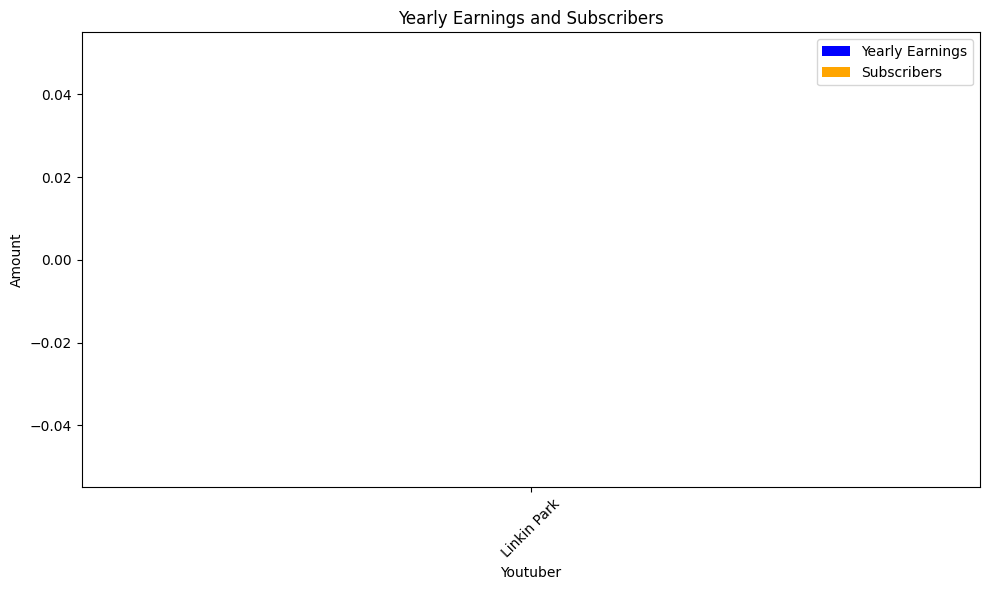

Column(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
    [0] Row(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
        [0] Markdown(str, design=<class 'panel.theme.materi..., width=500)
    [1] Row(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
        [0] Select(design=<class 'panel.theme.materi..., name='Geographical D..., options=['Animals', 'Autos', ...], sizing_mode='stretch_width', value='Animals')
    [2] Row(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
        [0] Select(design=<class 'panel.theme.materi..., name='Population vs. Y..., options=['Afghanistan', ...], sizing_mode='stretch_width', value='Afghanistan')
    [3] Row(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
        [0] IntSlider(design=<class 'panel.theme.materi..., end=2022, name='Year slider', sizing_mode='stretch_width', start=1970, step=5, value=1970)
    [4] Row(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
        [0] ParamFunction(function, _pane=HTML, defer_load=False, design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
    [5] Row(design=<class 'panel.theme.materi..., sizing_mode='stretch_width')
        [0] DataFrame(DataFrame, design=<class 'panel.theme.materi..., height=400, width=800)

In [67]:
map_pane = pn.bind(update_map_geographical, df, channel_widget.param.value, country_widget.param.value,year_slider.value)

# Layout the dashboard
dashboard = pn.Column(
    pn.Row(summary_pane),
    pn.Row(channel_widget),
    pn.Row(country_widget),
    pn.Row(year_slider),
    pn.Row(map_pane),
    pn.Row(table_panel)
)

dashboard


  0%|          | 0/2160 [00:00<?, ?it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


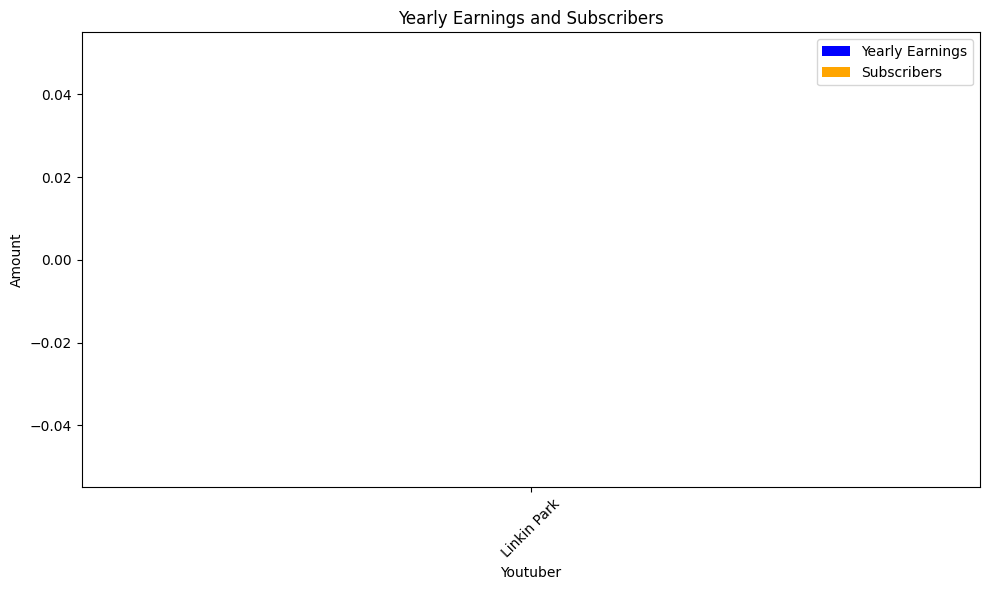

check
highest_yearly_earnings: 4100000.0, Subscribers: 253400.0, Youtuber: Like Nastya VNM
highest_yearly_earnings: 12300000.0, Subscribers: 770200.0, Youtuber: POPS Kids
highest_yearly_earnings: 1700000.0, Subscribers: 105400.0, Youtuber: FAPTV


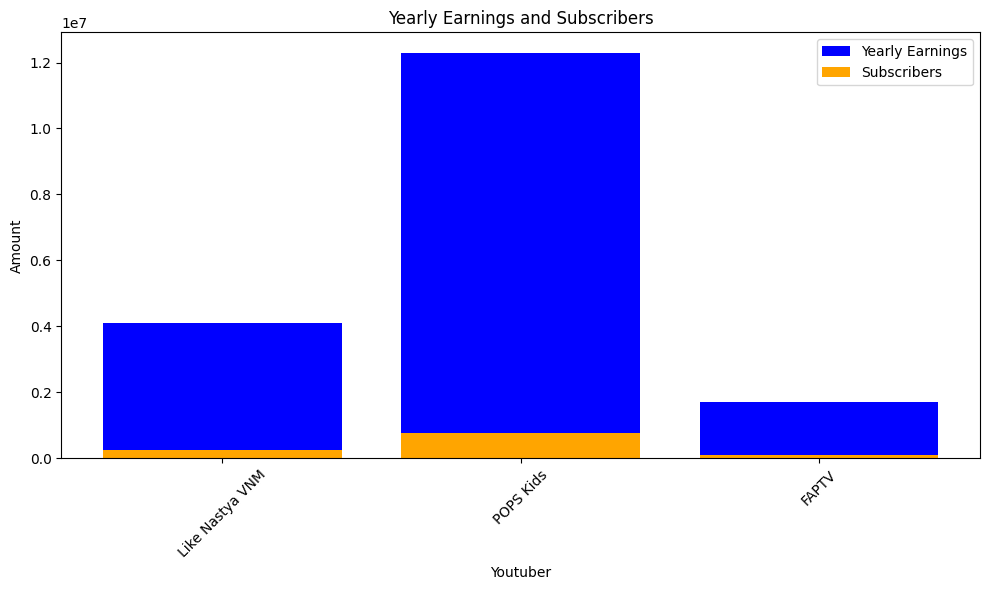

/usr/local/lib/python3.10/dist-packages/holoviews/core/spaces.py:497: ParamFutureWarning: Parameter 'callable' on <class 'holoviews.core.spaces.Callable'> is being given a valid parameter reference <function Interactive._callback.<locals>.evaluate at 0x7d56976ff010> but is implicitly allow_refs=False. In future allow_refs will be enabled by default and the reference <function Interactive._callback.<locals>.evaluate at 0x7d56976ff010> will be resolved to its underlying value :NdOverlay   [channel_type]
   :Curve   [created_year]   (subscribers). Please explicitly set allow_ref on the Parameter definition to declare whether references should be resolved or not.
  super().__init__(callable=callable,
/usr/local/lib/python3.10/dist-packages/holoviews/core/spaces.py:497: ParamFutureWarning: Parameter 'callable' on <class 'holoviews.core.spaces.Callable'> is being given a valid parameter reference <function Interactive._callback.<locals>.evaluate at 0x7d56976ff010> but is implicitly allow_ref

  0%|          | 3/2160 [00:03<28:24,  1.27it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


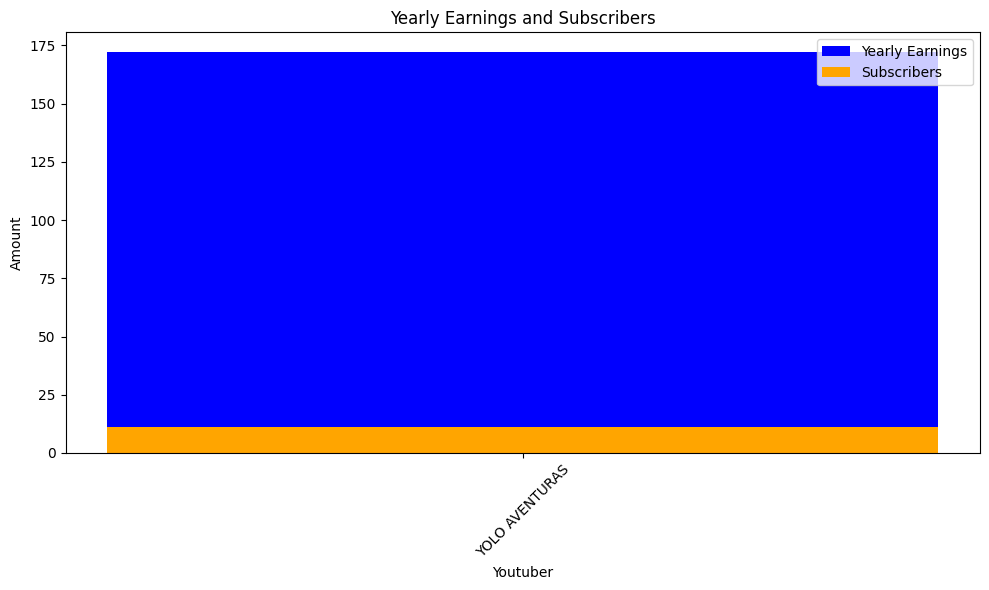

  0%|          | 6/2160 [00:06<28:50,  1.24it/s]check
highest_yearly_earnings: 0.58, Subscribers: 0.04, Youtuber: YouTube Movies
highest_yearly_earnings: 64700000.0, Subscribers: 4000000.0, Youtuber: MrBeast
highest_yearly_earnings: 94800000.0, Subscribers: 5900000.0, Youtuber: Cocomelon - Nursery Rhymes
highest_yearly_earnings: 35100000.0, Subscribers: 2200000.0, Youtuber: ýýý Kids Diana Show
highest_yearly_earnings: 27900000.0, Subscribers: 1700000.0, Youtuber: Vlad and Niki
highest_yearly_earnings: 34300000.0, Subscribers: 2100000.0, Youtuber: WWE
highest_yearly_earnings: 0.77, Subscribers: 0.05, Youtuber: Sports
highest_yearly_earnings: 22700000.0, Subscribers: 1400000.0, Youtuber: Pinkfong Baby Shark - Kids' Songs & Stories
highest_yearly_earnings: 6800000.0, Subscribers: 423600.0, Youtuber: Dude Perfect
highest_yearly_earnings: 5500000.0, Subscribers: 344000.0, Youtuber: Movieclips
highest_yearly_earnings: 12500000.0, Subscribers: 780600.0, Youtuber: EminemMusic
highest_yearly_ea

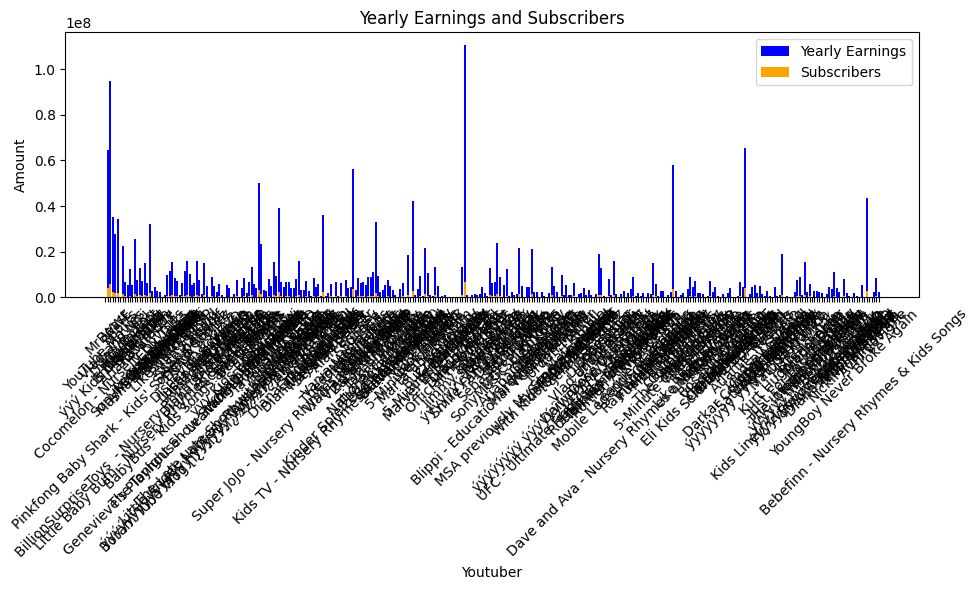

  0%|          | 9/2160 [00:18<1:19:55,  2.23s/it]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: 5-Minute Crafts
highest_yearly_earnings: 9700000.0, Subscribers: 608200.0, Youtuber: Ed Sheeran
highest_yearly_earnings: 2700000.0, Subscribers: 167000.0, Youtuber: NoCopyrightSounds
highest_yearly_earnings: 2700000.0, Subscribers: 169600.0, Youtuber: Mr Bean
highest_yearly_earnings: 11800000.0, Subscribers: 734800.0, Youtuber: Peppa Pig - Official Channel
highest_yearly_earnings: 6600000.0, Subscribers: 411300.0, Youtuber: Adele
highest_yearly_earnings: 3800000.0, Subscribers: 236000.0, Youtuber: DanTDM
highest_yearly_earnings: 9500000.0, Subscribers: 596600.0, Youtuber: Coldplay
highest_yearly_earnings: 15900000.0, Subscribers: 995700.0, Youtuber: Dan Rhodes
highest_yearly_earnings: 261100.0, Subscribers: 16300.0, Youtuber: KSI
highest_yearly_earnings: 1600000.0, Subscribers: 98400.0, Youtuber: Mister Max
highest_yearly_earnings: 2600000.0, Subscribers: 160800.0, Youtube

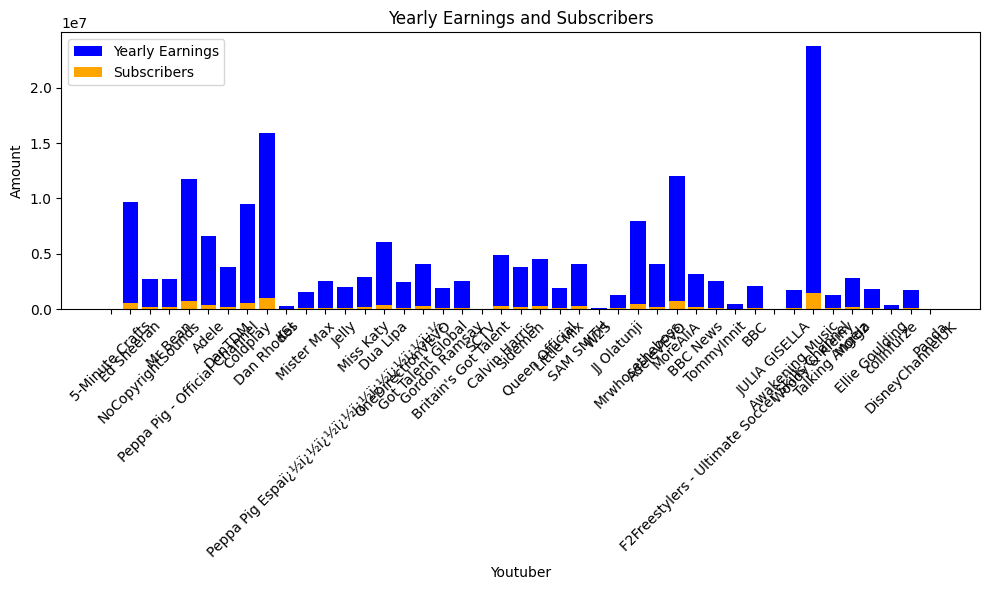

  1%|          | 12/2160 [00:22<53:29,  1.49s/it]  check
highest_yearly_earnings: 11900000.0, Subscribers: 743200.0, Youtuber: shfa2 - ï¿½ï¿½
highest_yearly_earnings: 7300000.0, Subscribers: 453600.0, Youtuber: shfa show India
highest_yearly_earnings: 76700000.0, Subscribers: 4800000.0, Youtuber: ZAMZAM ELECTRONICS TRADING
highest_yearly_earnings: 746700.0, Subscribers: 46700.0, Youtuber: Noor Stars
highest_yearly_earnings: 3800000.0, Subscribers: 240500.0, Youtuber: FFUNTV
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Supercar Blondie
highest_yearly_earnings: 3900000.0, Subscribers: 240700.0, Youtuber: AlArabiya ï¿½ï¿½ï¿½ï¿½ï¿


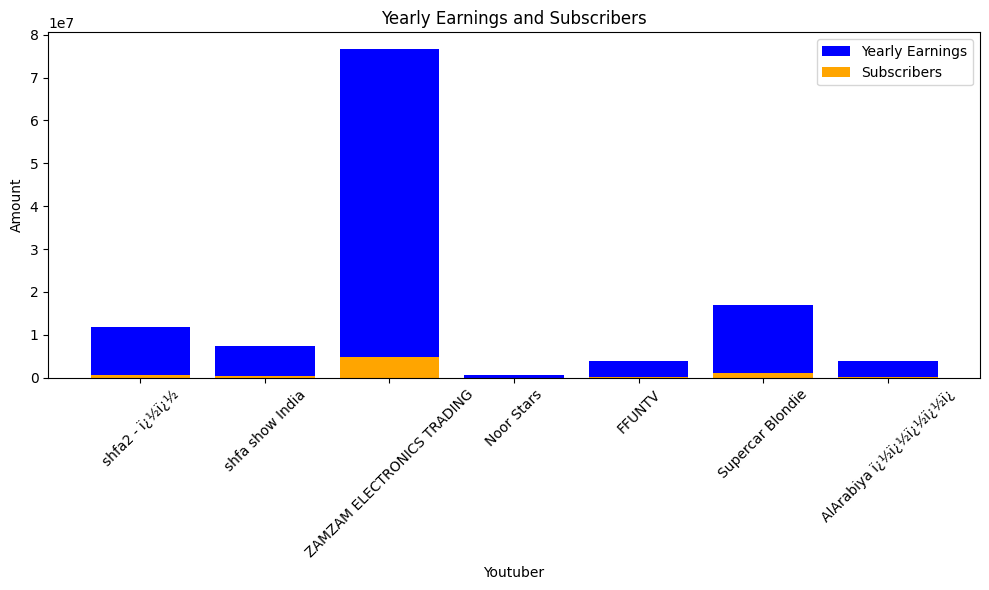

  1%|          | 15/2160 [00:25<36:10,  1.01s/it]check
highest_yearly_earnings: 1400000.0, Subscribers: 87000.0, Youtuber: SlivkiShow
highest_yearly_earnings: 3300000.0, Subscribers: 204000.0, Youtuber: ýýýýýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 17800000.0, Subscribers: 1100000.0, Youtuber: News 24
highest_yearly_earnings: 2300000.0, Subscribers: 141400.0, Youtuber: ýýýýýýýý ýýýýýýýý
highest_yearly_earnings: 5.0, Subscribers: 0.32, Youtuber: SIS vs BRO
highest_yearly_earnings: 3600000.0, Subscribers: 225500.0, Youtuber: Lady Diana
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: VexTrex
highest_yearly_earnings: 3400000.0, Subscribers: 213400.0, Youtuber: ýýýýýýýý ýýýý ýýýýýýýýýýýýýý


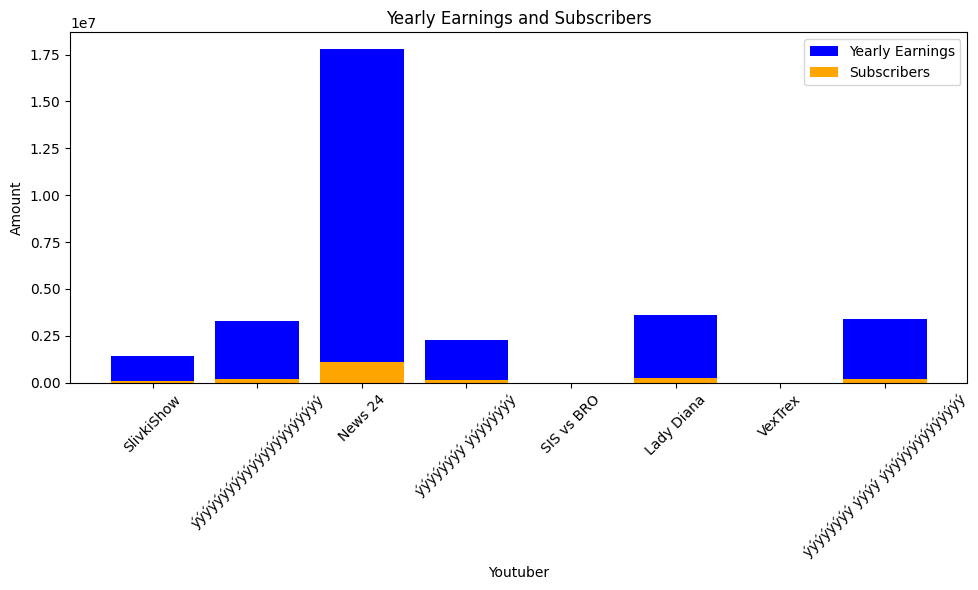

  1%|          | 18/2160 [00:27<28:51,  1.24it/s]check
highest_yearly_earnings: 70200000.0, Subscribers: 4400000.0, Youtuber: BETER Bï¿½ï¿½
highest_yearly_earnings: 20400000.0, Subscribers: 1300000.0, Youtuber: netd mï¿½ï¿
highest_yearly_earnings: 5300000.0, Subscribers: 332400.0, Youtuber: tabii Urdu
highest_yearly_earnings: 212500.0, Subscribers: 13300.0, Youtuber: Oyuncak Avï¿


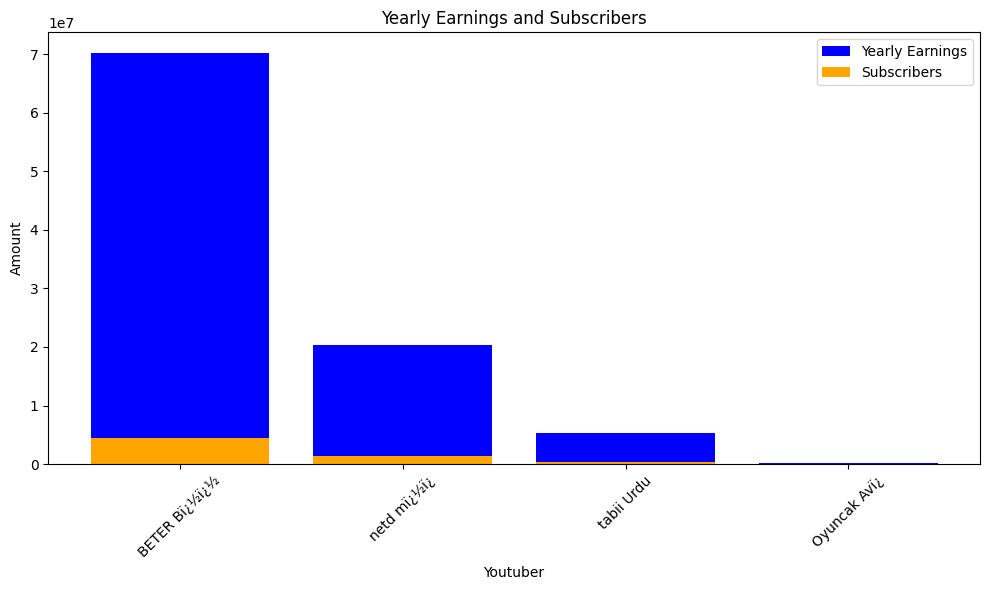

  1%|          | 21/2160 [00:31<31:47,  1.12it/s]check
highest_yearly_earnings: 1.0, Subscribers: 0.07, Youtuber: Alan Walker
highest_yearly_earnings: 6300000.0, Subscribers: 391400.0, Youtuber: WorkpointOfficial
highest_yearly_earnings: 6800000.0, Subscribers: 422300.0, Youtuber: ýýýýýýýýýýýý one31
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Ch3Thailand
highest_yearly_earnings: 6300000.0, Subscribers: 390700.0, Youtuber: GMM GRAMMY OFFICIAL
highest_yearly_earnings: 8100000.0, Subscribers: 505800.0, Youtuber: GRAMMY GOLD OFFICIAL
highest_yearly_earnings: 2600000.0, Subscribers: 162400.0, Youtuber: RsiamMusic : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: zbing z.
highest_yearly_earnings: 11300000.0, Subscribers: 708000.0, Youtuber: AMARINTV : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 448400.0, Subscribers: 28000.0, Youtuber: Kaykai Salaider
highest_yearly_earnings: 4200000.0, Subscribers: 263300.0, Youtu

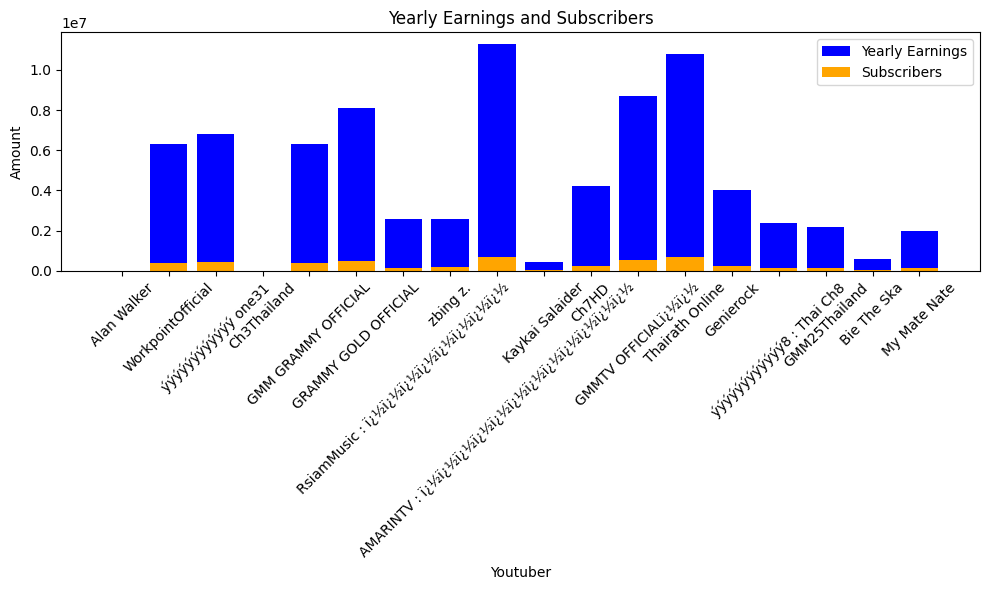

  1%|          | 24/2160 [00:36<38:28,  1.08s/it]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


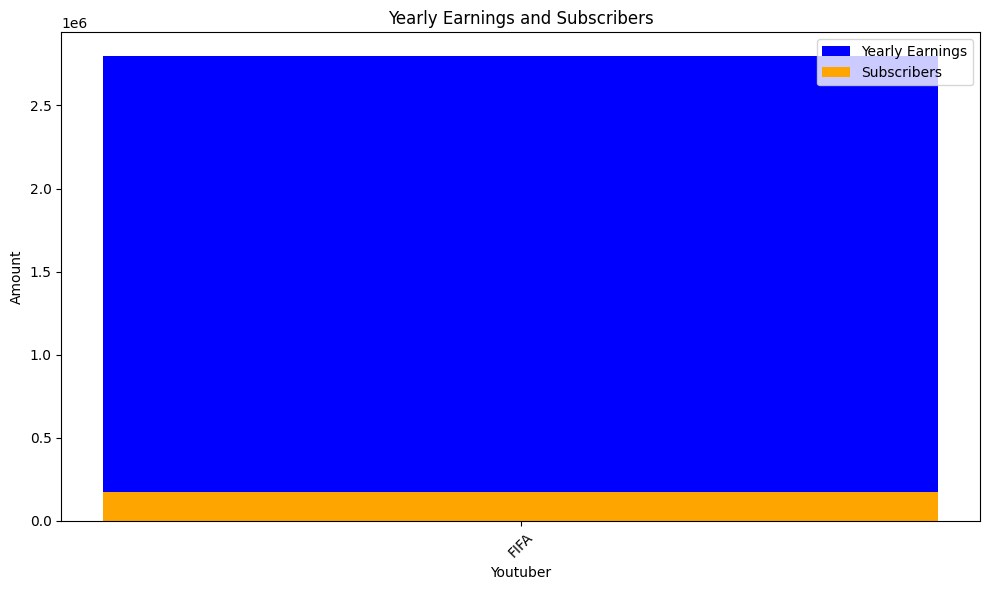

  1%|▏         | 27/2160 [00:37<19:46,  1.80it/s]check
highest_yearly_earnings: 3900000.0, Subscribers: 243700.0, Youtuber: Avicii
highest_yearly_earnings: 23000000.0, Subscribers: 1400000.0, Youtuber: Panda Shorts
highest_yearly_earnings: 658000.0, Subscribers: 41100.0, Youtuber: Narins Beauty
highest_yearly_earnings: 185800.0, Subscribers: 11600.0, Youtuber: RobTopGames


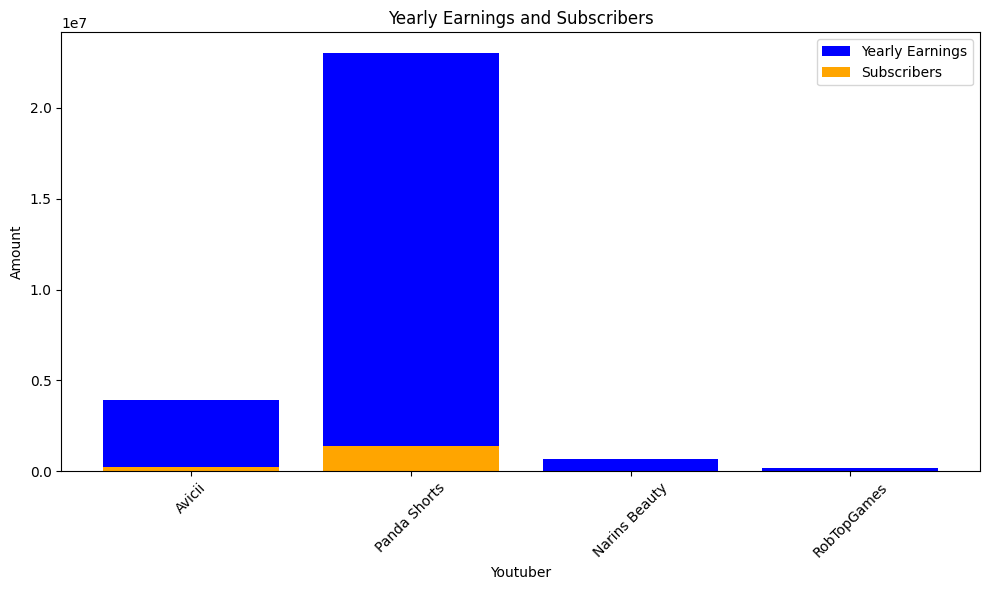

  1%|▏         | 30/2160 [00:38<13:54,  2.55it/s]check
highest_yearly_earnings: 3100.0, Subscribers: 196.0, Youtuber: IDEAS EN 5 MINUTOS


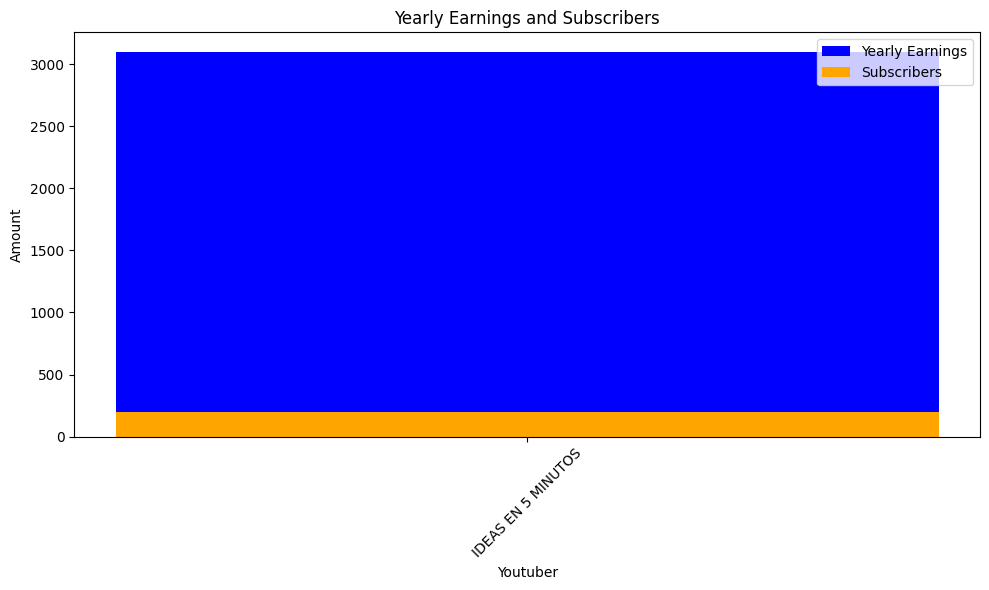

  2%|▏         | 33/2160 [00:39<11:37,  3.05it/s]check
highest_yearly_earnings: 23900000.0, Subscribers: 1500000.0, Youtuber: BLACKPINK
highest_yearly_earnings: 8100000.0, Subscribers: 504900.0, Youtuber: BANGTANTV
highest_yearly_earnings: 28700000.0, Subscribers: 1800000.0, Youtuber: HYBE LABELS
highest_yearly_earnings: 14800000.0, Subscribers: 922900.0, Youtuber: JYP Entertainment
highest_yearly_earnings: 5100000.0, Subscribers: 316700.0, Youtuber: 1theK (ï¿½ï¿½ï¿½ï¿½ï
highest_yearly_earnings: 7600000.0, Subscribers: 475600.0, Youtuber: Mnet K-POP
highest_yearly_earnings: 5200000.0, Subscribers: 324000.0, Youtuber: KBS WORLD TV
highest_yearly_earnings: 3100000.0, Subscribers: 195000.0, Youtuber: officialpsy
highest_yearly_earnings: 163400000.0, Subscribers: 10200000.0, Youtuber: ýýýýýýýýý KIMPRO
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Jane ASMR ï¿½ï¿½
highest_yearly_earnings: 532700.0, Subscribers: 33300.0, Youtuber: JFlaMusic
highest_yearly_earnings: 2000000.0, Sub

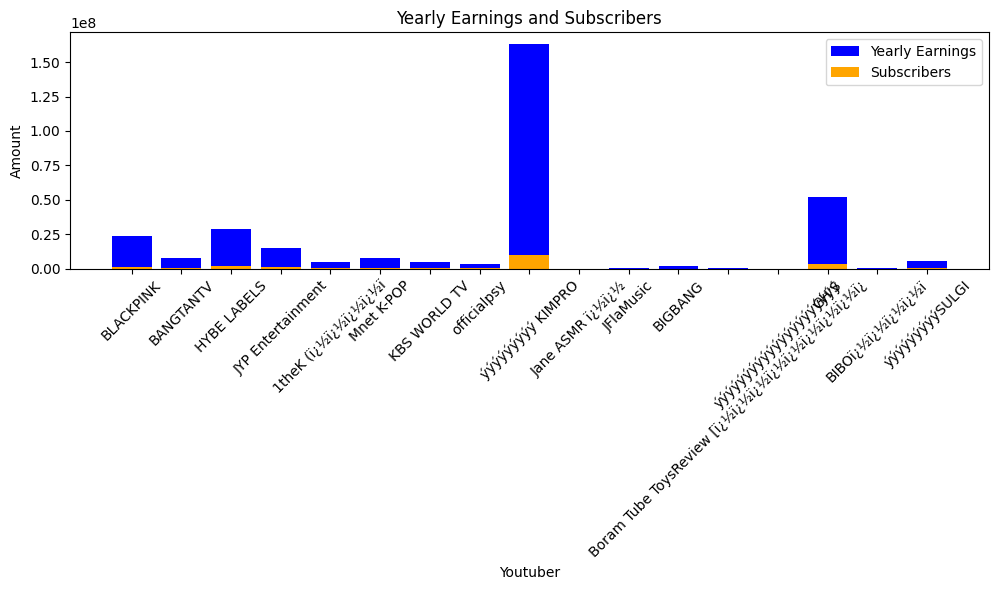

  2%|▏         | 36/2160 [00:40<12:07,  2.92it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Sandeep Maheshwari


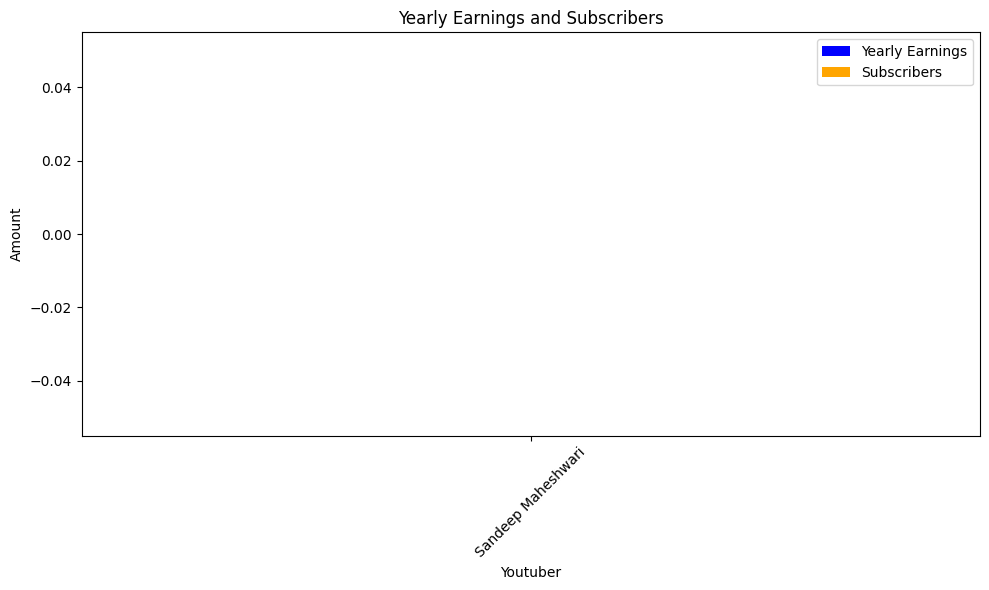

  2%|▏         | 39/2160 [00:41<10:44,  3.29it/s]check
highest_yearly_earnings: 76300.0, Subscribers: 4800.0, Youtuber: shfa
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: 1MILLION Dance Studio
highest_yearly_earnings: 3500000.0, Subscribers: 221500.0, Youtuber: mmoshaya
highest_yearly_earnings: 2100000.0, Subscribers: 129000.0, Youtuber: ýýýýýýýý ýýýýýýýýýý ýýýýýýýýýý | Arab Games Network
highest_yearly_earnings: 4400000.0, Subscribers: 272700.0, Youtuber: Katakit Baby TV
highest_yearly_earnings: 6500000.0, Subscribers: 405100.0, Youtuber: ýýýýýýýý ýý ýýýýýýýý
highest_yearly_earnings: 129300.0, Subscribers: 8100.0, Youtuber: ýýýýýýýýýý ýýýýýýýýýýýý
highest_yearly_earnings: 224300.0, Subscribers: 14000.0, Youtuber: ýýýýýýýýýýýý ýýýýýýýýýýýý I ýýýýýý ýý ýýýýýýýýýý
highest_yearly_earnings: 3400000.0, Subscribers: 212100.0, Youtuber: BanderitaX


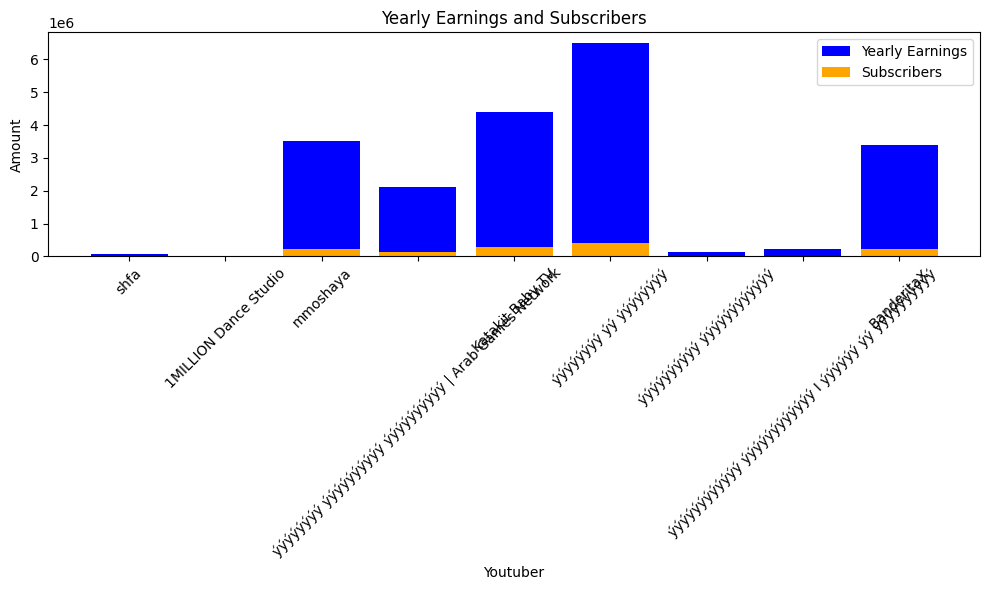

  2%|▏         | 42/2160 [00:42<11:09,  3.16it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


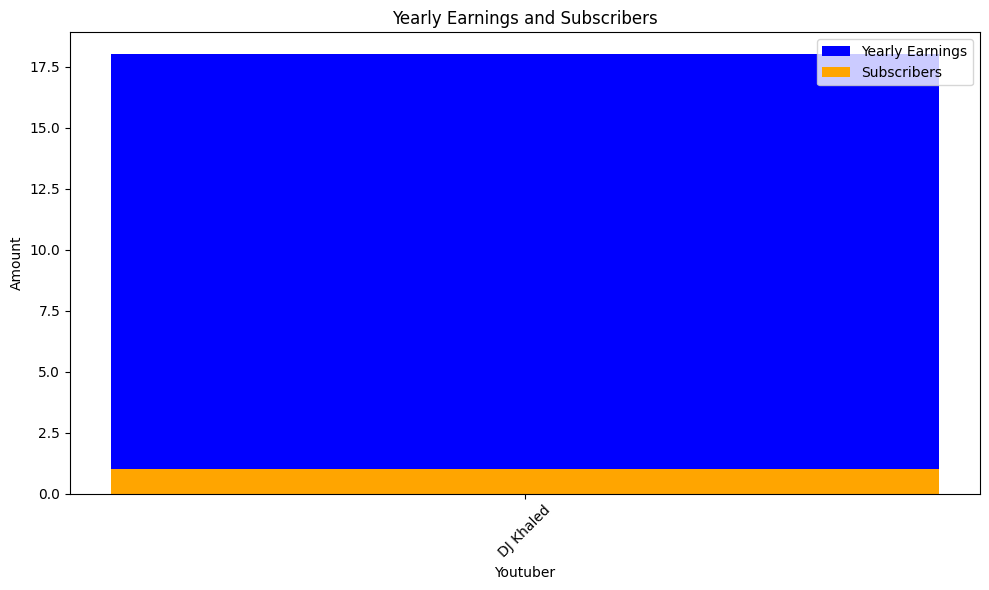

  2%|▏         | 45/2160 [00:43<10:45,  3.27it/s]check
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya
highest_yearly_earnings: 14700000.0, Subscribers: 919600.0, Youtuber: Get Movies
highest_yearly_earnings: 14600000.0, Subscribers: 911300.0, Youtuber: ýýýýýýýý ýý ýýýýýýýýýýýýýý
highest_yearly_earnings: 26500000.0, Subscribers: 1700000.0, Youtuber: tuzelity SHUFFLE
highest_yearly_earnings: 1200000.0, Subscribers: 73700.0, Youtuber: HiMan
highest_yearly_earnings: 1800000.0, Subscribers: 114800.0, Youtuber: Marmok
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya Vlog
highest_yearly_earnings: 1800000.0, Subscribers: 111500.0, Youtuber: TheBrianMaps
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: ýýýýýýýýýý
highest_yearly_earnings: 22800000.0, Subscribers: 1400000.0, Youtuber: ILYA BORZOV
highest_yearly_earnings: 4600000.0, Subscribers: 286800.0, Youtuber: EdisonPts
highest_yearly_earnings: 34200000.0, Subscribers:

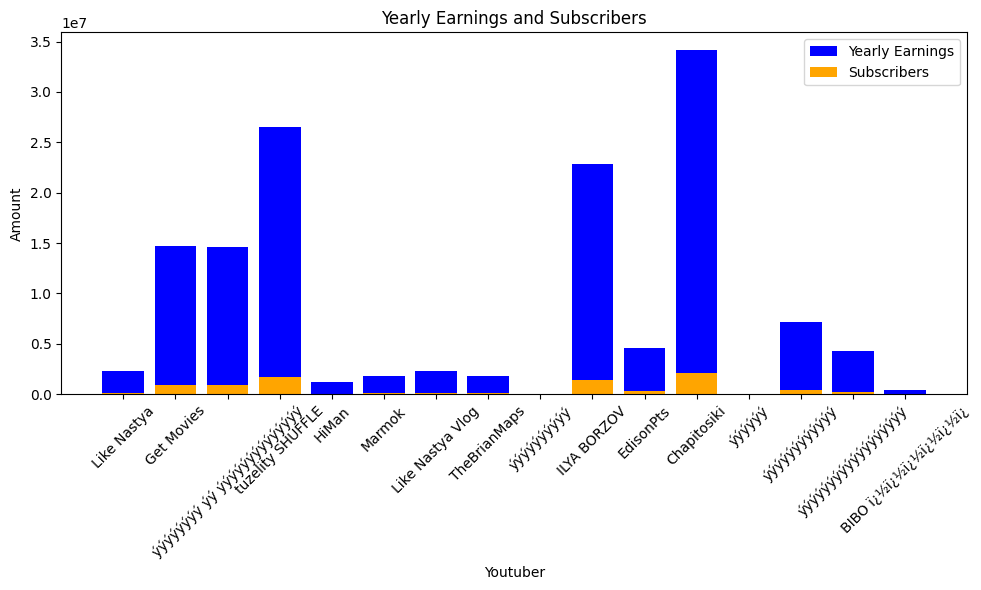

  2%|▏         | 48/2160 [00:45<13:44,  2.56it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529900.0, Youtuber: ABS-CBN Entertainment
highest_yearly_earnings: 38300000.0, Subscribers: 2400000.0, Youtuber: GMA  Network
highest_yearly_earnings: 7800000.0, Subscribers: 489400.0, Youtuber: Raffy Tulfo in Action
highest_yearly_earnings: 6800000.0, Subscribers: 427000.0, Youtuber: GMA Public  Affairs
highest_yearly_earnings: 723800.0, Subscribers: 45200.0, Youtuber: Ivana Alawi
highest_yearly_earnings: 479000.0, Subscribers: 29900.0, Youtuber: Niana Guerrero
highest_yearly_earnings: 594000.0, Subscribers: 37100.0, Youtuber: Ranz Kyle
highest_yearly_earnings: 8700000.0, Subscribers: 544900.0, Youtuber: ABS-CBN News
highest_yearly_earnings: 3000000.0, Subscribers: 188000.0, Youtuber: Wish 107.5
highest_yearly_earnings: 580200.0, Subscribers: 36300.0, Youtuber: Zeinab Harake
highest_yearly_earnings: 5500000.0, Subscribers: 346400.0, Youtuber: GMA Integrated News
highest_yearly_earni

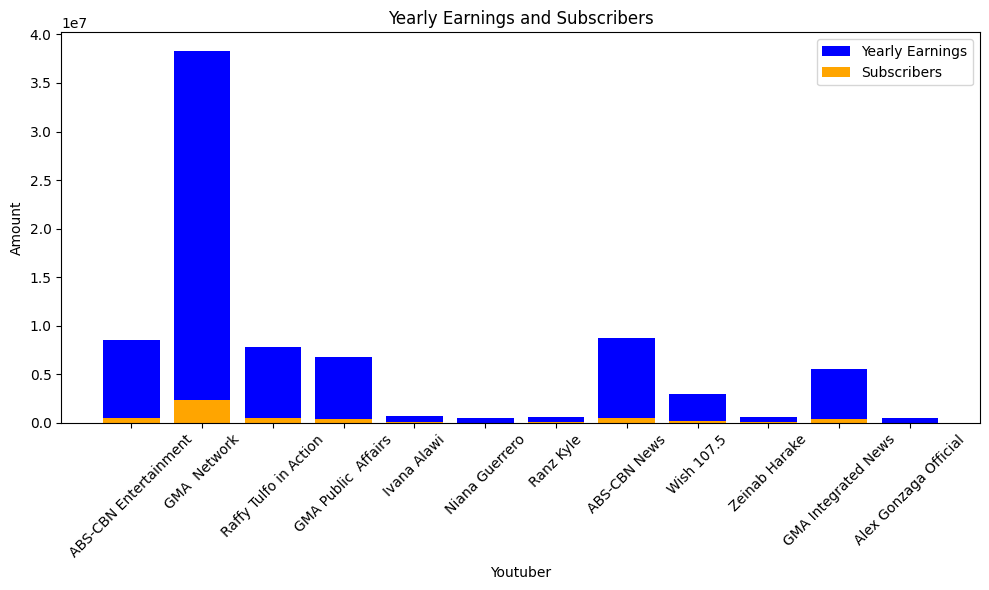

  2%|▏         | 51/2160 [00:47<15:51,  2.22it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


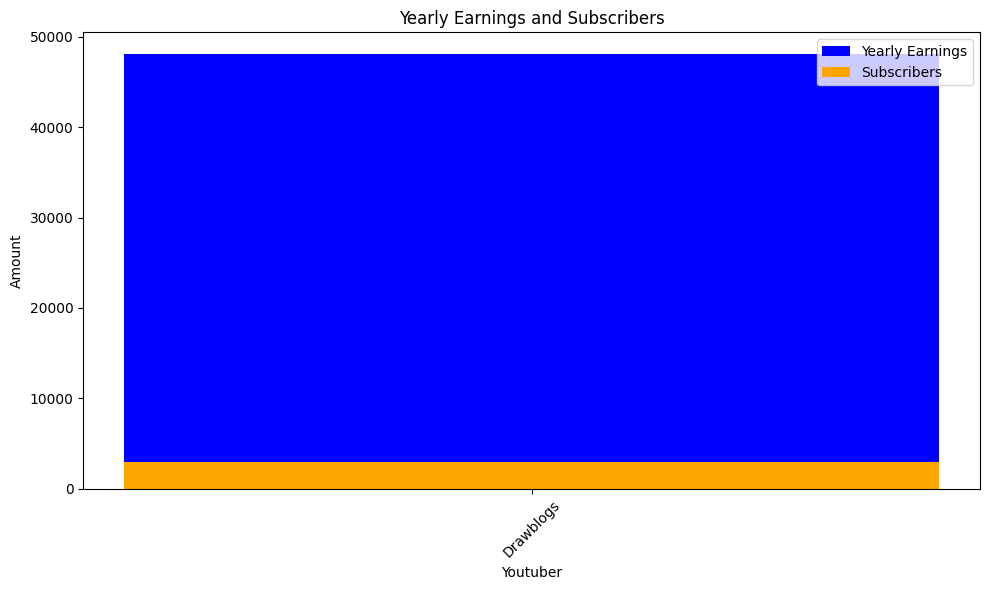

  2%|▎         | 54/2160 [00:48<15:56,  2.20it/s]check
highest_yearly_earnings: 419.0, Subscribers: 26.0, Youtuber: Quantum Tech HD


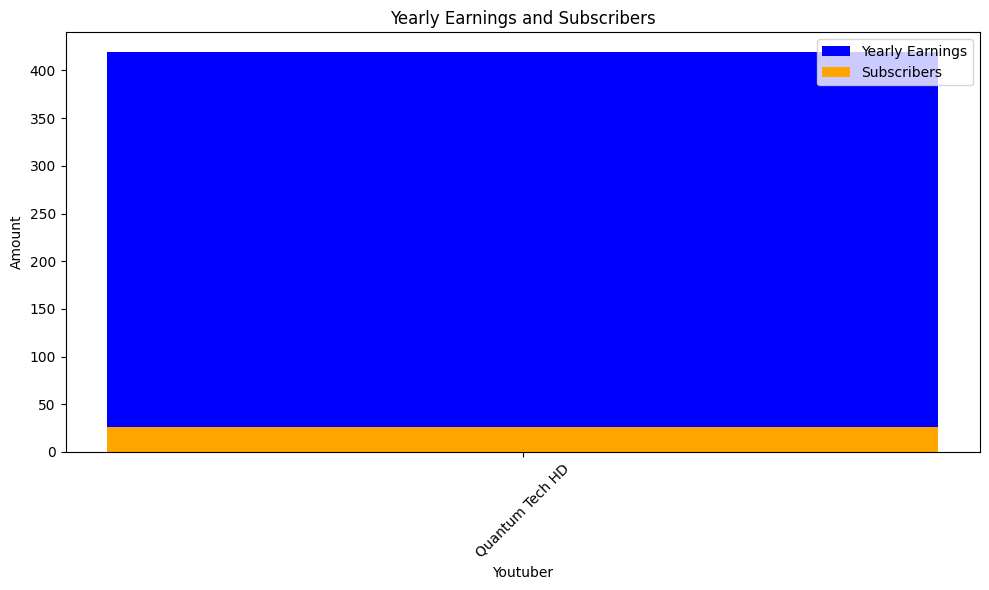

  3%|▎         | 57/2160 [00:49<11:55,  2.94it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300100.0, Youtuber: Spinnin' Records
highest_yearly_earnings: 1700000.0, Subscribers: 107800.0, Youtuber: NikkieTutorials
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: ýýýýýýýý/Atro


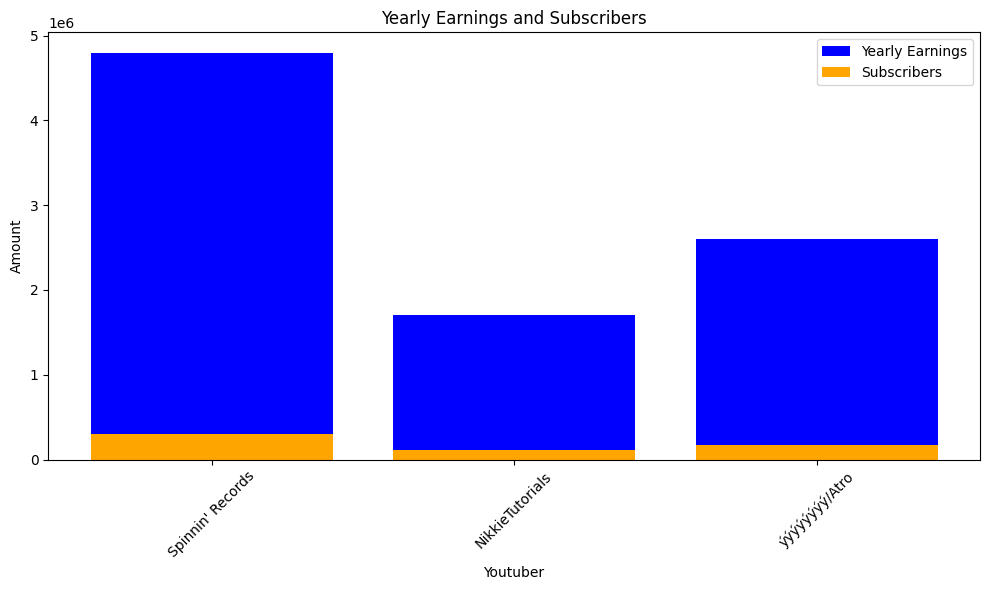

  3%|▎         | 60/2160 [00:50<10:32,  3.32it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


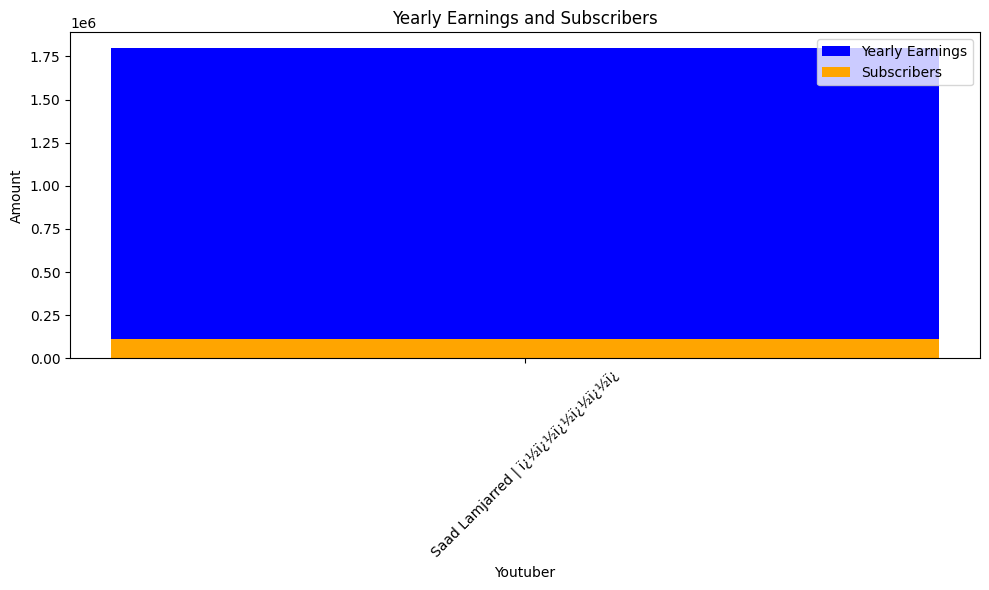

  3%|▎         | 63/2160 [00:51<10:12,  3.42it/s]check
highest_yearly_earnings: 6600000.0, Subscribers: 410200.0, Youtuber: Kimberly Loaiza
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Luisito Comunica
highest_yearly_earnings: 1500000.0, Subscribers: 94400.0, Youtuber: GENIAL
highest_yearly_earnings: 1500000.0, Subscribers: 91500.0, Youtuber: LosPolinesios
highest_yearly_earnings: 16100.0, Subscribers: 1000.0, Youtuber: Yuya
highest_yearly_earnings: 1600000.0, Subscribers: 100800.0, Youtuber: MrBeast en Espaï¿½ï
highest_yearly_earnings: 2200000.0, Subscribers: 140600.0, Youtuber: Juan De Dios Pantoja
highest_yearly_earnings: 6600000.0, Subscribers: 410500.0, Youtuber: BabyBus - Canciones Infantiles & Videos para Niï¿½ï
highest_yearly_earnings: 227.0, Subscribers: 14.0, Youtuber: Disney Latinoamï¿½ï¿½
highest_yearly_earnings: 742.0, Subscribers: 46.0, Youtuber: Tlnovelas
highest_yearly_earnings: 114300.0, Subscribers: 7100.0, Youtuber: JukiLop
highest_yearly_earnings: 59000

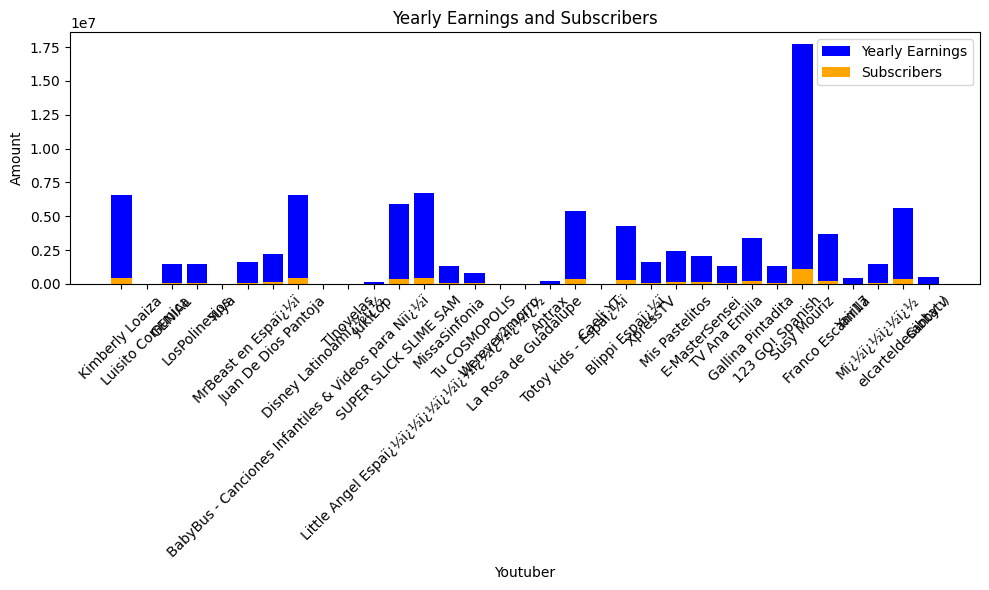

  3%|▎         | 66/2160 [00:53<12:23,  2.82it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


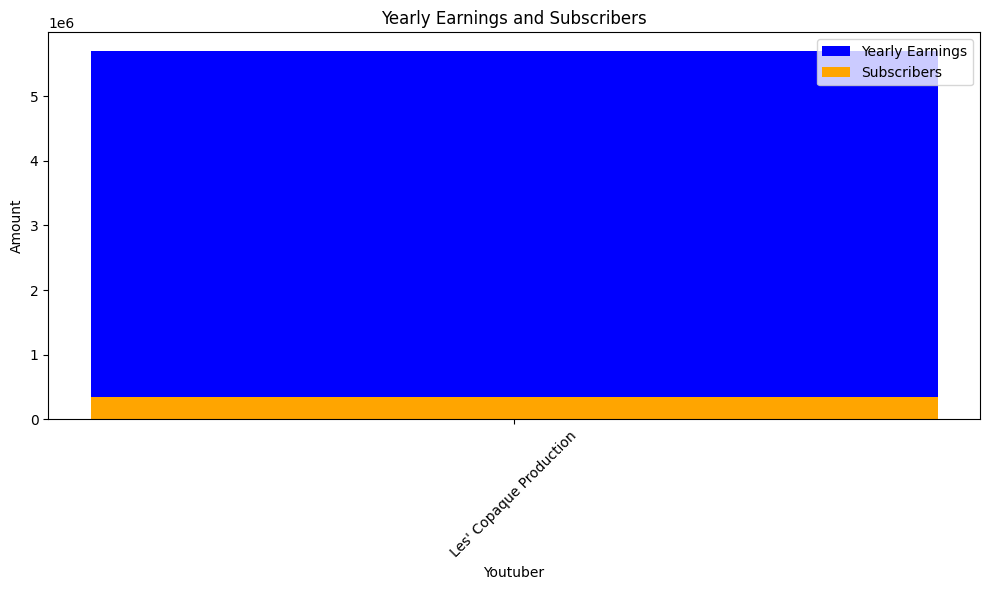

  3%|▎         | 69/2160 [00:54<10:35,  3.29it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


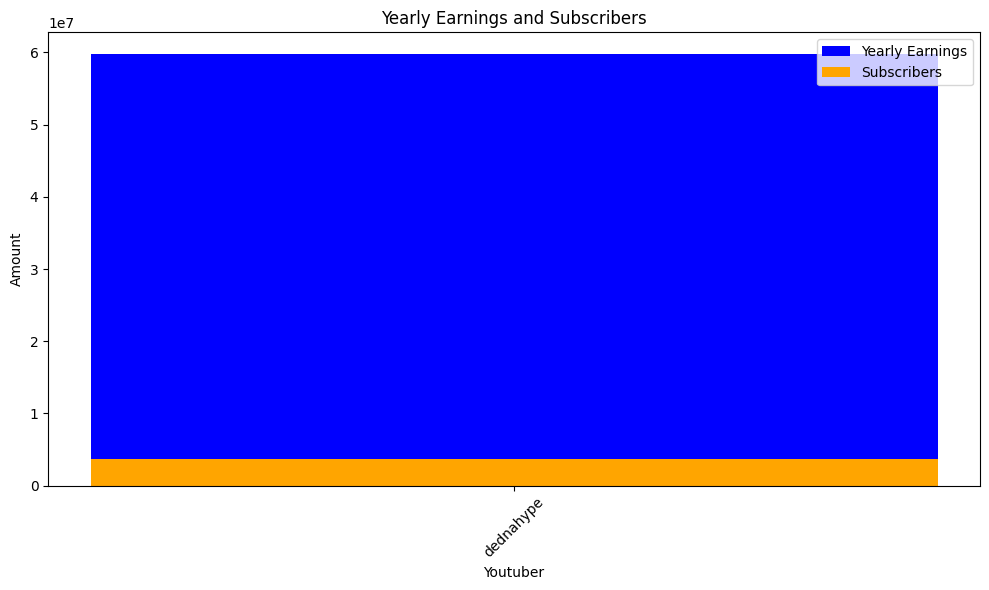

  3%|▎         | 72/2160 [00:55<10:07,  3.44it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


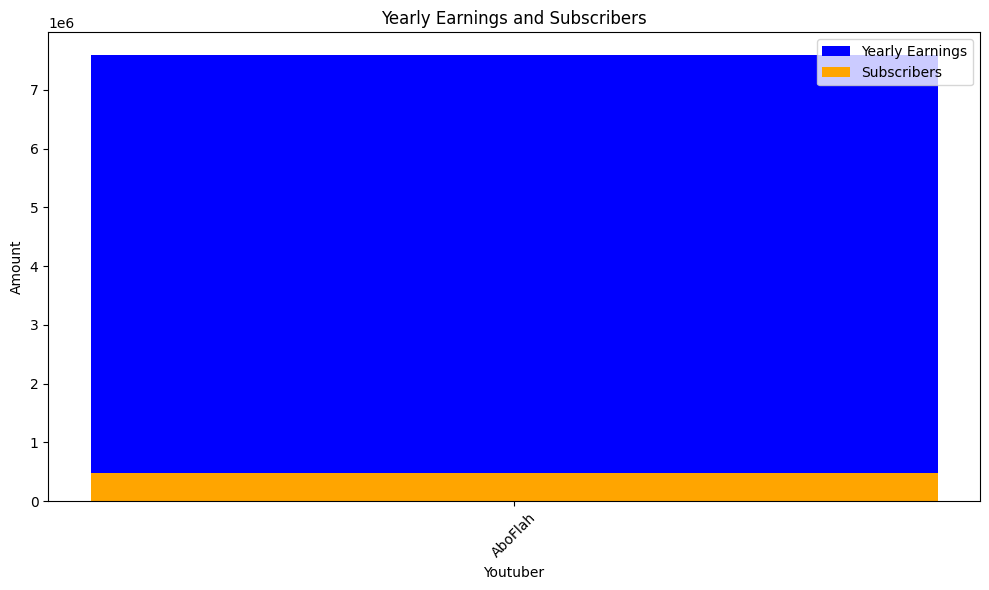

  3%|▎         | 75/2160 [00:57<13:15,  2.62it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


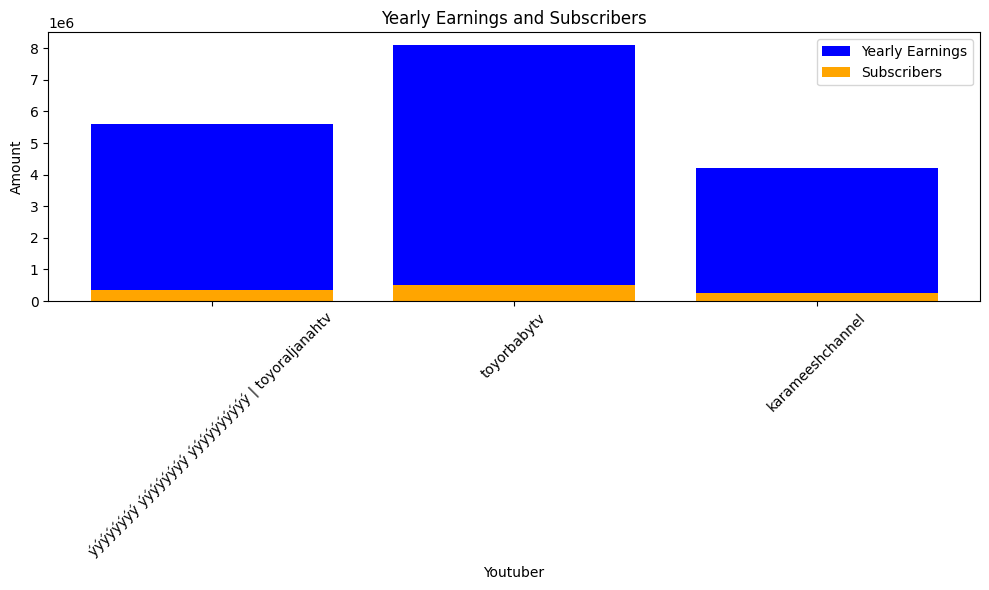

  4%|▎         | 78/2160 [00:58<11:25,  3.04it/s]check
highest_yearly_earnings: 1900000.0, Subscribers: 117600.0, Youtuber: PewDiePie
highest_yearly_earnings: 34600000.0, Subscribers: 2200000.0, Youtuber: Junya.ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 34100000.0, Subscribers: 2100000.0, Youtuber: Sagawa /ï¿½ï¿½ï¿½
highest_yearly_earnings: 13600000.0, Subscribers: 847100.0, Youtuber: ISSEI / ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 119.0, Subscribers: 7.0, Youtuber: Bayashi TV


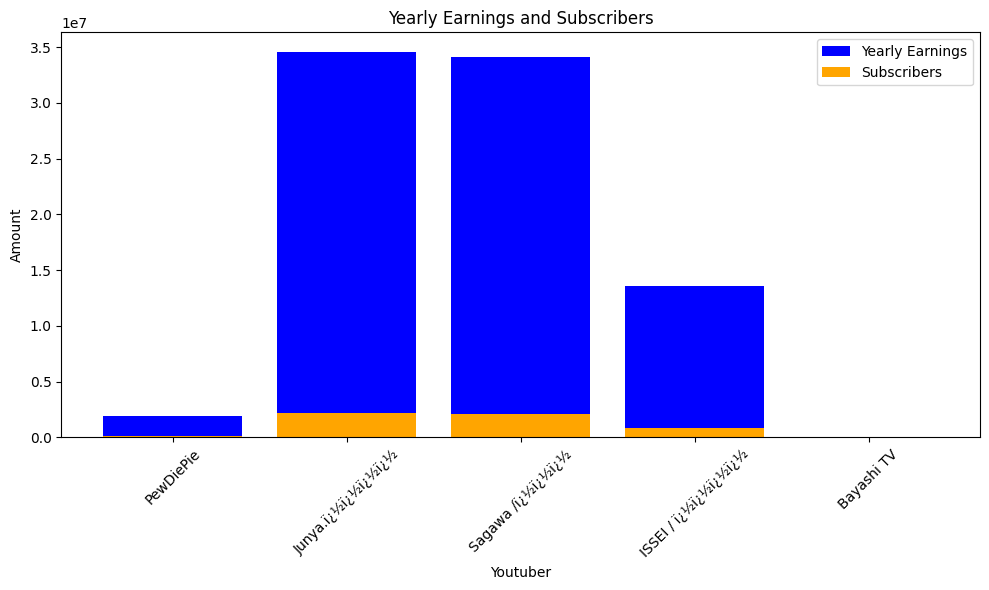

  4%|▍         | 81/2160 [00:59<12:37,  2.74it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


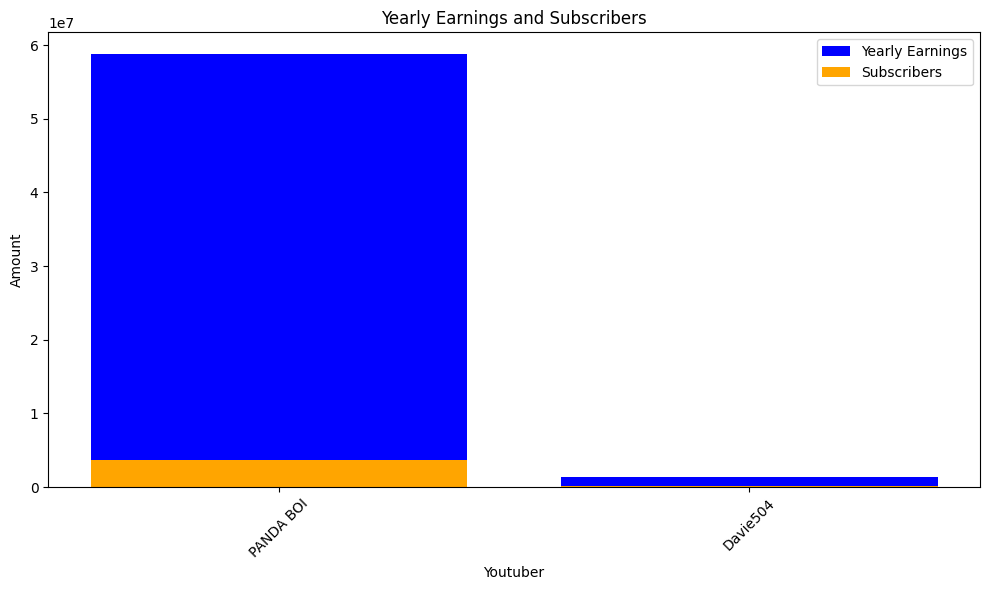

  4%|▍         | 84/2160 [01:01<15:12,  2.27it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


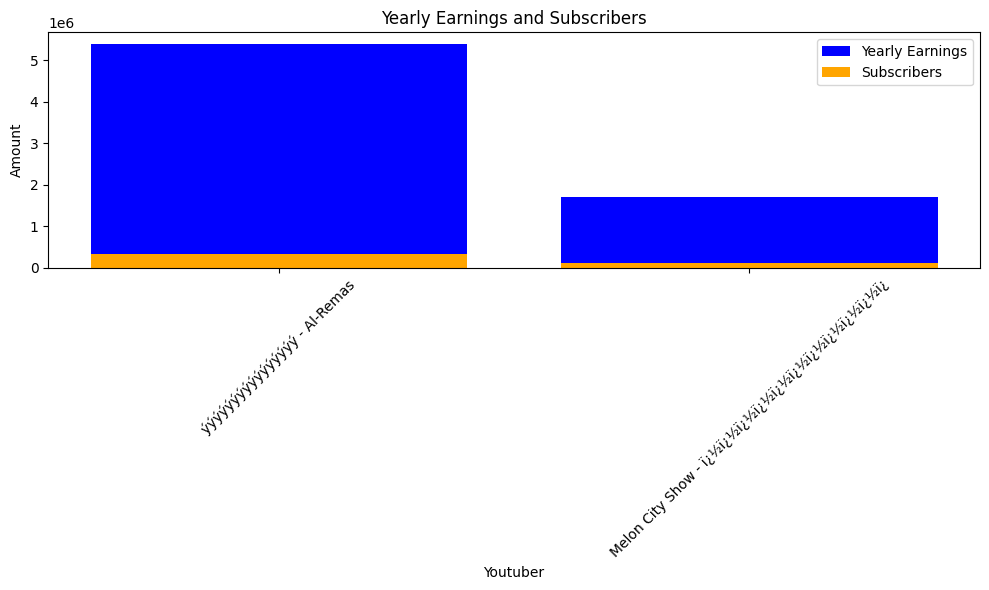

  4%|▍         | 87/2160 [01:02<16:27,  2.10it/s]check
highest_yearly_earnings: 26300000.0, Subscribers: 1600000.0, Youtuber: Jess No Limit
highest_yearly_earnings: 7500000.0, Subscribers: 471300.0, Youtuber: Ricis Official
highest_yearly_earnings: 1000000.0, Subscribers: 64300.0, Youtuber: AH
highest_yearly_earnings: 11000000.0, Subscribers: 690500.0, Youtuber: Indosiar
highest_yearly_earnings: 2800000.0, Subscribers: 175500.0, Youtuber: Rans Entertainment
highest_yearly_earnings: 5900000.0, Subscribers: 369600.0, Youtuber: TRANS7 OFFICIAL
highest_yearly_earnings: 1300000.0, Subscribers: 80900.0, Youtuber: Baim Paula
highest_yearly_earnings: 4.0, Subscribers: 0.26, Youtuber: Deddy Corbuzier
highest_yearly_earnings: 5400000.0, Subscribers: 338300.0, Youtuber: BabyBus - Cerita & Lagu Anak-anak
highest_yearly_earnings: 3100000.0, Subscribers: 193500.0, Youtuber: MiawAug
highest_yearly_earnings: 9500000.0, Subscribers: 592100.0, Youtuber: Willie Salim
highest_yearly_earnings: 819000.0, Su

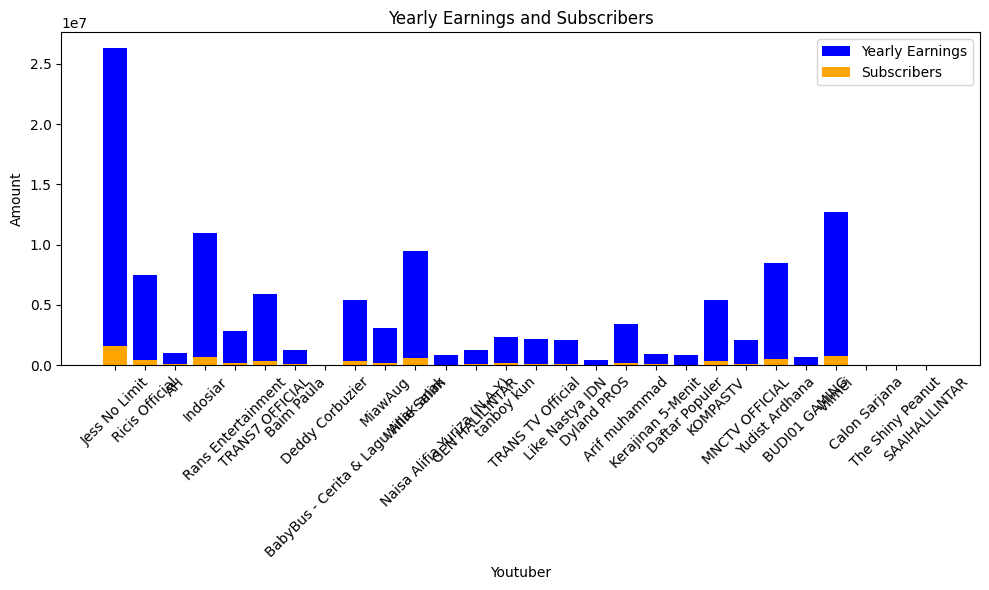

  4%|▍         | 90/2160 [01:04<14:50,  2.33it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Blockbuster Movies
highest_yearly_earnings: 0.1, Subscribers: 0.01, Youtuber: Jomy Production


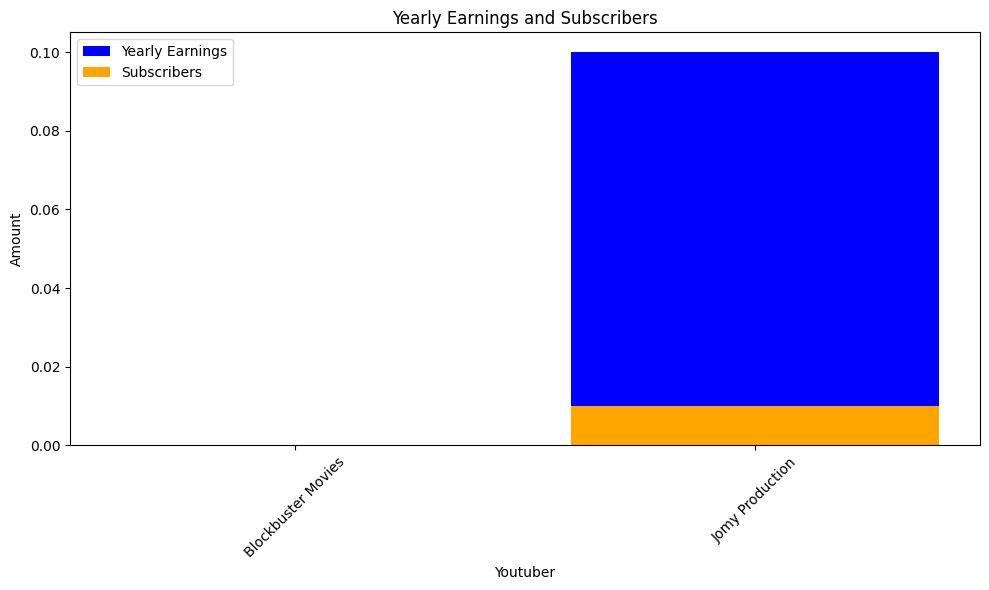

  4%|▍         | 93/2160 [01:05<12:26,  2.77it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: YOLO


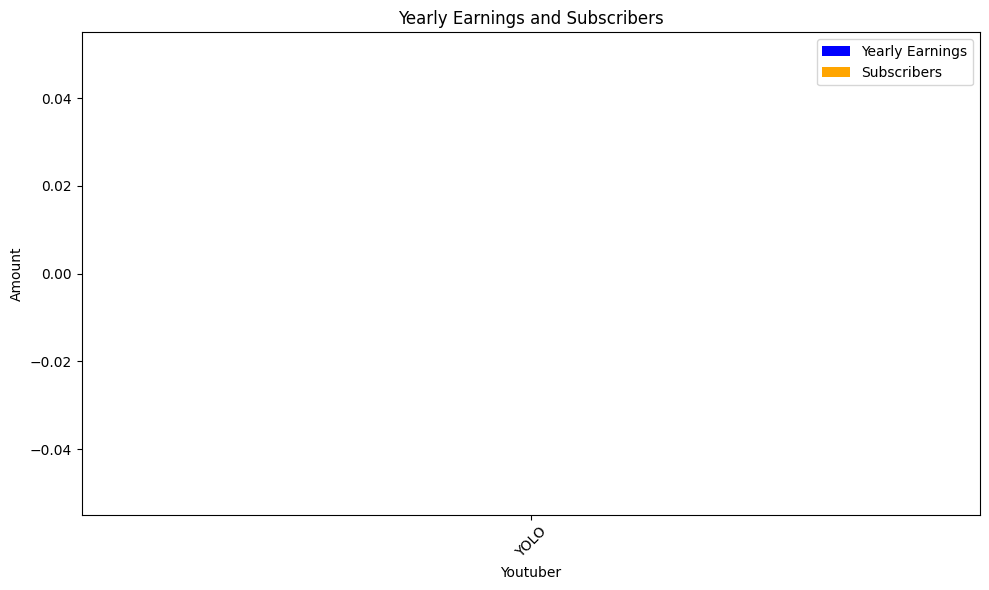

  4%|▍         | 96/2160 [01:06<11:14,  3.06it/s]check
highest_yearly_earnings: 35.0, Subscribers: 2.0, Youtuber: Smile Family
highest_yearly_earnings: 2300000.0, Subscribers: 144300.0, Youtuber: SQUEEZIE
highest_yearly_earnings: 37.0, Subscribers: 2.0, Youtuber: FitDance
highest_yearly_earnings: 548000.0, Subscribers: 34300.0, Youtuber: Cyprien
highest_yearly_earnings: 1500000.0, Subscribers: 91400.0, Youtuber: Lofi Girl


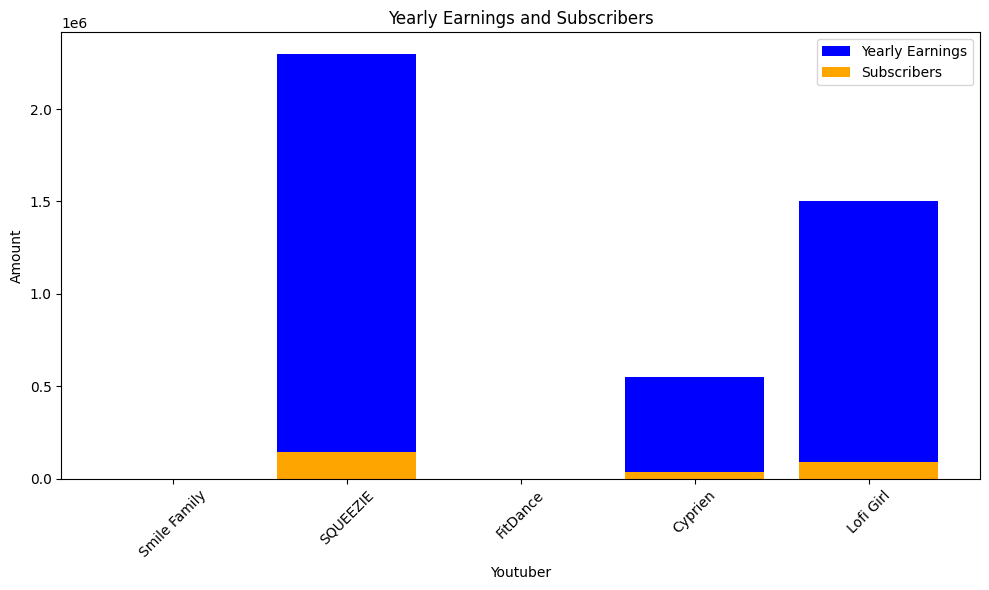

  5%|▍         | 99/2160 [01:07<11:01,  3.11it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


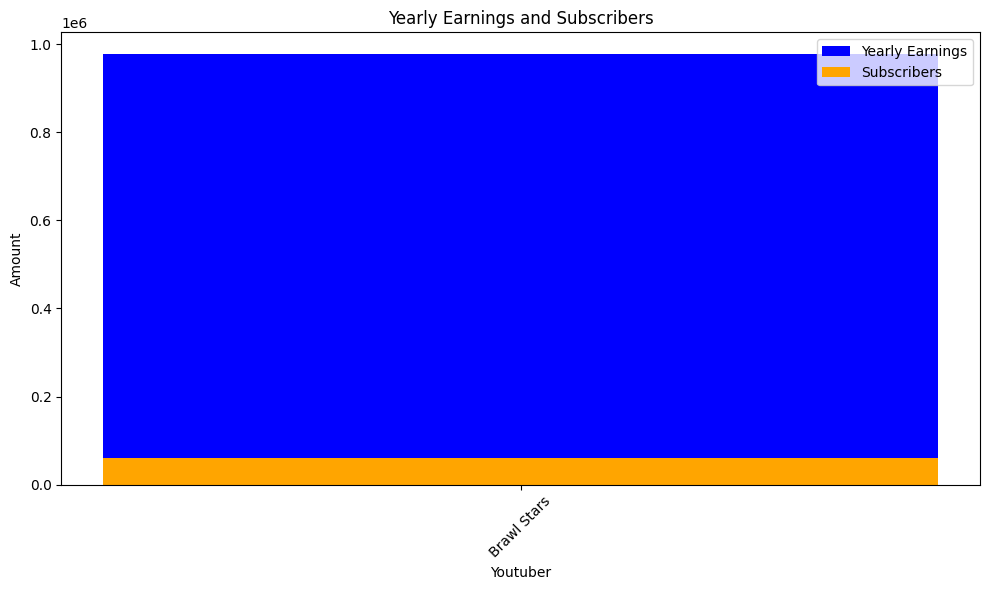

  5%|▍         | 102/2160 [01:09<10:36,  3.23it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


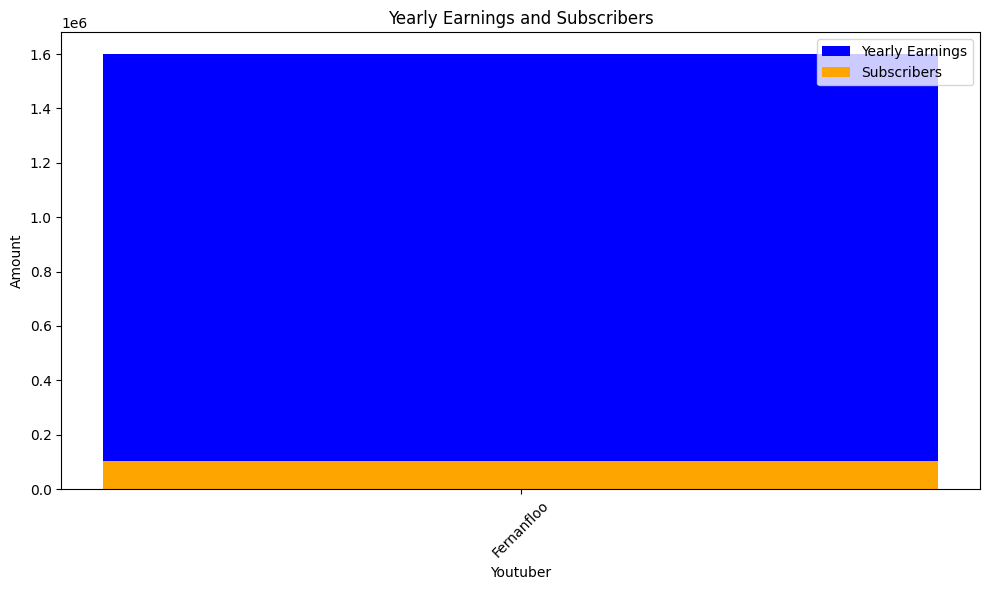

  5%|▍         | 105/2160 [01:10<10:37,  3.23it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


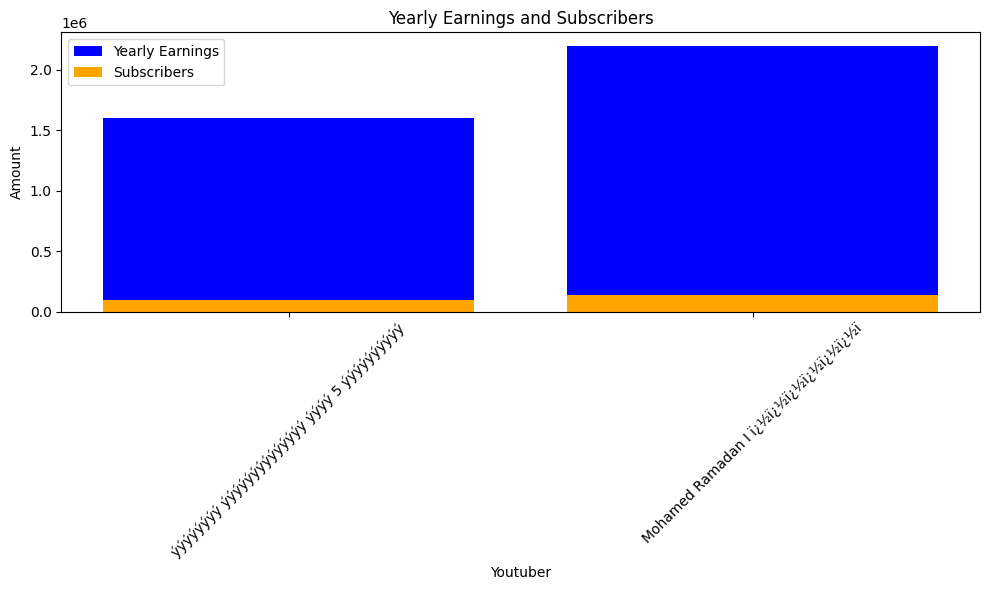

  5%|▌         | 108/2160 [01:11<10:14,  3.34it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


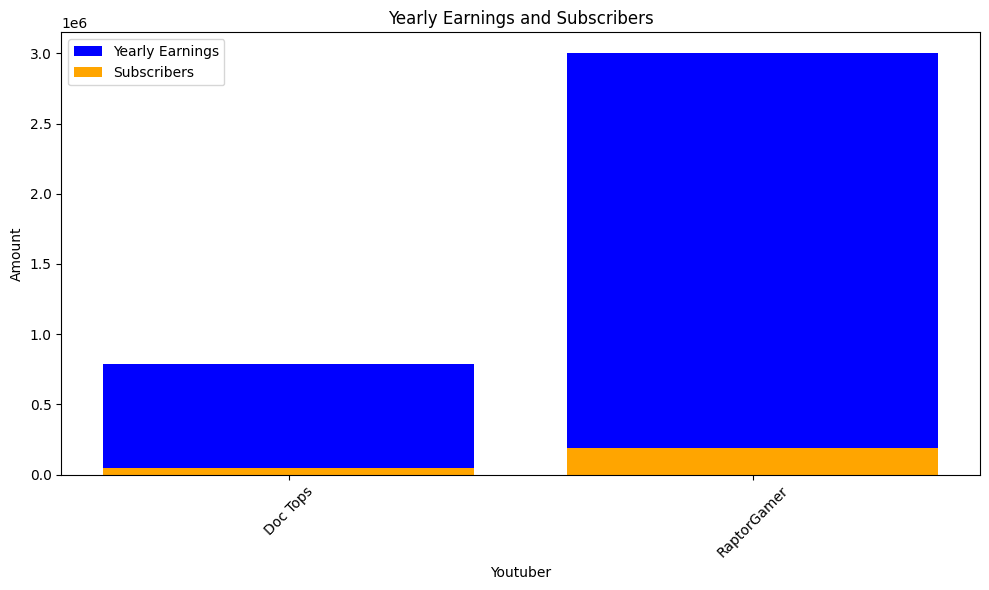

  5%|▌         | 111/2160 [01:12<10:02,  3.40it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


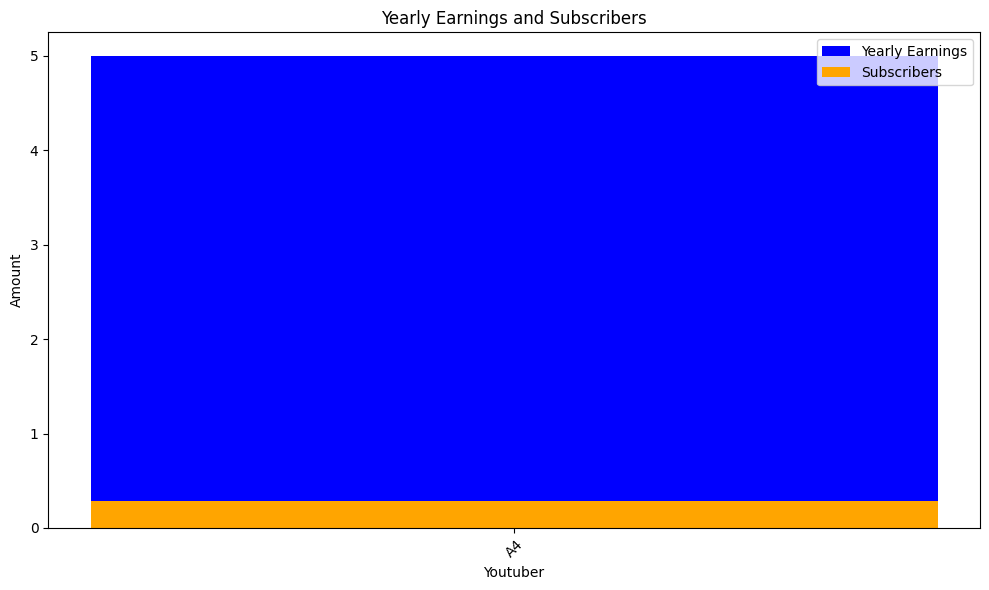

  5%|▌         | 114/2160 [01:13<10:16,  3.32it/s]check
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Shakira
highest_yearly_earnings: 6200000.0, Subscribers: 386100.0, Youtuber: J Balvin
highest_yearly_earnings: 22400000.0, Subscribers: 1400000.0, Youtuber: KAROL G
highest_yearly_earnings: 8300000.0, Subscribers: 521500.0, Youtuber: toycantando
highest_yearly_earnings: 1200000.0, Subscribers: 73100.0, Youtuber: enchufetv
highest_yearly_earnings: 13600000.0, Subscribers: 852400.0, Youtuber: Anuel AA
highest_yearly_earnings: 12700000.0, Subscribers: 791600.0, Youtuber: Ami Rodriguez
highest_yearly_earnings: 2900000.0, Subscribers: 179700.0, Youtuber: Camilo
highest_yearly_earnings: 11000000.0, Subscribers: 686700.0, Youtuber: Codiscos
highest_yearly_earnings: 4100000.0, Subscribers: 258800.0, Youtuber: jbalvinVEVO
highest_yearly_earnings: 15700000.0, Subscribers: 982800.0, Youtuber: Go Ami Go!


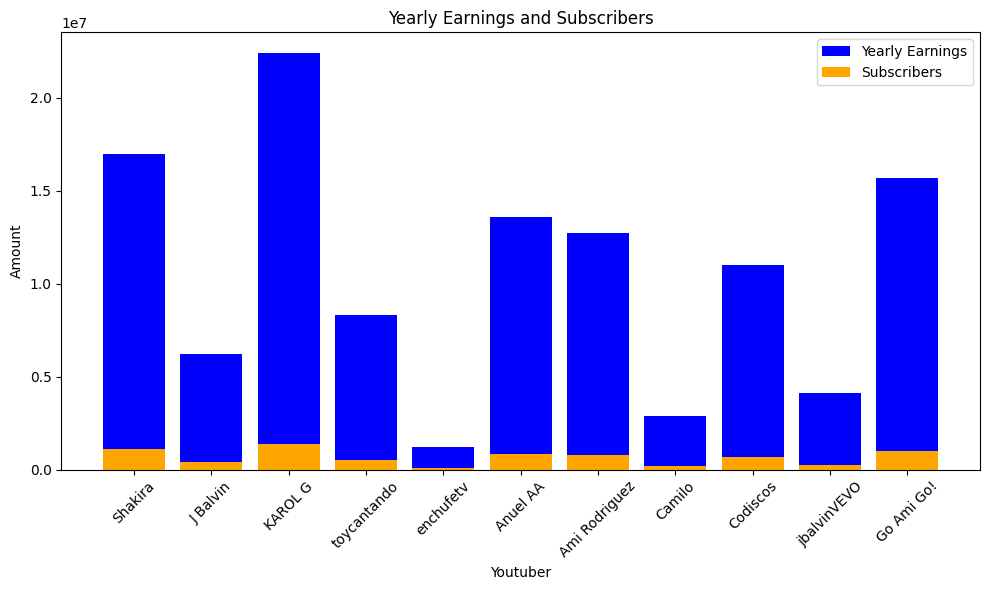

  5%|▌         | 117/2160 [01:15<14:24,  2.36it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


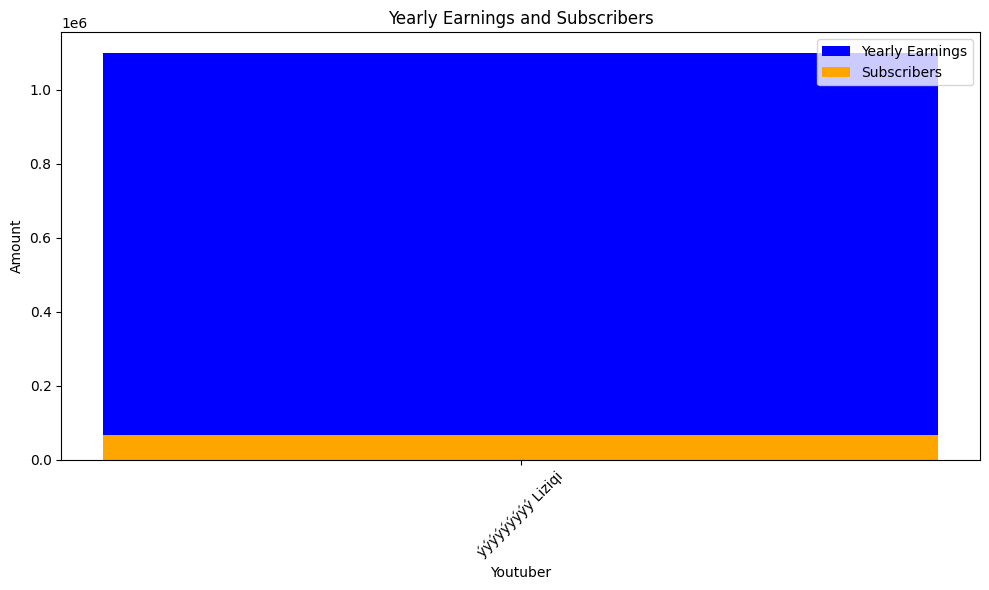

  6%|▌         | 120/2160 [01:16<15:55,  2.14it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 199200.0, Youtuber: JuegaGerman
highest_yearly_earnings: 2.0, Subscribers: 0.15, Youtuber: invictor
highest_yearly_earnings: 4800000.0, Subscribers: 300600.0, Youtuber: DeGoBooM


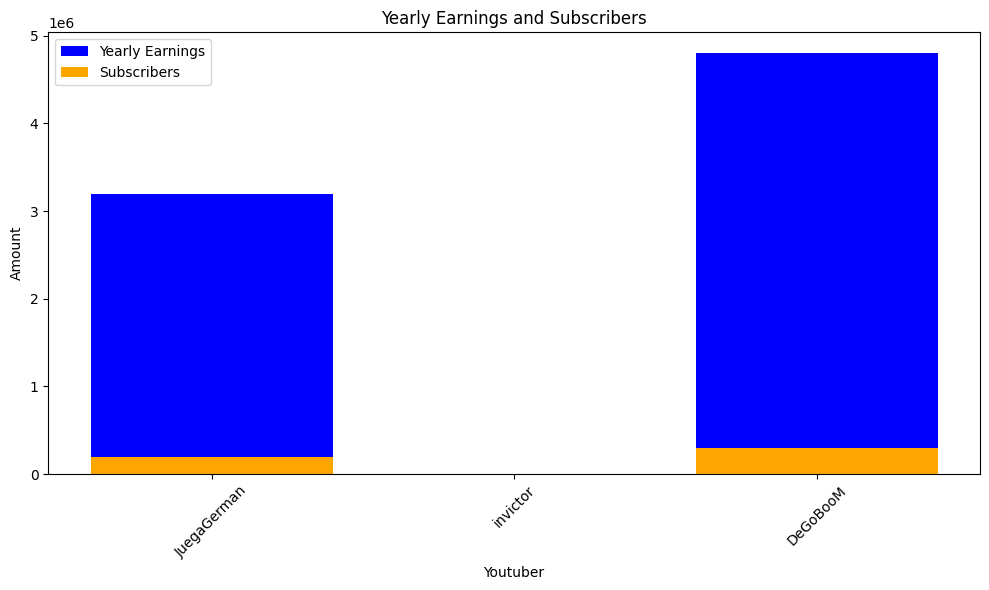

  6%|▌         | 123/2160 [01:18<13:51,  2.45it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529000.0, Youtuber: Justin Bieber
highest_yearly_earnings: 26900000.0, Subscribers: 1700000.0, Youtuber: Super Simple Songs - Kids Songs
highest_yearly_earnings: 17900000.0, Subscribers: 1100000.0, Youtuber: The Weeknd
highest_yearly_earnings: 4300000.0, Subscribers: 266200.0, Youtuber: Shawn Mendes
highest_yearly_earnings: 2600000.0, Subscribers: 164800.0, Youtuber: VanossGaming
highest_yearly_earnings: 2400000.0, Subscribers: 147000.0, Youtuber: WatchMojo.com
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: FaZe Rug
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Pentatonix
highest_yearly_earnings: 4200000.0, Subscribers: 264700.0, Youtuber: Linus Tech Tips
highest_yearly_earnings: 255800.0, Subscribers: 16000.0, Youtuber: Lilly Singh
highest_yearly_earnings: 4000000.0, Subscribers: 251800.0, Youtuber: Hacksmith Industries
highest_yearly_earnings: 1600000.0, Sub

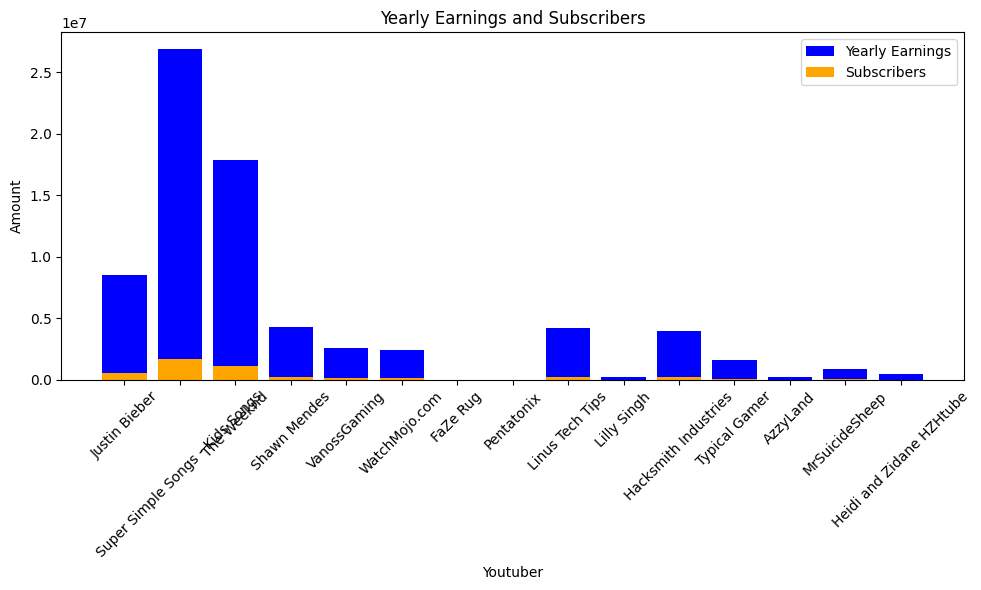

  6%|▌         | 126/2160 [01:20<15:31,  2.18it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Canal KondZilla
highest_yearly_earnings: 6300000.0, Subscribers: 391100.0, Youtuber: Felipe Neto
highest_yearly_earnings: 2300000.0, Subscribers: 144100.0, Youtuber: Vocï¿½ï¿½ï¿½
highest_yearly_earnings: 1300000.0, Subscribers: 80100.0, Youtuber: whinderssonnunes
highest_yearly_earnings: 78500000.0, Subscribers: 4900000.0, Youtuber: GR6 EXPLODE
highest_yearly_earnings: 12100000.0, Subscribers: 754300.0, Youtuber: Maria Clara & JP
highest_yearly_earnings: 19400000.0, Subscribers: 1200000.0, Youtuber: Galinha Pintadinha
highest_yearly_earnings: 2100000.0, Subscribers: 133500.0, Youtuber: rezendeevil
highest_yearly_earnings: 14500000.0, Subscribers: 909300.0, Youtuber: Enaldinho
highest_yearly_earnings: 4000000.0, Subscribers: 248700.0, Youtuber: Renato Garcia YT
highest_yearly_earnings: 36500000.0, Subscribers: 2300000.0, Youtuber: Spider Slack
highest_yearly_earnings: 140000

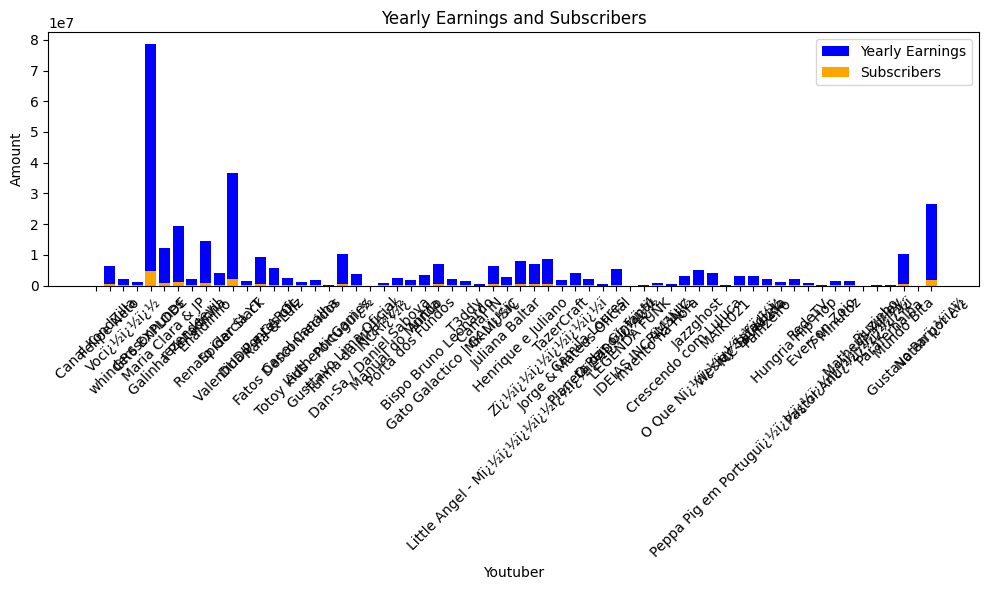

  6%|▌         | 129/2160 [01:22<16:14,  2.08it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


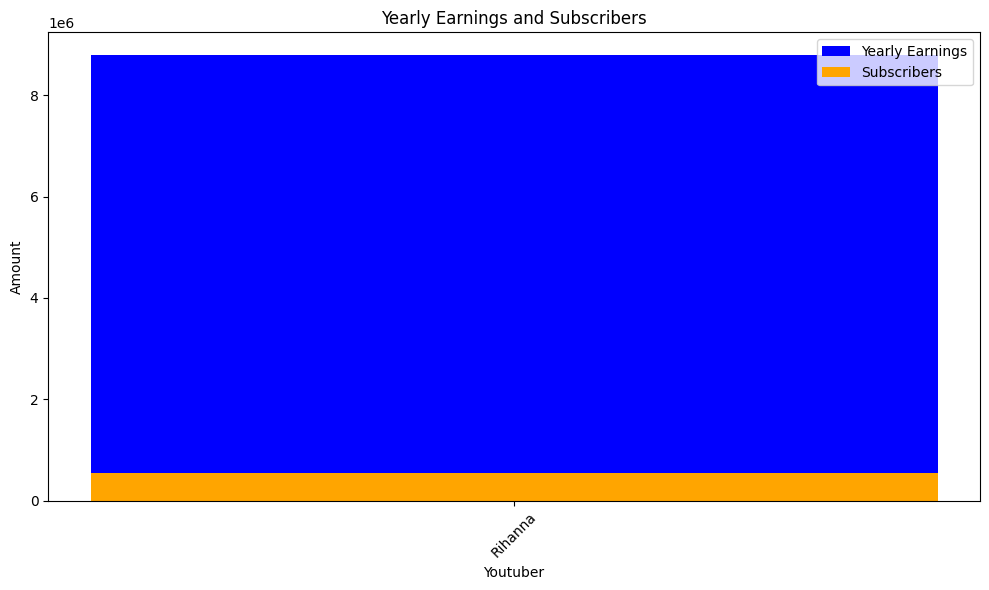

  6%|▌         | 132/2160 [01:23<12:09,  2.78it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


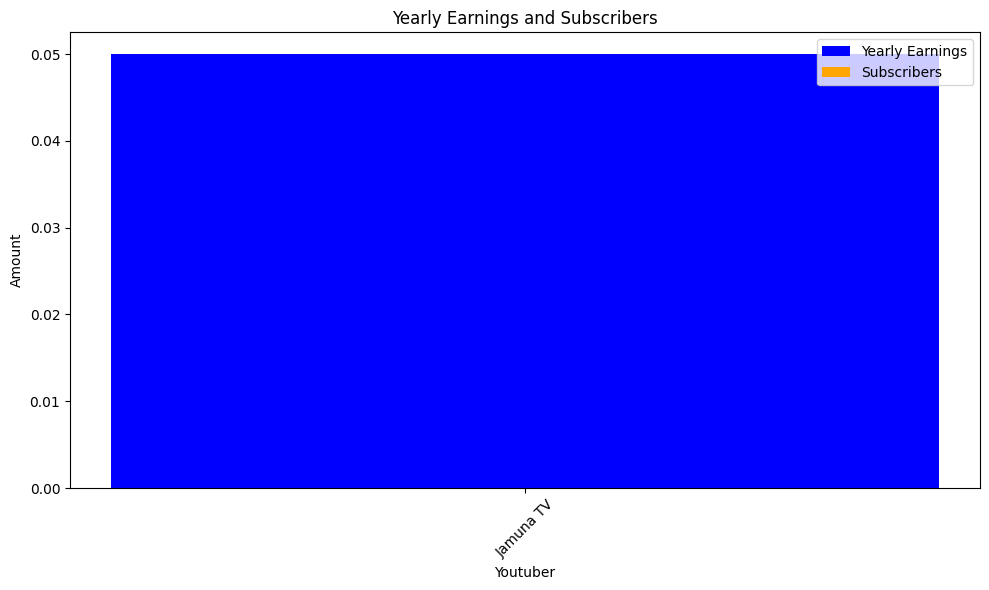

  6%|▋         | 135/2160 [01:24<10:40,  3.16it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: The Game Theorists


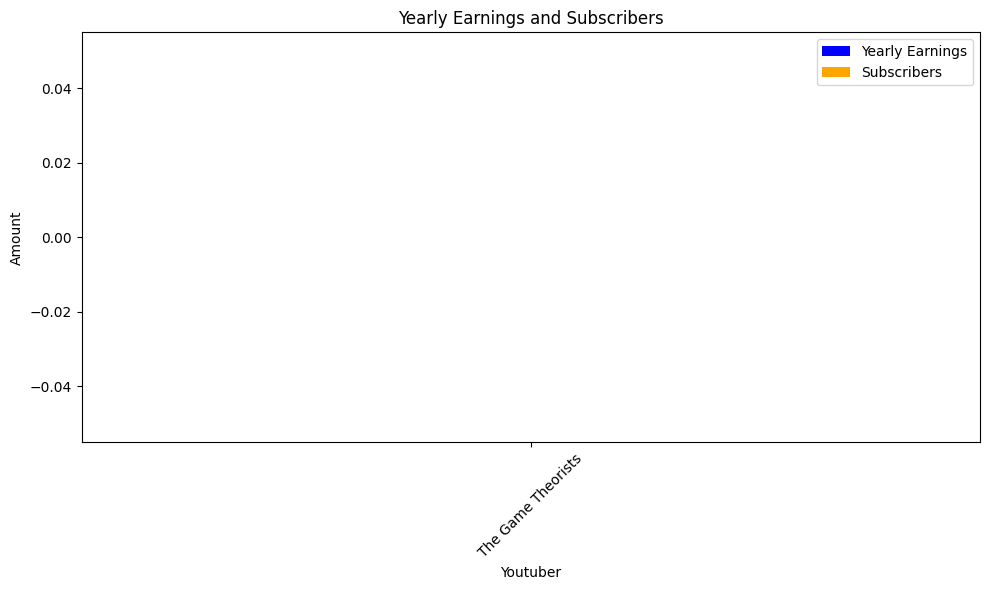

  6%|▋         | 138/2160 [01:25<10:05,  3.34it/s]check
highest_yearly_earnings: 29400000.0, Subscribers: 1800000.0, Youtuber: El Reino Infantil
highest_yearly_earnings: 14500000.0, Subscribers: 906200.0, Youtuber: La Granja de Zenï¿½
highest_yearly_earnings: 9200000.0, Subscribers: 572000.0, Youtuber: TheDonato
highest_yearly_earnings: 0.72, Subscribers: 0.05, Youtuber: Maluma
highest_yearly_earnings: 19300000.0, Subscribers: 1200000.0, Youtuber: Alejo Igoa
highest_yearly_earnings: 1700000.0, Subscribers: 106600.0, Youtuber: DrossRotzank
highest_yearly_earnings: 3500000.0, Subscribers: 216700.0, Youtuber: Paulo Londra
highest_yearly_earnings: 9300000.0, Subscribers: 579500.0, Youtuber: Bizarrap
highest_yearly_earnings: 1300000.0, Subscribers: 82600.0, Youtuber: RobleisIUTU
highest_yearly_earnings: 30700000.0, Subscribers: 1900000.0, Youtuber: El Payaso Plim Plim
highest_yearly_earnings: 4000000.0, Subscribers: 251100.0, Youtuber: El Reino a Jugar
highest_yearly_earnings: 3100000.0, Su

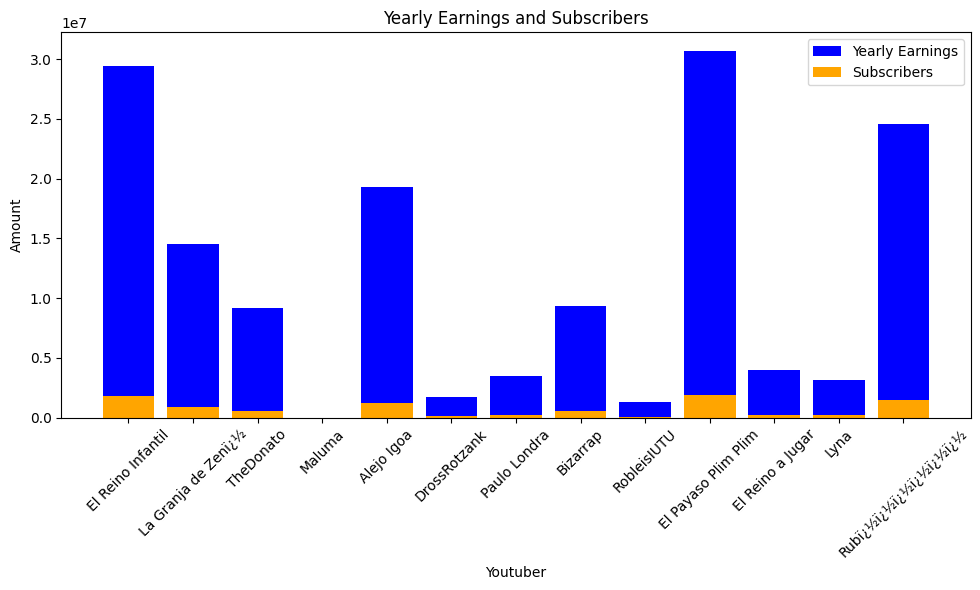

  7%|▋         | 141/2160 [01:26<10:42,  3.14it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


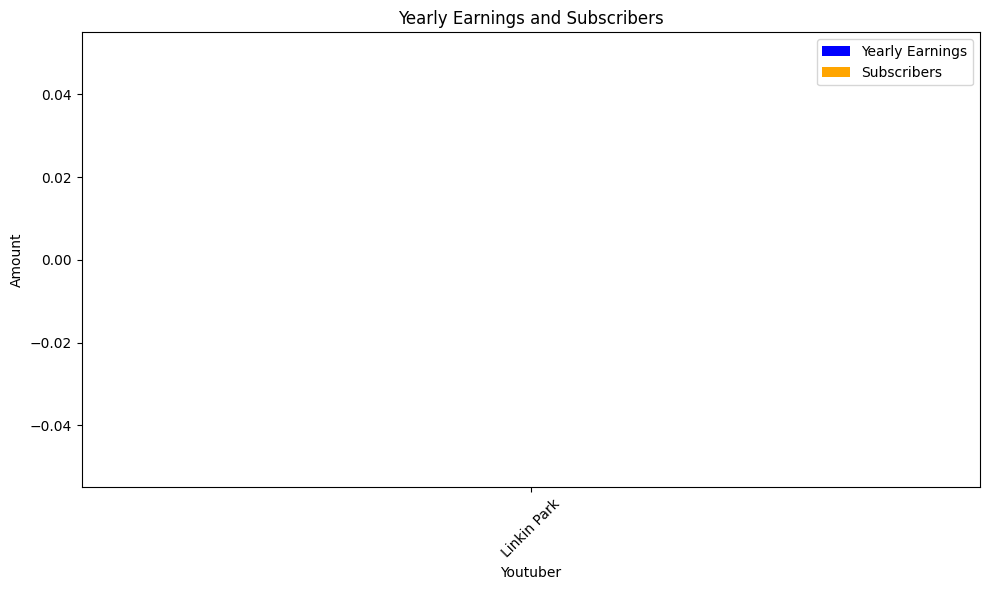

  7%|▋         | 144/2160 [01:27<10:09,  3.31it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


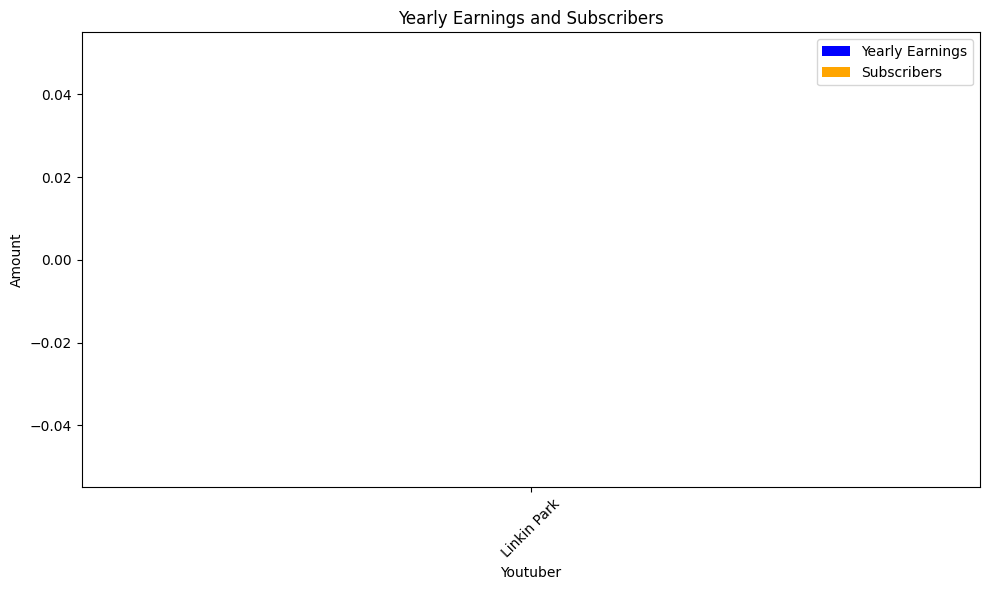

check
highest_yearly_earnings: 4100000.0, Subscribers: 253400.0, Youtuber: Like Nastya VNM
highest_yearly_earnings: 12300000.0, Subscribers: 770200.0, Youtuber: POPS Kids
highest_yearly_earnings: 1700000.0, Subscribers: 105400.0, Youtuber: FAPTV


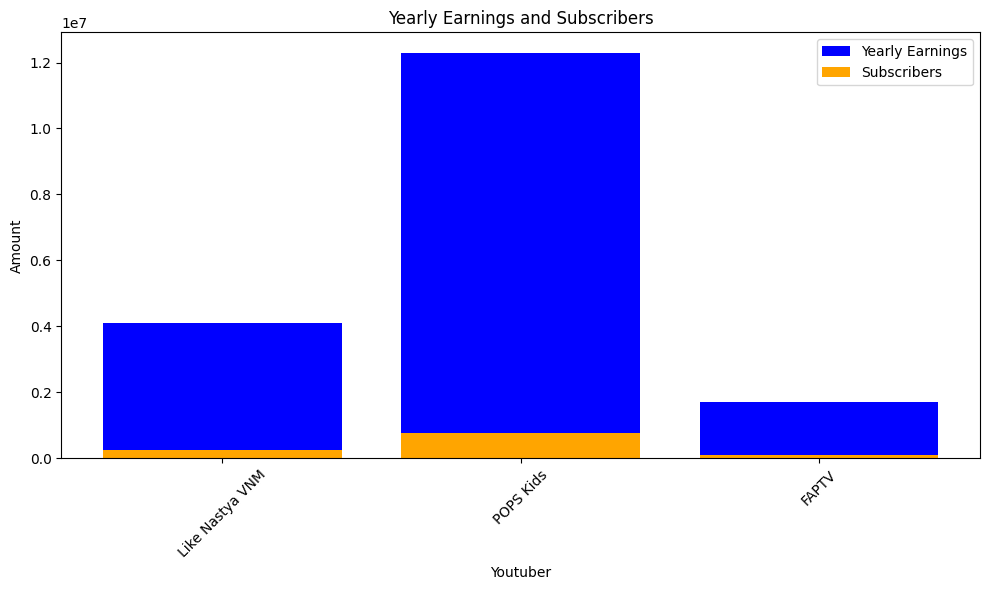

  7%|▋         | 147/2160 [01:29<14:52,  2.25it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


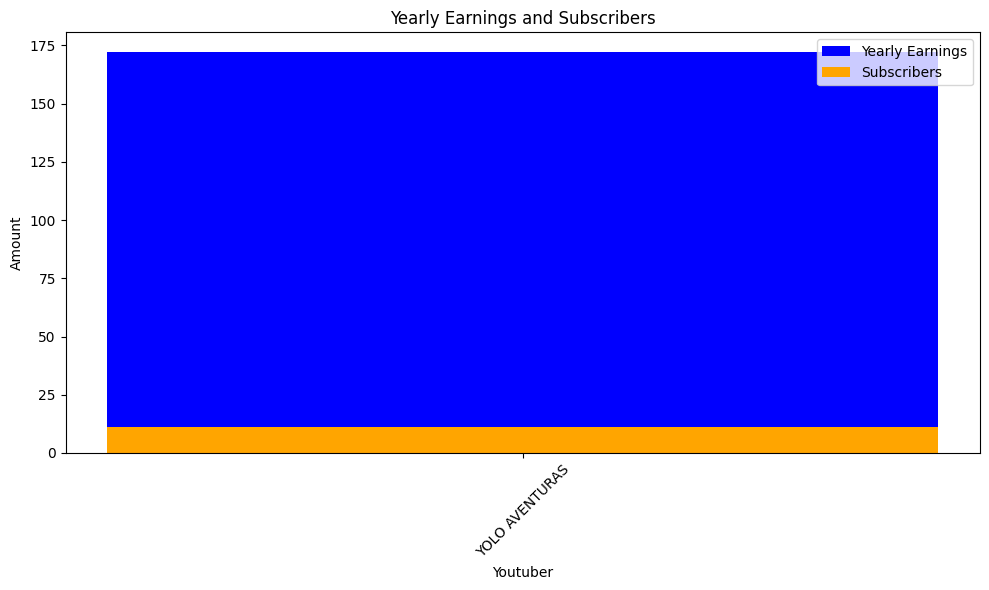

  7%|▋         | 150/2160 [01:31<15:04,  2.22it/s]check
highest_yearly_earnings: 4300000.0, Subscribers: 265900.0, Youtuber: Mark Rober
highest_yearly_earnings: 635800.0, Subscribers: 39700.0, Youtuber: TED
highest_yearly_earnings: 2200000.0, Subscribers: 139500.0, Youtuber: Apple
highest_yearly_earnings: 2500000.0, Subscribers: 157000.0, Youtuber: Marques Brownlee


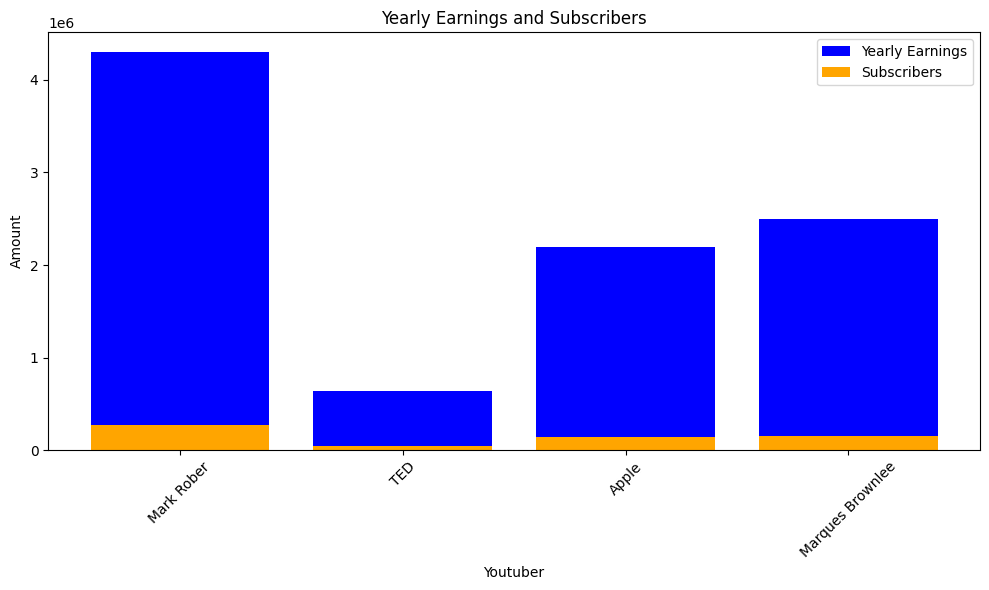

  7%|▋         | 153/2160 [01:32<14:51,  2.25it/s]check
highest_yearly_earnings: 8000000.0, Subscribers: 503100.0, Youtuber: Mrwhosetheboss


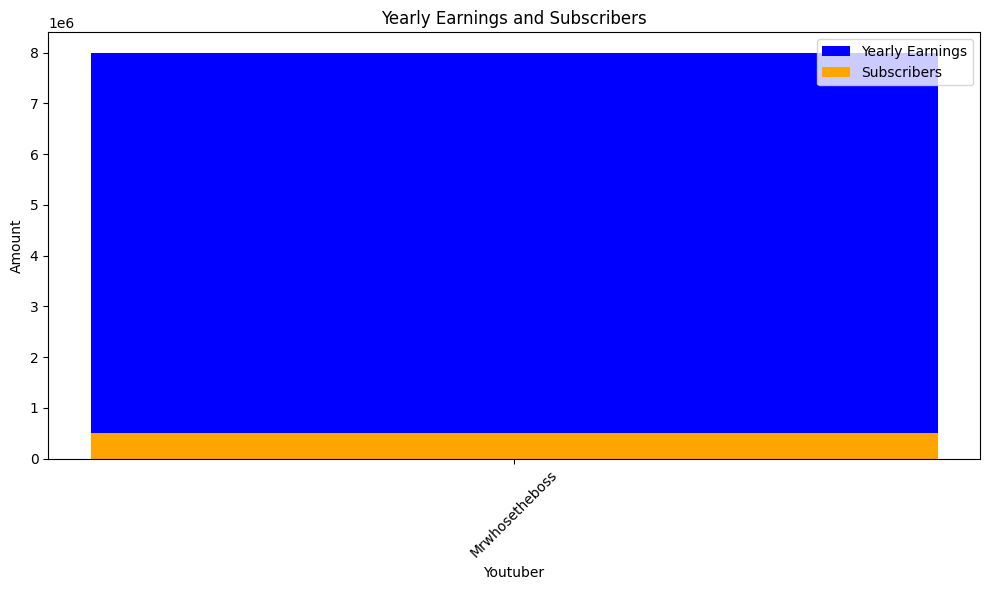

  7%|▋         | 156/2160 [01:33<11:47,  2.83it/s]check
highest_yearly_earnings: 11900000.0, Subscribers: 743200.0, Youtuber: shfa2 - ï¿½ï¿½
highest_yearly_earnings: 7300000.0, Subscribers: 453600.0, Youtuber: shfa show India
highest_yearly_earnings: 76700000.0, Subscribers: 4800000.0, Youtuber: ZAMZAM ELECTRONICS TRADING
highest_yearly_earnings: 746700.0, Subscribers: 46700.0, Youtuber: Noor Stars
highest_yearly_earnings: 3800000.0, Subscribers: 240500.0, Youtuber: FFUNTV
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Supercar Blondie
highest_yearly_earnings: 3900000.0, Subscribers: 240700.0, Youtuber: AlArabiya ï¿½ï¿½ï¿½ï¿½ï¿


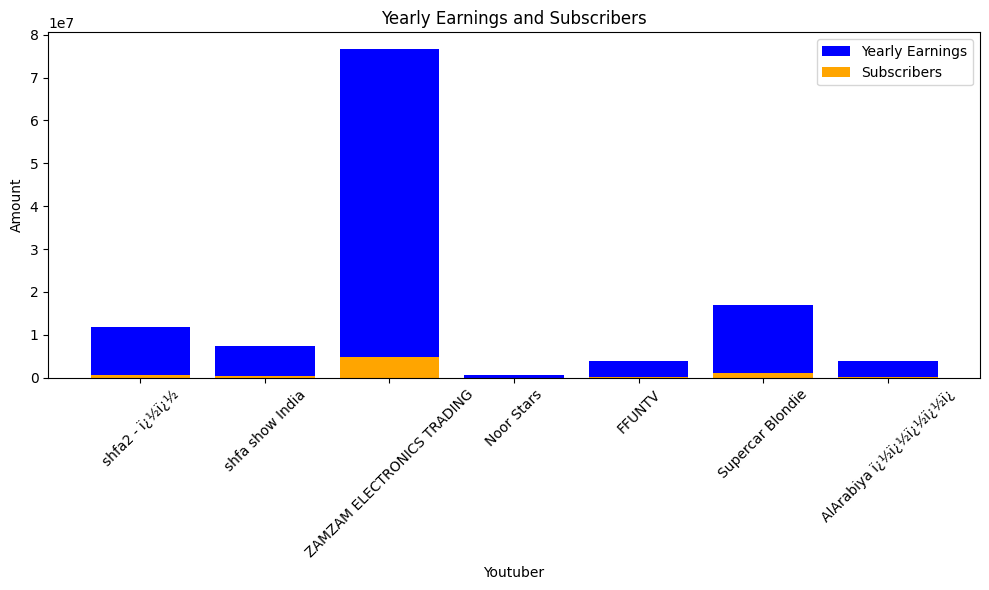

  7%|▋         | 159/2160 [01:35<11:08,  2.99it/s]check
highest_yearly_earnings: 1400000.0, Subscribers: 87000.0, Youtuber: SlivkiShow
highest_yearly_earnings: 3300000.0, Subscribers: 204000.0, Youtuber: ýýýýýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 17800000.0, Subscribers: 1100000.0, Youtuber: News 24
highest_yearly_earnings: 2300000.0, Subscribers: 141400.0, Youtuber: ýýýýýýýý ýýýýýýýý
highest_yearly_earnings: 5.0, Subscribers: 0.32, Youtuber: SIS vs BRO
highest_yearly_earnings: 3600000.0, Subscribers: 225500.0, Youtuber: Lady Diana
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: VexTrex
highest_yearly_earnings: 3400000.0, Subscribers: 213400.0, Youtuber: ýýýýýýýý ýýýý ýýýýýýýýýýýýýý


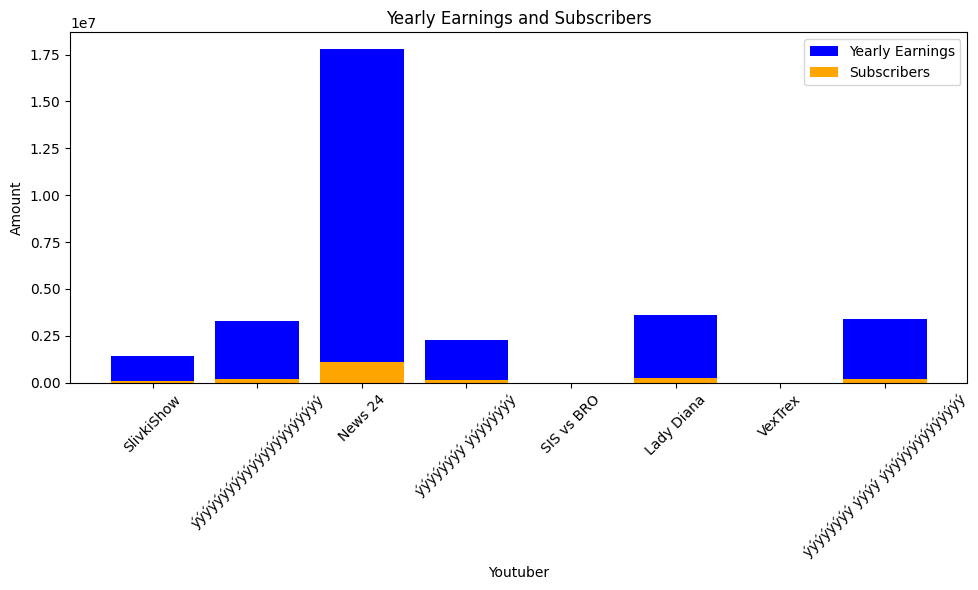

  8%|▊         | 162/2160 [01:36<11:32,  2.88it/s]check
highest_yearly_earnings: 70200000.0, Subscribers: 4400000.0, Youtuber: BETER Bï¿½ï¿½
highest_yearly_earnings: 20400000.0, Subscribers: 1300000.0, Youtuber: netd mï¿½ï¿
highest_yearly_earnings: 5300000.0, Subscribers: 332400.0, Youtuber: tabii Urdu
highest_yearly_earnings: 212500.0, Subscribers: 13300.0, Youtuber: Oyuncak Avï¿


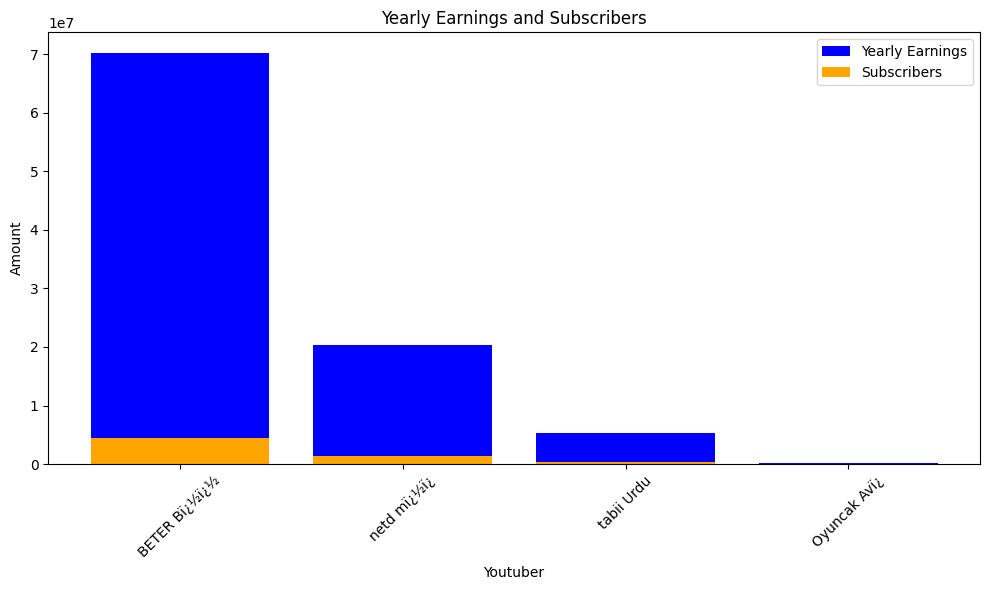

  8%|▊         | 165/2160 [01:37<11:05,  3.00it/s]check
highest_yearly_earnings: 1.0, Subscribers: 0.07, Youtuber: Alan Walker
highest_yearly_earnings: 6300000.0, Subscribers: 391400.0, Youtuber: WorkpointOfficial
highest_yearly_earnings: 6800000.0, Subscribers: 422300.0, Youtuber: ýýýýýýýýýýýý one31
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Ch3Thailand
highest_yearly_earnings: 6300000.0, Subscribers: 390700.0, Youtuber: GMM GRAMMY OFFICIAL
highest_yearly_earnings: 8100000.0, Subscribers: 505800.0, Youtuber: GRAMMY GOLD OFFICIAL
highest_yearly_earnings: 2600000.0, Subscribers: 162400.0, Youtuber: RsiamMusic : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: zbing z.
highest_yearly_earnings: 11300000.0, Subscribers: 708000.0, Youtuber: AMARINTV : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 448400.0, Subscribers: 28000.0, Youtuber: Kaykai Salaider
highest_yearly_earnings: 4200000.0, Subscribers: 263300.0, Yout

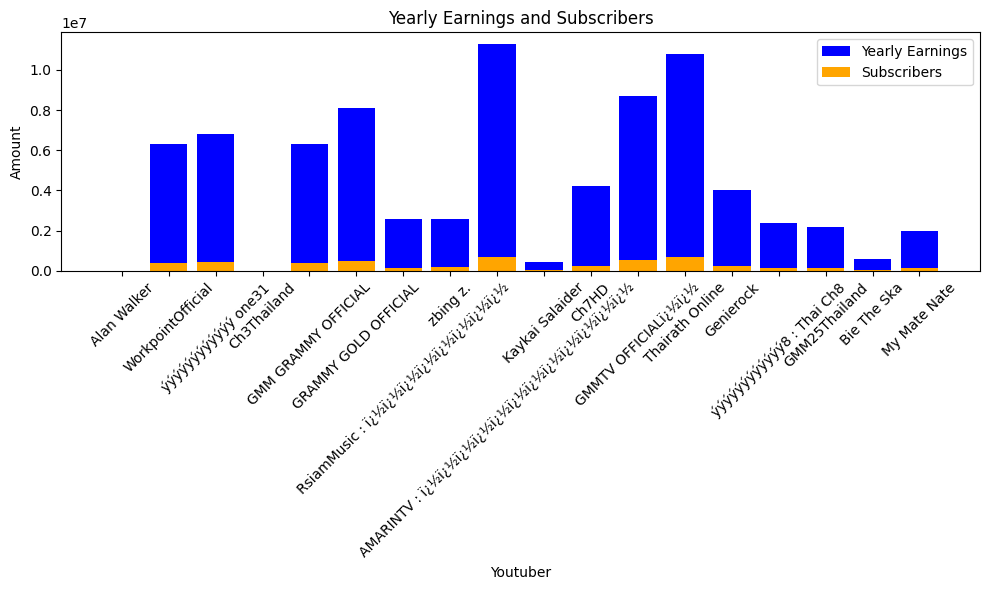

  8%|▊         | 168/2160 [01:38<11:27,  2.90it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


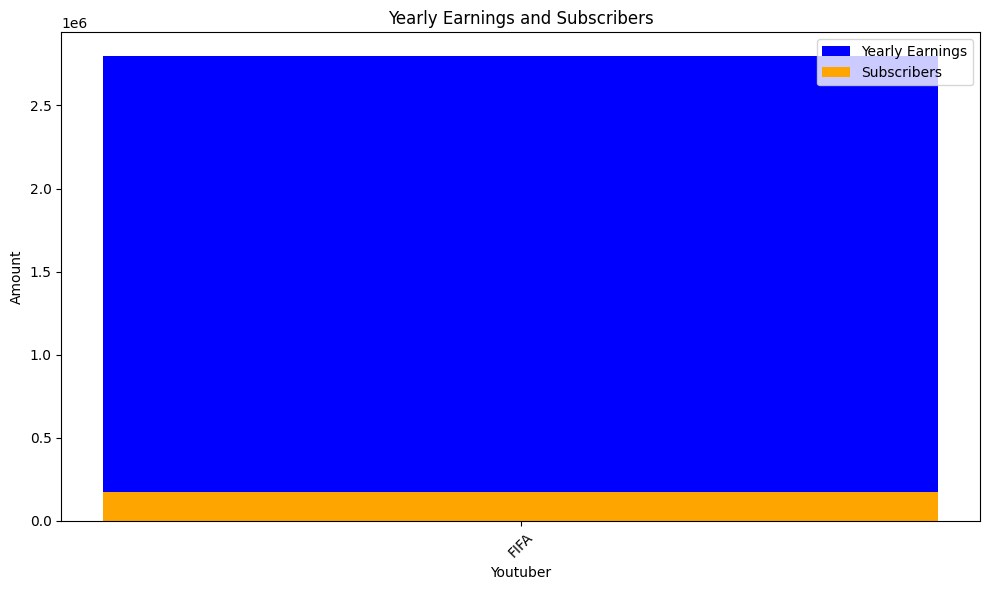

  8%|▊         | 171/2160 [01:39<10:30,  3.15it/s]check
highest_yearly_earnings: 3900000.0, Subscribers: 243700.0, Youtuber: Avicii
highest_yearly_earnings: 23000000.0, Subscribers: 1400000.0, Youtuber: Panda Shorts
highest_yearly_earnings: 658000.0, Subscribers: 41100.0, Youtuber: Narins Beauty
highest_yearly_earnings: 185800.0, Subscribers: 11600.0, Youtuber: RobTopGames


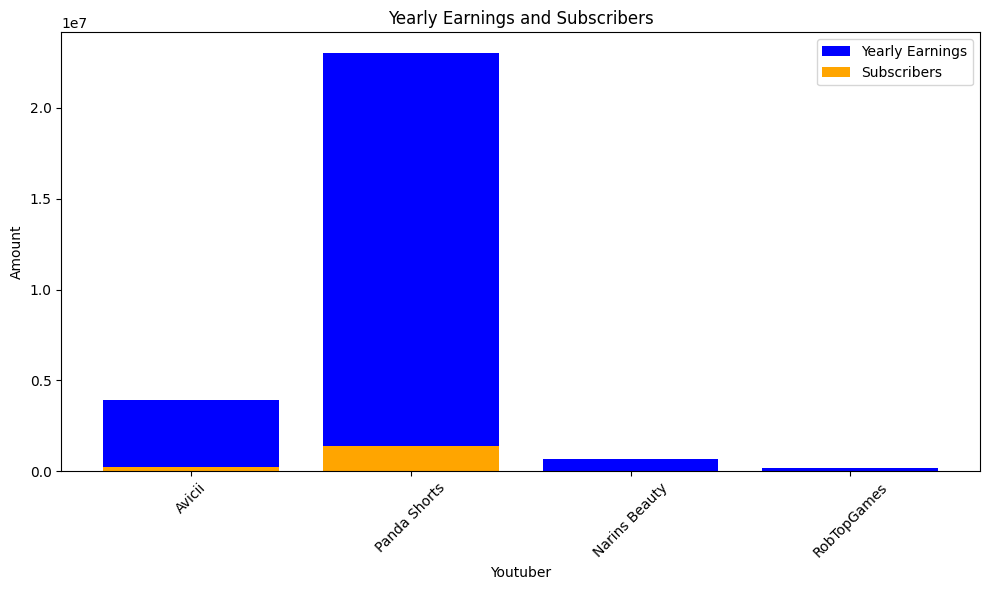

  8%|▊         | 174/2160 [01:41<10:29,  3.16it/s]check
highest_yearly_earnings: 12700000.0, Subscribers: 792300.0, Youtuber: Mikecrack
highest_yearly_earnings: 1900000.0, Subscribers: 117300.0, Youtuber: VEGETTA777
highest_yearly_earnings: 582900.0, Subscribers: 36400.0, Youtuber: AuronPlay
highest_yearly_earnings: 5.0, Subscribers: 0.31, Youtuber: CKN
highest_yearly_earnings: 528200.0, Subscribers: 33000.0, Youtuber: TheWillyrex
highest_yearly_earnings: 2100000.0, Subscribers: 131500.0, Youtuber: TheGrefg
highest_yearly_earnings: 739500.0, Subscribers: 46200.0, Youtuber: Willyrex
highest_yearly_earnings: 3100.0, Subscribers: 196.0, Youtuber: IDEAS EN 5 MINUTOS
highest_yearly_earnings: 0.19, Subscribers: 0.01, Youtuber: AdMe
highest_yearly_earnings: 4100000.0, Subscribers: 254600.0, Youtuber: FC Barcelona
highest_yearly_earnings: 286600.0, Subscribers: 17900.0, Youtuber: Makiman131
highest_yearly_earnings: 665200.0, Subscribers: 41600.0, Youtuber: iTownGamePlay *Terror&Diversiï¿½ï
hig

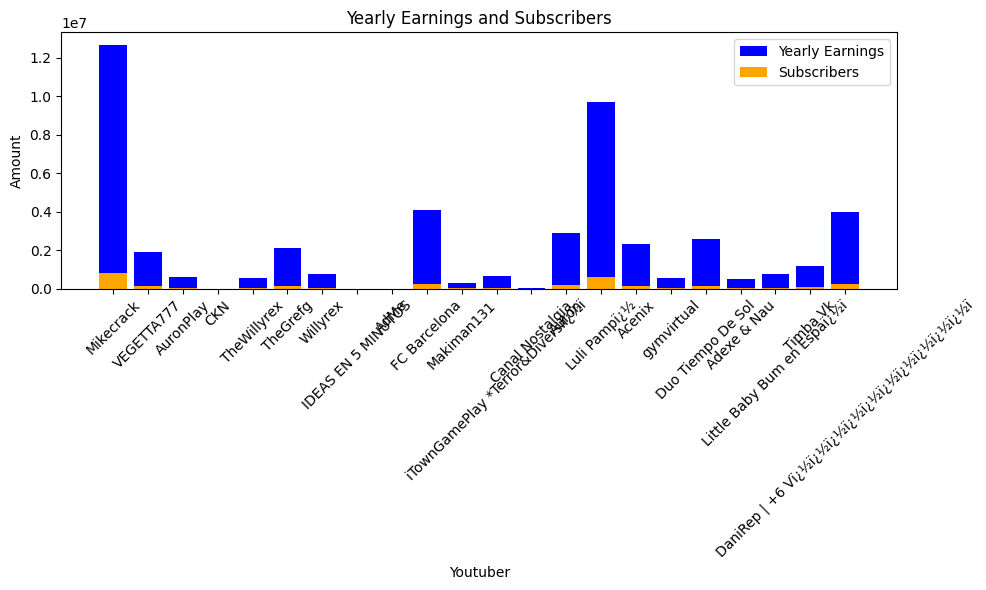

  8%|▊         | 177/2160 [01:43<16:35,  1.99it/s]check
highest_yearly_earnings: 23900000.0, Subscribers: 1500000.0, Youtuber: BLACKPINK
highest_yearly_earnings: 8100000.0, Subscribers: 504900.0, Youtuber: BANGTANTV
highest_yearly_earnings: 28700000.0, Subscribers: 1800000.0, Youtuber: HYBE LABELS
highest_yearly_earnings: 14800000.0, Subscribers: 922900.0, Youtuber: JYP Entertainment
highest_yearly_earnings: 5100000.0, Subscribers: 316700.0, Youtuber: 1theK (ï¿½ï¿½ï¿½ï¿½ï
highest_yearly_earnings: 7600000.0, Subscribers: 475600.0, Youtuber: Mnet K-POP
highest_yearly_earnings: 5200000.0, Subscribers: 324000.0, Youtuber: KBS WORLD TV
highest_yearly_earnings: 3100000.0, Subscribers: 195000.0, Youtuber: officialpsy
highest_yearly_earnings: 163400000.0, Subscribers: 10200000.0, Youtuber: ýýýýýýýýý KIMPRO
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Jane ASMR ï¿½ï¿½
highest_yearly_earnings: 532700.0, Subscribers: 33300.0, Youtuber: JFlaMusic
highest_yearly_earnings: 2000000.0, Su

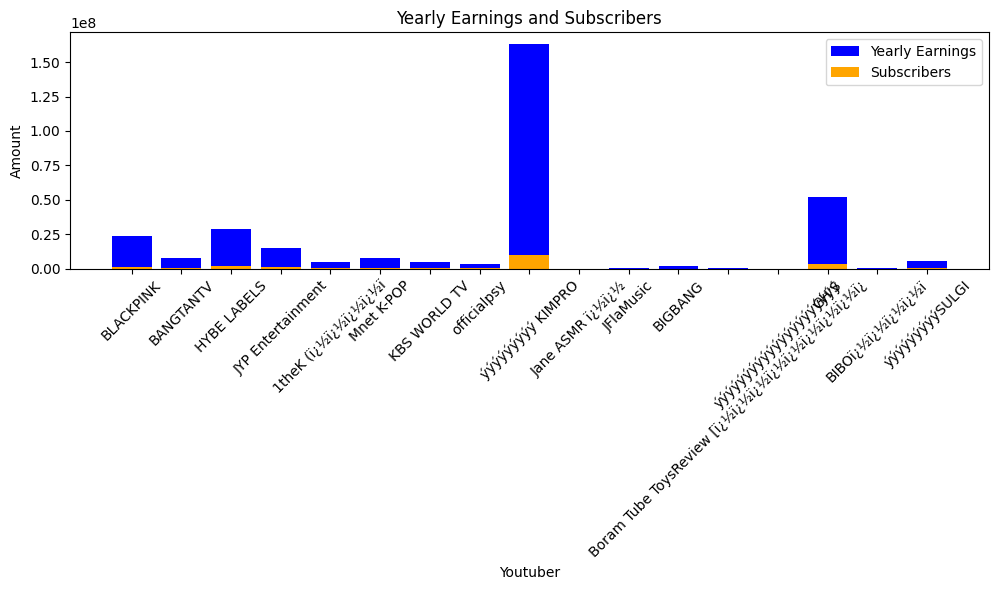

  8%|▊         | 180/2160 [01:45<17:41,  1.87it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Sandeep Maheshwari
highest_yearly_earnings: 5600000.0, Subscribers: 351600.0, Youtuber: LEGO
highest_yearly_earnings: 45100.0, Subscribers: 2800.0, Youtuber: MY FAMILY


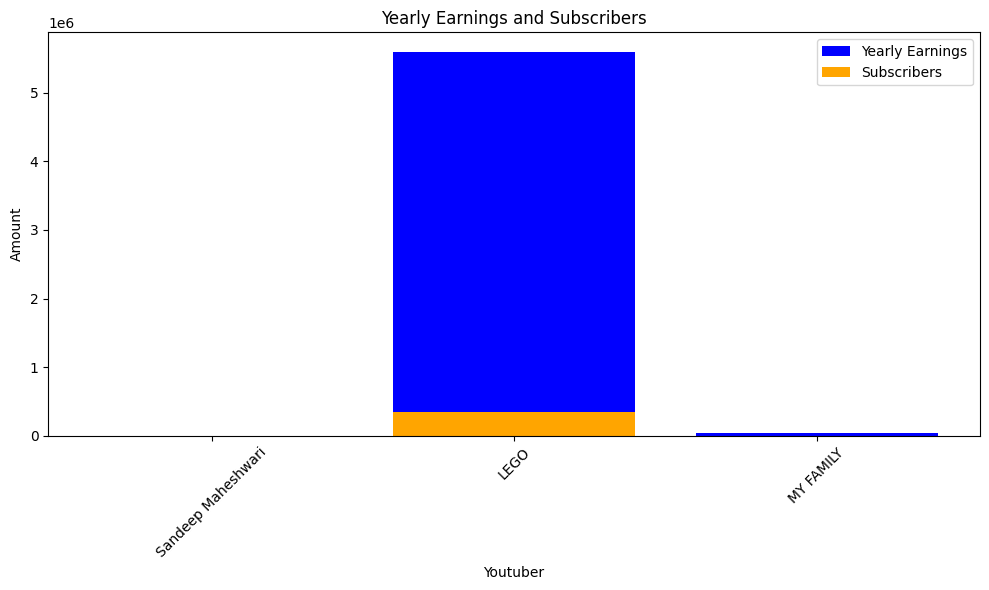

  8%|▊         | 183/2160 [01:47<15:46,  2.09it/s]check
highest_yearly_earnings: 76300.0, Subscribers: 4800.0, Youtuber: shfa
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: 1MILLION Dance Studio
highest_yearly_earnings: 3500000.0, Subscribers: 221500.0, Youtuber: mmoshaya
highest_yearly_earnings: 2100000.0, Subscribers: 129000.0, Youtuber: ýýýýýýýý ýýýýýýýýýý ýýýýýýýýýý | Arab Games Network
highest_yearly_earnings: 4400000.0, Subscribers: 272700.0, Youtuber: Katakit Baby TV
highest_yearly_earnings: 6500000.0, Subscribers: 405100.0, Youtuber: ýýýýýýýý ýý ýýýýýýýý
highest_yearly_earnings: 129300.0, Subscribers: 8100.0, Youtuber: ýýýýýýýýýý ýýýýýýýýýýýý
highest_yearly_earnings: 224300.0, Subscribers: 14000.0, Youtuber: ýýýýýýýýýýýý ýýýýýýýýýýýý I ýýýýýý ýý ýýýýýýýýýý
highest_yearly_earnings: 3400000.0, Subscribers: 212100.0, Youtuber: BanderitaX


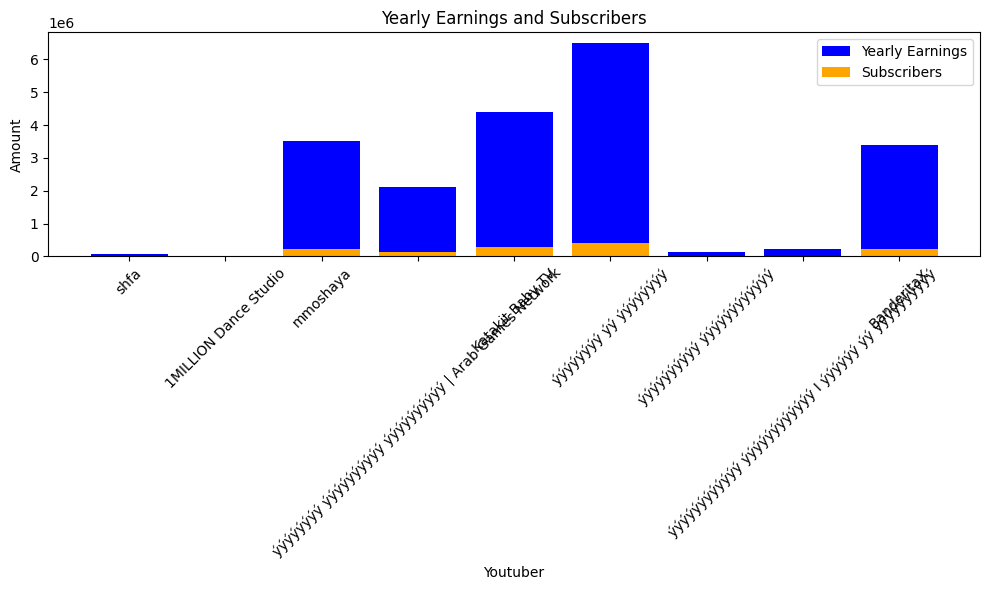

  9%|▊         | 186/2160 [01:48<12:46,  2.58it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


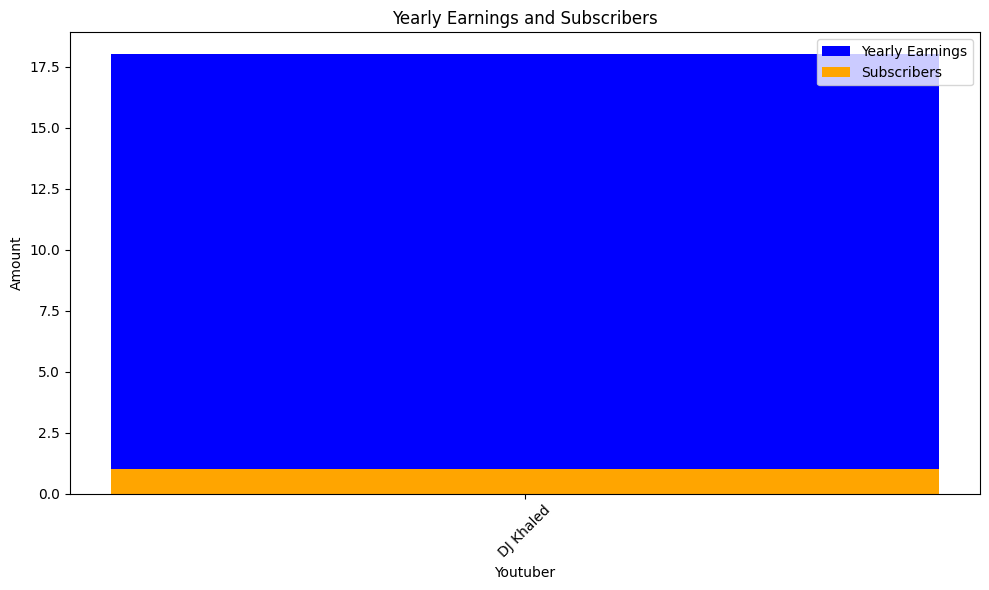

  9%|▉         | 189/2160 [01:49<10:49,  3.03it/s]check
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya
highest_yearly_earnings: 14700000.0, Subscribers: 919600.0, Youtuber: Get Movies
highest_yearly_earnings: 14600000.0, Subscribers: 911300.0, Youtuber: ýýýýýýýý ýý ýýýýýýýýýýýýýý
highest_yearly_earnings: 26500000.0, Subscribers: 1700000.0, Youtuber: tuzelity SHUFFLE
highest_yearly_earnings: 1200000.0, Subscribers: 73700.0, Youtuber: HiMan
highest_yearly_earnings: 1800000.0, Subscribers: 114800.0, Youtuber: Marmok
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya Vlog
highest_yearly_earnings: 1800000.0, Subscribers: 111500.0, Youtuber: TheBrianMaps
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: ýýýýýýýýýý
highest_yearly_earnings: 22800000.0, Subscribers: 1400000.0, Youtuber: ILYA BORZOV
highest_yearly_earnings: 4600000.0, Subscribers: 286800.0, Youtuber: EdisonPts
highest_yearly_earnings: 34200000.0, Subscribers

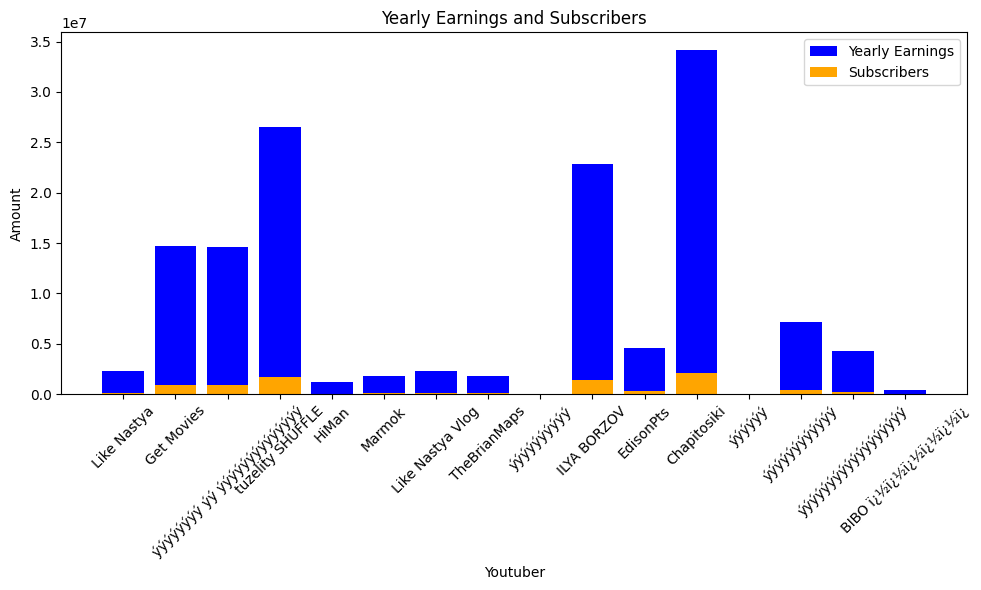

  9%|▉         | 192/2160 [01:50<11:20,  2.89it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529900.0, Youtuber: ABS-CBN Entertainment
highest_yearly_earnings: 38300000.0, Subscribers: 2400000.0, Youtuber: GMA  Network
highest_yearly_earnings: 7800000.0, Subscribers: 489400.0, Youtuber: Raffy Tulfo in Action
highest_yearly_earnings: 6800000.0, Subscribers: 427000.0, Youtuber: GMA Public  Affairs
highest_yearly_earnings: 723800.0, Subscribers: 45200.0, Youtuber: Ivana Alawi
highest_yearly_earnings: 479000.0, Subscribers: 29900.0, Youtuber: Niana Guerrero
highest_yearly_earnings: 594000.0, Subscribers: 37100.0, Youtuber: Ranz Kyle
highest_yearly_earnings: 8700000.0, Subscribers: 544900.0, Youtuber: ABS-CBN News
highest_yearly_earnings: 3000000.0, Subscribers: 188000.0, Youtuber: Wish 107.5
highest_yearly_earnings: 580200.0, Subscribers: 36300.0, Youtuber: Zeinab Harake
highest_yearly_earnings: 5500000.0, Subscribers: 346400.0, Youtuber: GMA Integrated News
highest_yearly_earn

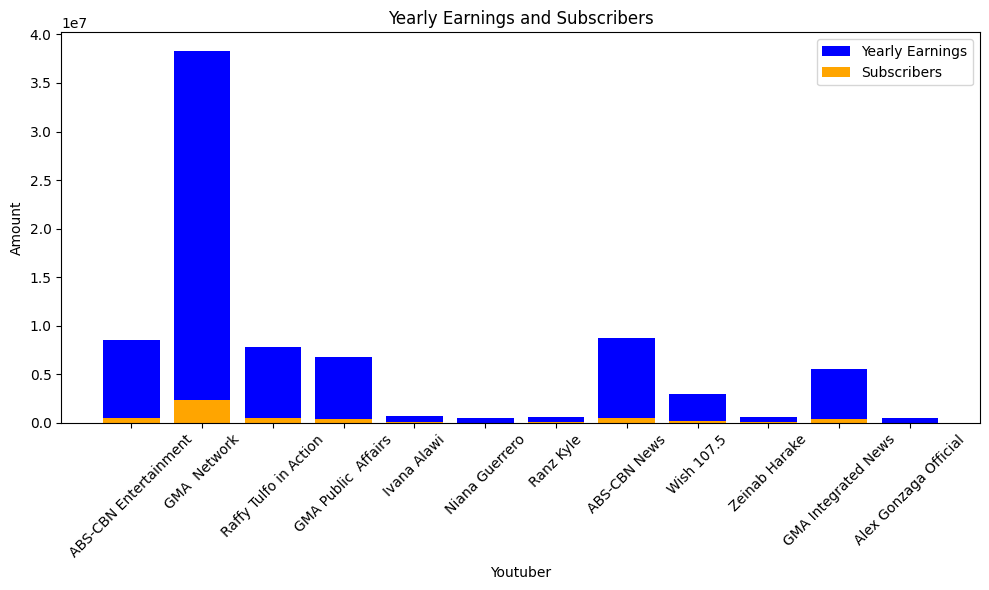

  9%|▉         | 195/2160 [01:52<12:00,  2.73it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


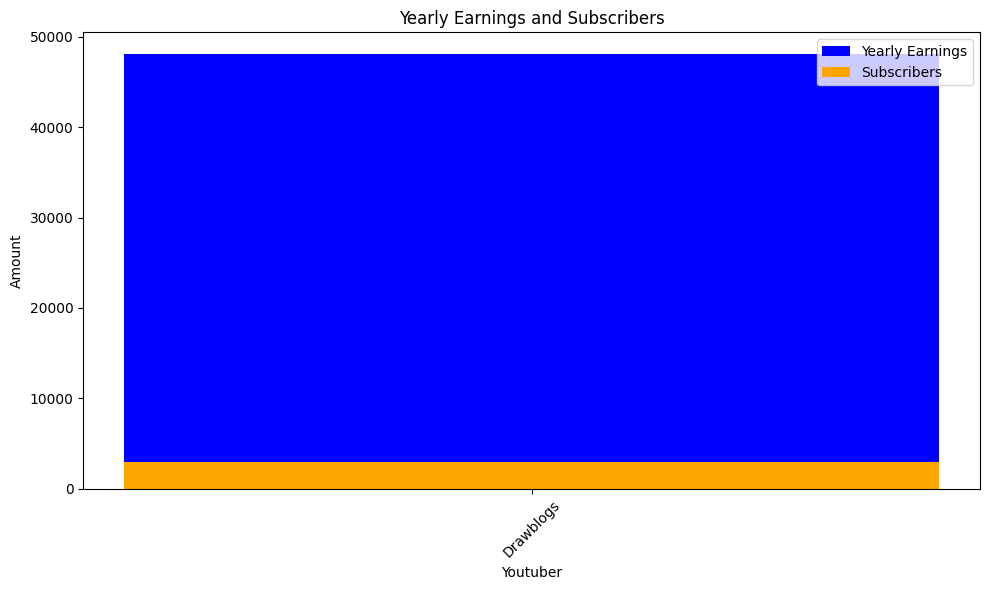

  9%|▉         | 198/2160 [01:53<11:00,  2.97it/s]check
highest_yearly_earnings: 64200000.0, Subscribers: 4000000.0, Youtuber: HAR PAL GEO
highest_yearly_earnings: 55200000.0, Subscribers: 3400000.0, Youtuber: ARY Digital HD
highest_yearly_earnings: 32900000.0, Subscribers: 2100000.0, Youtuber: HUM TV
highest_yearly_earnings: 4800000.0, Subscribers: 300200.0, Youtuber: Geo News
highest_yearly_earnings: 28.0, Subscribers: 2.0, Youtuber: Wolfoo Channel
highest_yearly_earnings: 419.0, Subscribers: 26.0, Youtuber: Quantum Tech HD


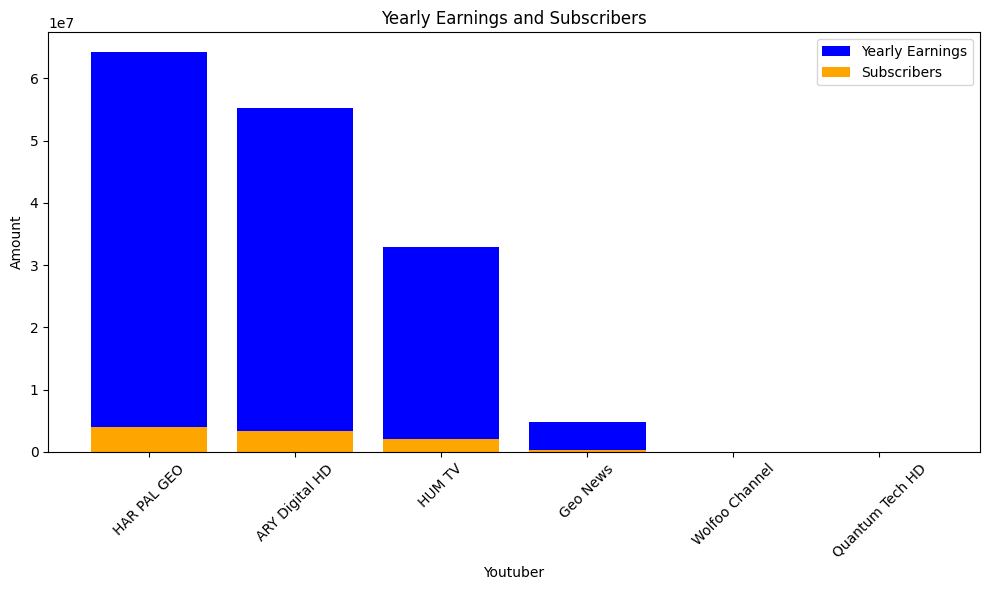

  9%|▉         | 201/2160 [01:54<11:03,  2.95it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300100.0, Youtuber: Spinnin' Records
highest_yearly_earnings: 1700000.0, Subscribers: 107800.0, Youtuber: NikkieTutorials
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: ýýýýýýýý/Atro


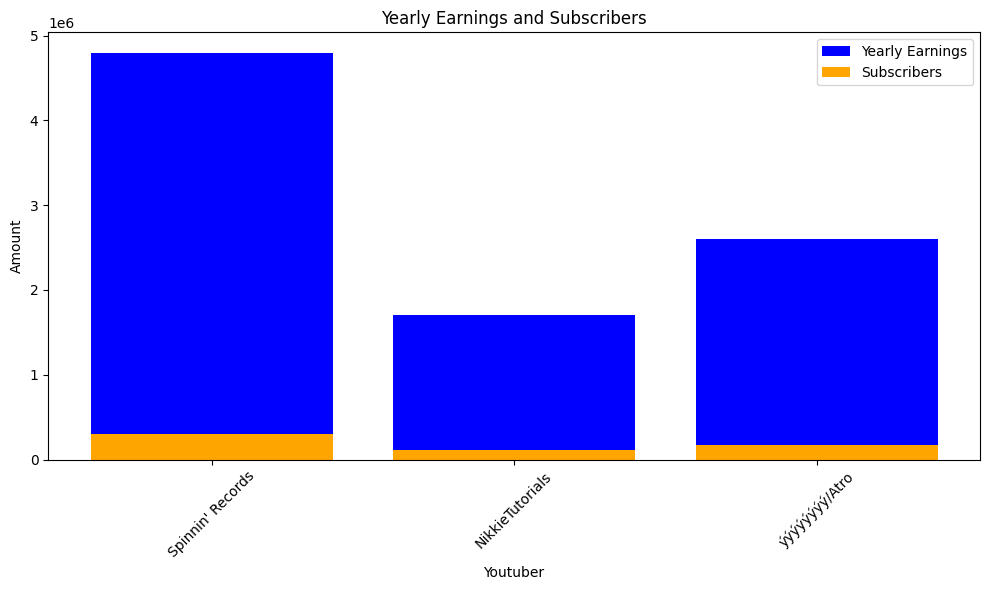

  9%|▉         | 204/2160 [01:55<10:53,  2.99it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


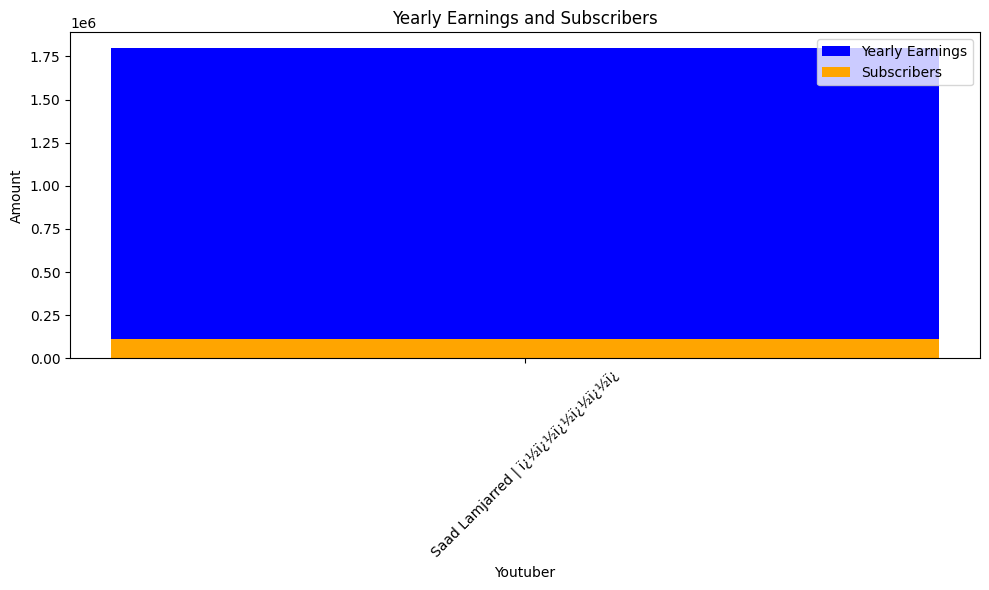

 10%|▉         | 207/2160 [01:56<10:43,  3.04it/s]check
highest_yearly_earnings: 6600000.0, Subscribers: 410200.0, Youtuber: Kimberly Loaiza
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Luisito Comunica
highest_yearly_earnings: 1500000.0, Subscribers: 94400.0, Youtuber: GENIAL
highest_yearly_earnings: 1500000.0, Subscribers: 91500.0, Youtuber: LosPolinesios
highest_yearly_earnings: 16100.0, Subscribers: 1000.0, Youtuber: Yuya
highest_yearly_earnings: 1600000.0, Subscribers: 100800.0, Youtuber: MrBeast en Espaï¿½ï
highest_yearly_earnings: 2200000.0, Subscribers: 140600.0, Youtuber: Juan De Dios Pantoja
highest_yearly_earnings: 6600000.0, Subscribers: 410500.0, Youtuber: BabyBus - Canciones Infantiles & Videos para Niï¿½ï
highest_yearly_earnings: 227.0, Subscribers: 14.0, Youtuber: Disney Latinoamï¿½ï¿½
highest_yearly_earnings: 742.0, Subscribers: 46.0, Youtuber: Tlnovelas
highest_yearly_earnings: 114300.0, Subscribers: 7100.0, Youtuber: JukiLop
highest_yearly_earnings: 5900

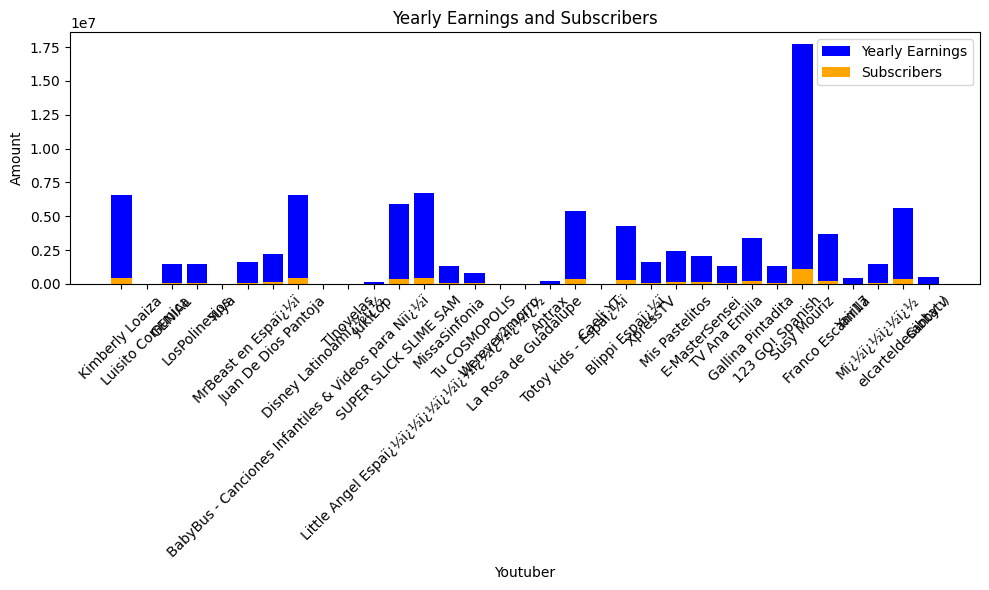

 10%|▉         | 210/2160 [01:59<16:51,  1.93it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


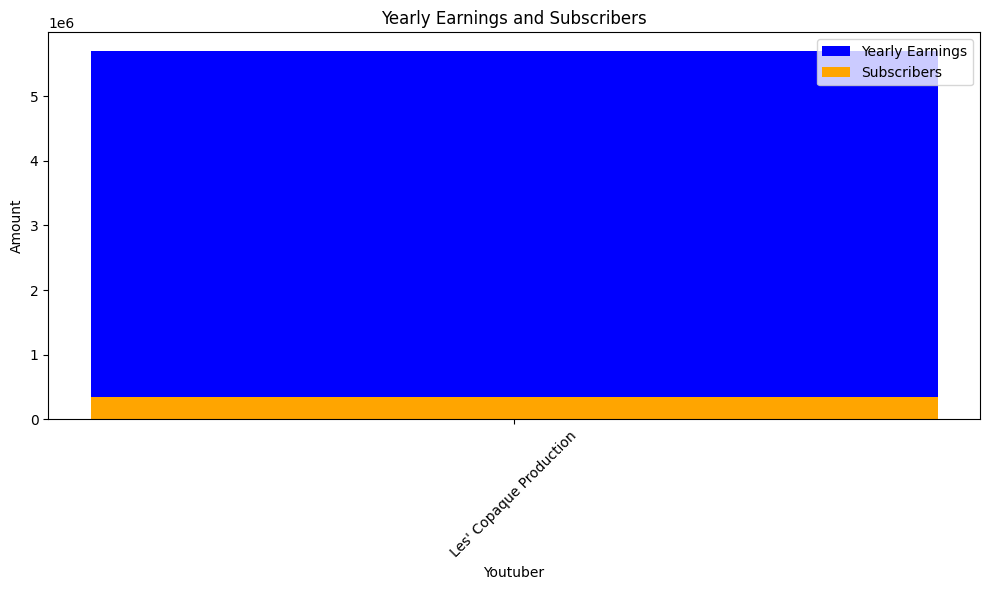

 10%|▉         | 213/2160 [02:00<15:55,  2.04it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


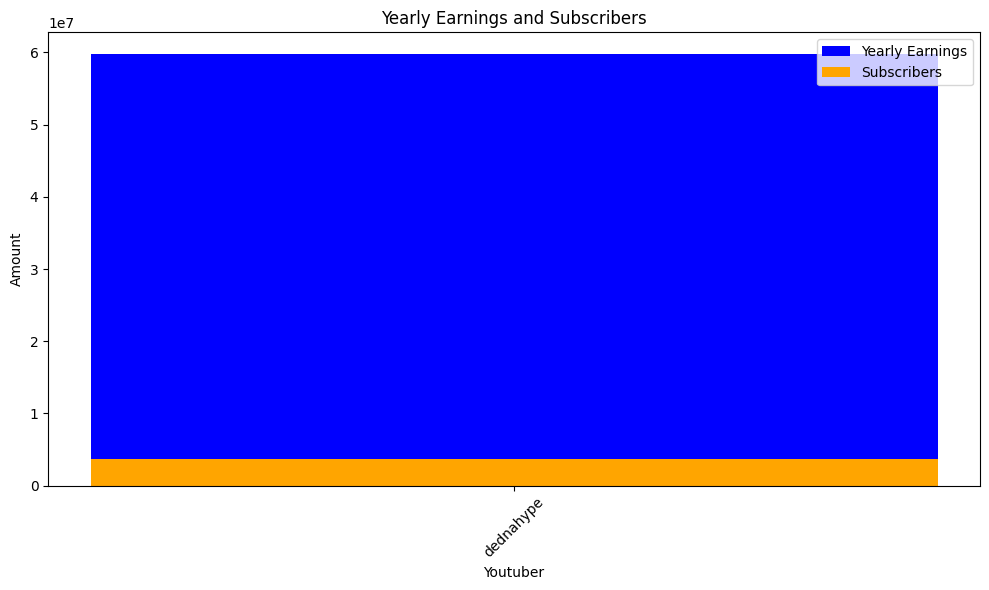

 10%|█         | 216/2160 [02:02<13:21,  2.43it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


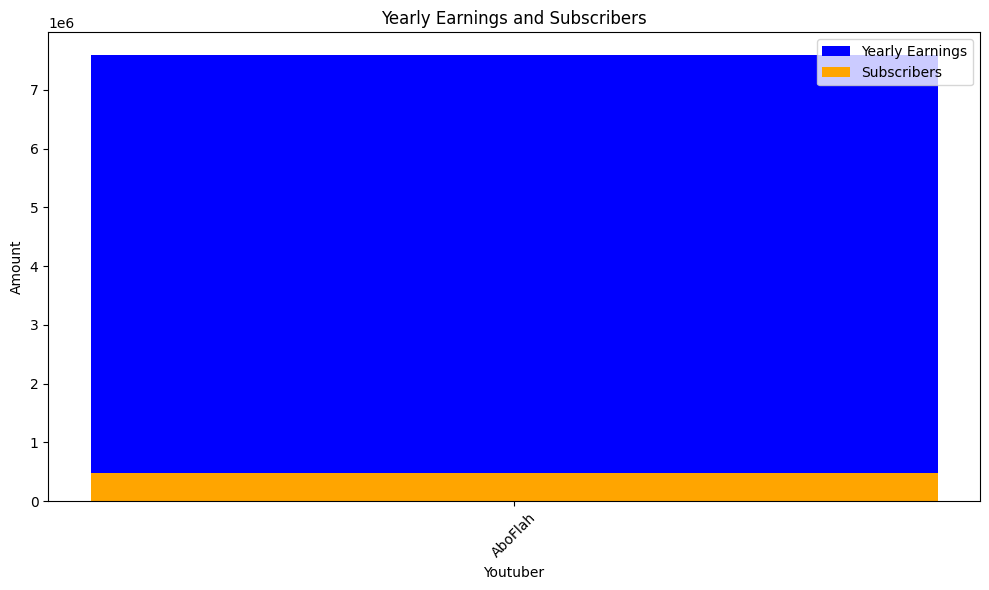

 10%|█         | 219/2160 [02:03<11:42,  2.76it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


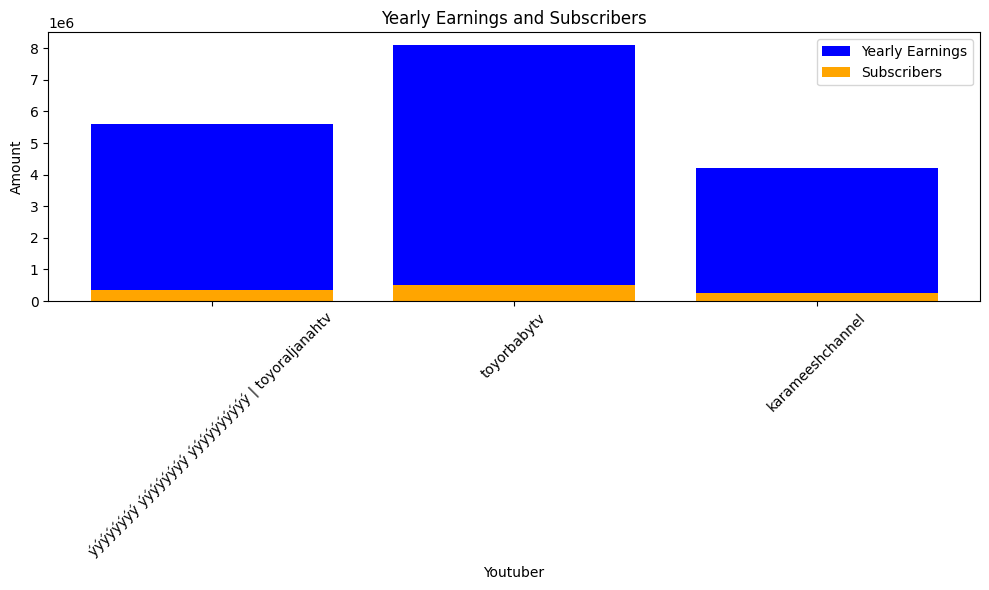

 10%|█         | 222/2160 [02:04<10:56,  2.95it/s]check
highest_yearly_earnings: 1900000.0, Subscribers: 117600.0, Youtuber: PewDiePie
highest_yearly_earnings: 34600000.0, Subscribers: 2200000.0, Youtuber: Junya.ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 34100000.0, Subscribers: 2100000.0, Youtuber: Sagawa /ï¿½ï¿½ï¿½
highest_yearly_earnings: 13600000.0, Subscribers: 847100.0, Youtuber: ISSEI / ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 119.0, Subscribers: 7.0, Youtuber: Bayashi TV


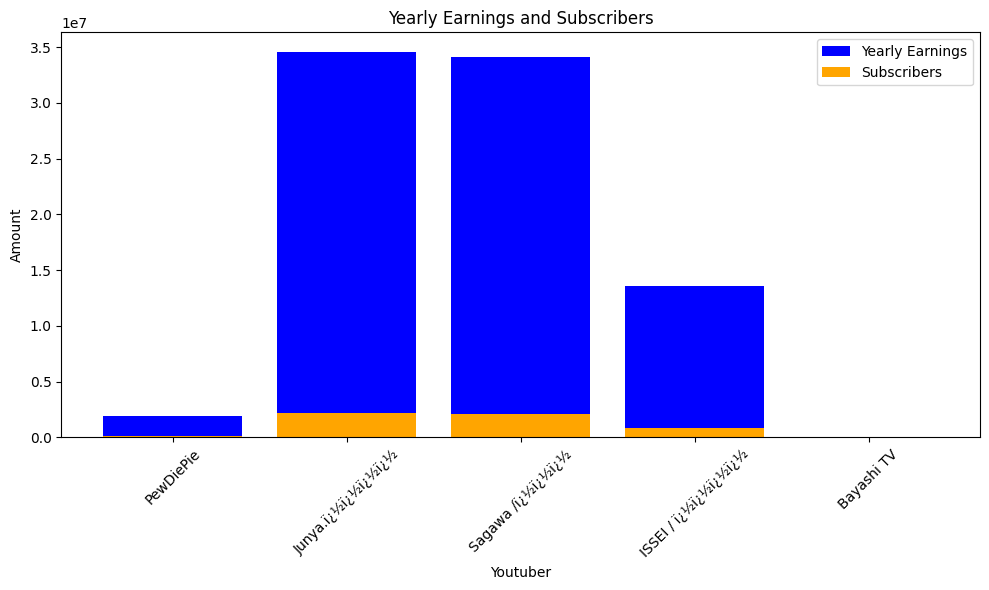

 10%|█         | 225/2160 [02:06<12:39,  2.55it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


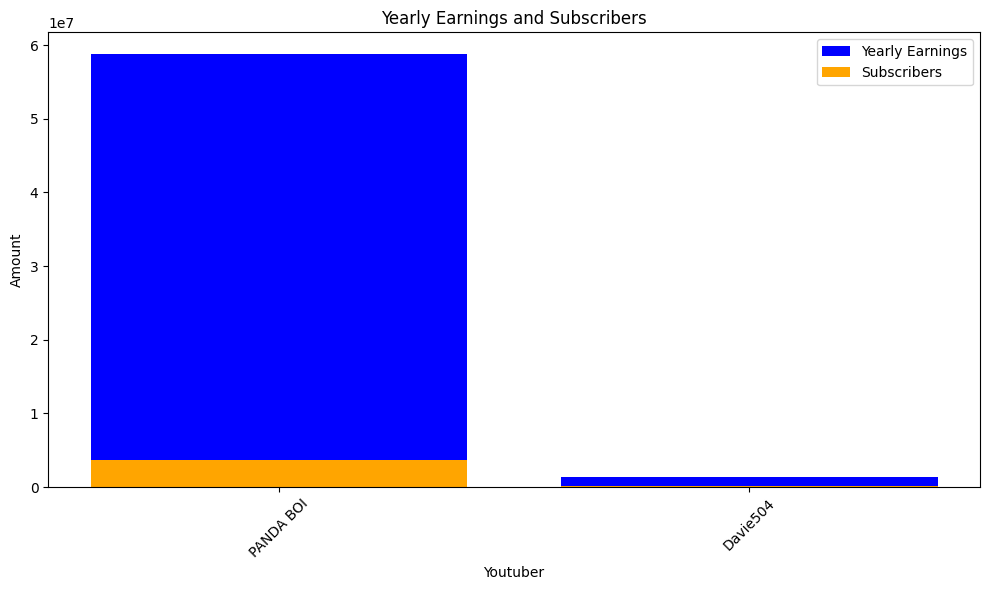

 11%|█         | 228/2160 [02:07<13:35,  2.37it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


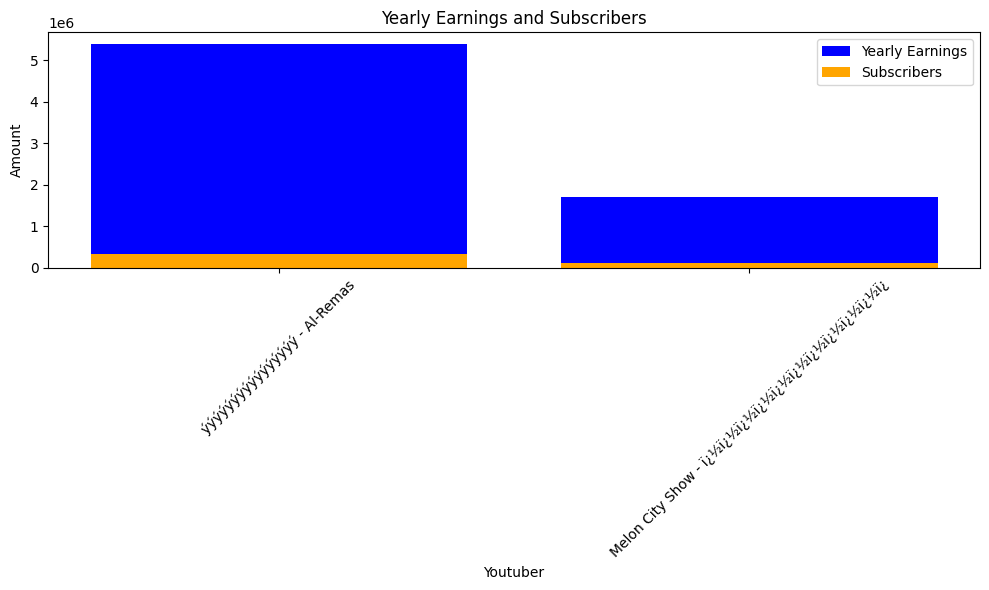

 11%|█         | 231/2160 [02:10<18:33,  1.73it/s]check
highest_yearly_earnings: 26300000.0, Subscribers: 1600000.0, Youtuber: Jess No Limit
highest_yearly_earnings: 7500000.0, Subscribers: 471300.0, Youtuber: Ricis Official
highest_yearly_earnings: 1000000.0, Subscribers: 64300.0, Youtuber: AH
highest_yearly_earnings: 11000000.0, Subscribers: 690500.0, Youtuber: Indosiar
highest_yearly_earnings: 2800000.0, Subscribers: 175500.0, Youtuber: Rans Entertainment
highest_yearly_earnings: 5900000.0, Subscribers: 369600.0, Youtuber: TRANS7 OFFICIAL
highest_yearly_earnings: 1300000.0, Subscribers: 80900.0, Youtuber: Baim Paula
highest_yearly_earnings: 4.0, Subscribers: 0.26, Youtuber: Deddy Corbuzier
highest_yearly_earnings: 5400000.0, Subscribers: 338300.0, Youtuber: BabyBus - Cerita & Lagu Anak-anak
highest_yearly_earnings: 3100000.0, Subscribers: 193500.0, Youtuber: MiawAug
highest_yearly_earnings: 9500000.0, Subscribers: 592100.0, Youtuber: Willie Salim
highest_yearly_earnings: 819000.0, S

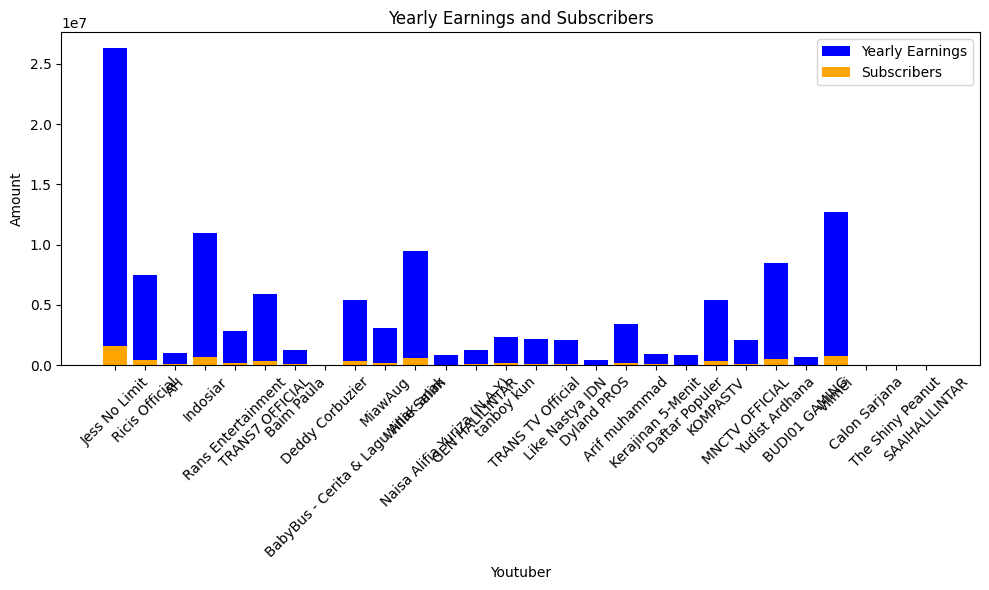

 11%|█         | 234/2160 [02:11<14:30,  2.21it/s]check
highest_yearly_earnings: 5200000.0, Subscribers: 327400.0, Youtuber: MR. INDIAN HACKER
highest_yearly_earnings: 4900000.0, Subscribers: 306700.0, Youtuber: Crazy XYZ
highest_yearly_earnings: 1100000.0, Subscribers: 66800.0, Youtuber: Technical Guruji
highest_yearly_earnings: 1100000.0, Subscribers: 69100.0, Youtuber: Lotus Music
highest_yearly_earnings: 2100000.0, Subscribers: 131000.0, Youtuber: Trakin Tech
highest_yearly_earnings: 888900.0, Subscribers: 55600.0, Youtuber: Technology Gyan


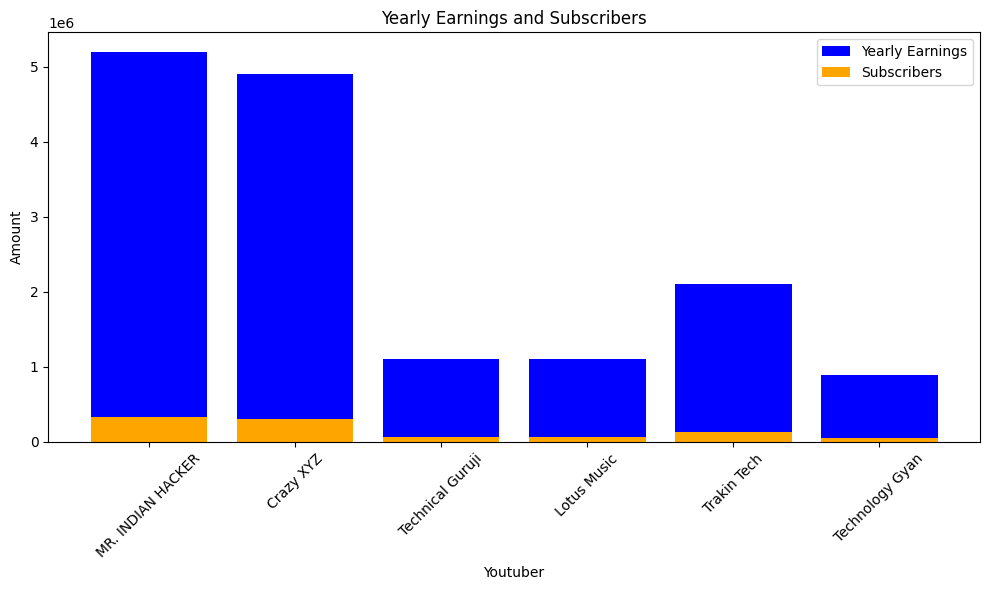

 11%|█         | 237/2160 [02:13<14:52,  2.16it/s]check
highest_yearly_earnings: 271200.0, Subscribers: 17000.0, Youtuber: HaerteTest


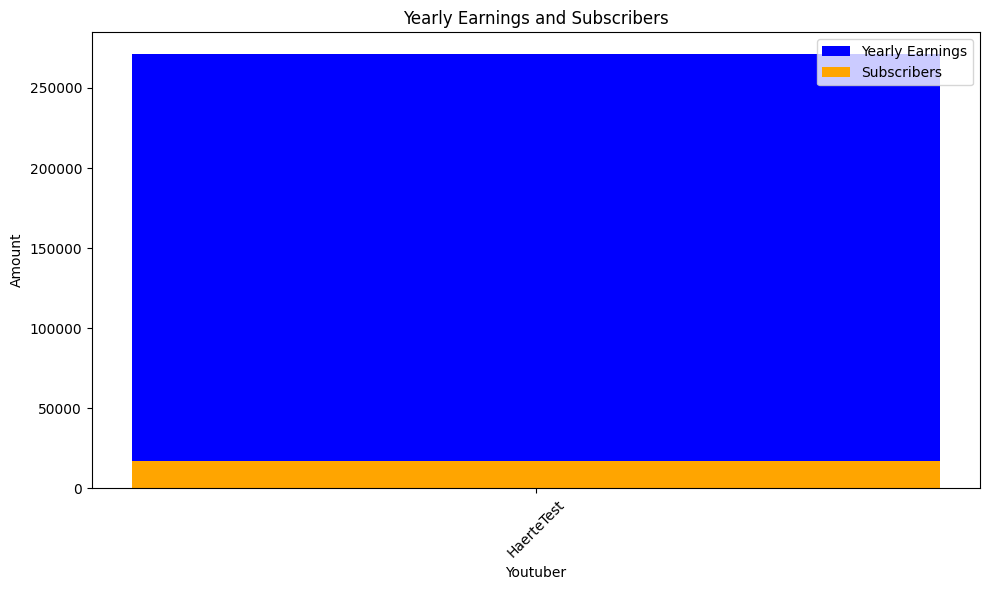

 11%|█         | 240/2160 [02:15<15:27,  2.07it/s]check
highest_yearly_earnings: 35.0, Subscribers: 2.0, Youtuber: Smile Family
highest_yearly_earnings: 2300000.0, Subscribers: 144300.0, Youtuber: SQUEEZIE
highest_yearly_earnings: 37.0, Subscribers: 2.0, Youtuber: FitDance
highest_yearly_earnings: 548000.0, Subscribers: 34300.0, Youtuber: Cyprien
highest_yearly_earnings: 1500000.0, Subscribers: 91400.0, Youtuber: Lofi Girl


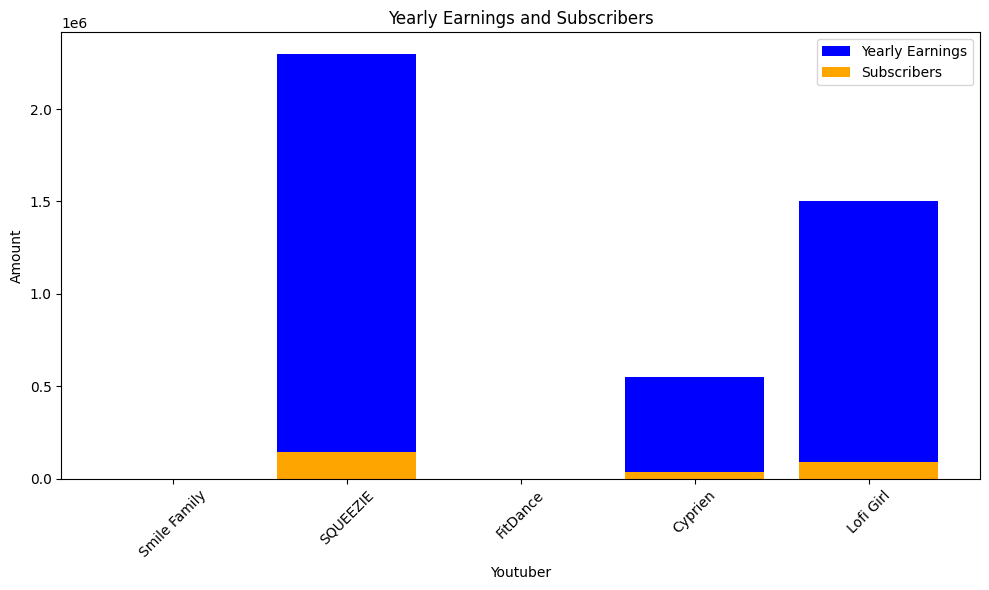

 11%|█▏        | 243/2160 [02:16<14:29,  2.20it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


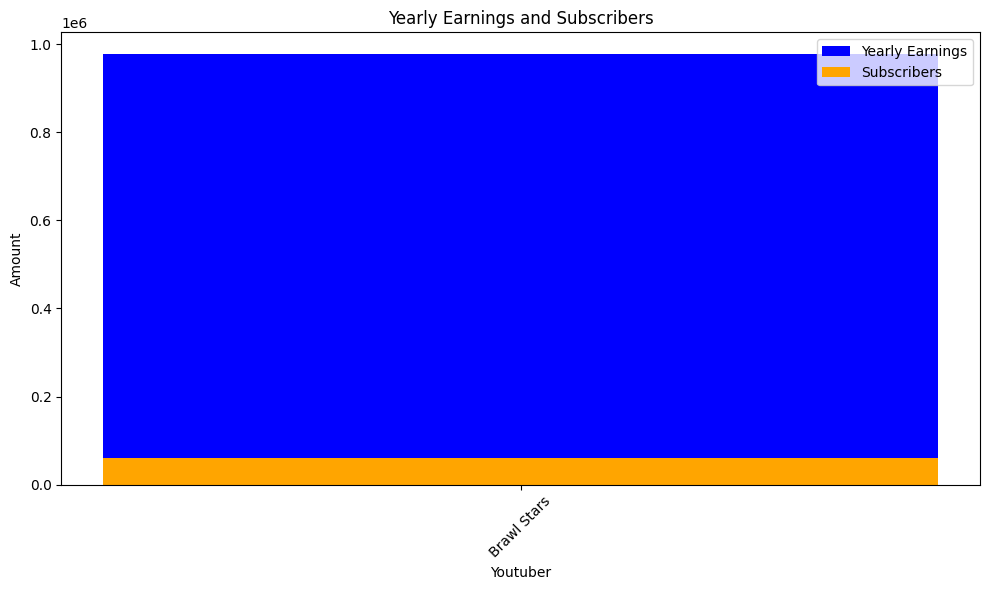

 11%|█▏        | 246/2160 [02:18<11:49,  2.70it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


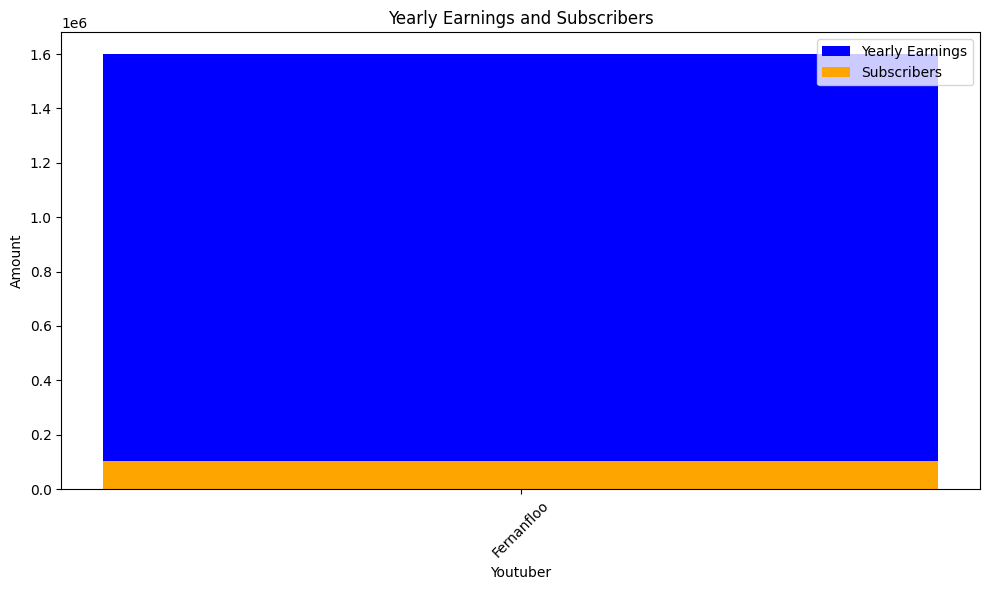

 12%|█▏        | 249/2160 [02:19<11:33,  2.76it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


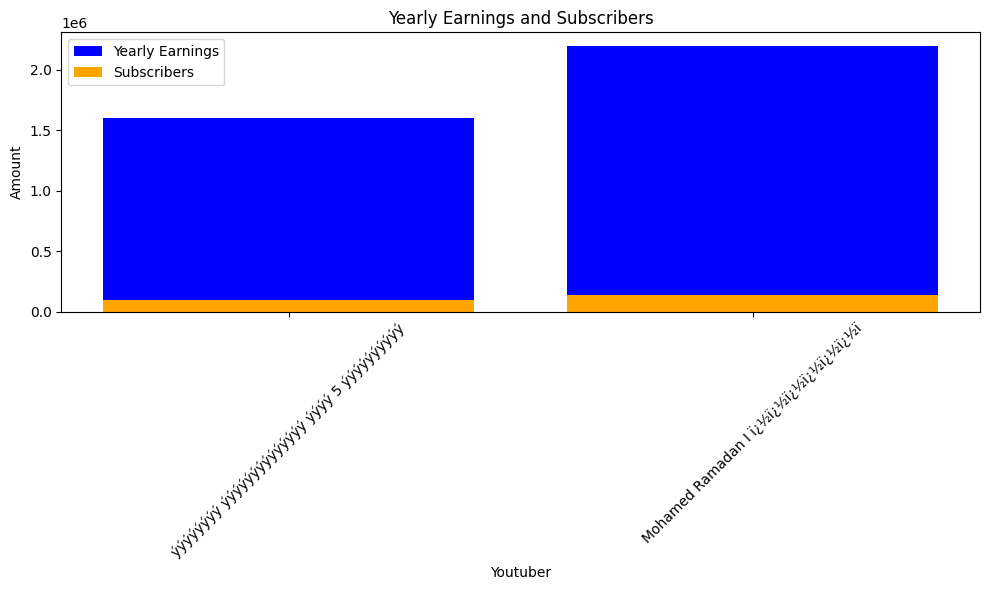

 12%|█▏        | 252/2160 [02:20<10:46,  2.95it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


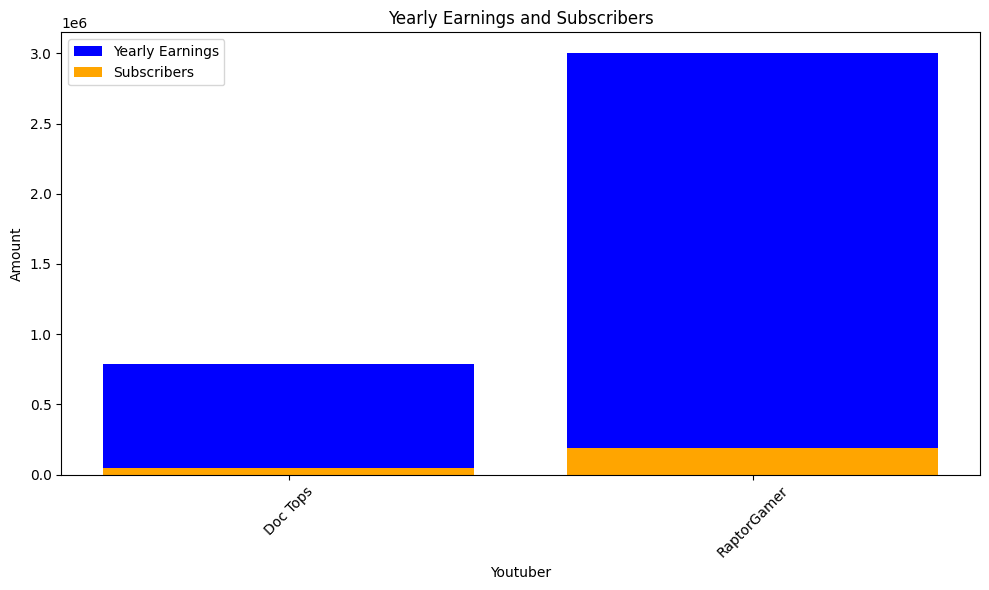

 12%|█▏        | 255/2160 [02:22<14:02,  2.26it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


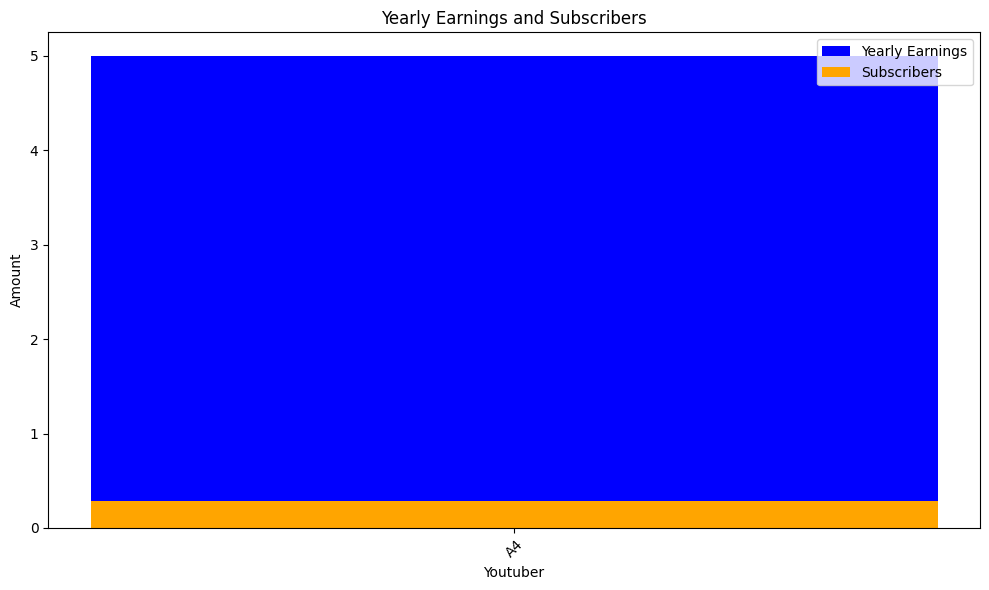

 12%|█▏        | 258/2160 [02:23<11:59,  2.65it/s]check
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Shakira
highest_yearly_earnings: 6200000.0, Subscribers: 386100.0, Youtuber: J Balvin
highest_yearly_earnings: 22400000.0, Subscribers: 1400000.0, Youtuber: KAROL G
highest_yearly_earnings: 8300000.0, Subscribers: 521500.0, Youtuber: toycantando
highest_yearly_earnings: 1200000.0, Subscribers: 73100.0, Youtuber: enchufetv
highest_yearly_earnings: 13600000.0, Subscribers: 852400.0, Youtuber: Anuel AA
highest_yearly_earnings: 12700000.0, Subscribers: 791600.0, Youtuber: Ami Rodriguez
highest_yearly_earnings: 2900000.0, Subscribers: 179700.0, Youtuber: Camilo
highest_yearly_earnings: 11000000.0, Subscribers: 686700.0, Youtuber: Codiscos
highest_yearly_earnings: 4100000.0, Subscribers: 258800.0, Youtuber: jbalvinVEVO
highest_yearly_earnings: 15700000.0, Subscribers: 982800.0, Youtuber: Go Ami Go!


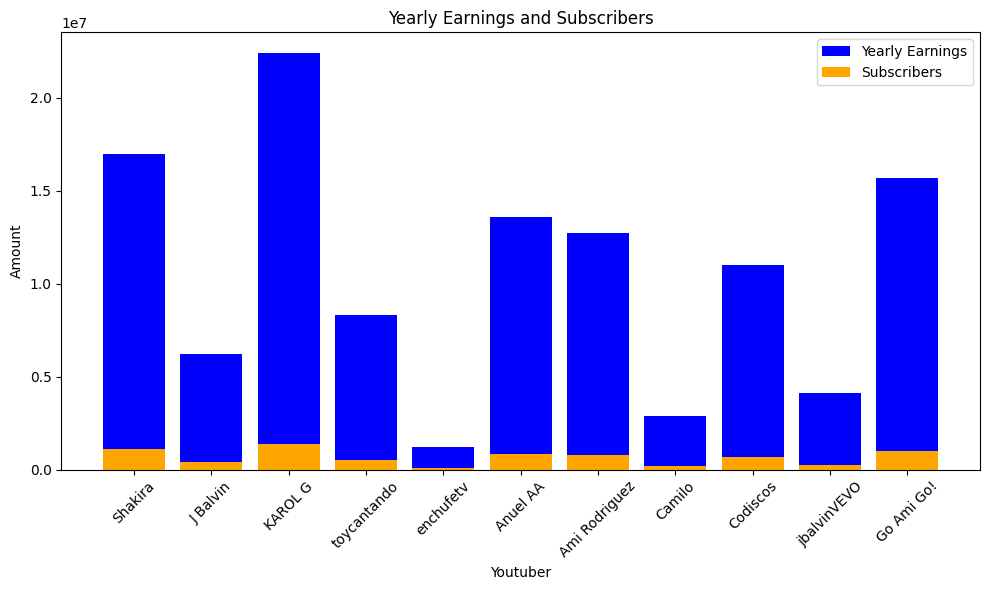

 12%|█▏        | 261/2160 [02:25<12:37,  2.51it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


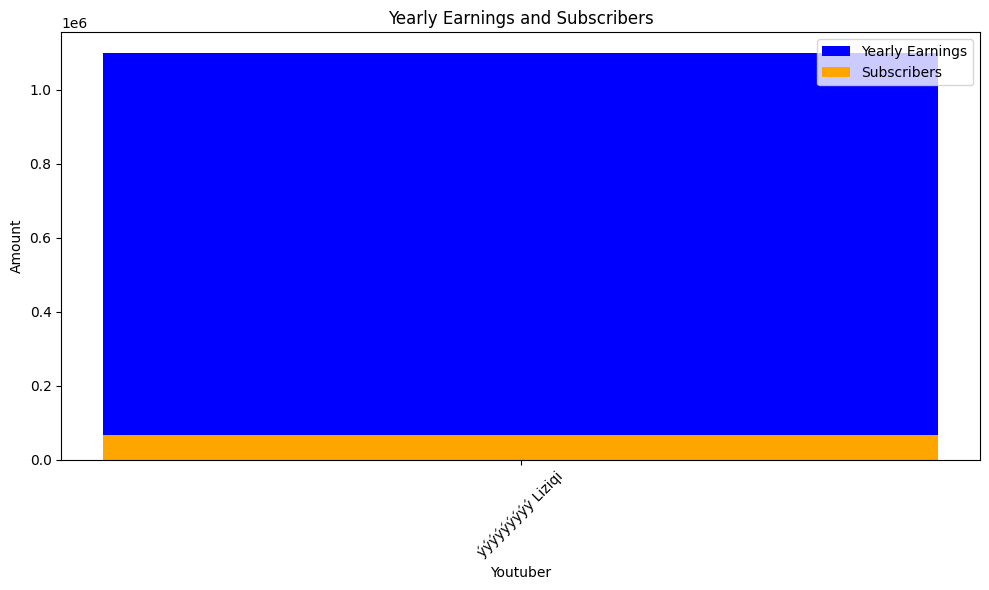

 12%|█▏        | 264/2160 [02:26<11:53,  2.66it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 199200.0, Youtuber: JuegaGerman
highest_yearly_earnings: 2.0, Subscribers: 0.15, Youtuber: invictor
highest_yearly_earnings: 4800000.0, Subscribers: 300600.0, Youtuber: DeGoBooM


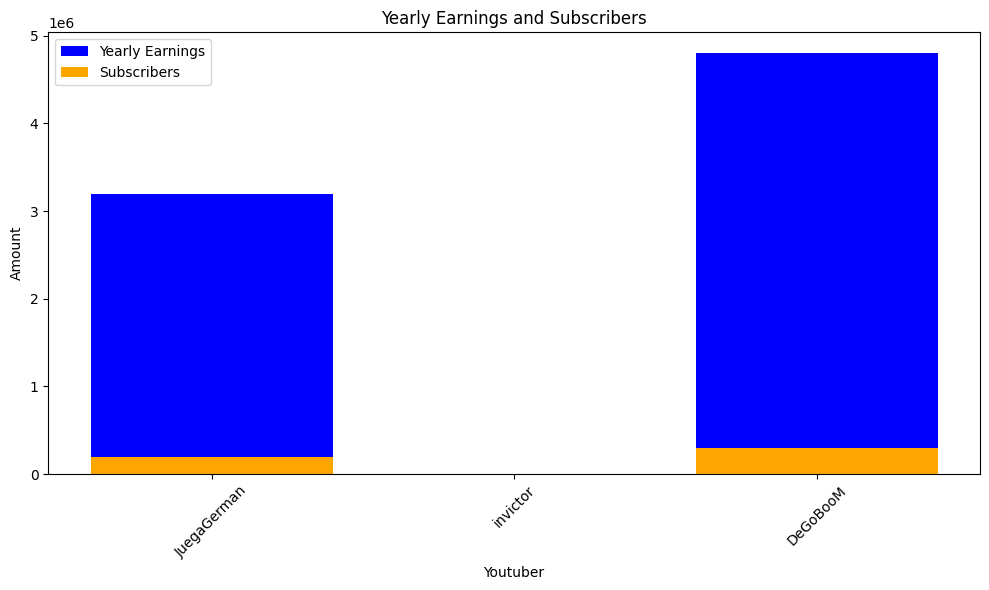

 12%|█▏        | 267/2160 [02:28<14:16,  2.21it/s]check
highest_yearly_earnings: 4200000.0, Subscribers: 264700.0, Youtuber: Linus Tech Tips
highest_yearly_earnings: 4000000.0, Subscribers: 251800.0, Youtuber: Hacksmith Industries


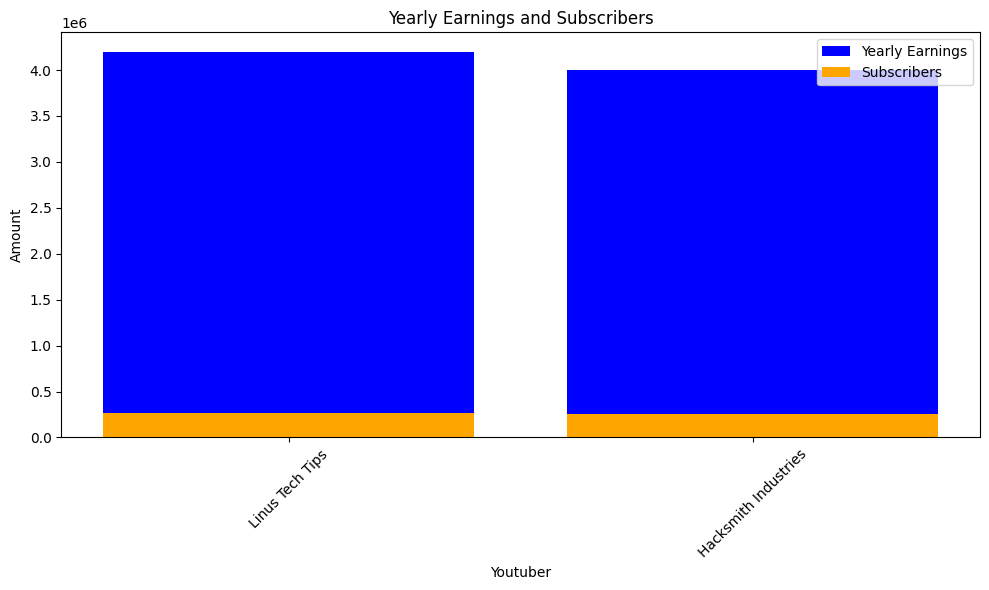

 12%|█▎        | 270/2160 [02:30<16:05,  1.96it/s]check
highest_yearly_earnings: 2600000.0, Subscribers: 164300.0, Youtuber: Manual do Mundo


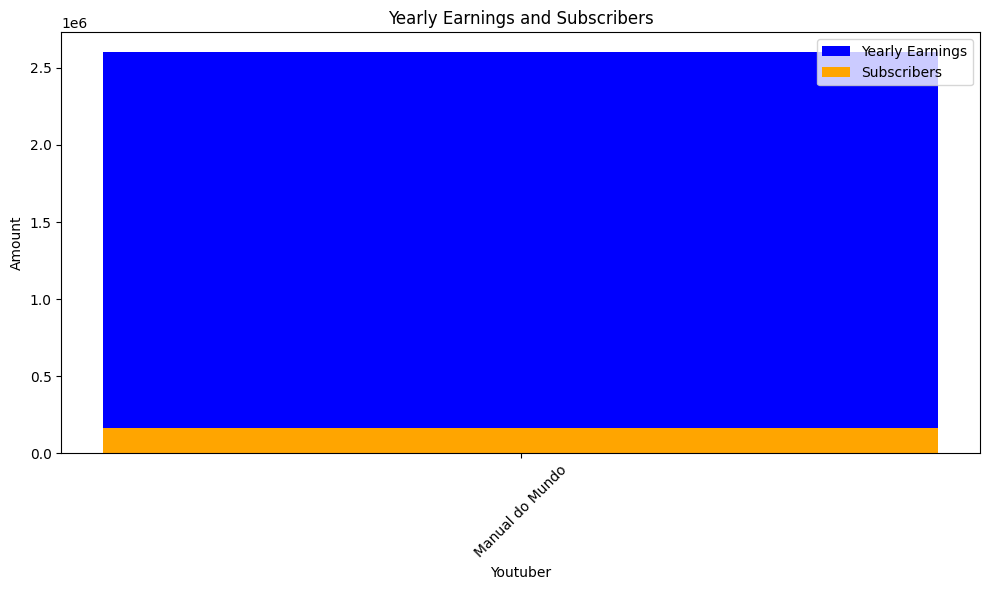

 13%|█▎        | 273/2160 [02:32<15:45,  2.00it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


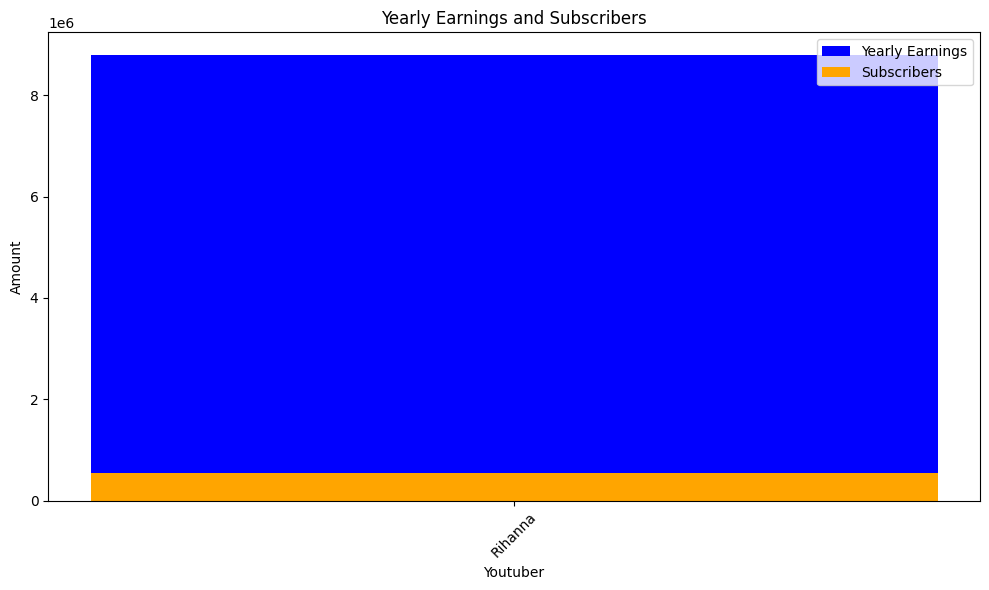

 13%|█▎        | 276/2160 [02:33<12:19,  2.55it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


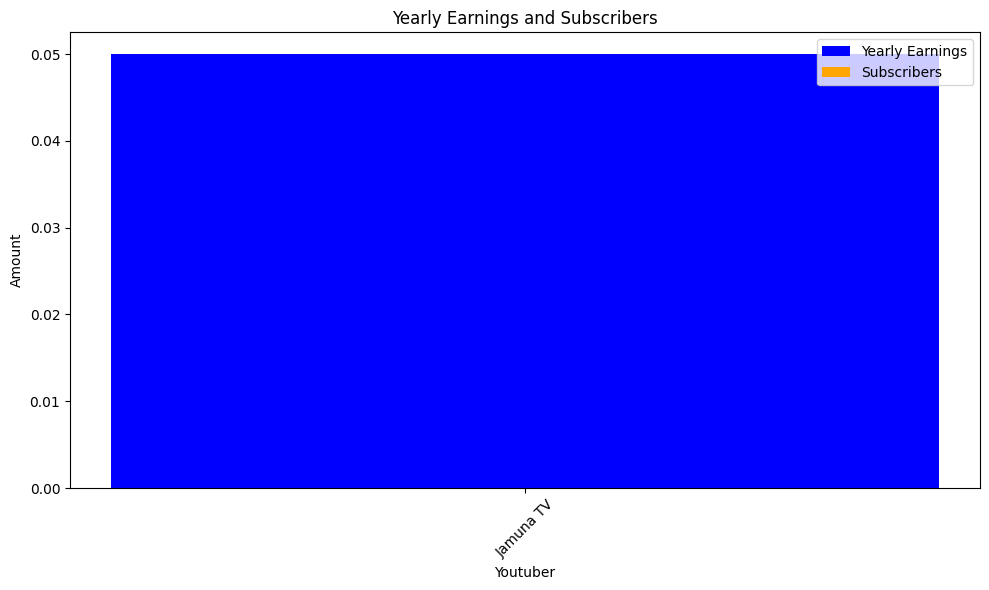

 13%|█▎        | 279/2160 [02:34<11:15,  2.78it/s]check
highest_yearly_earnings: 6100000.0, Subscribers: 382300.0, Youtuber: Bounce Patrol - Kids Songs
highest_yearly_earnings: 1100000.0, Subscribers: 69800.0, Youtuber: Chloe Ting
highest_yearly_earnings: 1300000.0, Subscribers: 78200.0, Youtuber: LazarBeam
highest_yearly_earnings: 18800000.0, Subscribers: 1200000.0, Youtuber: How Ridiculous
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: The Game Theorists
highest_yearly_earnings: 745200.0, Subscribers: 46600.0, Youtuber: HowToBasic
highest_yearly_earnings: 1.0, Subscribers: 0.08, Youtuber: Jason Vlogs
highest_yearly_earnings: 1000000.0, Subscribers: 63200.0, Youtuber: Lachlan
highest_yearly_earnings: 7.0, Subscribers: 0.44, Youtuber: Trap City


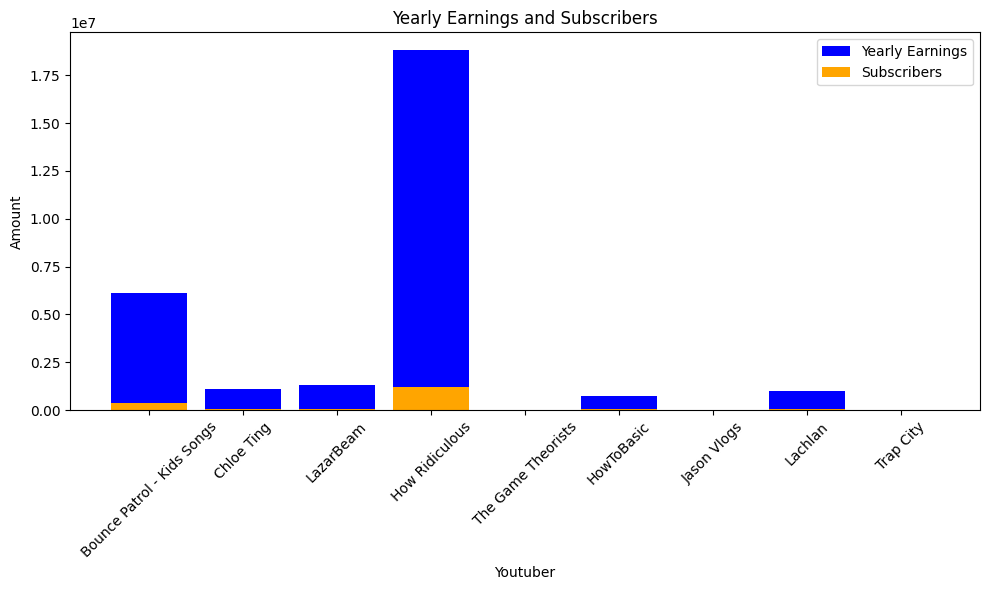

 13%|█▎        | 282/2160 [02:35<12:05,  2.59it/s]check
highest_yearly_earnings: 29400000.0, Subscribers: 1800000.0, Youtuber: El Reino Infantil
highest_yearly_earnings: 14500000.0, Subscribers: 906200.0, Youtuber: La Granja de Zenï¿½
highest_yearly_earnings: 9200000.0, Subscribers: 572000.0, Youtuber: TheDonato
highest_yearly_earnings: 0.72, Subscribers: 0.05, Youtuber: Maluma
highest_yearly_earnings: 19300000.0, Subscribers: 1200000.0, Youtuber: Alejo Igoa
highest_yearly_earnings: 1700000.0, Subscribers: 106600.0, Youtuber: DrossRotzank
highest_yearly_earnings: 3500000.0, Subscribers: 216700.0, Youtuber: Paulo Londra
highest_yearly_earnings: 9300000.0, Subscribers: 579500.0, Youtuber: Bizarrap
highest_yearly_earnings: 1300000.0, Subscribers: 82600.0, Youtuber: RobleisIUTU
highest_yearly_earnings: 30700000.0, Subscribers: 1900000.0, Youtuber: El Payaso Plim Plim
highest_yearly_earnings: 4000000.0, Subscribers: 251100.0, Youtuber: El Reino a Jugar
highest_yearly_earnings: 3100000.0, Su

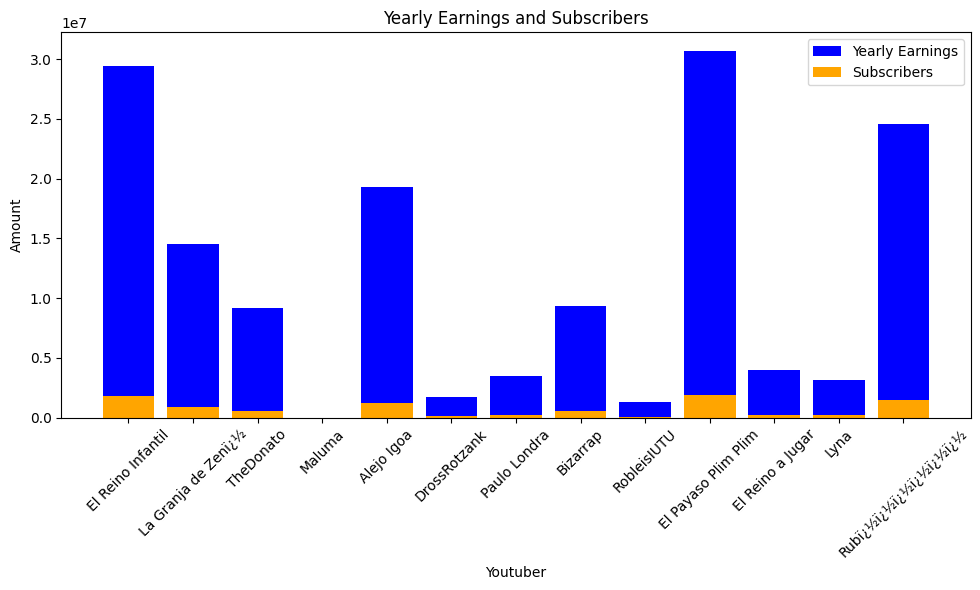

 13%|█▎        | 285/2160 [02:37<12:24,  2.52it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


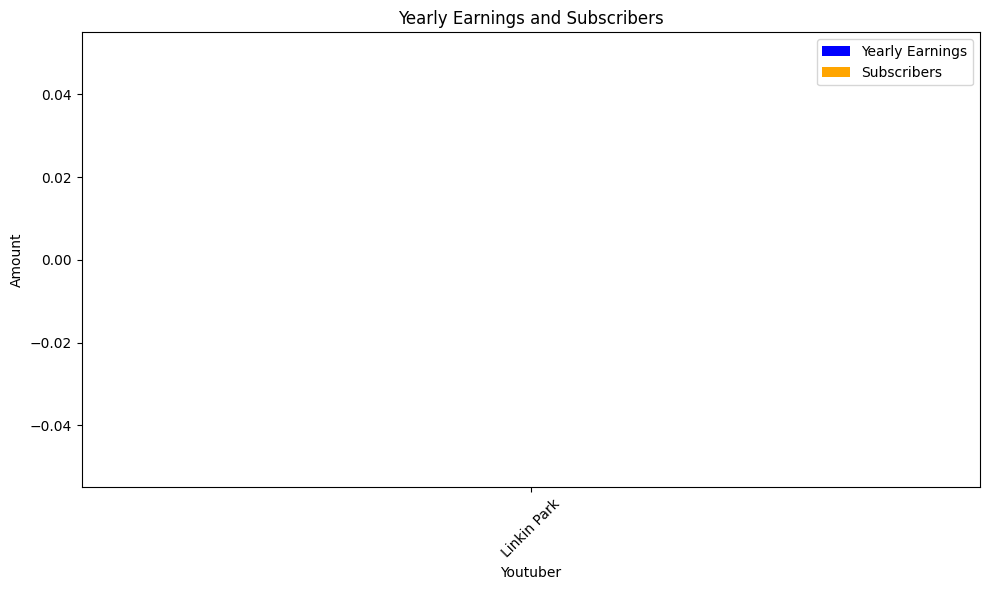

 13%|█▎        | 288/2160 [02:39<15:55,  1.96it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


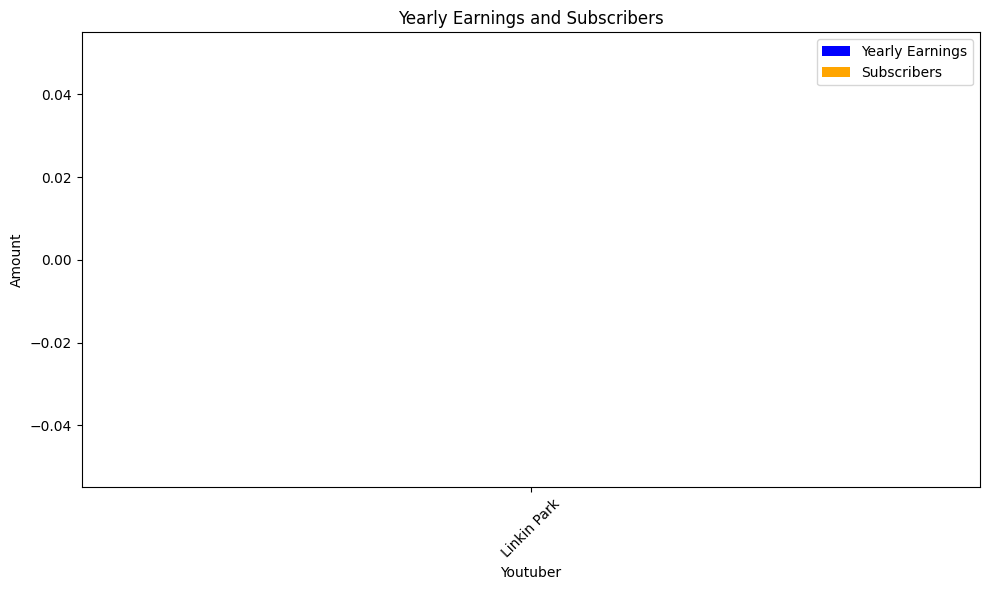

check
highest_yearly_earnings: 4100000.0, Subscribers: 253400.0, Youtuber: Like Nastya VNM
highest_yearly_earnings: 12300000.0, Subscribers: 770200.0, Youtuber: POPS Kids
highest_yearly_earnings: 1700000.0, Subscribers: 105400.0, Youtuber: FAPTV


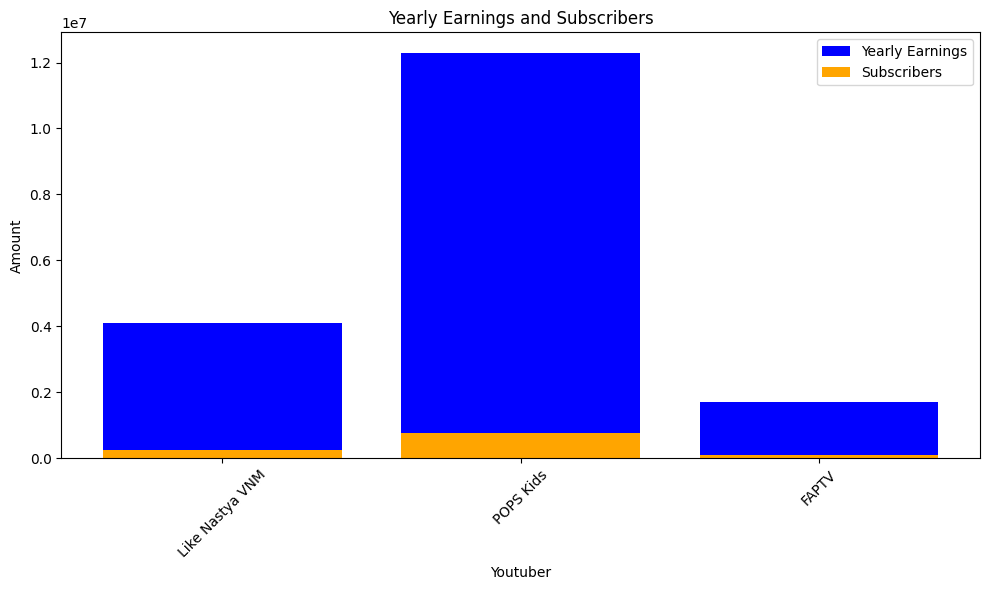

 13%|█▎        | 291/2160 [02:42<22:48,  1.37it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


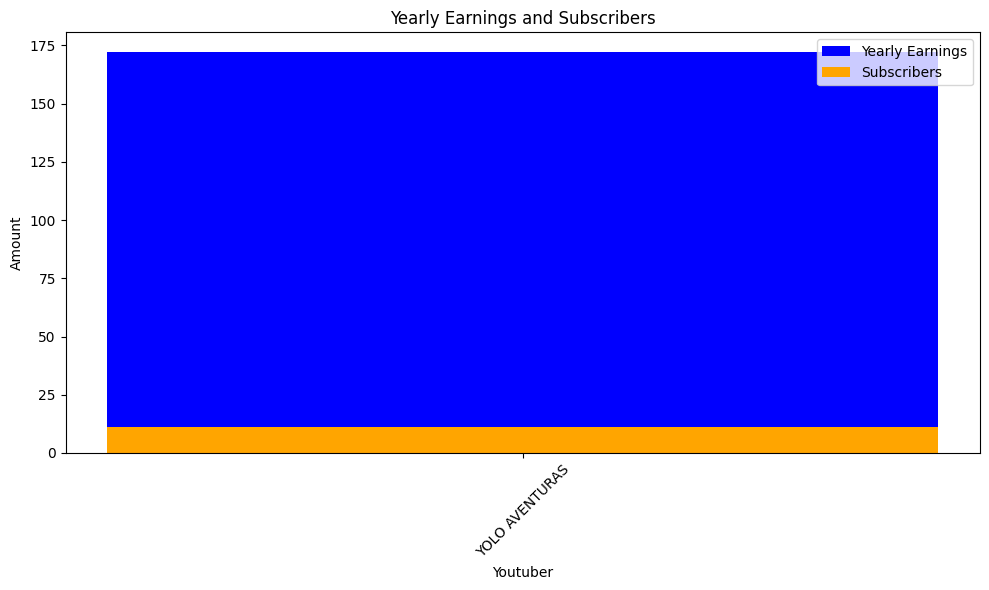

 14%|█▎        | 294/2160 [02:44<19:01,  1.63it/s]check
highest_yearly_earnings: 34300000.0, Subscribers: 2100000.0, Youtuber: WWE
highest_yearly_earnings: 6800000.0, Subscribers: 423600.0, Youtuber: Dude Perfect
highest_yearly_earnings: 3500000.0, Subscribers: 219100.0, Youtuber: NBA
highest_yearly_earnings: 6400000.0, Subscribers: 399600.0, Youtuber: UFC - Ultimate Fighting Championship
highest_yearly_earnings: 1500000.0, Subscribers: 92000.0, Youtuber: DALLMYD
highest_yearly_earnings: 0.14, Subscribers: 0.01, Youtuber: The Q


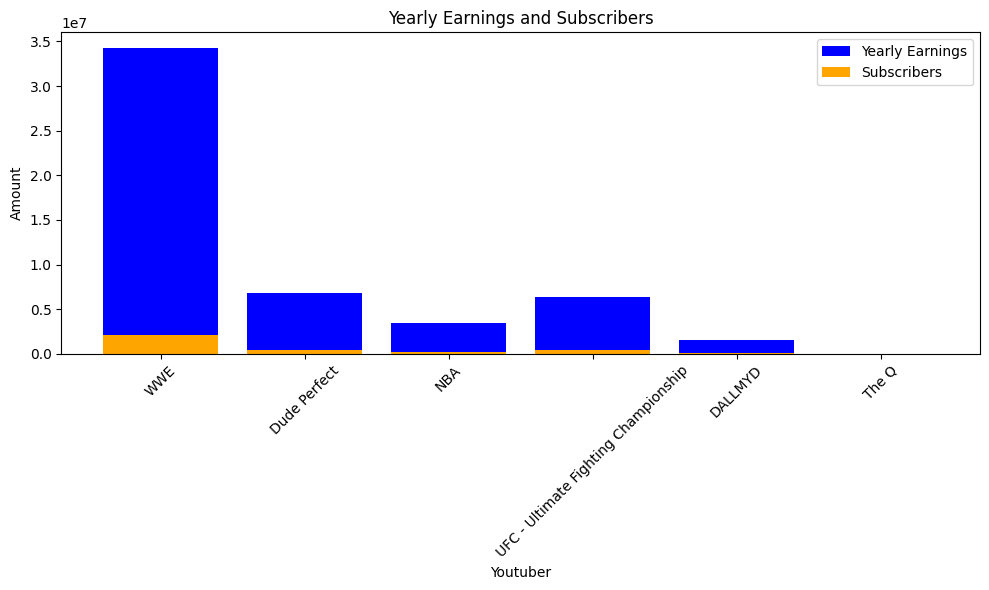

 14%|█▍        | 297/2160 [02:46<19:10,  1.62it/s]check
highest_yearly_earnings: 490600.0, Subscribers: 30700.0, Youtuber: F2Freestylers - Ultimate Soccer Skills Channel


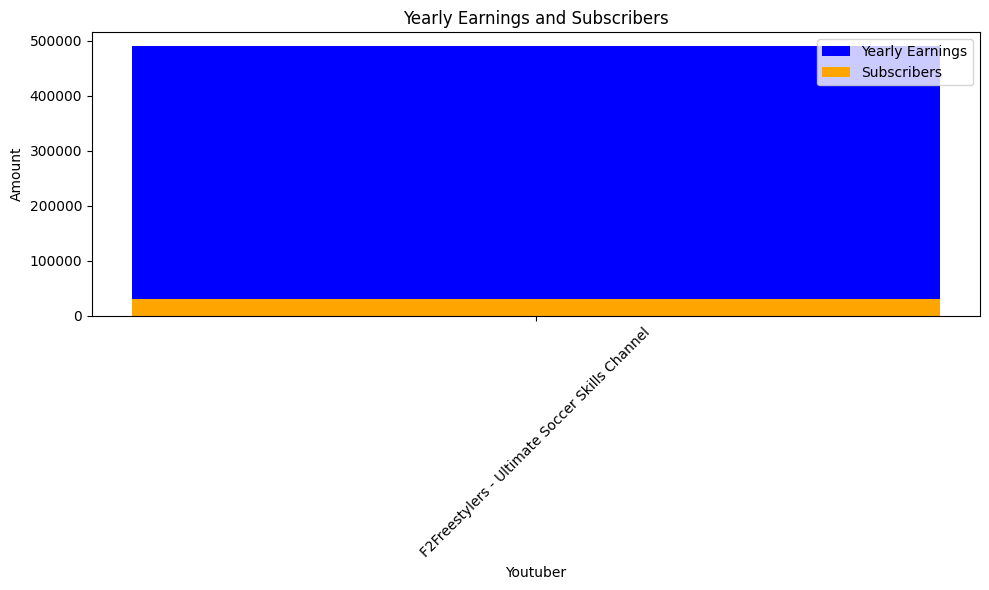

 14%|█▍        | 300/2160 [02:48<13:58,  2.22it/s]check
highest_yearly_earnings: 11900000.0, Subscribers: 743200.0, Youtuber: shfa2 - ï¿½ï¿½
highest_yearly_earnings: 7300000.0, Subscribers: 453600.0, Youtuber: shfa show India
highest_yearly_earnings: 76700000.0, Subscribers: 4800000.0, Youtuber: ZAMZAM ELECTRONICS TRADING
highest_yearly_earnings: 746700.0, Subscribers: 46700.0, Youtuber: Noor Stars
highest_yearly_earnings: 3800000.0, Subscribers: 240500.0, Youtuber: FFUNTV
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Supercar Blondie
highest_yearly_earnings: 3900000.0, Subscribers: 240700.0, Youtuber: AlArabiya ï¿½ï¿½ï¿½ï¿½ï¿


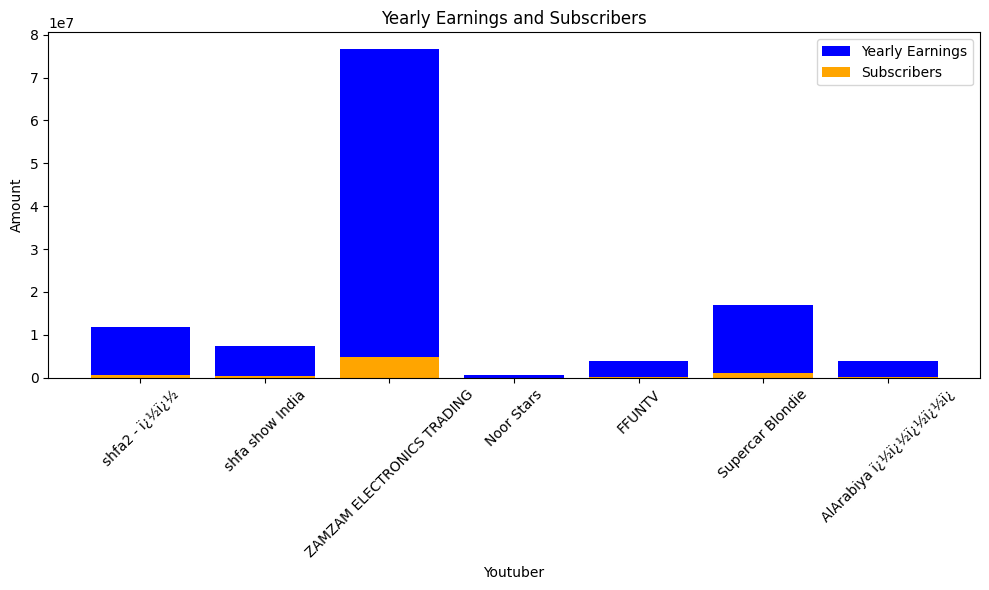

 14%|█▍        | 303/2160 [02:49<12:18,  2.52it/s]check
highest_yearly_earnings: 1400000.0, Subscribers: 87000.0, Youtuber: SlivkiShow
highest_yearly_earnings: 3300000.0, Subscribers: 204000.0, Youtuber: ýýýýýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 17800000.0, Subscribers: 1100000.0, Youtuber: News 24
highest_yearly_earnings: 2300000.0, Subscribers: 141400.0, Youtuber: ýýýýýýýý ýýýýýýýý
highest_yearly_earnings: 5.0, Subscribers: 0.32, Youtuber: SIS vs BRO
highest_yearly_earnings: 3600000.0, Subscribers: 225500.0, Youtuber: Lady Diana
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: VexTrex
highest_yearly_earnings: 3400000.0, Subscribers: 213400.0, Youtuber: ýýýýýýýý ýýýý ýýýýýýýýýýýýýý


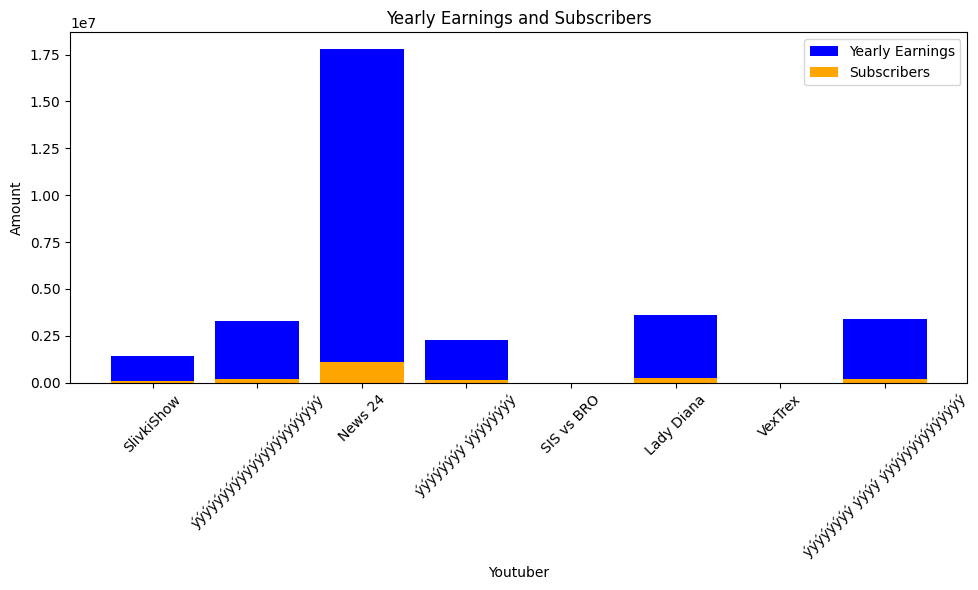

 14%|█▍        | 306/2160 [02:50<12:00,  2.57it/s]check
highest_yearly_earnings: 70200000.0, Subscribers: 4400000.0, Youtuber: BETER Bï¿½ï¿½
highest_yearly_earnings: 20400000.0, Subscribers: 1300000.0, Youtuber: netd mï¿½ï¿
highest_yearly_earnings: 5300000.0, Subscribers: 332400.0, Youtuber: tabii Urdu
highest_yearly_earnings: 212500.0, Subscribers: 13300.0, Youtuber: Oyuncak Avï¿


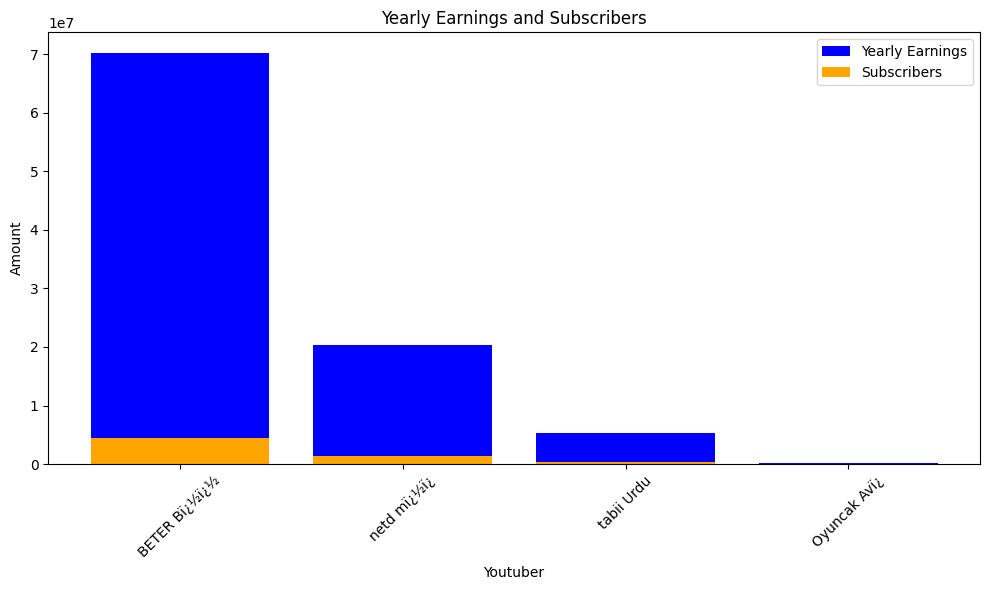

 14%|█▍        | 309/2160 [02:52<11:29,  2.68it/s]check
highest_yearly_earnings: 1.0, Subscribers: 0.07, Youtuber: Alan Walker
highest_yearly_earnings: 6300000.0, Subscribers: 391400.0, Youtuber: WorkpointOfficial
highest_yearly_earnings: 6800000.0, Subscribers: 422300.0, Youtuber: ýýýýýýýýýýýý one31
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Ch3Thailand
highest_yearly_earnings: 6300000.0, Subscribers: 390700.0, Youtuber: GMM GRAMMY OFFICIAL
highest_yearly_earnings: 8100000.0, Subscribers: 505800.0, Youtuber: GRAMMY GOLD OFFICIAL
highest_yearly_earnings: 2600000.0, Subscribers: 162400.0, Youtuber: RsiamMusic : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: zbing z.
highest_yearly_earnings: 11300000.0, Subscribers: 708000.0, Youtuber: AMARINTV : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 448400.0, Subscribers: 28000.0, Youtuber: Kaykai Salaider
highest_yearly_earnings: 4200000.0, Subscribers: 263300.0, Yout

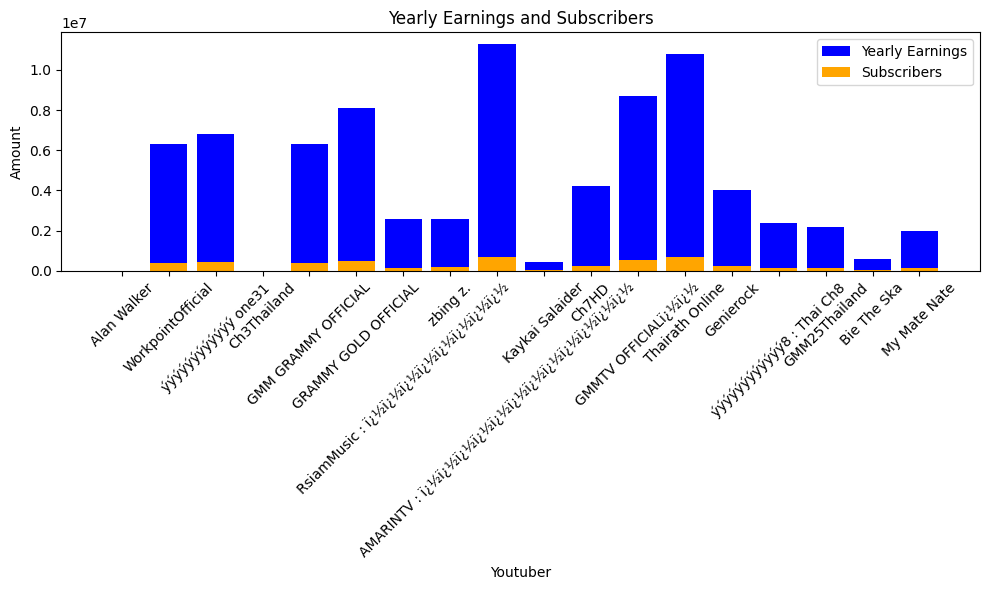

 14%|█▍        | 312/2160 [02:53<12:02,  2.56it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


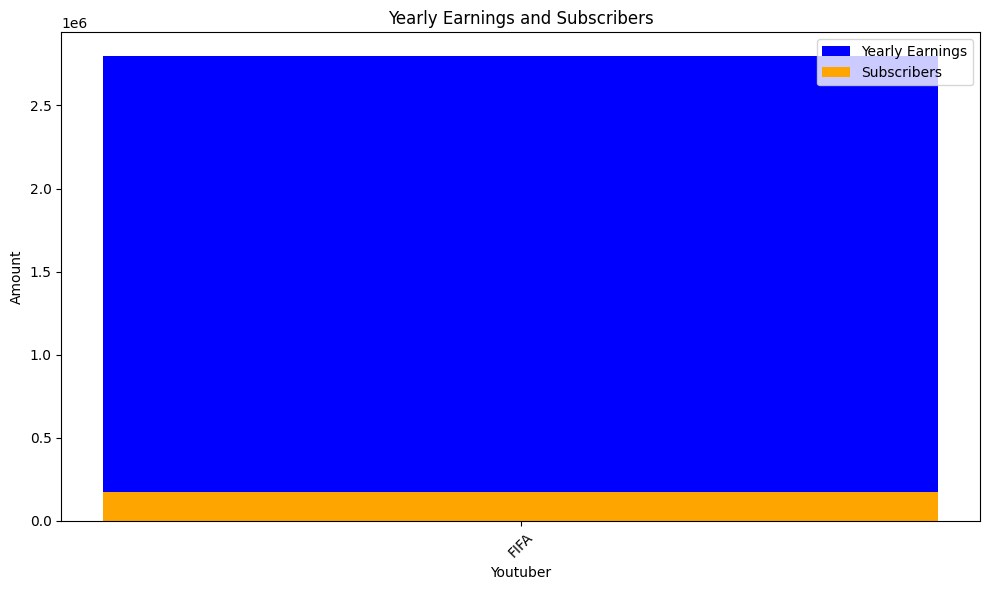

 15%|█▍        | 315/2160 [02:54<11:15,  2.73it/s]check
highest_yearly_earnings: 23000000.0, Subscribers: 1400000.0, Youtuber: Panda Shorts


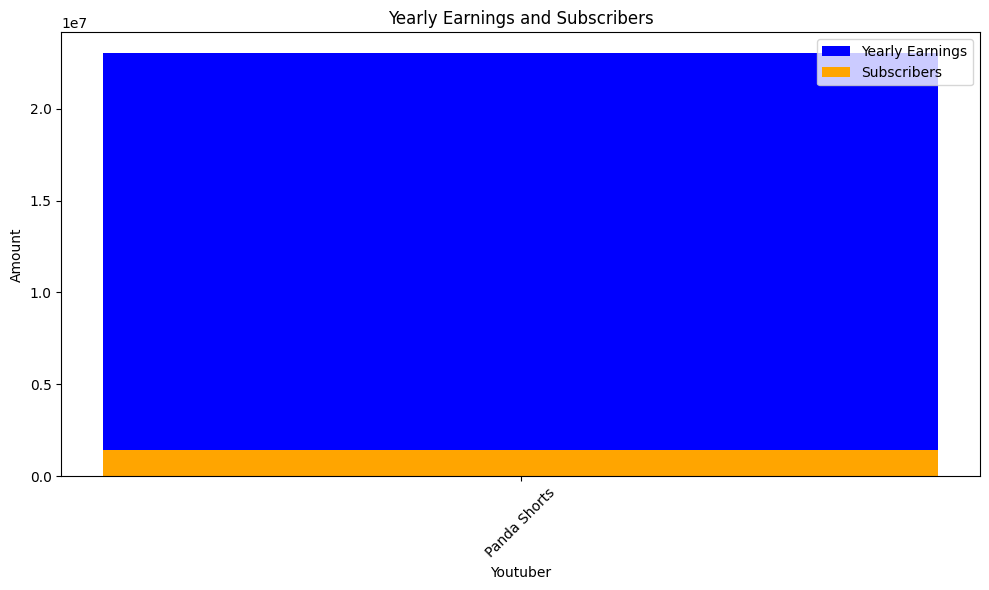

 15%|█▍        | 318/2160 [02:56<10:44,  2.86it/s]check
highest_yearly_earnings: 4100000.0, Subscribers: 254600.0, Youtuber: FC Barcelona
highest_yearly_earnings: 575700.0, Subscribers: 36000.0, Youtuber: gymvirtual


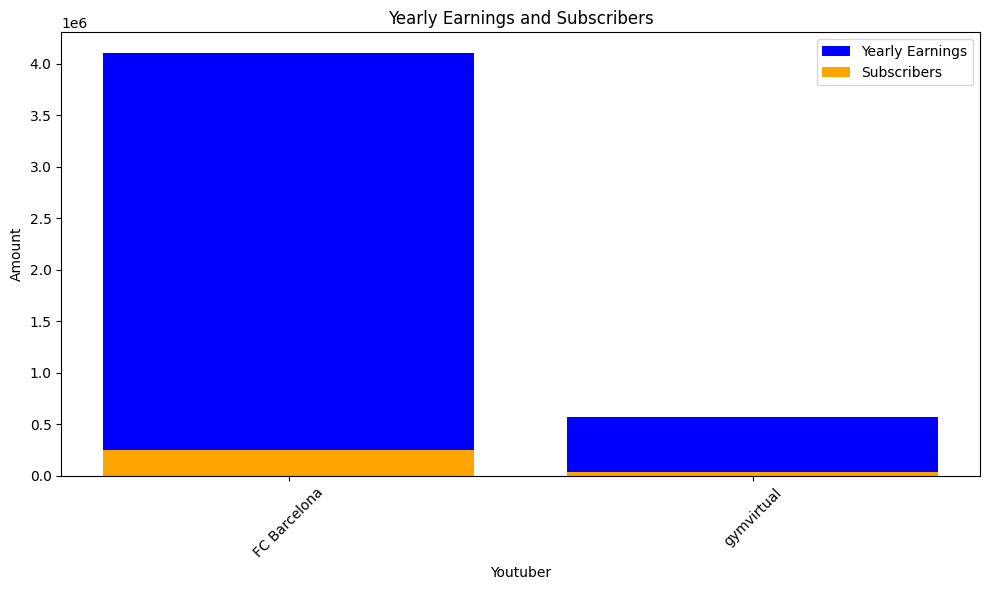

 15%|█▍        | 321/2160 [02:57<11:46,  2.60it/s]check
highest_yearly_earnings: 23900000.0, Subscribers: 1500000.0, Youtuber: BLACKPINK
highest_yearly_earnings: 8100000.0, Subscribers: 504900.0, Youtuber: BANGTANTV
highest_yearly_earnings: 28700000.0, Subscribers: 1800000.0, Youtuber: HYBE LABELS
highest_yearly_earnings: 14800000.0, Subscribers: 922900.0, Youtuber: JYP Entertainment
highest_yearly_earnings: 5100000.0, Subscribers: 316700.0, Youtuber: 1theK (ï¿½ï¿½ï¿½ï¿½ï
highest_yearly_earnings: 7600000.0, Subscribers: 475600.0, Youtuber: Mnet K-POP
highest_yearly_earnings: 5200000.0, Subscribers: 324000.0, Youtuber: KBS WORLD TV
highest_yearly_earnings: 3100000.0, Subscribers: 195000.0, Youtuber: officialpsy
highest_yearly_earnings: 163400000.0, Subscribers: 10200000.0, Youtuber: ýýýýýýýýý KIMPRO
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Jane ASMR ï¿½ï¿½
highest_yearly_earnings: 532700.0, Subscribers: 33300.0, Youtuber: JFlaMusic
highest_yearly_earnings: 2000000.0, Su

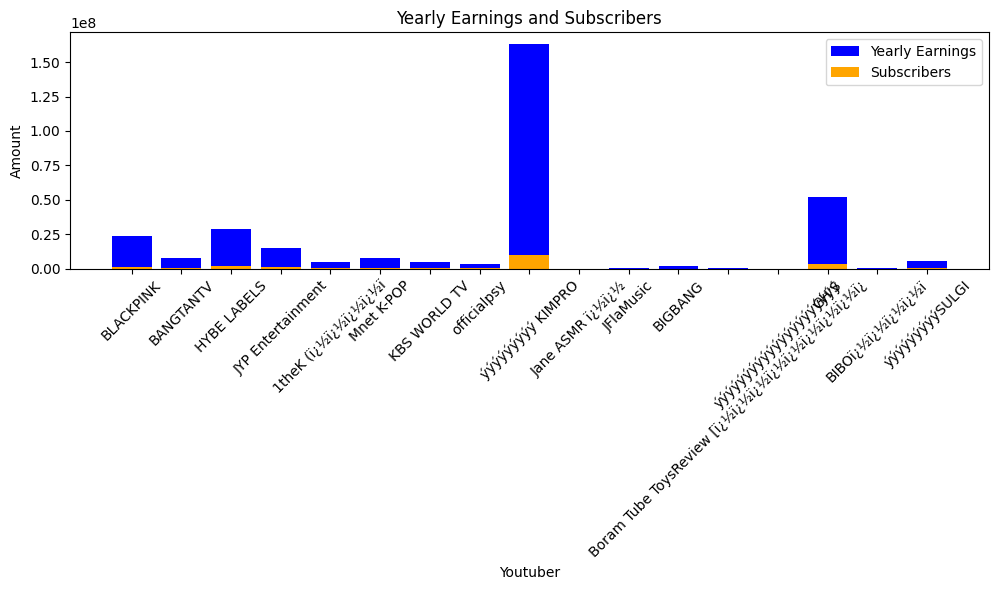

 15%|█▌        | 324/2160 [02:59<14:59,  2.04it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Sandeep Maheshwari
highest_yearly_earnings: 5600000.0, Subscribers: 351600.0, Youtuber: LEGO
highest_yearly_earnings: 45100.0, Subscribers: 2800.0, Youtuber: MY FAMILY


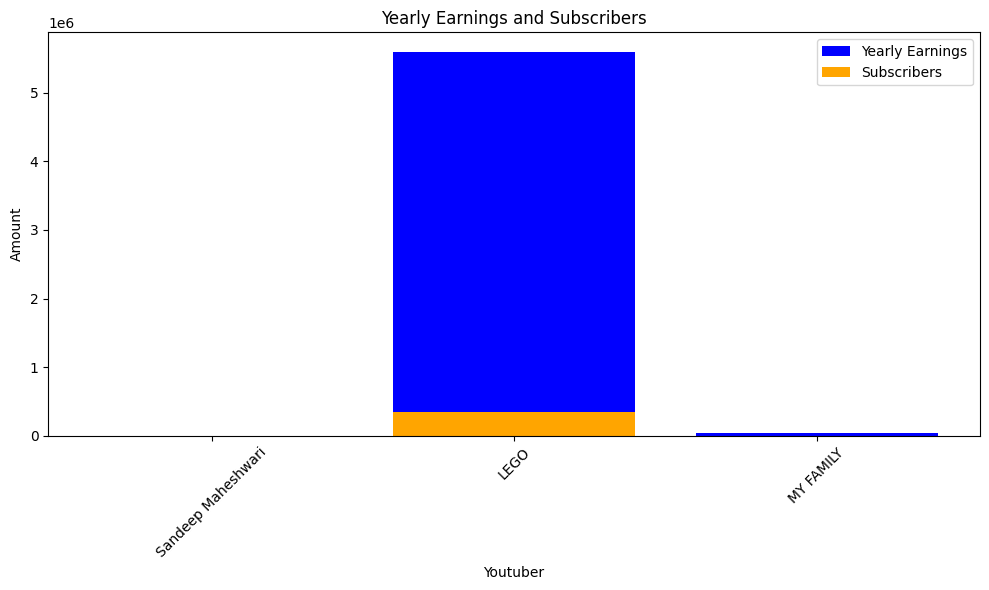

 15%|█▌        | 327/2160 [03:01<15:40,  1.95it/s]check
highest_yearly_earnings: 76300.0, Subscribers: 4800.0, Youtuber: shfa
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: 1MILLION Dance Studio
highest_yearly_earnings: 3500000.0, Subscribers: 221500.0, Youtuber: mmoshaya
highest_yearly_earnings: 2100000.0, Subscribers: 129000.0, Youtuber: ýýýýýýýý ýýýýýýýýýý ýýýýýýýýýý | Arab Games Network
highest_yearly_earnings: 4400000.0, Subscribers: 272700.0, Youtuber: Katakit Baby TV
highest_yearly_earnings: 6500000.0, Subscribers: 405100.0, Youtuber: ýýýýýýýý ýý ýýýýýýýý
highest_yearly_earnings: 129300.0, Subscribers: 8100.0, Youtuber: ýýýýýýýýýý ýýýýýýýýýýýý
highest_yearly_earnings: 224300.0, Subscribers: 14000.0, Youtuber: ýýýýýýýýýýýý ýýýýýýýýýýýý I ýýýýýý ýý ýýýýýýýýýý
highest_yearly_earnings: 3400000.0, Subscribers: 212100.0, Youtuber: BanderitaX


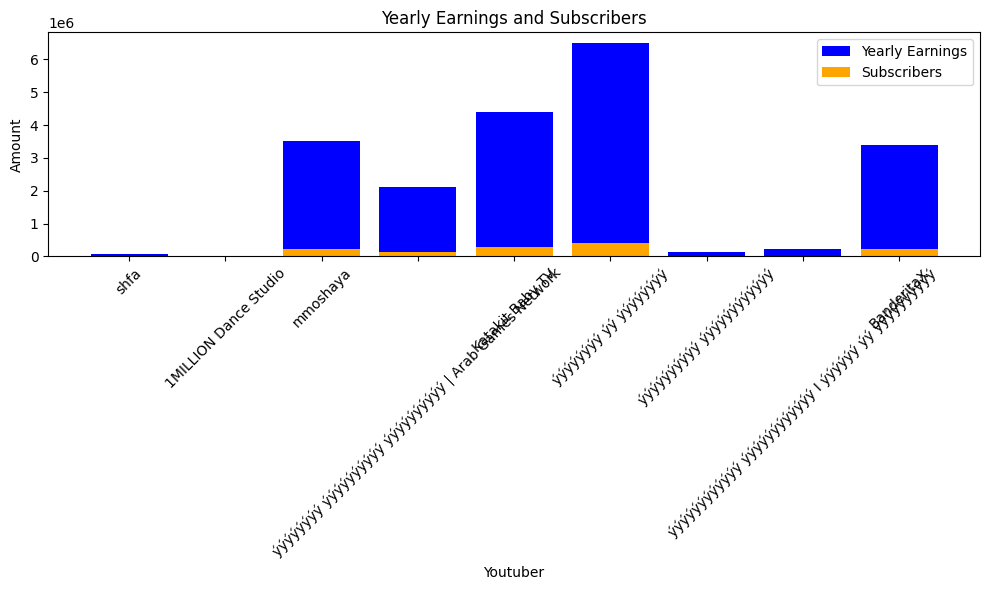

 15%|█▌        | 330/2160 [03:03<14:30,  2.10it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


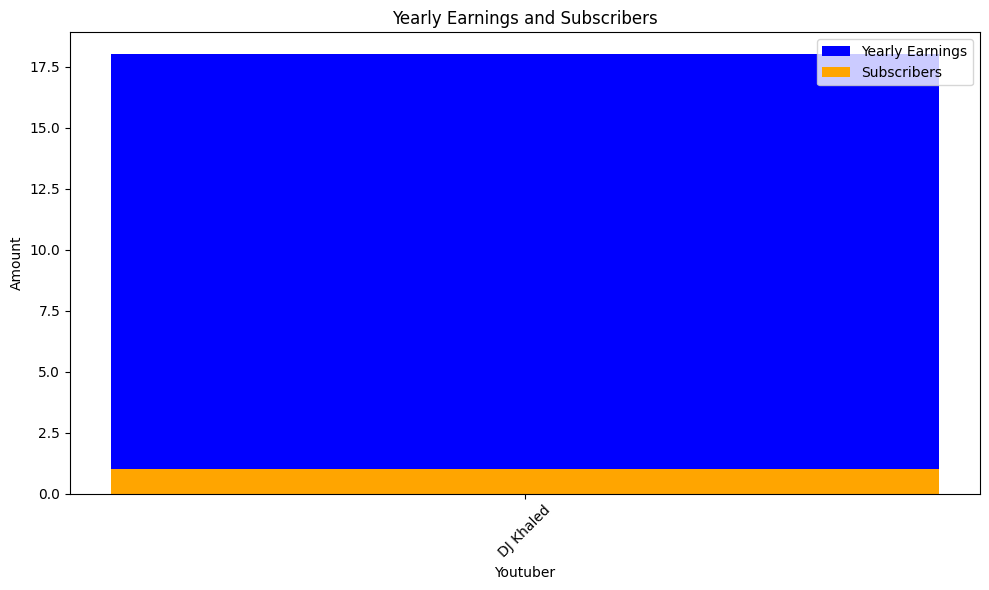

 15%|█▌        | 333/2160 [03:04<11:54,  2.56it/s]check
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya
highest_yearly_earnings: 14700000.0, Subscribers: 919600.0, Youtuber: Get Movies
highest_yearly_earnings: 14600000.0, Subscribers: 911300.0, Youtuber: ýýýýýýýý ýý ýýýýýýýýýýýýýý
highest_yearly_earnings: 26500000.0, Subscribers: 1700000.0, Youtuber: tuzelity SHUFFLE
highest_yearly_earnings: 1200000.0, Subscribers: 73700.0, Youtuber: HiMan
highest_yearly_earnings: 1800000.0, Subscribers: 114800.0, Youtuber: Marmok
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya Vlog
highest_yearly_earnings: 1800000.0, Subscribers: 111500.0, Youtuber: TheBrianMaps
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: ýýýýýýýýýý
highest_yearly_earnings: 22800000.0, Subscribers: 1400000.0, Youtuber: ILYA BORZOV
highest_yearly_earnings: 4600000.0, Subscribers: 286800.0, Youtuber: EdisonPts
highest_yearly_earnings: 34200000.0, Subscribers

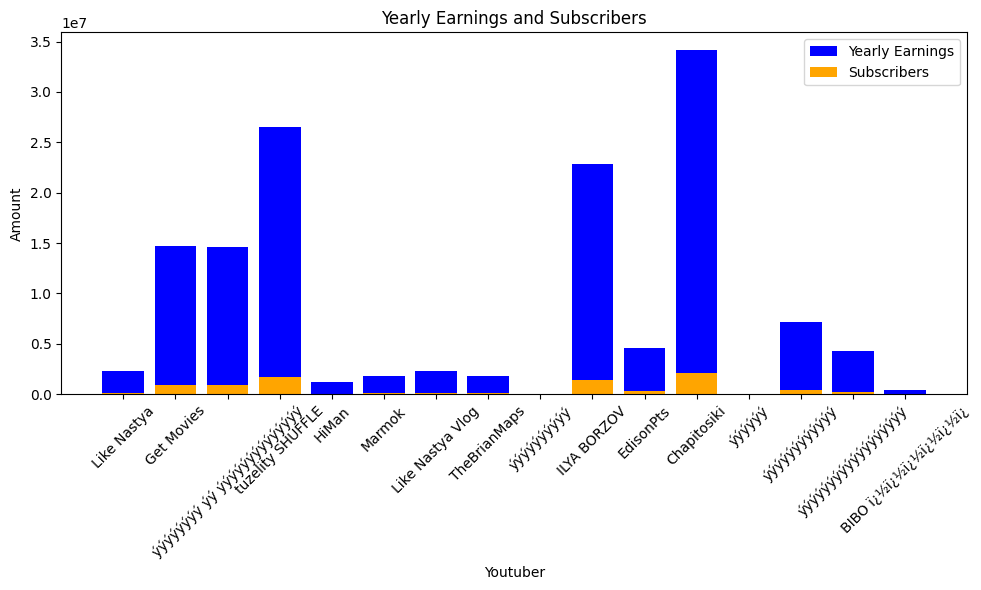

 16%|█▌        | 336/2160 [03:05<11:56,  2.55it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529900.0, Youtuber: ABS-CBN Entertainment
highest_yearly_earnings: 38300000.0, Subscribers: 2400000.0, Youtuber: GMA  Network
highest_yearly_earnings: 7800000.0, Subscribers: 489400.0, Youtuber: Raffy Tulfo in Action
highest_yearly_earnings: 6800000.0, Subscribers: 427000.0, Youtuber: GMA Public  Affairs
highest_yearly_earnings: 723800.0, Subscribers: 45200.0, Youtuber: Ivana Alawi
highest_yearly_earnings: 479000.0, Subscribers: 29900.0, Youtuber: Niana Guerrero
highest_yearly_earnings: 594000.0, Subscribers: 37100.0, Youtuber: Ranz Kyle
highest_yearly_earnings: 8700000.0, Subscribers: 544900.0, Youtuber: ABS-CBN News
highest_yearly_earnings: 3000000.0, Subscribers: 188000.0, Youtuber: Wish 107.5
highest_yearly_earnings: 580200.0, Subscribers: 36300.0, Youtuber: Zeinab Harake
highest_yearly_earnings: 5500000.0, Subscribers: 346400.0, Youtuber: GMA Integrated News
highest_yearly_earn

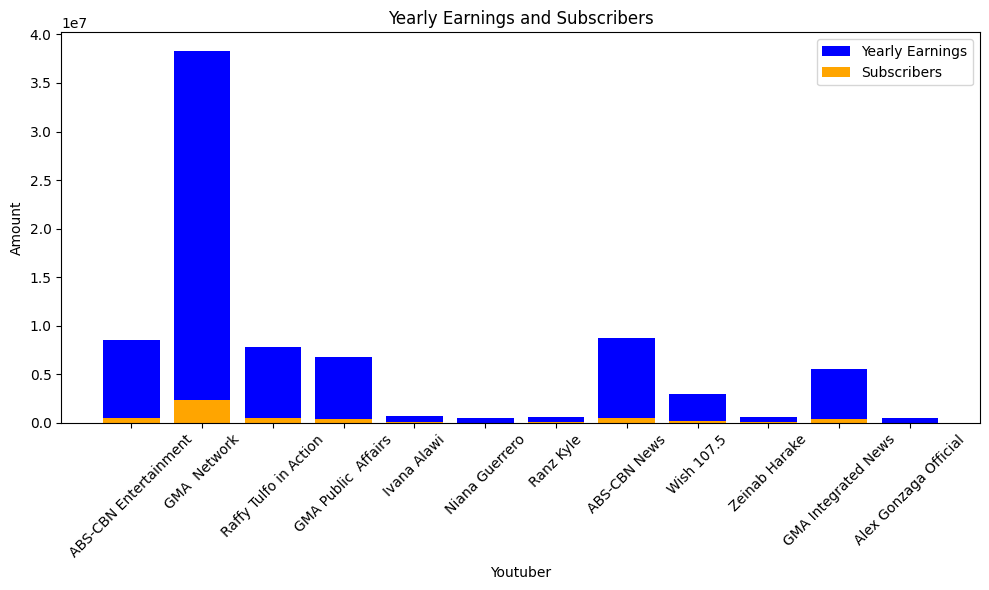

 16%|█▌        | 339/2160 [03:07<11:30,  2.64it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


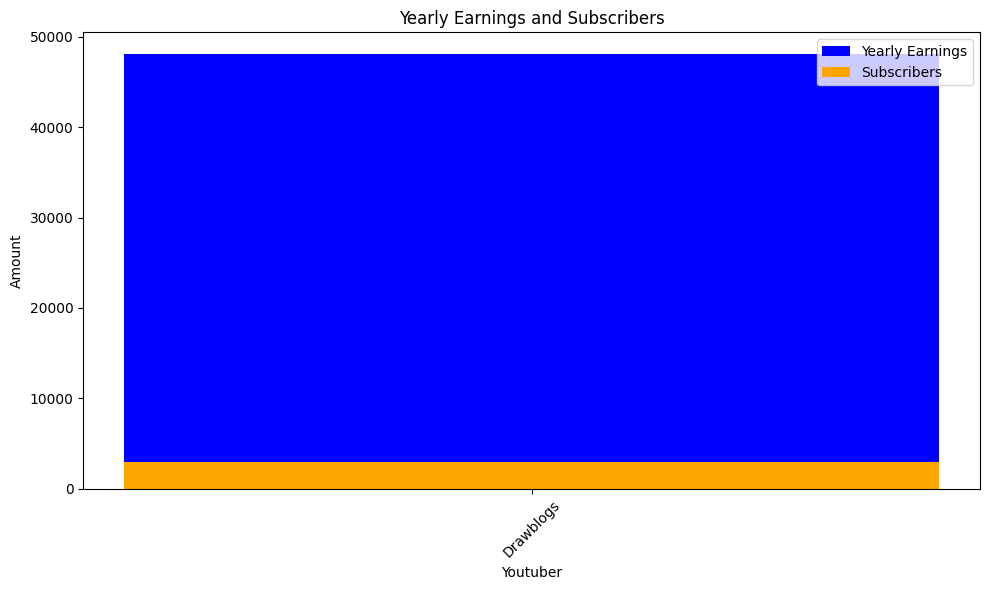

 16%|█▌        | 342/2160 [03:09<14:01,  2.16it/s]check
highest_yearly_earnings: 64200000.0, Subscribers: 4000000.0, Youtuber: HAR PAL GEO
highest_yearly_earnings: 55200000.0, Subscribers: 3400000.0, Youtuber: ARY Digital HD
highest_yearly_earnings: 32900000.0, Subscribers: 2100000.0, Youtuber: HUM TV
highest_yearly_earnings: 4800000.0, Subscribers: 300200.0, Youtuber: Geo News
highest_yearly_earnings: 28.0, Subscribers: 2.0, Youtuber: Wolfoo Channel
highest_yearly_earnings: 419.0, Subscribers: 26.0, Youtuber: Quantum Tech HD


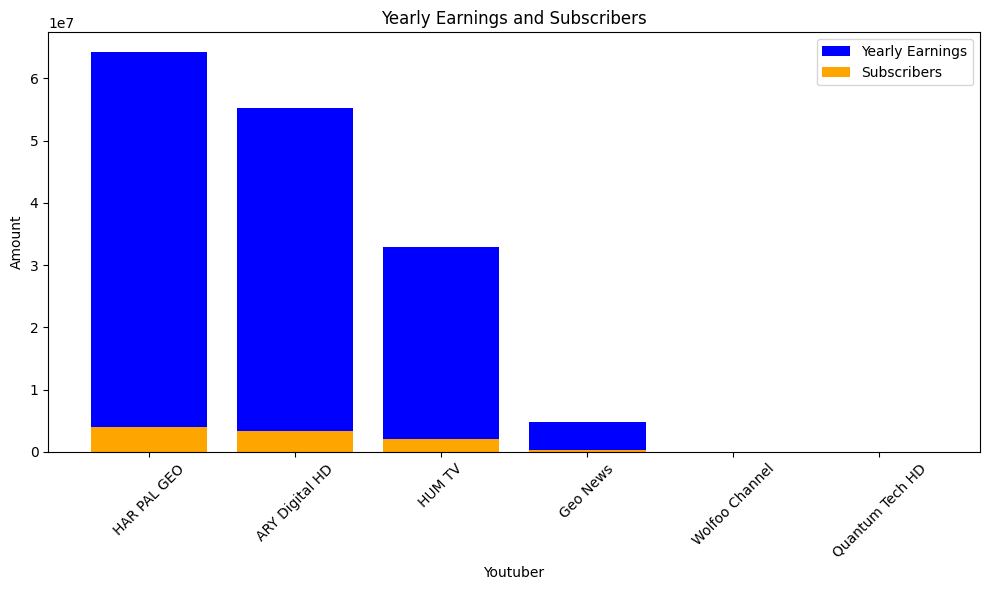

 16%|█▌        | 345/2160 [03:10<12:16,  2.47it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300100.0, Youtuber: Spinnin' Records
highest_yearly_earnings: 1700000.0, Subscribers: 107800.0, Youtuber: NikkieTutorials
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: ýýýýýýýý/Atro


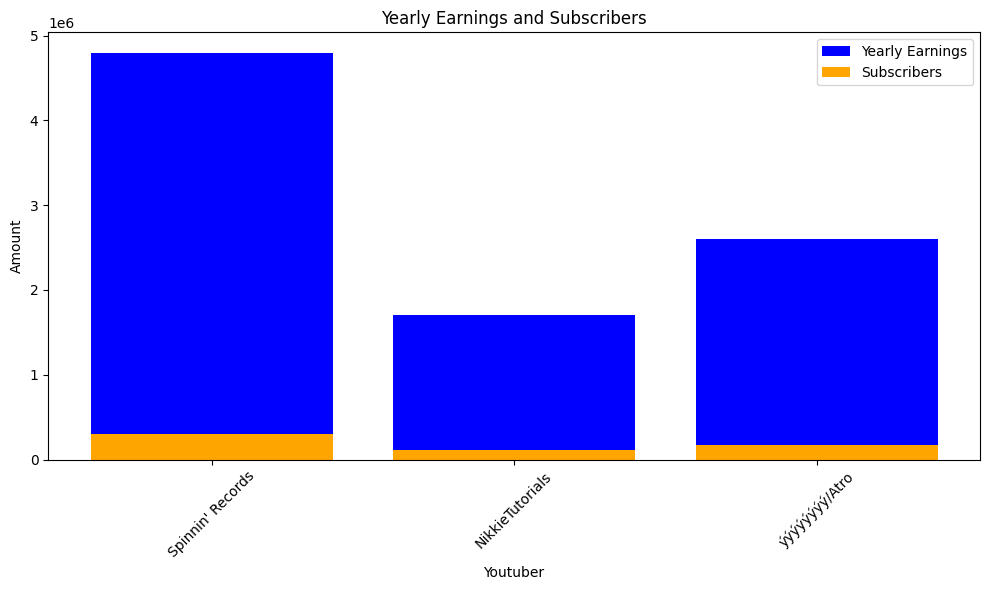

 16%|█▌        | 348/2160 [03:11<11:21,  2.66it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


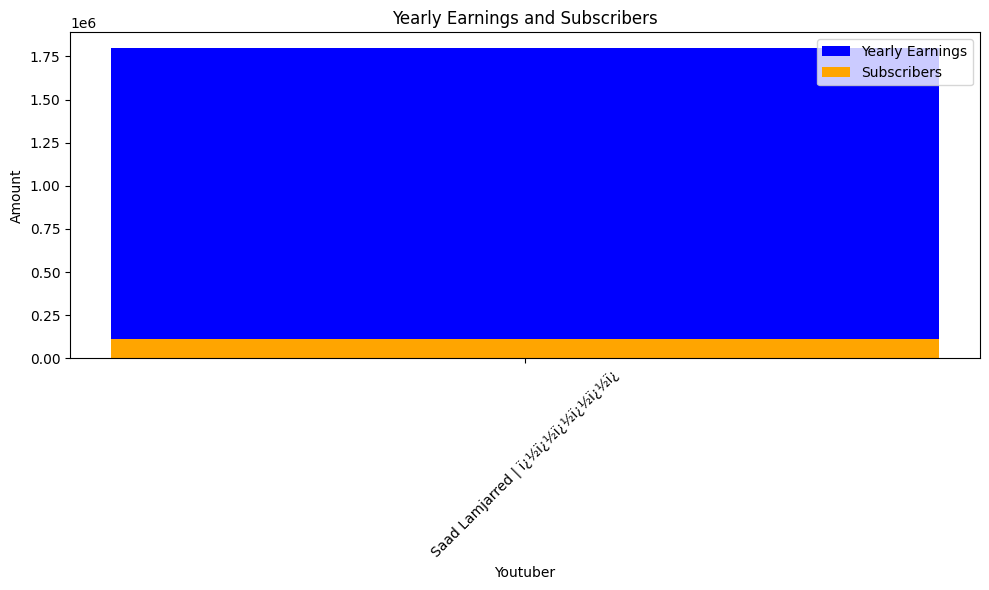

 16%|█▋        | 351/2160 [03:13<12:10,  2.47it/s]check
highest_yearly_earnings: 6600000.0, Subscribers: 410200.0, Youtuber: Kimberly Loaiza
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Luisito Comunica
highest_yearly_earnings: 1500000.0, Subscribers: 94400.0, Youtuber: GENIAL
highest_yearly_earnings: 1500000.0, Subscribers: 91500.0, Youtuber: LosPolinesios
highest_yearly_earnings: 16100.0, Subscribers: 1000.0, Youtuber: Yuya
highest_yearly_earnings: 1600000.0, Subscribers: 100800.0, Youtuber: MrBeast en Espaï¿½ï
highest_yearly_earnings: 2200000.0, Subscribers: 140600.0, Youtuber: Juan De Dios Pantoja
highest_yearly_earnings: 6600000.0, Subscribers: 410500.0, Youtuber: BabyBus - Canciones Infantiles & Videos para Niï¿½ï
highest_yearly_earnings: 227.0, Subscribers: 14.0, Youtuber: Disney Latinoamï¿½ï¿½
highest_yearly_earnings: 742.0, Subscribers: 46.0, Youtuber: Tlnovelas
highest_yearly_earnings: 114300.0, Subscribers: 7100.0, Youtuber: JukiLop
highest_yearly_earnings: 5900

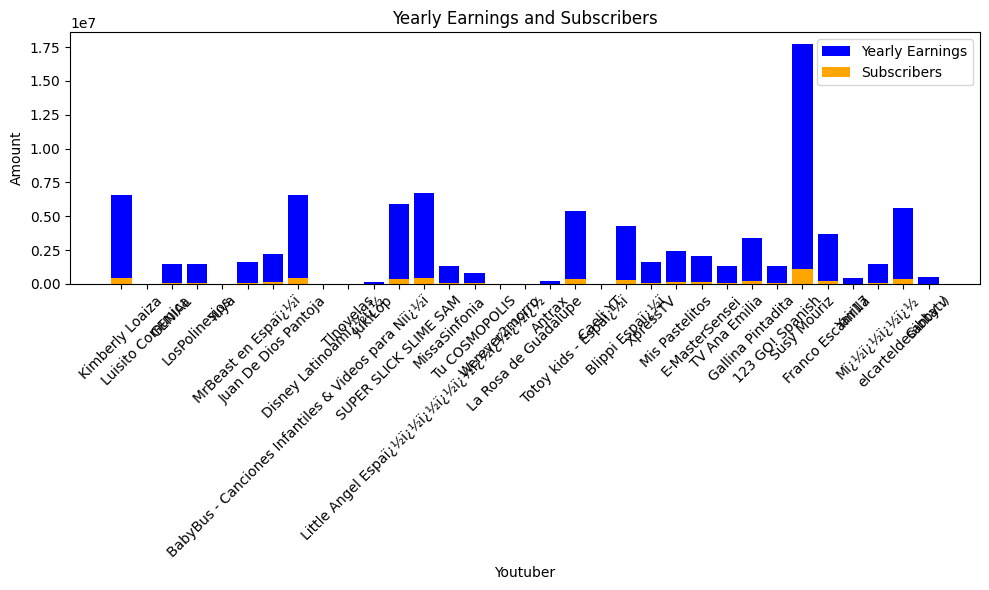

 16%|█▋        | 354/2160 [03:15<16:16,  1.85it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


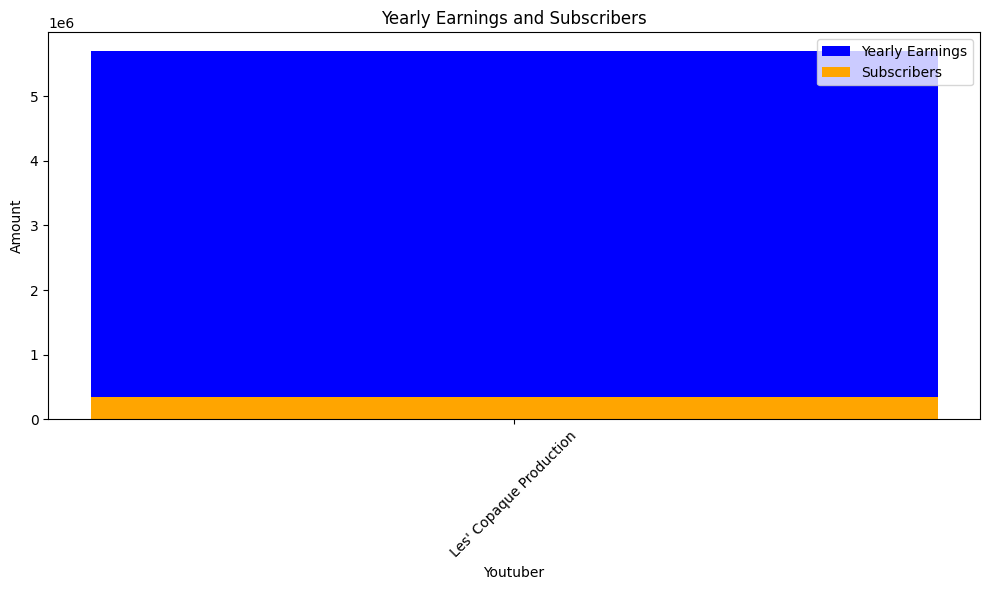

 17%|█▋        | 357/2160 [03:17<15:37,  1.92it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


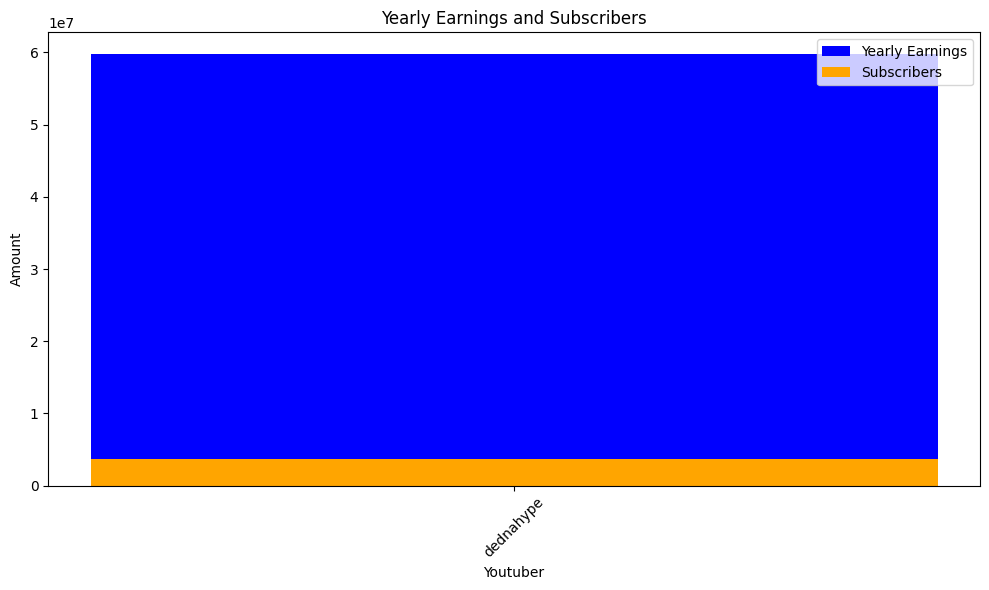

 17%|█▋        | 360/2160 [03:18<12:29,  2.40it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


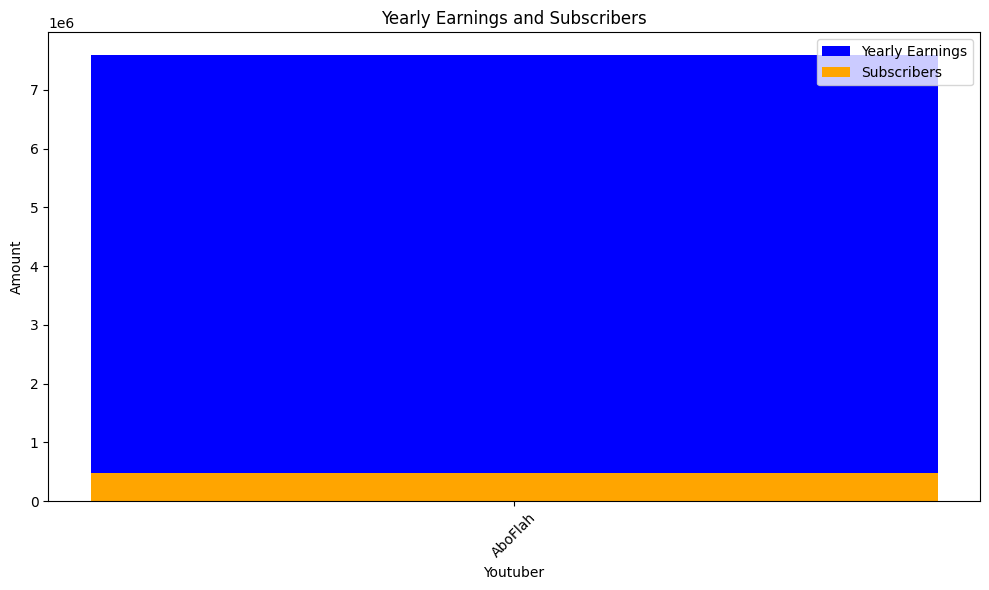

 17%|█▋        | 363/2160 [03:20<11:25,  2.62it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


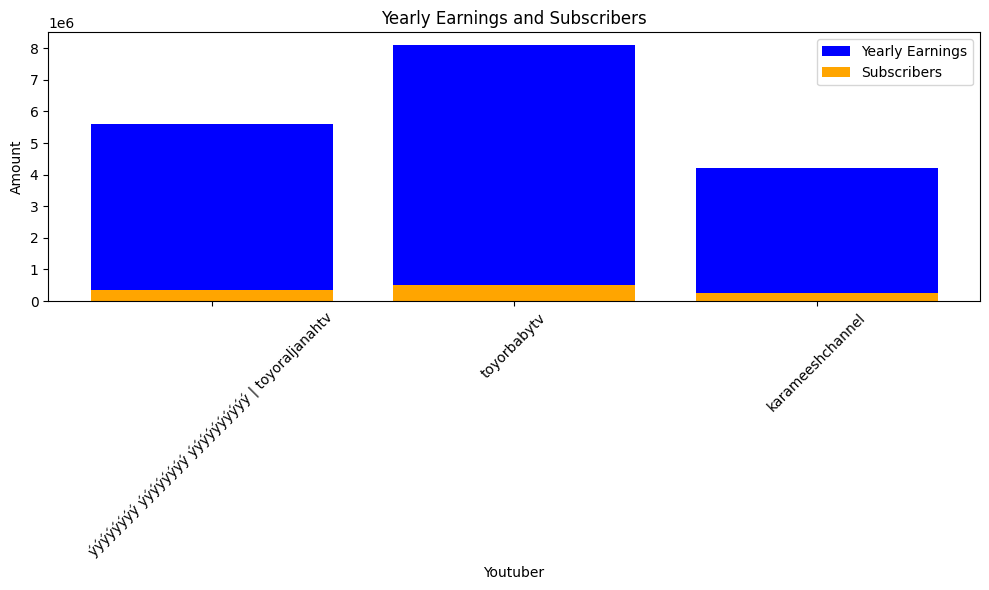

 17%|█▋        | 366/2160 [03:21<11:06,  2.69it/s]check
highest_yearly_earnings: 1900000.0, Subscribers: 117600.0, Youtuber: PewDiePie
highest_yearly_earnings: 34600000.0, Subscribers: 2200000.0, Youtuber: Junya.ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 34100000.0, Subscribers: 2100000.0, Youtuber: Sagawa /ï¿½ï¿½ï¿½
highest_yearly_earnings: 13600000.0, Subscribers: 847100.0, Youtuber: ISSEI / ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 119.0, Subscribers: 7.0, Youtuber: Bayashi TV


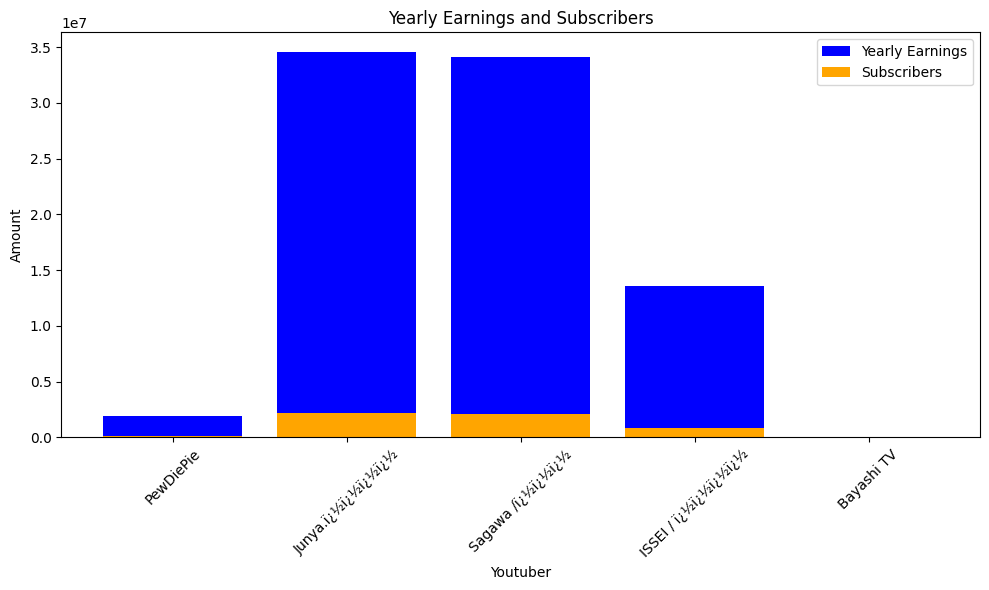

 17%|█▋        | 369/2160 [03:22<11:21,  2.63it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


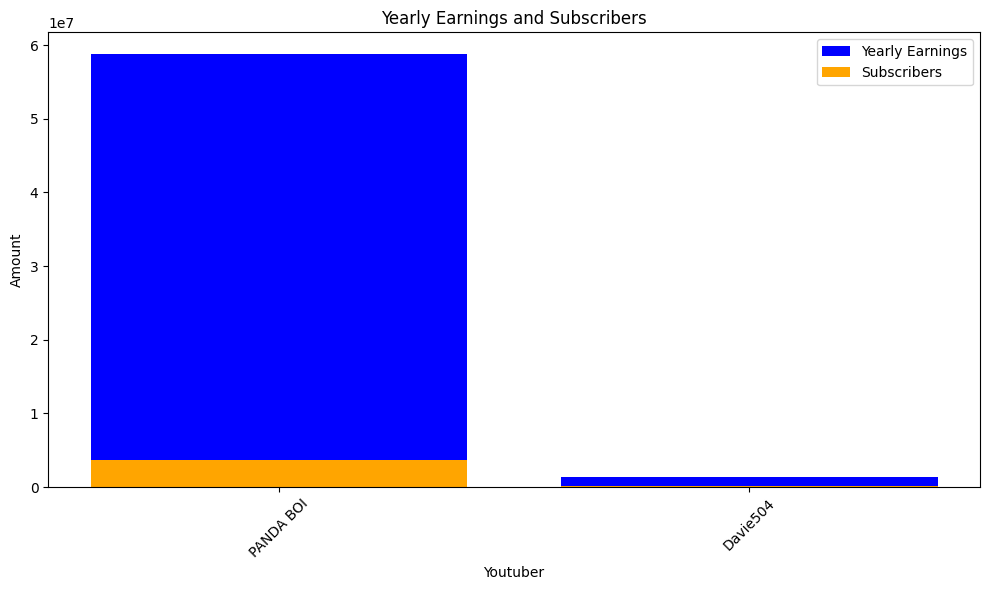

 17%|█▋        | 372/2160 [03:24<11:22,  2.62it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


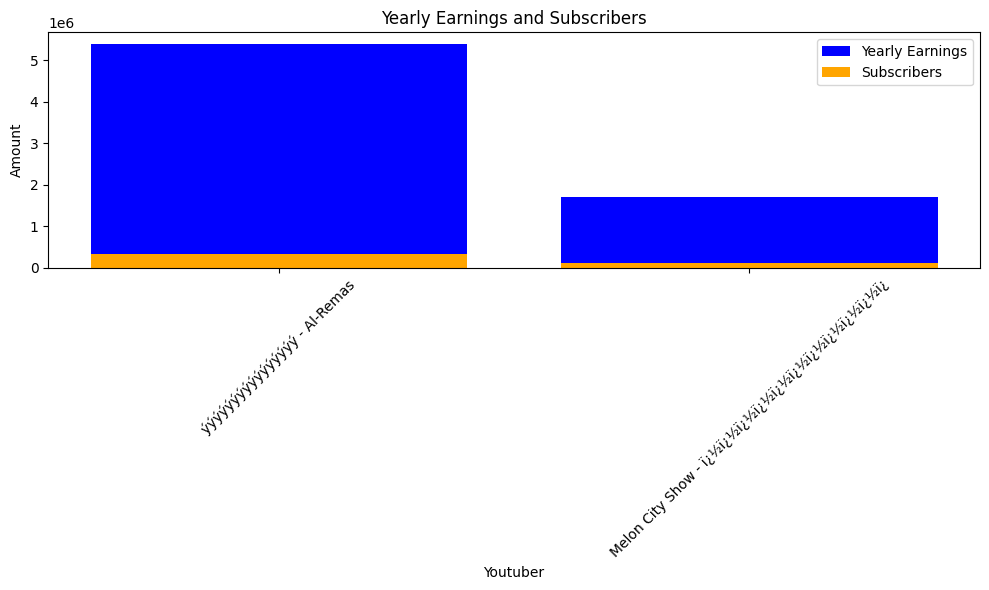

 17%|█▋        | 375/2160 [03:25<11:22,  2.62it/s]check
highest_yearly_earnings: 26300000.0, Subscribers: 1600000.0, Youtuber: Jess No Limit
highest_yearly_earnings: 7500000.0, Subscribers: 471300.0, Youtuber: Ricis Official
highest_yearly_earnings: 1000000.0, Subscribers: 64300.0, Youtuber: AH
highest_yearly_earnings: 11000000.0, Subscribers: 690500.0, Youtuber: Indosiar
highest_yearly_earnings: 2800000.0, Subscribers: 175500.0, Youtuber: Rans Entertainment
highest_yearly_earnings: 5900000.0, Subscribers: 369600.0, Youtuber: TRANS7 OFFICIAL
highest_yearly_earnings: 1300000.0, Subscribers: 80900.0, Youtuber: Baim Paula
highest_yearly_earnings: 4.0, Subscribers: 0.26, Youtuber: Deddy Corbuzier
highest_yearly_earnings: 5400000.0, Subscribers: 338300.0, Youtuber: BabyBus - Cerita & Lagu Anak-anak
highest_yearly_earnings: 3100000.0, Subscribers: 193500.0, Youtuber: MiawAug
highest_yearly_earnings: 9500000.0, Subscribers: 592100.0, Youtuber: Willie Salim
highest_yearly_earnings: 819000.0, S

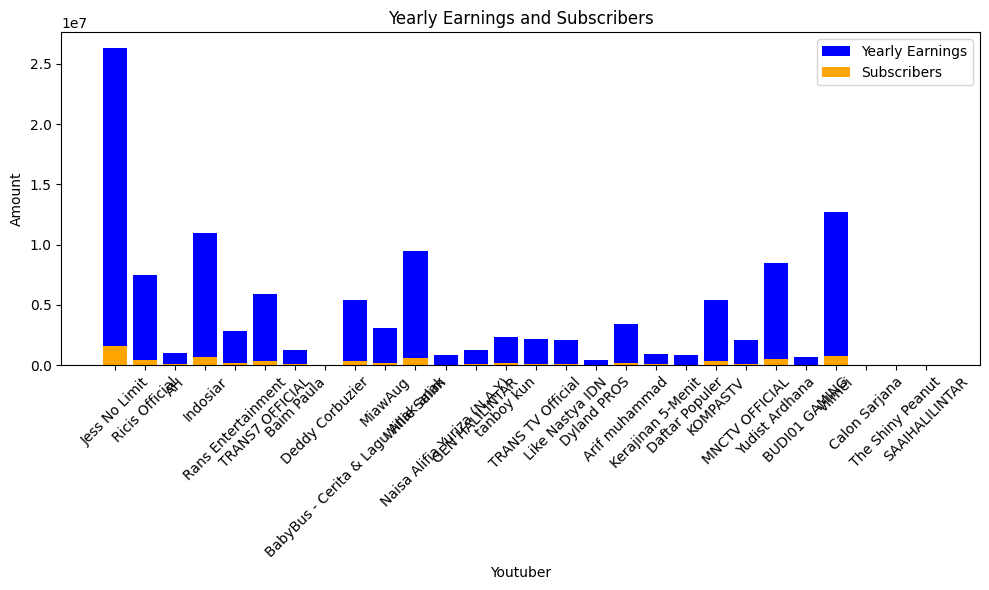

 18%|█▊        | 378/2160 [03:27<12:26,  2.39it/s]check
highest_yearly_earnings: 108400000.0, Subscribers: 6800000.0, Youtuber: T-Series
highest_yearly_earnings: 87500000.0, Subscribers: 5500000.0, Youtuber: SET India
highest_yearly_earnings: 38600000.0, Subscribers: 2400000.0, Youtuber: Zee Music Company
highest_yearly_earnings: 79600000.0, Subscribers: 5000000.0, Youtuber: Sony SAB
highest_yearly_earnings: 81900000.0, Subscribers: 5100000.0, Youtuber: Zee TV
highest_yearly_earnings: 20200000.0, Subscribers: 1300000.0, Youtuber: ChuChu TV Nursery Rhymes & Kids Songs
highest_yearly_earnings: 12200000.0, Subscribers: 764900.0, Youtuber: Shemaroo Filmi Gaane
highest_yearly_earnings: 57000000.0, Subscribers: 3600000.0, Youtuber: Colors TV
highest_yearly_earnings: 0.48, Subscribers: 0.03, Youtuber: T-Series Bhakti Sagar
highest_yearly_earnings: 20300000.0, Subscribers: 1300000.0, Youtuber: Tips Official
highest_yearly_earnings: 11100000.0, Subscribers: 696100.0, Youtuber: Wave Music
highes

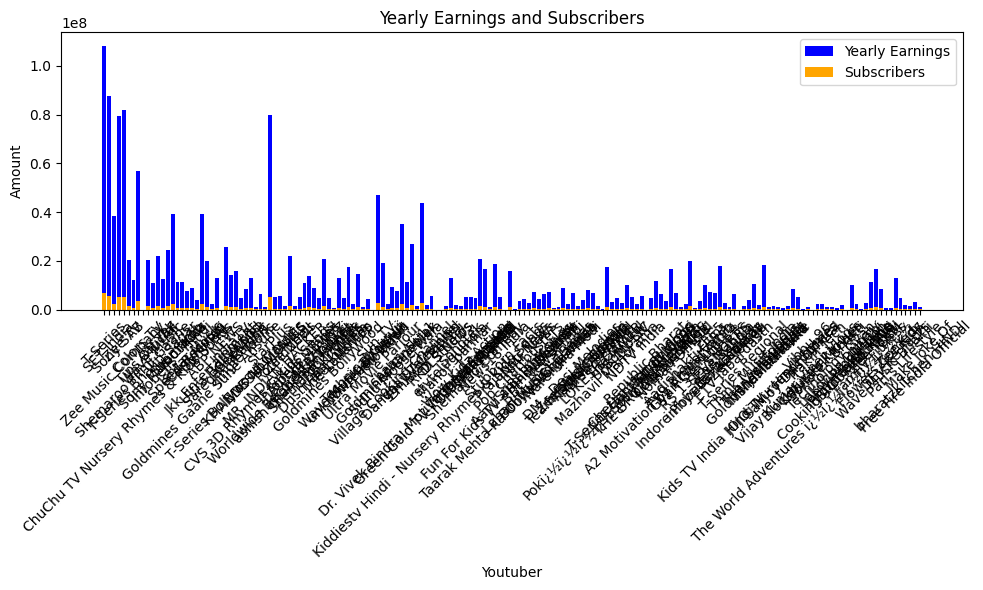

 18%|█▊        | 381/2160 [03:32<33:59,  1.15s/it]check
highest_yearly_earnings: 36300000.0, Subscribers: 2300000.0, Youtuber: Tsuriki Show
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: YOLO
highest_yearly_earnings: 1400000.0, Subscribers: 87800.0, Youtuber: Kurzgesagt ï¿½ï¿½ï¿½ï¿½ï¿½ï¿
highest_yearly_earnings: 271200.0, Subscribers: 17000.0, Youtuber: HaerteTest
highest_yearly_earnings: 29600000.0, Subscribers: 1900000.0, Youtuber: Younes Zarou
highest_yearly_earnings: 1800.0, Subscribers: 114.0, Youtuber: Beast Philanthropy


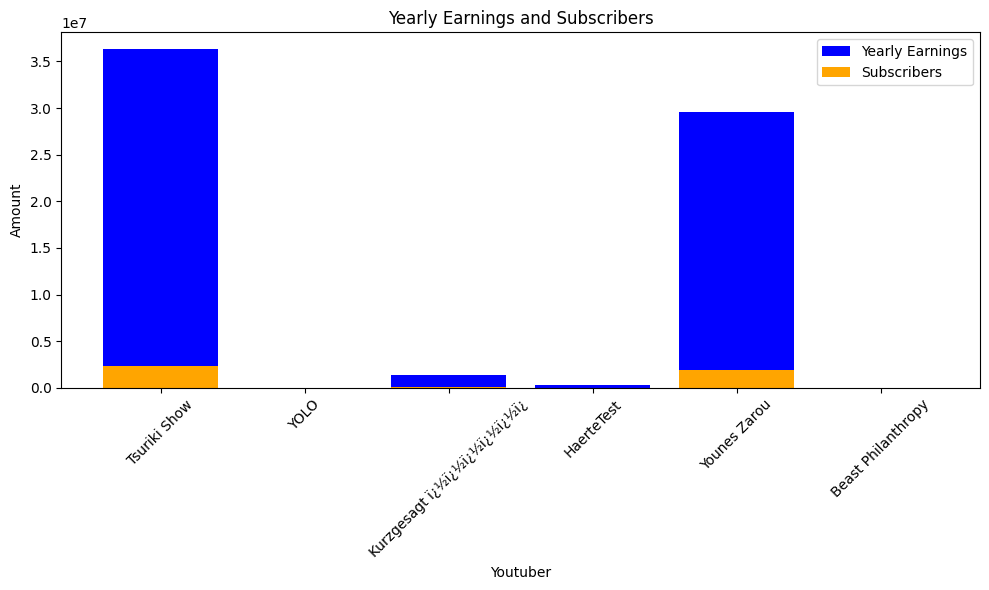

 18%|█▊        | 384/2160 [03:34<18:56,  1.56it/s]check
highest_yearly_earnings: 35.0, Subscribers: 2.0, Youtuber: Smile Family
highest_yearly_earnings: 2300000.0, Subscribers: 144300.0, Youtuber: SQUEEZIE
highest_yearly_earnings: 37.0, Subscribers: 2.0, Youtuber: FitDance
highest_yearly_earnings: 548000.0, Subscribers: 34300.0, Youtuber: Cyprien
highest_yearly_earnings: 1500000.0, Subscribers: 91400.0, Youtuber: Lofi Girl


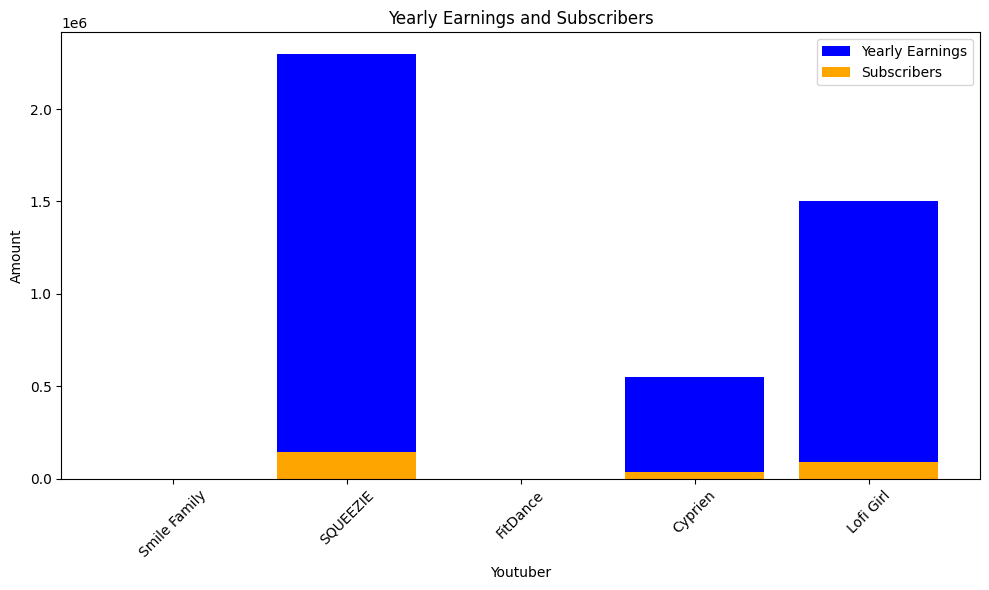

 18%|█▊        | 387/2160 [03:35<13:40,  2.16it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


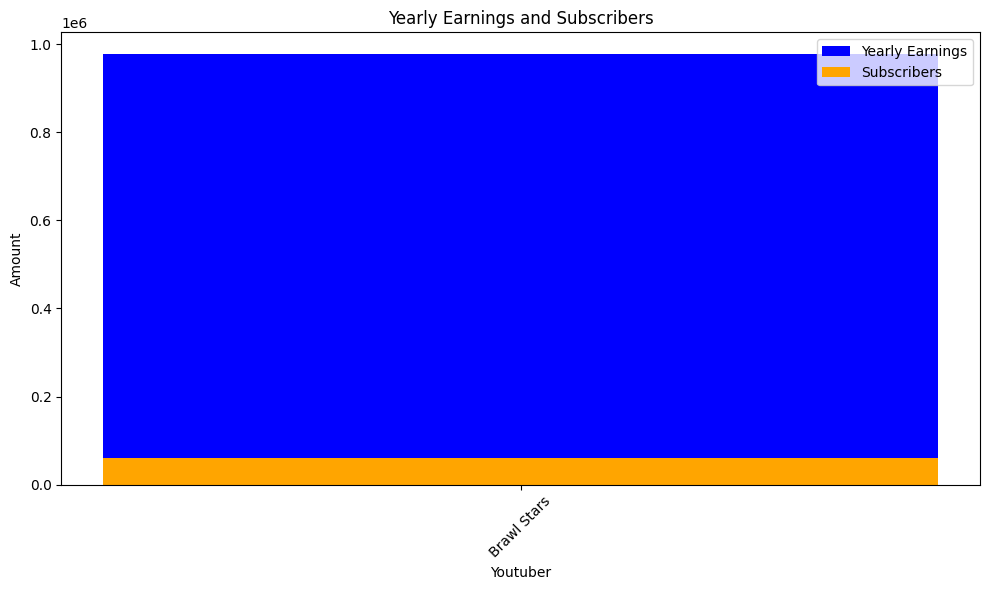

 18%|█▊        | 390/2160 [03:36<11:43,  2.52it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


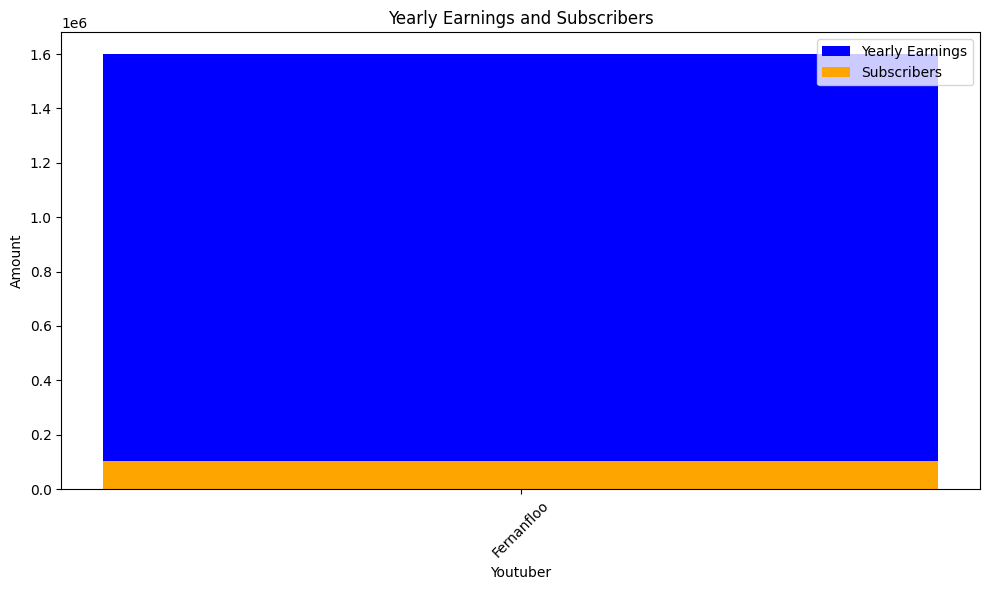

 18%|█▊        | 393/2160 [03:38<10:56,  2.69it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


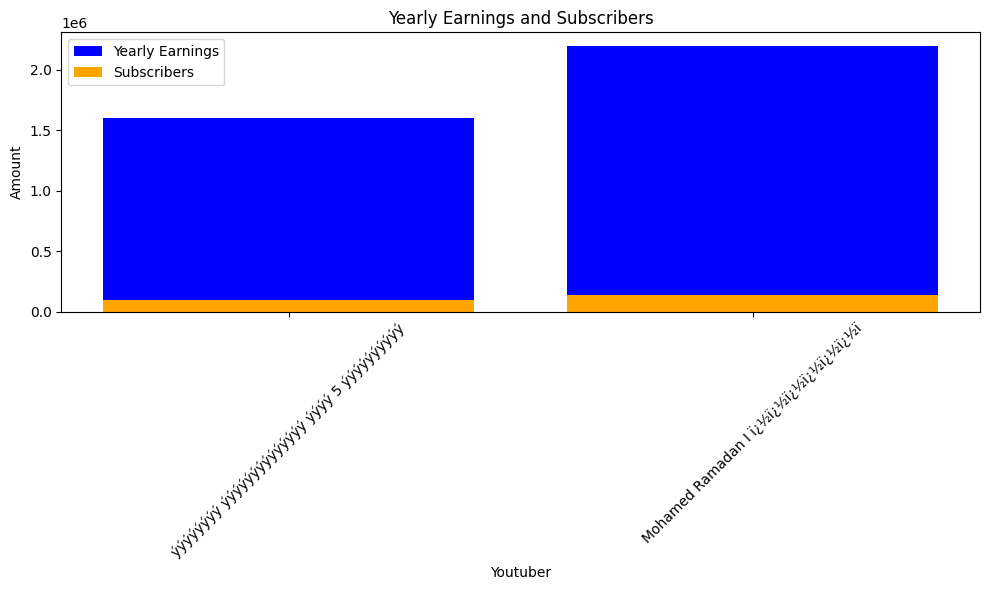

 18%|█▊        | 396/2160 [03:39<10:35,  2.78it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


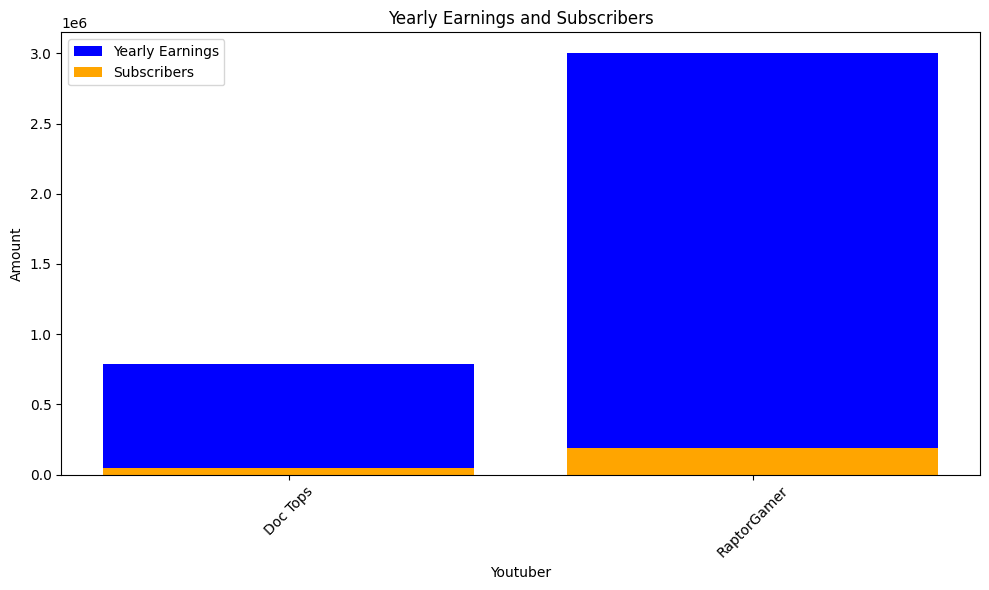

 18%|█▊        | 399/2160 [03:40<10:26,  2.81it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


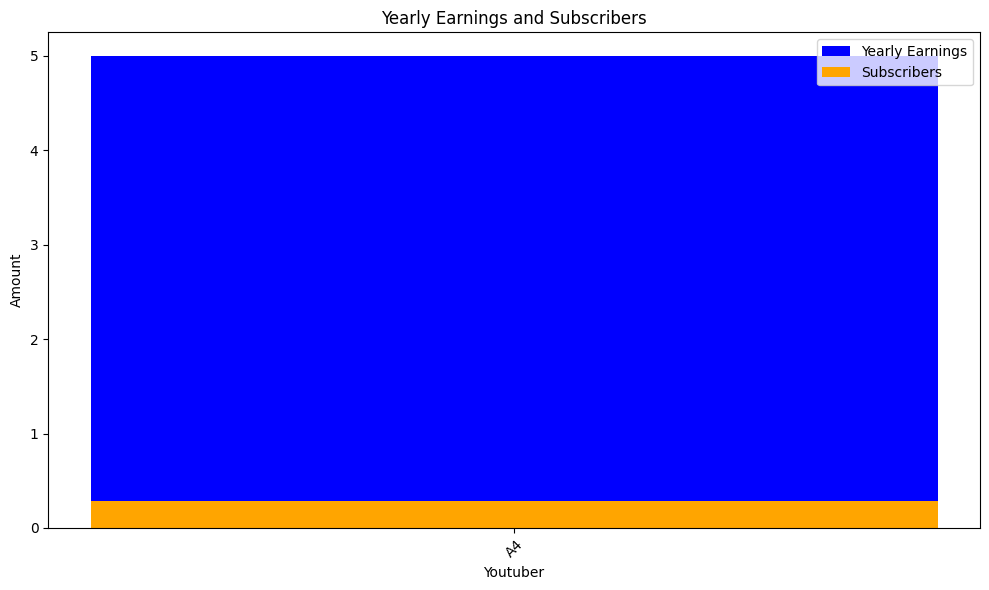

 19%|█▊        | 402/2160 [03:41<09:59,  2.93it/s]check
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Shakira
highest_yearly_earnings: 6200000.0, Subscribers: 386100.0, Youtuber: J Balvin
highest_yearly_earnings: 22400000.0, Subscribers: 1400000.0, Youtuber: KAROL G
highest_yearly_earnings: 8300000.0, Subscribers: 521500.0, Youtuber: toycantando
highest_yearly_earnings: 1200000.0, Subscribers: 73100.0, Youtuber: enchufetv
highest_yearly_earnings: 13600000.0, Subscribers: 852400.0, Youtuber: Anuel AA
highest_yearly_earnings: 12700000.0, Subscribers: 791600.0, Youtuber: Ami Rodriguez
highest_yearly_earnings: 2900000.0, Subscribers: 179700.0, Youtuber: Camilo
highest_yearly_earnings: 11000000.0, Subscribers: 686700.0, Youtuber: Codiscos
highest_yearly_earnings: 4100000.0, Subscribers: 258800.0, Youtuber: jbalvinVEVO
highest_yearly_earnings: 15700000.0, Subscribers: 982800.0, Youtuber: Go Ami Go!


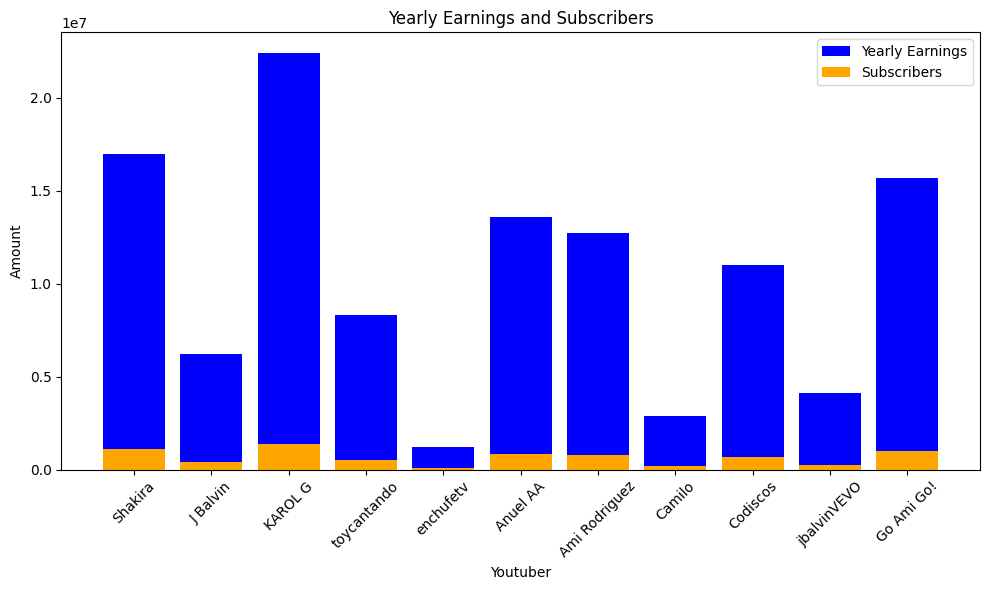

 19%|█▉        | 405/2160 [03:43<12:57,  2.26it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


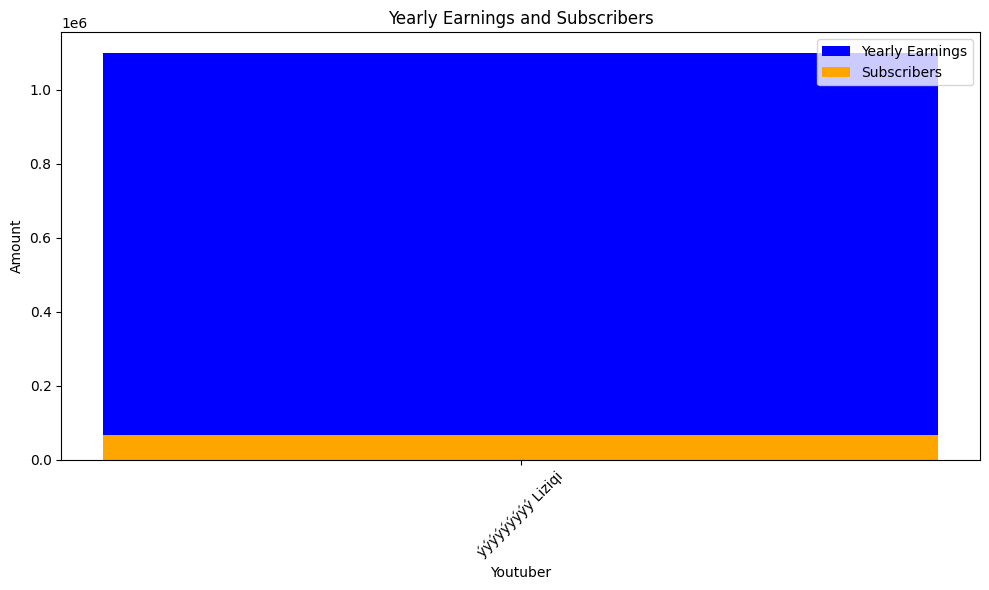

 19%|█▉        | 408/2160 [03:45<13:31,  2.16it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 199200.0, Youtuber: JuegaGerman
highest_yearly_earnings: 2.0, Subscribers: 0.15, Youtuber: invictor
highest_yearly_earnings: 4800000.0, Subscribers: 300600.0, Youtuber: DeGoBooM


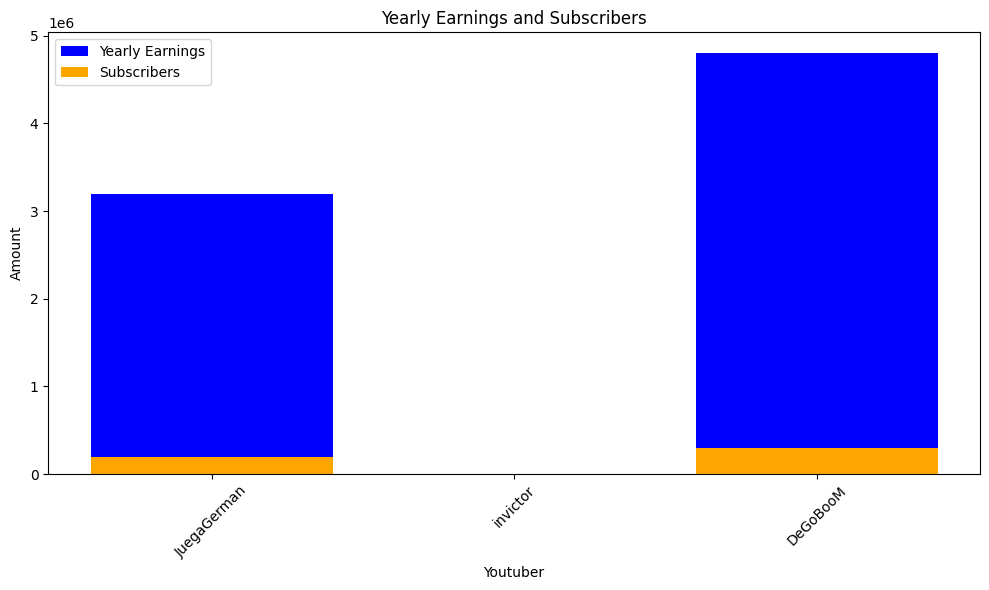

 19%|█▉        | 411/2160 [03:47<15:06,  1.93it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529000.0, Youtuber: Justin Bieber
highest_yearly_earnings: 26900000.0, Subscribers: 1700000.0, Youtuber: Super Simple Songs - Kids Songs
highest_yearly_earnings: 17900000.0, Subscribers: 1100000.0, Youtuber: The Weeknd
highest_yearly_earnings: 4300000.0, Subscribers: 266200.0, Youtuber: Shawn Mendes
highest_yearly_earnings: 2600000.0, Subscribers: 164800.0, Youtuber: VanossGaming
highest_yearly_earnings: 2400000.0, Subscribers: 147000.0, Youtuber: WatchMojo.com
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: FaZe Rug
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Pentatonix
highest_yearly_earnings: 4200000.0, Subscribers: 264700.0, Youtuber: Linus Tech Tips
highest_yearly_earnings: 255800.0, Subscribers: 16000.0, Youtuber: Lilly Singh
highest_yearly_earnings: 4000000.0, Subscribers: 251800.0, Youtuber: Hacksmith Industries
highest_yearly_earnings: 1600000.0, Sub

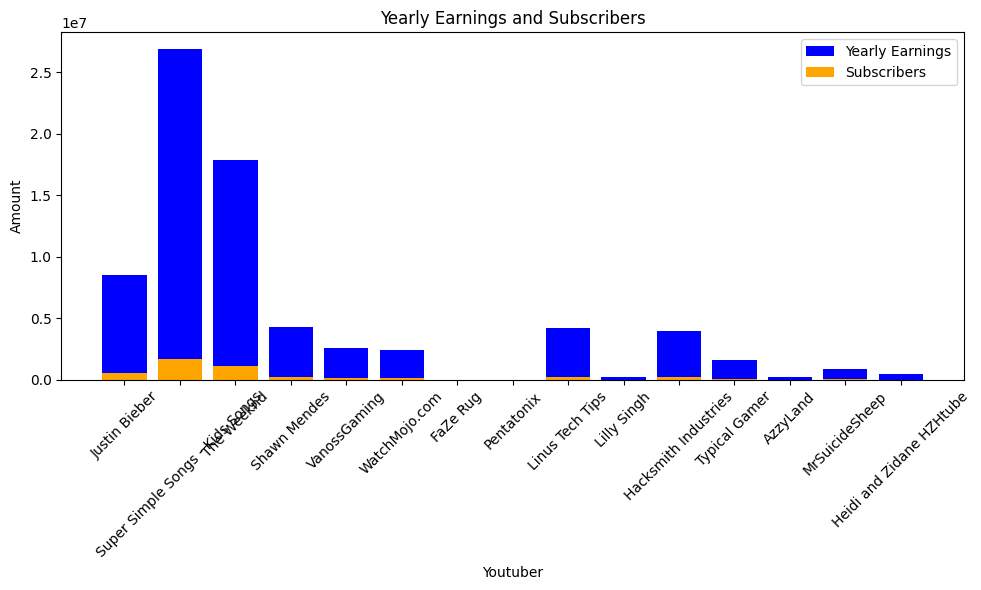

 19%|█▉        | 414/2160 [03:48<13:28,  2.16it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Canal KondZilla
highest_yearly_earnings: 6300000.0, Subscribers: 391100.0, Youtuber: Felipe Neto
highest_yearly_earnings: 2300000.0, Subscribers: 144100.0, Youtuber: Vocï¿½ï¿½ï¿½
highest_yearly_earnings: 1300000.0, Subscribers: 80100.0, Youtuber: whinderssonnunes
highest_yearly_earnings: 78500000.0, Subscribers: 4900000.0, Youtuber: GR6 EXPLODE
highest_yearly_earnings: 12100000.0, Subscribers: 754300.0, Youtuber: Maria Clara & JP
highest_yearly_earnings: 19400000.0, Subscribers: 1200000.0, Youtuber: Galinha Pintadinha
highest_yearly_earnings: 2100000.0, Subscribers: 133500.0, Youtuber: rezendeevil
highest_yearly_earnings: 14500000.0, Subscribers: 909300.0, Youtuber: Enaldinho
highest_yearly_earnings: 4000000.0, Subscribers: 248700.0, Youtuber: Renato Garcia YT
highest_yearly_earnings: 36500000.0, Subscribers: 2300000.0, Youtuber: Spider Slack
highest_yearly_earnings: 140000

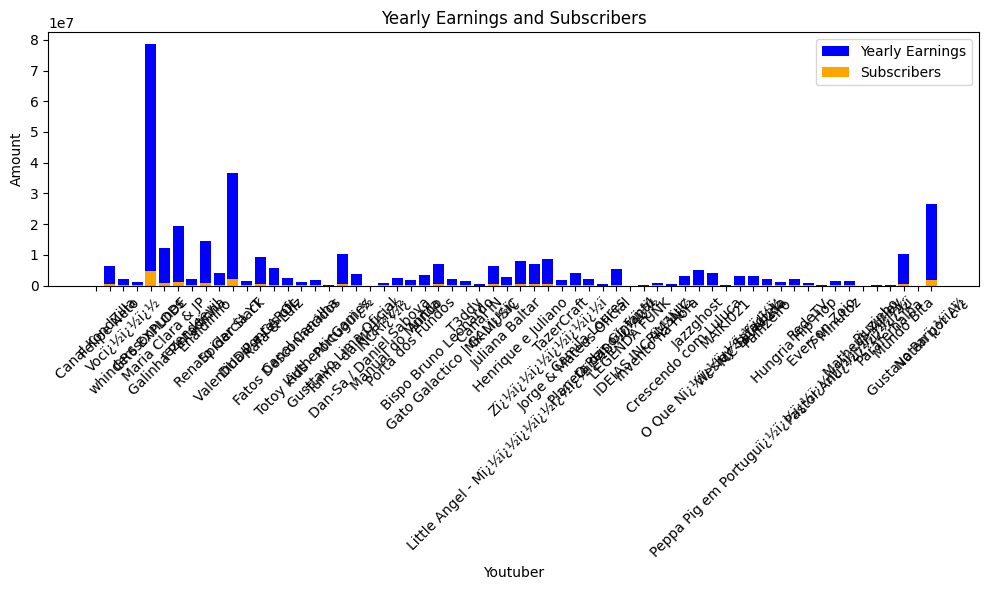

 19%|█▉        | 417/2160 [03:51<14:53,  1.95it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


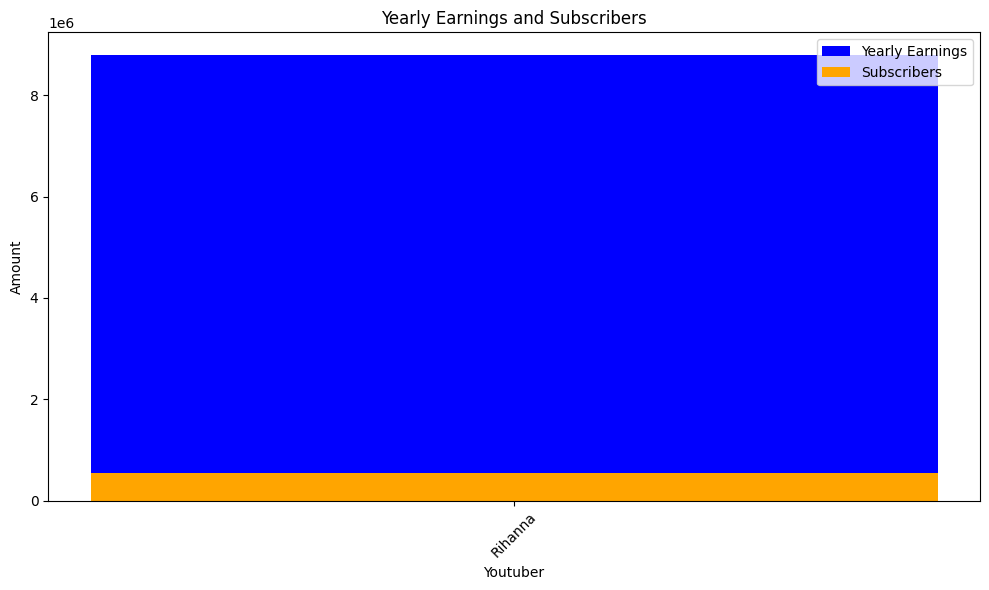

 19%|█▉        | 420/2160 [03:52<12:03,  2.41it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


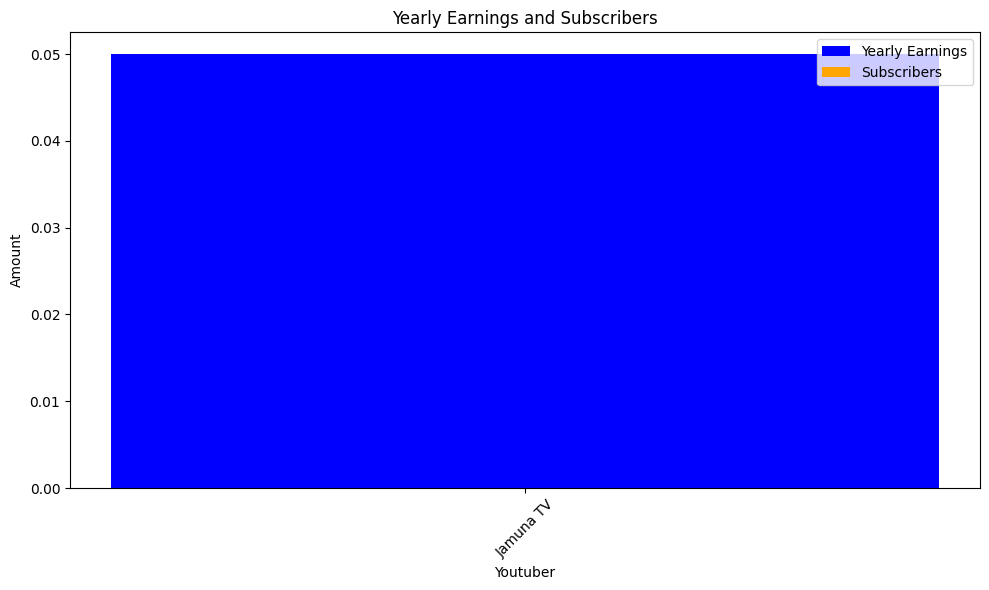

 20%|█▉        | 423/2160 [03:53<10:50,  2.67it/s]check
highest_yearly_earnings: 18800000.0, Subscribers: 1200000.0, Youtuber: How Ridiculous


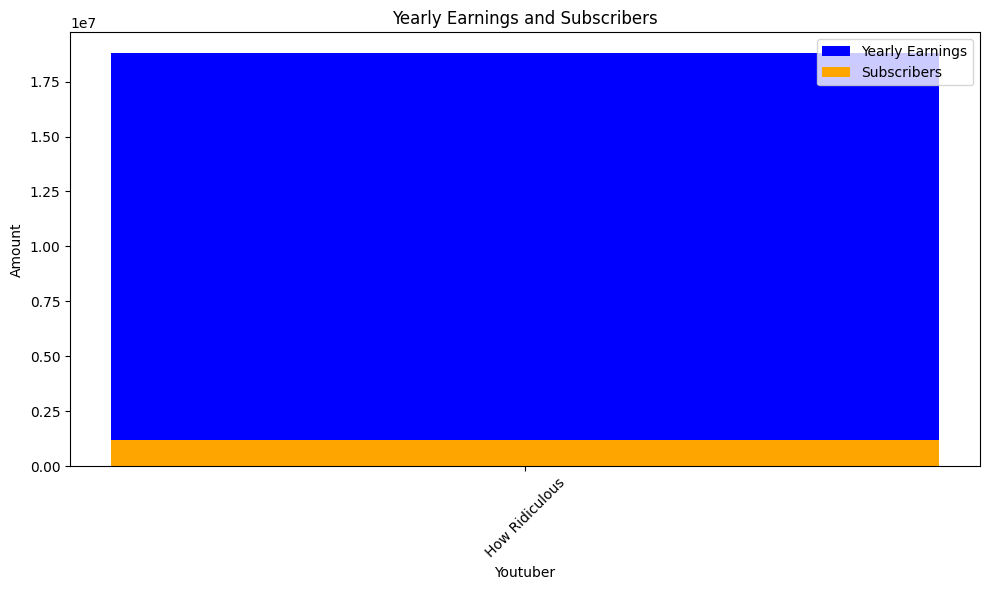

 20%|█▉        | 426/2160 [03:55<11:08,  2.59it/s]check
highest_yearly_earnings: 29400000.0, Subscribers: 1800000.0, Youtuber: El Reino Infantil
highest_yearly_earnings: 14500000.0, Subscribers: 906200.0, Youtuber: La Granja de Zenï¿½
highest_yearly_earnings: 9200000.0, Subscribers: 572000.0, Youtuber: TheDonato
highest_yearly_earnings: 0.72, Subscribers: 0.05, Youtuber: Maluma
highest_yearly_earnings: 19300000.0, Subscribers: 1200000.0, Youtuber: Alejo Igoa
highest_yearly_earnings: 1700000.0, Subscribers: 106600.0, Youtuber: DrossRotzank
highest_yearly_earnings: 3500000.0, Subscribers: 216700.0, Youtuber: Paulo Londra
highest_yearly_earnings: 9300000.0, Subscribers: 579500.0, Youtuber: Bizarrap
highest_yearly_earnings: 1300000.0, Subscribers: 82600.0, Youtuber: RobleisIUTU
highest_yearly_earnings: 30700000.0, Subscribers: 1900000.0, Youtuber: El Payaso Plim Plim
highest_yearly_earnings: 4000000.0, Subscribers: 251100.0, Youtuber: El Reino a Jugar
highest_yearly_earnings: 3100000.0, Su

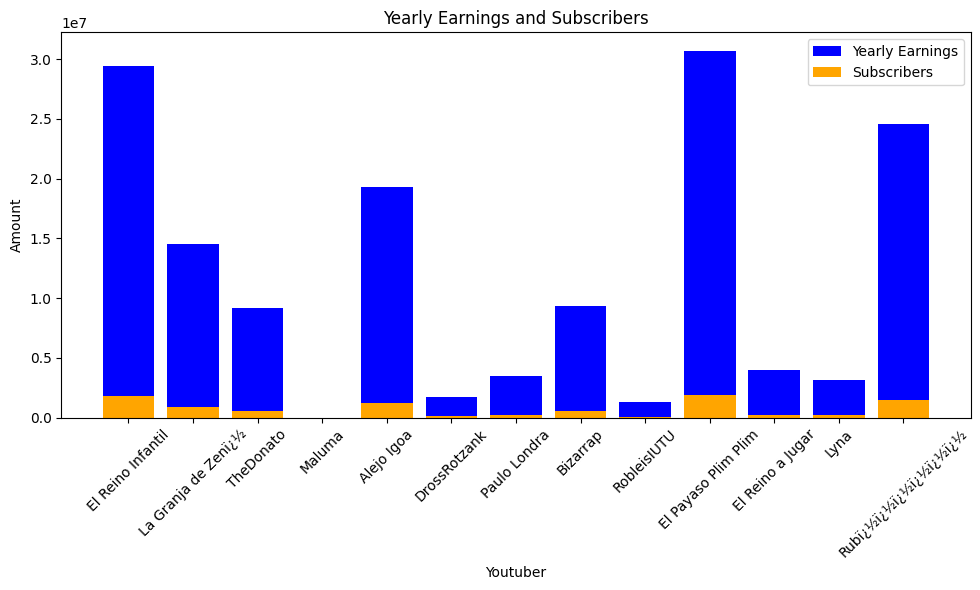

 20%|█▉        | 429/2160 [03:56<11:27,  2.52it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


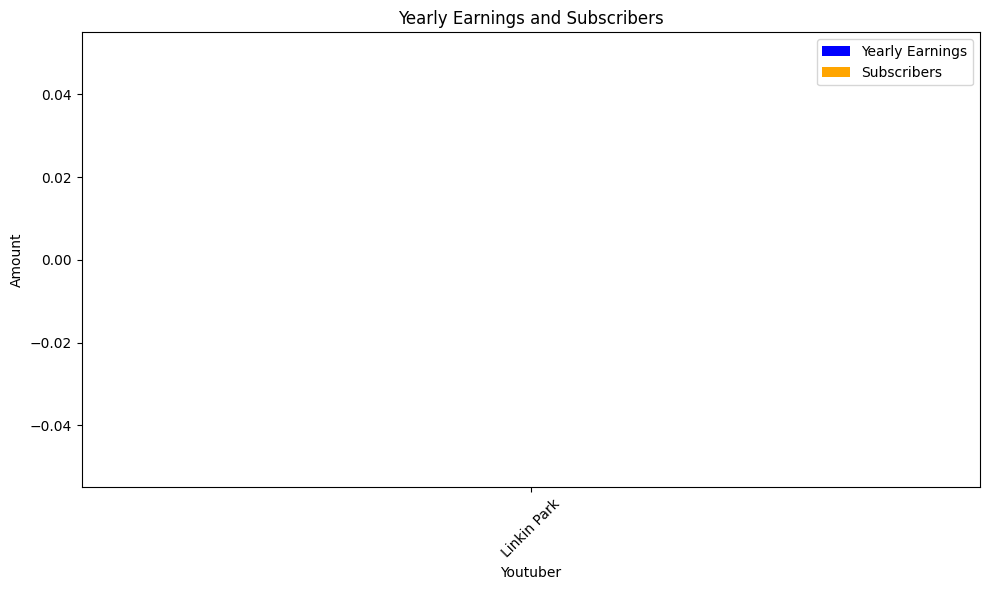

 20%|██        | 432/2160 [03:57<10:13,  2.82it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


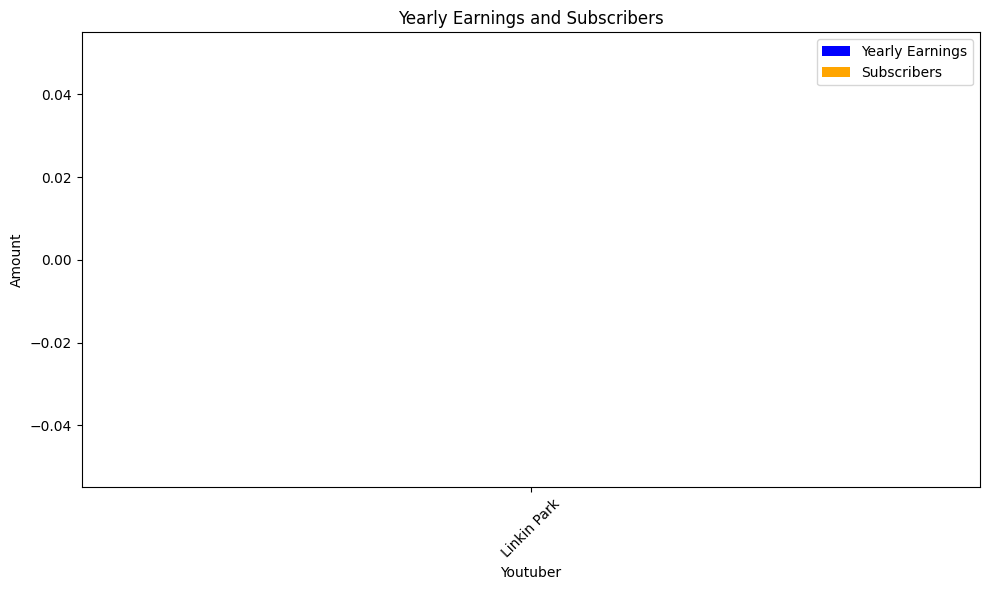

check
highest_yearly_earnings: 4100000.0, Subscribers: 253400.0, Youtuber: Like Nastya VNM
highest_yearly_earnings: 12300000.0, Subscribers: 770200.0, Youtuber: POPS Kids
highest_yearly_earnings: 1700000.0, Subscribers: 105400.0, Youtuber: FAPTV


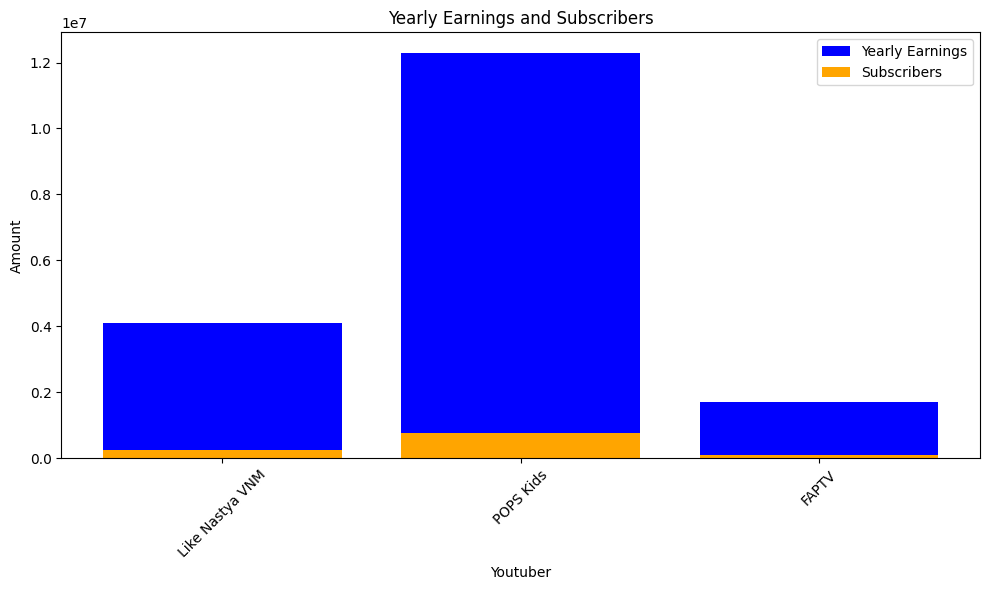

 20%|██        | 435/2160 [03:59<14:20,  2.00it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


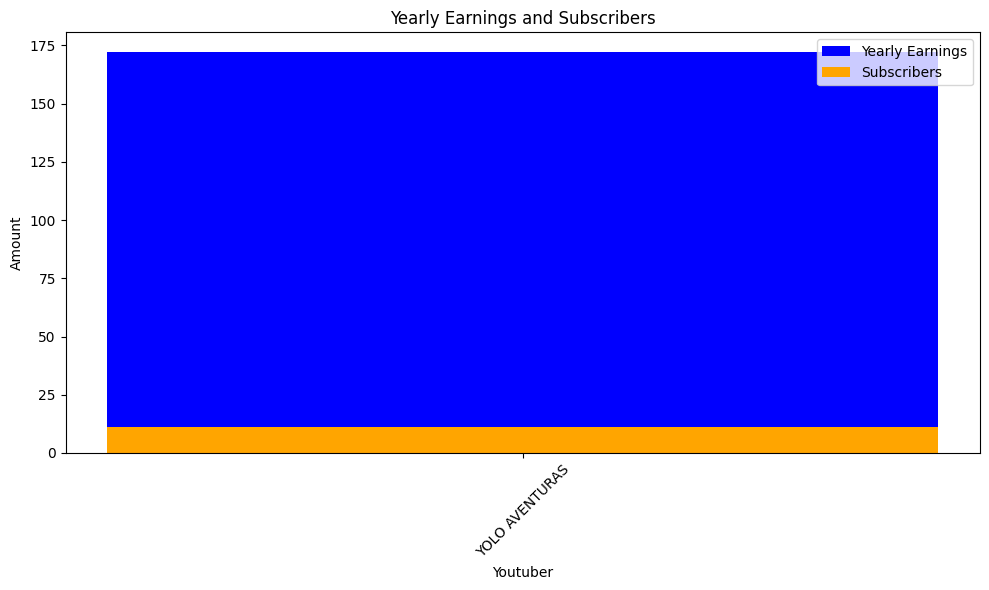

 20%|██        | 438/2160 [04:01<13:50,  2.07it/s]check
highest_yearly_earnings: 56300000.0, Subscribers: 3500000.0, Youtuber: LeoNata Family
highest_yearly_earnings: 11200000.0, Subscribers: 702700.0, Youtuber: Zach Choi ASMR
highest_yearly_earnings: 9500000.0, Subscribers: 593900.0, Youtuber: Stokes Twins
highest_yearly_earnings: 7700000.0, Subscribers: 480700.0, Youtuber: The Royalty Family
highest_yearly_earnings: 18400000.0, Subscribers: 1200000.0, Youtuber: LIV Crime
highest_yearly_earnings: 703000.0, Subscribers: 43900.0, Youtuber: Jake Paul
highest_yearly_earnings: 437400.0, Subscribers: 27300.0, Youtuber: BuzzFeedVideo
highest_yearly_earnings: 415200.0, Subscribers: 26000.0, Youtuber: David Dobrik
highest_yearly_earnings: 994.0, Subscribers: 62.0, Youtuber: MSA previously My Story Animated
highest_yearly_earnings: 1800.0, Subscribers: 114.0, Youtuber: XO TEAM
highest_yearly_earnings: 7900000.0, Subscribers: 494700.0, Youtuber: Unspeakable
highest_yearly_earnings: 76000.0, Subs

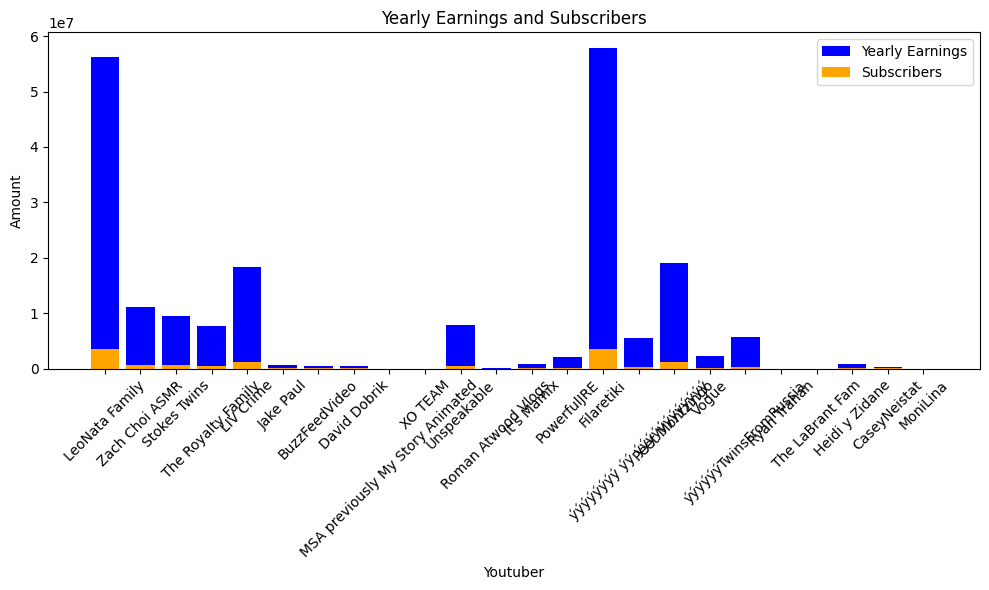

 20%|██        | 441/2160 [04:04<18:36,  1.54it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: 5-Minute Crafts
highest_yearly_earnings: 9700000.0, Subscribers: 608200.0, Youtuber: Ed Sheeran
highest_yearly_earnings: 2700000.0, Subscribers: 167000.0, Youtuber: NoCopyrightSounds
highest_yearly_earnings: 2700000.0, Subscribers: 169600.0, Youtuber: Mr Bean
highest_yearly_earnings: 11800000.0, Subscribers: 734800.0, Youtuber: Peppa Pig - Official Channel
highest_yearly_earnings: 6600000.0, Subscribers: 411300.0, Youtuber: Adele
highest_yearly_earnings: 3800000.0, Subscribers: 236000.0, Youtuber: DanTDM
highest_yearly_earnings: 9500000.0, Subscribers: 596600.0, Youtuber: Coldplay
highest_yearly_earnings: 15900000.0, Subscribers: 995700.0, Youtuber: Dan Rhodes
highest_yearly_earnings: 261100.0, Subscribers: 16300.0, Youtuber: KSI
highest_yearly_earnings: 1600000.0, Subscribers: 98400.0, Youtuber: Mister Max
highest_yearly_earnings: 2600000.0, Subscribers: 160800.0, Youtube

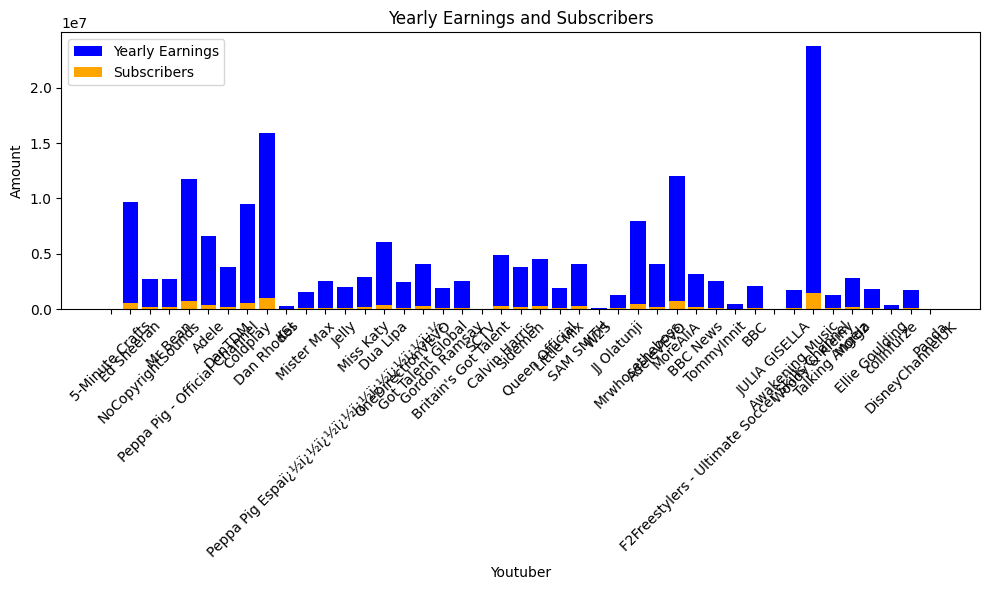

 21%|██        | 444/2160 [04:06<16:11,  1.77it/s]check
highest_yearly_earnings: 11900000.0, Subscribers: 743200.0, Youtuber: shfa2 - ï¿½ï¿½
highest_yearly_earnings: 7300000.0, Subscribers: 453600.0, Youtuber: shfa show India
highest_yearly_earnings: 76700000.0, Subscribers: 4800000.0, Youtuber: ZAMZAM ELECTRONICS TRADING


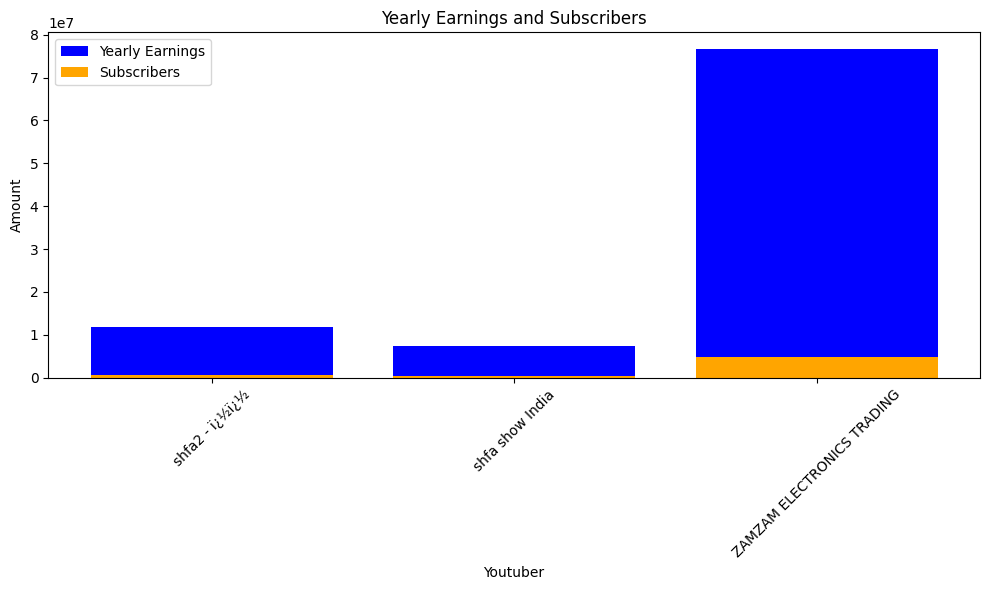

 21%|██        | 447/2160 [04:08<13:15,  2.15it/s]check
highest_yearly_earnings: 3600000.0, Subscribers: 225500.0, Youtuber: Lady Diana


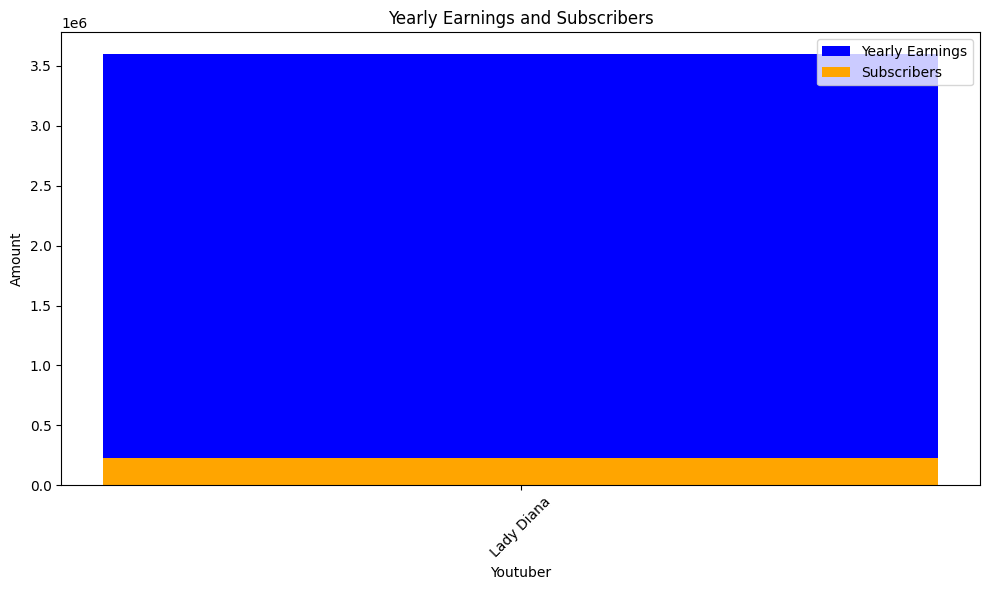

 21%|██        | 450/2160 [04:09<12:19,  2.31it/s]check
highest_yearly_earnings: 70200000.0, Subscribers: 4400000.0, Youtuber: BETER Bï¿½ï¿½
highest_yearly_earnings: 20400000.0, Subscribers: 1300000.0, Youtuber: netd mï¿½ï¿
highest_yearly_earnings: 5300000.0, Subscribers: 332400.0, Youtuber: tabii Urdu
highest_yearly_earnings: 212500.0, Subscribers: 13300.0, Youtuber: Oyuncak Avï¿


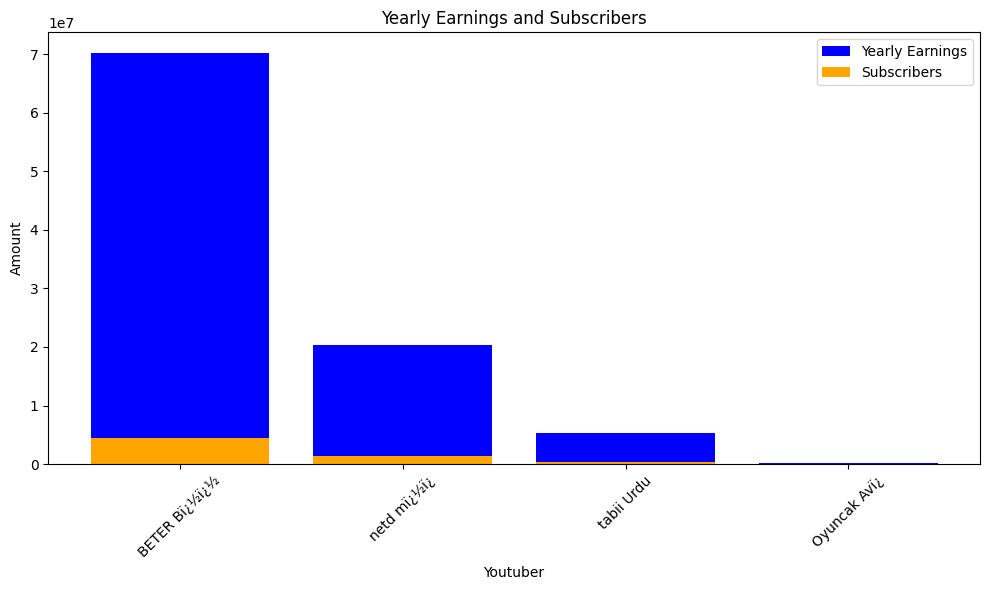

 21%|██        | 453/2160 [04:10<11:48,  2.41it/s]check
highest_yearly_earnings: 1.0, Subscribers: 0.07, Youtuber: Alan Walker
highest_yearly_earnings: 6300000.0, Subscribers: 391400.0, Youtuber: WorkpointOfficial
highest_yearly_earnings: 6800000.0, Subscribers: 422300.0, Youtuber: ýýýýýýýýýýýý one31
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Ch3Thailand
highest_yearly_earnings: 6300000.0, Subscribers: 390700.0, Youtuber: GMM GRAMMY OFFICIAL
highest_yearly_earnings: 8100000.0, Subscribers: 505800.0, Youtuber: GRAMMY GOLD OFFICIAL
highest_yearly_earnings: 2600000.0, Subscribers: 162400.0, Youtuber: RsiamMusic : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: zbing z.
highest_yearly_earnings: 11300000.0, Subscribers: 708000.0, Youtuber: AMARINTV : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 448400.0, Subscribers: 28000.0, Youtuber: Kaykai Salaider
highest_yearly_earnings: 4200000.0, Subscribers: 263300.0, Yout

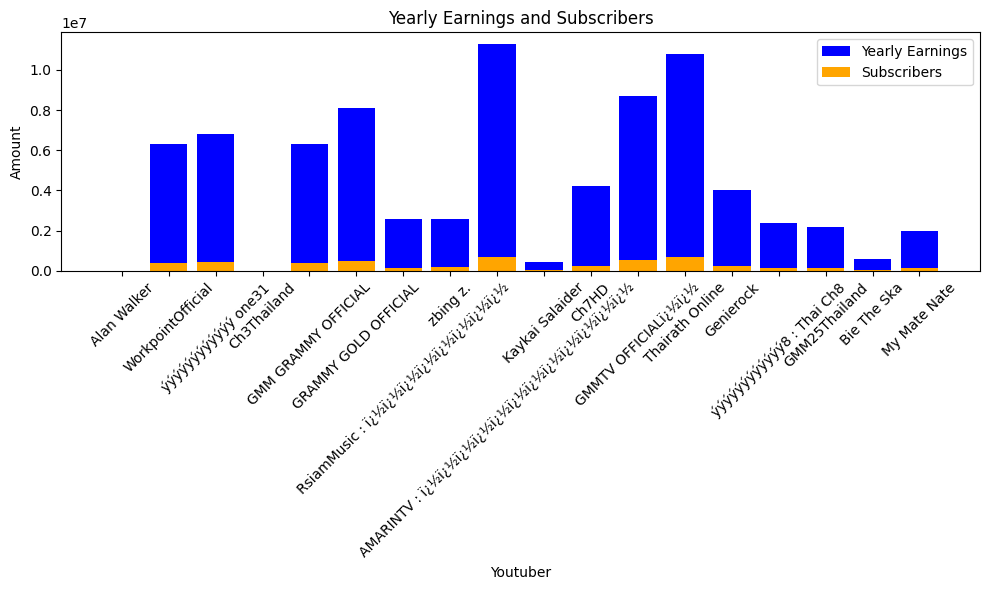

 21%|██        | 456/2160 [04:12<12:10,  2.33it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


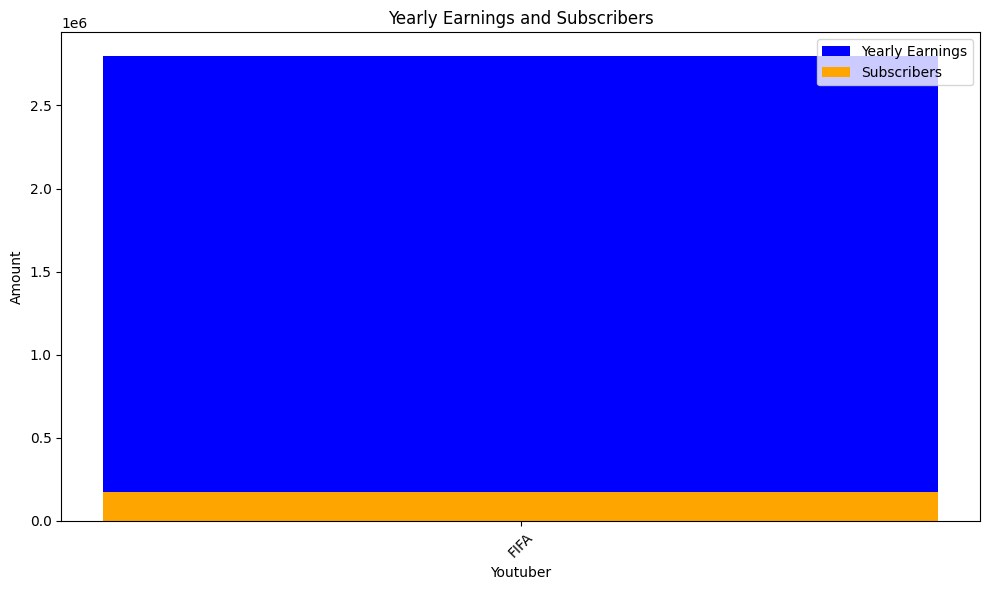

 21%|██▏       | 459/2160 [04:13<11:02,  2.57it/s]check
highest_yearly_earnings: 3900000.0, Subscribers: 243700.0, Youtuber: Avicii
highest_yearly_earnings: 23000000.0, Subscribers: 1400000.0, Youtuber: Panda Shorts
highest_yearly_earnings: 658000.0, Subscribers: 41100.0, Youtuber: Narins Beauty
highest_yearly_earnings: 185800.0, Subscribers: 11600.0, Youtuber: RobTopGames


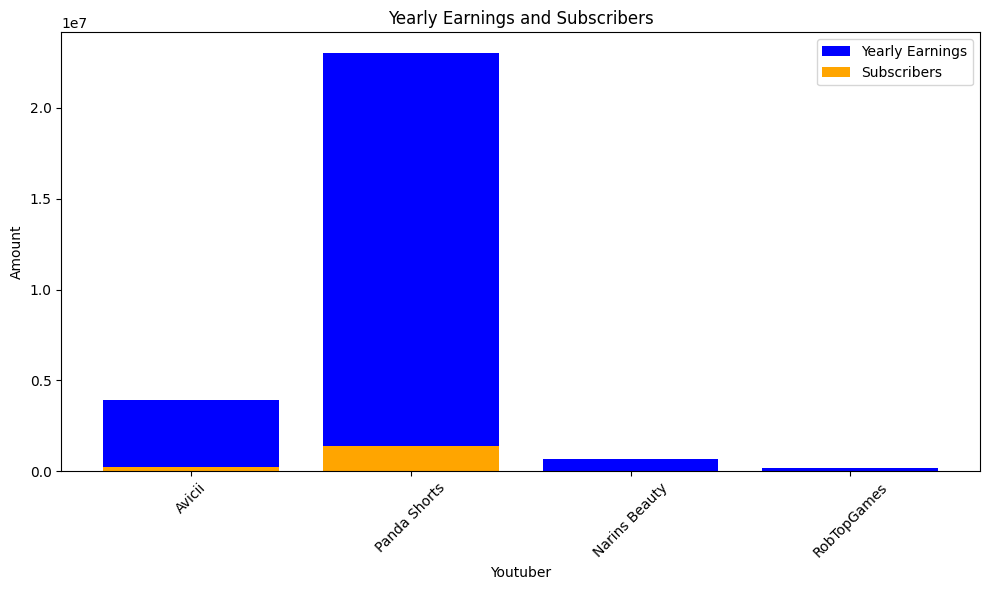

 21%|██▏       | 462/2160 [04:16<17:10,  1.65it/s]check
highest_yearly_earnings: 12700000.0, Subscribers: 792300.0, Youtuber: Mikecrack
highest_yearly_earnings: 1900000.0, Subscribers: 117300.0, Youtuber: VEGETTA777
highest_yearly_earnings: 582900.0, Subscribers: 36400.0, Youtuber: AuronPlay
highest_yearly_earnings: 5.0, Subscribers: 0.31, Youtuber: CKN
highest_yearly_earnings: 528200.0, Subscribers: 33000.0, Youtuber: TheWillyrex
highest_yearly_earnings: 2100000.0, Subscribers: 131500.0, Youtuber: TheGrefg
highest_yearly_earnings: 739500.0, Subscribers: 46200.0, Youtuber: Willyrex
highest_yearly_earnings: 3100.0, Subscribers: 196.0, Youtuber: IDEAS EN 5 MINUTOS
highest_yearly_earnings: 0.19, Subscribers: 0.01, Youtuber: AdMe
highest_yearly_earnings: 4100000.0, Subscribers: 254600.0, Youtuber: FC Barcelona
highest_yearly_earnings: 286600.0, Subscribers: 17900.0, Youtuber: Makiman131
highest_yearly_earnings: 665200.0, Subscribers: 41600.0, Youtuber: iTownGamePlay *Terror&Diversiï¿½ï
hig

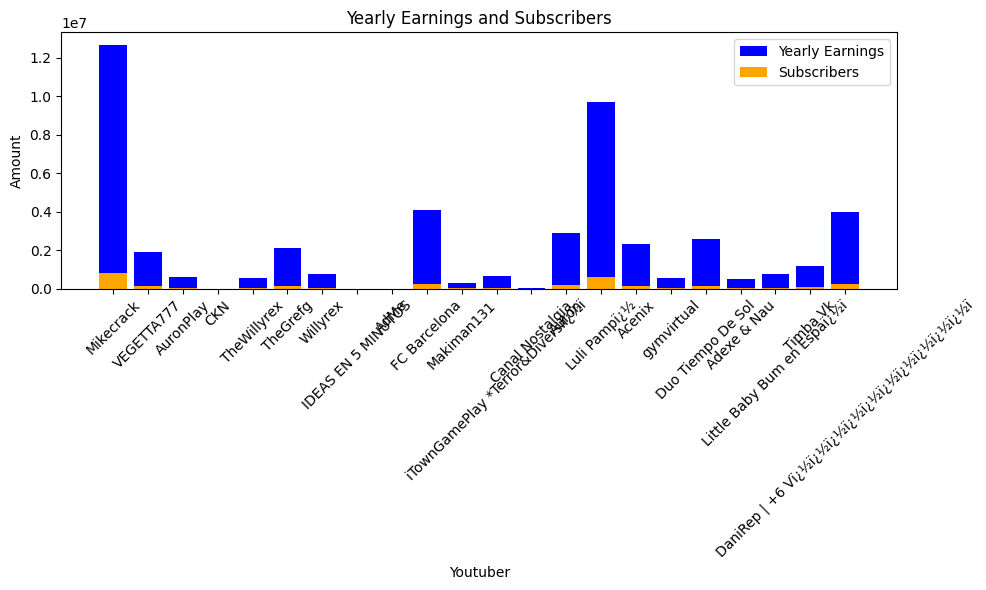

 22%|██▏       | 465/2160 [04:18<17:33,  1.61it/s]check
highest_yearly_earnings: 163400000.0, Subscribers: 10200000.0, Youtuber: ýýýýýýýýý KIMPRO
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Jane ASMR ï¿½ï¿½
highest_yearly_earnings: 238100.0, Subscribers: 14900.0, Youtuber: Boram Tube ToysReview [ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿
highest_yearly_earnings: 5400000.0, Subscribers: 339400.0, Youtuber: ýýýýýýýýýSULGI


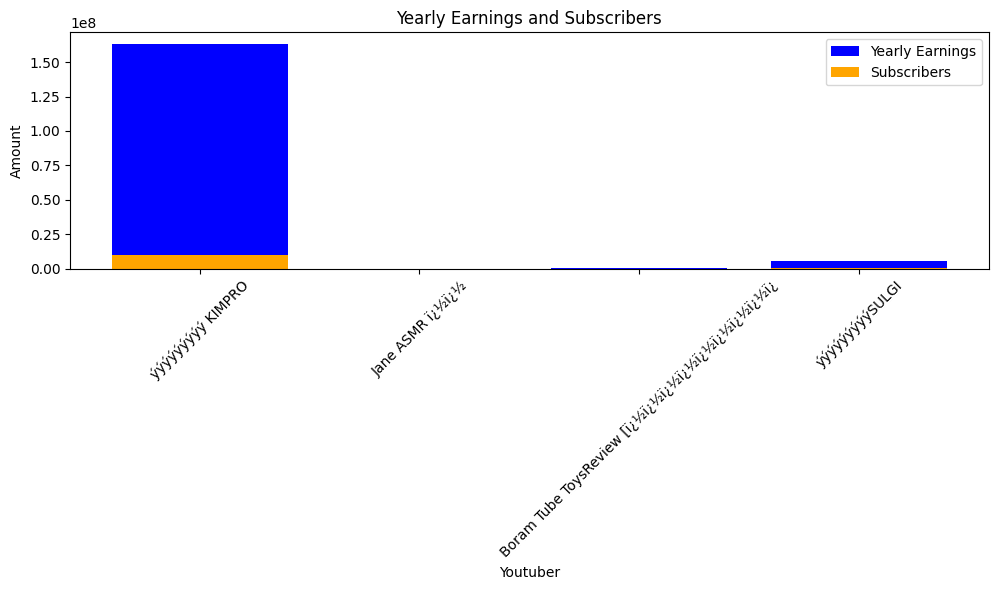

 22%|██▏       | 468/2160 [04:20<13:59,  2.02it/s]check
highest_yearly_earnings: 45100.0, Subscribers: 2800.0, Youtuber: MY FAMILY


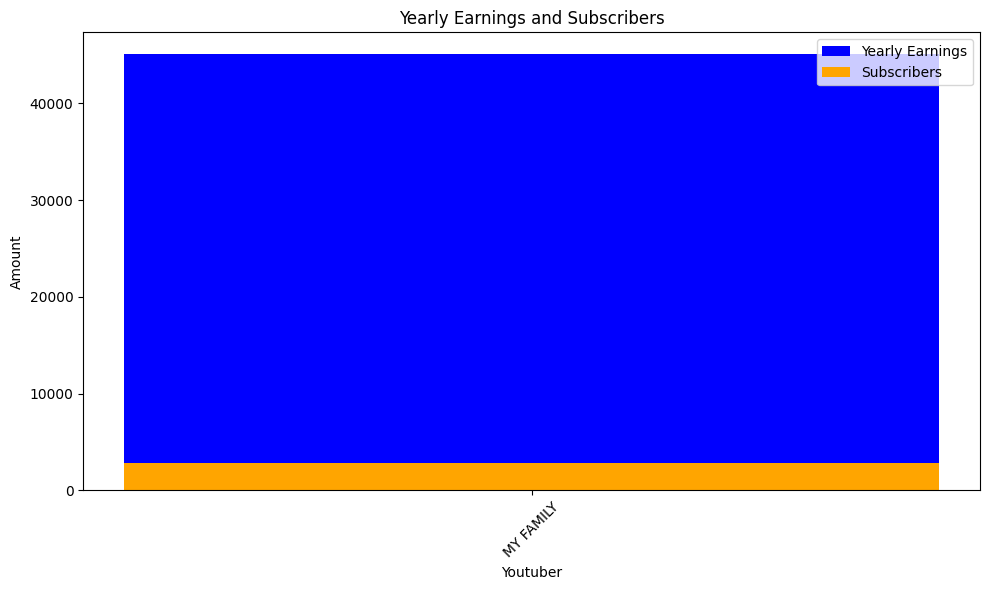

 22%|██▏       | 471/2160 [04:21<12:04,  2.33it/s]check
highest_yearly_earnings: 76300.0, Subscribers: 4800.0, Youtuber: shfa
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: 1MILLION Dance Studio
highest_yearly_earnings: 3500000.0, Subscribers: 221500.0, Youtuber: mmoshaya
highest_yearly_earnings: 2100000.0, Subscribers: 129000.0, Youtuber: ýýýýýýýý ýýýýýýýýýý ýýýýýýýýýý | Arab Games Network
highest_yearly_earnings: 4400000.0, Subscribers: 272700.0, Youtuber: Katakit Baby TV
highest_yearly_earnings: 6500000.0, Subscribers: 405100.0, Youtuber: ýýýýýýýý ýý ýýýýýýýý
highest_yearly_earnings: 129300.0, Subscribers: 8100.0, Youtuber: ýýýýýýýýýý ýýýýýýýýýýýý
highest_yearly_earnings: 224300.0, Subscribers: 14000.0, Youtuber: ýýýýýýýýýýýý ýýýýýýýýýýýý I ýýýýýý ýý ýýýýýýýýýý
highest_yearly_earnings: 3400000.0, Subscribers: 212100.0, Youtuber: BanderitaX


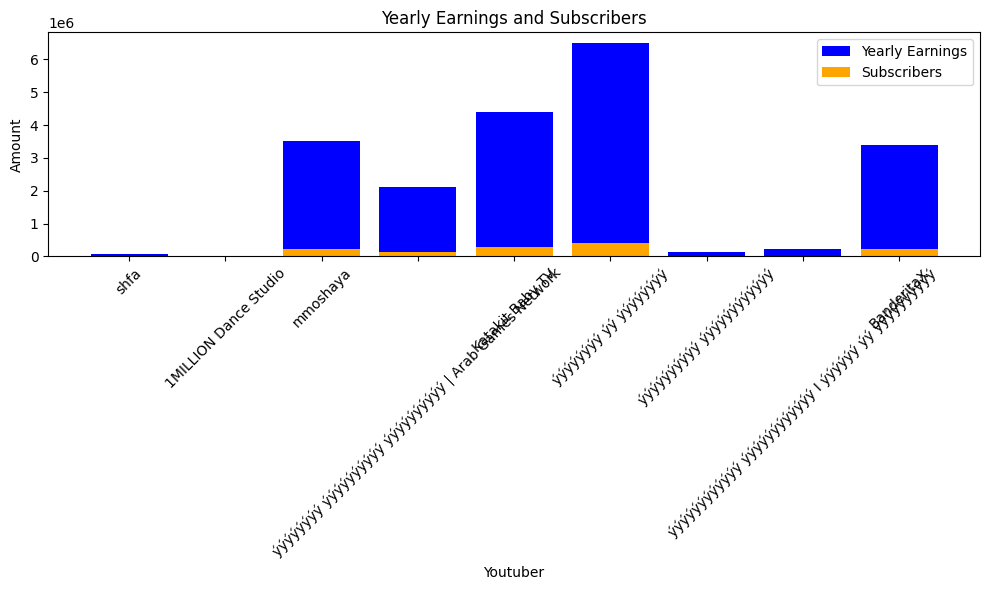

 22%|██▏       | 474/2160 [04:23<11:36,  2.42it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


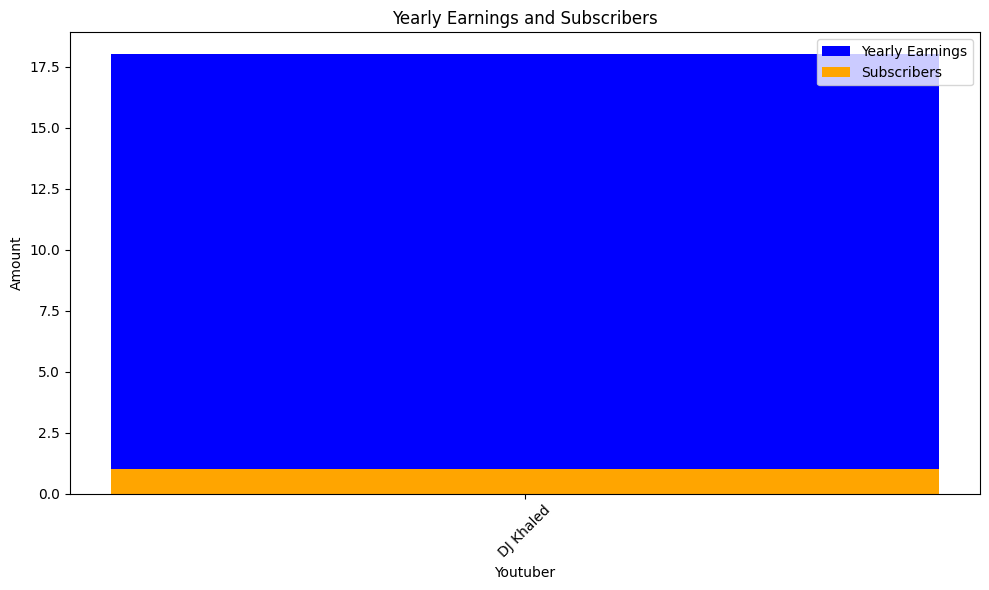

 22%|██▏       | 477/2160 [04:24<10:47,  2.60it/s]check
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya
highest_yearly_earnings: 26500000.0, Subscribers: 1700000.0, Youtuber: tuzelity SHUFFLE
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya Vlog
highest_yearly_earnings: 22800000.0, Subscribers: 1400000.0, Youtuber: ILYA BORZOV


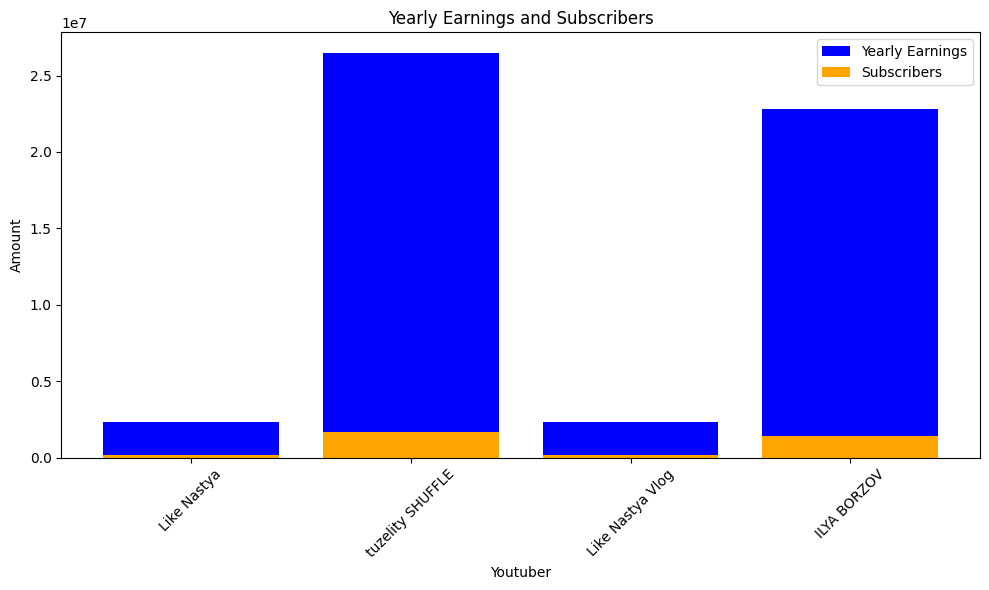

 22%|██▏       | 480/2160 [04:25<10:32,  2.66it/s]check
highest_yearly_earnings: 723800.0, Subscribers: 45200.0, Youtuber: Ivana Alawi
highest_yearly_earnings: 580200.0, Subscribers: 36300.0, Youtuber: Zeinab Harake
highest_yearly_earnings: 520700.0, Subscribers: 32500.0, Youtuber: Alex Gonzaga Official


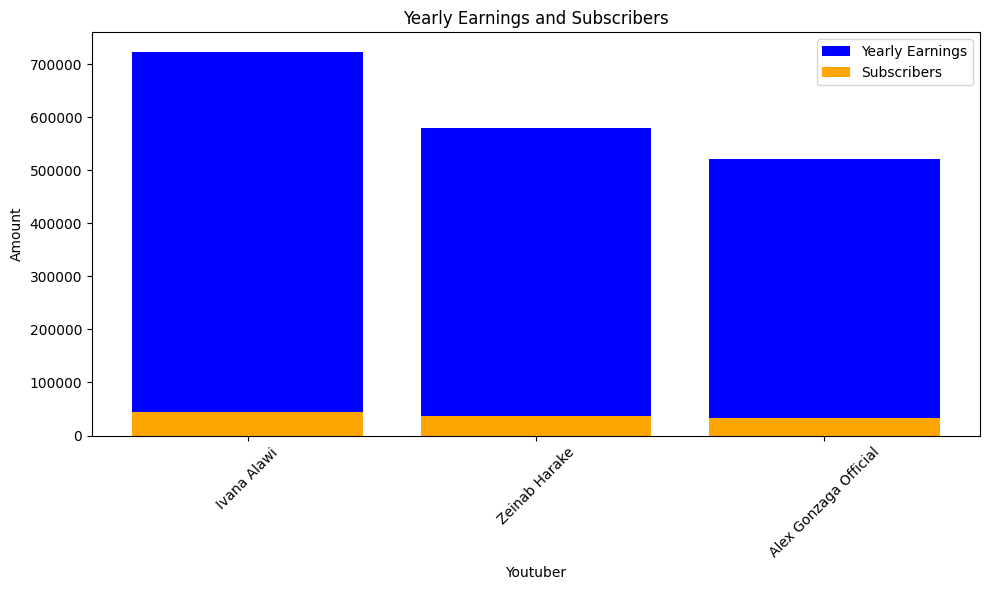

 22%|██▏       | 483/2160 [04:27<10:22,  2.70it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


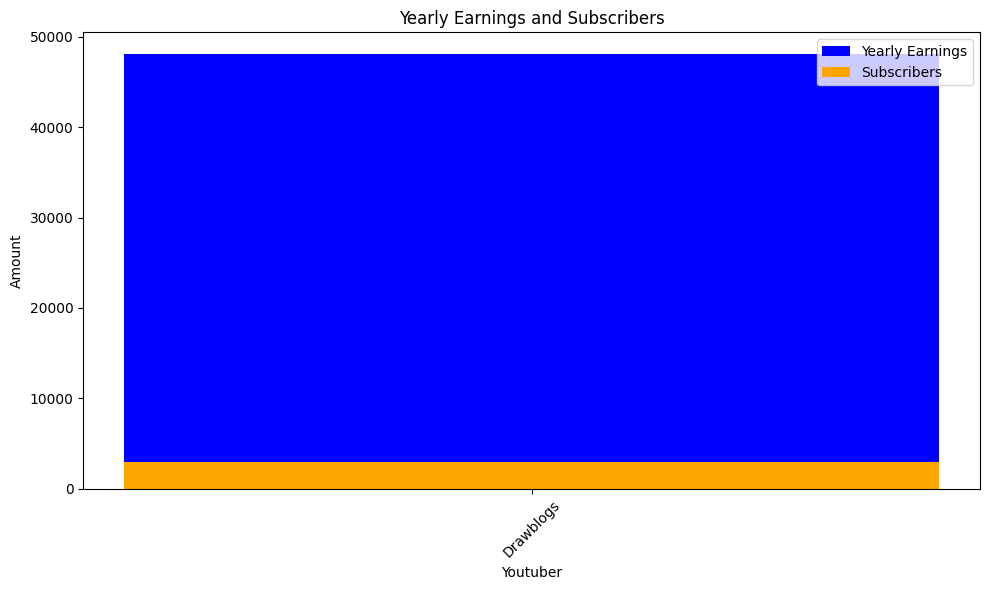

 22%|██▎       | 486/2160 [04:28<10:15,  2.72it/s]check
highest_yearly_earnings: 28.0, Subscribers: 2.0, Youtuber: Wolfoo Channel


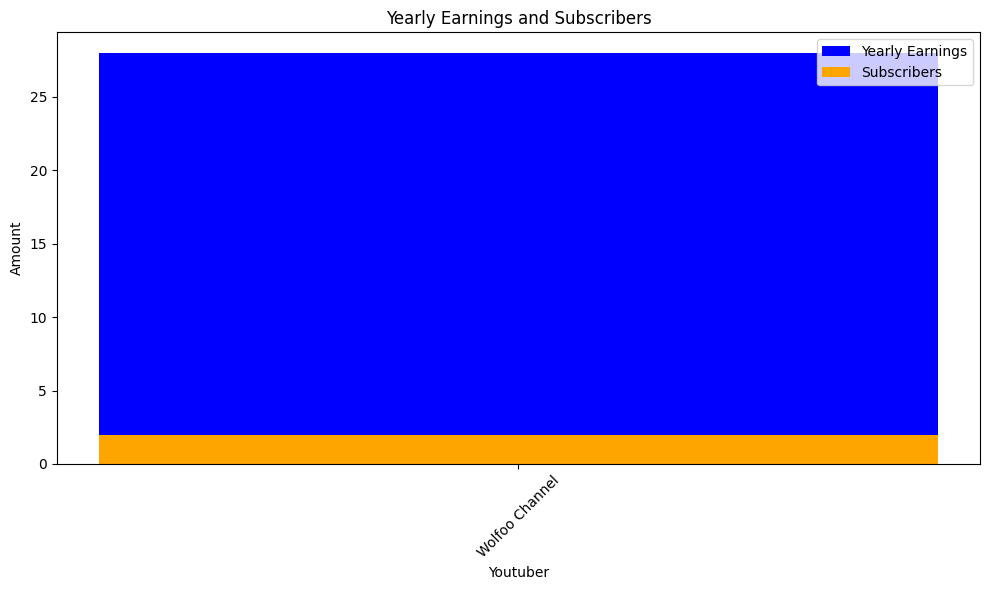

 23%|██▎       | 489/2160 [04:29<10:33,  2.64it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300100.0, Youtuber: Spinnin' Records
highest_yearly_earnings: 1700000.0, Subscribers: 107800.0, Youtuber: NikkieTutorials
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: ýýýýýýýý/Atro


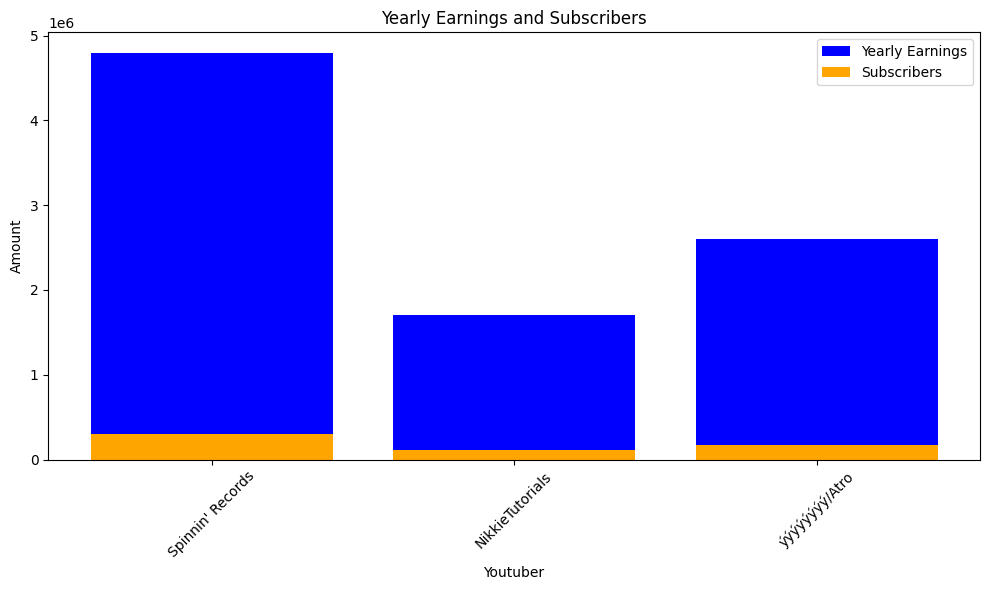

 23%|██▎       | 492/2160 [04:31<12:35,  2.21it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


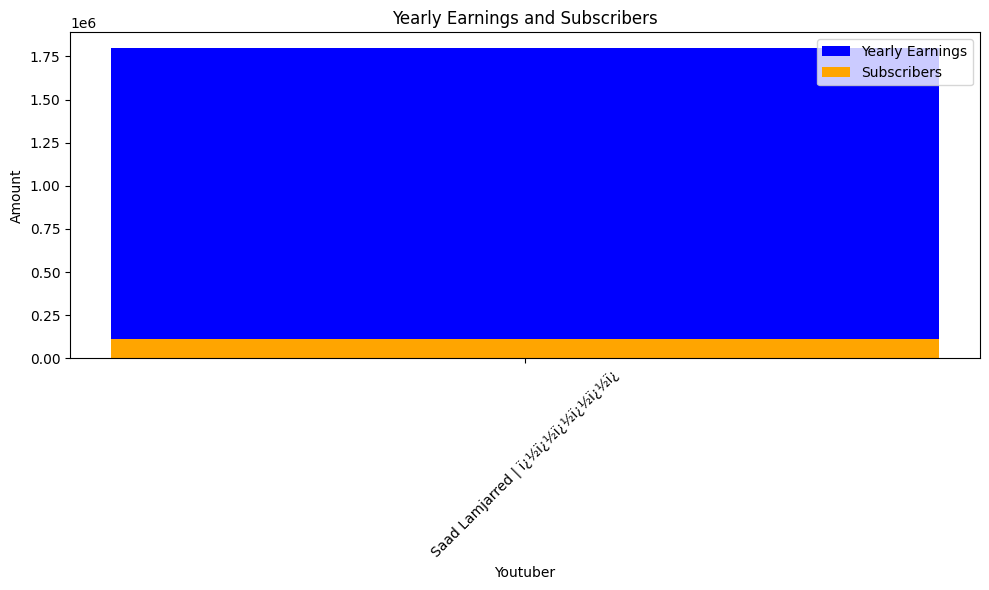

 23%|██▎       | 495/2160 [04:34<17:13,  1.61it/s]check
highest_yearly_earnings: 6600000.0, Subscribers: 410200.0, Youtuber: Kimberly Loaiza
highest_yearly_earnings: 1500000.0, Subscribers: 91500.0, Youtuber: LosPolinesios
highest_yearly_earnings: 2200000.0, Subscribers: 140600.0, Youtuber: Juan De Dios Pantoja
highest_yearly_earnings: 114300.0, Subscribers: 7100.0, Youtuber: JukiLop
highest_yearly_earnings: 774700.0, Subscribers: 48400.0, Youtuber: Tu COSMOPOLIS
highest_yearly_earnings: 493300.0, Subscribers: 30800.0, Youtuber: Gibby :)


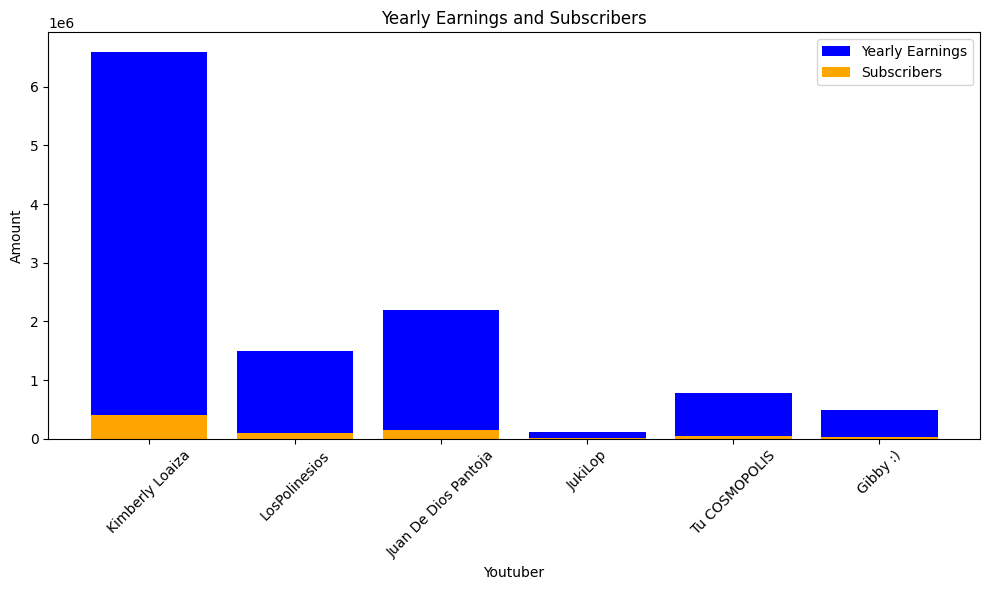

 23%|██▎       | 498/2160 [04:35<13:23,  2.07it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


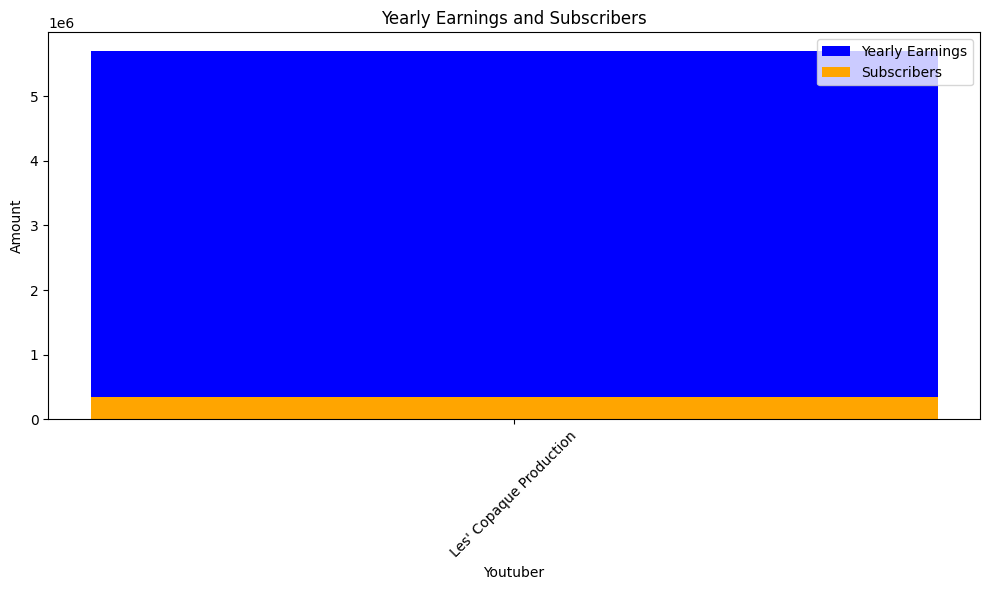

 23%|██▎       | 501/2160 [04:37<11:09,  2.48it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


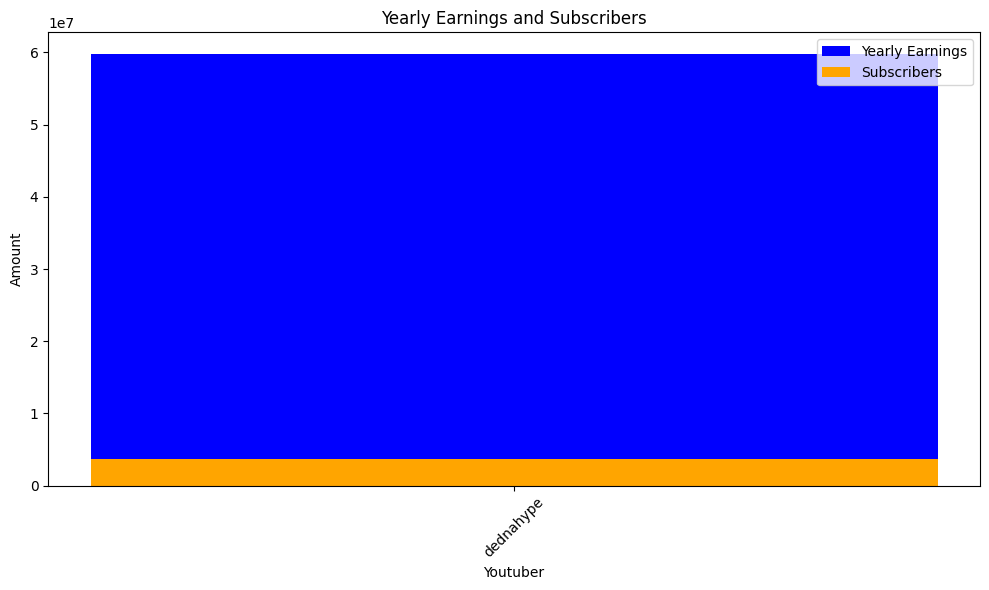

 23%|██▎       | 504/2160 [04:38<10:28,  2.64it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


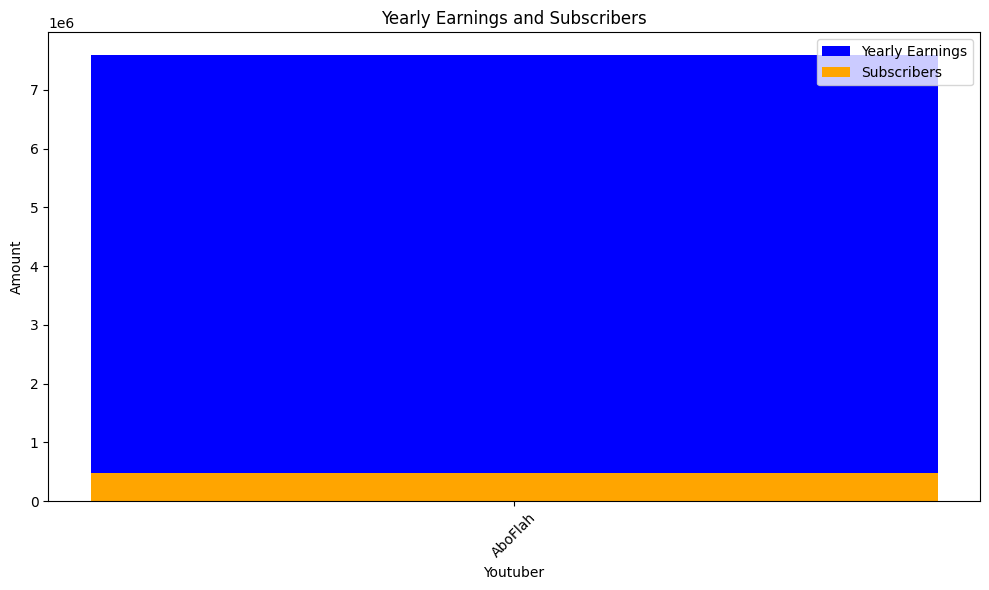

 23%|██▎       | 507/2160 [04:39<10:20,  2.66it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


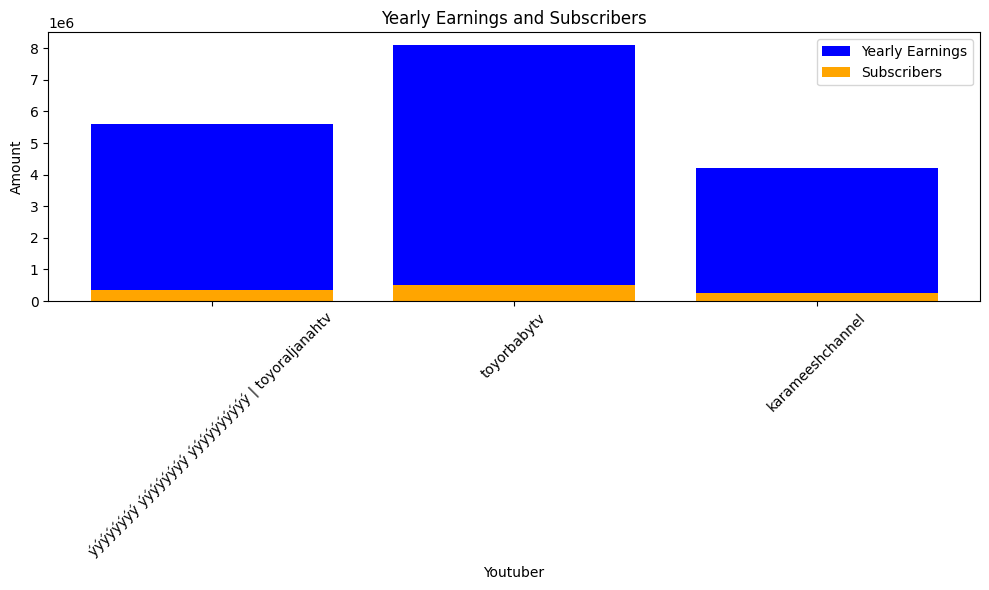

 24%|██▎       | 510/2160 [04:41<10:11,  2.70it/s]check
highest_yearly_earnings: 1900000.0, Subscribers: 117600.0, Youtuber: PewDiePie
highest_yearly_earnings: 34600000.0, Subscribers: 2200000.0, Youtuber: Junya.ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 34100000.0, Subscribers: 2100000.0, Youtuber: Sagawa /ï¿½ï¿½ï¿½
highest_yearly_earnings: 13600000.0, Subscribers: 847100.0, Youtuber: ISSEI / ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 119.0, Subscribers: 7.0, Youtuber: Bayashi TV


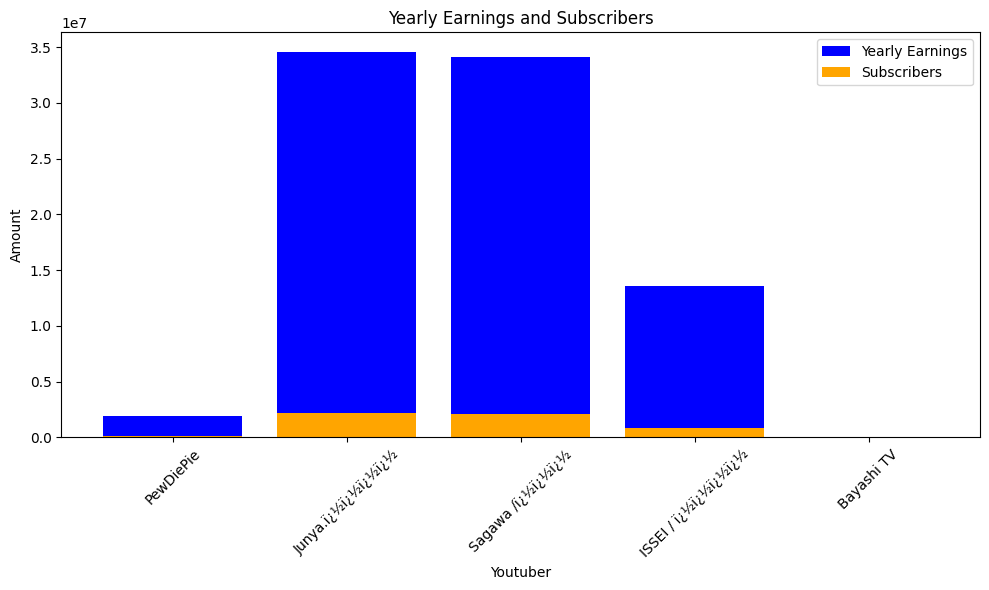

 24%|██▍       | 513/2160 [04:42<10:18,  2.66it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


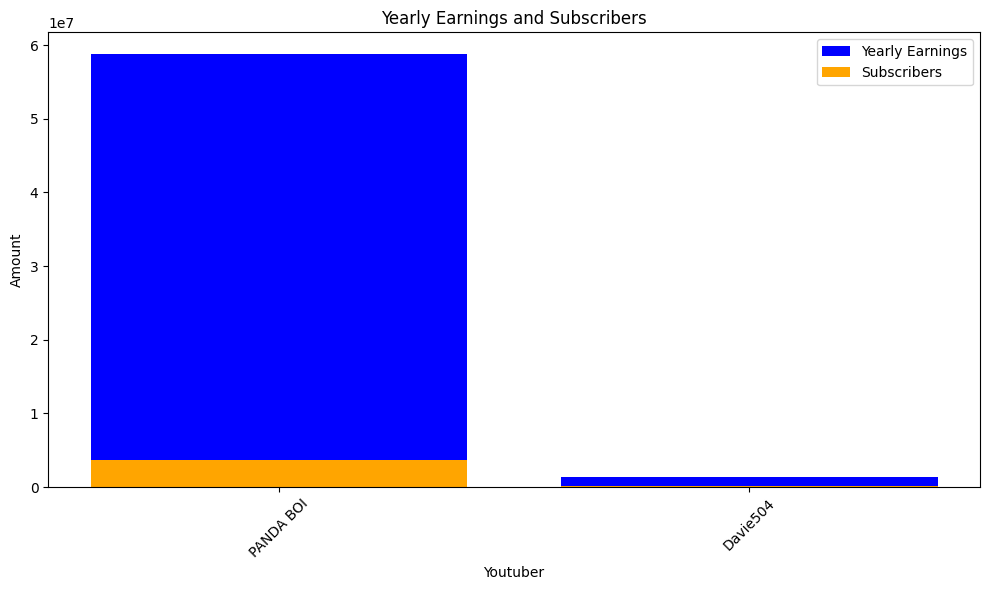

 24%|██▍       | 516/2160 [04:43<10:12,  2.69it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


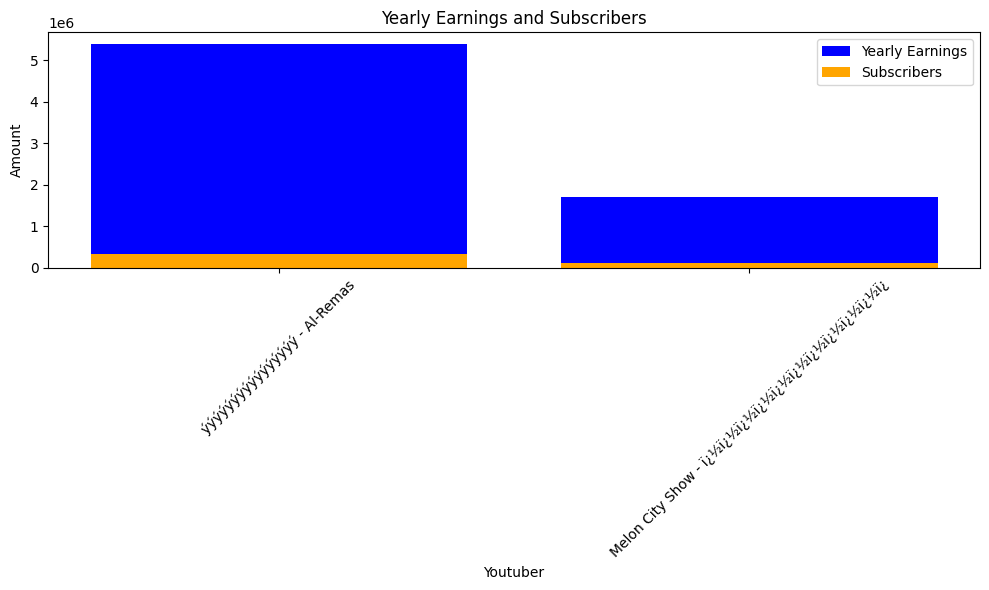

 24%|██▍       | 519/2160 [04:45<10:28,  2.61it/s]check
highest_yearly_earnings: 9500000.0, Subscribers: 592100.0, Youtuber: Willie Salim
highest_yearly_earnings: 12700000.0, Subscribers: 792900.0, Youtuber: Vilmei


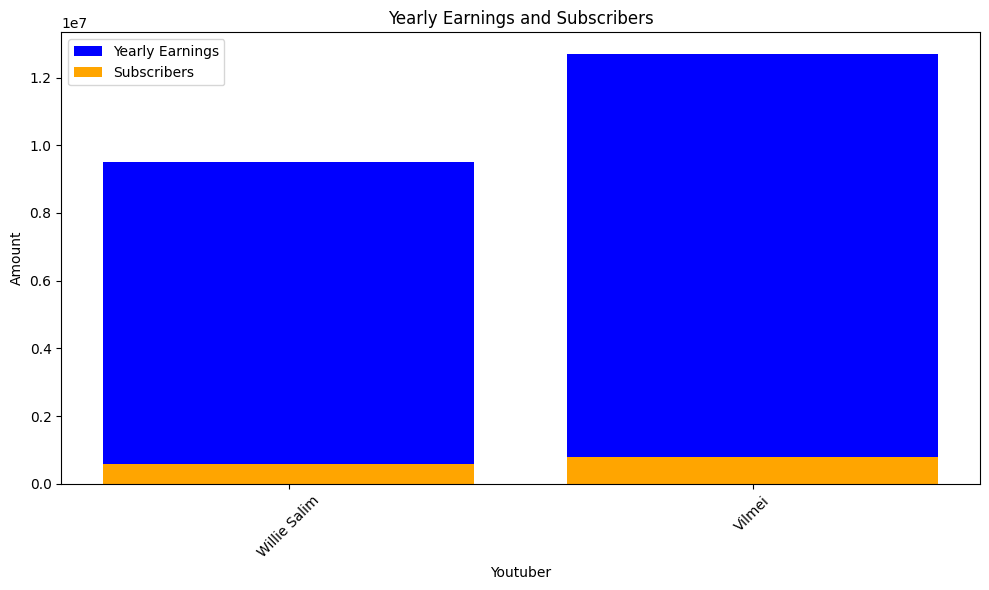

 24%|██▍       | 522/2160 [04:46<11:52,  2.30it/s]check
highest_yearly_earnings: 35000000.0, Subscribers: 2200000.0, Youtuber: Ishaan Ali 11
highest_yearly_earnings: 5200000.0, Subscribers: 327100.0, Youtuber: Triggered Insaan
highest_yearly_earnings: 20700000.0, Subscribers: 1300000.0, Youtuber: Priyal Kukreja
highest_yearly_earnings: 16600000.0, Subscribers: 1000000.0, Youtuber: jaanvi patel
highest_yearly_earnings: 4300000.0, Subscribers: 269300.0, Youtuber: Aayu and Pihu Show
highest_yearly_earnings: 5500000.0, Subscribers: 340700.0, Youtuber: Chetan Monga Vlogs
highest_yearly_earnings: 3400000.0, Subscribers: 211200.0, Youtuber: Indore Physical Academy
highest_yearly_earnings: 50100.0, Subscribers: 3100.0, Youtuber: The World Adventures ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 66900.0, Subscribers: 4200.0, Youtuber: Health Time
highest_yearly_earnings: 1800000.0, Subscribers: 114500.0, Youtuber: Pari's Lifestyle


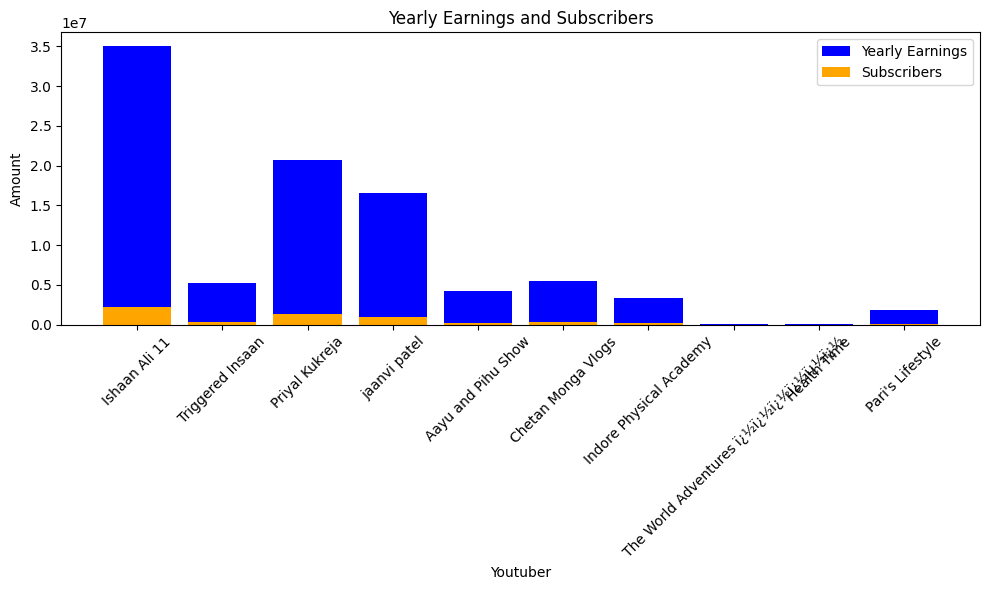

 24%|██▍       | 525/2160 [04:48<13:30,  2.02it/s]check
highest_yearly_earnings: 36300000.0, Subscribers: 2300000.0, Youtuber: Tsuriki Show
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: YOLO
highest_yearly_earnings: 1400000.0, Subscribers: 87800.0, Youtuber: Kurzgesagt ï¿½ï¿½ï¿½ï¿½ï¿½ï¿
highest_yearly_earnings: 271200.0, Subscribers: 17000.0, Youtuber: HaerteTest
highest_yearly_earnings: 29600000.0, Subscribers: 1900000.0, Youtuber: Younes Zarou
highest_yearly_earnings: 1800.0, Subscribers: 114.0, Youtuber: Beast Philanthropy


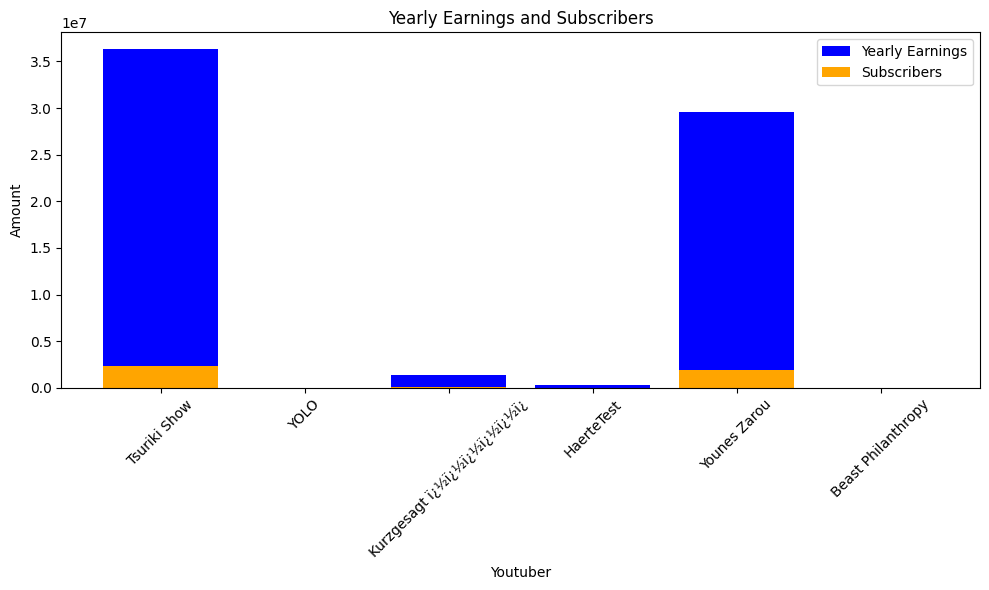

 24%|██▍       | 528/2160 [04:50<14:21,  1.89it/s]check
highest_yearly_earnings: 35.0, Subscribers: 2.0, Youtuber: Smile Family
highest_yearly_earnings: 2300000.0, Subscribers: 144300.0, Youtuber: SQUEEZIE
highest_yearly_earnings: 37.0, Subscribers: 2.0, Youtuber: FitDance
highest_yearly_earnings: 548000.0, Subscribers: 34300.0, Youtuber: Cyprien
highest_yearly_earnings: 1500000.0, Subscribers: 91400.0, Youtuber: Lofi Girl


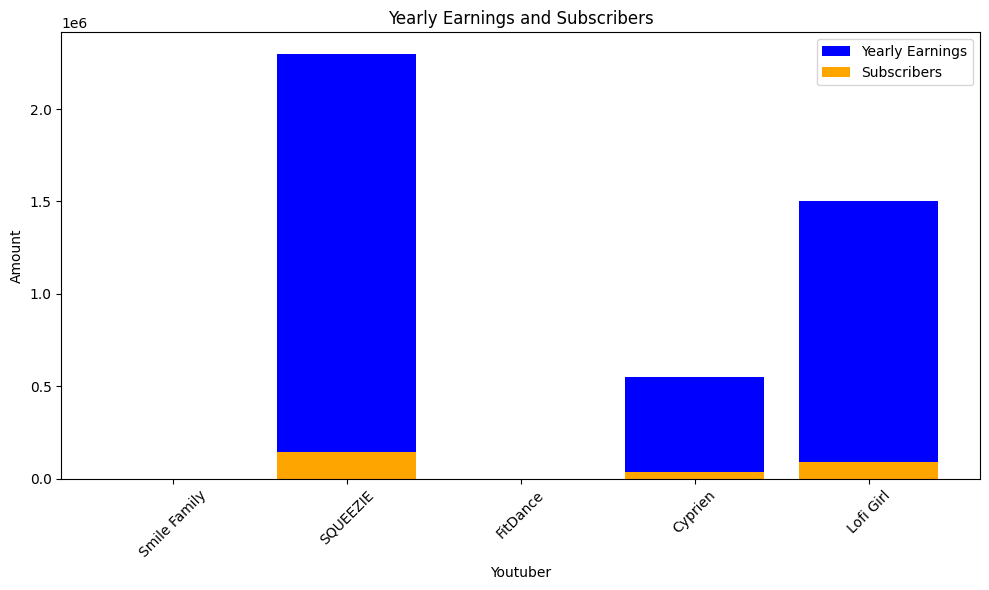

 25%|██▍       | 531/2160 [04:52<12:06,  2.24it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


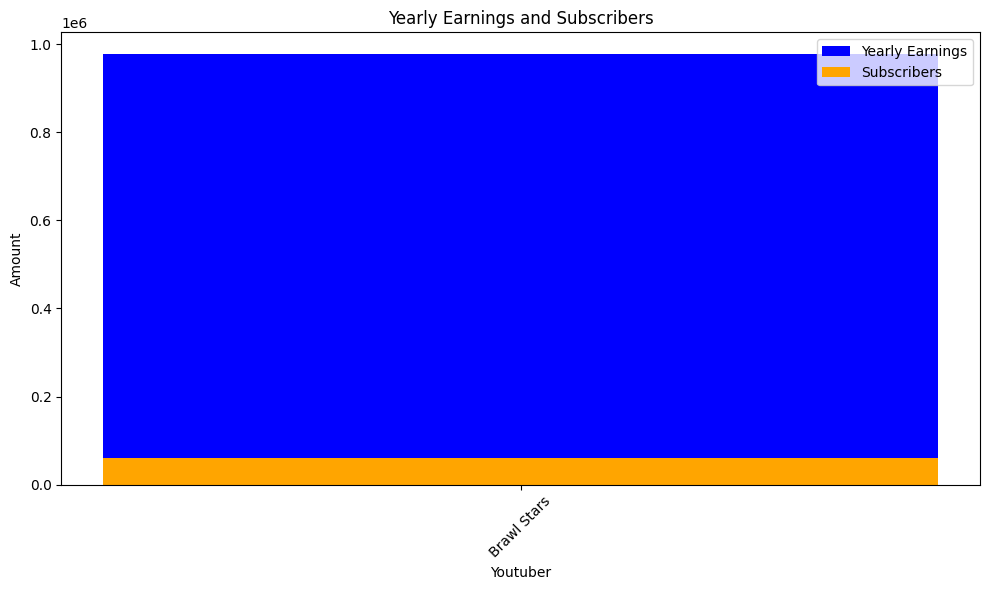

 25%|██▍       | 534/2160 [04:53<10:28,  2.59it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


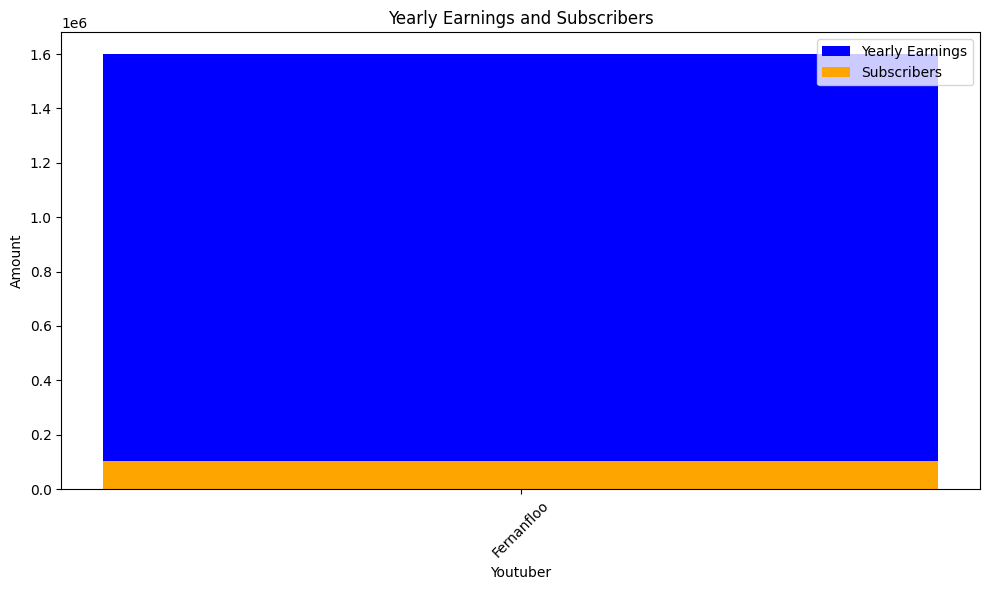

 25%|██▍       | 537/2160 [04:54<10:06,  2.68it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


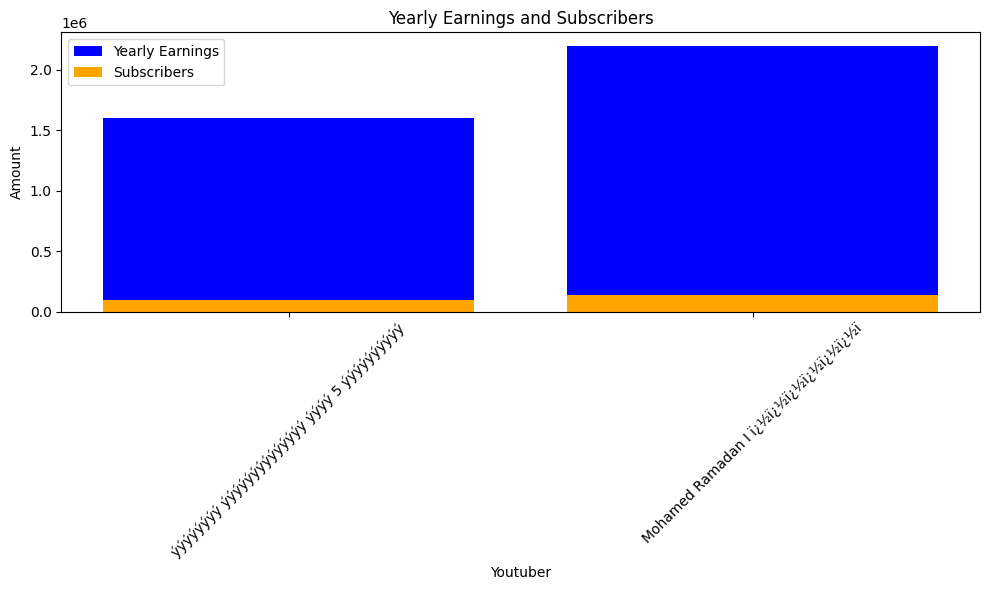

 25%|██▌       | 540/2160 [04:56<09:56,  2.72it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


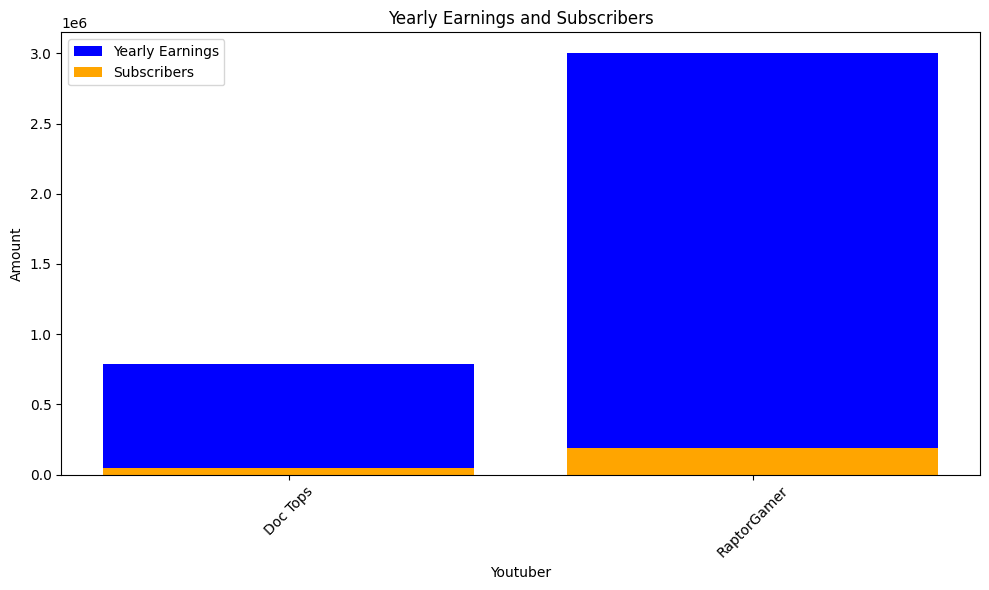

 25%|██▌       | 543/2160 [04:57<10:06,  2.67it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


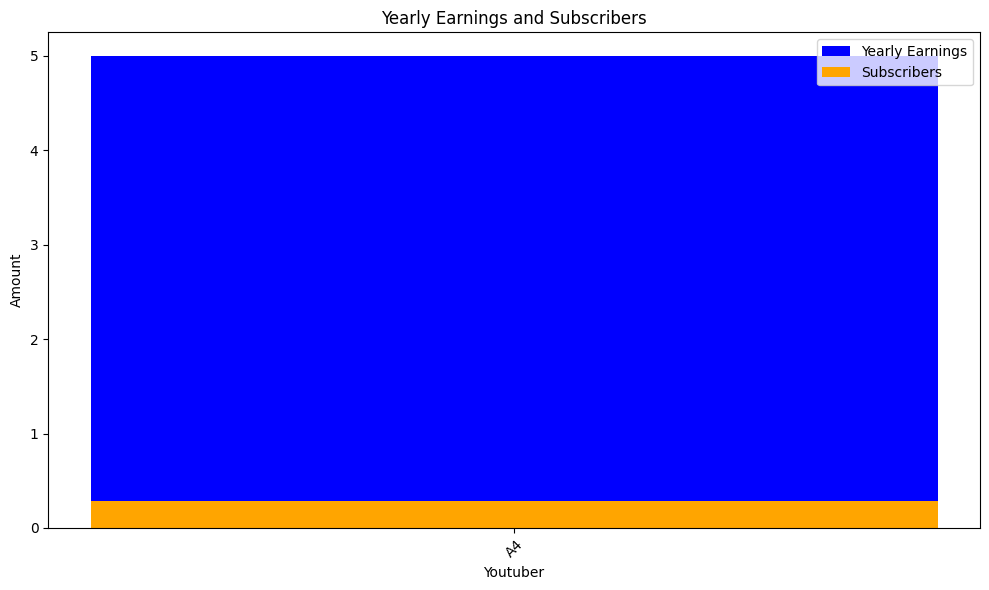

 25%|██▌       | 546/2160 [04:58<10:03,  2.67it/s]check
highest_yearly_earnings: 15700000.0, Subscribers: 982800.0, Youtuber: Go Ami Go!


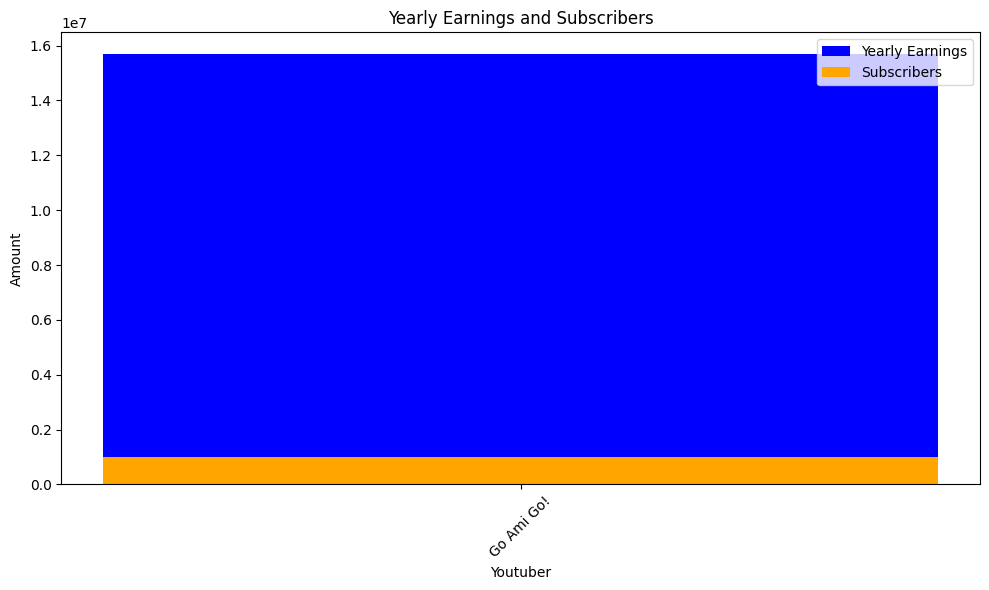

 25%|██▌       | 549/2160 [05:00<09:57,  2.70it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


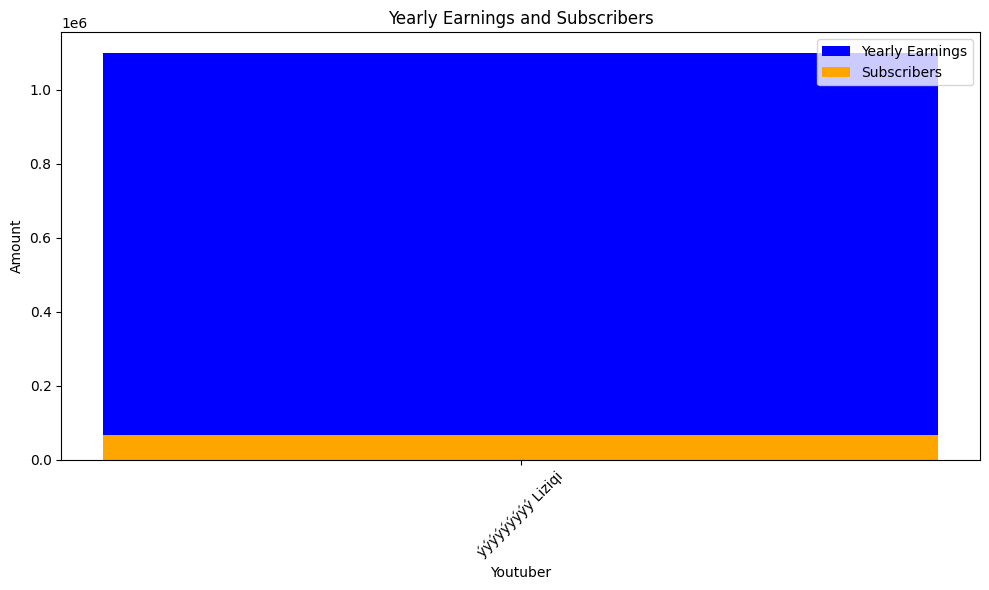

 26%|██▌       | 552/2160 [05:01<09:57,  2.69it/s]check
highest_yearly_earnings: 2.0, Subscribers: 0.15, Youtuber: invictor


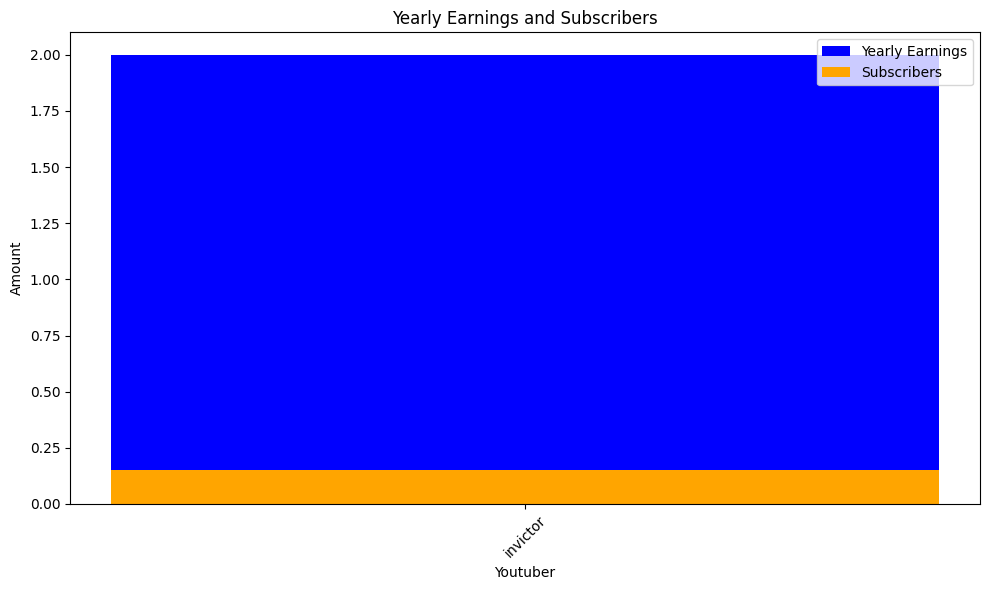

 26%|██▌       | 555/2160 [05:03<12:09,  2.20it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529000.0, Youtuber: Justin Bieber
highest_yearly_earnings: 26900000.0, Subscribers: 1700000.0, Youtuber: Super Simple Songs - Kids Songs
highest_yearly_earnings: 17900000.0, Subscribers: 1100000.0, Youtuber: The Weeknd
highest_yearly_earnings: 4300000.0, Subscribers: 266200.0, Youtuber: Shawn Mendes
highest_yearly_earnings: 2600000.0, Subscribers: 164800.0, Youtuber: VanossGaming
highest_yearly_earnings: 2400000.0, Subscribers: 147000.0, Youtuber: WatchMojo.com
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: FaZe Rug
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Pentatonix
highest_yearly_earnings: 4200000.0, Subscribers: 264700.0, Youtuber: Linus Tech Tips
highest_yearly_earnings: 255800.0, Subscribers: 16000.0, Youtuber: Lilly Singh
highest_yearly_earnings: 4000000.0, Subscribers: 251800.0, Youtuber: Hacksmith Industries
highest_yearly_earnings: 1600000.0, Sub

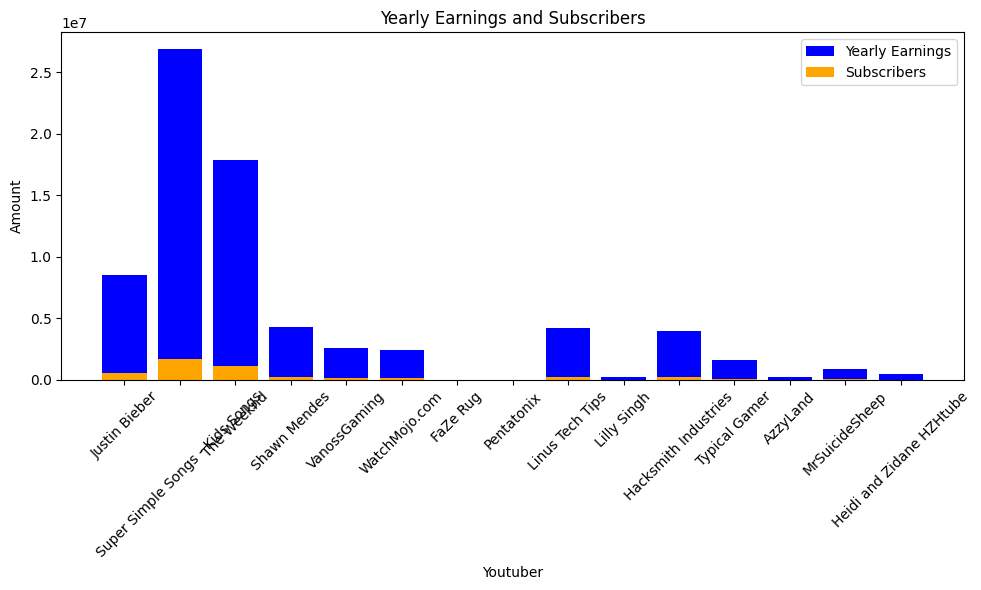

 26%|██▌       | 558/2160 [05:05<14:25,  1.85it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 99000.0, Youtuber: T3ddy
highest_yearly_earnings: 490100.0, Subscribers: 30600.0, Youtuber: AM3NlC
highest_yearly_earnings: 3300000.0, Subscribers: 204200.0, Youtuber: Crescendo com Luluca
highest_yearly_earnings: 2100000.0, Subscribers: 132000.0, Youtuber: Painzeiro
highest_yearly_earnings: 1500000.0, Subscribers: 95400.0, Youtuber: Pastor Antï¿½ï¿½ï¿½ï¿½ï


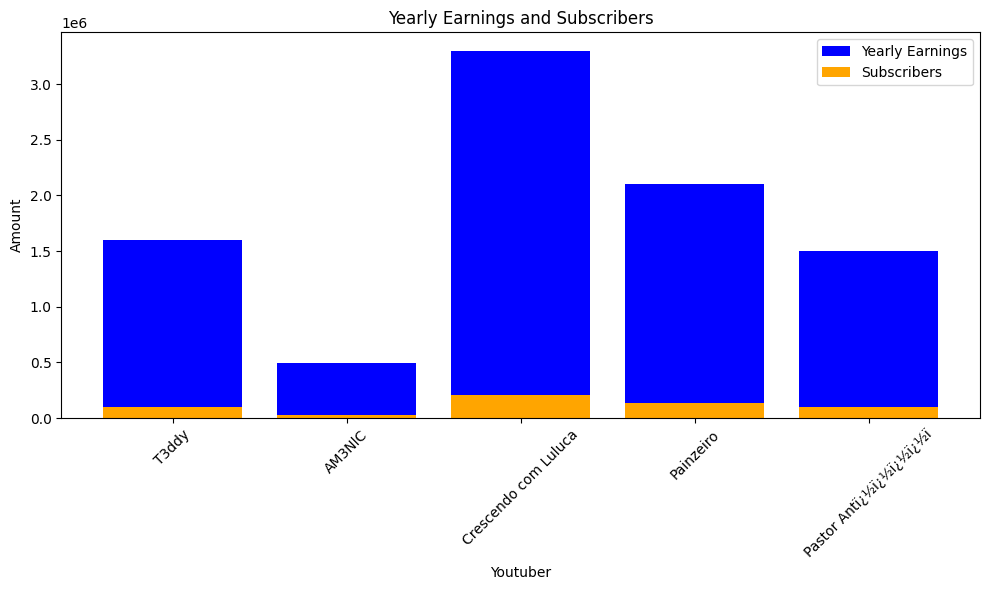

 26%|██▌       | 561/2160 [05:07<16:04,  1.66it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


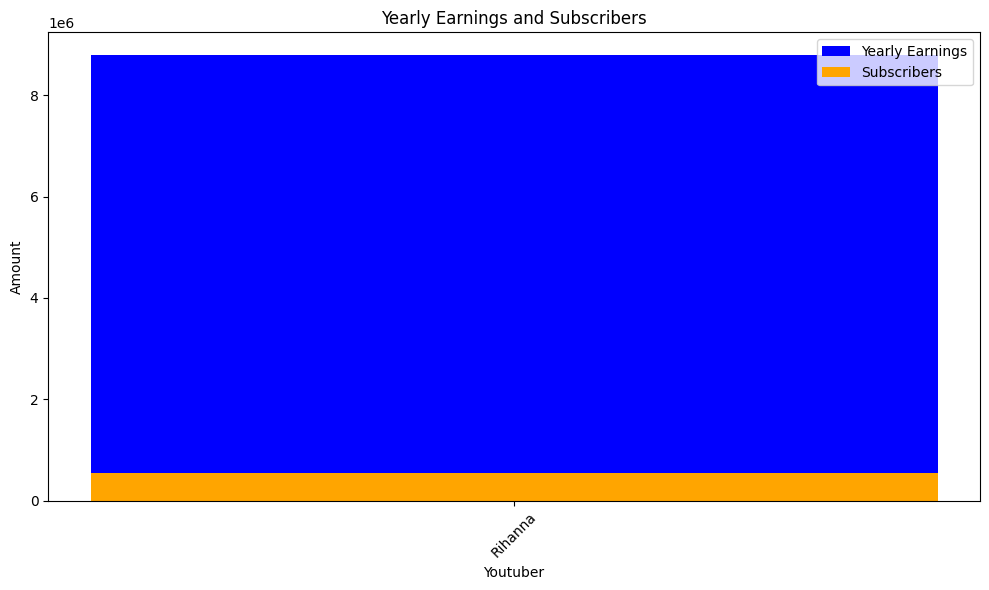

 26%|██▌       | 564/2160 [05:09<11:51,  2.24it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


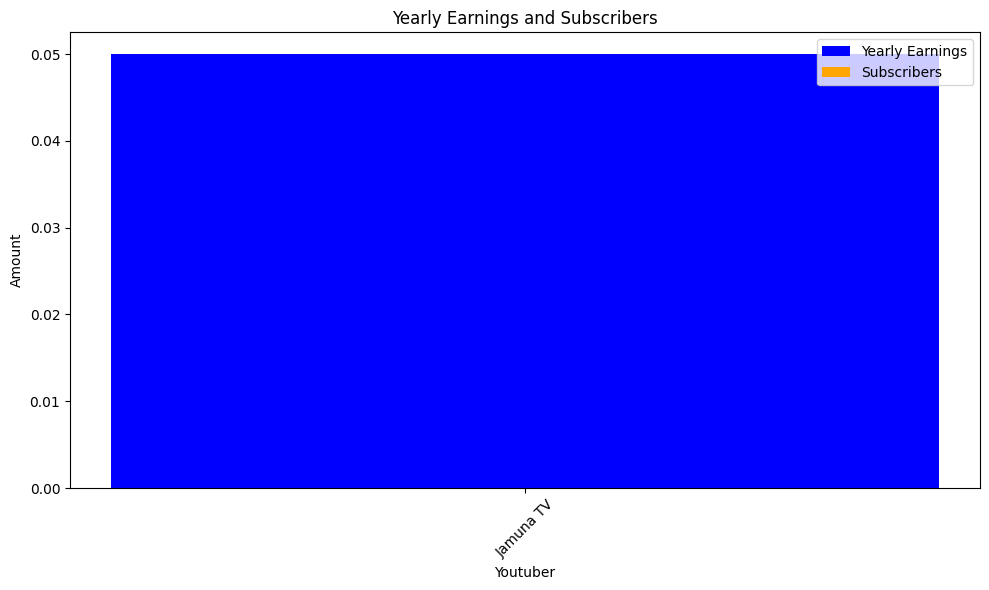

 26%|██▋       | 567/2160 [05:10<10:37,  2.50it/s]check
highest_yearly_earnings: 1.0, Subscribers: 0.08, Youtuber: Jason Vlogs
highest_yearly_earnings: 7.0, Subscribers: 0.44, Youtuber: Trap City


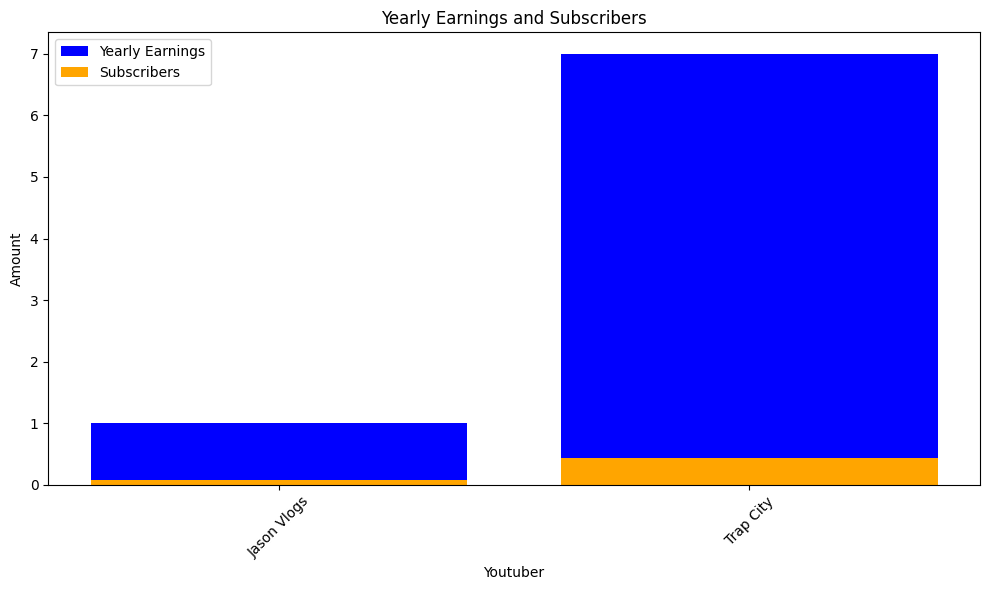

 26%|██▋       | 570/2160 [05:11<10:10,  2.60it/s]check
highest_yearly_earnings: 0.72, Subscribers: 0.05, Youtuber: Maluma


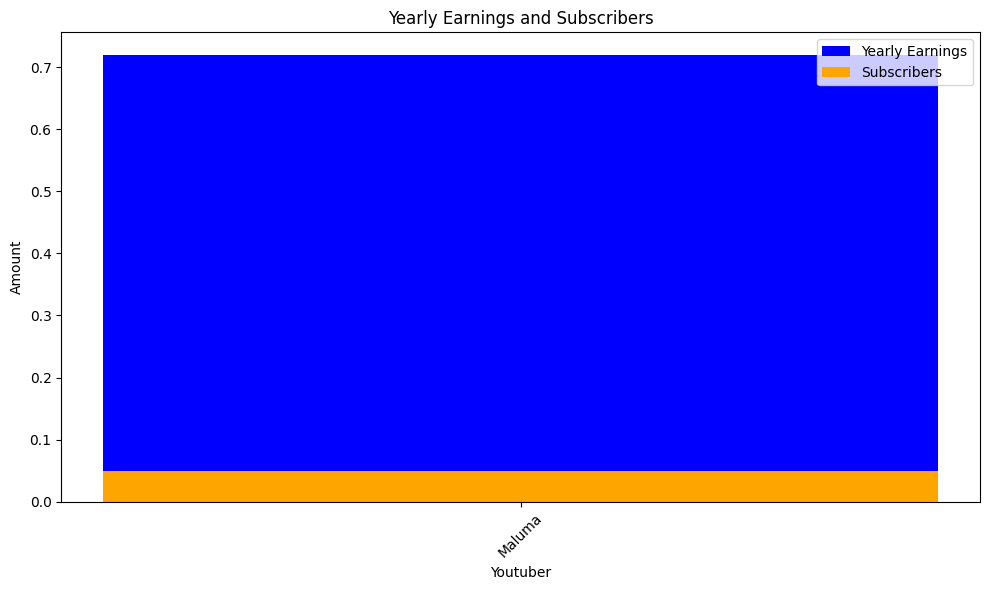

 27%|██▋       | 573/2160 [05:12<09:37,  2.75it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


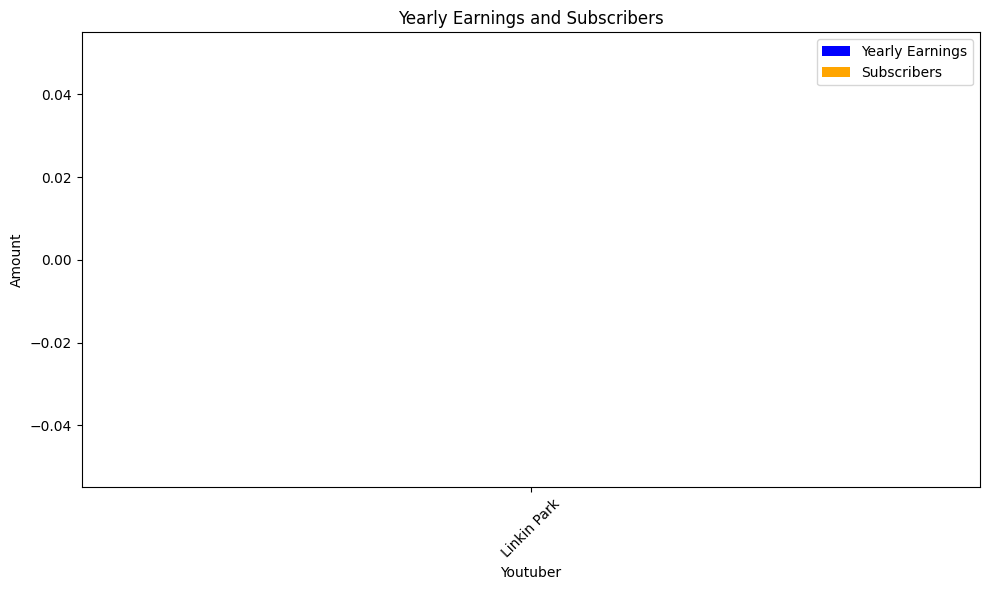

 27%|██▋       | 576/2160 [05:14<09:26,  2.80it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


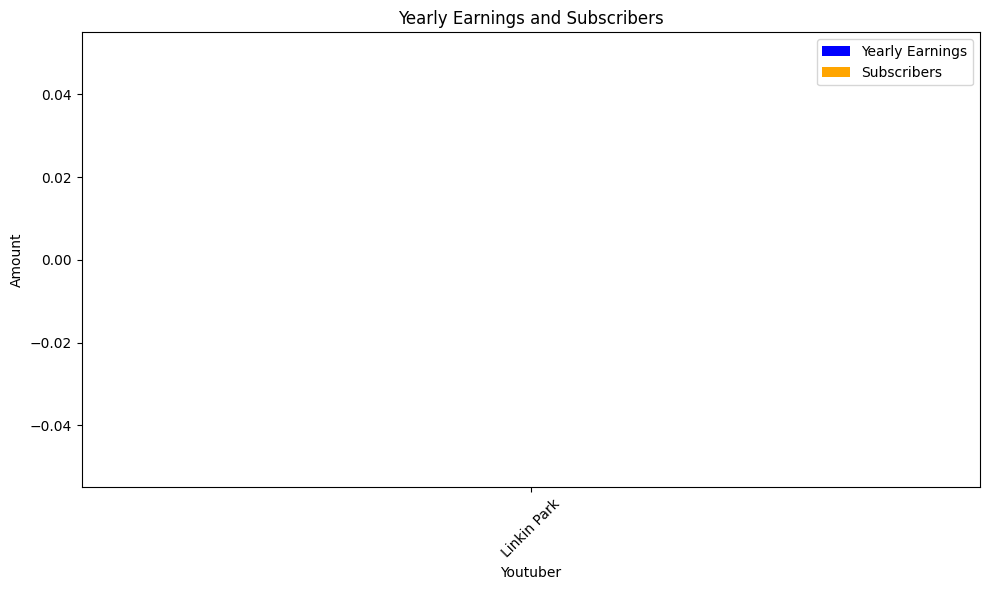

check
highest_yearly_earnings: 4100000.0, Subscribers: 253400.0, Youtuber: Like Nastya VNM
highest_yearly_earnings: 12300000.0, Subscribers: 770200.0, Youtuber: POPS Kids
highest_yearly_earnings: 1700000.0, Subscribers: 105400.0, Youtuber: FAPTV


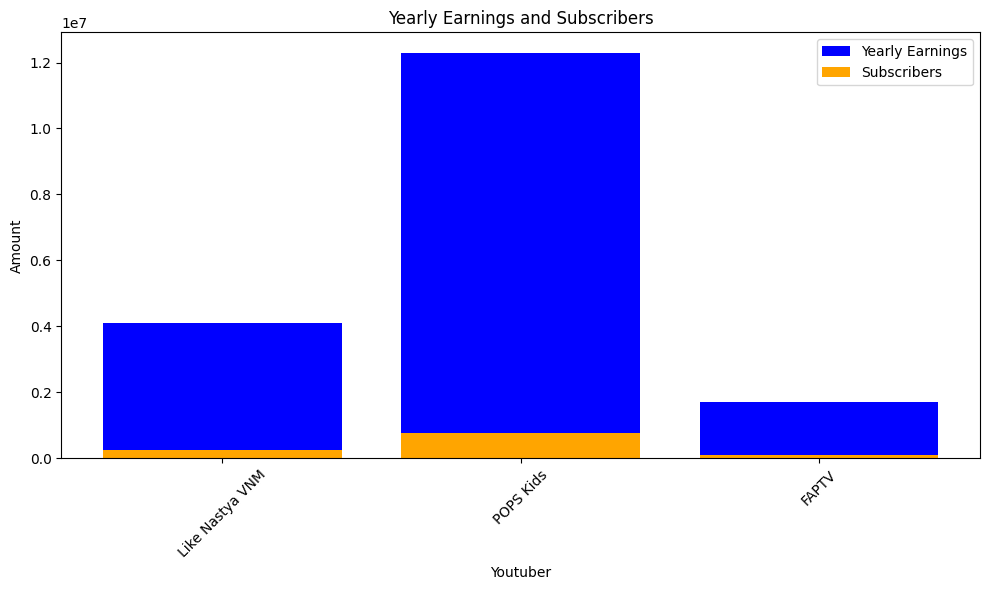

 27%|██▋       | 579/2160 [05:15<11:12,  2.35it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


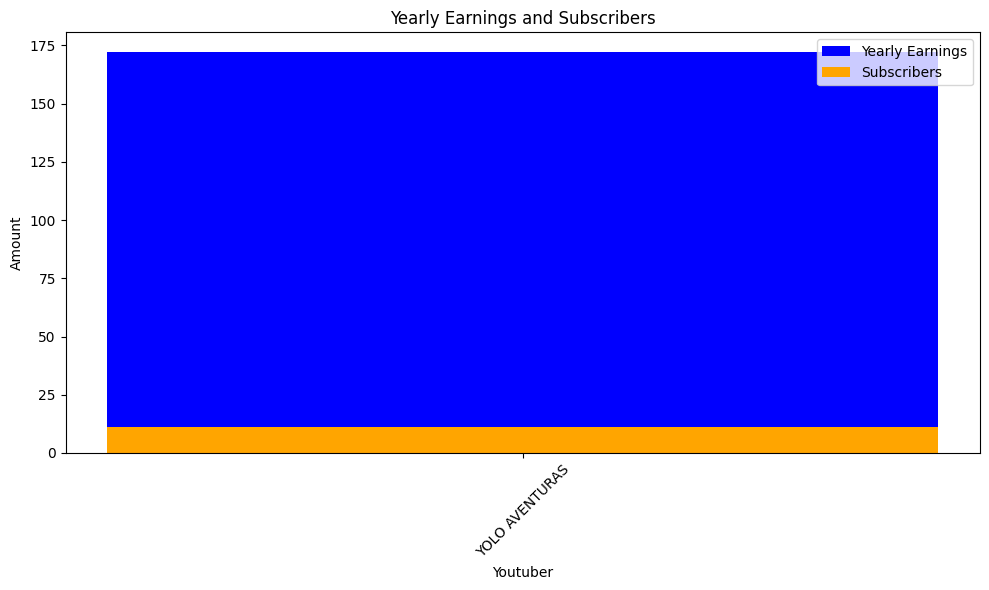

 27%|██▋       | 582/2160 [05:17<11:02,  2.38it/s]check
highest_yearly_earnings: 2200000.0, Subscribers: 136900.0, Youtuber: TEDx Talks


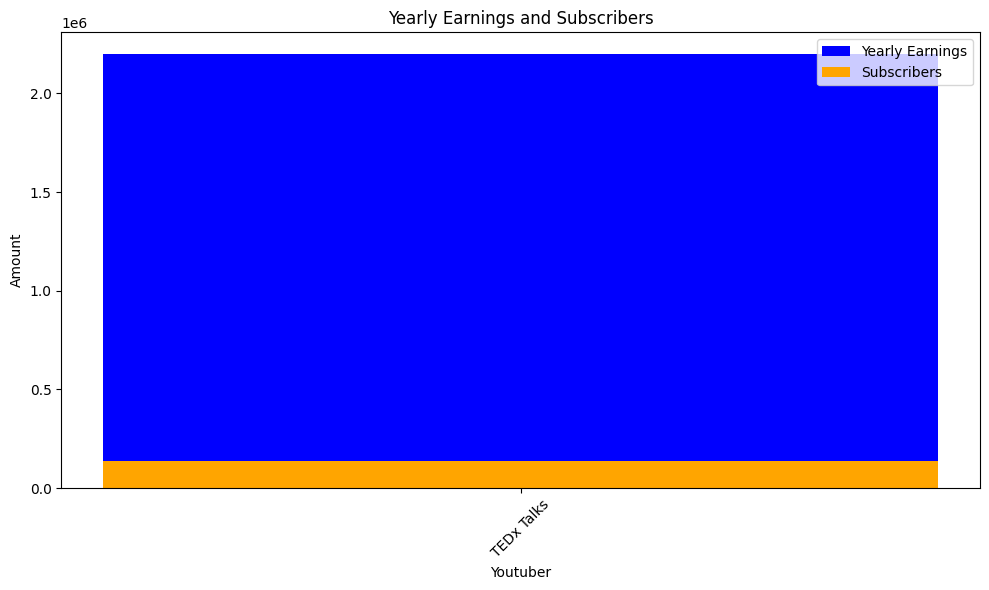

 27%|██▋       | 585/2160 [05:19<12:22,  2.12it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: 5-Minute Crafts
highest_yearly_earnings: 9700000.0, Subscribers: 608200.0, Youtuber: Ed Sheeran
highest_yearly_earnings: 2700000.0, Subscribers: 167000.0, Youtuber: NoCopyrightSounds
highest_yearly_earnings: 2700000.0, Subscribers: 169600.0, Youtuber: Mr Bean
highest_yearly_earnings: 11800000.0, Subscribers: 734800.0, Youtuber: Peppa Pig - Official Channel
highest_yearly_earnings: 6600000.0, Subscribers: 411300.0, Youtuber: Adele
highest_yearly_earnings: 3800000.0, Subscribers: 236000.0, Youtuber: DanTDM
highest_yearly_earnings: 9500000.0, Subscribers: 596600.0, Youtuber: Coldplay
highest_yearly_earnings: 15900000.0, Subscribers: 995700.0, Youtuber: Dan Rhodes
highest_yearly_earnings: 261100.0, Subscribers: 16300.0, Youtuber: KSI
highest_yearly_earnings: 1600000.0, Subscribers: 98400.0, Youtuber: Mister Max
highest_yearly_earnings: 2600000.0, Subscribers: 160800.0, Youtube

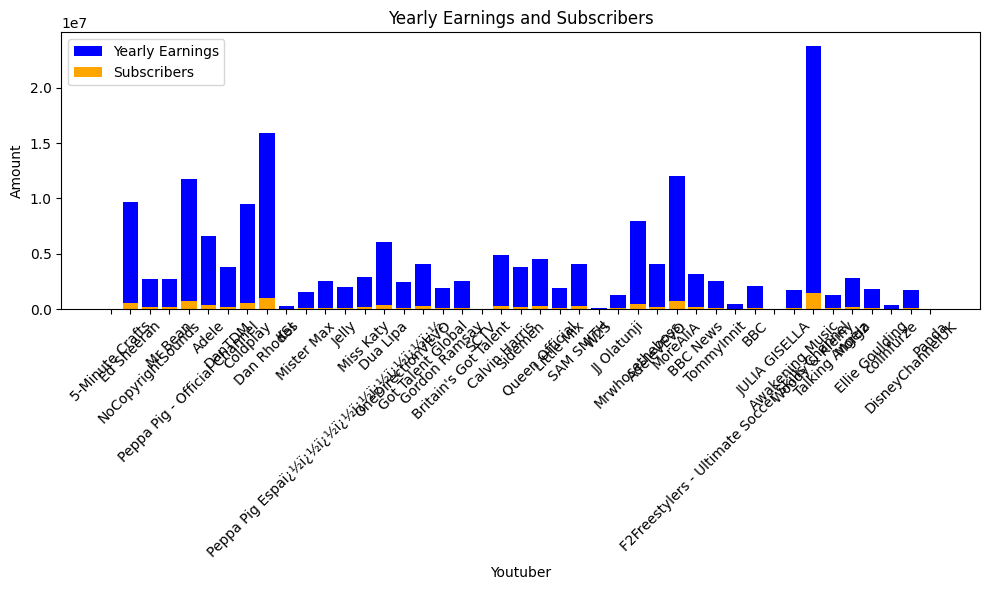

 27%|██▋       | 588/2160 [05:21<16:22,  1.60it/s]check
highest_yearly_earnings: 11900000.0, Subscribers: 743200.0, Youtuber: shfa2 - ï¿½ï¿½
highest_yearly_earnings: 7300000.0, Subscribers: 453600.0, Youtuber: shfa show India
highest_yearly_earnings: 76700000.0, Subscribers: 4800000.0, Youtuber: ZAMZAM ELECTRONICS TRADING
highest_yearly_earnings: 746700.0, Subscribers: 46700.0, Youtuber: Noor Stars
highest_yearly_earnings: 3800000.0, Subscribers: 240500.0, Youtuber: FFUNTV
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Supercar Blondie
highest_yearly_earnings: 3900000.0, Subscribers: 240700.0, Youtuber: AlArabiya ï¿½ï¿½ï¿½ï¿½ï¿


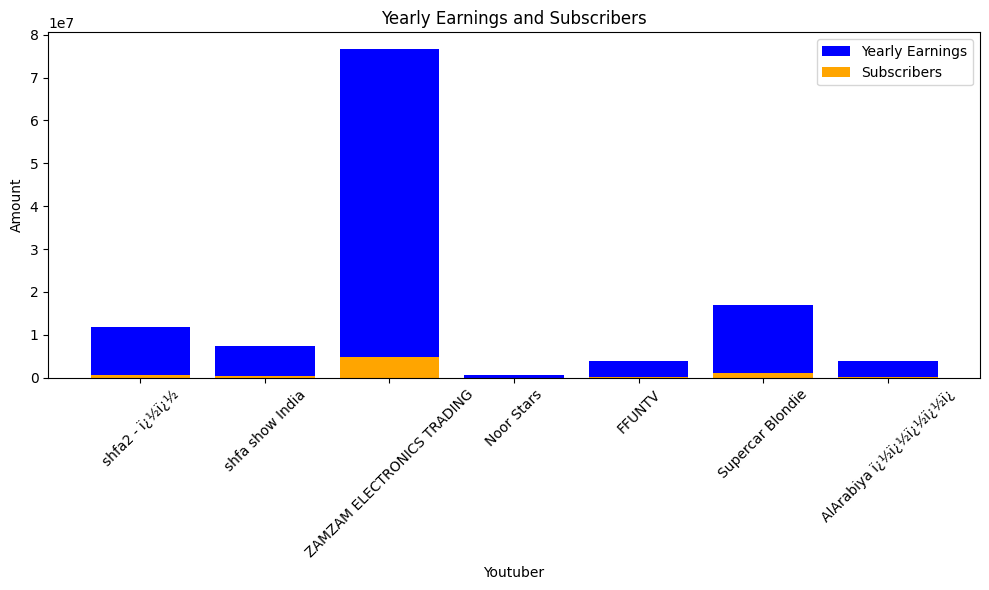

 27%|██▋       | 591/2160 [05:23<12:41,  2.06it/s]check
highest_yearly_earnings: 1400000.0, Subscribers: 87000.0, Youtuber: SlivkiShow
highest_yearly_earnings: 3300000.0, Subscribers: 204000.0, Youtuber: ýýýýýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 17800000.0, Subscribers: 1100000.0, Youtuber: News 24
highest_yearly_earnings: 2300000.0, Subscribers: 141400.0, Youtuber: ýýýýýýýý ýýýýýýýý
highest_yearly_earnings: 5.0, Subscribers: 0.32, Youtuber: SIS vs BRO
highest_yearly_earnings: 3600000.0, Subscribers: 225500.0, Youtuber: Lady Diana
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: VexTrex
highest_yearly_earnings: 3400000.0, Subscribers: 213400.0, Youtuber: ýýýýýýýý ýýýý ýýýýýýýýýýýýýý


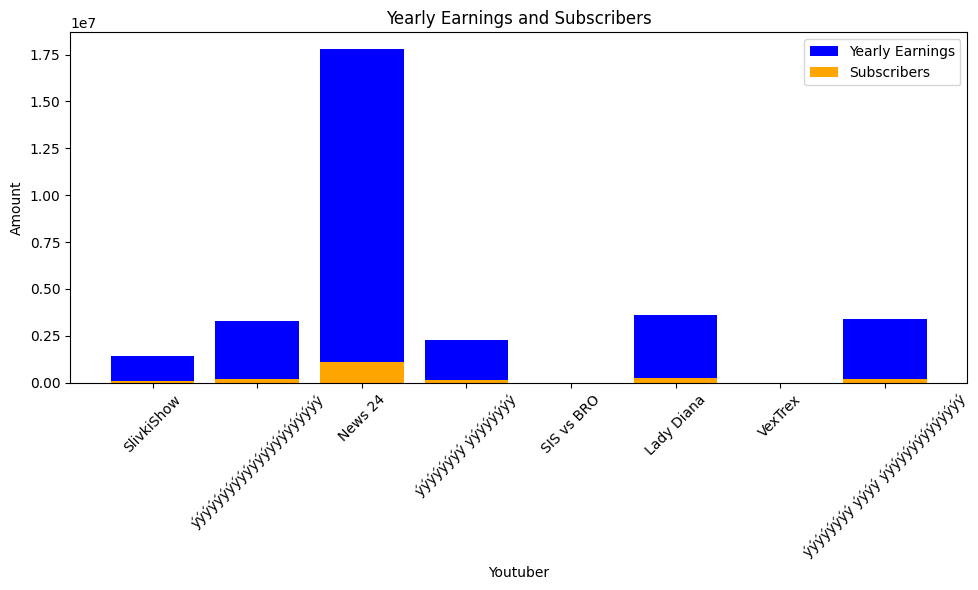

 28%|██▊       | 594/2160 [05:24<10:50,  2.41it/s]check
highest_yearly_earnings: 70200000.0, Subscribers: 4400000.0, Youtuber: BETER Bï¿½ï¿½
highest_yearly_earnings: 20400000.0, Subscribers: 1300000.0, Youtuber: netd mï¿½ï¿
highest_yearly_earnings: 5300000.0, Subscribers: 332400.0, Youtuber: tabii Urdu
highest_yearly_earnings: 212500.0, Subscribers: 13300.0, Youtuber: Oyuncak Avï¿


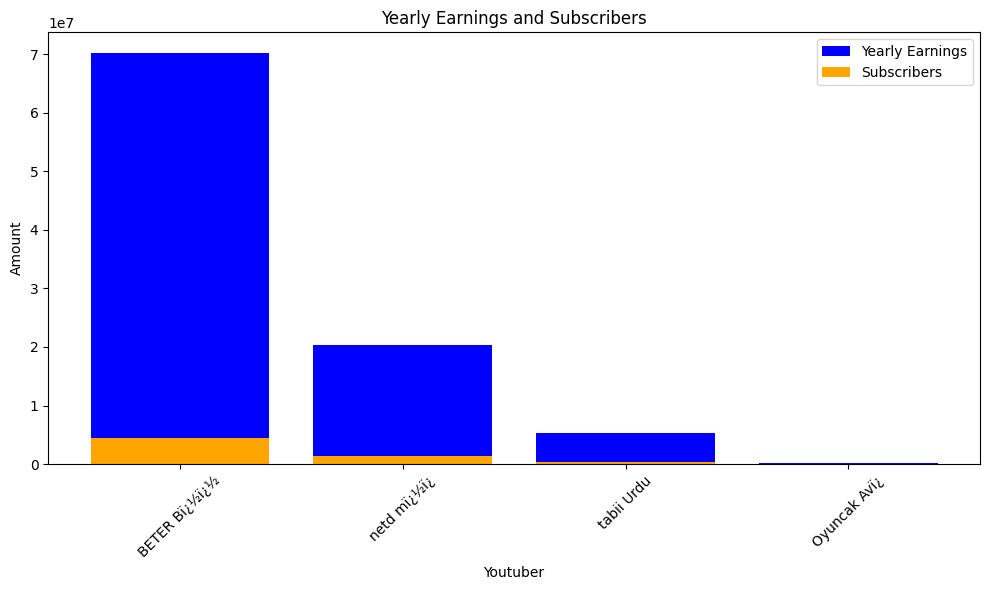

 28%|██▊       | 597/2160 [05:26<09:58,  2.61it/s]check
highest_yearly_earnings: 1.0, Subscribers: 0.07, Youtuber: Alan Walker
highest_yearly_earnings: 6300000.0, Subscribers: 391400.0, Youtuber: WorkpointOfficial
highest_yearly_earnings: 6800000.0, Subscribers: 422300.0, Youtuber: ýýýýýýýýýýýý one31
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Ch3Thailand
highest_yearly_earnings: 6300000.0, Subscribers: 390700.0, Youtuber: GMM GRAMMY OFFICIAL
highest_yearly_earnings: 8100000.0, Subscribers: 505800.0, Youtuber: GRAMMY GOLD OFFICIAL
highest_yearly_earnings: 2600000.0, Subscribers: 162400.0, Youtuber: RsiamMusic : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: zbing z.
highest_yearly_earnings: 11300000.0, Subscribers: 708000.0, Youtuber: AMARINTV : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 448400.0, Subscribers: 28000.0, Youtuber: Kaykai Salaider
highest_yearly_earnings: 4200000.0, Subscribers: 263300.0, Yout

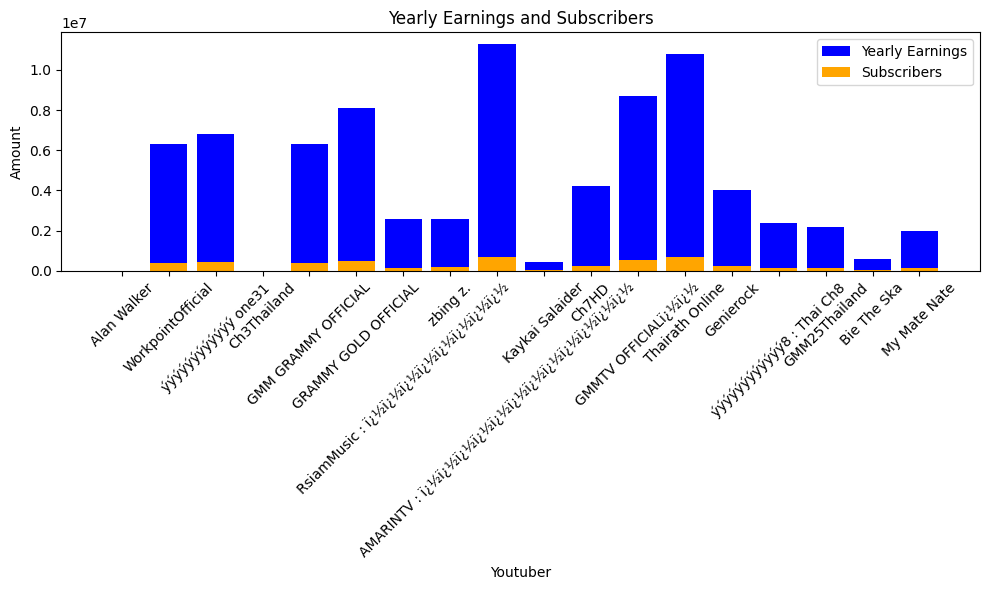

 28%|██▊       | 600/2160 [05:27<10:22,  2.51it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


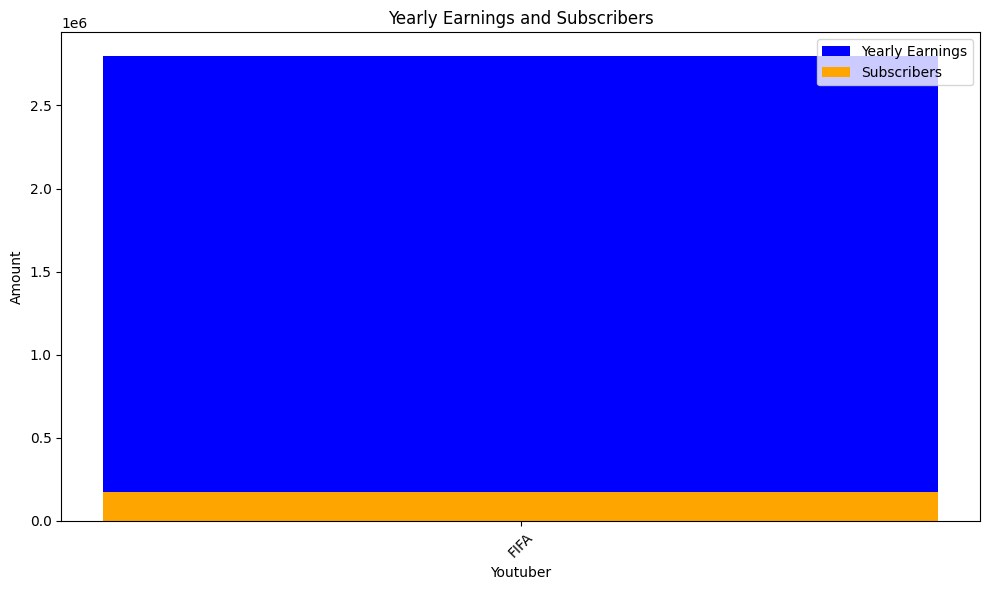

 28%|██▊       | 603/2160 [05:28<09:41,  2.68it/s]check
highest_yearly_earnings: 3900000.0, Subscribers: 243700.0, Youtuber: Avicii
highest_yearly_earnings: 23000000.0, Subscribers: 1400000.0, Youtuber: Panda Shorts
highest_yearly_earnings: 658000.0, Subscribers: 41100.0, Youtuber: Narins Beauty
highest_yearly_earnings: 185800.0, Subscribers: 11600.0, Youtuber: RobTopGames


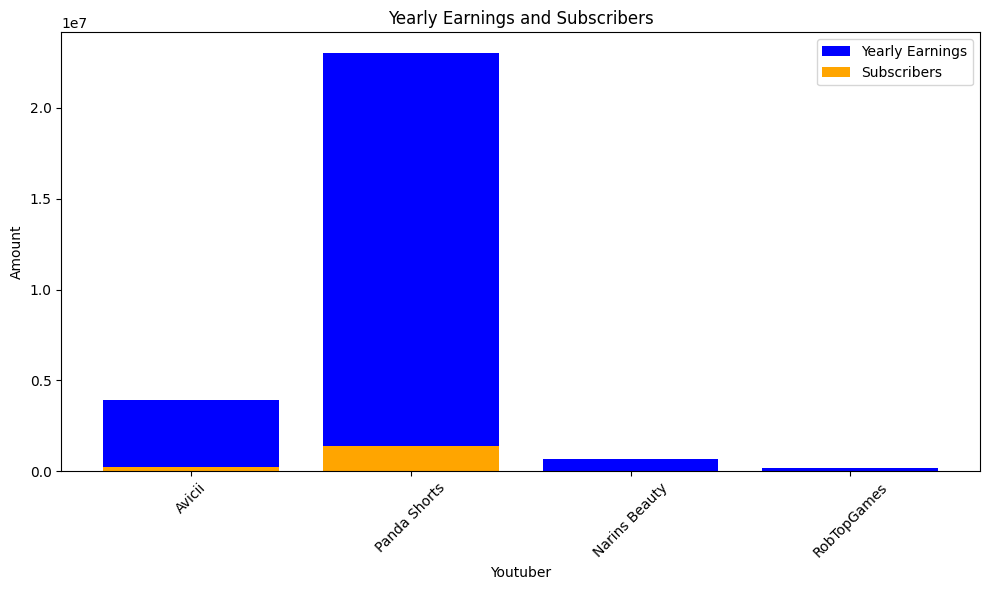

 28%|██▊       | 606/2160 [05:30<09:33,  2.71it/s]check
highest_yearly_earnings: 12700000.0, Subscribers: 792300.0, Youtuber: Mikecrack
highest_yearly_earnings: 1900000.0, Subscribers: 117300.0, Youtuber: VEGETTA777
highest_yearly_earnings: 582900.0, Subscribers: 36400.0, Youtuber: AuronPlay
highest_yearly_earnings: 5.0, Subscribers: 0.31, Youtuber: CKN
highest_yearly_earnings: 528200.0, Subscribers: 33000.0, Youtuber: TheWillyrex
highest_yearly_earnings: 2100000.0, Subscribers: 131500.0, Youtuber: TheGrefg
highest_yearly_earnings: 739500.0, Subscribers: 46200.0, Youtuber: Willyrex
highest_yearly_earnings: 3100.0, Subscribers: 196.0, Youtuber: IDEAS EN 5 MINUTOS
highest_yearly_earnings: 0.19, Subscribers: 0.01, Youtuber: AdMe
highest_yearly_earnings: 4100000.0, Subscribers: 254600.0, Youtuber: FC Barcelona
highest_yearly_earnings: 286600.0, Subscribers: 17900.0, Youtuber: Makiman131
highest_yearly_earnings: 665200.0, Subscribers: 41600.0, Youtuber: iTownGamePlay *Terror&Diversiï¿½ï
hig

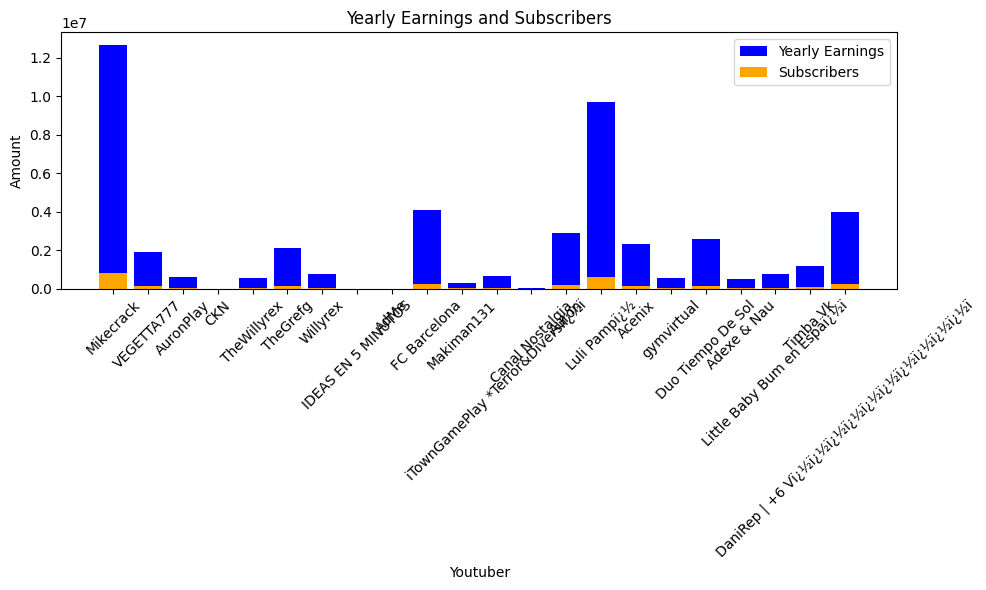

 28%|██▊       | 609/2160 [05:31<10:28,  2.47it/s]check
highest_yearly_earnings: 23900000.0, Subscribers: 1500000.0, Youtuber: BLACKPINK
highest_yearly_earnings: 8100000.0, Subscribers: 504900.0, Youtuber: BANGTANTV
highest_yearly_earnings: 28700000.0, Subscribers: 1800000.0, Youtuber: HYBE LABELS
highest_yearly_earnings: 14800000.0, Subscribers: 922900.0, Youtuber: JYP Entertainment
highest_yearly_earnings: 5100000.0, Subscribers: 316700.0, Youtuber: 1theK (ï¿½ï¿½ï¿½ï¿½ï
highest_yearly_earnings: 7600000.0, Subscribers: 475600.0, Youtuber: Mnet K-POP
highest_yearly_earnings: 5200000.0, Subscribers: 324000.0, Youtuber: KBS WORLD TV
highest_yearly_earnings: 3100000.0, Subscribers: 195000.0, Youtuber: officialpsy
highest_yearly_earnings: 163400000.0, Subscribers: 10200000.0, Youtuber: ýýýýýýýýý KIMPRO
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Jane ASMR ï¿½ï¿½
highest_yearly_earnings: 532700.0, Subscribers: 33300.0, Youtuber: JFlaMusic
highest_yearly_earnings: 2000000.0, Su

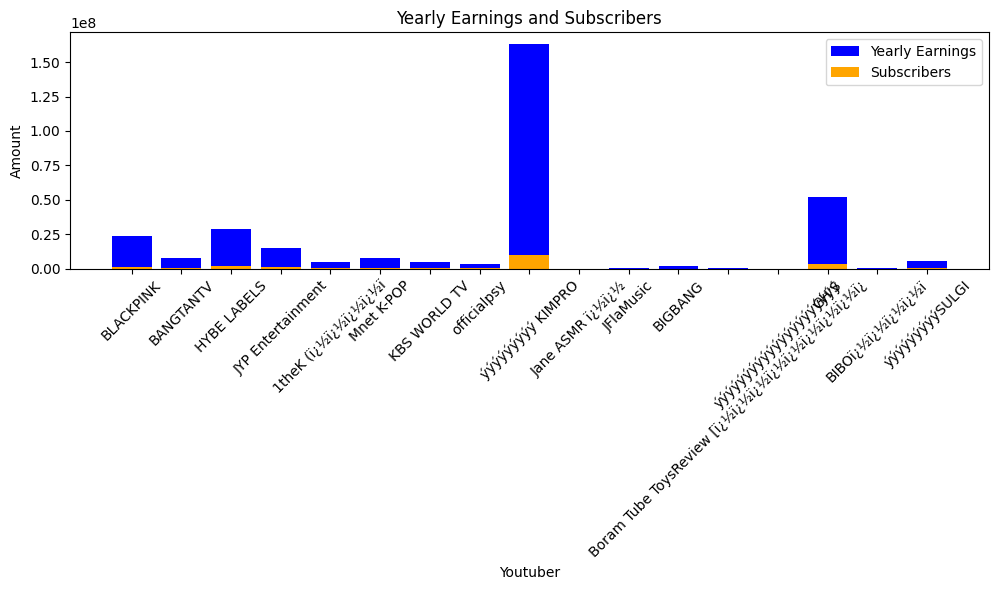

 28%|██▊       | 612/2160 [05:33<12:21,  2.09it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Sandeep Maheshwari
highest_yearly_earnings: 5600000.0, Subscribers: 351600.0, Youtuber: LEGO
highest_yearly_earnings: 45100.0, Subscribers: 2800.0, Youtuber: MY FAMILY


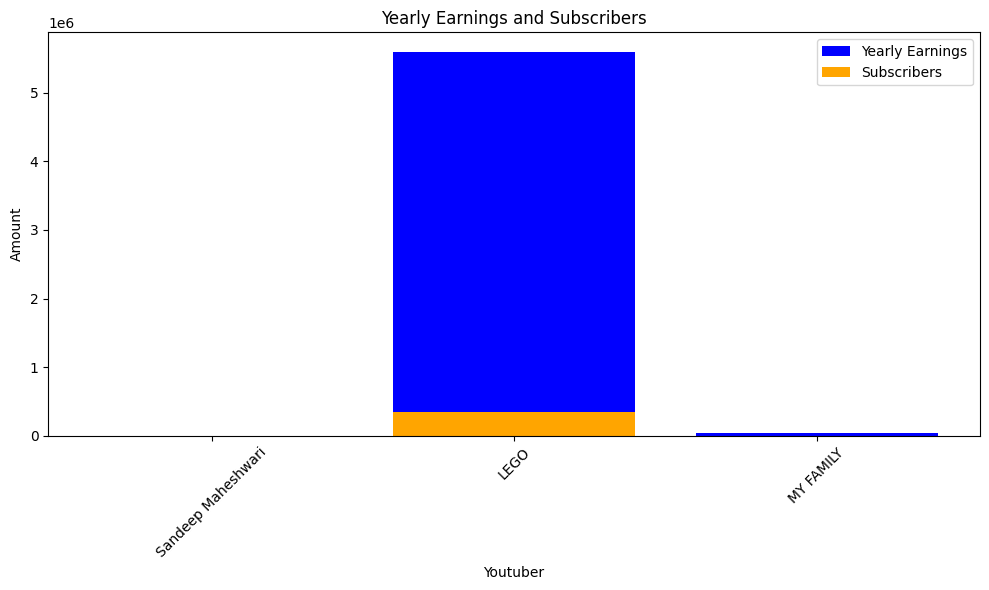

 28%|██▊       | 615/2160 [05:35<12:42,  2.03it/s]check
highest_yearly_earnings: 76300.0, Subscribers: 4800.0, Youtuber: shfa
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: 1MILLION Dance Studio
highest_yearly_earnings: 3500000.0, Subscribers: 221500.0, Youtuber: mmoshaya
highest_yearly_earnings: 2100000.0, Subscribers: 129000.0, Youtuber: ýýýýýýýý ýýýýýýýýýý ýýýýýýýýýý | Arab Games Network
highest_yearly_earnings: 4400000.0, Subscribers: 272700.0, Youtuber: Katakit Baby TV
highest_yearly_earnings: 6500000.0, Subscribers: 405100.0, Youtuber: ýýýýýýýý ýý ýýýýýýýý
highest_yearly_earnings: 129300.0, Subscribers: 8100.0, Youtuber: ýýýýýýýýýý ýýýýýýýýýýýý
highest_yearly_earnings: 224300.0, Subscribers: 14000.0, Youtuber: ýýýýýýýýýýýý ýýýýýýýýýýýý I ýýýýýý ýý ýýýýýýýýýý
highest_yearly_earnings: 3400000.0, Subscribers: 212100.0, Youtuber: BanderitaX


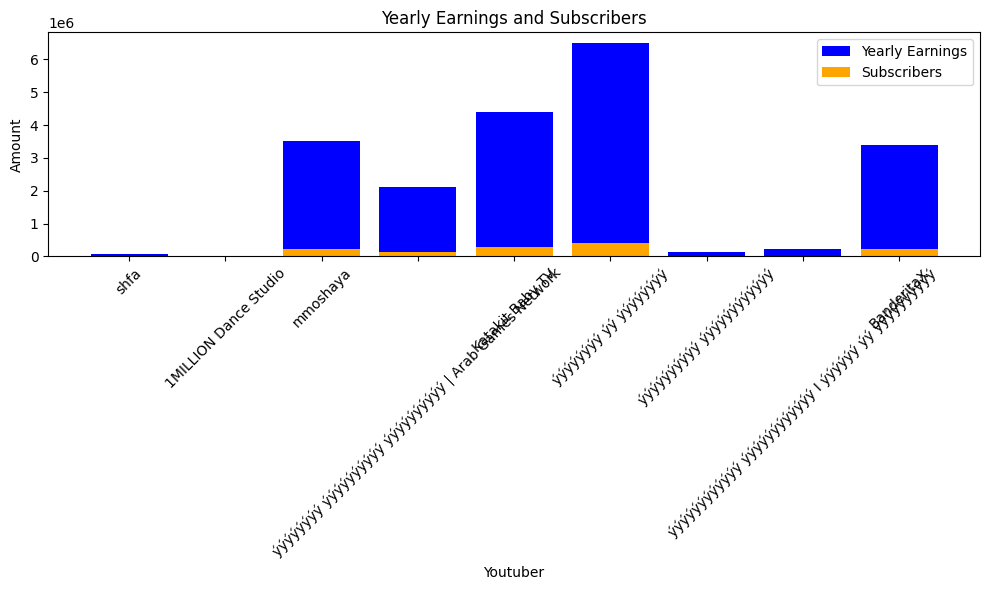

 29%|██▊       | 618/2160 [05:38<16:22,  1.57it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


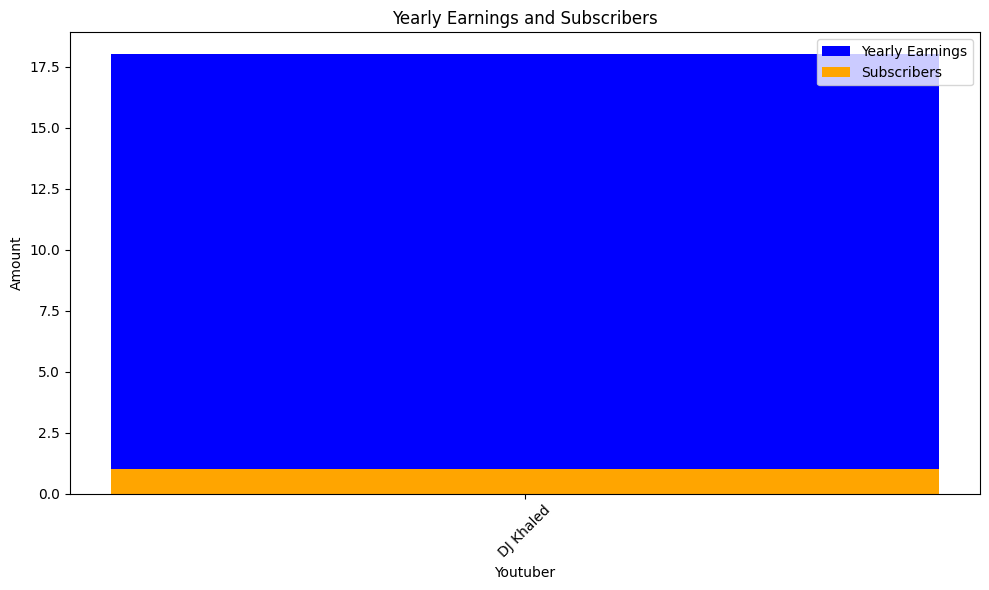

 29%|██▉       | 621/2160 [05:39<11:45,  2.18it/s]check
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya
highest_yearly_earnings: 14700000.0, Subscribers: 919600.0, Youtuber: Get Movies
highest_yearly_earnings: 14600000.0, Subscribers: 911300.0, Youtuber: ýýýýýýýý ýý ýýýýýýýýýýýýýý
highest_yearly_earnings: 26500000.0, Subscribers: 1700000.0, Youtuber: tuzelity SHUFFLE
highest_yearly_earnings: 1200000.0, Subscribers: 73700.0, Youtuber: HiMan
highest_yearly_earnings: 1800000.0, Subscribers: 114800.0, Youtuber: Marmok
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya Vlog
highest_yearly_earnings: 1800000.0, Subscribers: 111500.0, Youtuber: TheBrianMaps
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: ýýýýýýýýýý
highest_yearly_earnings: 22800000.0, Subscribers: 1400000.0, Youtuber: ILYA BORZOV
highest_yearly_earnings: 4600000.0, Subscribers: 286800.0, Youtuber: EdisonPts
highest_yearly_earnings: 34200000.0, Subscribers

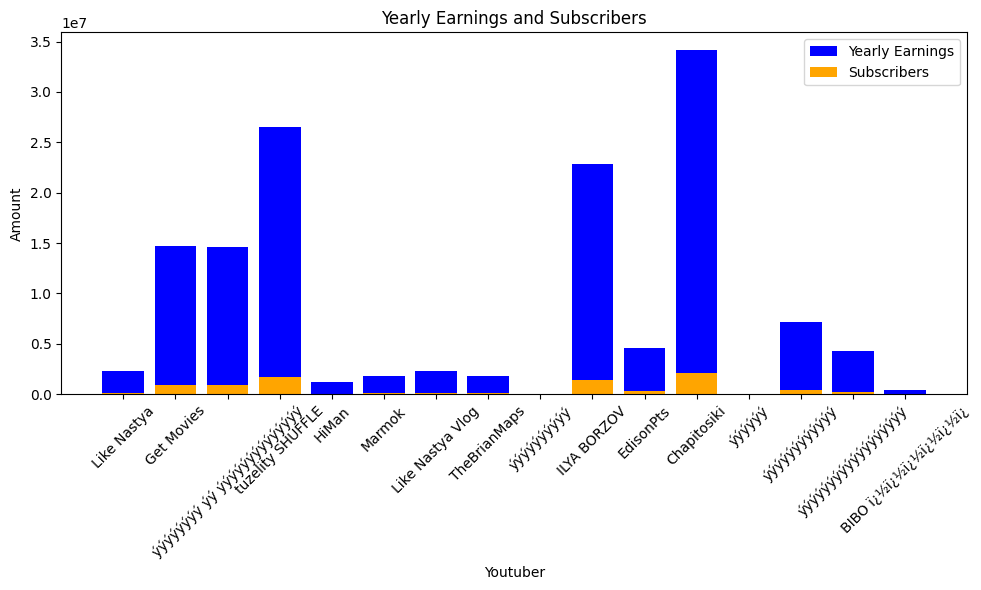

 29%|██▉       | 624/2160 [05:41<11:05,  2.31it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529900.0, Youtuber: ABS-CBN Entertainment
highest_yearly_earnings: 38300000.0, Subscribers: 2400000.0, Youtuber: GMA  Network
highest_yearly_earnings: 7800000.0, Subscribers: 489400.0, Youtuber: Raffy Tulfo in Action
highest_yearly_earnings: 6800000.0, Subscribers: 427000.0, Youtuber: GMA Public  Affairs
highest_yearly_earnings: 723800.0, Subscribers: 45200.0, Youtuber: Ivana Alawi
highest_yearly_earnings: 479000.0, Subscribers: 29900.0, Youtuber: Niana Guerrero
highest_yearly_earnings: 594000.0, Subscribers: 37100.0, Youtuber: Ranz Kyle
highest_yearly_earnings: 8700000.0, Subscribers: 544900.0, Youtuber: ABS-CBN News
highest_yearly_earnings: 3000000.0, Subscribers: 188000.0, Youtuber: Wish 107.5
highest_yearly_earnings: 580200.0, Subscribers: 36300.0, Youtuber: Zeinab Harake
highest_yearly_earnings: 5500000.0, Subscribers: 346400.0, Youtuber: GMA Integrated News
highest_yearly_earn

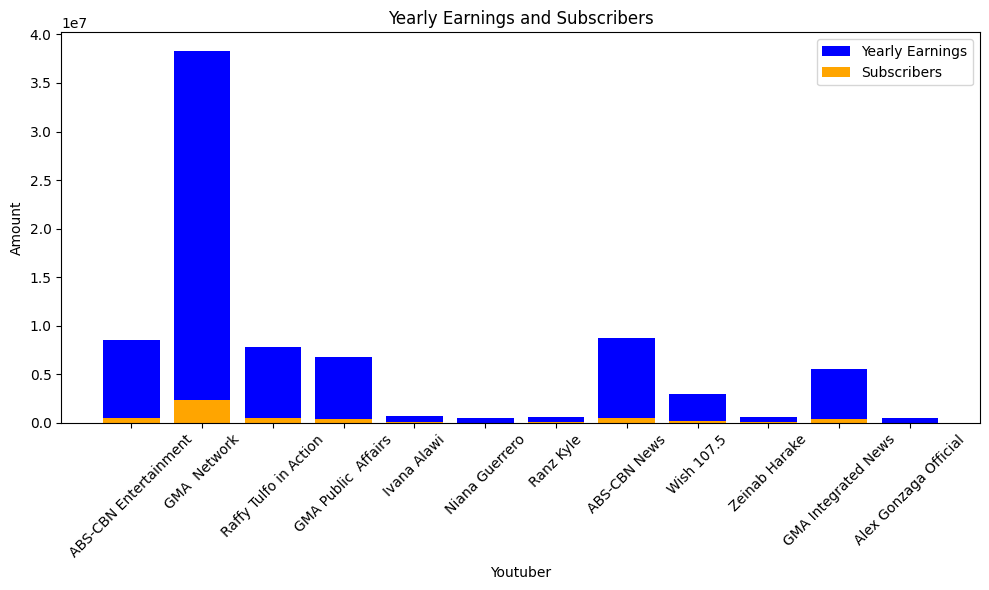

 29%|██▉       | 627/2160 [05:42<10:24,  2.46it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


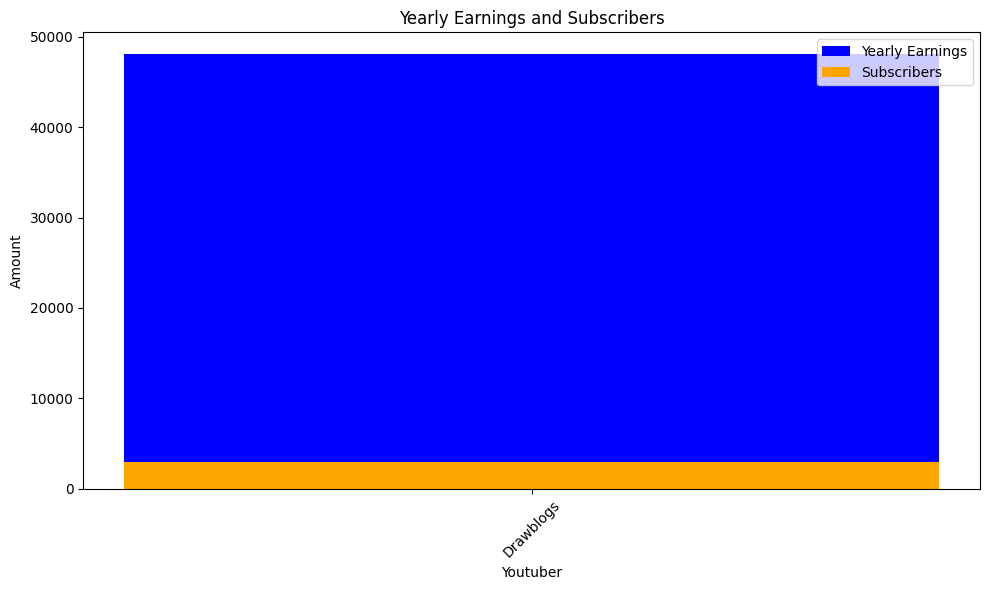

 29%|██▉       | 630/2160 [05:43<09:38,  2.64it/s]check
highest_yearly_earnings: 64200000.0, Subscribers: 4000000.0, Youtuber: HAR PAL GEO
highest_yearly_earnings: 55200000.0, Subscribers: 3400000.0, Youtuber: ARY Digital HD
highest_yearly_earnings: 32900000.0, Subscribers: 2100000.0, Youtuber: HUM TV
highest_yearly_earnings: 4800000.0, Subscribers: 300200.0, Youtuber: Geo News
highest_yearly_earnings: 28.0, Subscribers: 2.0, Youtuber: Wolfoo Channel
highest_yearly_earnings: 419.0, Subscribers: 26.0, Youtuber: Quantum Tech HD


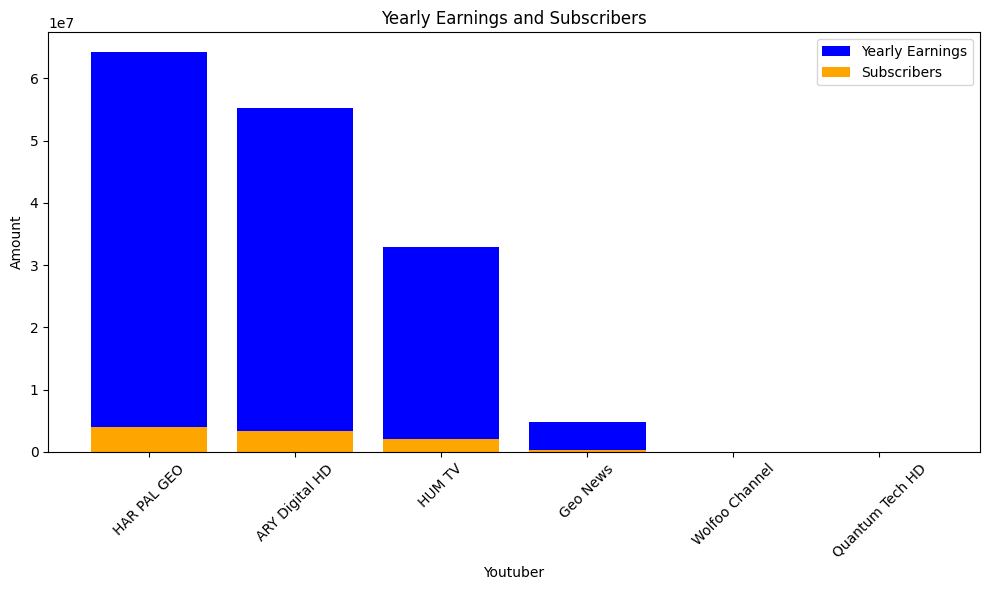

 29%|██▉       | 633/2160 [05:45<09:55,  2.56it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300100.0, Youtuber: Spinnin' Records
highest_yearly_earnings: 1700000.0, Subscribers: 107800.0, Youtuber: NikkieTutorials
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: ýýýýýýýý/Atro


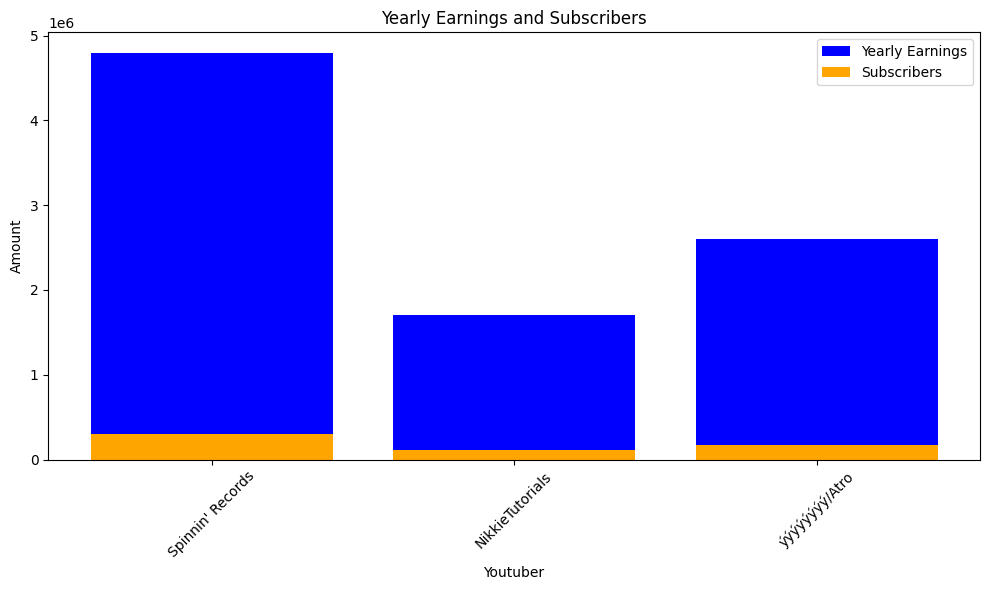

 29%|██▉       | 636/2160 [05:46<09:32,  2.66it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


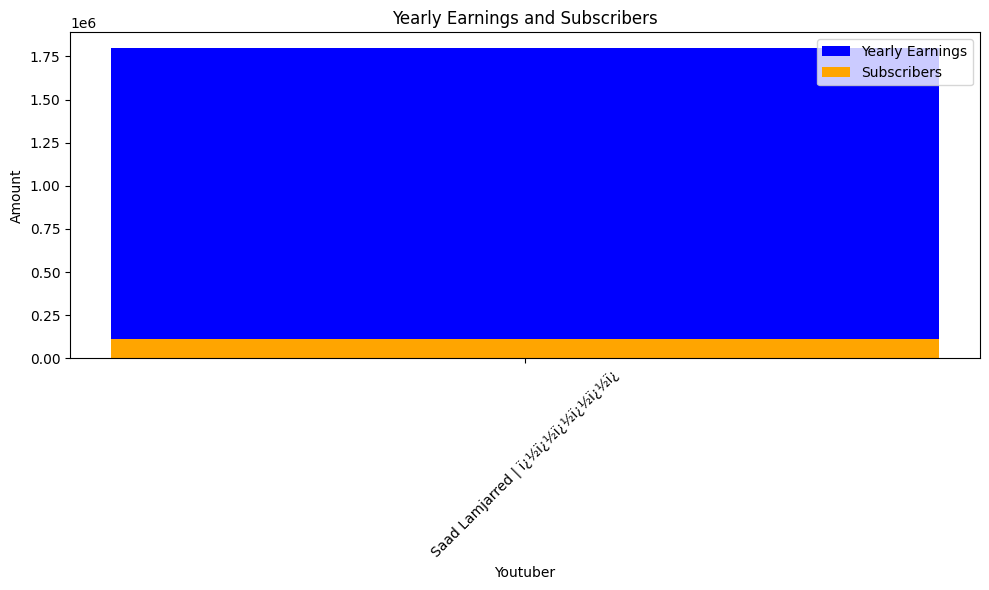

 30%|██▉       | 639/2160 [05:47<09:25,  2.69it/s]check
highest_yearly_earnings: 6600000.0, Subscribers: 410200.0, Youtuber: Kimberly Loaiza
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Luisito Comunica
highest_yearly_earnings: 1500000.0, Subscribers: 94400.0, Youtuber: GENIAL
highest_yearly_earnings: 1500000.0, Subscribers: 91500.0, Youtuber: LosPolinesios
highest_yearly_earnings: 16100.0, Subscribers: 1000.0, Youtuber: Yuya
highest_yearly_earnings: 1600000.0, Subscribers: 100800.0, Youtuber: MrBeast en Espaï¿½ï
highest_yearly_earnings: 2200000.0, Subscribers: 140600.0, Youtuber: Juan De Dios Pantoja
highest_yearly_earnings: 6600000.0, Subscribers: 410500.0, Youtuber: BabyBus - Canciones Infantiles & Videos para Niï¿½ï
highest_yearly_earnings: 227.0, Subscribers: 14.0, Youtuber: Disney Latinoamï¿½ï¿½
highest_yearly_earnings: 742.0, Subscribers: 46.0, Youtuber: Tlnovelas
highest_yearly_earnings: 114300.0, Subscribers: 7100.0, Youtuber: JukiLop
highest_yearly_earnings: 5900

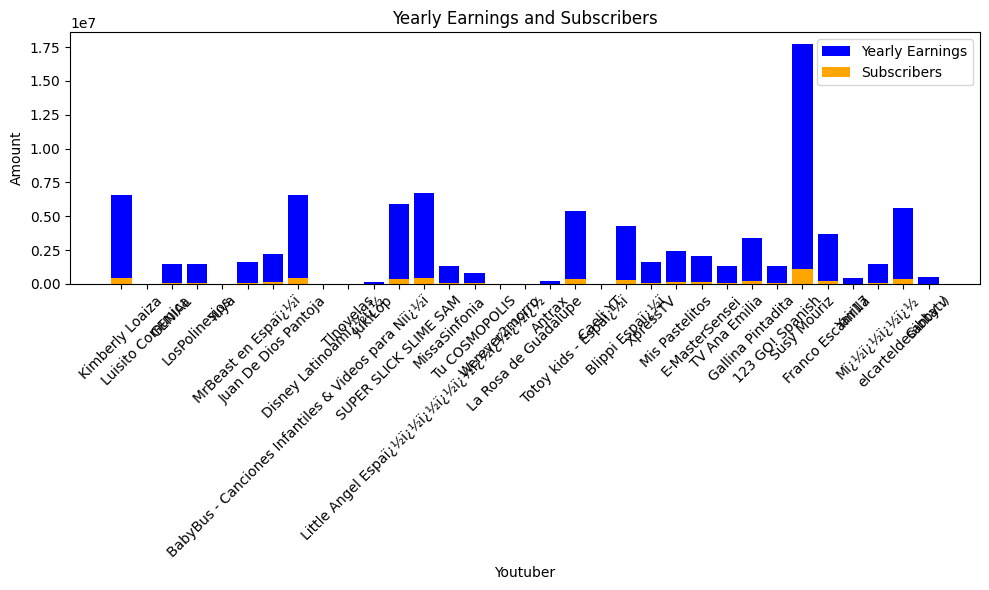

 30%|██▉       | 642/2160 [05:50<13:15,  1.91it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


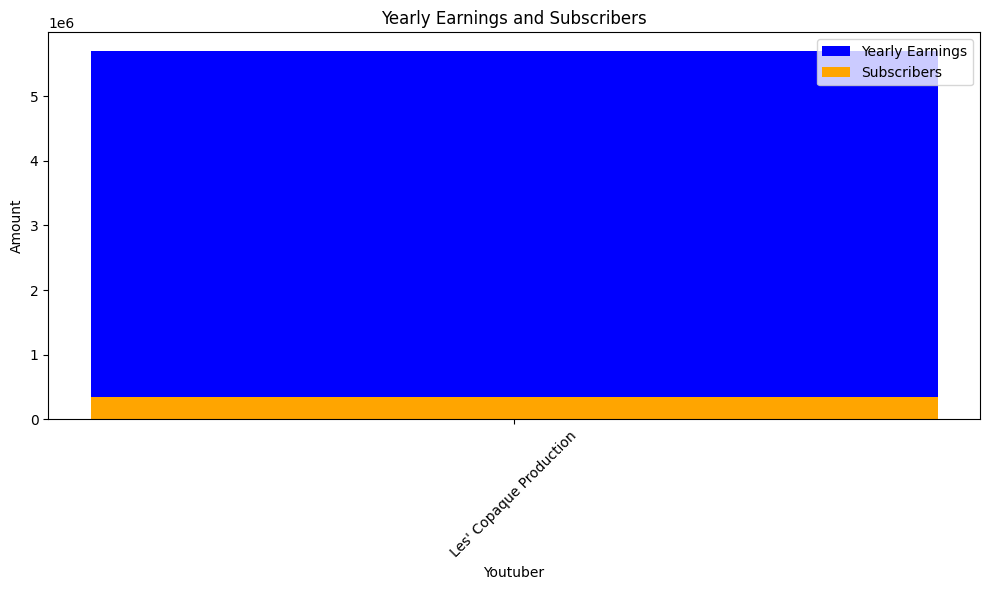

 30%|██▉       | 645/2160 [05:51<12:39,  1.99it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


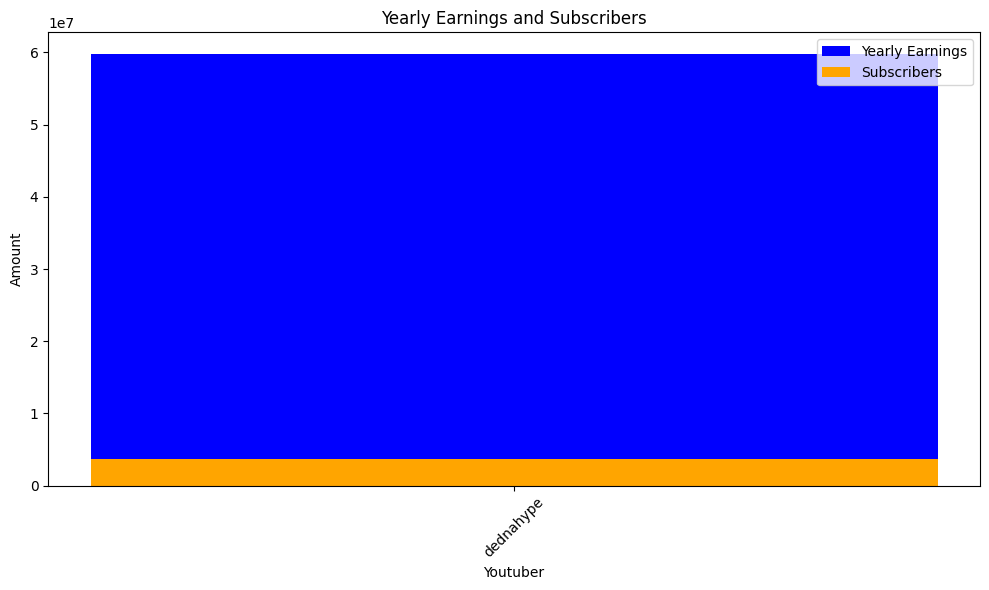

 30%|███       | 648/2160 [05:53<12:01,  2.10it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


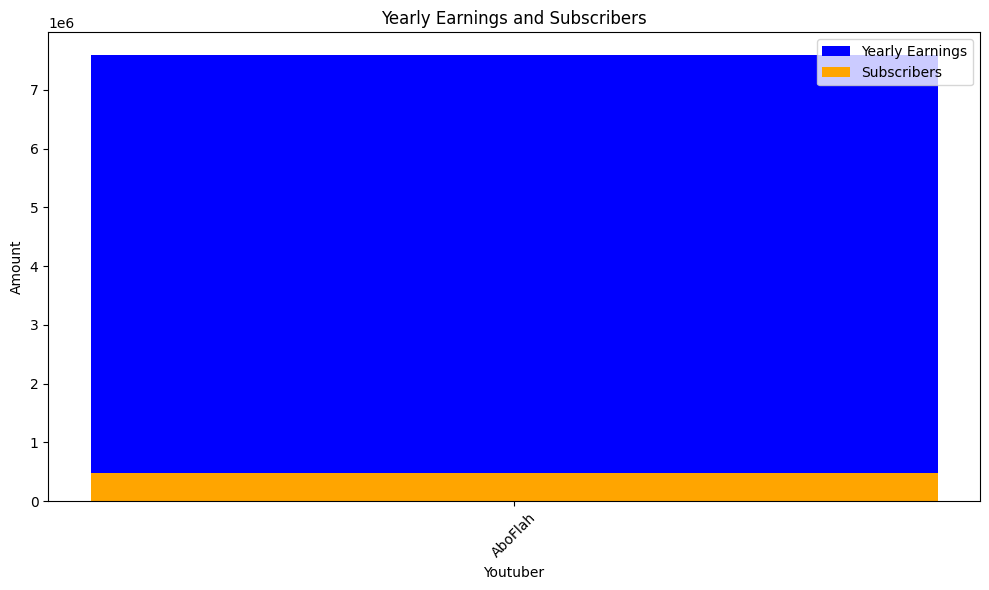

 30%|███       | 651/2160 [05:55<11:54,  2.11it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


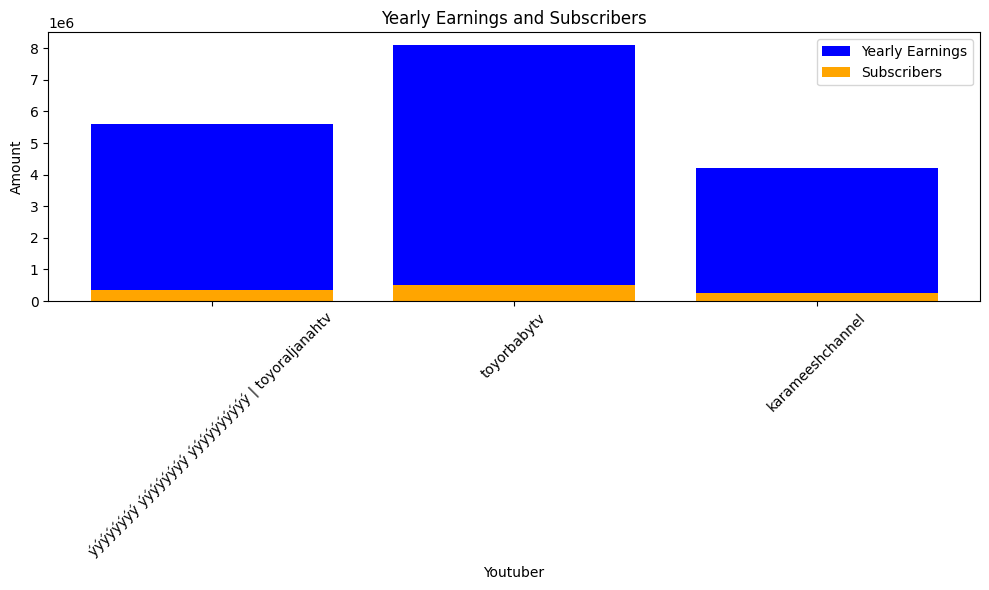

 30%|███       | 654/2160 [05:56<10:27,  2.40it/s]check
highest_yearly_earnings: 1900000.0, Subscribers: 117600.0, Youtuber: PewDiePie
highest_yearly_earnings: 34600000.0, Subscribers: 2200000.0, Youtuber: Junya.ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 34100000.0, Subscribers: 2100000.0, Youtuber: Sagawa /ï¿½ï¿½ï¿½
highest_yearly_earnings: 13600000.0, Subscribers: 847100.0, Youtuber: ISSEI / ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 119.0, Subscribers: 7.0, Youtuber: Bayashi TV


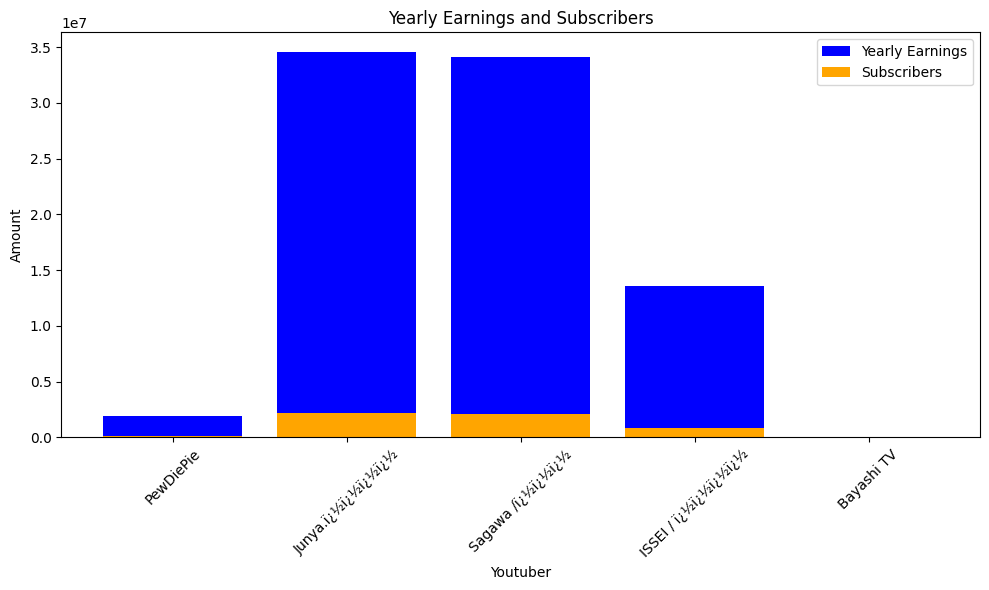

 30%|███       | 657/2160 [05:58<09:55,  2.52it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


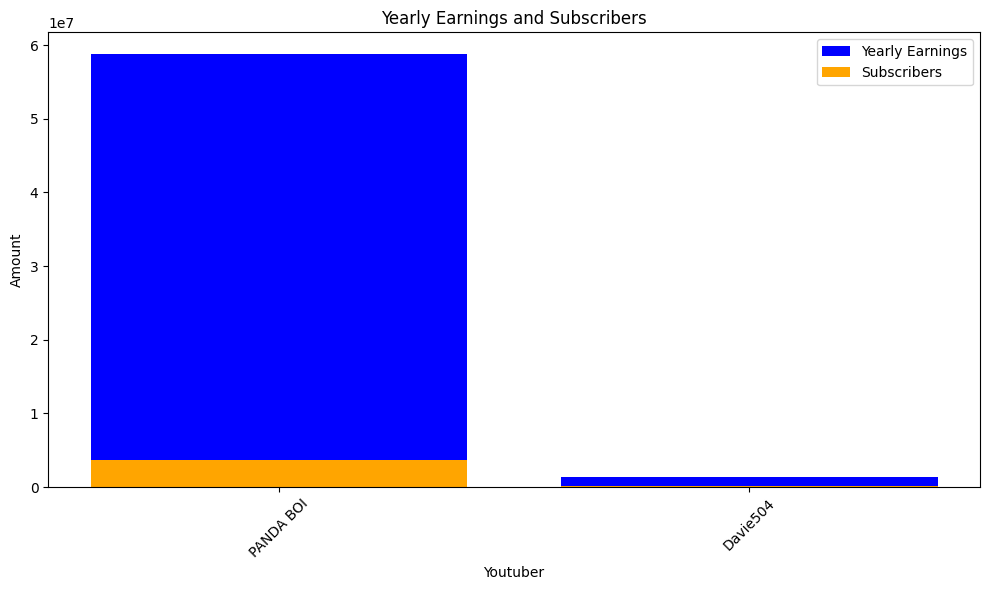

 31%|███       | 660/2160 [05:59<09:26,  2.65it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


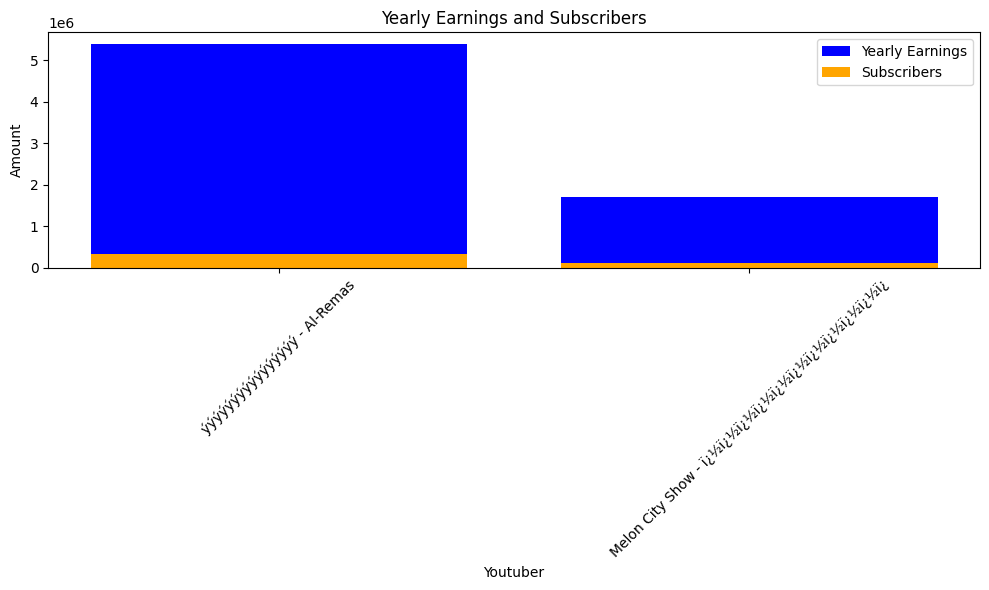

 31%|███       | 663/2160 [06:00<09:09,  2.72it/s]check
highest_yearly_earnings: 26300000.0, Subscribers: 1600000.0, Youtuber: Jess No Limit
highest_yearly_earnings: 7500000.0, Subscribers: 471300.0, Youtuber: Ricis Official
highest_yearly_earnings: 1000000.0, Subscribers: 64300.0, Youtuber: AH
highest_yearly_earnings: 11000000.0, Subscribers: 690500.0, Youtuber: Indosiar
highest_yearly_earnings: 2800000.0, Subscribers: 175500.0, Youtuber: Rans Entertainment
highest_yearly_earnings: 5900000.0, Subscribers: 369600.0, Youtuber: TRANS7 OFFICIAL
highest_yearly_earnings: 1300000.0, Subscribers: 80900.0, Youtuber: Baim Paula
highest_yearly_earnings: 4.0, Subscribers: 0.26, Youtuber: Deddy Corbuzier
highest_yearly_earnings: 5400000.0, Subscribers: 338300.0, Youtuber: BabyBus - Cerita & Lagu Anak-anak
highest_yearly_earnings: 3100000.0, Subscribers: 193500.0, Youtuber: MiawAug
highest_yearly_earnings: 9500000.0, Subscribers: 592100.0, Youtuber: Willie Salim
highest_yearly_earnings: 819000.0, S

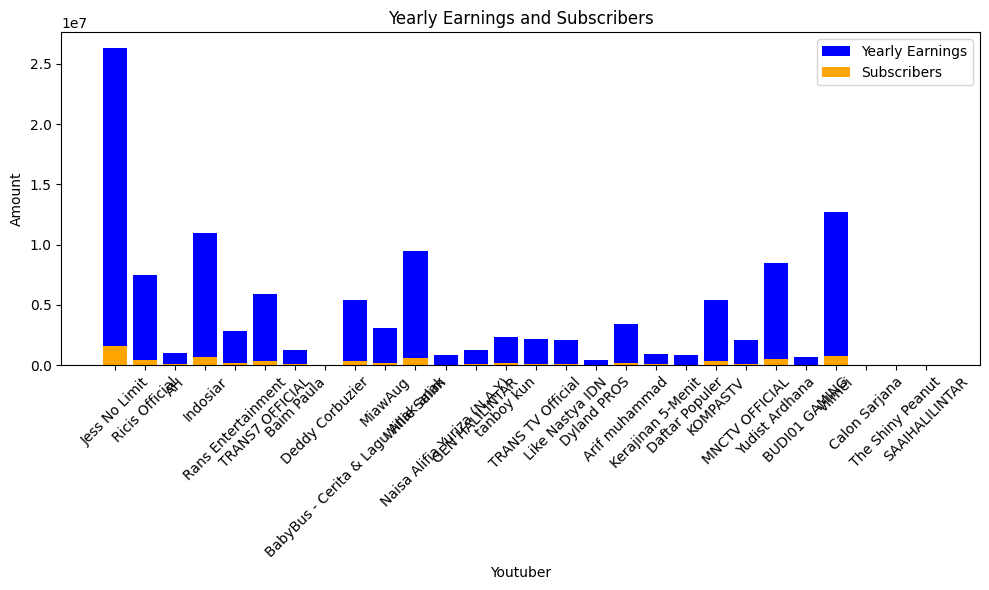

 31%|███       | 666/2160 [06:02<10:28,  2.38it/s]check
highest_yearly_earnings: 108400000.0, Subscribers: 6800000.0, Youtuber: T-Series
highest_yearly_earnings: 87500000.0, Subscribers: 5500000.0, Youtuber: SET India
highest_yearly_earnings: 38600000.0, Subscribers: 2400000.0, Youtuber: Zee Music Company
highest_yearly_earnings: 79600000.0, Subscribers: 5000000.0, Youtuber: Sony SAB
highest_yearly_earnings: 81900000.0, Subscribers: 5100000.0, Youtuber: Zee TV
highest_yearly_earnings: 20200000.0, Subscribers: 1300000.0, Youtuber: ChuChu TV Nursery Rhymes & Kids Songs
highest_yearly_earnings: 12200000.0, Subscribers: 764900.0, Youtuber: Shemaroo Filmi Gaane
highest_yearly_earnings: 57000000.0, Subscribers: 3600000.0, Youtuber: Colors TV
highest_yearly_earnings: 0.48, Subscribers: 0.03, Youtuber: T-Series Bhakti Sagar
highest_yearly_earnings: 20300000.0, Subscribers: 1300000.0, Youtuber: Tips Official
highest_yearly_earnings: 11100000.0, Subscribers: 696100.0, Youtuber: Wave Music
highes

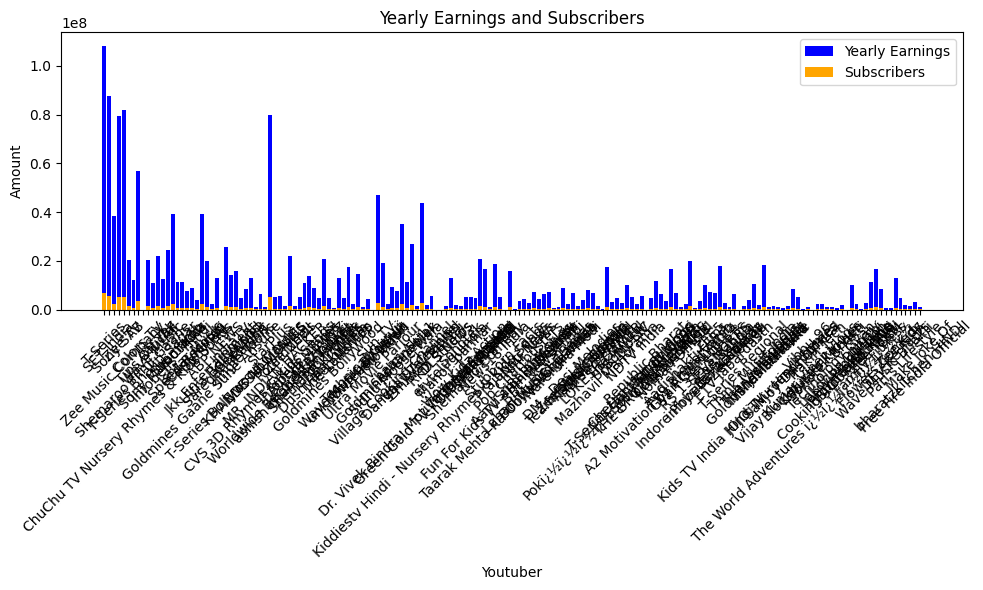

 31%|███       | 669/2160 [06:07<22:30,  1.10it/s]check
highest_yearly_earnings: 36300000.0, Subscribers: 2300000.0, Youtuber: Tsuriki Show
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: YOLO
highest_yearly_earnings: 1400000.0, Subscribers: 87800.0, Youtuber: Kurzgesagt ï¿½ï¿½ï¿½ï¿½ï¿½ï¿
highest_yearly_earnings: 271200.0, Subscribers: 17000.0, Youtuber: HaerteTest
highest_yearly_earnings: 29600000.0, Subscribers: 1900000.0, Youtuber: Younes Zarou
highest_yearly_earnings: 1800.0, Subscribers: 114.0, Youtuber: Beast Philanthropy


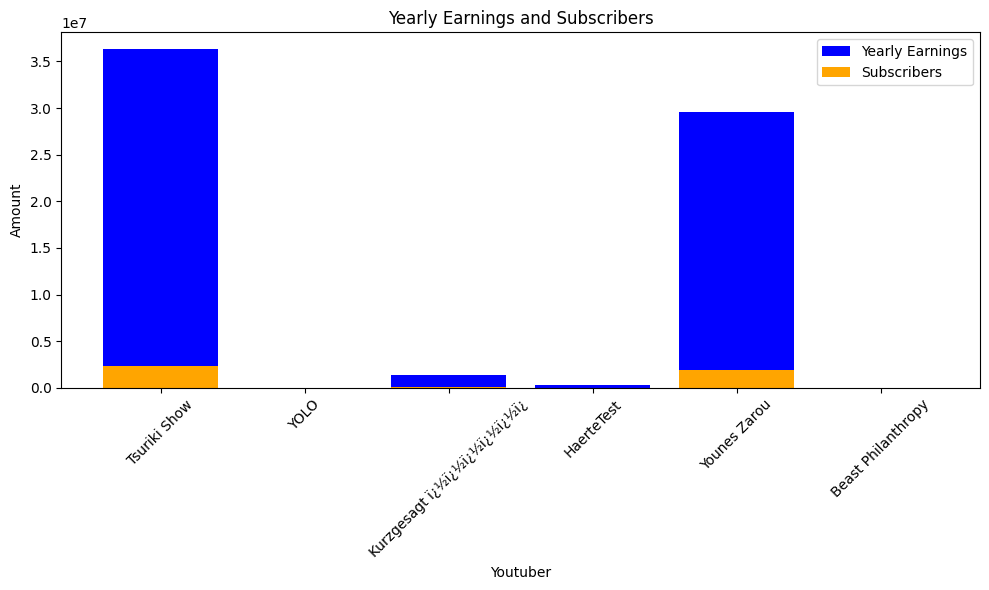

 31%|███       | 672/2160 [06:09<16:42,  1.48it/s]check
highest_yearly_earnings: 35.0, Subscribers: 2.0, Youtuber: Smile Family
highest_yearly_earnings: 2300000.0, Subscribers: 144300.0, Youtuber: SQUEEZIE
highest_yearly_earnings: 37.0, Subscribers: 2.0, Youtuber: FitDance
highest_yearly_earnings: 548000.0, Subscribers: 34300.0, Youtuber: Cyprien
highest_yearly_earnings: 1500000.0, Subscribers: 91400.0, Youtuber: Lofi Girl


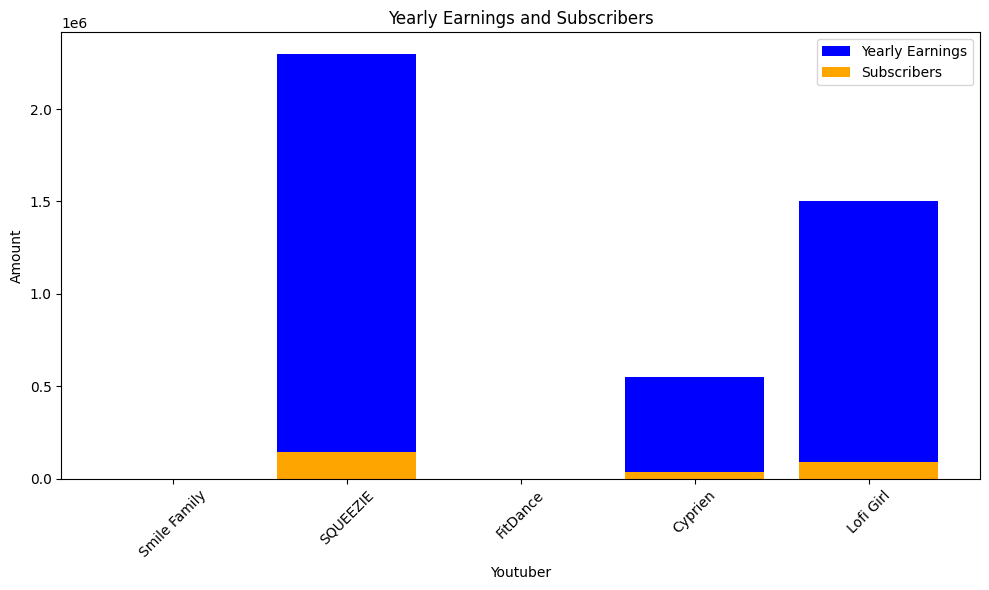

 31%|███▏      | 675/2160 [06:11<14:17,  1.73it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


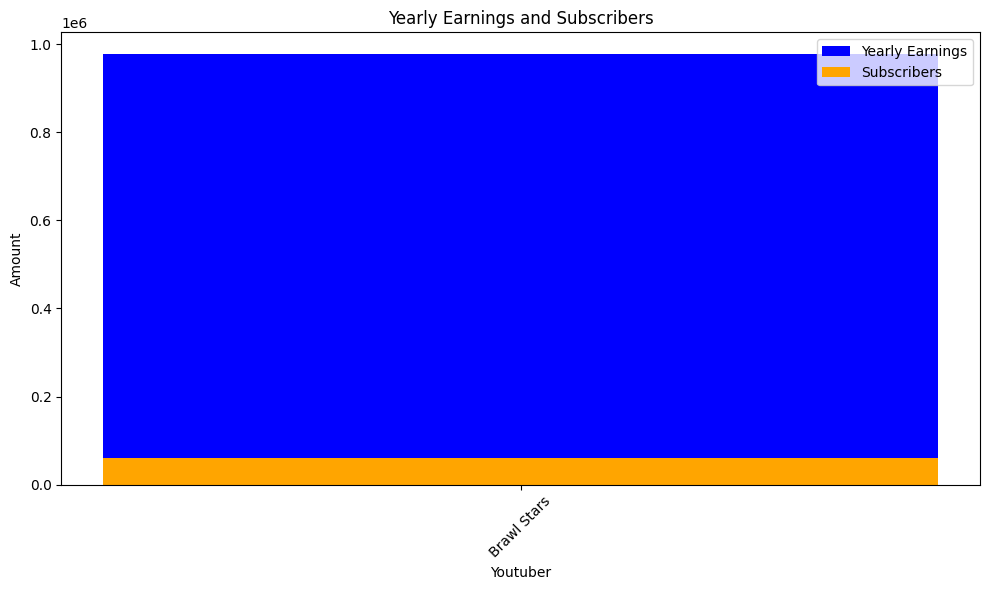

 31%|███▏      | 678/2160 [06:12<11:00,  2.24it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


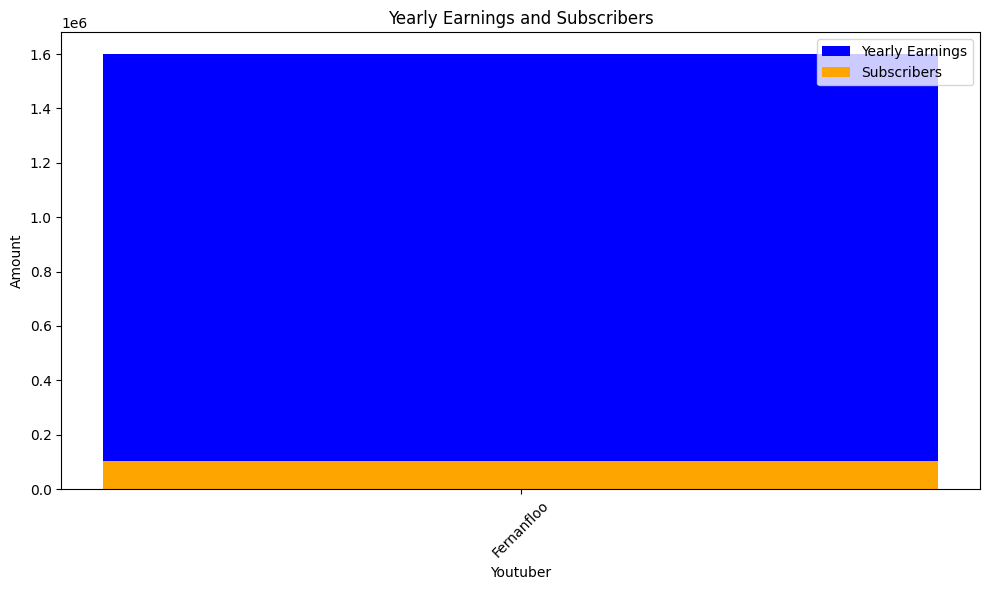

 32%|███▏      | 681/2160 [06:13<10:02,  2.45it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


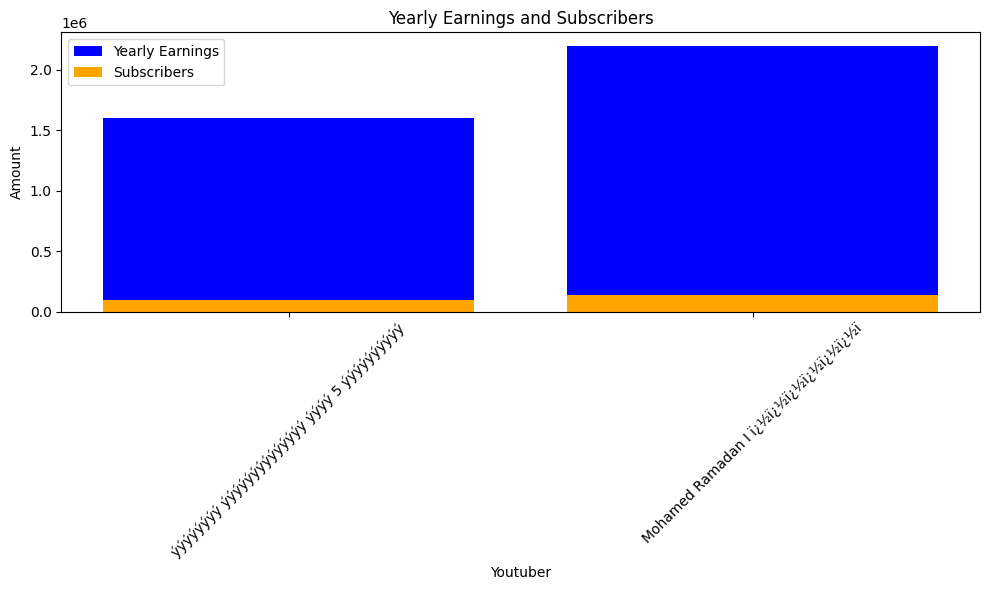

 32%|███▏      | 684/2160 [06:15<10:47,  2.28it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


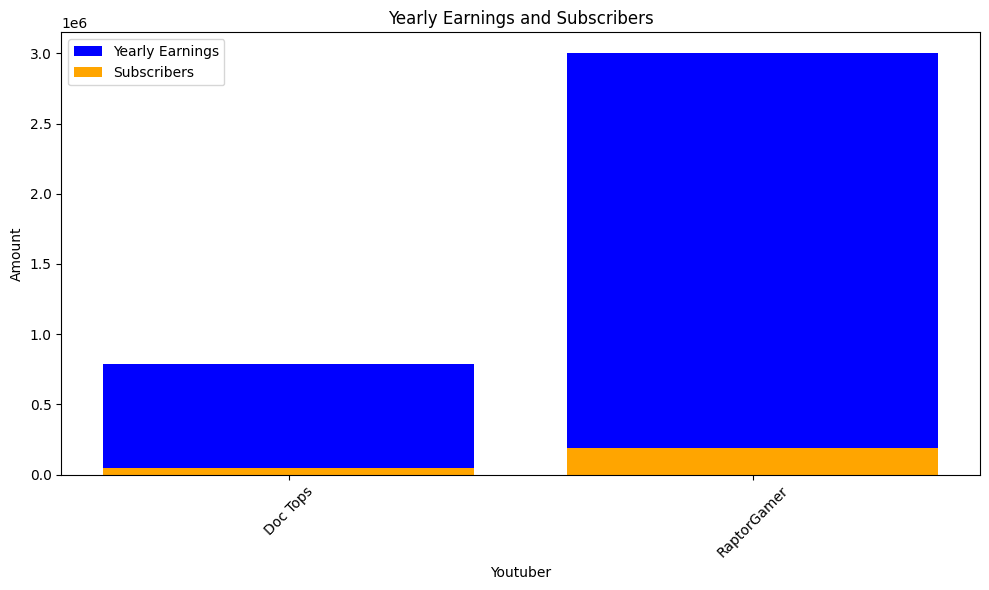

 32%|███▏      | 687/2160 [06:17<11:22,  2.16it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


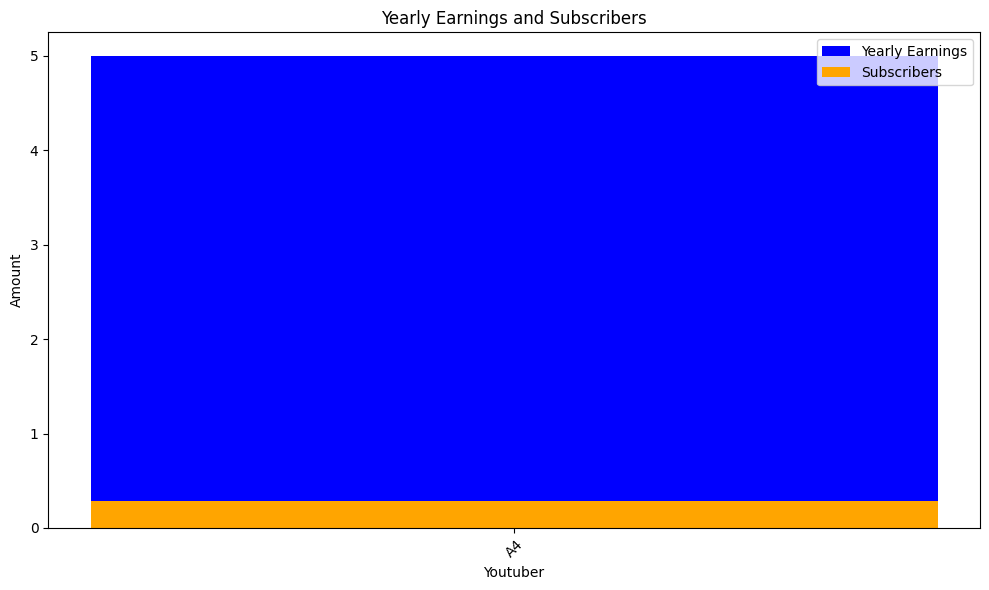

 32%|███▏      | 690/2160 [06:18<12:40,  1.93it/s]check
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Shakira
highest_yearly_earnings: 6200000.0, Subscribers: 386100.0, Youtuber: J Balvin
highest_yearly_earnings: 22400000.0, Subscribers: 1400000.0, Youtuber: KAROL G
highest_yearly_earnings: 8300000.0, Subscribers: 521500.0, Youtuber: toycantando
highest_yearly_earnings: 1200000.0, Subscribers: 73100.0, Youtuber: enchufetv
highest_yearly_earnings: 13600000.0, Subscribers: 852400.0, Youtuber: Anuel AA
highest_yearly_earnings: 12700000.0, Subscribers: 791600.0, Youtuber: Ami Rodriguez
highest_yearly_earnings: 2900000.0, Subscribers: 179700.0, Youtuber: Camilo
highest_yearly_earnings: 11000000.0, Subscribers: 686700.0, Youtuber: Codiscos
highest_yearly_earnings: 4100000.0, Subscribers: 258800.0, Youtuber: jbalvinVEVO
highest_yearly_earnings: 15700000.0, Subscribers: 982800.0, Youtuber: Go Ami Go!


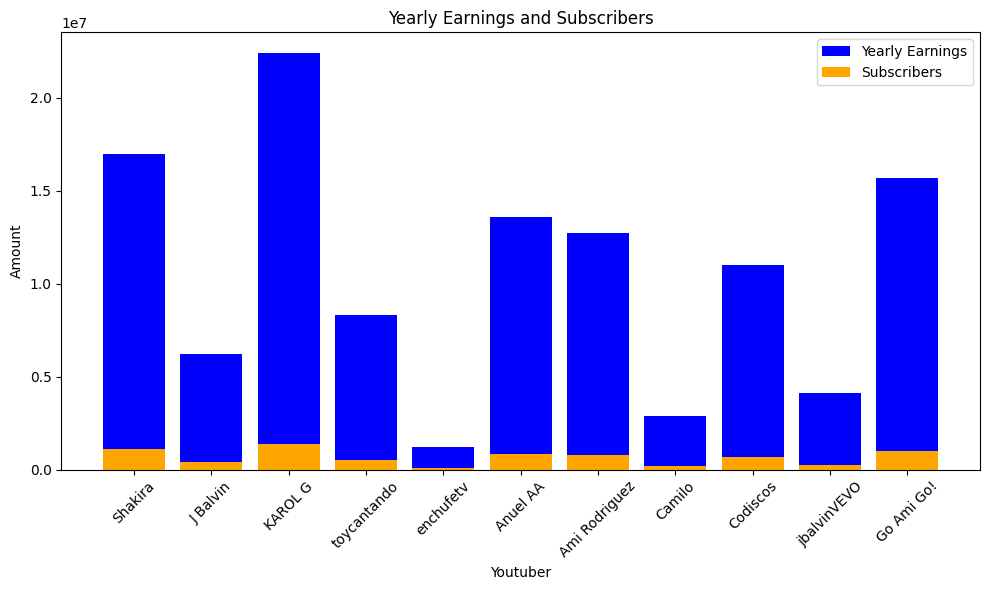

 32%|███▏      | 693/2160 [06:21<13:30,  1.81it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


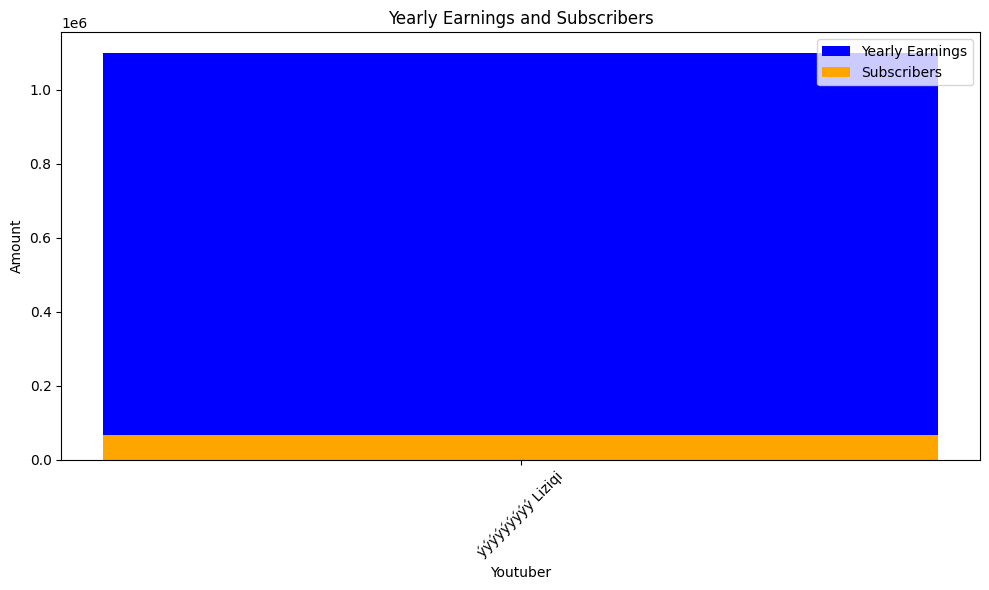

 32%|███▏      | 696/2160 [06:22<12:37,  1.93it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 199200.0, Youtuber: JuegaGerman
highest_yearly_earnings: 2.0, Subscribers: 0.15, Youtuber: invictor
highest_yearly_earnings: 4800000.0, Subscribers: 300600.0, Youtuber: DeGoBooM


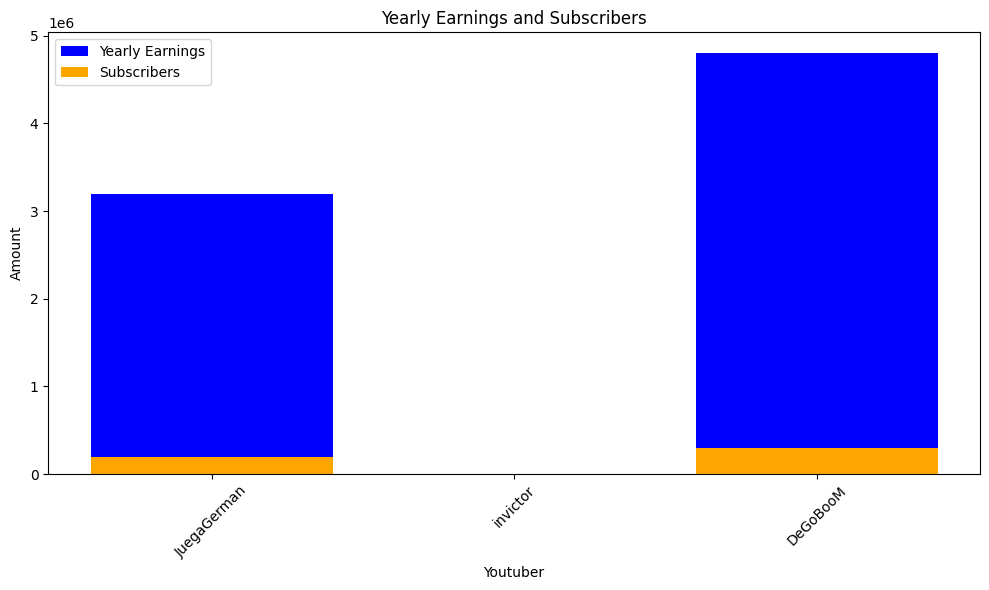

 32%|███▏      | 699/2160 [06:24<12:23,  1.97it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529000.0, Youtuber: Justin Bieber
highest_yearly_earnings: 26900000.0, Subscribers: 1700000.0, Youtuber: Super Simple Songs - Kids Songs
highest_yearly_earnings: 17900000.0, Subscribers: 1100000.0, Youtuber: The Weeknd
highest_yearly_earnings: 4300000.0, Subscribers: 266200.0, Youtuber: Shawn Mendes
highest_yearly_earnings: 2600000.0, Subscribers: 164800.0, Youtuber: VanossGaming
highest_yearly_earnings: 2400000.0, Subscribers: 147000.0, Youtuber: WatchMojo.com
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: FaZe Rug
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Pentatonix
highest_yearly_earnings: 4200000.0, Subscribers: 264700.0, Youtuber: Linus Tech Tips
highest_yearly_earnings: 255800.0, Subscribers: 16000.0, Youtuber: Lilly Singh
highest_yearly_earnings: 4000000.0, Subscribers: 251800.0, Youtuber: Hacksmith Industries
highest_yearly_earnings: 1600000.0, Sub

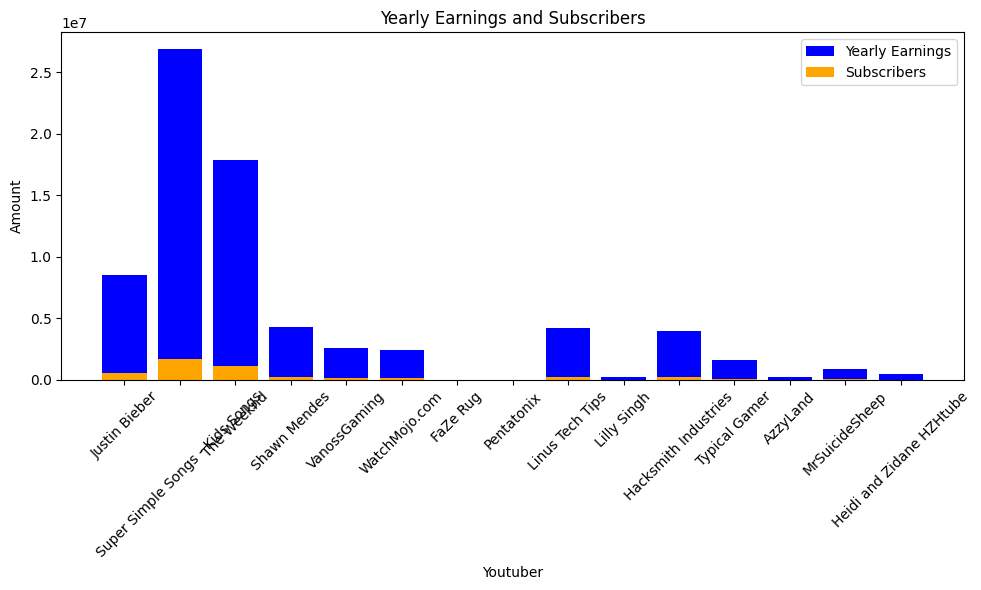

 32%|███▎      | 702/2160 [06:26<14:22,  1.69it/s]check
highest_yearly_earnings: 7200000.0, Subscribers: 448600.0, Youtuber: Bispo Bruno Leonardo


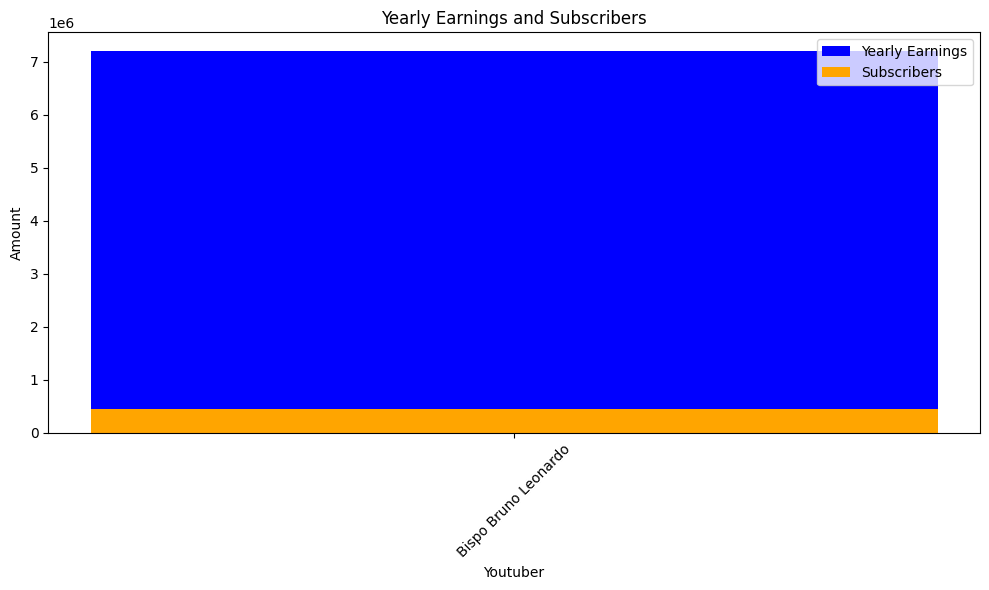

 33%|███▎      | 705/2160 [06:28<13:35,  1.78it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


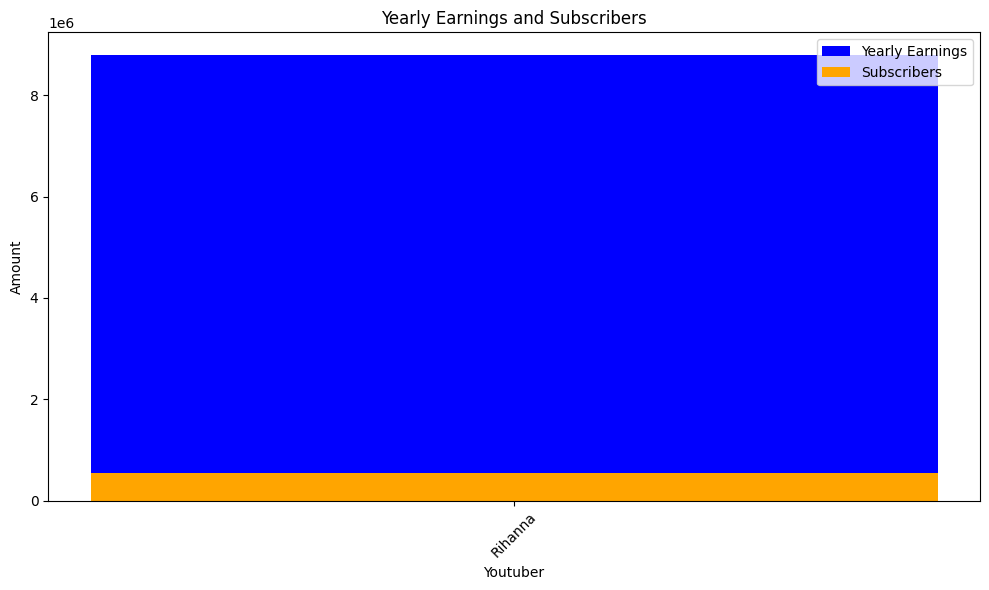

 33%|███▎      | 708/2160 [06:30<10:58,  2.20it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


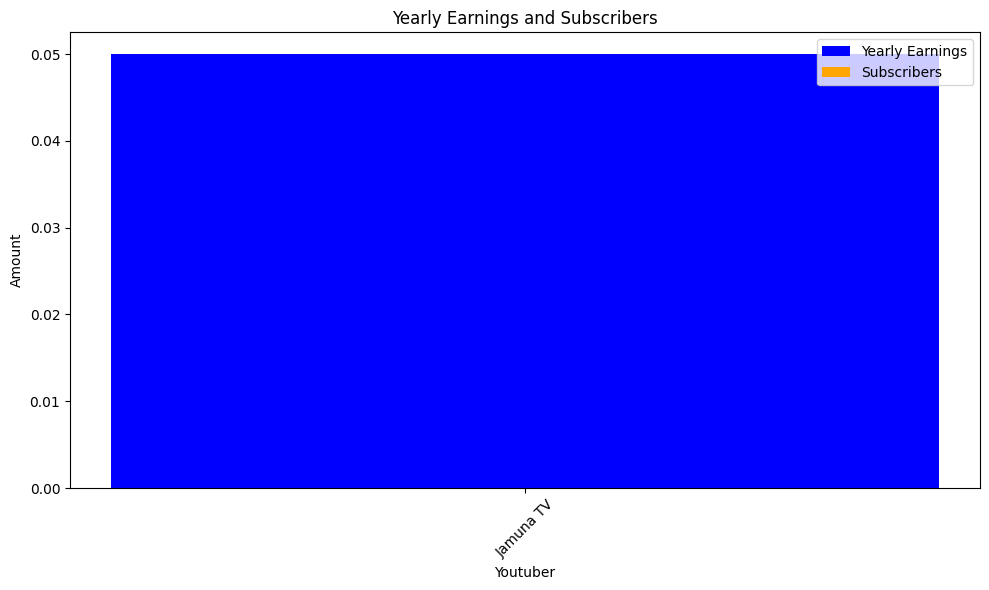

 33%|███▎      | 711/2160 [06:31<09:54,  2.44it/s]check
highest_yearly_earnings: 6100000.0, Subscribers: 382300.0, Youtuber: Bounce Patrol - Kids Songs
highest_yearly_earnings: 1100000.0, Subscribers: 69800.0, Youtuber: Chloe Ting
highest_yearly_earnings: 1300000.0, Subscribers: 78200.0, Youtuber: LazarBeam
highest_yearly_earnings: 18800000.0, Subscribers: 1200000.0, Youtuber: How Ridiculous
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: The Game Theorists
highest_yearly_earnings: 745200.0, Subscribers: 46600.0, Youtuber: HowToBasic
highest_yearly_earnings: 1.0, Subscribers: 0.08, Youtuber: Jason Vlogs
highest_yearly_earnings: 1000000.0, Subscribers: 63200.0, Youtuber: Lachlan
highest_yearly_earnings: 7.0, Subscribers: 0.44, Youtuber: Trap City


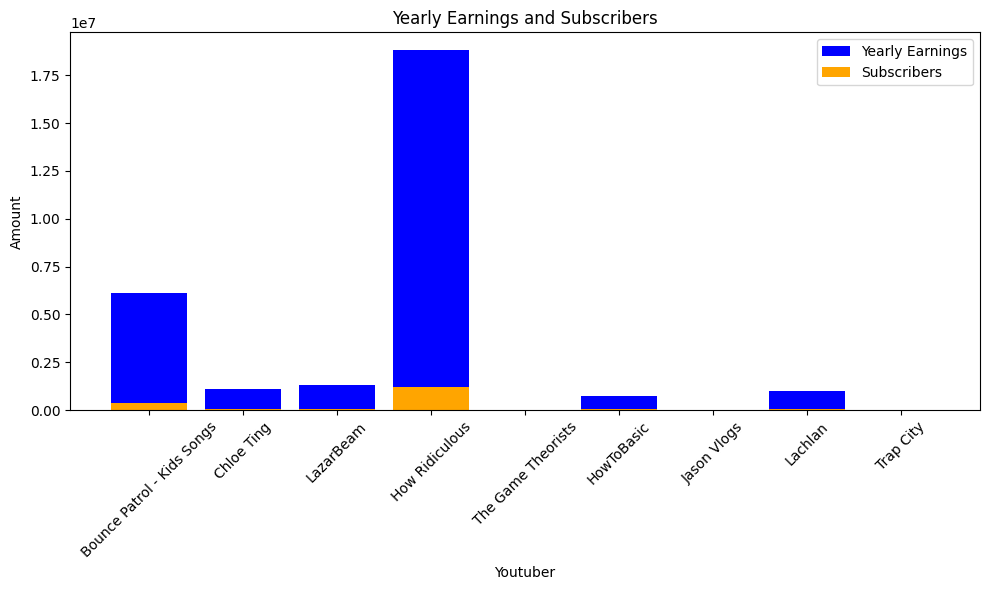

 33%|███▎      | 714/2160 [06:33<10:01,  2.40it/s]check
highest_yearly_earnings: 29400000.0, Subscribers: 1800000.0, Youtuber: El Reino Infantil
highest_yearly_earnings: 14500000.0, Subscribers: 906200.0, Youtuber: La Granja de Zenï¿½
highest_yearly_earnings: 9200000.0, Subscribers: 572000.0, Youtuber: TheDonato
highest_yearly_earnings: 0.72, Subscribers: 0.05, Youtuber: Maluma
highest_yearly_earnings: 19300000.0, Subscribers: 1200000.0, Youtuber: Alejo Igoa
highest_yearly_earnings: 1700000.0, Subscribers: 106600.0, Youtuber: DrossRotzank
highest_yearly_earnings: 3500000.0, Subscribers: 216700.0, Youtuber: Paulo Londra
highest_yearly_earnings: 9300000.0, Subscribers: 579500.0, Youtuber: Bizarrap
highest_yearly_earnings: 1300000.0, Subscribers: 82600.0, Youtuber: RobleisIUTU
highest_yearly_earnings: 30700000.0, Subscribers: 1900000.0, Youtuber: El Payaso Plim Plim
highest_yearly_earnings: 4000000.0, Subscribers: 251100.0, Youtuber: El Reino a Jugar
highest_yearly_earnings: 3100000.0, Su

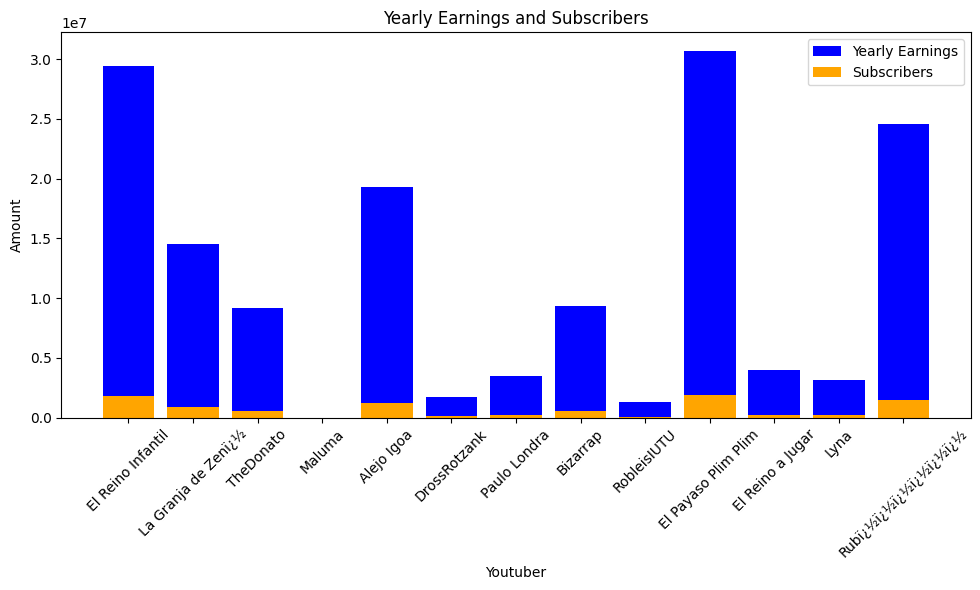

 33%|███▎      | 717/2160 [06:34<09:53,  2.43it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


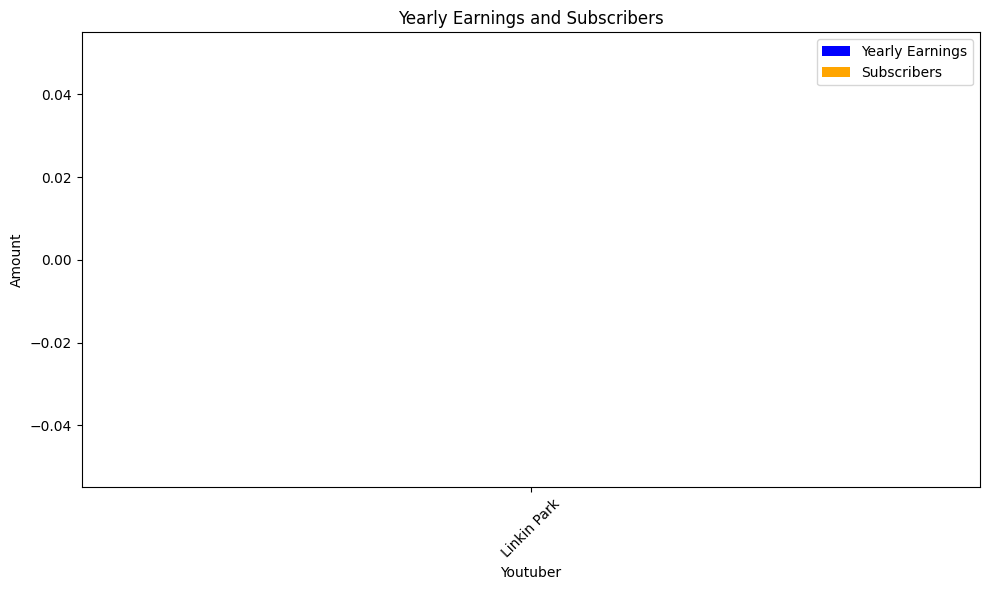

 33%|███▎      | 720/2160 [06:35<09:11,  2.61it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


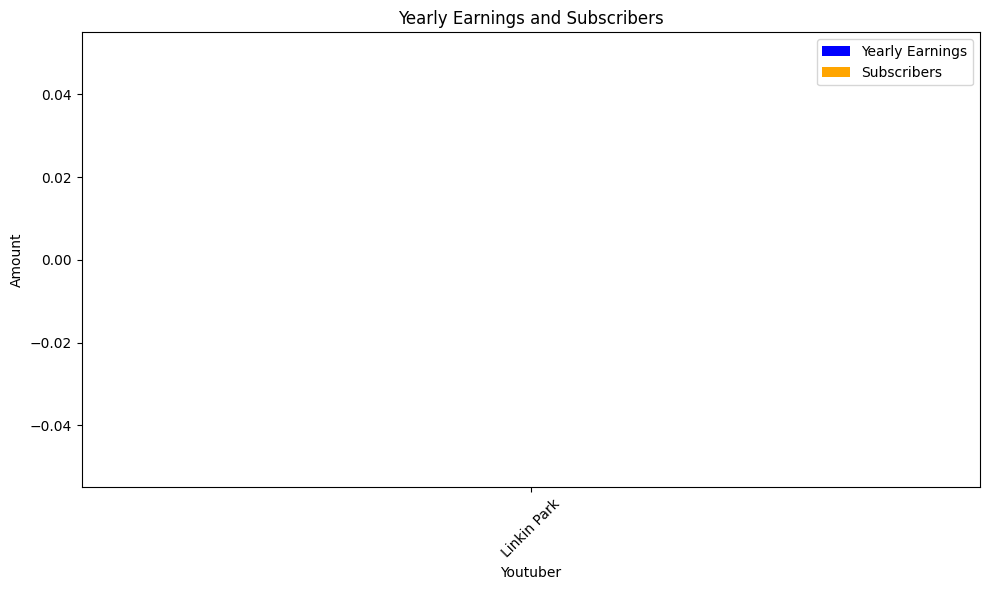

check
highest_yearly_earnings: 4100000.0, Subscribers: 253400.0, Youtuber: Like Nastya VNM
highest_yearly_earnings: 12300000.0, Subscribers: 770200.0, Youtuber: POPS Kids
highest_yearly_earnings: 1700000.0, Subscribers: 105400.0, Youtuber: FAPTV


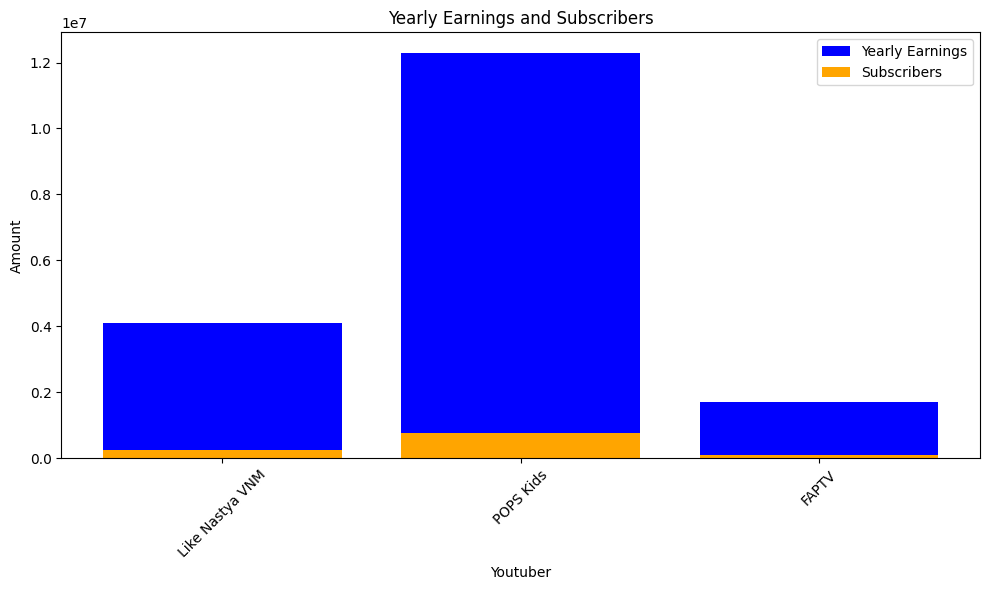

 33%|███▎      | 723/2160 [06:37<11:06,  2.15it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


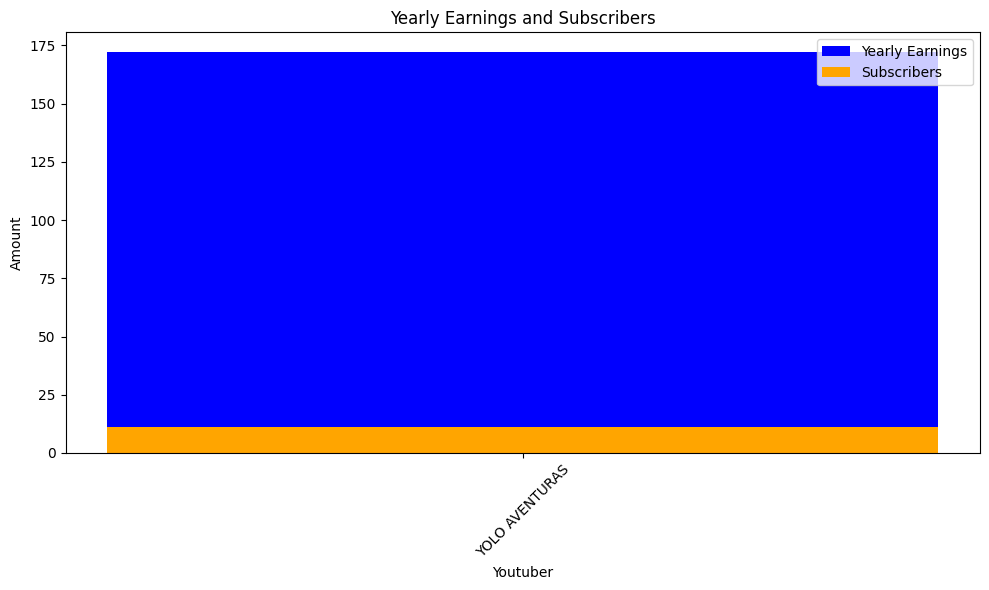

 34%|███▎      | 726/2160 [06:40<13:58,  1.71it/s]check
highest_yearly_earnings: 779.0, Subscribers: 49.0, Youtuber: SOMOY TV
highest_yearly_earnings: 9000000.0, Subscribers: 561000.0, Youtuber: CNN
highest_yearly_earnings: 8900000.0, Subscribers: 557100.0, Youtuber: ABC News


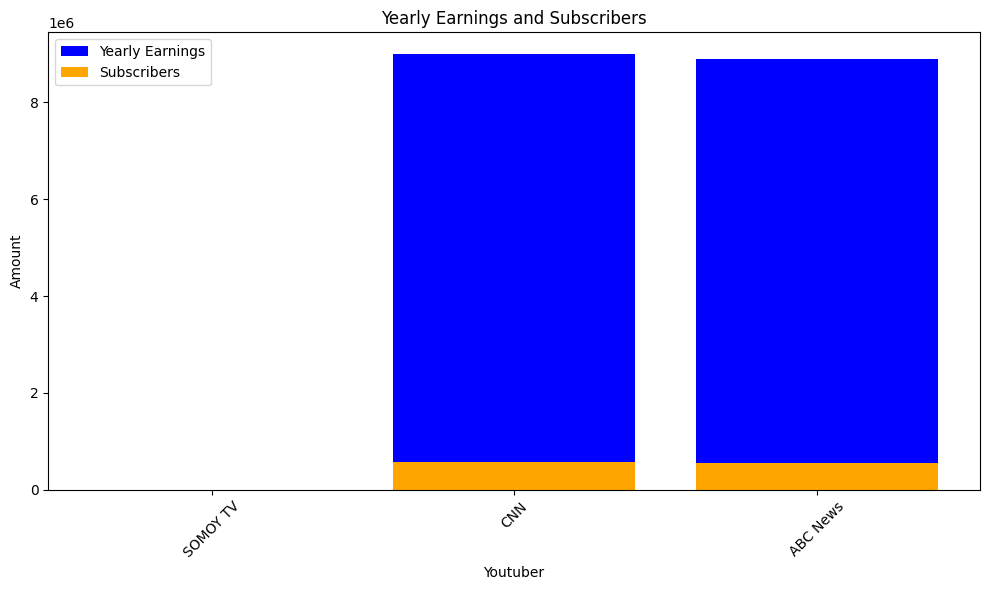

 34%|███▍      | 729/2160 [06:42<13:00,  1.83it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 198800.0, Youtuber: BBC News


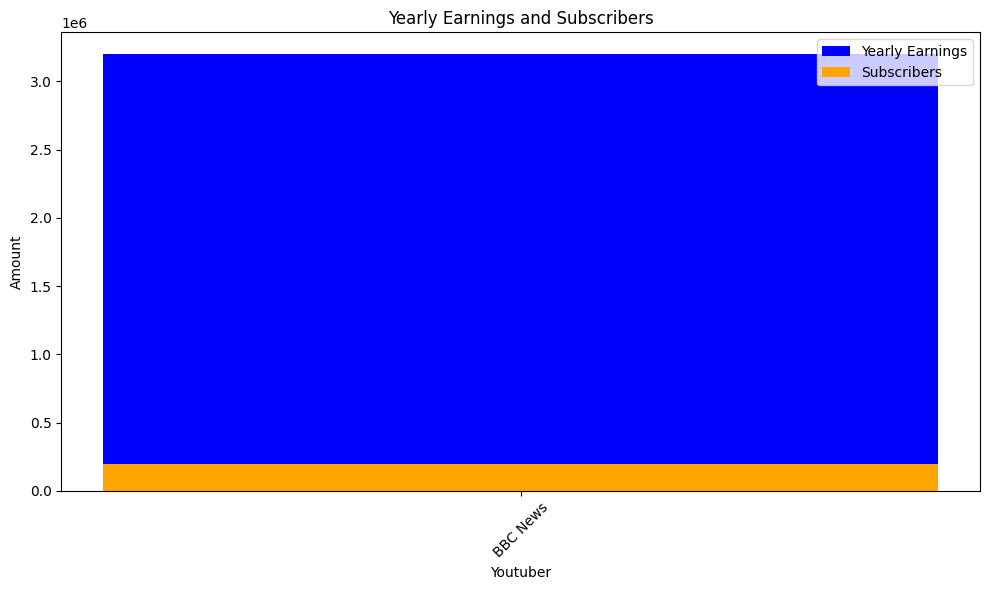

 34%|███▍      | 732/2160 [06:44<13:18,  1.79it/s]check
highest_yearly_earnings: 3900000.0, Subscribers: 240700.0, Youtuber: AlArabiya ï¿½ï¿½ï¿½ï¿½ï¿


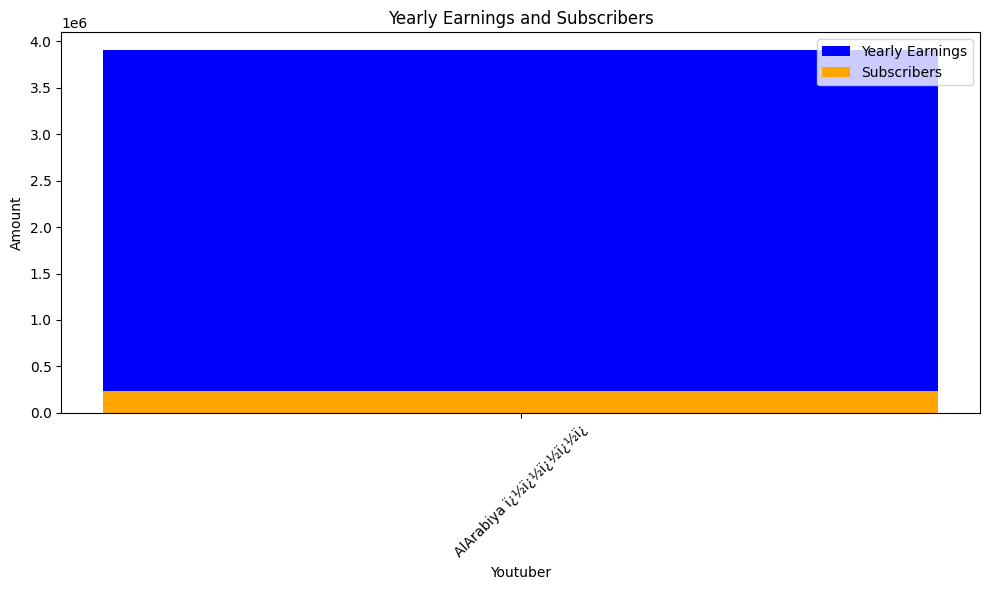

 34%|███▍      | 735/2160 [06:45<11:39,  2.04it/s]check
highest_yearly_earnings: 17800000.0, Subscribers: 1100000.0, Youtuber: News 24


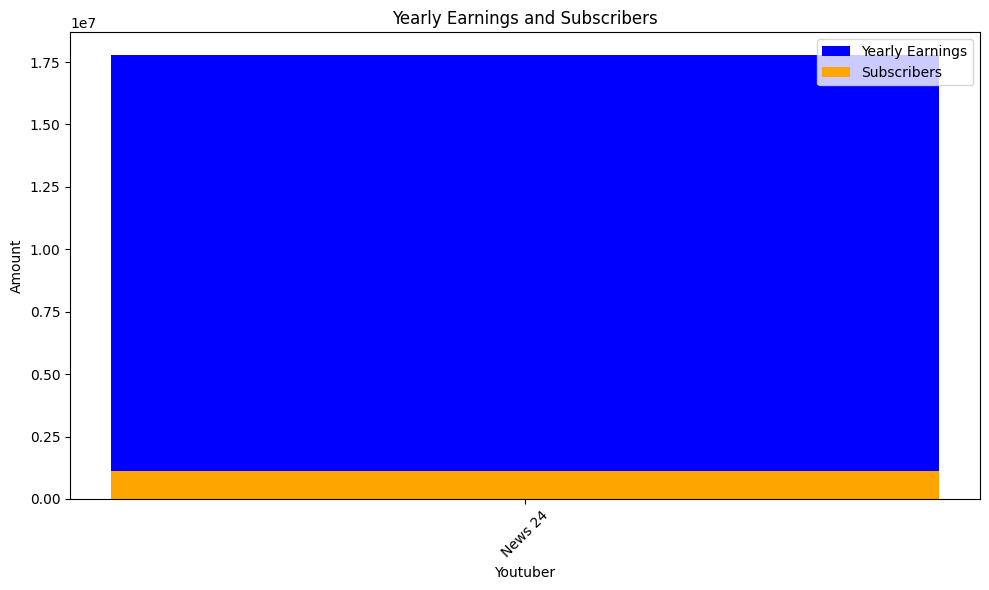

 34%|███▍      | 738/2160 [06:47<10:23,  2.28it/s]check
highest_yearly_earnings: 70200000.0, Subscribers: 4400000.0, Youtuber: BETER Bï¿½ï¿½
highest_yearly_earnings: 20400000.0, Subscribers: 1300000.0, Youtuber: netd mï¿½ï¿
highest_yearly_earnings: 5300000.0, Subscribers: 332400.0, Youtuber: tabii Urdu
highest_yearly_earnings: 212500.0, Subscribers: 13300.0, Youtuber: Oyuncak Avï¿


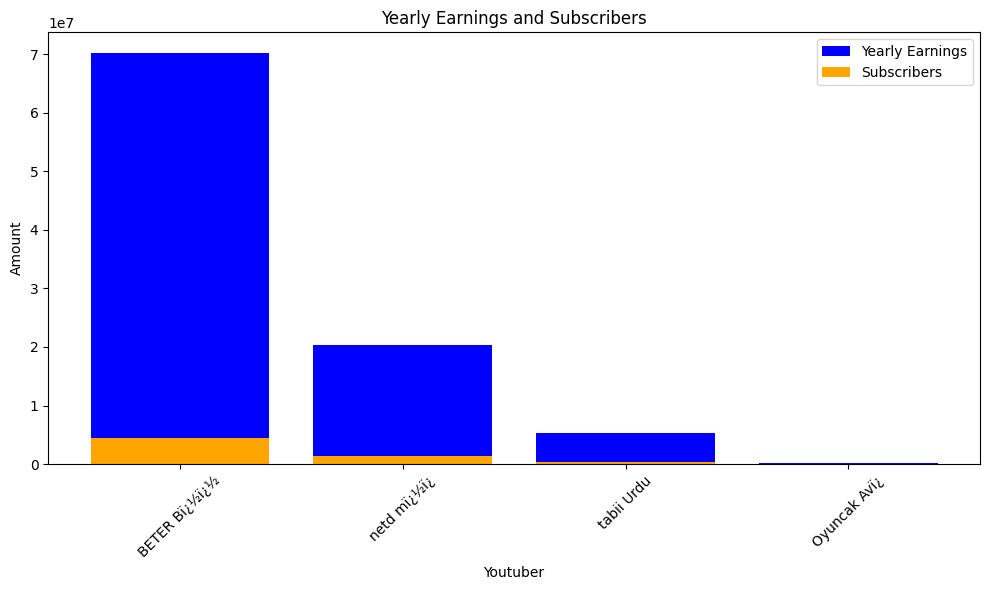

 34%|███▍      | 741/2160 [06:48<09:37,  2.46it/s]check
highest_yearly_earnings: 11300000.0, Subscribers: 708000.0, Youtuber: AMARINTV : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 10800000.0, Subscribers: 674300.0, Youtuber: Thairath Online


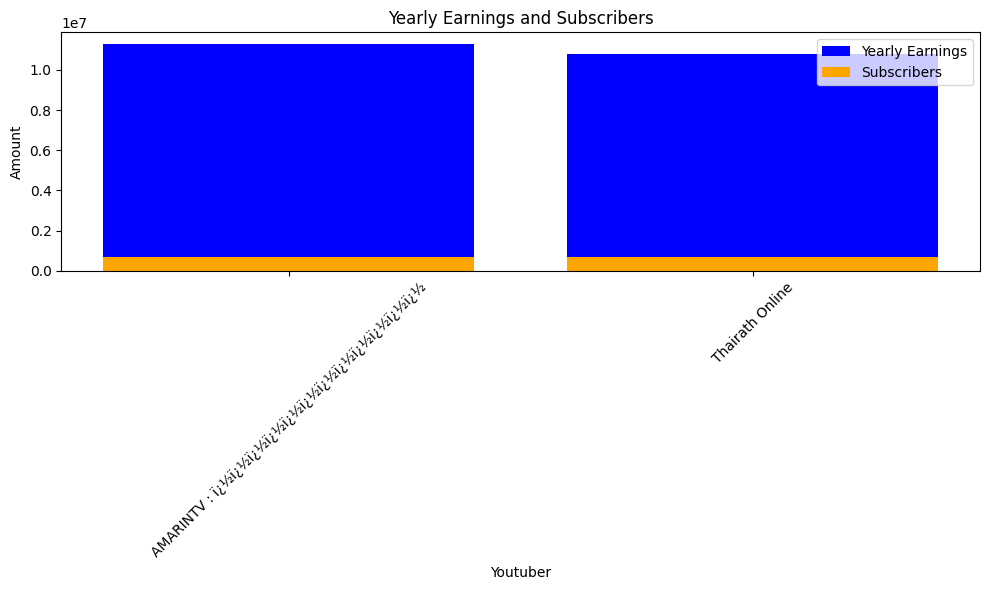

 34%|███▍      | 744/2160 [06:50<09:28,  2.49it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


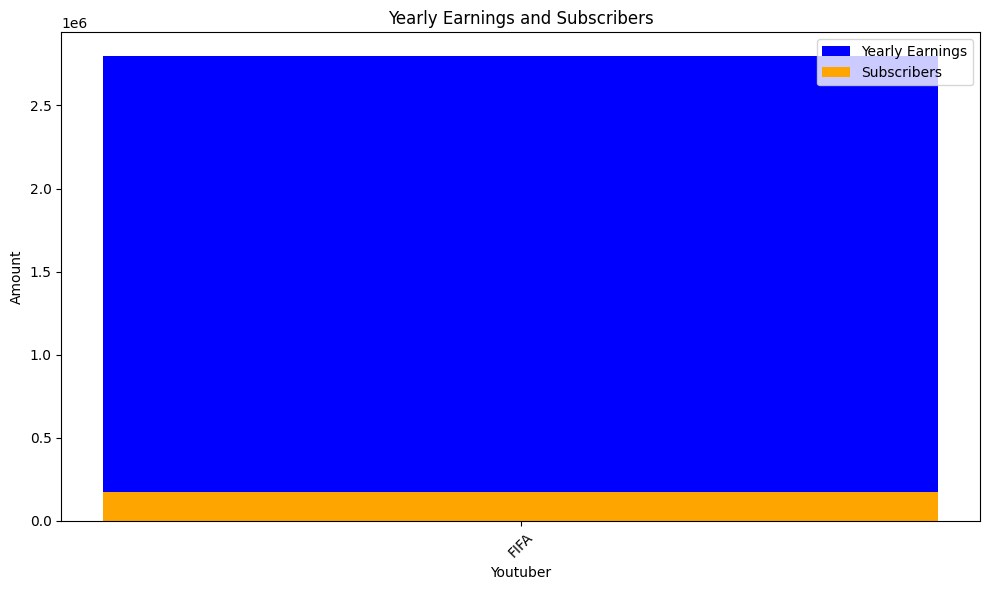

 35%|███▍      | 747/2160 [06:51<09:11,  2.56it/s]check
highest_yearly_earnings: 3900000.0, Subscribers: 243700.0, Youtuber: Avicii
highest_yearly_earnings: 23000000.0, Subscribers: 1400000.0, Youtuber: Panda Shorts
highest_yearly_earnings: 658000.0, Subscribers: 41100.0, Youtuber: Narins Beauty
highest_yearly_earnings: 185800.0, Subscribers: 11600.0, Youtuber: RobTopGames


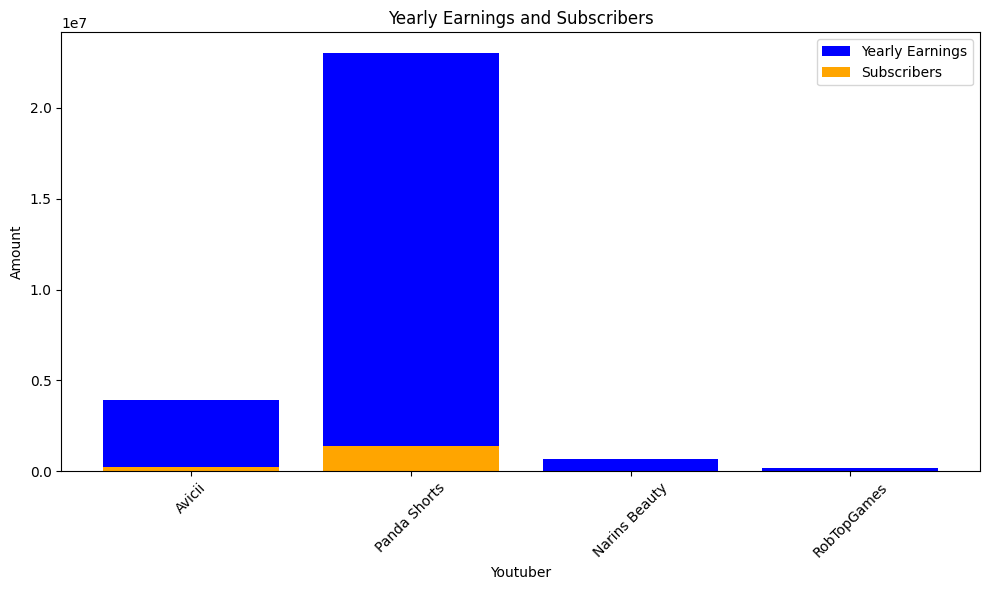

 35%|███▍      | 750/2160 [06:53<09:34,  2.45it/s]check
highest_yearly_earnings: 12700000.0, Subscribers: 792300.0, Youtuber: Mikecrack
highest_yearly_earnings: 1900000.0, Subscribers: 117300.0, Youtuber: VEGETTA777
highest_yearly_earnings: 582900.0, Subscribers: 36400.0, Youtuber: AuronPlay
highest_yearly_earnings: 5.0, Subscribers: 0.31, Youtuber: CKN
highest_yearly_earnings: 528200.0, Subscribers: 33000.0, Youtuber: TheWillyrex
highest_yearly_earnings: 2100000.0, Subscribers: 131500.0, Youtuber: TheGrefg
highest_yearly_earnings: 739500.0, Subscribers: 46200.0, Youtuber: Willyrex
highest_yearly_earnings: 3100.0, Subscribers: 196.0, Youtuber: IDEAS EN 5 MINUTOS
highest_yearly_earnings: 0.19, Subscribers: 0.01, Youtuber: AdMe
highest_yearly_earnings: 4100000.0, Subscribers: 254600.0, Youtuber: FC Barcelona
highest_yearly_earnings: 286600.0, Subscribers: 17900.0, Youtuber: Makiman131
highest_yearly_earnings: 665200.0, Subscribers: 41600.0, Youtuber: iTownGamePlay *Terror&Diversiï¿½ï
hig

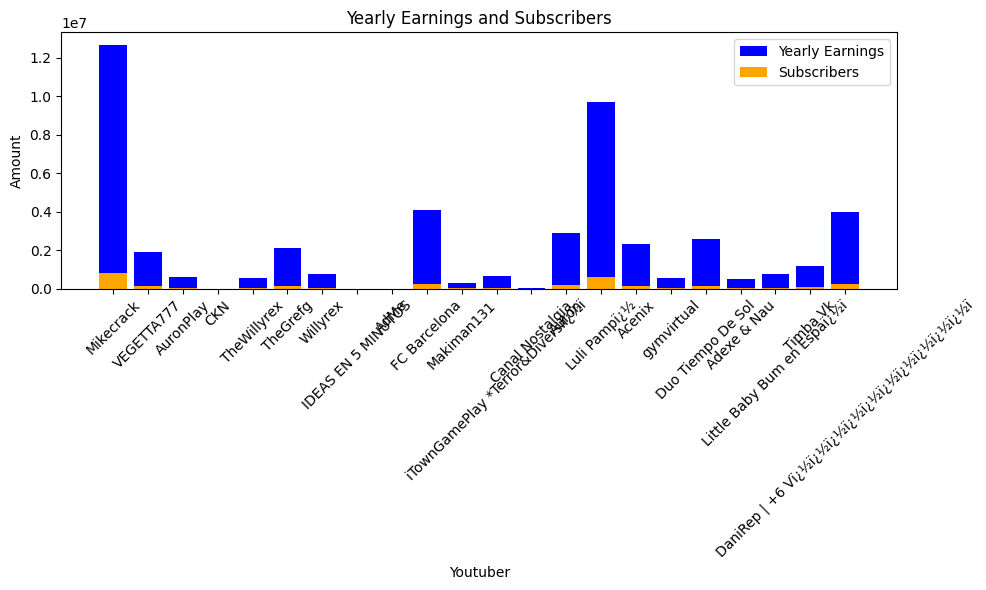

 35%|███▍      | 753/2160 [06:54<10:21,  2.26it/s]check
highest_yearly_earnings: 23900000.0, Subscribers: 1500000.0, Youtuber: BLACKPINK
highest_yearly_earnings: 8100000.0, Subscribers: 504900.0, Youtuber: BANGTANTV
highest_yearly_earnings: 28700000.0, Subscribers: 1800000.0, Youtuber: HYBE LABELS
highest_yearly_earnings: 14800000.0, Subscribers: 922900.0, Youtuber: JYP Entertainment
highest_yearly_earnings: 5100000.0, Subscribers: 316700.0, Youtuber: 1theK (ï¿½ï¿½ï¿½ï¿½ï
highest_yearly_earnings: 7600000.0, Subscribers: 475600.0, Youtuber: Mnet K-POP
highest_yearly_earnings: 5200000.0, Subscribers: 324000.0, Youtuber: KBS WORLD TV
highest_yearly_earnings: 3100000.0, Subscribers: 195000.0, Youtuber: officialpsy
highest_yearly_earnings: 163400000.0, Subscribers: 10200000.0, Youtuber: ýýýýýýýýý KIMPRO
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Jane ASMR ï¿½ï¿½
highest_yearly_earnings: 532700.0, Subscribers: 33300.0, Youtuber: JFlaMusic
highest_yearly_earnings: 2000000.0, Su

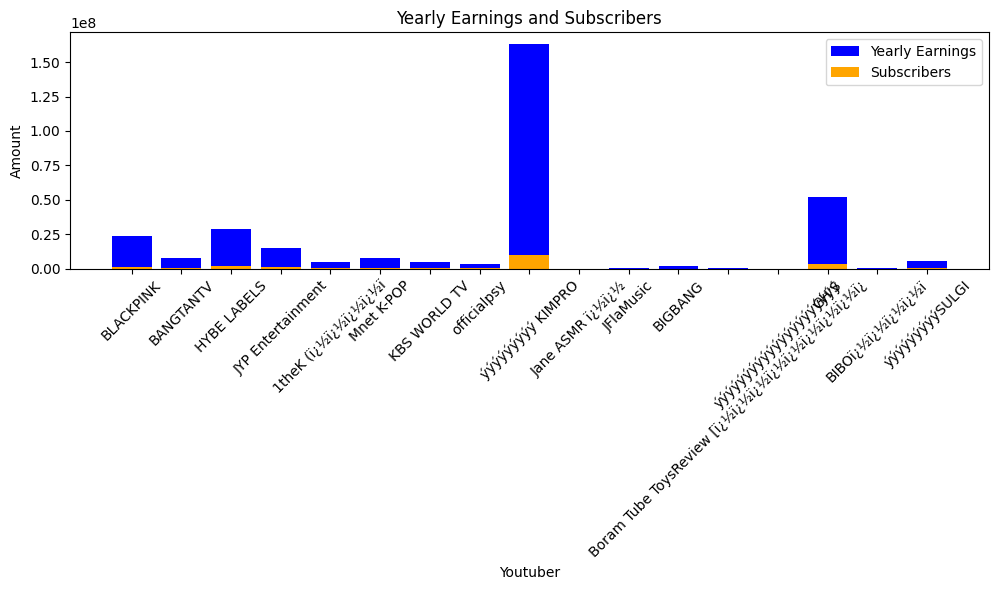

 35%|███▌      | 756/2160 [06:56<12:18,  1.90it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Sandeep Maheshwari
highest_yearly_earnings: 5600000.0, Subscribers: 351600.0, Youtuber: LEGO
highest_yearly_earnings: 45100.0, Subscribers: 2800.0, Youtuber: MY FAMILY


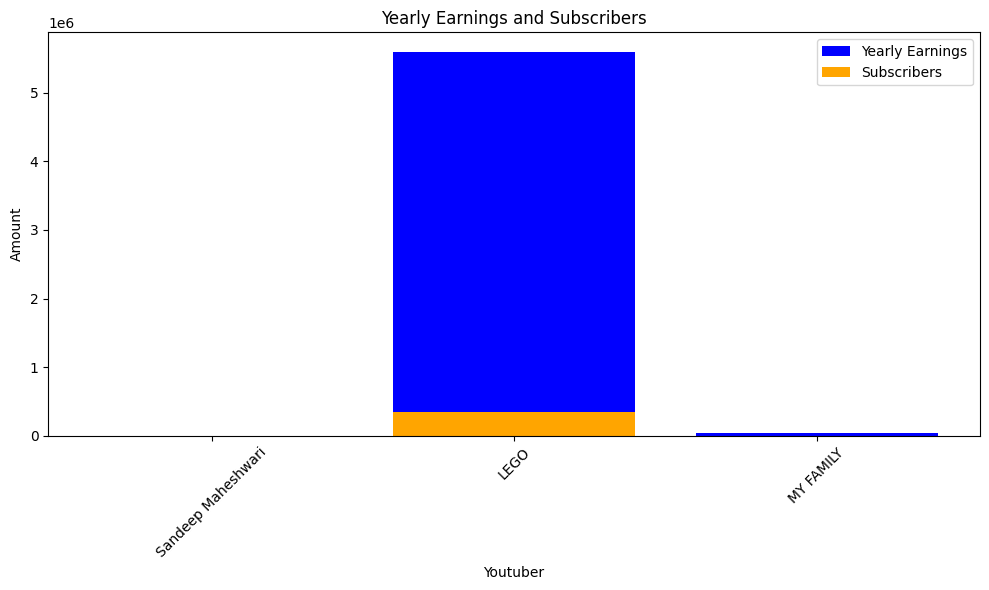

 35%|███▌      | 759/2160 [06:58<12:39,  1.84it/s]check
highest_yearly_earnings: 76300.0, Subscribers: 4800.0, Youtuber: shfa
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: 1MILLION Dance Studio
highest_yearly_earnings: 3500000.0, Subscribers: 221500.0, Youtuber: mmoshaya
highest_yearly_earnings: 2100000.0, Subscribers: 129000.0, Youtuber: ýýýýýýýý ýýýýýýýýýý ýýýýýýýýýý | Arab Games Network
highest_yearly_earnings: 4400000.0, Subscribers: 272700.0, Youtuber: Katakit Baby TV
highest_yearly_earnings: 6500000.0, Subscribers: 405100.0, Youtuber: ýýýýýýýý ýý ýýýýýýýý
highest_yearly_earnings: 129300.0, Subscribers: 8100.0, Youtuber: ýýýýýýýýýý ýýýýýýýýýýýý
highest_yearly_earnings: 224300.0, Subscribers: 14000.0, Youtuber: ýýýýýýýýýýýý ýýýýýýýýýýýý I ýýýýýý ýý ýýýýýýýýýý
highest_yearly_earnings: 3400000.0, Subscribers: 212100.0, Youtuber: BanderitaX


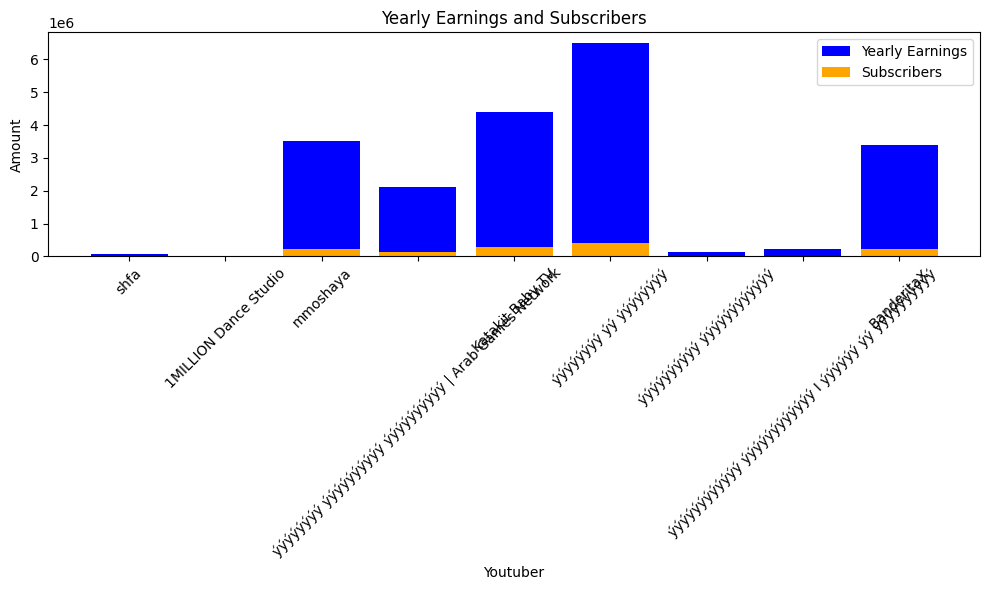

 35%|███▌      | 762/2160 [07:01<14:00,  1.66it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


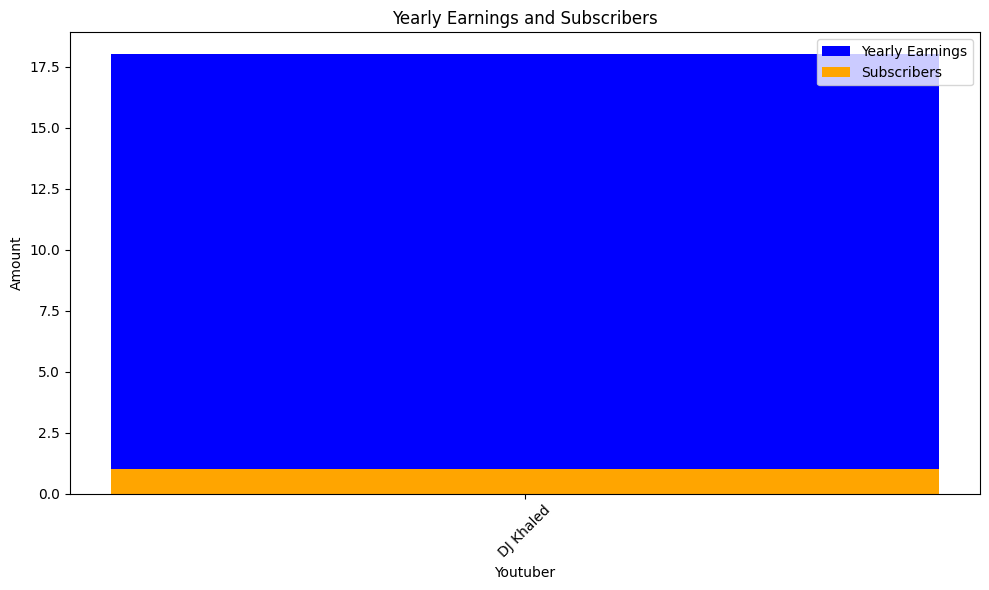

 35%|███▌      | 765/2160 [07:02<11:43,  1.98it/s]check
highest_yearly_earnings: 369.0, Subscribers: 23.0, Youtuber: ýýýýýý


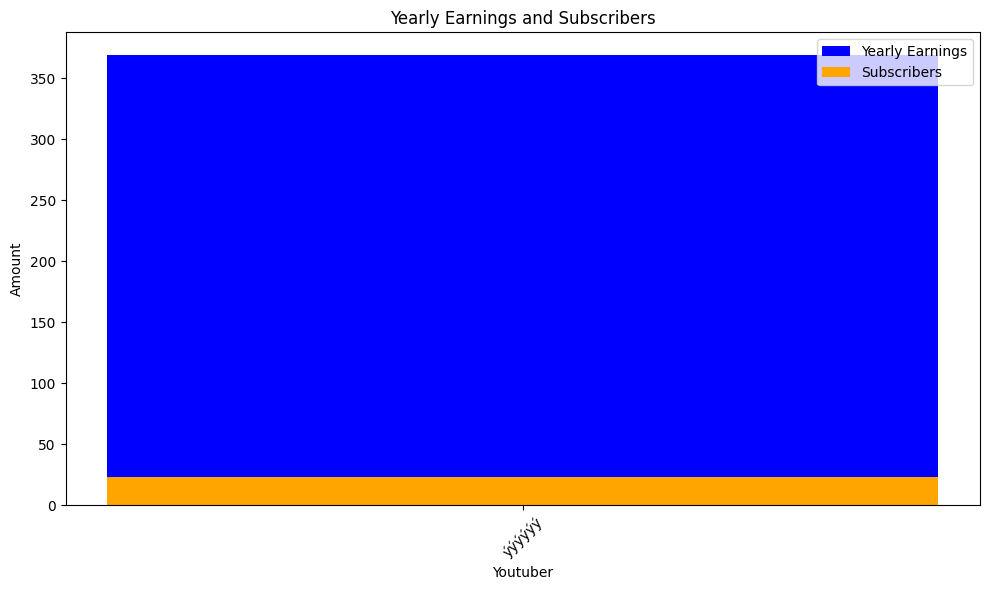

 36%|███▌      | 768/2160 [07:04<10:18,  2.25it/s]check
highest_yearly_earnings: 7800000.0, Subscribers: 489400.0, Youtuber: Raffy Tulfo in Action
highest_yearly_earnings: 6800000.0, Subscribers: 427000.0, Youtuber: GMA Public  Affairs
highest_yearly_earnings: 8700000.0, Subscribers: 544900.0, Youtuber: ABS-CBN News
highest_yearly_earnings: 5500000.0, Subscribers: 346400.0, Youtuber: GMA Integrated News


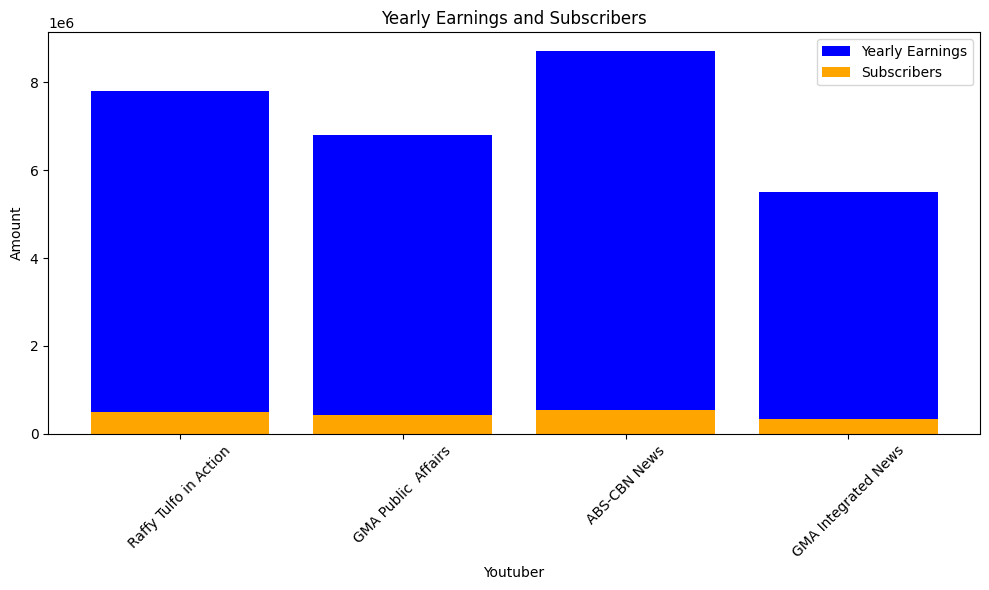

 36%|███▌      | 771/2160 [07:05<09:55,  2.33it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


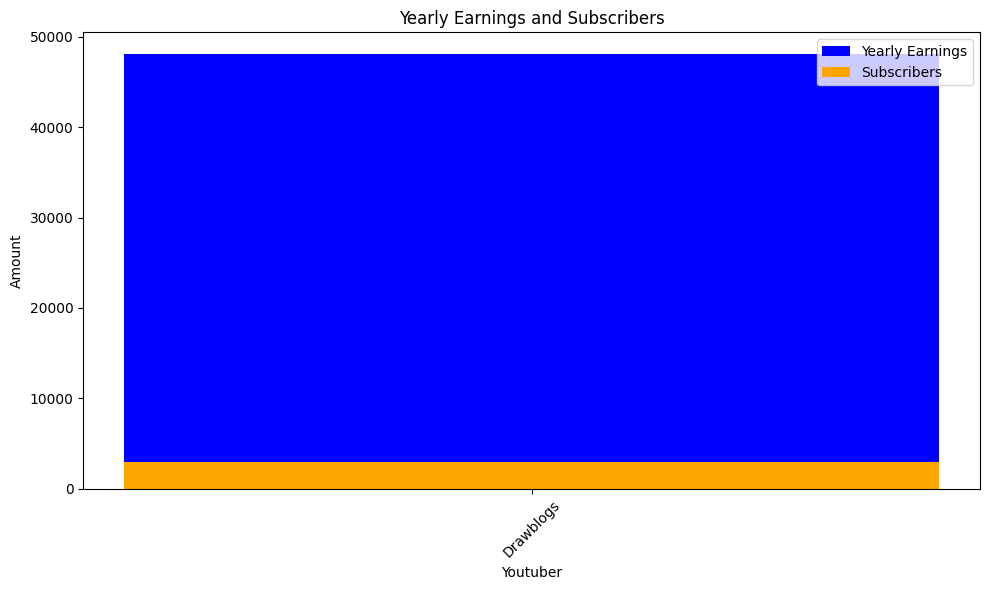

 36%|███▌      | 774/2160 [07:07<09:19,  2.48it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300200.0, Youtuber: Geo News


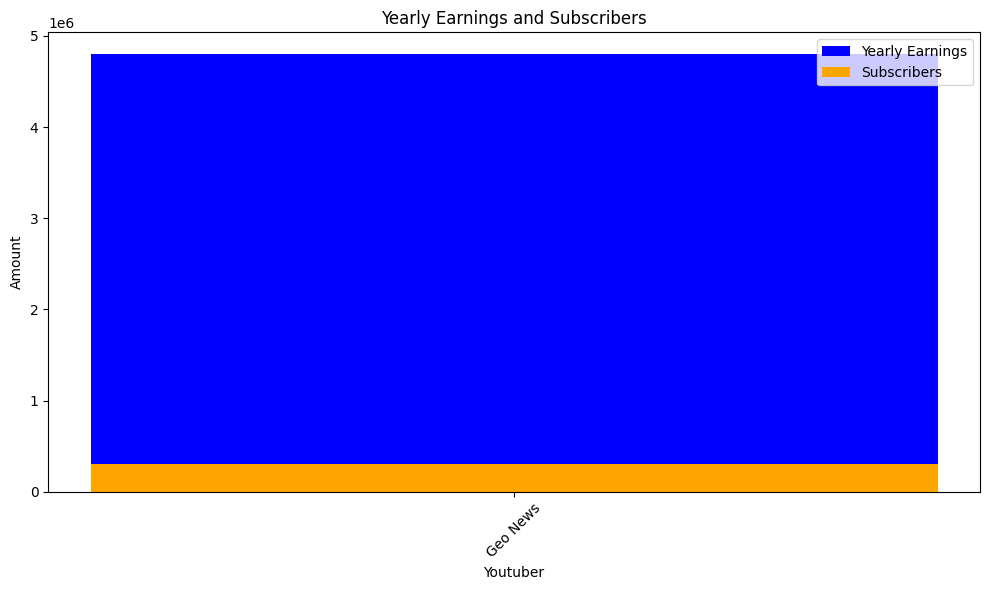

 36%|███▌      | 777/2160 [07:08<09:29,  2.43it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300100.0, Youtuber: Spinnin' Records
highest_yearly_earnings: 1700000.0, Subscribers: 107800.0, Youtuber: NikkieTutorials
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: ýýýýýýýý/Atro


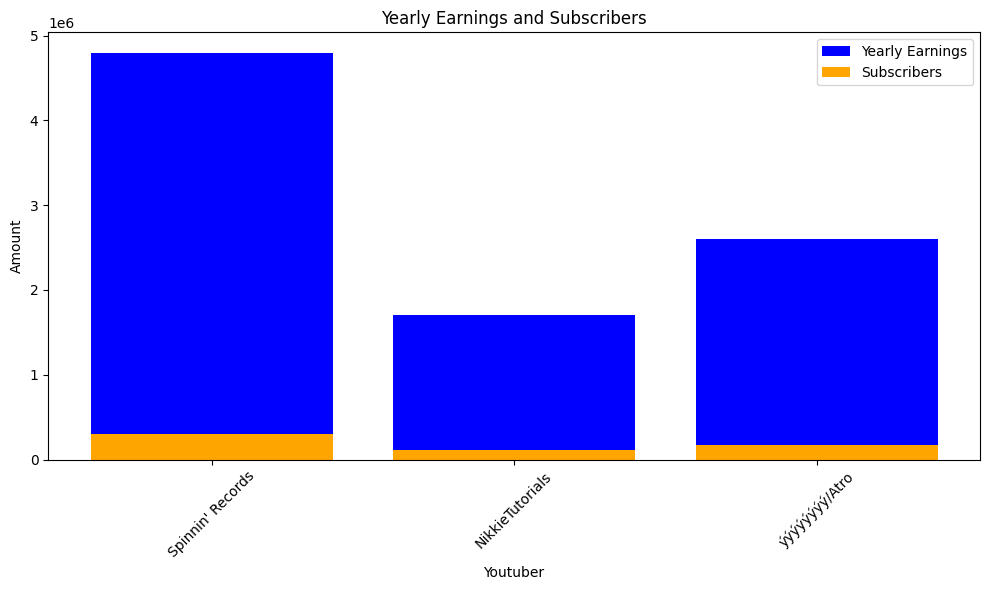

 36%|███▌      | 780/2160 [07:10<09:57,  2.31it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


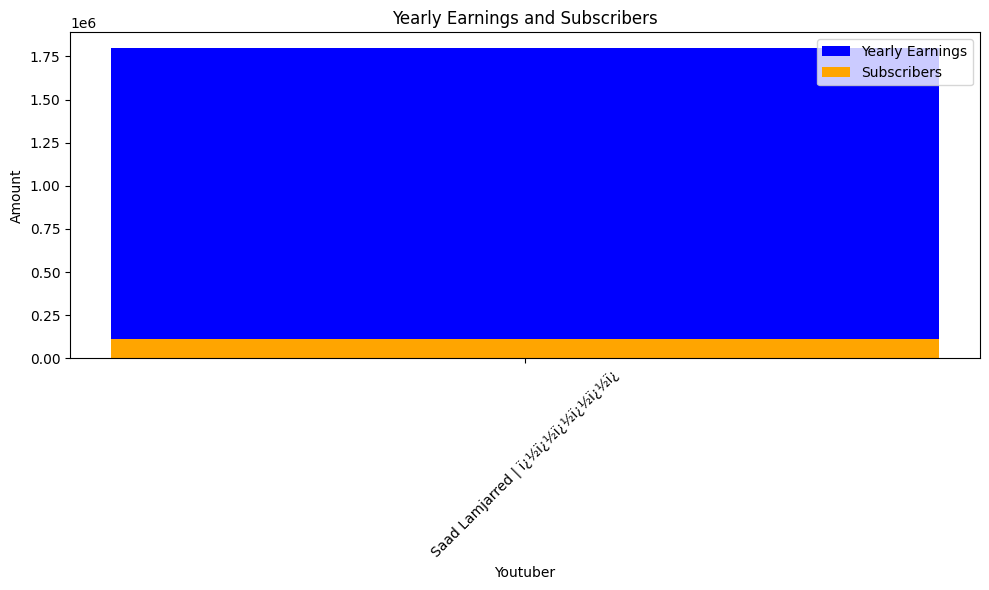

 36%|███▋      | 783/2160 [07:12<13:03,  1.76it/s]check
highest_yearly_earnings: 6600000.0, Subscribers: 410200.0, Youtuber: Kimberly Loaiza
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Luisito Comunica
highest_yearly_earnings: 1500000.0, Subscribers: 94400.0, Youtuber: GENIAL
highest_yearly_earnings: 1500000.0, Subscribers: 91500.0, Youtuber: LosPolinesios
highest_yearly_earnings: 16100.0, Subscribers: 1000.0, Youtuber: Yuya
highest_yearly_earnings: 1600000.0, Subscribers: 100800.0, Youtuber: MrBeast en Espaï¿½ï
highest_yearly_earnings: 2200000.0, Subscribers: 140600.0, Youtuber: Juan De Dios Pantoja
highest_yearly_earnings: 6600000.0, Subscribers: 410500.0, Youtuber: BabyBus - Canciones Infantiles & Videos para Niï¿½ï
highest_yearly_earnings: 227.0, Subscribers: 14.0, Youtuber: Disney Latinoamï¿½ï¿½
highest_yearly_earnings: 742.0, Subscribers: 46.0, Youtuber: Tlnovelas
highest_yearly_earnings: 114300.0, Subscribers: 7100.0, Youtuber: JukiLop
highest_yearly_earnings: 5900

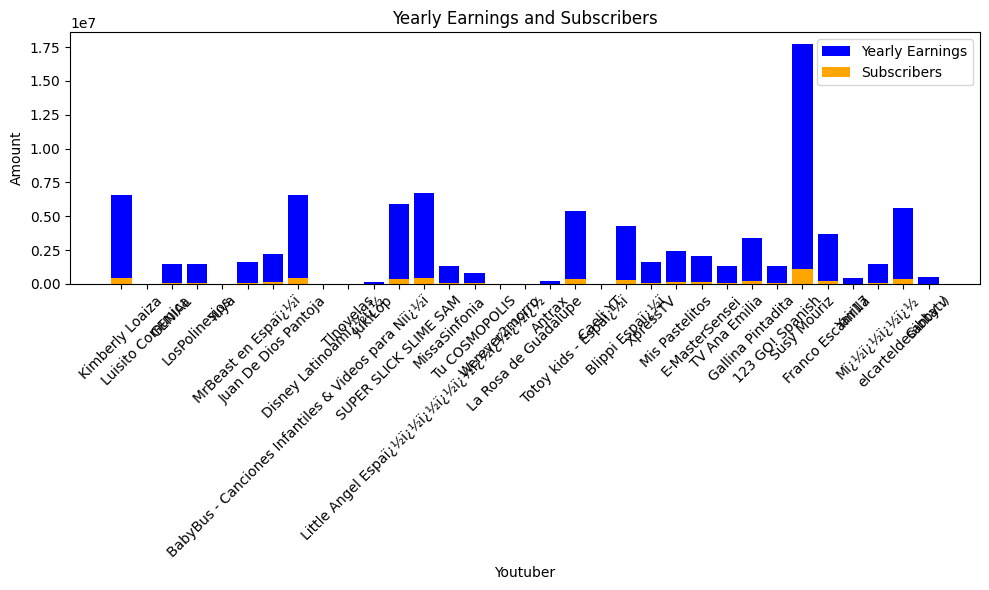

 36%|███▋      | 786/2160 [07:15<14:52,  1.54it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


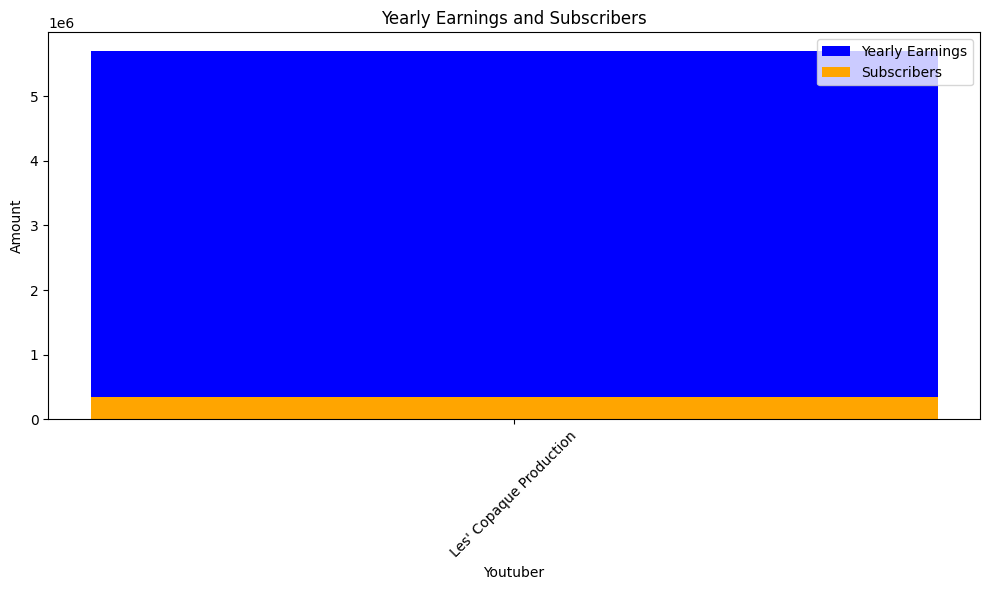

 37%|███▋      | 789/2160 [07:17<16:07,  1.42it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


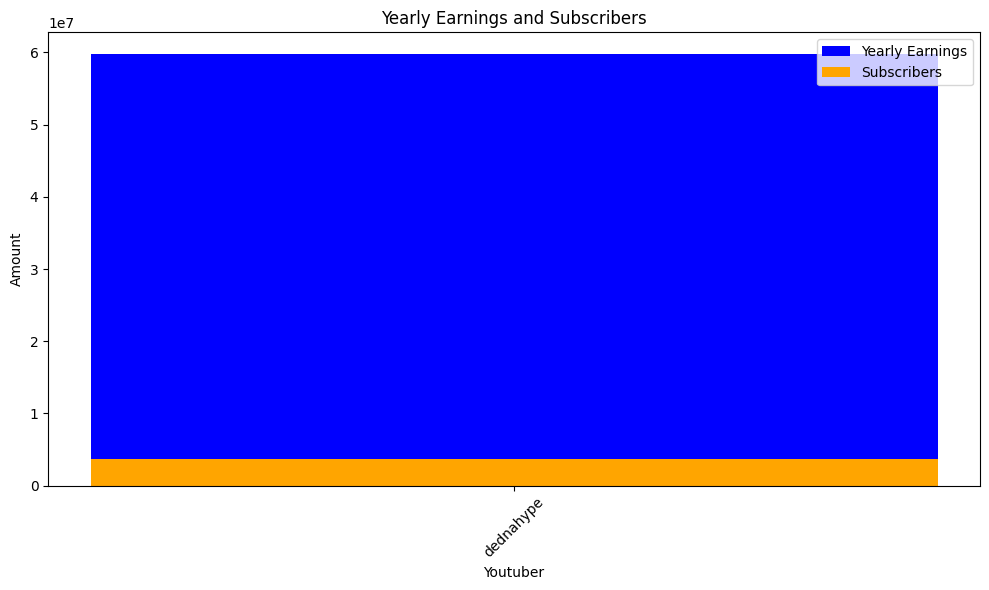

 37%|███▋      | 792/2160 [07:19<11:52,  1.92it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


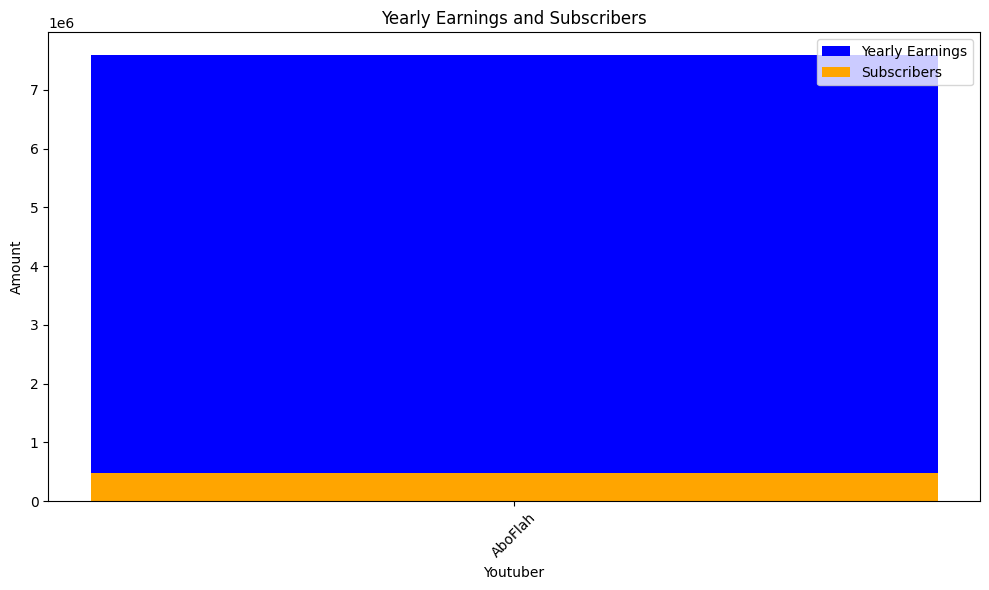

 37%|███▋      | 795/2160 [07:21<10:19,  2.20it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


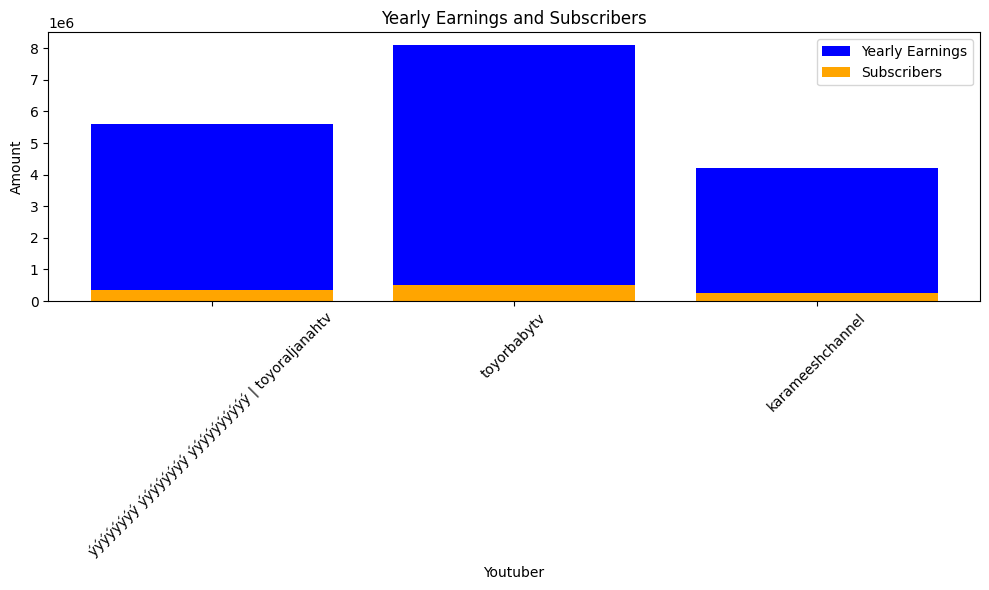

 37%|███▋      | 798/2160 [07:22<10:02,  2.26it/s]check
highest_yearly_earnings: 1900000.0, Subscribers: 117600.0, Youtuber: PewDiePie
highest_yearly_earnings: 34600000.0, Subscribers: 2200000.0, Youtuber: Junya.ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 34100000.0, Subscribers: 2100000.0, Youtuber: Sagawa /ï¿½ï¿½ï¿½
highest_yearly_earnings: 13600000.0, Subscribers: 847100.0, Youtuber: ISSEI / ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 119.0, Subscribers: 7.0, Youtuber: Bayashi TV


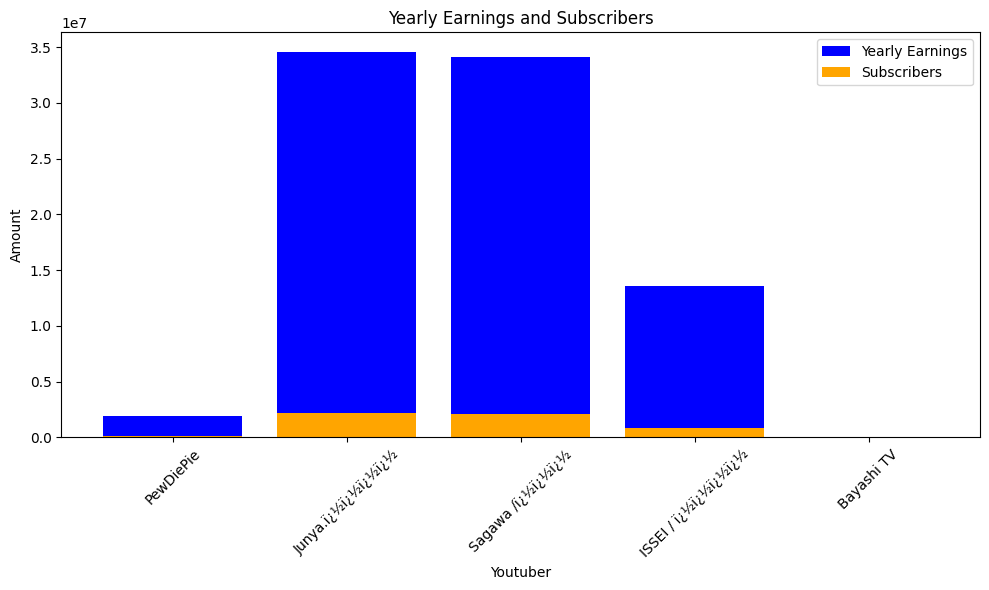

 37%|███▋      | 801/2160 [07:24<09:42,  2.33it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


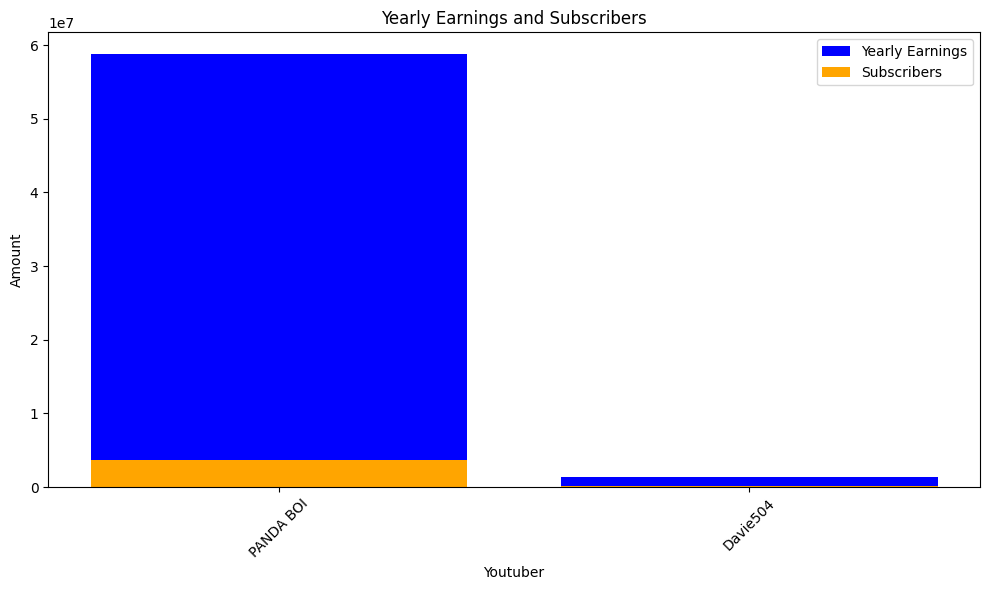

 37%|███▋      | 804/2160 [07:25<09:23,  2.41it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


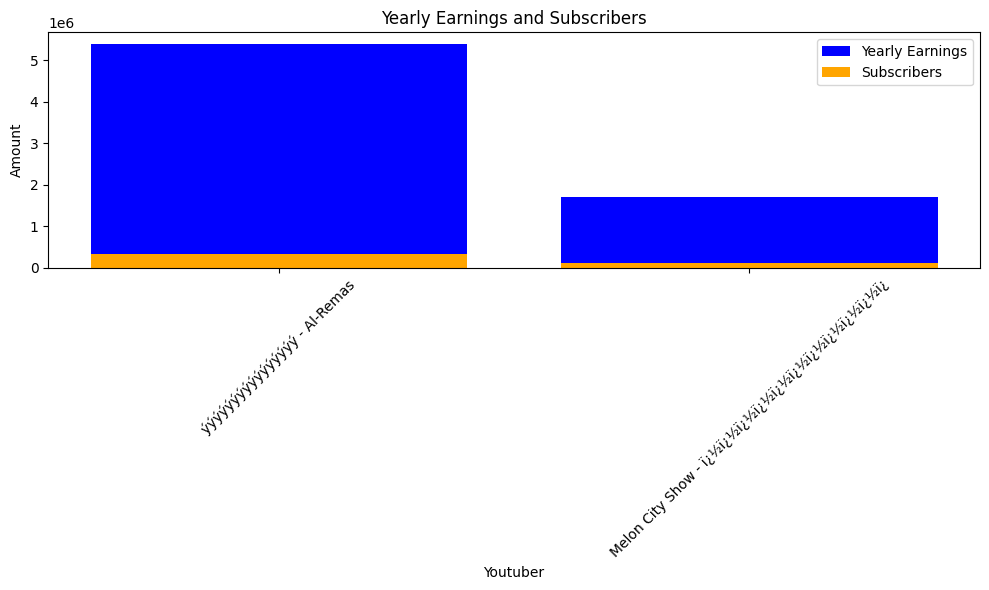

 37%|███▋      | 807/2160 [07:26<09:12,  2.45it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339200.0, Youtuber: KOMPASTV


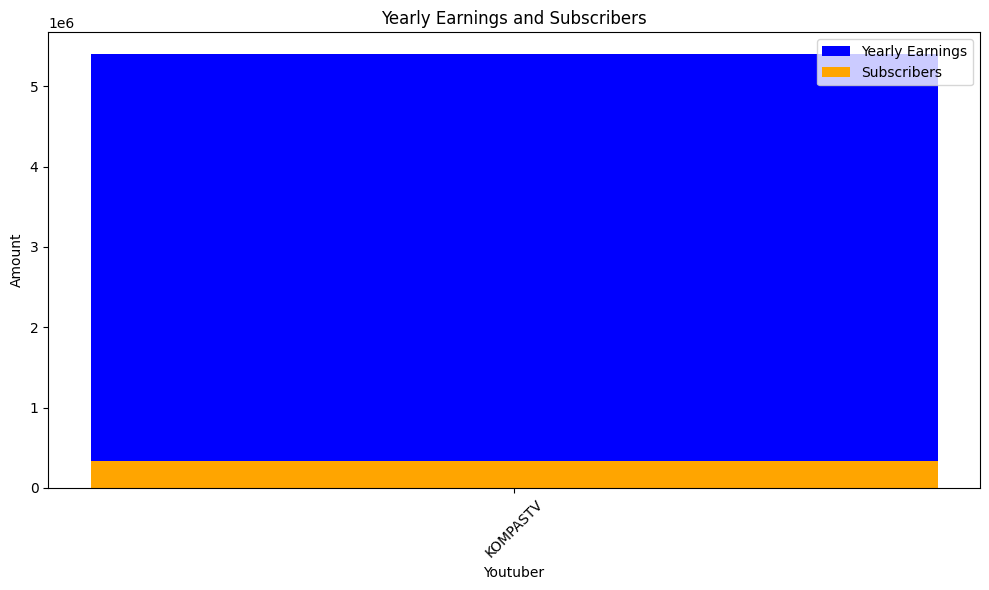

 38%|███▊      | 810/2160 [07:28<09:23,  2.39it/s]check
highest_yearly_earnings: 22100000.0, Subscribers: 1400000.0, Youtuber: Aaj Tak
highest_yearly_earnings: 12800000.0, Subscribers: 801200.0, Youtuber: ABP NEWS
highest_yearly_earnings: 14000000.0, Subscribers: 872500.0, Youtuber: IndiaTV
highest_yearly_earnings: 22200000.0, Subscribers: 1400000.0, Youtuber: Zee News
highest_yearly_earnings: 13100000.0, Subscribers: 821800.0, Youtuber: The Lallantop
highest_yearly_earnings: 1500000.0, Subscribers: 96300.0, Youtuber: DLS News
highest_yearly_earnings: 18900000.0, Subscribers: 1200000.0, Youtuber: News18 India
highest_yearly_earnings: 2800000.0, Subscribers: 177600.0, Youtuber: NMF News
highest_yearly_earnings: 6300000.0, Subscribers: 393600.0, Youtuber: BBC News Hindi
highest_yearly_earnings: 8900000.0, Subscribers: 557900.0, Youtuber: Narendra Modi
highest_yearly_earnings: 2400000.0, Subscribers: 149000.0, Youtuber: NDTV India
highest_yearly_earnings: 48.0, Subscribers: 3.0, Youtuber:

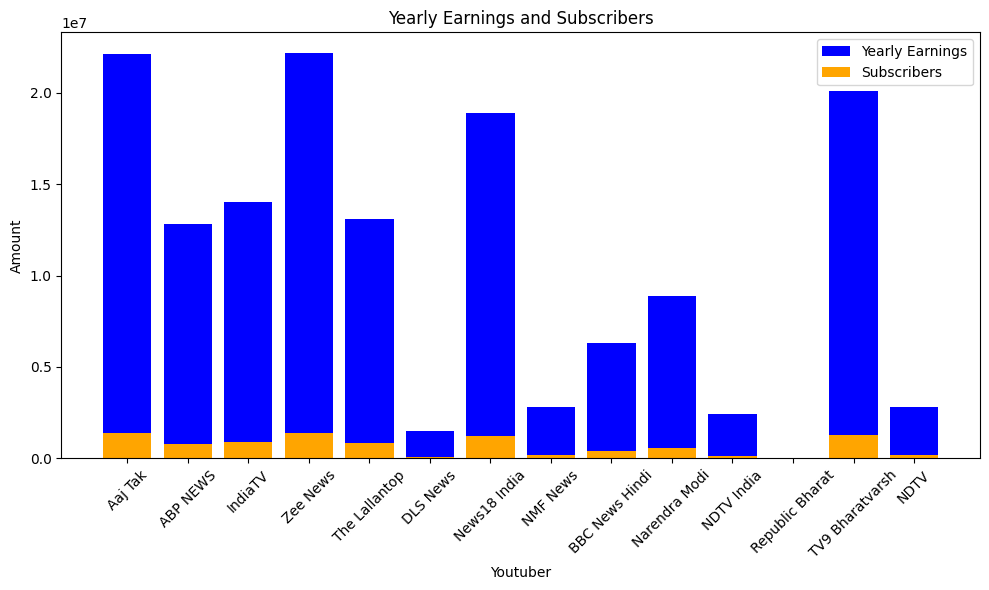

 38%|███▊      | 813/2160 [07:30<10:30,  2.14it/s]check
highest_yearly_earnings: 36300000.0, Subscribers: 2300000.0, Youtuber: Tsuriki Show
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: YOLO
highest_yearly_earnings: 1400000.0, Subscribers: 87800.0, Youtuber: Kurzgesagt ï¿½ï¿½ï¿½ï¿½ï¿½ï¿
highest_yearly_earnings: 271200.0, Subscribers: 17000.0, Youtuber: HaerteTest
highest_yearly_earnings: 29600000.0, Subscribers: 1900000.0, Youtuber: Younes Zarou
highest_yearly_earnings: 1800.0, Subscribers: 114.0, Youtuber: Beast Philanthropy


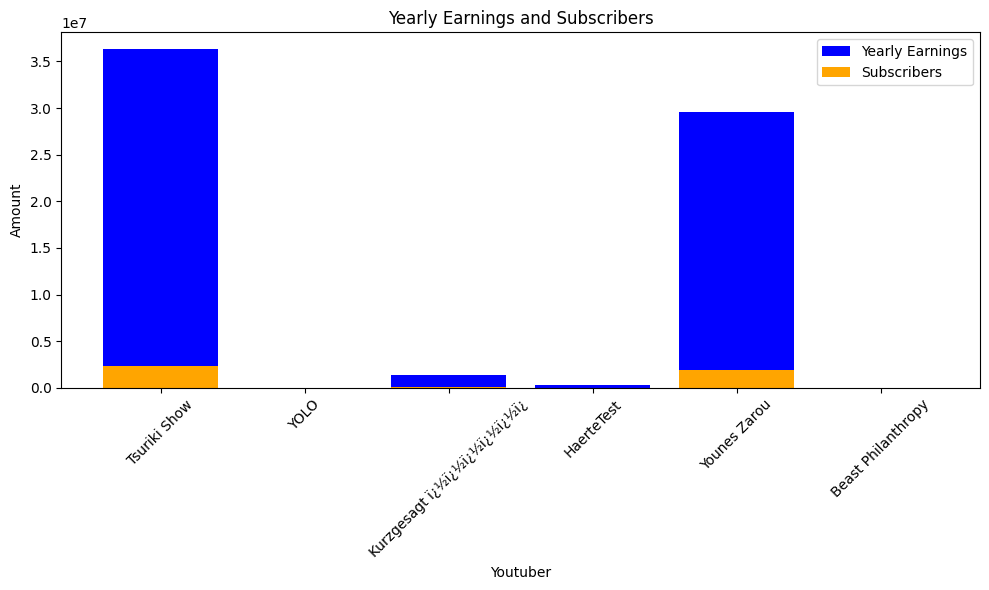

 38%|███▊      | 816/2160 [07:32<11:21,  1.97it/s]check
highest_yearly_earnings: 35.0, Subscribers: 2.0, Youtuber: Smile Family
highest_yearly_earnings: 2300000.0, Subscribers: 144300.0, Youtuber: SQUEEZIE
highest_yearly_earnings: 37.0, Subscribers: 2.0, Youtuber: FitDance
highest_yearly_earnings: 548000.0, Subscribers: 34300.0, Youtuber: Cyprien
highest_yearly_earnings: 1500000.0, Subscribers: 91400.0, Youtuber: Lofi Girl


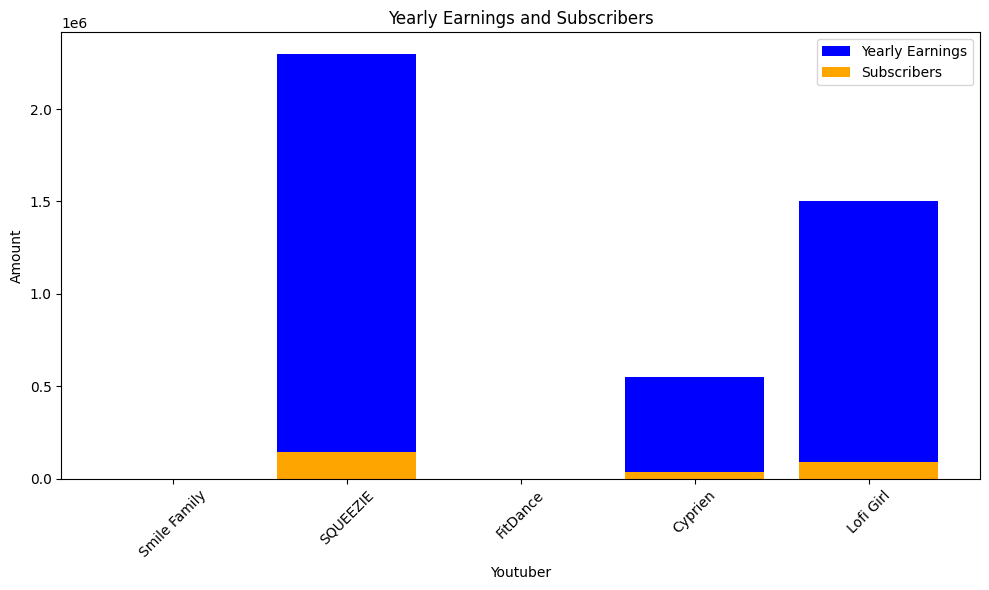

 38%|███▊      | 819/2160 [07:34<12:06,  1.85it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


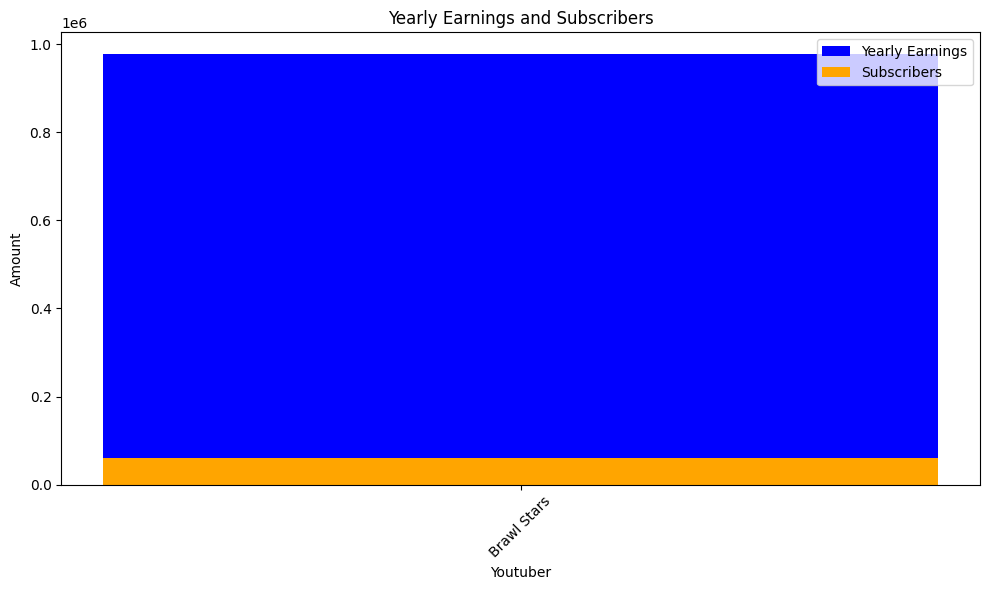

 38%|███▊      | 822/2160 [07:35<10:56,  2.04it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


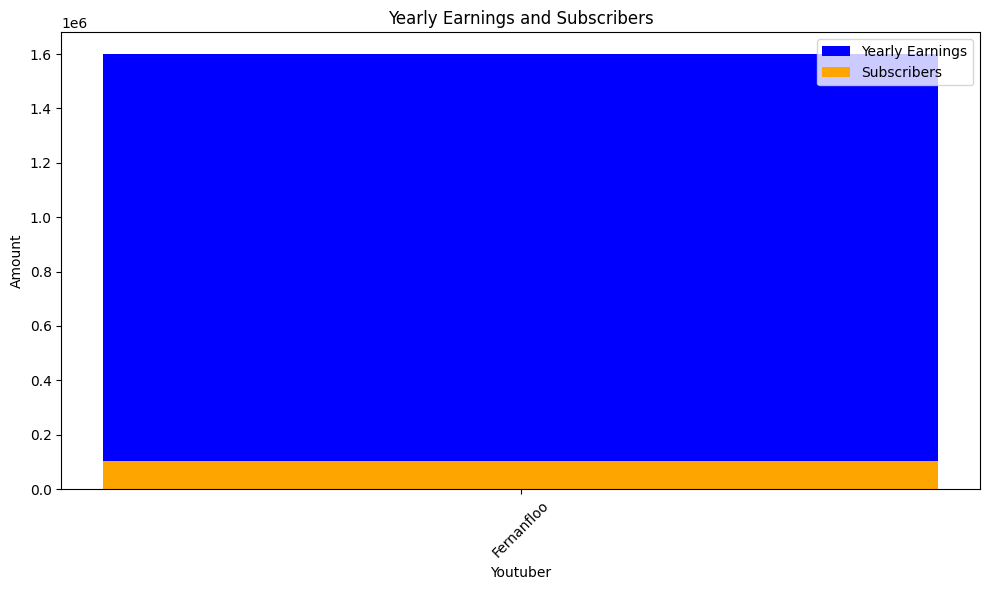

 38%|███▊      | 825/2160 [07:37<10:04,  2.21it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


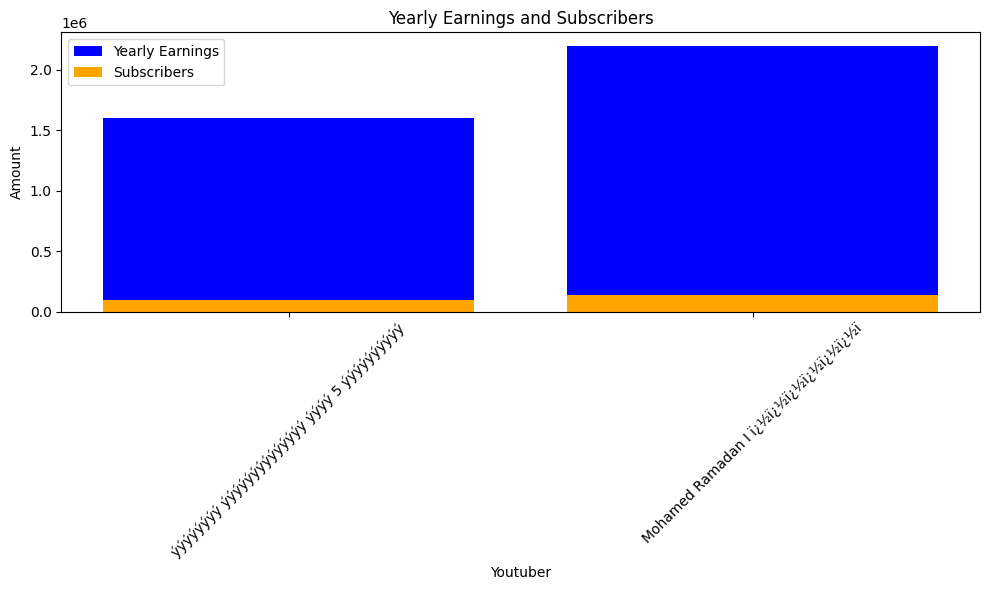

 38%|███▊      | 828/2160 [07:38<09:37,  2.31it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


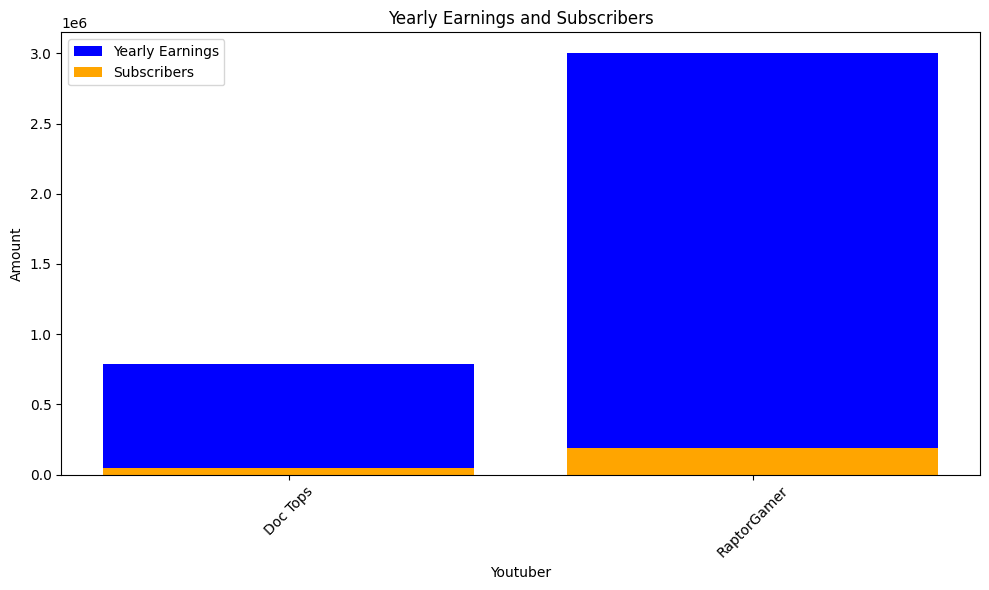

 38%|███▊      | 831/2160 [07:40<09:13,  2.40it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


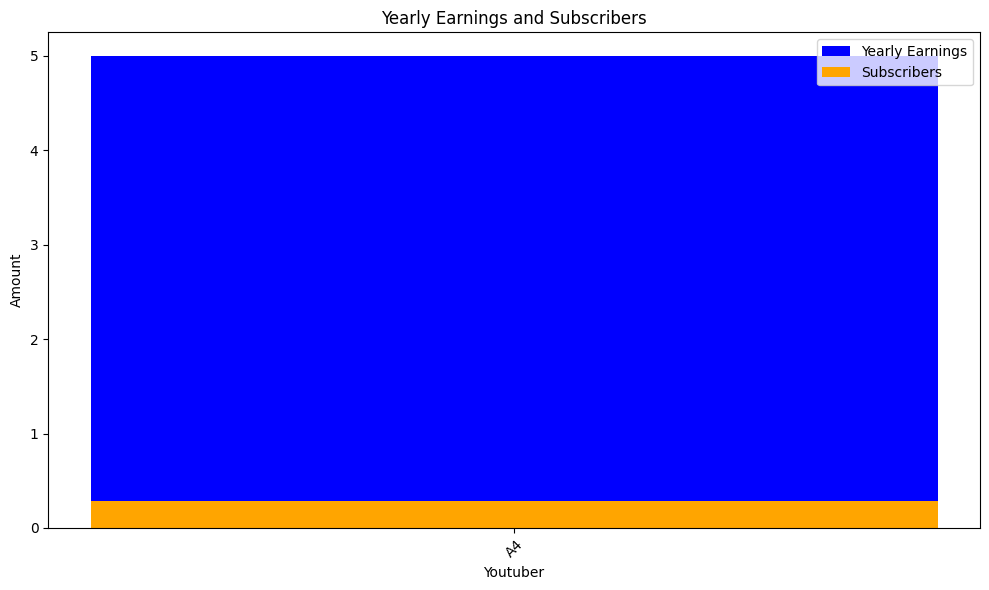

 39%|███▊      | 834/2160 [07:41<08:50,  2.50it/s]check
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Shakira
highest_yearly_earnings: 6200000.0, Subscribers: 386100.0, Youtuber: J Balvin
highest_yearly_earnings: 22400000.0, Subscribers: 1400000.0, Youtuber: KAROL G
highest_yearly_earnings: 8300000.0, Subscribers: 521500.0, Youtuber: toycantando
highest_yearly_earnings: 1200000.0, Subscribers: 73100.0, Youtuber: enchufetv
highest_yearly_earnings: 13600000.0, Subscribers: 852400.0, Youtuber: Anuel AA
highest_yearly_earnings: 12700000.0, Subscribers: 791600.0, Youtuber: Ami Rodriguez
highest_yearly_earnings: 2900000.0, Subscribers: 179700.0, Youtuber: Camilo
highest_yearly_earnings: 11000000.0, Subscribers: 686700.0, Youtuber: Codiscos
highest_yearly_earnings: 4100000.0, Subscribers: 258800.0, Youtuber: jbalvinVEVO
highest_yearly_earnings: 15700000.0, Subscribers: 982800.0, Youtuber: Go Ami Go!


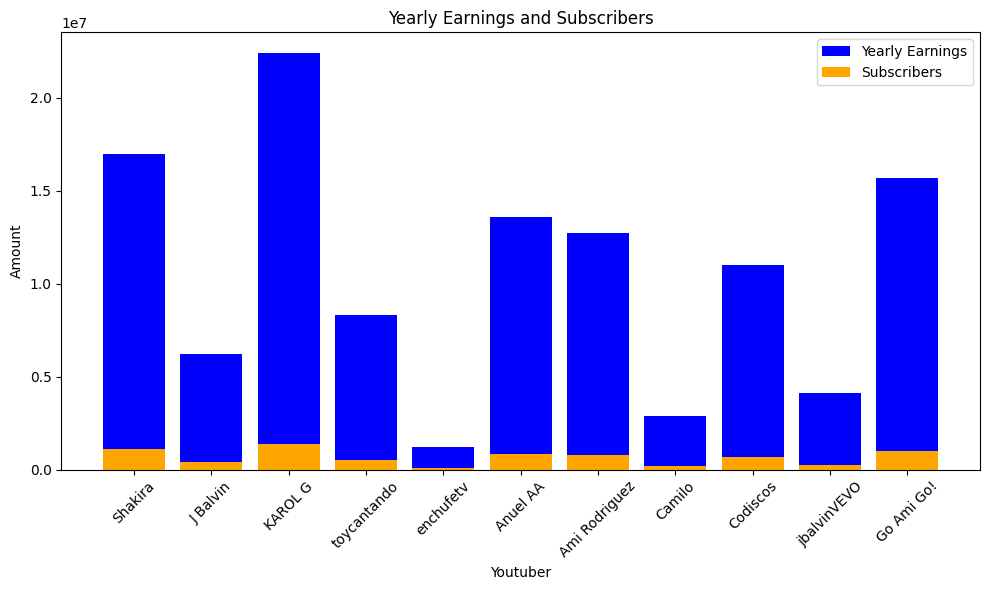

 39%|███▉      | 837/2160 [07:43<09:04,  2.43it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


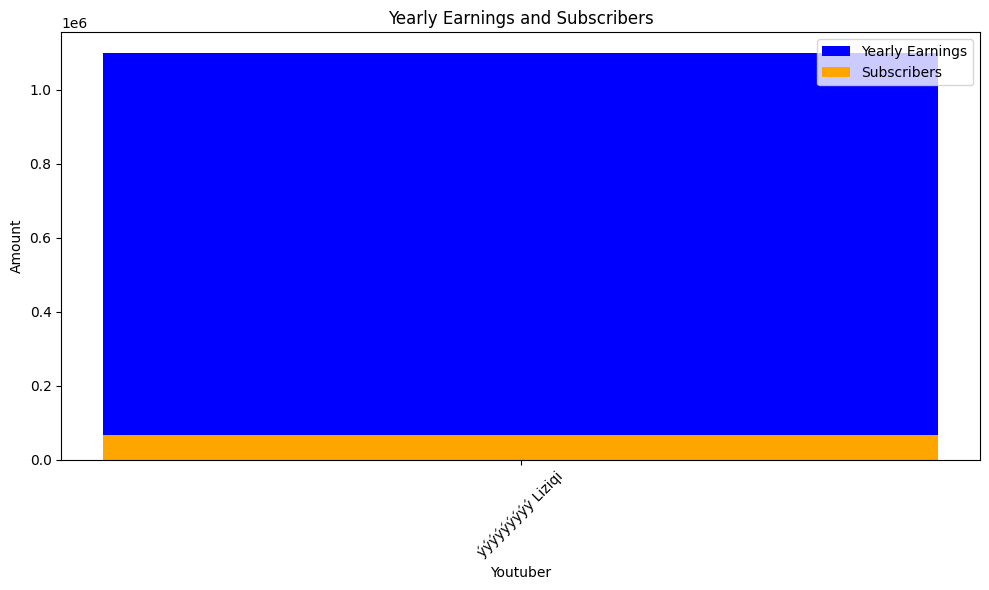

 39%|███▉      | 840/2160 [07:44<08:49,  2.50it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 199200.0, Youtuber: JuegaGerman
highest_yearly_earnings: 2.0, Subscribers: 0.15, Youtuber: invictor
highest_yearly_earnings: 4800000.0, Subscribers: 300600.0, Youtuber: DeGoBooM


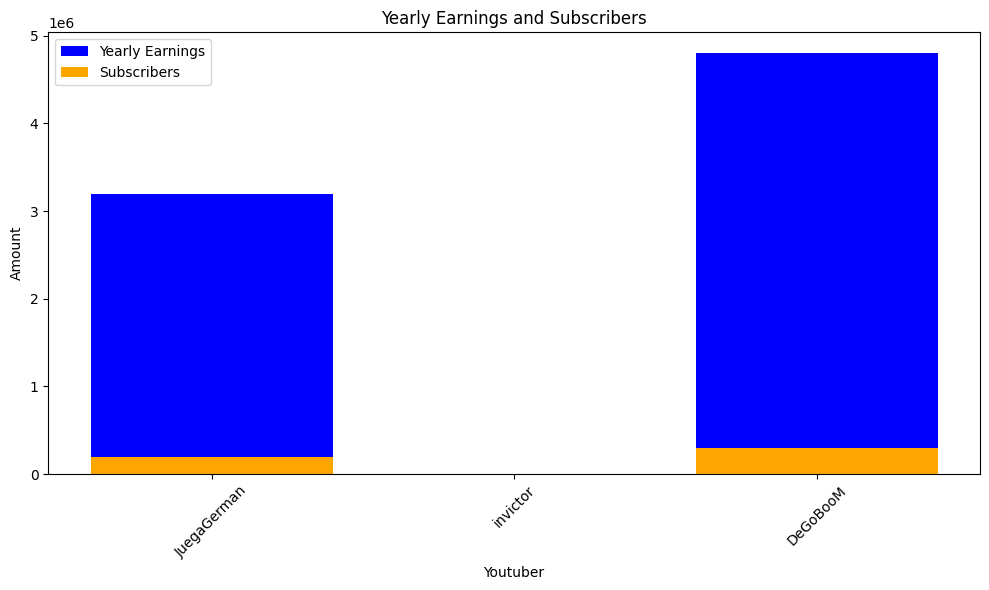

 39%|███▉      | 843/2160 [07:46<09:55,  2.21it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529000.0, Youtuber: Justin Bieber
highest_yearly_earnings: 26900000.0, Subscribers: 1700000.0, Youtuber: Super Simple Songs - Kids Songs
highest_yearly_earnings: 17900000.0, Subscribers: 1100000.0, Youtuber: The Weeknd
highest_yearly_earnings: 4300000.0, Subscribers: 266200.0, Youtuber: Shawn Mendes
highest_yearly_earnings: 2600000.0, Subscribers: 164800.0, Youtuber: VanossGaming
highest_yearly_earnings: 2400000.0, Subscribers: 147000.0, Youtuber: WatchMojo.com
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: FaZe Rug
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Pentatonix
highest_yearly_earnings: 4200000.0, Subscribers: 264700.0, Youtuber: Linus Tech Tips
highest_yearly_earnings: 255800.0, Subscribers: 16000.0, Youtuber: Lilly Singh
highest_yearly_earnings: 4000000.0, Subscribers: 251800.0, Youtuber: Hacksmith Industries
highest_yearly_earnings: 1600000.0, Sub

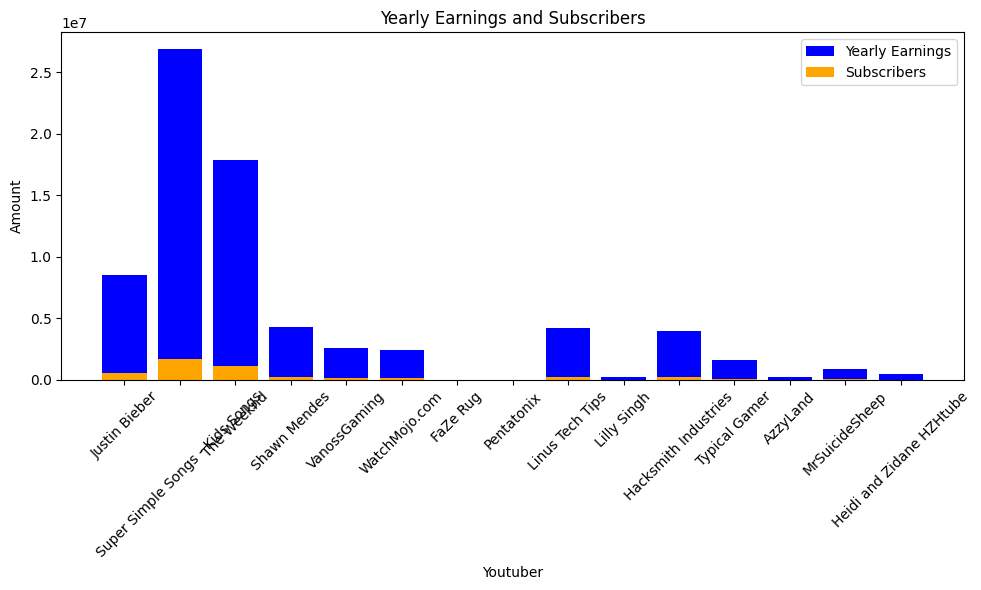

 39%|███▉      | 846/2160 [07:48<10:59,  1.99it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Canal KondZilla
highest_yearly_earnings: 6300000.0, Subscribers: 391100.0, Youtuber: Felipe Neto
highest_yearly_earnings: 2300000.0, Subscribers: 144100.0, Youtuber: Vocï¿½ï¿½ï¿½
highest_yearly_earnings: 1300000.0, Subscribers: 80100.0, Youtuber: whinderssonnunes
highest_yearly_earnings: 78500000.0, Subscribers: 4900000.0, Youtuber: GR6 EXPLODE
highest_yearly_earnings: 12100000.0, Subscribers: 754300.0, Youtuber: Maria Clara & JP
highest_yearly_earnings: 19400000.0, Subscribers: 1200000.0, Youtuber: Galinha Pintadinha
highest_yearly_earnings: 2100000.0, Subscribers: 133500.0, Youtuber: rezendeevil
highest_yearly_earnings: 14500000.0, Subscribers: 909300.0, Youtuber: Enaldinho
highest_yearly_earnings: 4000000.0, Subscribers: 248700.0, Youtuber: Renato Garcia YT
highest_yearly_earnings: 36500000.0, Subscribers: 2300000.0, Youtuber: Spider Slack
highest_yearly_earnings: 140000

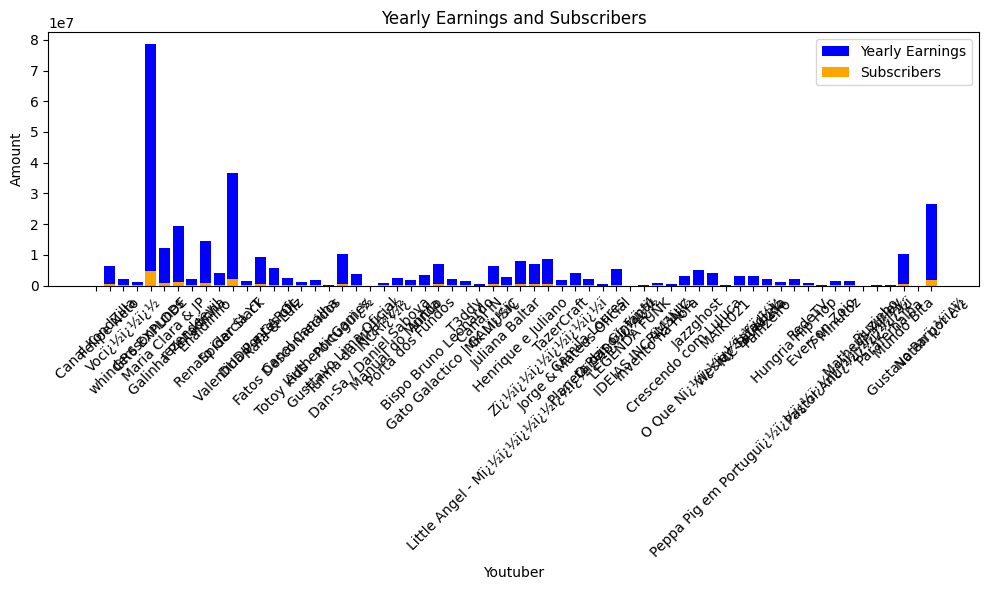

 39%|███▉      | 849/2160 [07:51<14:51,  1.47it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


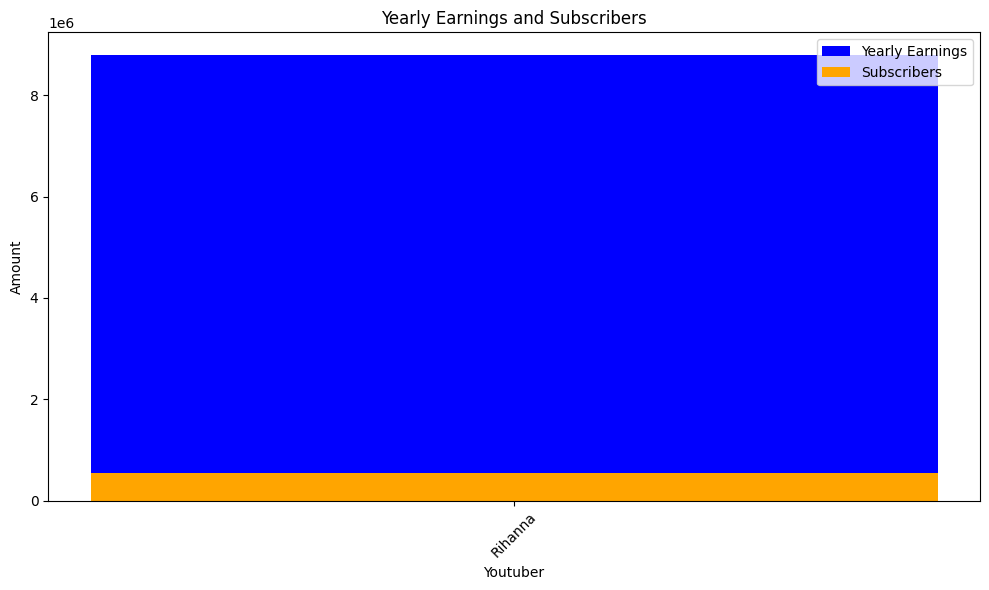

 39%|███▉      | 852/2160 [07:53<11:24,  1.91it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


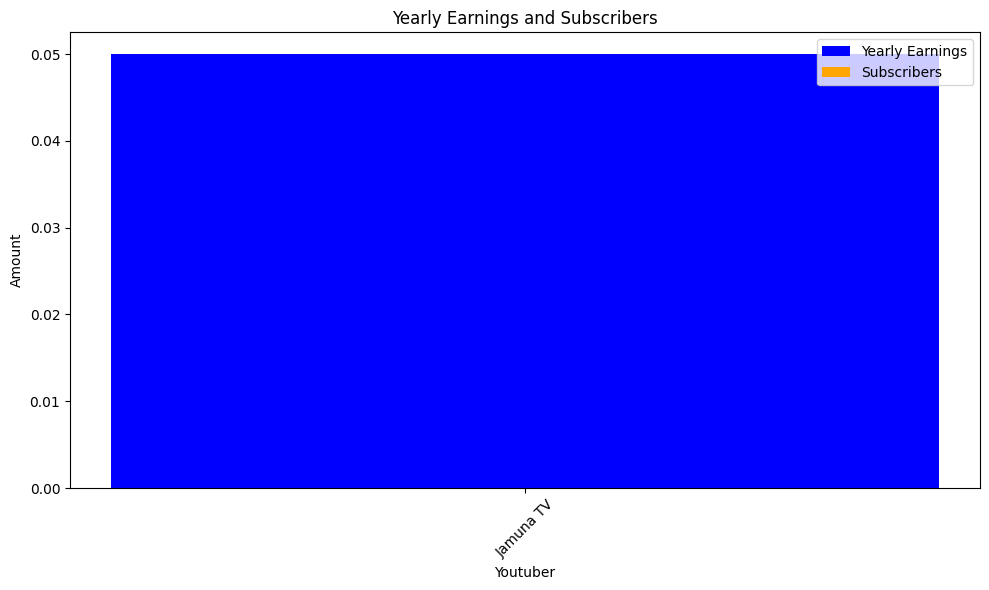

 40%|███▉      | 855/2160 [07:55<12:03,  1.80it/s]check
highest_yearly_earnings: 6100000.0, Subscribers: 382300.0, Youtuber: Bounce Patrol - Kids Songs
highest_yearly_earnings: 1100000.0, Subscribers: 69800.0, Youtuber: Chloe Ting
highest_yearly_earnings: 1300000.0, Subscribers: 78200.0, Youtuber: LazarBeam
highest_yearly_earnings: 18800000.0, Subscribers: 1200000.0, Youtuber: How Ridiculous
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: The Game Theorists
highest_yearly_earnings: 745200.0, Subscribers: 46600.0, Youtuber: HowToBasic
highest_yearly_earnings: 1.0, Subscribers: 0.08, Youtuber: Jason Vlogs
highest_yearly_earnings: 1000000.0, Subscribers: 63200.0, Youtuber: Lachlan
highest_yearly_earnings: 7.0, Subscribers: 0.44, Youtuber: Trap City


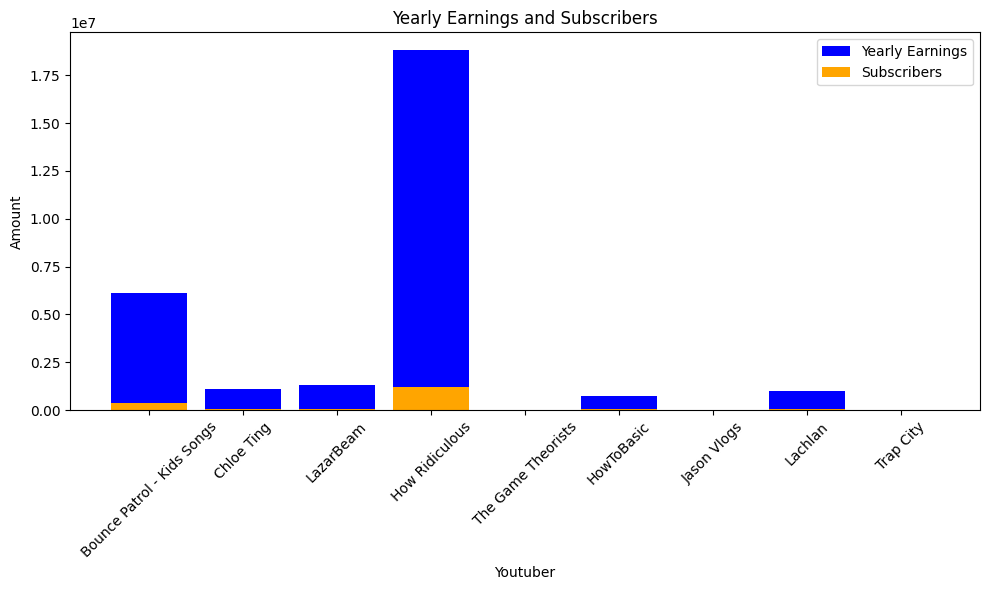

 40%|███▉      | 858/2160 [07:56<10:27,  2.07it/s]check
highest_yearly_earnings: 29400000.0, Subscribers: 1800000.0, Youtuber: El Reino Infantil
highest_yearly_earnings: 14500000.0, Subscribers: 906200.0, Youtuber: La Granja de Zenï¿½
highest_yearly_earnings: 9200000.0, Subscribers: 572000.0, Youtuber: TheDonato
highest_yearly_earnings: 0.72, Subscribers: 0.05, Youtuber: Maluma
highest_yearly_earnings: 19300000.0, Subscribers: 1200000.0, Youtuber: Alejo Igoa
highest_yearly_earnings: 1700000.0, Subscribers: 106600.0, Youtuber: DrossRotzank
highest_yearly_earnings: 3500000.0, Subscribers: 216700.0, Youtuber: Paulo Londra
highest_yearly_earnings: 9300000.0, Subscribers: 579500.0, Youtuber: Bizarrap
highest_yearly_earnings: 1300000.0, Subscribers: 82600.0, Youtuber: RobleisIUTU
highest_yearly_earnings: 30700000.0, Subscribers: 1900000.0, Youtuber: El Payaso Plim Plim
highest_yearly_earnings: 4000000.0, Subscribers: 251100.0, Youtuber: El Reino a Jugar
highest_yearly_earnings: 3100000.0, Su

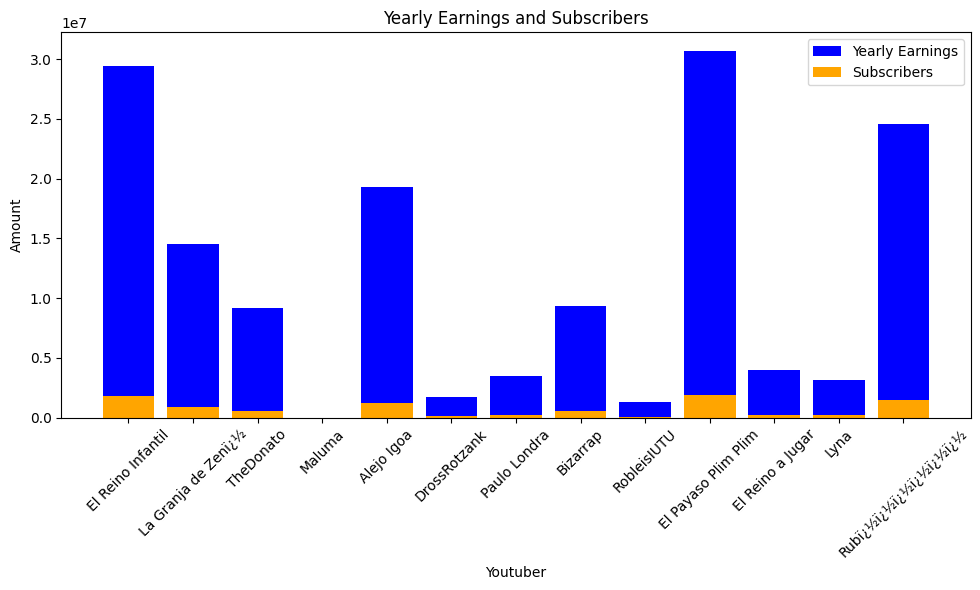

 40%|███▉      | 861/2160 [07:58<09:54,  2.19it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


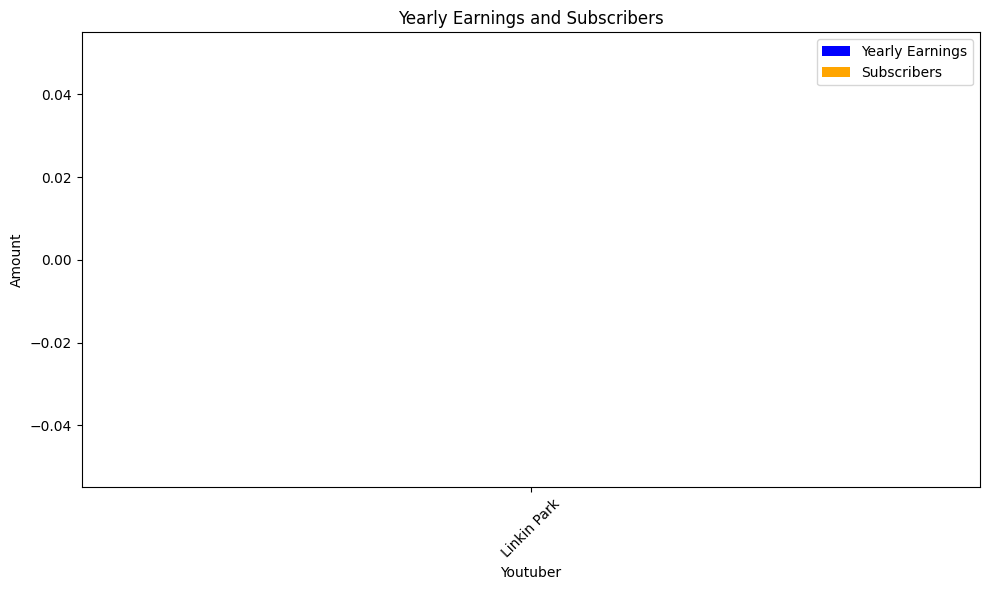

 40%|████      | 864/2160 [07:59<09:13,  2.34it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


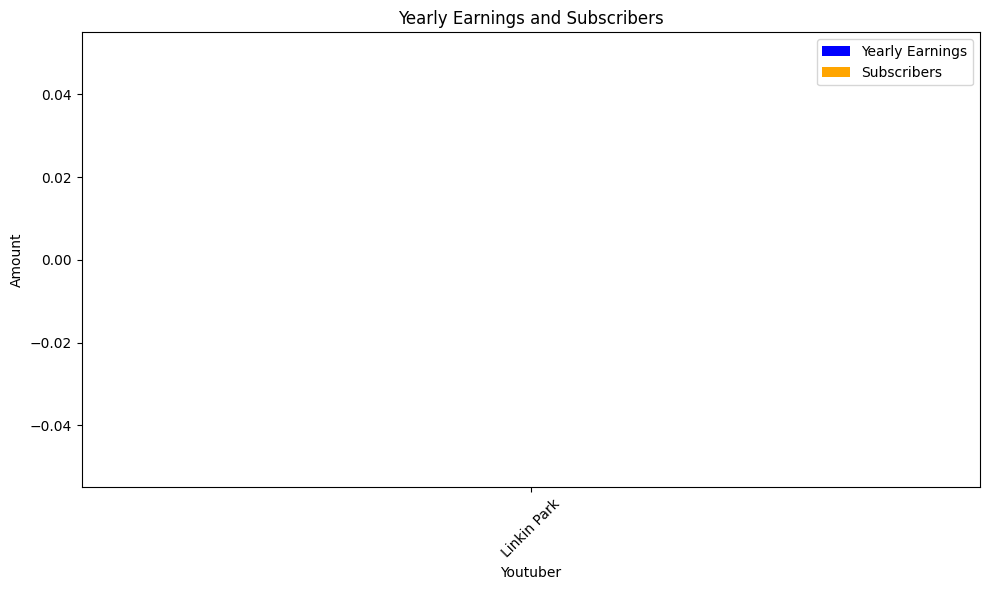

check
highest_yearly_earnings: 4100000.0, Subscribers: 253400.0, Youtuber: Like Nastya VNM
highest_yearly_earnings: 12300000.0, Subscribers: 770200.0, Youtuber: POPS Kids
highest_yearly_earnings: 1700000.0, Subscribers: 105400.0, Youtuber: FAPTV


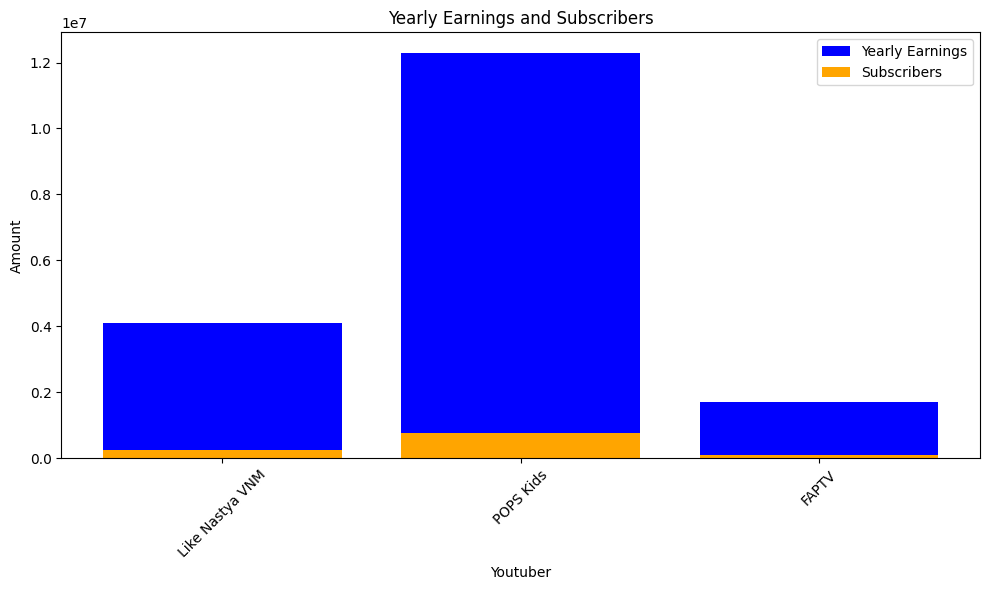

 40%|████      | 867/2160 [08:01<10:33,  2.04it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


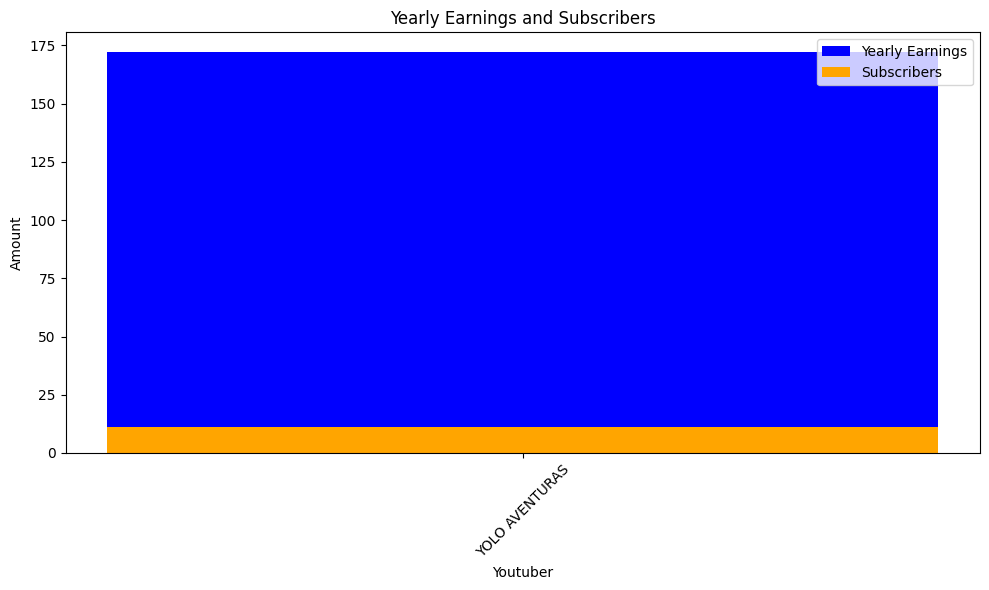

 40%|████      | 870/2160 [08:03<10:12,  2.10it/s]check
highest_yearly_earnings: 12500000.0, Subscribers: 780600.0, Youtuber: EminemMusic
highest_yearly_earnings: 5400000.0, Subscribers: 336300.0, Youtuber: Marshmello
highest_yearly_earnings: 25400000.0, Subscribers: 1600000.0, Youtuber: Taylor Swift
highest_yearly_earnings: 7700000.0, Subscribers: 480600.0, Youtuber: Ariana Grande
highest_yearly_earnings: 7000000.0, Subscribers: 440600.0, Youtuber: Billie Eilish
highest_yearly_earnings: 15100000.0, Subscribers: 943500.0, Youtuber: SonyMusicIndiaVEVO
highest_yearly_earnings: 6400000.0, Subscribers: 402700.0, Youtuber: Katy Perry
highest_yearly_earnings: 2800000.0, Subscribers: 175100.0, Youtuber: XXXTENTACION
highest_yearly_earnings: 305.0, Subscribers: 19.0, Youtuber: One Direction
highest_yearly_earnings: 9900000.0, Subscribers: 616800.0, Youtuber: Daddy Yankee
highest_yearly_earnings: 8400000.0, Subscribers: 525700.0, Youtuber: Bruno Mars
highest_yearly_earnings: 7300000.0, Subscrib

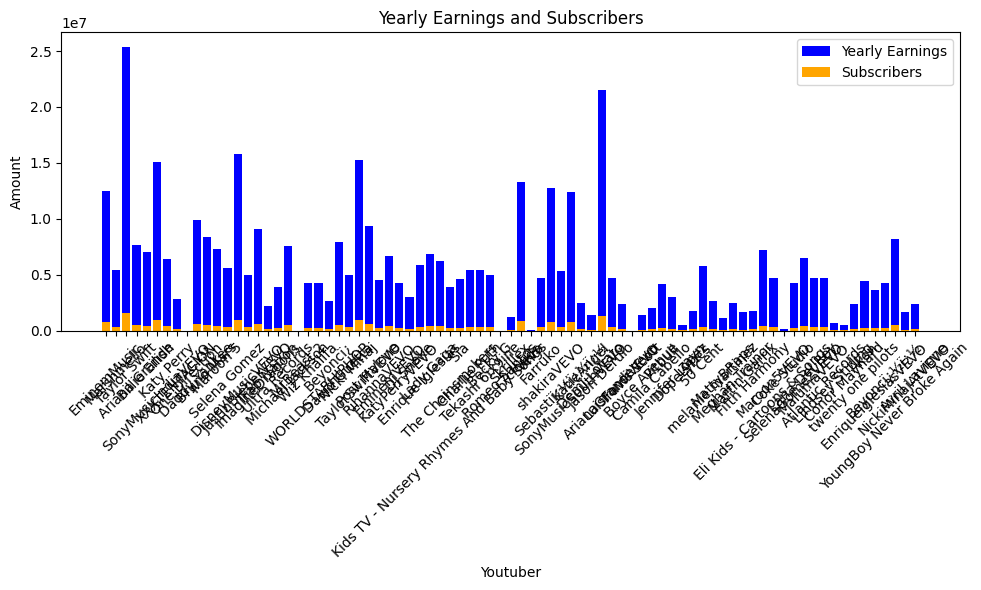

 40%|████      | 873/2160 [08:06<15:12,  1.41it/s]check
highest_yearly_earnings: 9700000.0, Subscribers: 608200.0, Youtuber: Ed Sheeran
highest_yearly_earnings: 2700000.0, Subscribers: 167000.0, Youtuber: NoCopyrightSounds
highest_yearly_earnings: 6600000.0, Subscribers: 411300.0, Youtuber: Adele
highest_yearly_earnings: 9500000.0, Subscribers: 596600.0, Youtuber: Coldplay
highest_yearly_earnings: 261100.0, Subscribers: 16300.0, Youtuber: KSI
highest_yearly_earnings: 6100000.0, Subscribers: 384100.0, Youtuber: Dua Lipa
highest_yearly_earnings: 2500000.0, Subscribers: 153400.0, Youtuber: OneDirectionVEVO
highest_yearly_earnings: 16.0, Subscribers: 1.0, Youtuber: SCTV
highest_yearly_earnings: 4900000.0, Subscribers: 307200.0, Youtuber: Calvin Harris
highest_yearly_earnings: 4500000.0, Subscribers: 281300.0, Youtuber: Queen Official
highest_yearly_earnings: 1900000.0, Subscribers: 115800.0, Youtuber: Little Mix
highest_yearly_earnings: 4100000.0, Subscribers: 254300.0, Youtuber: AdeleVEVO

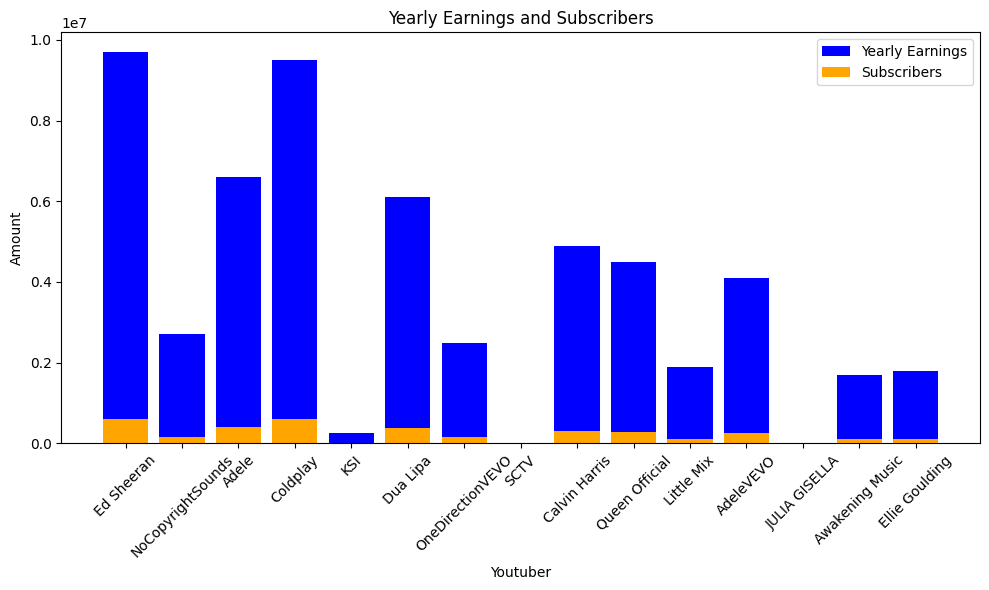

 41%|████      | 876/2160 [08:09<13:12,  1.62it/s]check
highest_yearly_earnings: 11900000.0, Subscribers: 743200.0, Youtuber: shfa2 - ï¿½ï¿½
highest_yearly_earnings: 7300000.0, Subscribers: 453600.0, Youtuber: shfa show India
highest_yearly_earnings: 76700000.0, Subscribers: 4800000.0, Youtuber: ZAMZAM ELECTRONICS TRADING
highest_yearly_earnings: 746700.0, Subscribers: 46700.0, Youtuber: Noor Stars
highest_yearly_earnings: 3800000.0, Subscribers: 240500.0, Youtuber: FFUNTV
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Supercar Blondie
highest_yearly_earnings: 3900000.0, Subscribers: 240700.0, Youtuber: AlArabiya ï¿½ï¿½ï¿½ï¿½ï¿


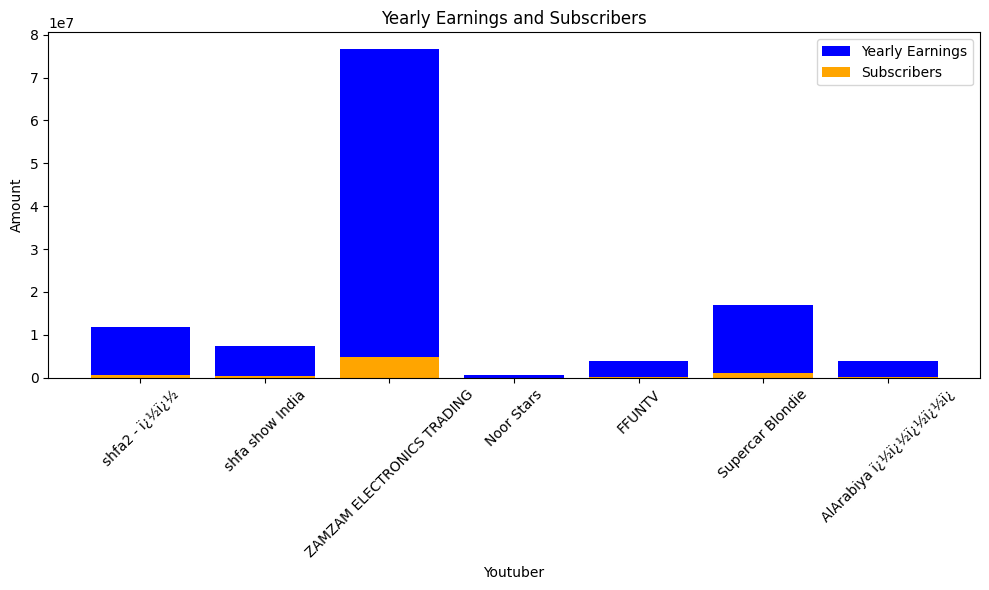

 41%|████      | 879/2160 [08:10<11:01,  1.94it/s]check
highest_yearly_earnings: 1400000.0, Subscribers: 87000.0, Youtuber: SlivkiShow
highest_yearly_earnings: 3300000.0, Subscribers: 204000.0, Youtuber: ýýýýýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 17800000.0, Subscribers: 1100000.0, Youtuber: News 24
highest_yearly_earnings: 2300000.0, Subscribers: 141400.0, Youtuber: ýýýýýýýý ýýýýýýýý
highest_yearly_earnings: 5.0, Subscribers: 0.32, Youtuber: SIS vs BRO
highest_yearly_earnings: 3600000.0, Subscribers: 225500.0, Youtuber: Lady Diana
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: VexTrex
highest_yearly_earnings: 3400000.0, Subscribers: 213400.0, Youtuber: ýýýýýýýý ýýýý ýýýýýýýýýýýýýý


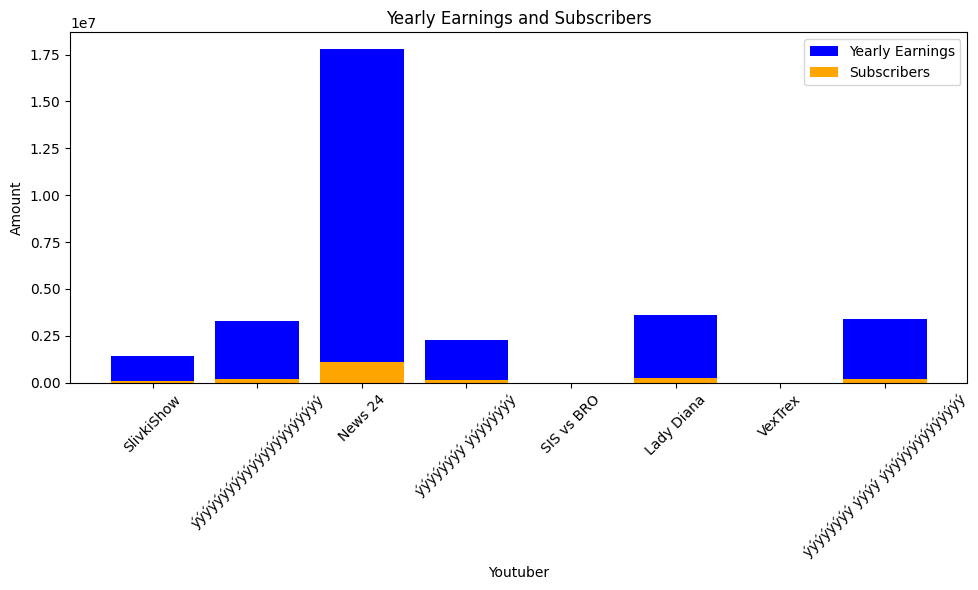

 41%|████      | 882/2160 [08:12<10:09,  2.10it/s]check
highest_yearly_earnings: 20400000.0, Subscribers: 1300000.0, Youtuber: netd mï¿½ï¿


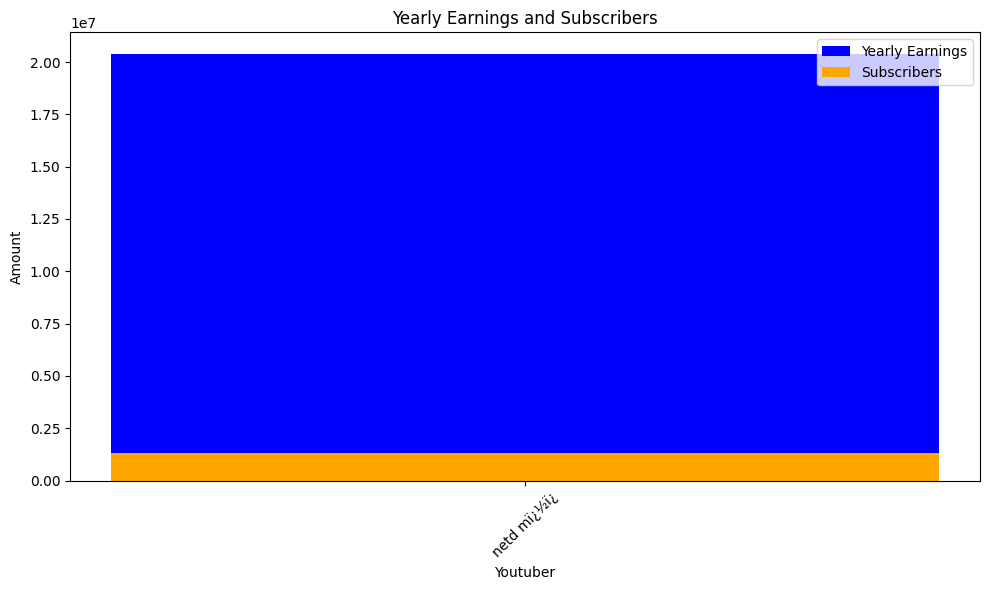

 41%|████      | 885/2160 [08:13<09:08,  2.32it/s]check
highest_yearly_earnings: 6300000.0, Subscribers: 390700.0, Youtuber: GMM GRAMMY OFFICIAL
highest_yearly_earnings: 8100000.0, Subscribers: 505800.0, Youtuber: GRAMMY GOLD OFFICIAL
highest_yearly_earnings: 2600000.0, Subscribers: 162400.0, Youtuber: RsiamMusic : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 4000000.0, Subscribers: 248400.0, Youtuber: Genierock


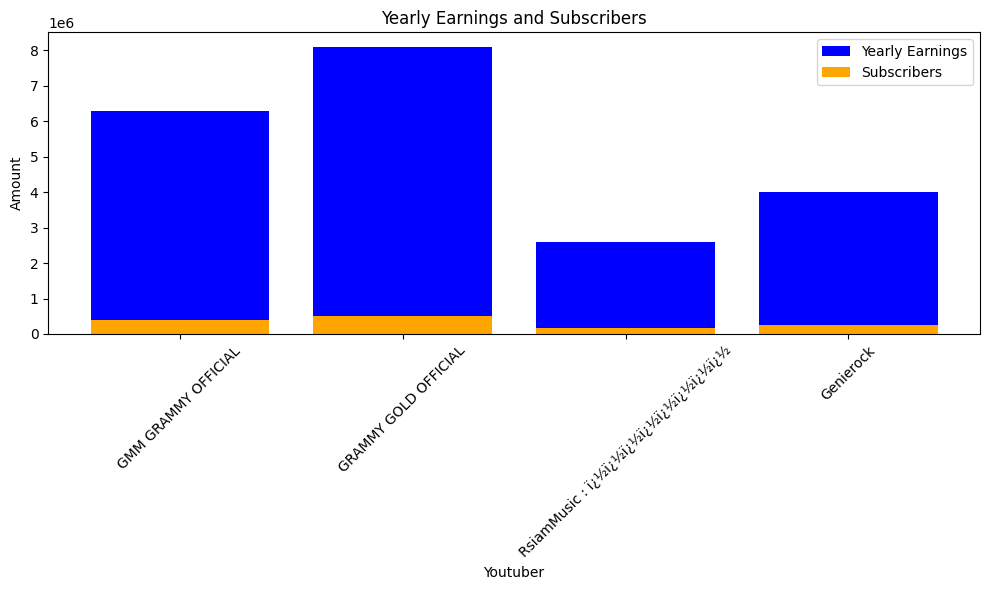

 41%|████      | 888/2160 [08:15<09:08,  2.32it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


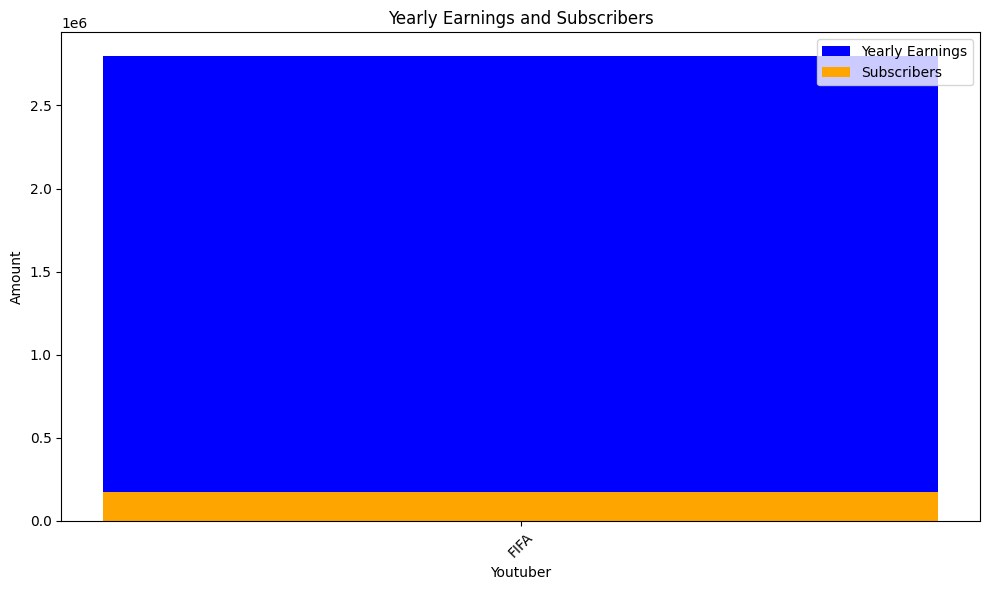

 41%|████▏     | 891/2160 [08:17<09:20,  2.27it/s]check
highest_yearly_earnings: 3900000.0, Subscribers: 243700.0, Youtuber: Avicii


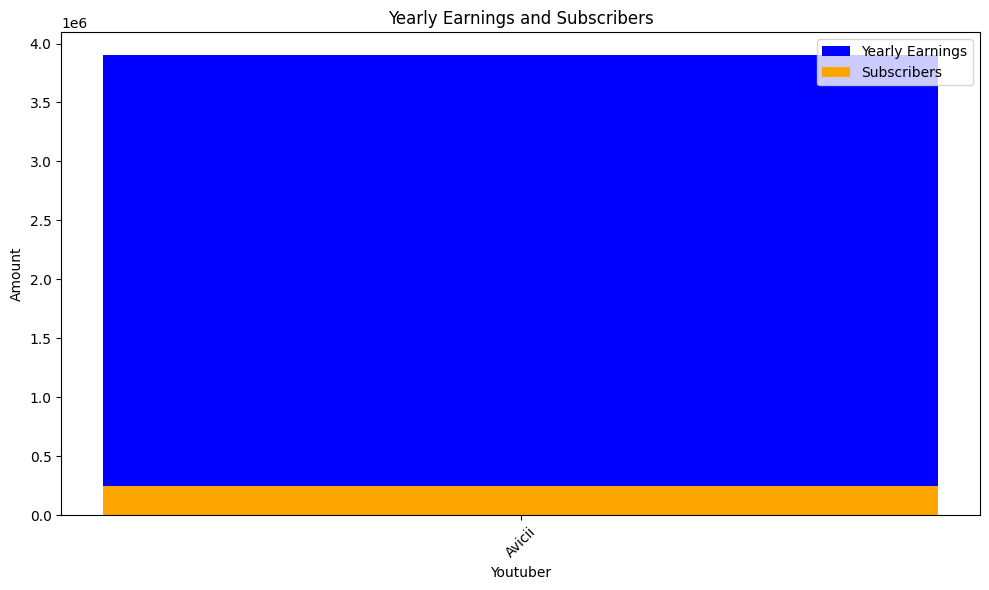

 41%|████▏     | 894/2160 [08:18<08:58,  2.35it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.31, Youtuber: CKN
highest_yearly_earnings: 0.19, Subscribers: 0.01, Youtuber: AdMe
highest_yearly_earnings: 9700000.0, Subscribers: 605000.0, Youtuber: Luli Pampï¿½
highest_yearly_earnings: 484000.0, Subscribers: 30200.0, Youtuber: Adexe & Nau


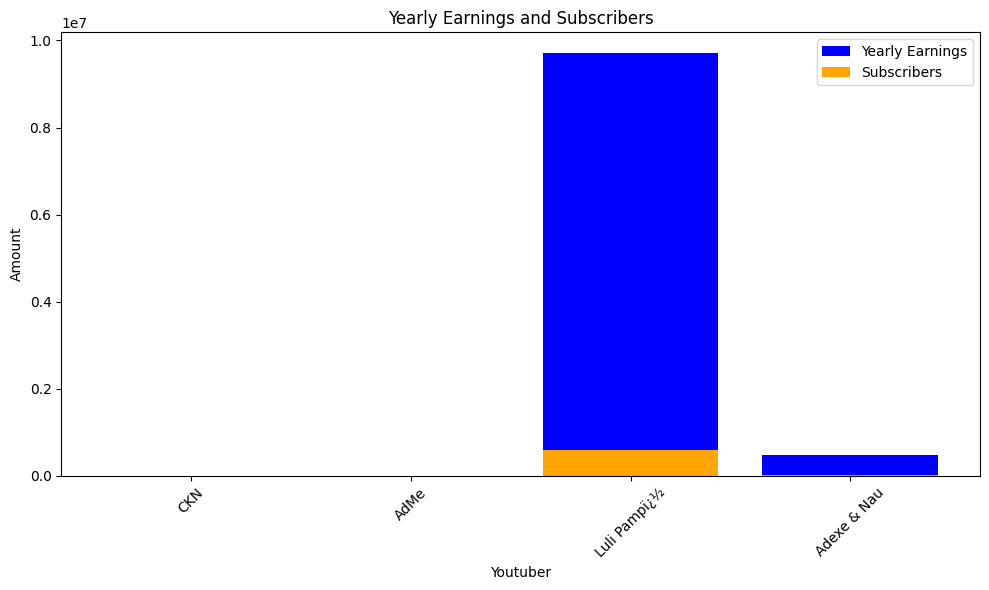

 42%|████▏     | 897/2160 [08:20<09:46,  2.15it/s]check
highest_yearly_earnings: 23900000.0, Subscribers: 1500000.0, Youtuber: BLACKPINK
highest_yearly_earnings: 8100000.0, Subscribers: 504900.0, Youtuber: BANGTANTV
highest_yearly_earnings: 28700000.0, Subscribers: 1800000.0, Youtuber: HYBE LABELS
highest_yearly_earnings: 14800000.0, Subscribers: 922900.0, Youtuber: JYP Entertainment
highest_yearly_earnings: 3100000.0, Subscribers: 195000.0, Youtuber: officialpsy
highest_yearly_earnings: 532700.0, Subscribers: 33300.0, Youtuber: JFlaMusic
highest_yearly_earnings: 2000000.0, Subscribers: 122400.0, Youtuber: BIGBANG


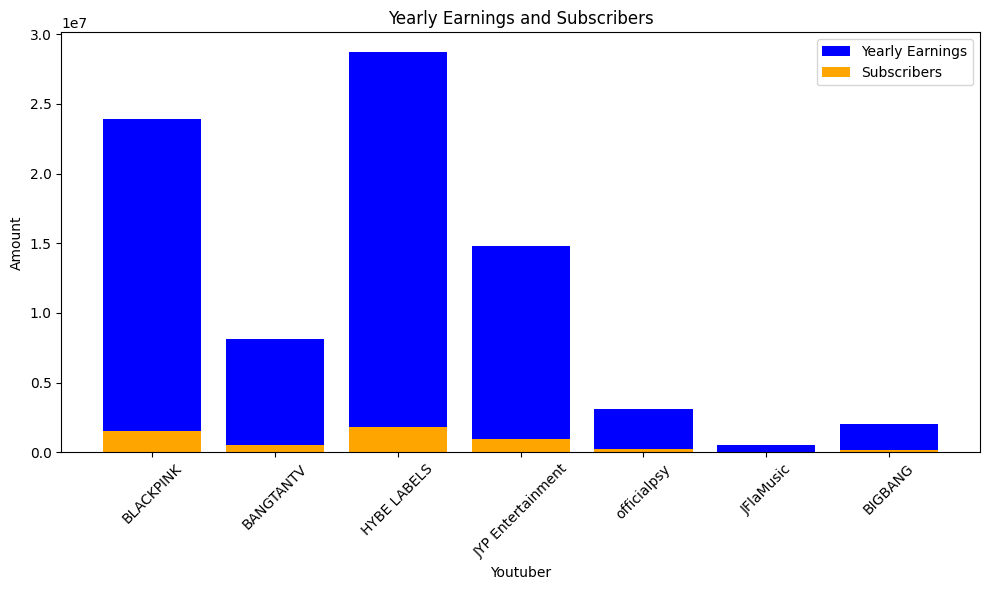

 42%|████▏     | 900/2160 [08:22<10:51,  1.94it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Sandeep Maheshwari
highest_yearly_earnings: 5600000.0, Subscribers: 351600.0, Youtuber: LEGO
highest_yearly_earnings: 45100.0, Subscribers: 2800.0, Youtuber: MY FAMILY


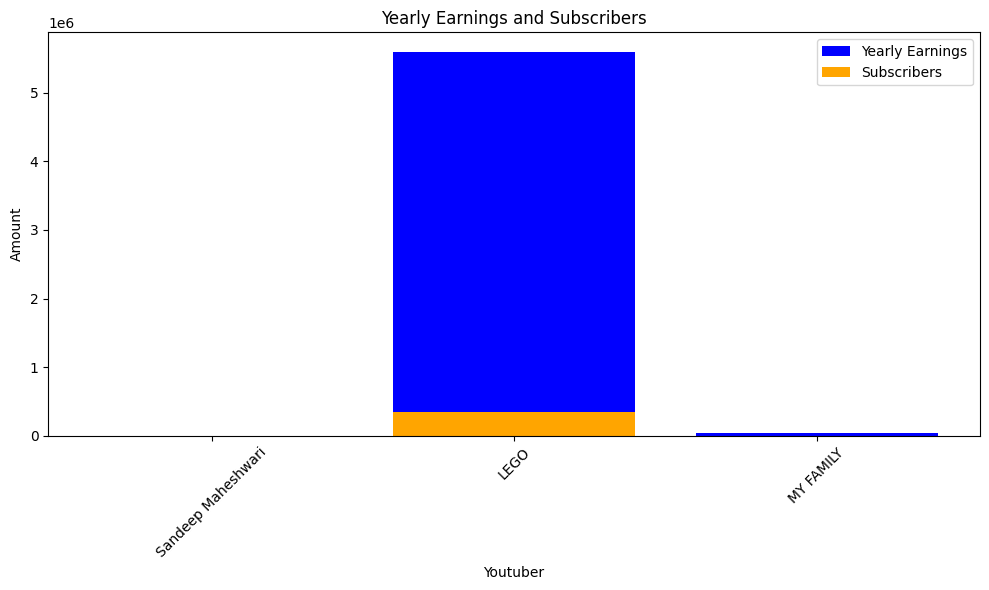

 42%|████▏     | 903/2160 [08:24<11:27,  1.83it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: 1MILLION Dance Studio
highest_yearly_earnings: 4400000.0, Subscribers: 272700.0, Youtuber: Katakit Baby TV


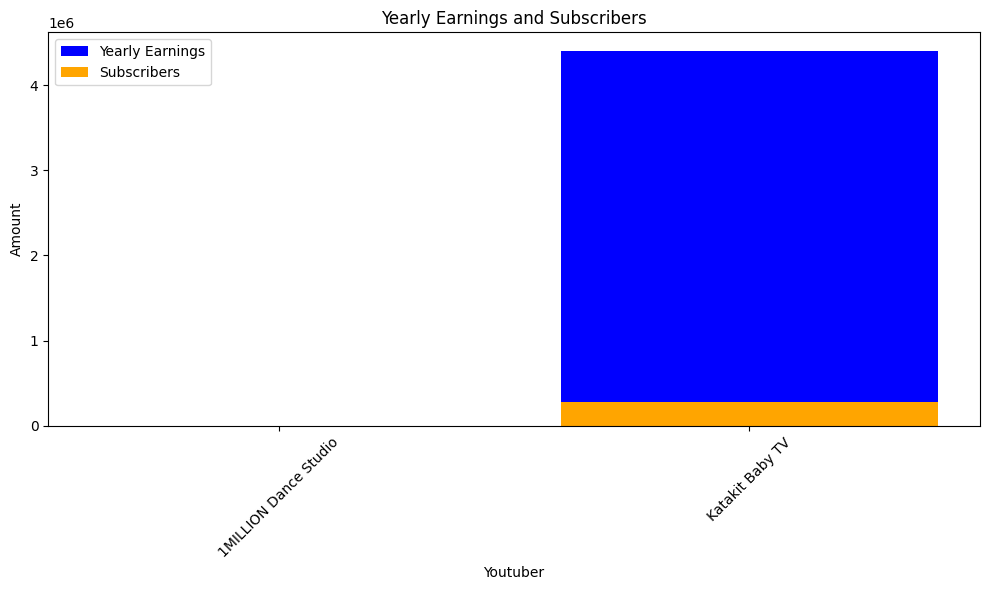

 42%|████▏     | 906/2160 [08:26<11:08,  1.87it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


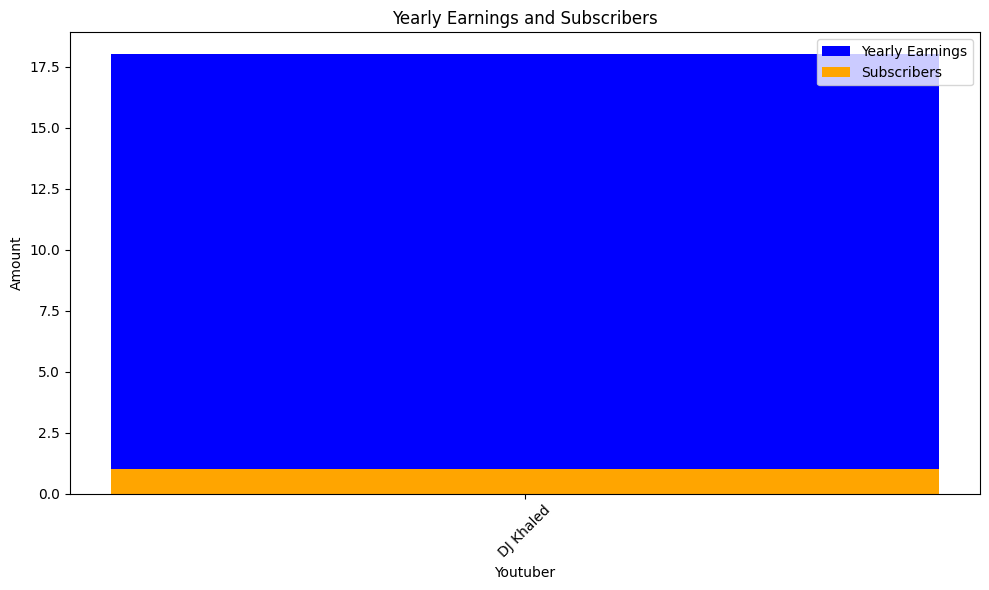

 42%|████▏     | 909/2160 [08:27<09:43,  2.14it/s]check
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya
highest_yearly_earnings: 14700000.0, Subscribers: 919600.0, Youtuber: Get Movies
highest_yearly_earnings: 14600000.0, Subscribers: 911300.0, Youtuber: ýýýýýýýý ýý ýýýýýýýýýýýýýý
highest_yearly_earnings: 26500000.0, Subscribers: 1700000.0, Youtuber: tuzelity SHUFFLE
highest_yearly_earnings: 1200000.0, Subscribers: 73700.0, Youtuber: HiMan
highest_yearly_earnings: 1800000.0, Subscribers: 114800.0, Youtuber: Marmok
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya Vlog
highest_yearly_earnings: 1800000.0, Subscribers: 111500.0, Youtuber: TheBrianMaps
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: ýýýýýýýýýý
highest_yearly_earnings: 22800000.0, Subscribers: 1400000.0, Youtuber: ILYA BORZOV
highest_yearly_earnings: 4600000.0, Subscribers: 286800.0, Youtuber: EdisonPts
highest_yearly_earnings: 34200000.0, Subscribers

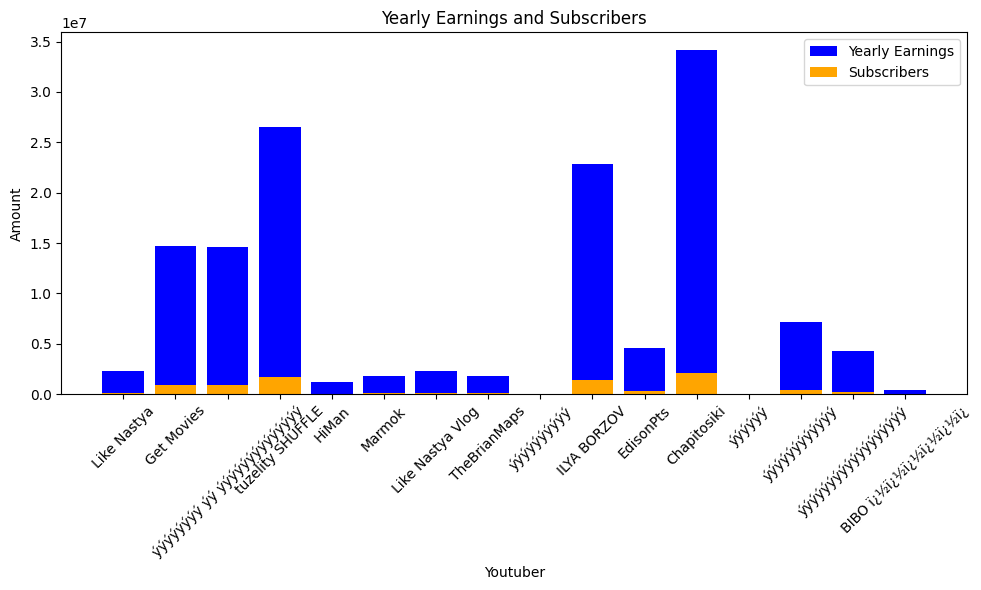

 42%|████▏     | 912/2160 [08:30<12:07,  1.72it/s]check
highest_yearly_earnings: 3000000.0, Subscribers: 188000.0, Youtuber: Wish 107.5


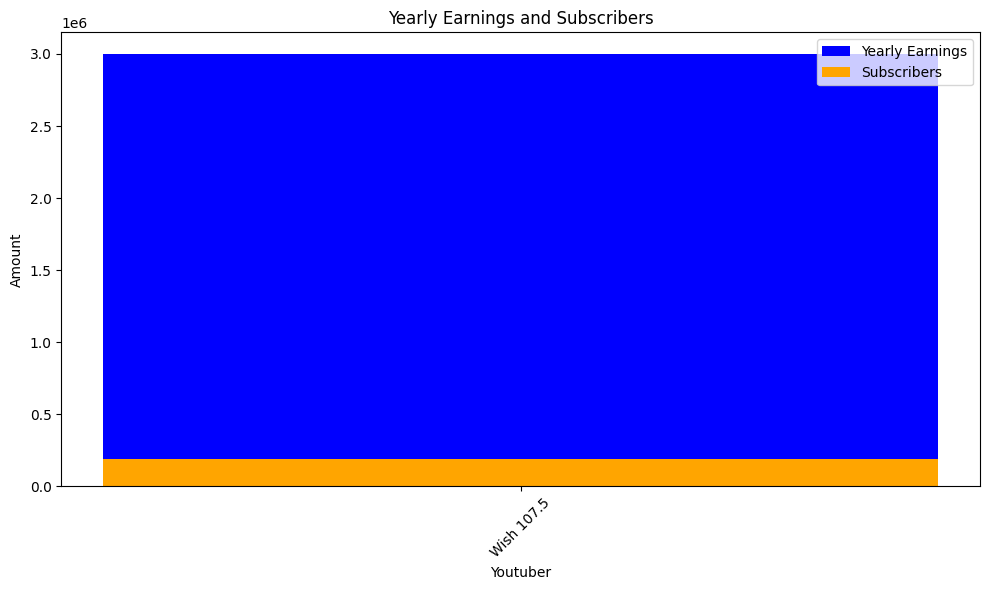

 42%|████▏     | 915/2160 [08:31<09:33,  2.17it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


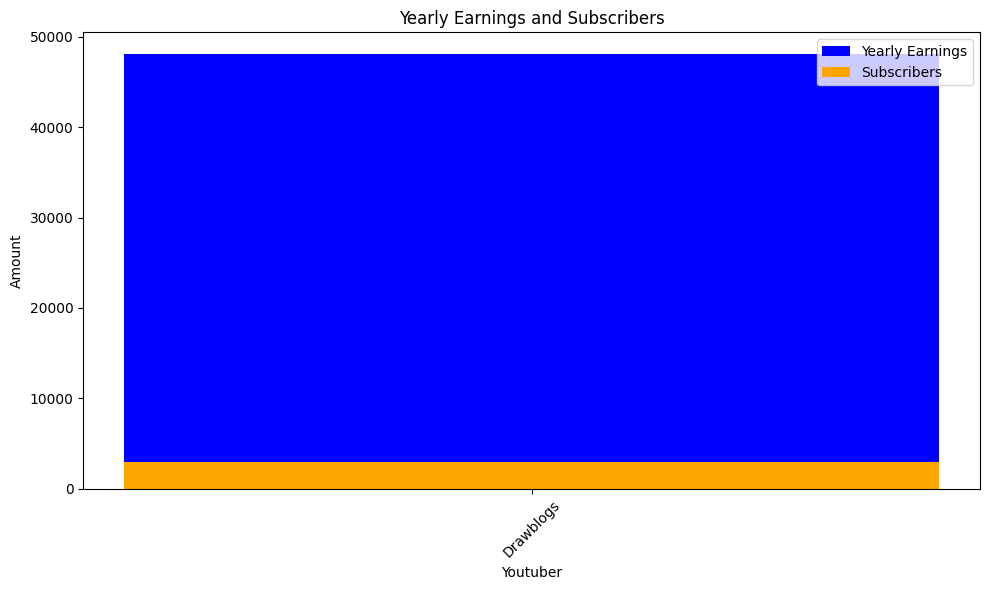

 42%|████▎     | 918/2160 [08:33<08:55,  2.32it/s]check
highest_yearly_earnings: 64200000.0, Subscribers: 4000000.0, Youtuber: HAR PAL GEO
highest_yearly_earnings: 55200000.0, Subscribers: 3400000.0, Youtuber: ARY Digital HD
highest_yearly_earnings: 32900000.0, Subscribers: 2100000.0, Youtuber: HUM TV
highest_yearly_earnings: 4800000.0, Subscribers: 300200.0, Youtuber: Geo News
highest_yearly_earnings: 28.0, Subscribers: 2.0, Youtuber: Wolfoo Channel
highest_yearly_earnings: 419.0, Subscribers: 26.0, Youtuber: Quantum Tech HD


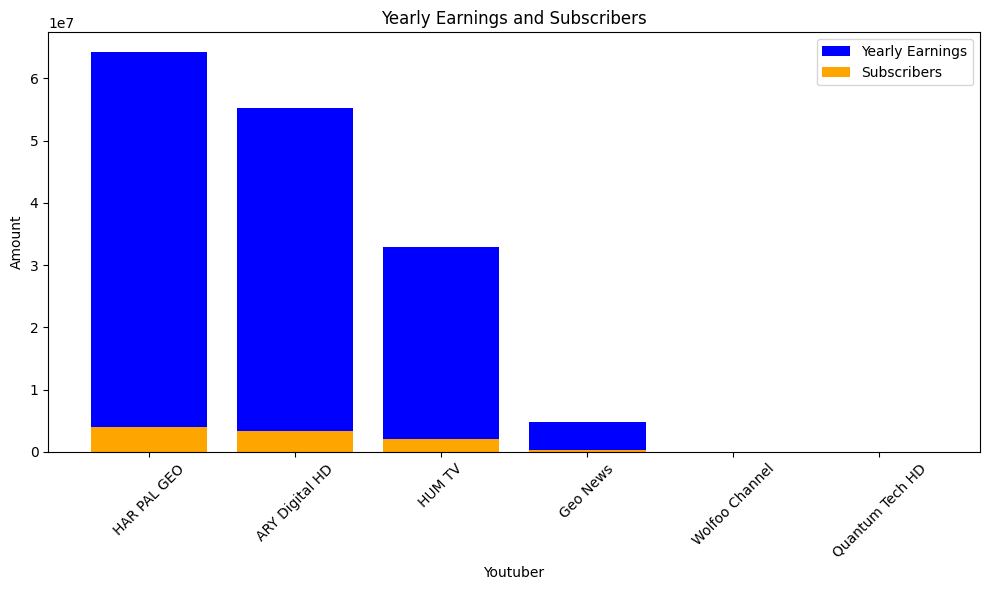

 43%|████▎     | 921/2160 [08:34<08:47,  2.35it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300100.0, Youtuber: Spinnin' Records


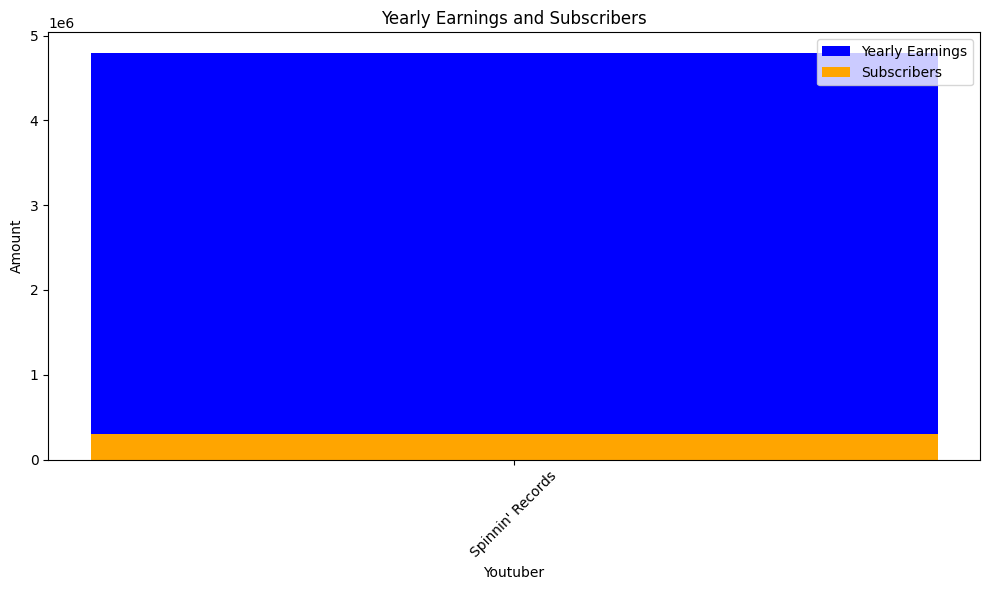

 43%|████▎     | 924/2160 [08:36<09:01,  2.28it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


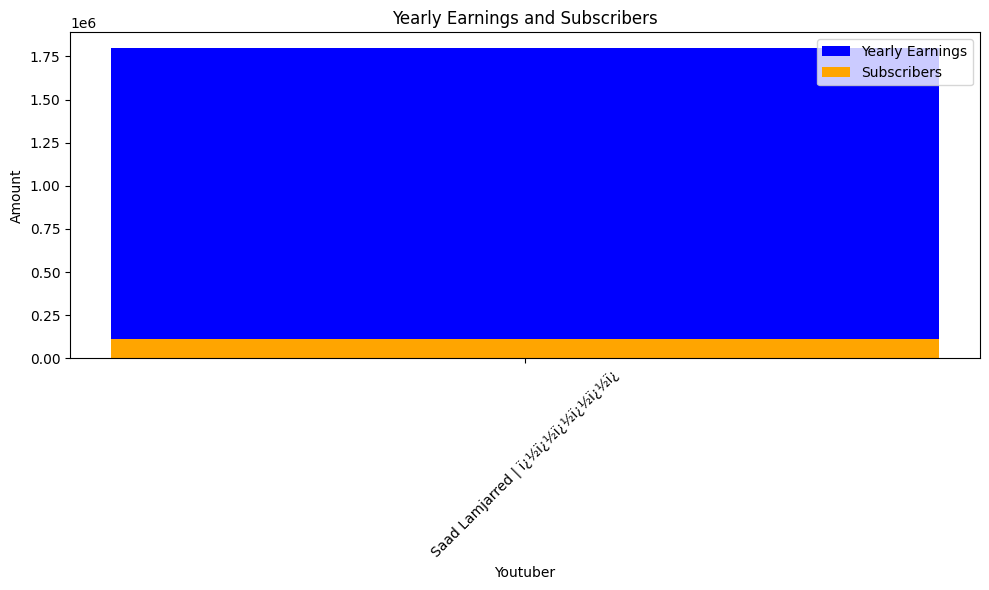

 43%|████▎     | 927/2160 [08:38<09:58,  2.06it/s]check
highest_yearly_earnings: 227.0, Subscribers: 14.0, Youtuber: Disney Latinoamï¿½ï¿½
highest_yearly_earnings: 2400000.0, Subscribers: 152000.0, Youtuber: Mis Pastelitos


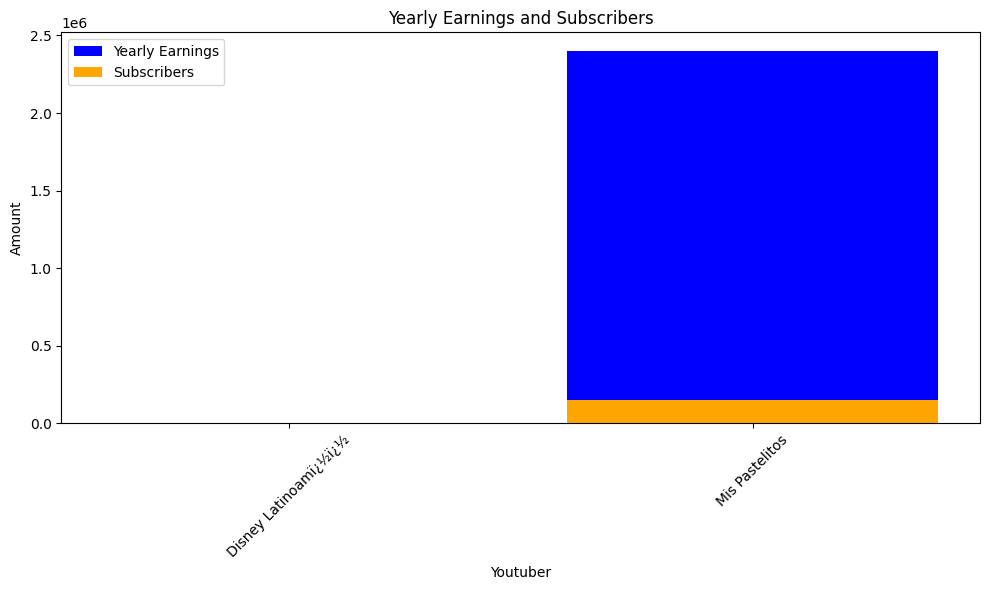

 43%|████▎     | 930/2160 [08:40<10:41,  1.92it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


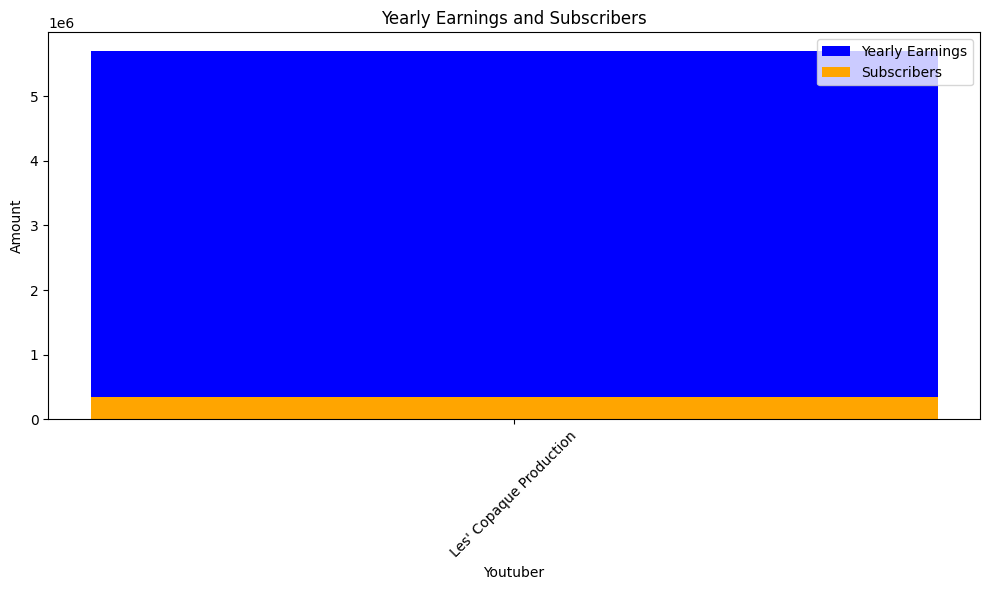

 43%|████▎     | 933/2160 [08:41<10:52,  1.88it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


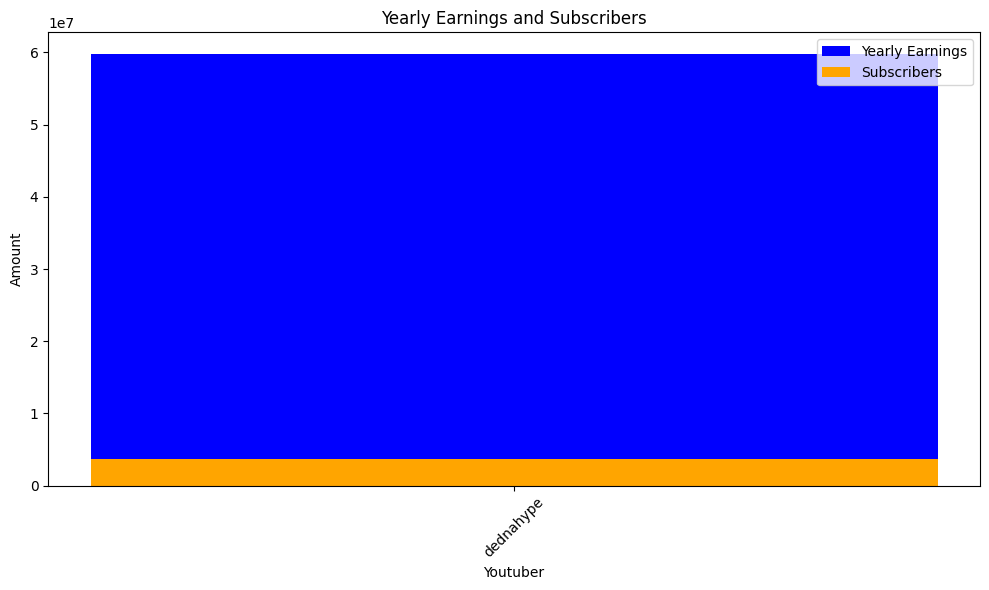

 43%|████▎     | 936/2160 [08:43<10:35,  1.93it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


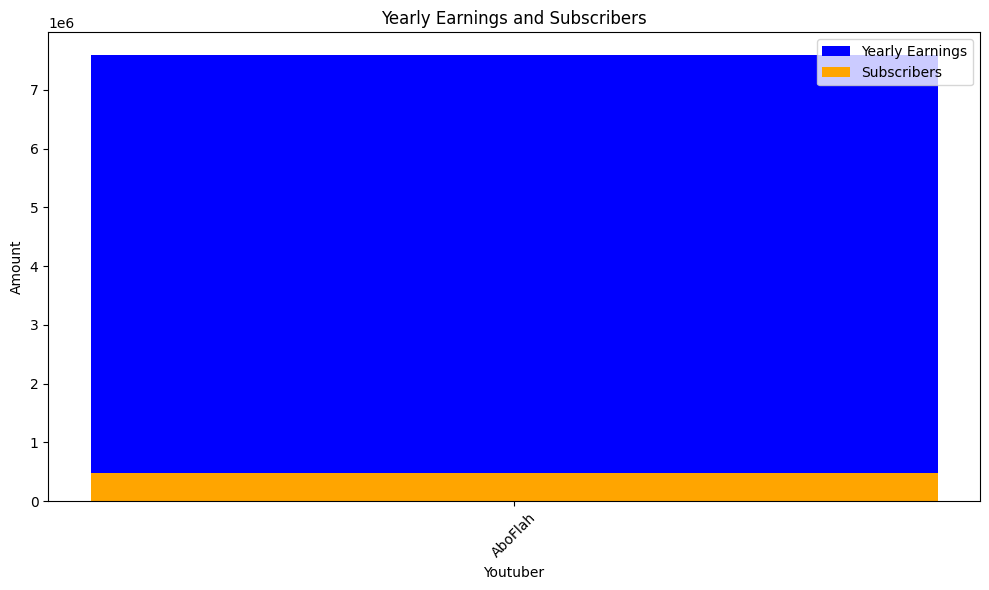

 43%|████▎     | 939/2160 [08:45<09:23,  2.17it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


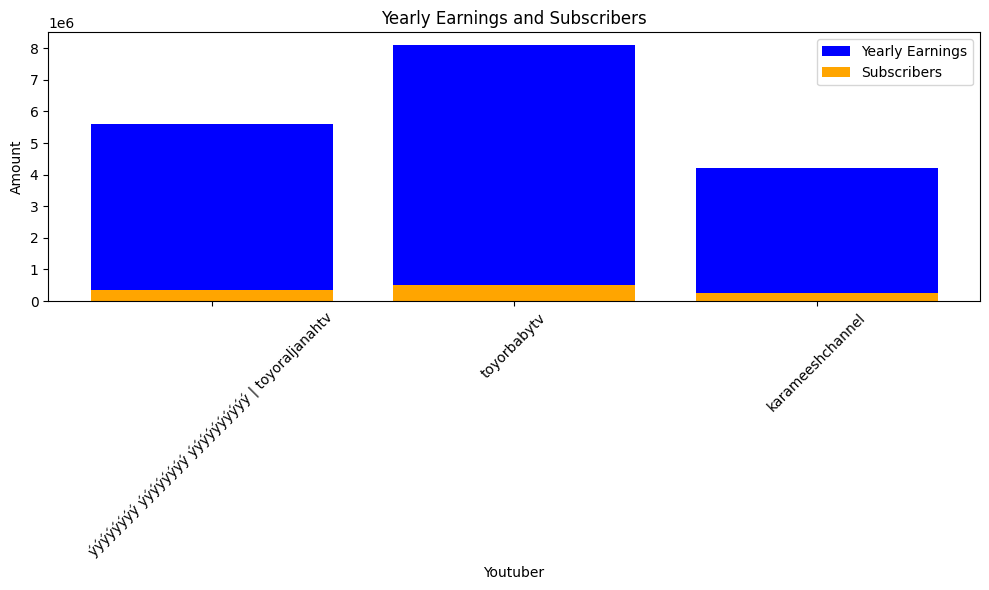

 44%|████▎     | 942/2160 [08:47<09:23,  2.16it/s]check
highest_yearly_earnings: 1900000.0, Subscribers: 117600.0, Youtuber: PewDiePie
highest_yearly_earnings: 34600000.0, Subscribers: 2200000.0, Youtuber: Junya.ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 34100000.0, Subscribers: 2100000.0, Youtuber: Sagawa /ï¿½ï¿½ï¿½
highest_yearly_earnings: 13600000.0, Subscribers: 847100.0, Youtuber: ISSEI / ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 119.0, Subscribers: 7.0, Youtuber: Bayashi TV


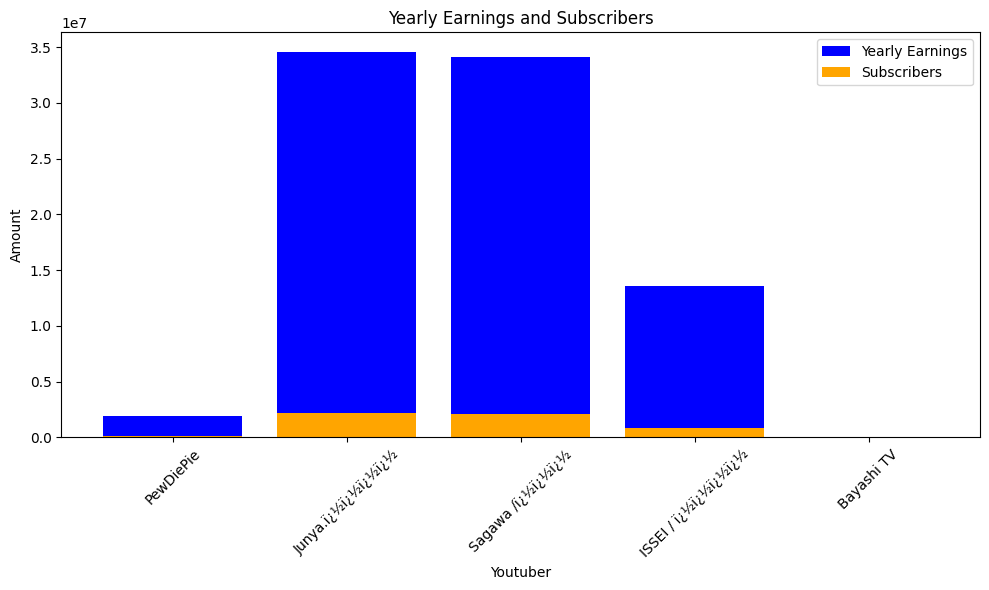

 44%|████▍     | 945/2160 [08:48<09:21,  2.16it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


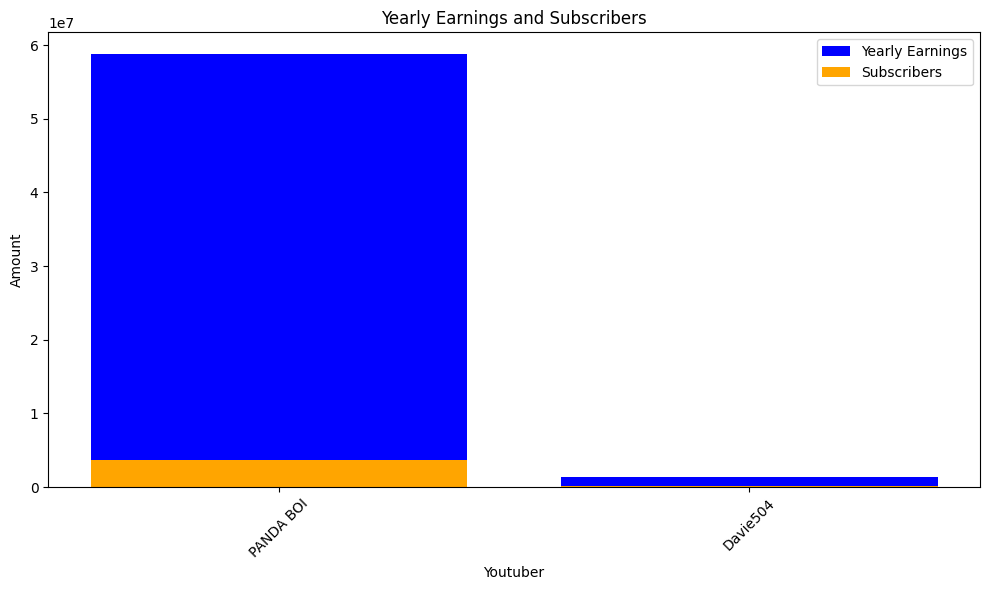

 44%|████▍     | 948/2160 [08:50<08:52,  2.27it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas


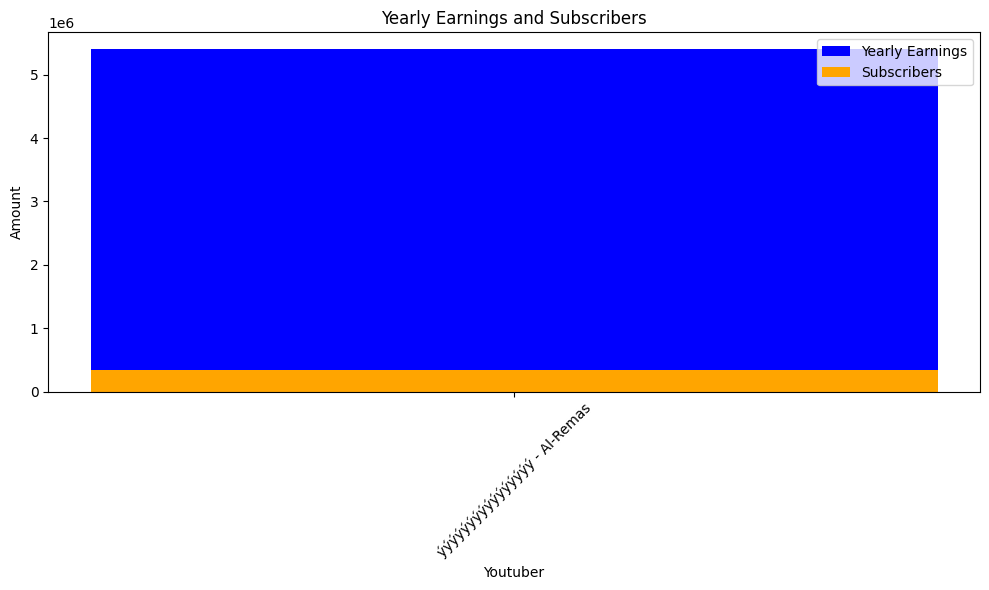

 44%|████▍     | 951/2160 [08:51<08:44,  2.31it/s]check
highest_yearly_earnings: 26300000.0, Subscribers: 1600000.0, Youtuber: Jess No Limit
highest_yearly_earnings: 7500000.0, Subscribers: 471300.0, Youtuber: Ricis Official
highest_yearly_earnings: 1000000.0, Subscribers: 64300.0, Youtuber: AH
highest_yearly_earnings: 11000000.0, Subscribers: 690500.0, Youtuber: Indosiar
highest_yearly_earnings: 2800000.0, Subscribers: 175500.0, Youtuber: Rans Entertainment
highest_yearly_earnings: 5900000.0, Subscribers: 369600.0, Youtuber: TRANS7 OFFICIAL
highest_yearly_earnings: 1300000.0, Subscribers: 80900.0, Youtuber: Baim Paula
highest_yearly_earnings: 4.0, Subscribers: 0.26, Youtuber: Deddy Corbuzier
highest_yearly_earnings: 5400000.0, Subscribers: 338300.0, Youtuber: BabyBus - Cerita & Lagu Anak-anak
highest_yearly_earnings: 3100000.0, Subscribers: 193500.0, Youtuber: MiawAug
highest_yearly_earnings: 9500000.0, Subscribers: 592100.0, Youtuber: Willie Salim
highest_yearly_earnings: 819000.0, S

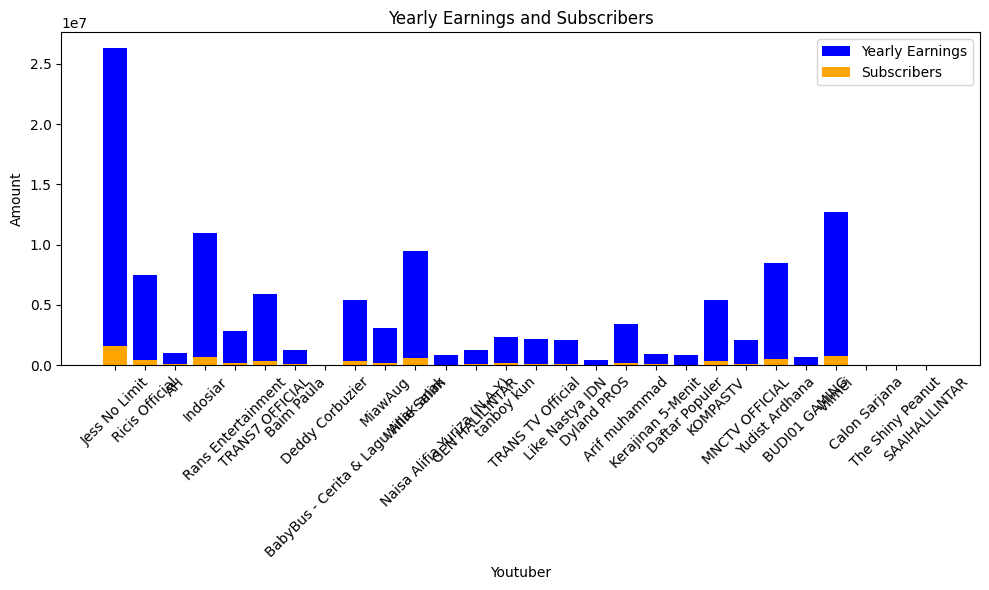

 44%|████▍     | 954/2160 [08:53<09:58,  2.02it/s]check
highest_yearly_earnings: 108400000.0, Subscribers: 6800000.0, Youtuber: T-Series
highest_yearly_earnings: 38600000.0, Subscribers: 2400000.0, Youtuber: Zee Music Company
highest_yearly_earnings: 12200000.0, Subscribers: 764900.0, Youtuber: Shemaroo Filmi Gaane
highest_yearly_earnings: 0.48, Subscribers: 0.03, Youtuber: T-Series Bhakti Sagar
highest_yearly_earnings: 20300000.0, Subscribers: 1300000.0, Youtuber: Tips Official
highest_yearly_earnings: 11100000.0, Subscribers: 696100.0, Youtuber: Wave Music
highest_yearly_earnings: 12400000.0, Subscribers: 777900.0, Youtuber: Sony Music India
highest_yearly_earnings: 24600000.0, Subscribers: 1500000.0, Youtuber: YRF
highest_yearly_earnings: 7700000.0, Subscribers: 479300.0, Youtuber: Speed Records
highest_yearly_earnings: 8700000.0, Subscribers: 542800.0, Youtuber: Ishtar Music
highest_yearly_earnings: 39100000.0, Subscribers: 2400000.0, Youtuber: Goldmines Gaane Sune Ansune
highest_y

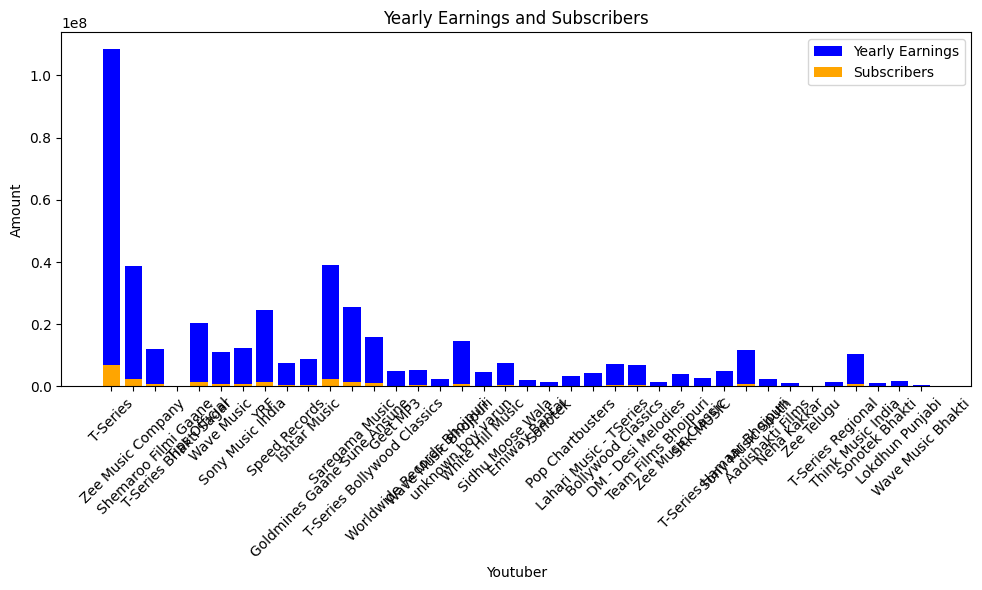

 44%|████▍     | 957/2160 [08:56<11:29,  1.75it/s]check
highest_yearly_earnings: 36300000.0, Subscribers: 2300000.0, Youtuber: Tsuriki Show
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: YOLO
highest_yearly_earnings: 1400000.0, Subscribers: 87800.0, Youtuber: Kurzgesagt ï¿½ï¿½ï¿½ï¿½ï¿½ï¿
highest_yearly_earnings: 271200.0, Subscribers: 17000.0, Youtuber: HaerteTest
highest_yearly_earnings: 29600000.0, Subscribers: 1900000.0, Youtuber: Younes Zarou
highest_yearly_earnings: 1800.0, Subscribers: 114.0, Youtuber: Beast Philanthropy


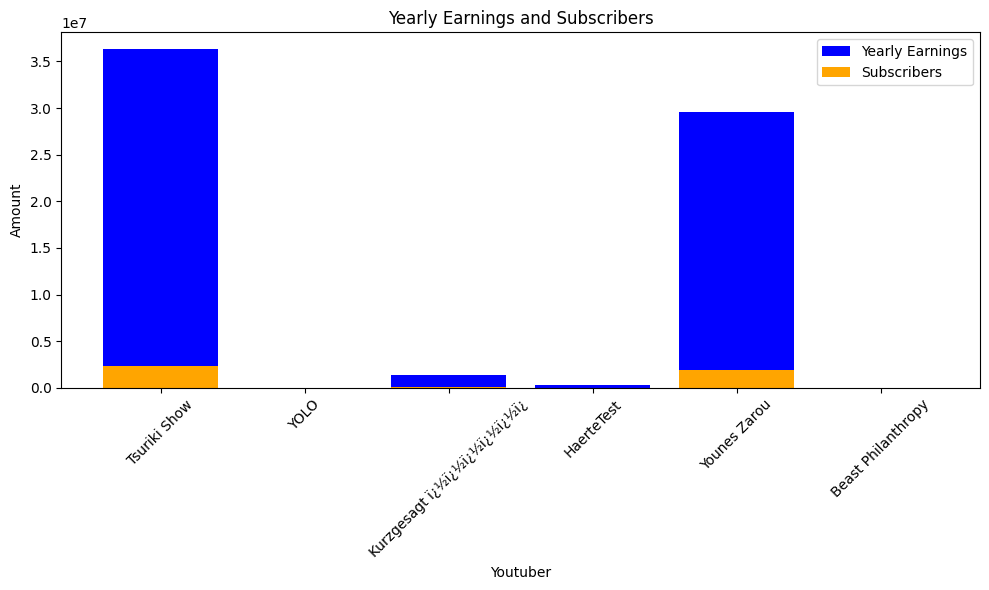

 44%|████▍     | 960/2160 [08:58<10:46,  1.86it/s]check
highest_yearly_earnings: 35.0, Subscribers: 2.0, Youtuber: Smile Family
highest_yearly_earnings: 1500000.0, Subscribers: 91400.0, Youtuber: Lofi Girl


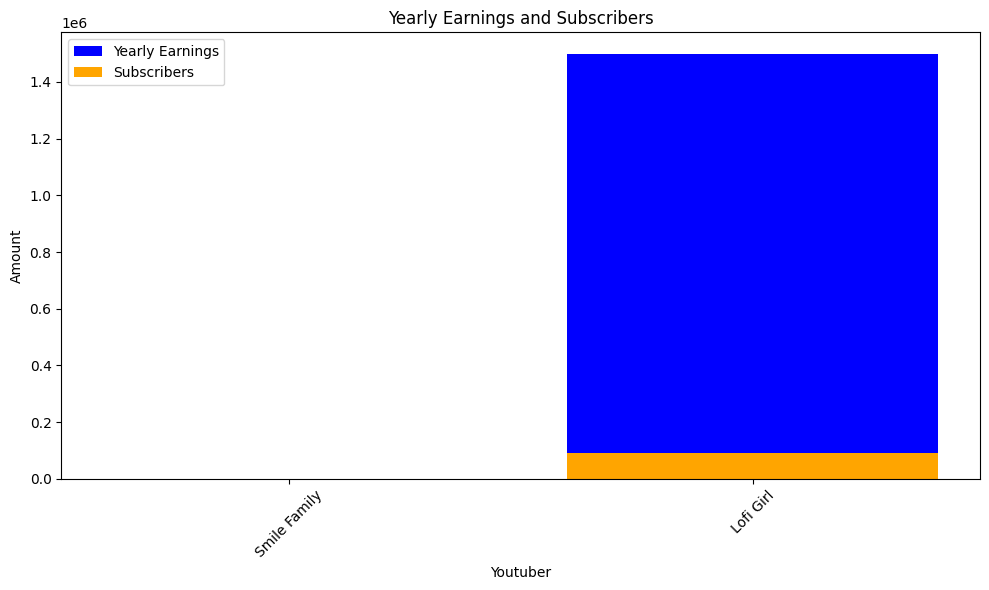

 45%|████▍     | 963/2160 [09:00<11:03,  1.81it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


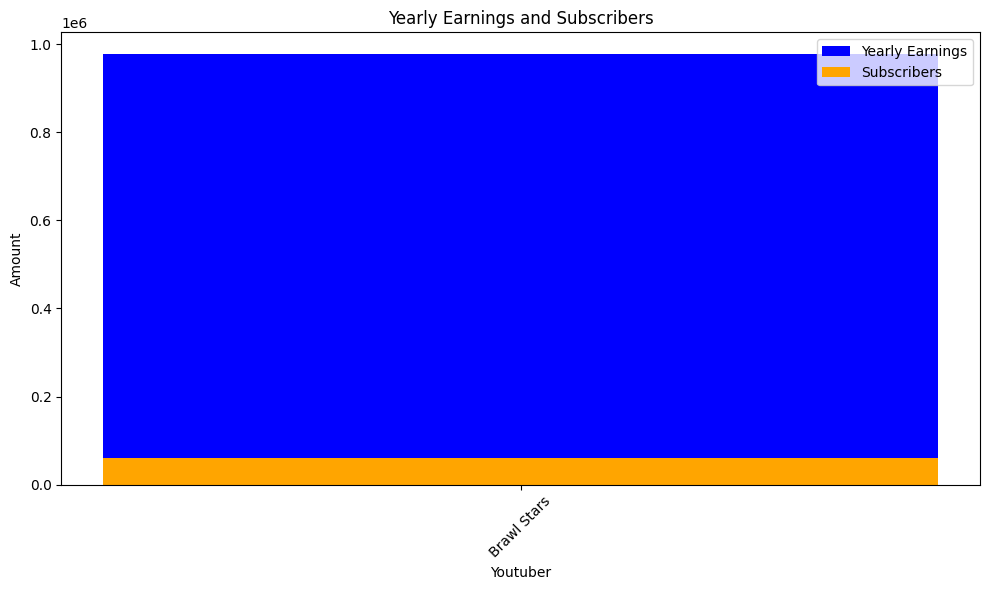

 45%|████▍     | 966/2160 [09:01<09:03,  2.19it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


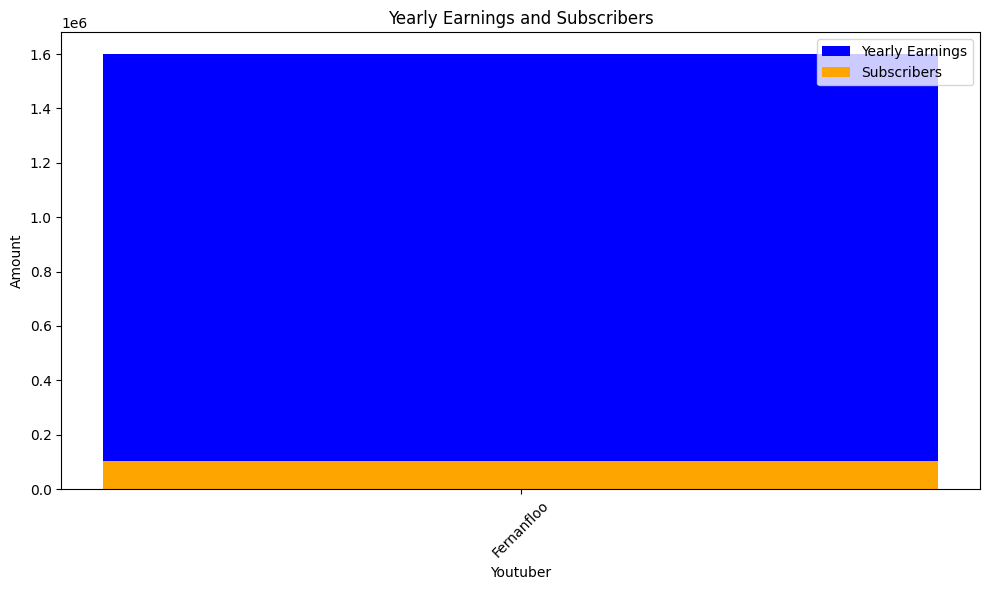

 45%|████▍     | 969/2160 [09:03<08:43,  2.28it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


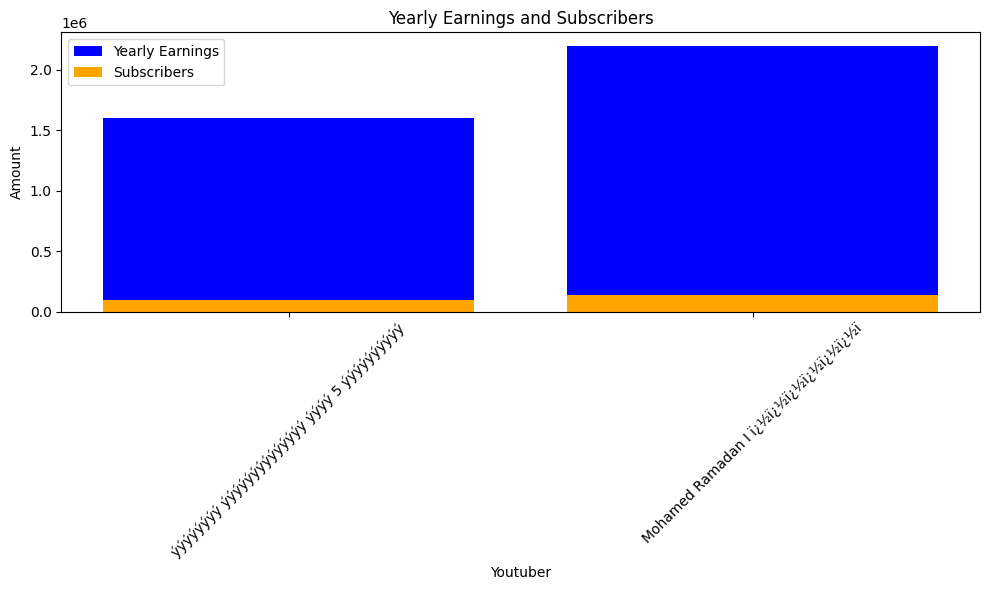

 45%|████▌     | 972/2160 [09:04<08:26,  2.35it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


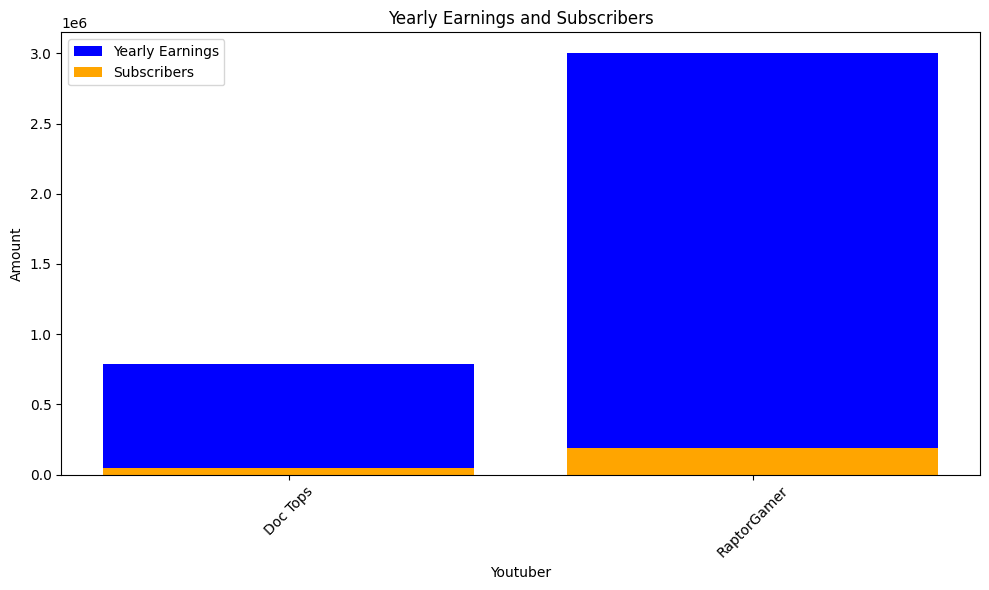

 45%|████▌     | 975/2160 [09:06<08:29,  2.33it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


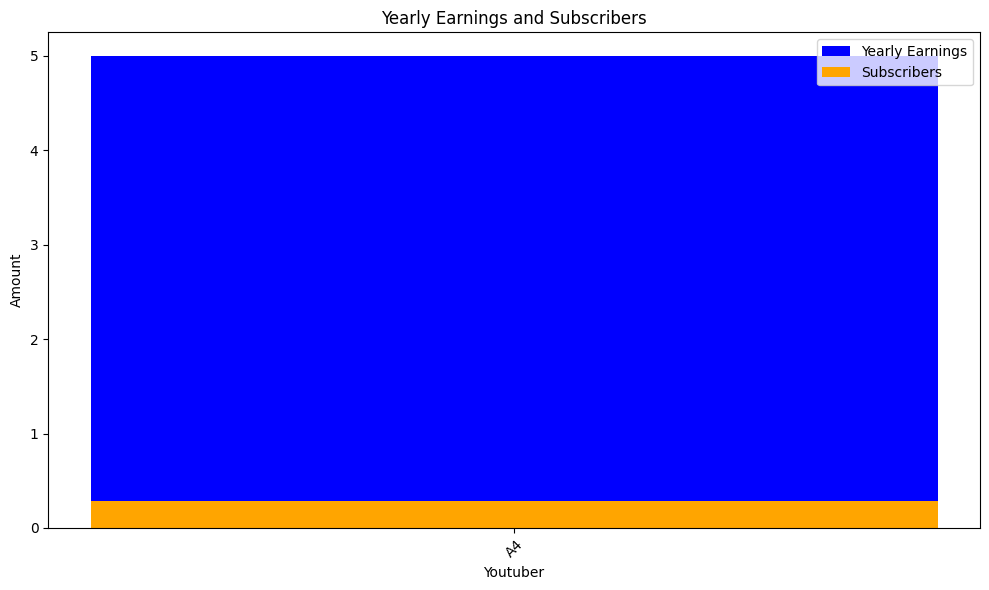

 45%|████▌     | 978/2160 [09:07<08:21,  2.36it/s]check
highest_yearly_earnings: 6200000.0, Subscribers: 386100.0, Youtuber: J Balvin
highest_yearly_earnings: 22400000.0, Subscribers: 1400000.0, Youtuber: KAROL G
highest_yearly_earnings: 8300000.0, Subscribers: 521500.0, Youtuber: toycantando
highest_yearly_earnings: 13600000.0, Subscribers: 852400.0, Youtuber: Anuel AA
highest_yearly_earnings: 2900000.0, Subscribers: 179700.0, Youtuber: Camilo
highest_yearly_earnings: 11000000.0, Subscribers: 686700.0, Youtuber: Codiscos
highest_yearly_earnings: 4100000.0, Subscribers: 258800.0, Youtuber: jbalvinVEVO


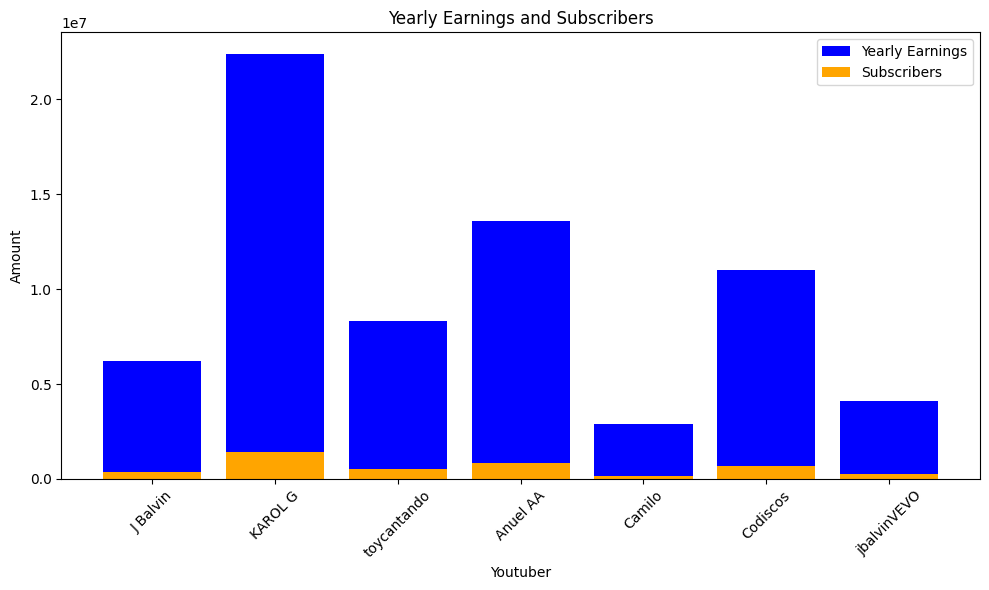

 45%|████▌     | 981/2160 [09:10<11:18,  1.74it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


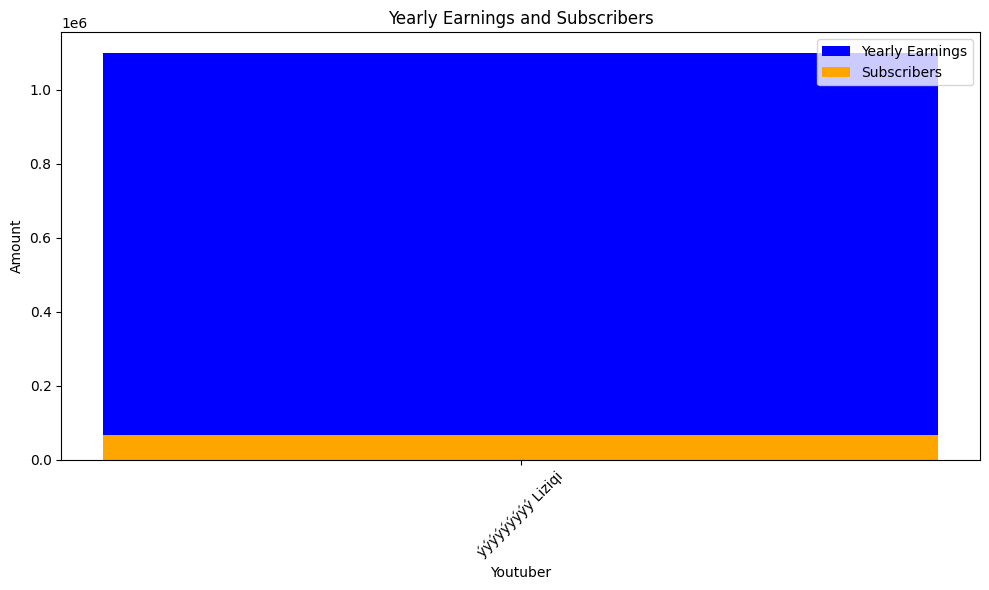

 46%|████▌     | 984/2160 [09:12<10:38,  1.84it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 199200.0, Youtuber: JuegaGerman
highest_yearly_earnings: 2.0, Subscribers: 0.15, Youtuber: invictor
highest_yearly_earnings: 4800000.0, Subscribers: 300600.0, Youtuber: DeGoBooM


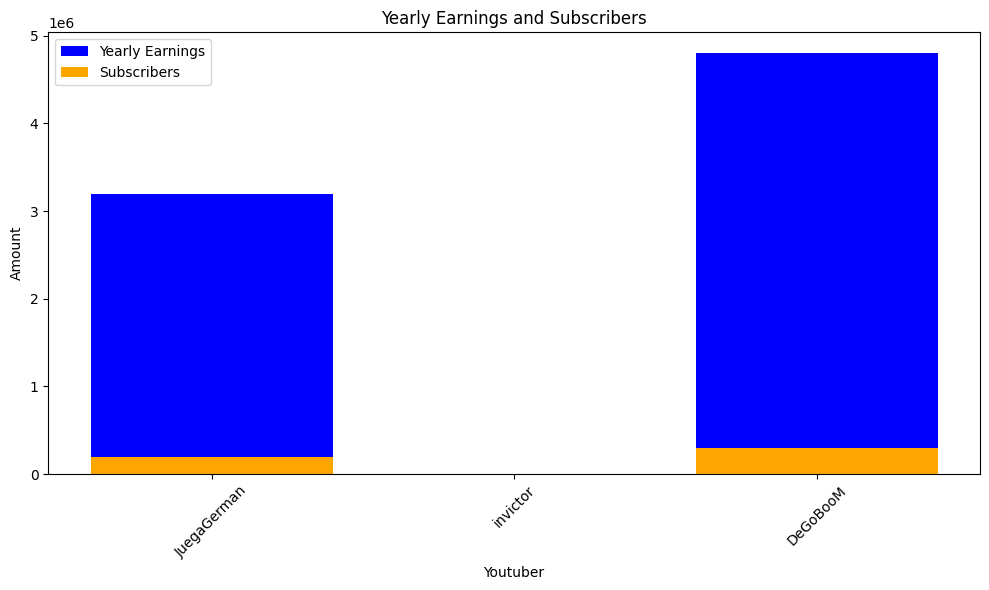

 46%|████▌     | 987/2160 [09:14<10:03,  1.94it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529000.0, Youtuber: Justin Bieber
highest_yearly_earnings: 17900000.0, Subscribers: 1100000.0, Youtuber: The Weeknd
highest_yearly_earnings: 4300000.0, Subscribers: 266200.0, Youtuber: Shawn Mendes


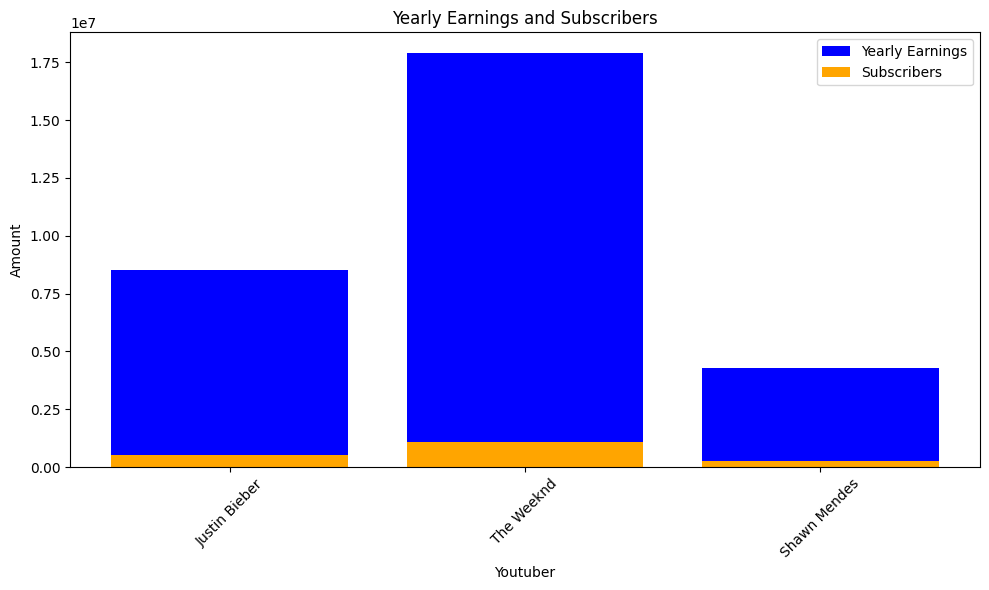

 46%|████▌     | 990/2160 [09:15<10:00,  1.95it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Canal KondZilla
highest_yearly_earnings: 78500000.0, Subscribers: 4900000.0, Youtuber: GR6 EXPLODE
highest_yearly_earnings: 10300000.0, Subscribers: 644400.0, Youtuber: Gusttavo Lima Oficial
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Dan-Sa / Daniel Saboya
highest_yearly_earnings: 3500000.0, Subscribers: 218100.0, Youtuber: Anitta
highest_yearly_earnings: 6500000.0, Subscribers: 409200.0, Youtuber: MK MUSIC
highest_yearly_earnings: 7900000.0, Subscribers: 491000.0, Youtuber: Henrique e Juliano
highest_yearly_earnings: 8800000.0, Subscribers: 548600.0, Youtuber: Zï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï
highest_yearly_earnings: 4200000.0, Subscribers: 264400.0, Youtuber: Jorge & Mateus Oficial
highest_yearly_earnings: 5300000.0, Subscribers: 329600.0, Youtuber: O Reino Infantil
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: LEGENDA FUNK
highest_yearly_earnings: 3100000.

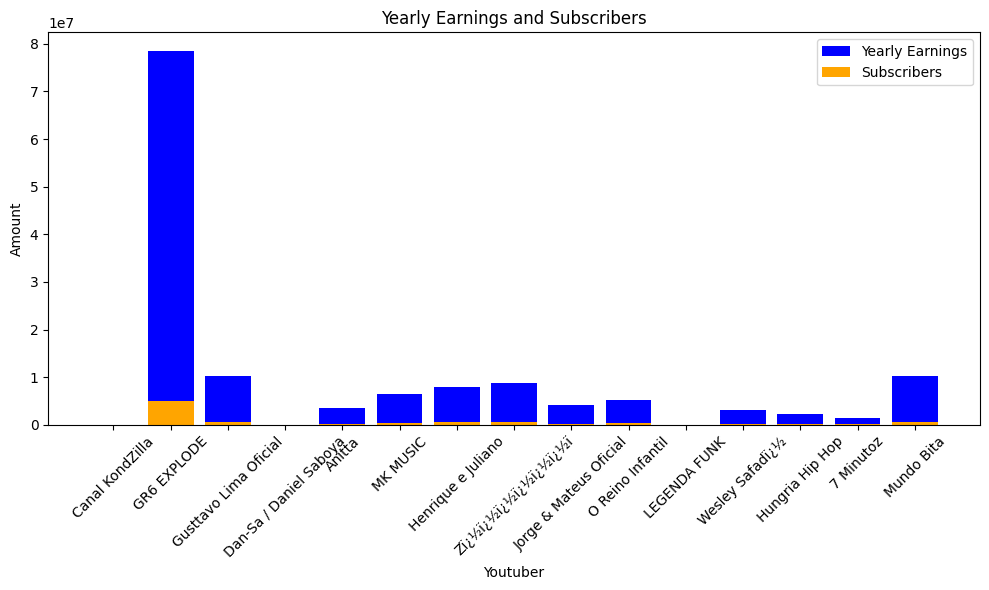

 46%|████▌     | 993/2160 [09:17<10:32,  1.84it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


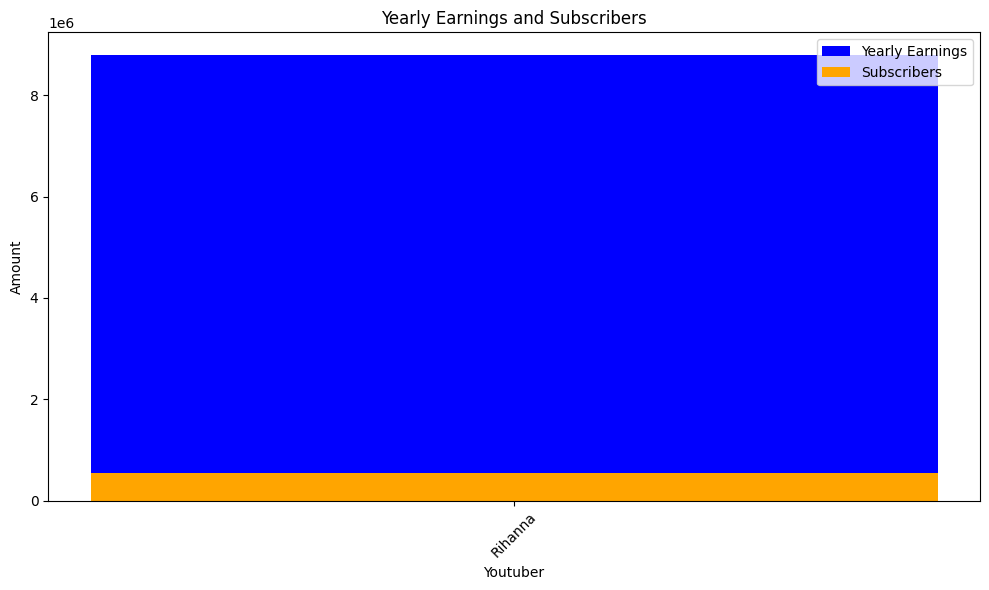

 46%|████▌     | 996/2160 [09:19<09:02,  2.14it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


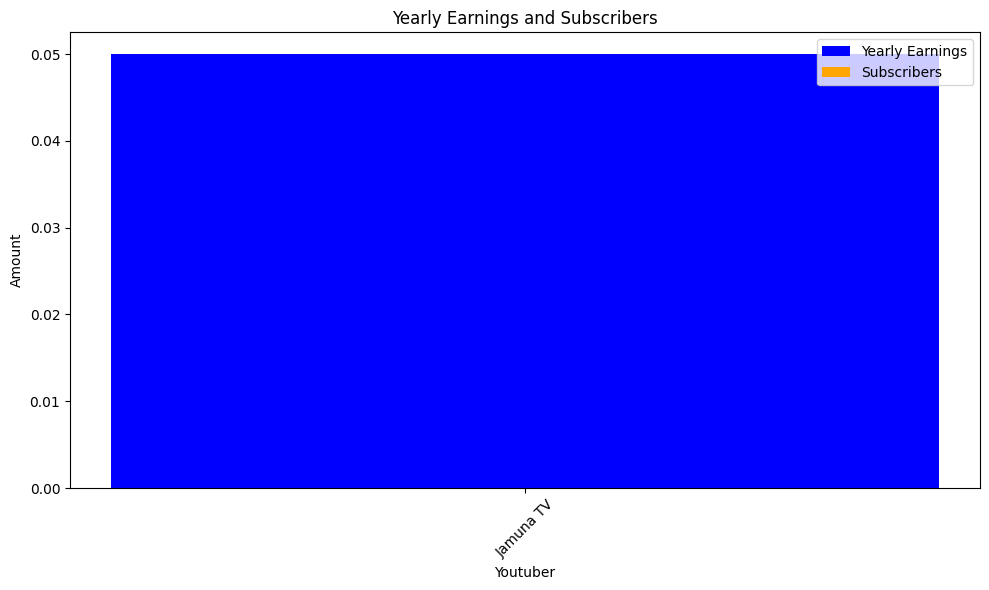

 46%|████▋     | 999/2160 [09:21<08:38,  2.24it/s]check
highest_yearly_earnings: 6100000.0, Subscribers: 382300.0, Youtuber: Bounce Patrol - Kids Songs


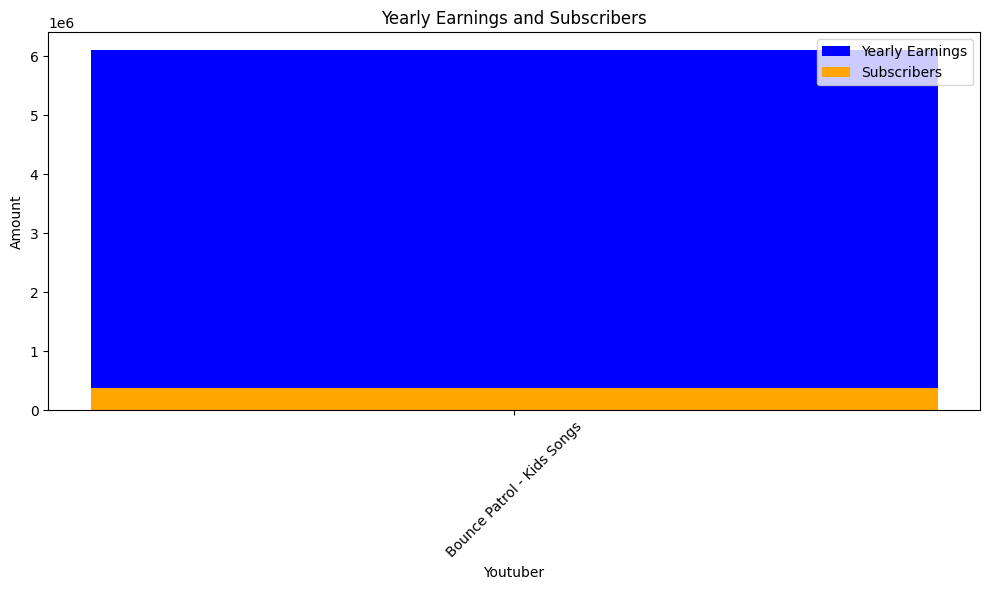

 46%|████▋     | 1002/2160 [09:22<08:37,  2.24it/s]check
highest_yearly_earnings: 29400000.0, Subscribers: 1800000.0, Youtuber: El Reino Infantil
highest_yearly_earnings: 14500000.0, Subscribers: 906200.0, Youtuber: La Granja de Zenï¿½
highest_yearly_earnings: 3500000.0, Subscribers: 216700.0, Youtuber: Paulo Londra
highest_yearly_earnings: 30700000.0, Subscribers: 1900000.0, Youtuber: El Payaso Plim Plim


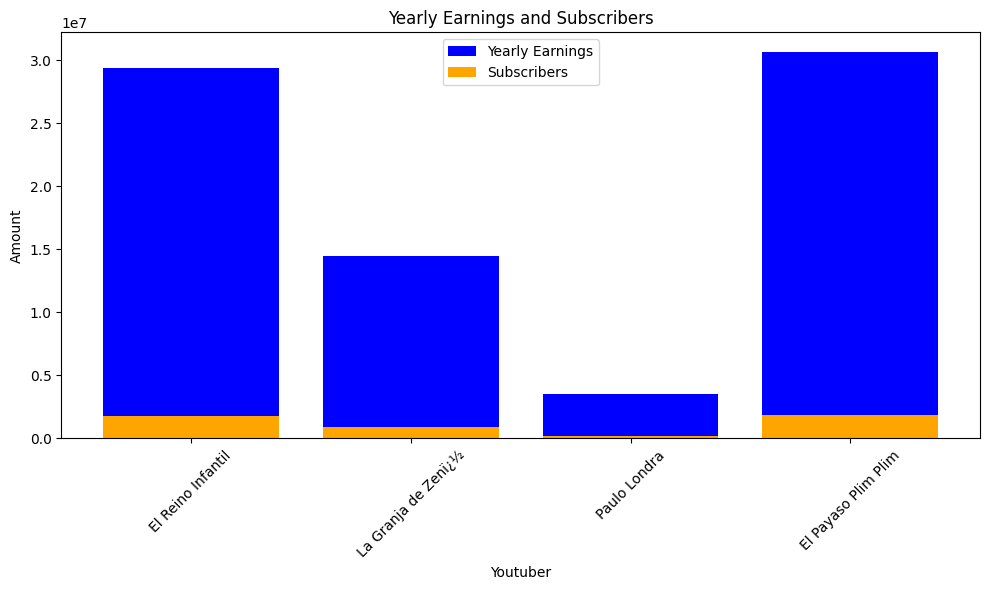

 47%|████▋     | 1005/2160 [09:24<08:40,  2.22it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


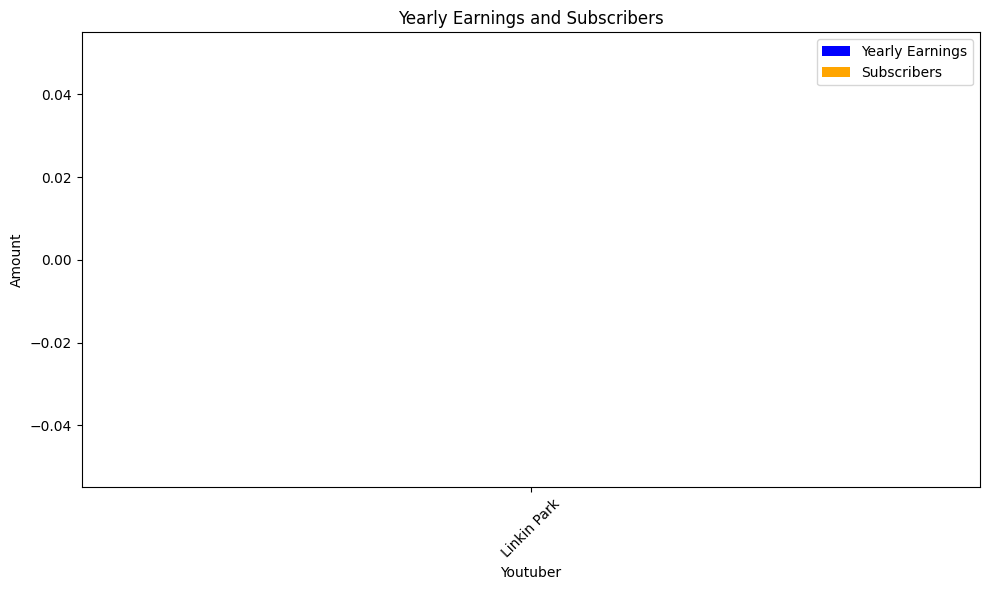

 47%|████▋     | 1008/2160 [09:25<08:30,  2.26it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


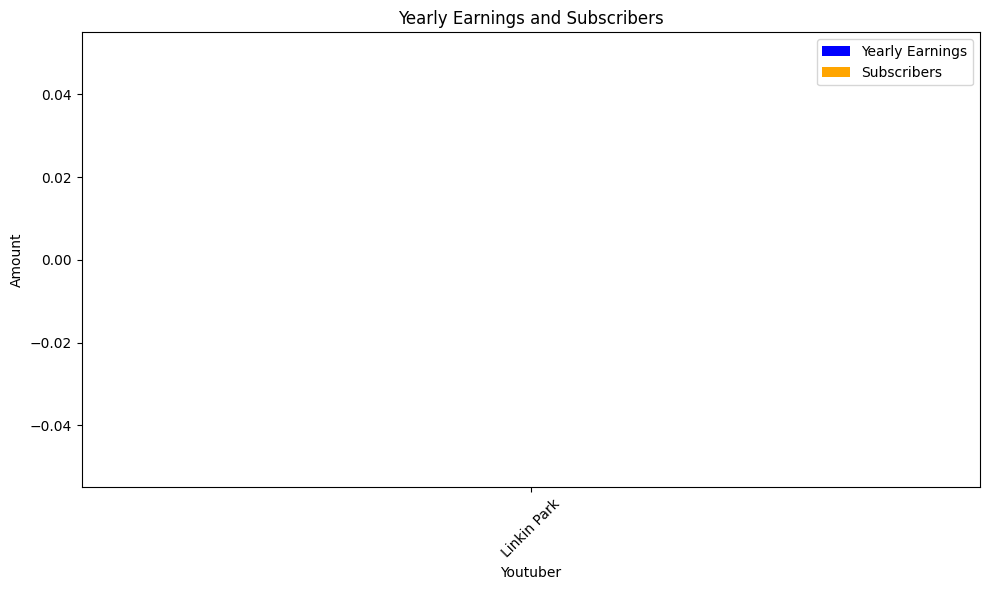

check
highest_yearly_earnings: 4100000.0, Subscribers: 253400.0, Youtuber: Like Nastya VNM
highest_yearly_earnings: 12300000.0, Subscribers: 770200.0, Youtuber: POPS Kids
highest_yearly_earnings: 1700000.0, Subscribers: 105400.0, Youtuber: FAPTV


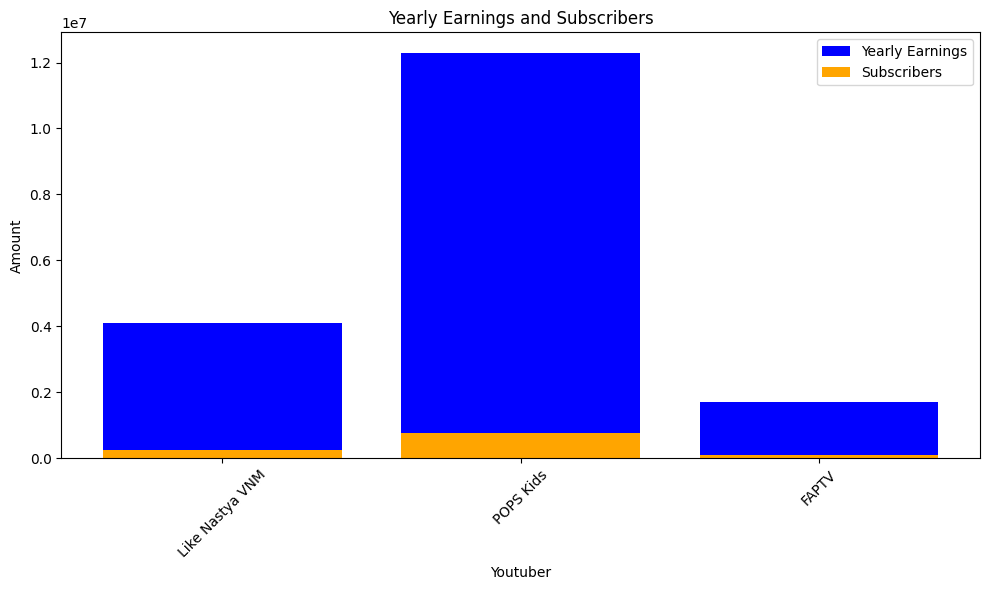

 47%|████▋     | 1011/2160 [09:28<10:17,  1.86it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


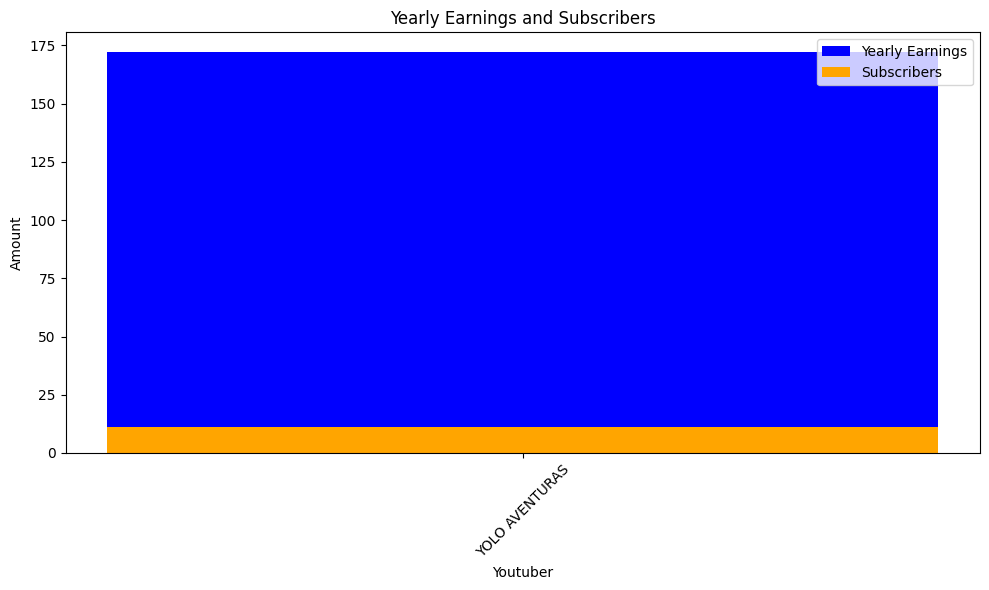

 47%|████▋     | 1014/2160 [09:29<10:15,  1.86it/s]check
highest_yearly_earnings: 4700000.0, Subscribers: 294200.0, Youtuber: Troom Troom
highest_yearly_earnings: 1200000.0, Subscribers: 74100.0, Youtuber: Tasty
highest_yearly_earnings: 960600.0, Subscribers: 60000.0, Youtuber: 5-Minute Crafts DIY
highest_yearly_earnings: 5100000.0, Subscribers: 317400.0, Youtuber: 5-Minute Crafts PLAY
highest_yearly_earnings: 96300.0, Subscribers: 6000.0, Youtuber: jeffreestar
highest_yearly_earnings: 1300000.0, Subscribers: 82100.0, Youtuber: 5-Minute Crafts FAMILY
highest_yearly_earnings: 2600000.0, Subscribers: 159500.0, Youtuber: 5-Minute Crafts Recycle
highest_yearly_earnings: 1300000.0, Subscribers: 80000.0, Youtuber: Rosanna Pansino
highest_yearly_earnings: 64100.0, Subscribers: 4000.0, Youtuber: Wengie
highest_yearly_earnings: 695900.0, Subscribers: 43500.0, Youtuber: ATHLEAN-Xï¿½
highest_yearly_earnings: 2900000.0, Subscribers: 182000.0, Youtuber: ýýýýýýýýýýýýýýý Ms Yeah
highest_yearly_earnin

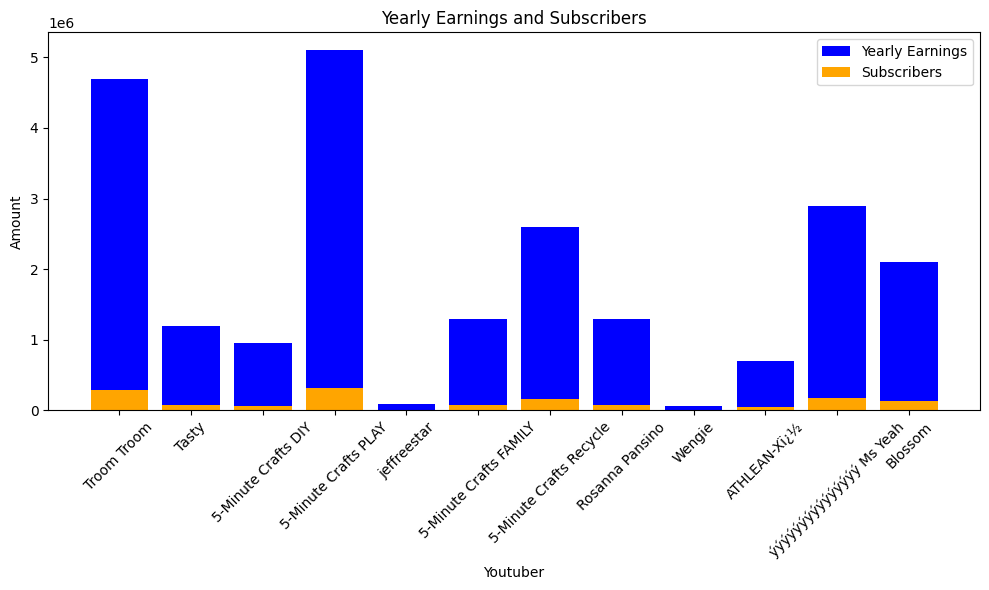

 47%|████▋     | 1017/2160 [09:32<10:48,  1.76it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: 5-Minute Crafts
highest_yearly_earnings: 9700000.0, Subscribers: 608200.0, Youtuber: Ed Sheeran
highest_yearly_earnings: 2700000.0, Subscribers: 167000.0, Youtuber: NoCopyrightSounds
highest_yearly_earnings: 2700000.0, Subscribers: 169600.0, Youtuber: Mr Bean
highest_yearly_earnings: 11800000.0, Subscribers: 734800.0, Youtuber: Peppa Pig - Official Channel
highest_yearly_earnings: 6600000.0, Subscribers: 411300.0, Youtuber: Adele
highest_yearly_earnings: 3800000.0, Subscribers: 236000.0, Youtuber: DanTDM
highest_yearly_earnings: 9500000.0, Subscribers: 596600.0, Youtuber: Coldplay
highest_yearly_earnings: 15900000.0, Subscribers: 995700.0, Youtuber: Dan Rhodes
highest_yearly_earnings: 261100.0, Subscribers: 16300.0, Youtuber: KSI
highest_yearly_earnings: 1600000.0, Subscribers: 98400.0, Youtuber: Mister Max
highest_yearly_earnings: 2600000.0, Subscribers: 160800.0, Youtub

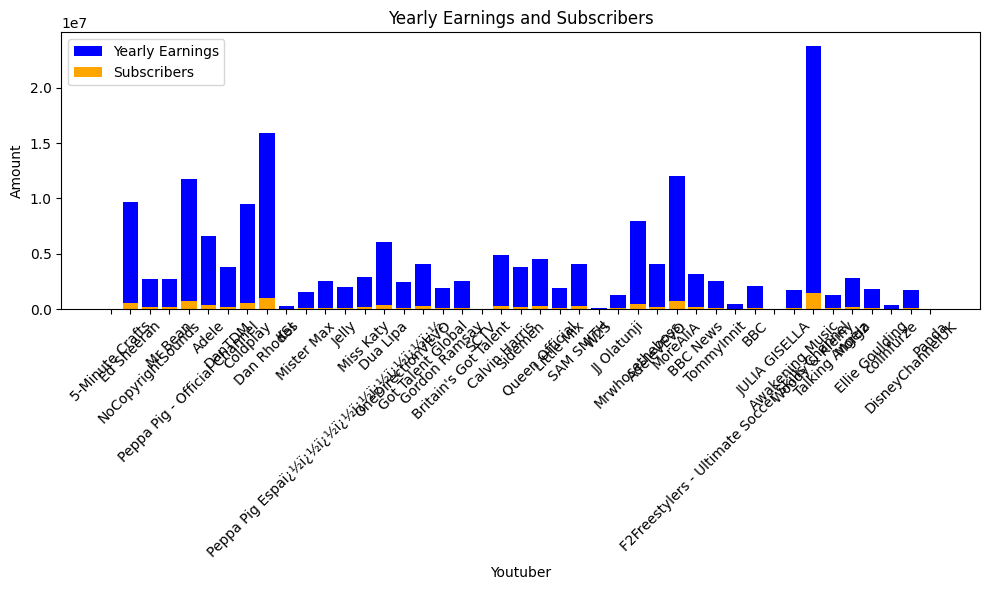

 47%|████▋     | 1020/2160 [09:35<13:02,  1.46it/s]check
highest_yearly_earnings: 11900000.0, Subscribers: 743200.0, Youtuber: shfa2 - ï¿½ï¿½
highest_yearly_earnings: 7300000.0, Subscribers: 453600.0, Youtuber: shfa show India
highest_yearly_earnings: 76700000.0, Subscribers: 4800000.0, Youtuber: ZAMZAM ELECTRONICS TRADING
highest_yearly_earnings: 746700.0, Subscribers: 46700.0, Youtuber: Noor Stars
highest_yearly_earnings: 3800000.0, Subscribers: 240500.0, Youtuber: FFUNTV
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Supercar Blondie
highest_yearly_earnings: 3900000.0, Subscribers: 240700.0, Youtuber: AlArabiya ï¿½ï¿½ï¿½ï¿½ï¿


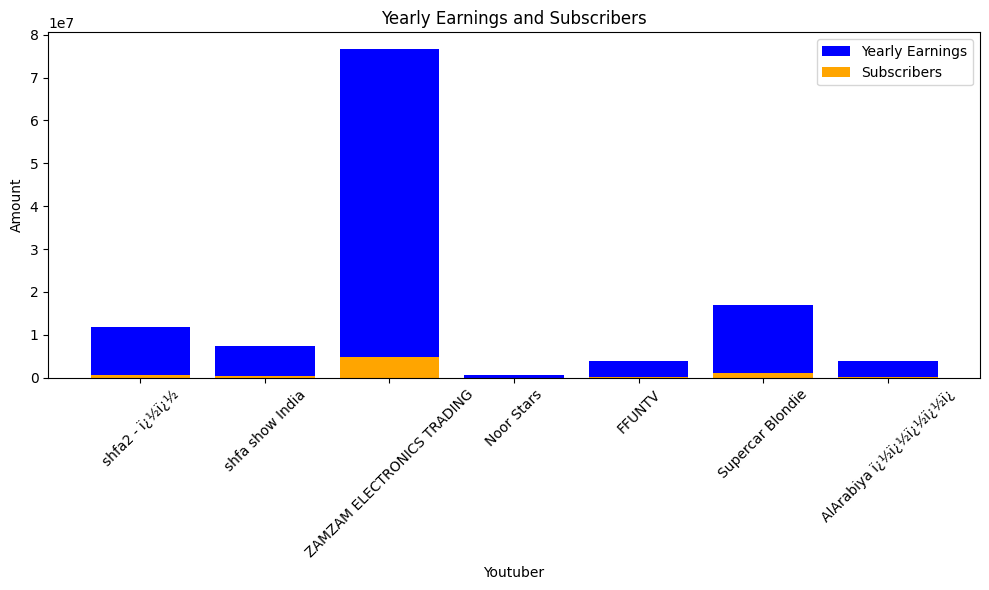

 47%|████▋     | 1023/2160 [09:36<10:33,  1.79it/s]check
highest_yearly_earnings: 2300000.0, Subscribers: 141400.0, Youtuber: ýýýýýýýý ýýýýýýýý


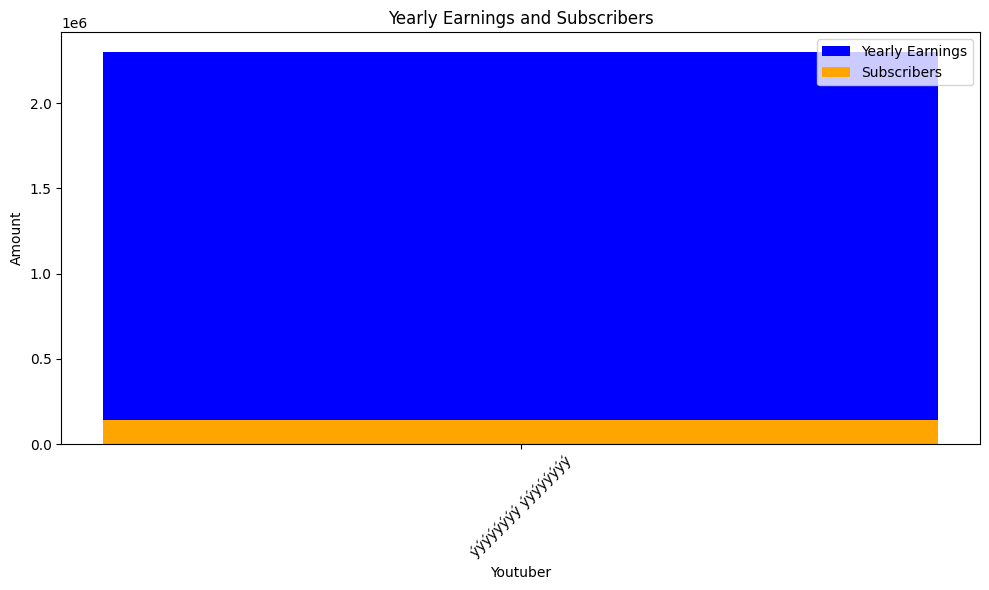

 48%|████▊     | 1026/2160 [09:38<09:03,  2.09it/s]check
highest_yearly_earnings: 70200000.0, Subscribers: 4400000.0, Youtuber: BETER Bï¿½ï¿½
highest_yearly_earnings: 20400000.0, Subscribers: 1300000.0, Youtuber: netd mï¿½ï¿
highest_yearly_earnings: 5300000.0, Subscribers: 332400.0, Youtuber: tabii Urdu
highest_yearly_earnings: 212500.0, Subscribers: 13300.0, Youtuber: Oyuncak Avï¿


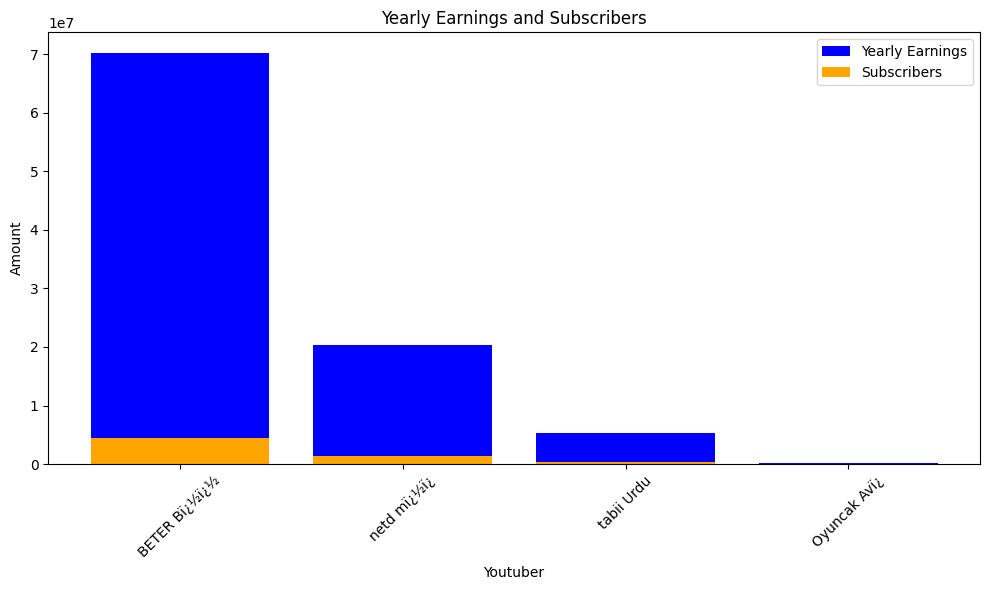

 48%|████▊     | 1029/2160 [09:40<08:50,  2.13it/s]check
highest_yearly_earnings: 1.0, Subscribers: 0.07, Youtuber: Alan Walker
highest_yearly_earnings: 6300000.0, Subscribers: 391400.0, Youtuber: WorkpointOfficial
highest_yearly_earnings: 6800000.0, Subscribers: 422300.0, Youtuber: ýýýýýýýýýýýý one31
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Ch3Thailand
highest_yearly_earnings: 6300000.0, Subscribers: 390700.0, Youtuber: GMM GRAMMY OFFICIAL
highest_yearly_earnings: 8100000.0, Subscribers: 505800.0, Youtuber: GRAMMY GOLD OFFICIAL
highest_yearly_earnings: 2600000.0, Subscribers: 162400.0, Youtuber: RsiamMusic : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: zbing z.
highest_yearly_earnings: 11300000.0, Subscribers: 708000.0, Youtuber: AMARINTV : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 448400.0, Subscribers: 28000.0, Youtuber: Kaykai Salaider
highest_yearly_earnings: 4200000.0, Subscribers: 263300.0, You

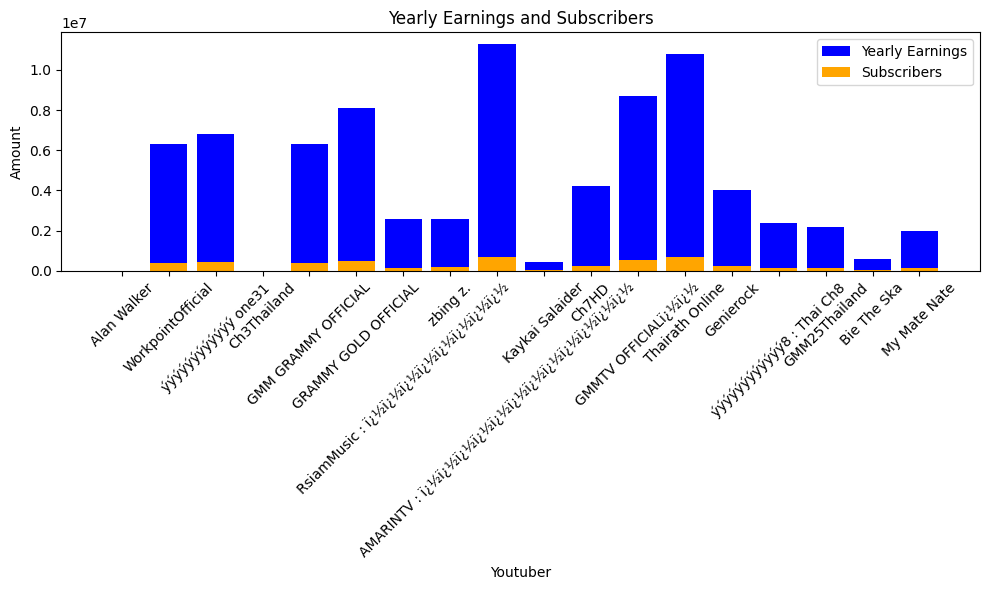

 48%|████▊     | 1032/2160 [09:41<09:19,  2.02it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


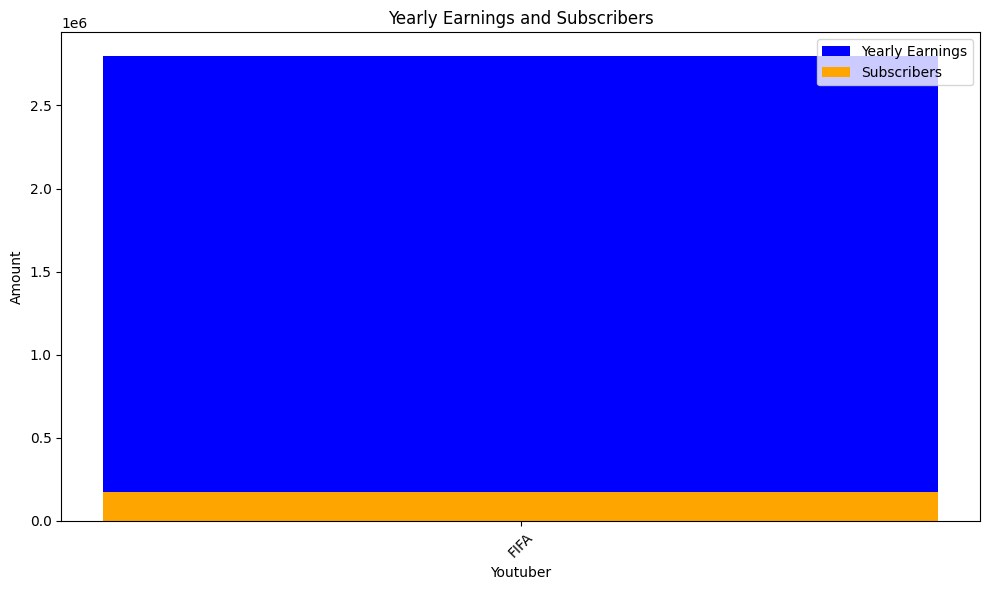

 48%|████▊     | 1035/2160 [09:43<08:39,  2.17it/s]check
highest_yearly_earnings: 3900000.0, Subscribers: 243700.0, Youtuber: Avicii
highest_yearly_earnings: 23000000.0, Subscribers: 1400000.0, Youtuber: Panda Shorts
highest_yearly_earnings: 658000.0, Subscribers: 41100.0, Youtuber: Narins Beauty
highest_yearly_earnings: 185800.0, Subscribers: 11600.0, Youtuber: RobTopGames


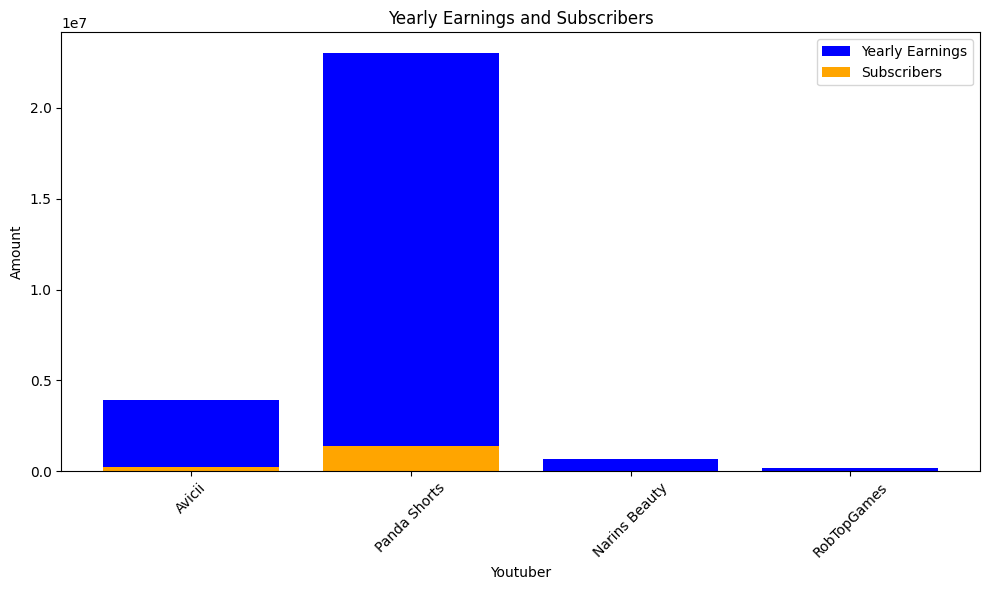

 48%|████▊     | 1038/2160 [09:45<09:02,  2.07it/s]check
highest_yearly_earnings: 12700000.0, Subscribers: 792300.0, Youtuber: Mikecrack
highest_yearly_earnings: 1900000.0, Subscribers: 117300.0, Youtuber: VEGETTA777
highest_yearly_earnings: 582900.0, Subscribers: 36400.0, Youtuber: AuronPlay
highest_yearly_earnings: 5.0, Subscribers: 0.31, Youtuber: CKN
highest_yearly_earnings: 528200.0, Subscribers: 33000.0, Youtuber: TheWillyrex
highest_yearly_earnings: 2100000.0, Subscribers: 131500.0, Youtuber: TheGrefg
highest_yearly_earnings: 739500.0, Subscribers: 46200.0, Youtuber: Willyrex
highest_yearly_earnings: 3100.0, Subscribers: 196.0, Youtuber: IDEAS EN 5 MINUTOS
highest_yearly_earnings: 0.19, Subscribers: 0.01, Youtuber: AdMe
highest_yearly_earnings: 4100000.0, Subscribers: 254600.0, Youtuber: FC Barcelona
highest_yearly_earnings: 286600.0, Subscribers: 17900.0, Youtuber: Makiman131
highest_yearly_earnings: 665200.0, Subscribers: 41600.0, Youtuber: iTownGamePlay *Terror&Diversiï¿½ï
hi

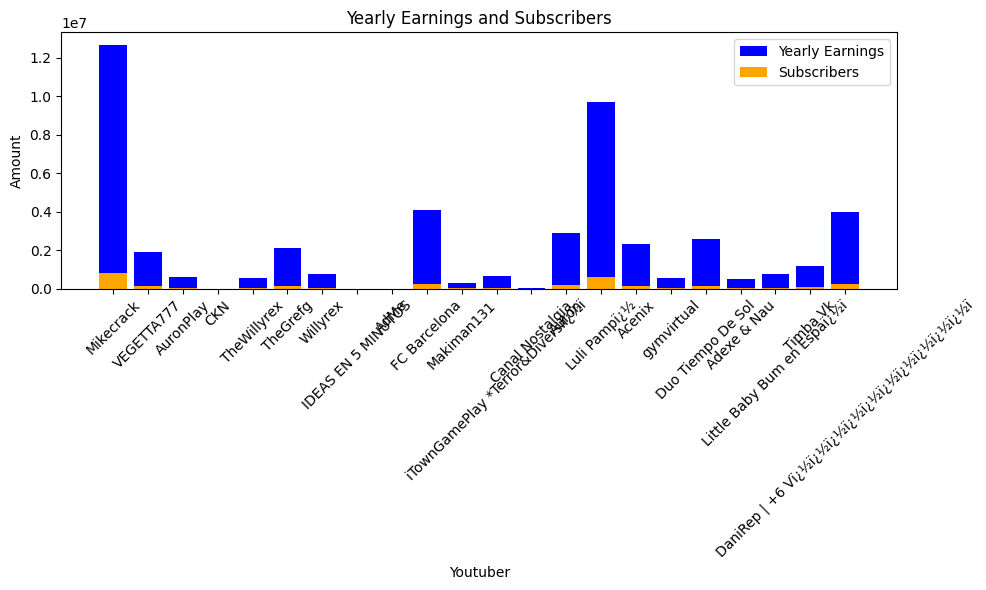

 48%|████▊     | 1041/2160 [09:48<13:22,  1.39it/s]check
highest_yearly_earnings: 23900000.0, Subscribers: 1500000.0, Youtuber: BLACKPINK
highest_yearly_earnings: 8100000.0, Subscribers: 504900.0, Youtuber: BANGTANTV
highest_yearly_earnings: 28700000.0, Subscribers: 1800000.0, Youtuber: HYBE LABELS
highest_yearly_earnings: 14800000.0, Subscribers: 922900.0, Youtuber: JYP Entertainment
highest_yearly_earnings: 5100000.0, Subscribers: 316700.0, Youtuber: 1theK (ï¿½ï¿½ï¿½ï¿½ï
highest_yearly_earnings: 7600000.0, Subscribers: 475600.0, Youtuber: Mnet K-POP
highest_yearly_earnings: 5200000.0, Subscribers: 324000.0, Youtuber: KBS WORLD TV
highest_yearly_earnings: 3100000.0, Subscribers: 195000.0, Youtuber: officialpsy
highest_yearly_earnings: 163400000.0, Subscribers: 10200000.0, Youtuber: ýýýýýýýýý KIMPRO
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Jane ASMR ï¿½ï¿½
highest_yearly_earnings: 532700.0, Subscribers: 33300.0, Youtuber: JFlaMusic
highest_yearly_earnings: 2000000.0, S

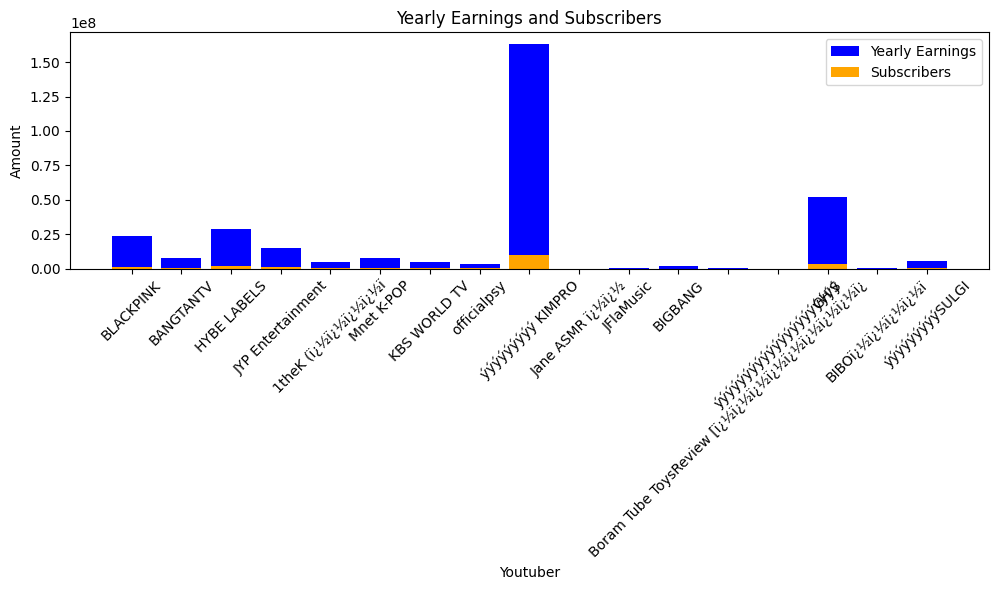

 48%|████▊     | 1044/2160 [09:51<12:59,  1.43it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Sandeep Maheshwari
highest_yearly_earnings: 5600000.0, Subscribers: 351600.0, Youtuber: LEGO
highest_yearly_earnings: 45100.0, Subscribers: 2800.0, Youtuber: MY FAMILY


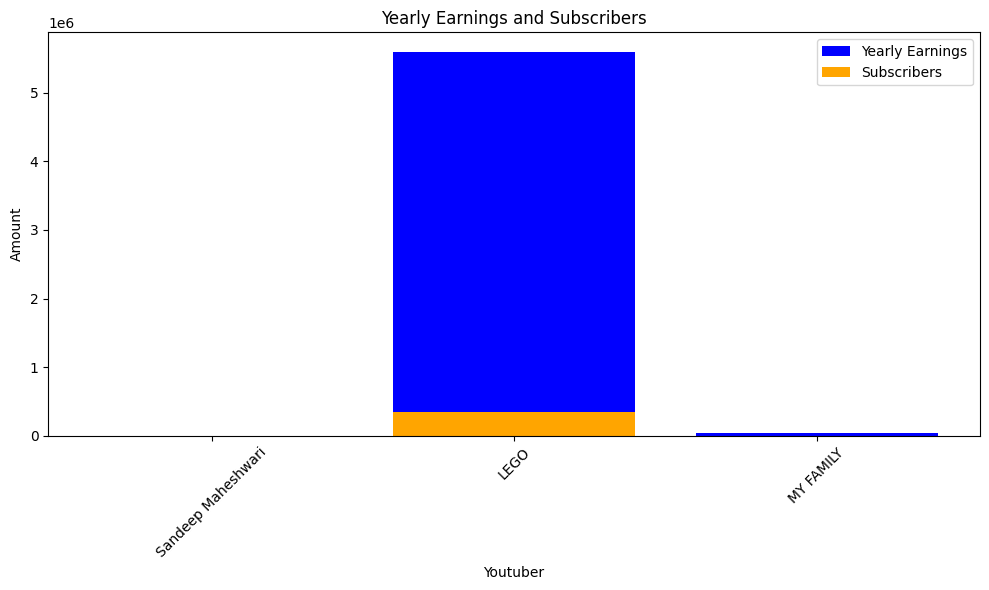

 48%|████▊     | 1047/2160 [09:52<09:45,  1.90it/s]check
highest_yearly_earnings: 76300.0, Subscribers: 4800.0, Youtuber: shfa
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: 1MILLION Dance Studio
highest_yearly_earnings: 3500000.0, Subscribers: 221500.0, Youtuber: mmoshaya
highest_yearly_earnings: 2100000.0, Subscribers: 129000.0, Youtuber: ýýýýýýýý ýýýýýýýýýý ýýýýýýýýýý | Arab Games Network
highest_yearly_earnings: 4400000.0, Subscribers: 272700.0, Youtuber: Katakit Baby TV
highest_yearly_earnings: 6500000.0, Subscribers: 405100.0, Youtuber: ýýýýýýýý ýý ýýýýýýýý
highest_yearly_earnings: 129300.0, Subscribers: 8100.0, Youtuber: ýýýýýýýýýý ýýýýýýýýýýýý
highest_yearly_earnings: 224300.0, Subscribers: 14000.0, Youtuber: ýýýýýýýýýýýý ýýýýýýýýýýýý I ýýýýýý ýý ýýýýýýýýýý
highest_yearly_earnings: 3400000.0, Subscribers: 212100.0, Youtuber: BanderitaX


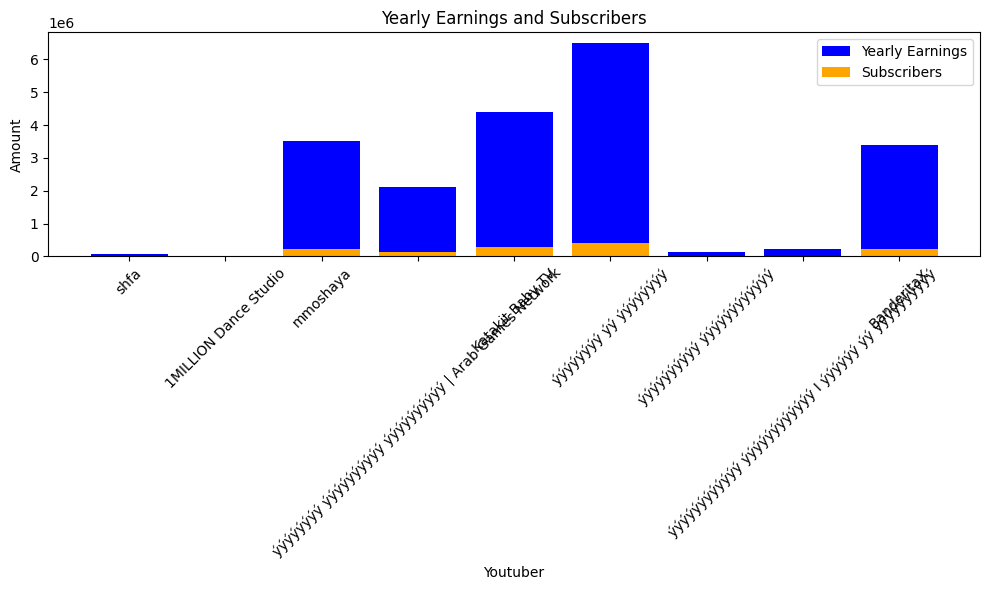

 49%|████▊     | 1050/2160 [09:54<09:02,  2.05it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


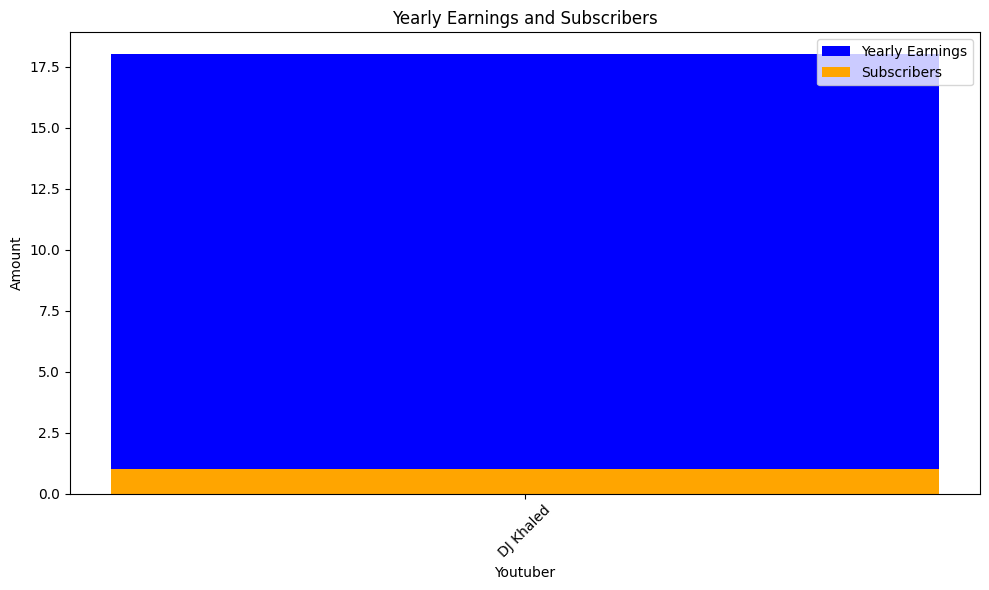

 49%|████▉     | 1053/2160 [09:55<08:18,  2.22it/s]check
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya
highest_yearly_earnings: 14700000.0, Subscribers: 919600.0, Youtuber: Get Movies
highest_yearly_earnings: 14600000.0, Subscribers: 911300.0, Youtuber: ýýýýýýýý ýý ýýýýýýýýýýýýýý
highest_yearly_earnings: 26500000.0, Subscribers: 1700000.0, Youtuber: tuzelity SHUFFLE
highest_yearly_earnings: 1200000.0, Subscribers: 73700.0, Youtuber: HiMan
highest_yearly_earnings: 1800000.0, Subscribers: 114800.0, Youtuber: Marmok
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya Vlog
highest_yearly_earnings: 1800000.0, Subscribers: 111500.0, Youtuber: TheBrianMaps
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: ýýýýýýýýýý
highest_yearly_earnings: 22800000.0, Subscribers: 1400000.0, Youtuber: ILYA BORZOV
highest_yearly_earnings: 4600000.0, Subscribers: 286800.0, Youtuber: EdisonPts
highest_yearly_earnings: 34200000.0, Subscriber

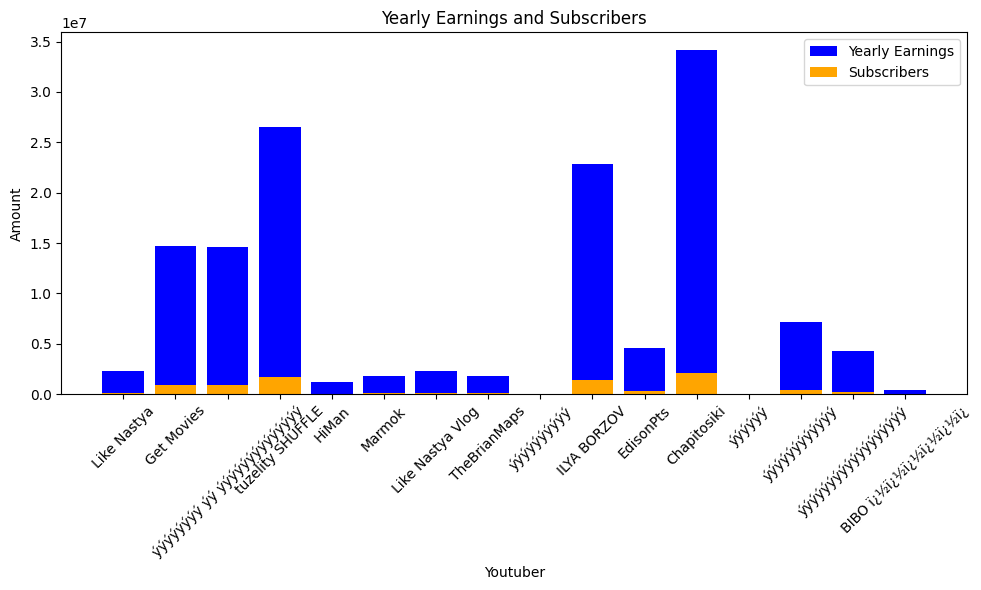

 49%|████▉     | 1056/2160 [09:57<08:57,  2.06it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529900.0, Youtuber: ABS-CBN Entertainment
highest_yearly_earnings: 38300000.0, Subscribers: 2400000.0, Youtuber: GMA  Network
highest_yearly_earnings: 7800000.0, Subscribers: 489400.0, Youtuber: Raffy Tulfo in Action
highest_yearly_earnings: 6800000.0, Subscribers: 427000.0, Youtuber: GMA Public  Affairs
highest_yearly_earnings: 723800.0, Subscribers: 45200.0, Youtuber: Ivana Alawi
highest_yearly_earnings: 479000.0, Subscribers: 29900.0, Youtuber: Niana Guerrero
highest_yearly_earnings: 594000.0, Subscribers: 37100.0, Youtuber: Ranz Kyle
highest_yearly_earnings: 8700000.0, Subscribers: 544900.0, Youtuber: ABS-CBN News
highest_yearly_earnings: 3000000.0, Subscribers: 188000.0, Youtuber: Wish 107.5
highest_yearly_earnings: 580200.0, Subscribers: 36300.0, Youtuber: Zeinab Harake
highest_yearly_earnings: 5500000.0, Subscribers: 346400.0, Youtuber: GMA Integrated News
highest_yearly_ear

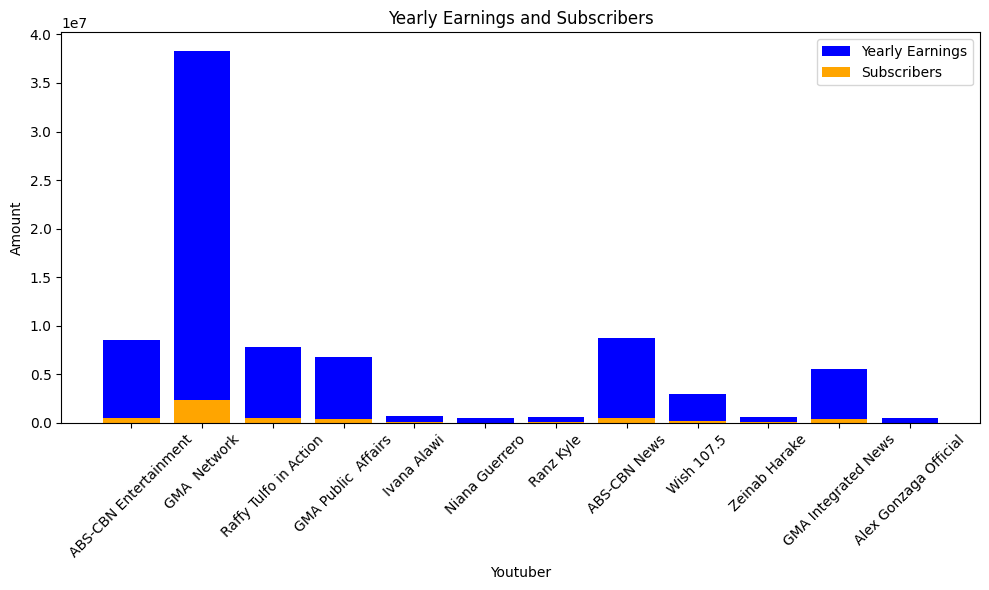

 49%|████▉     | 1059/2160 [09:59<09:05,  2.02it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


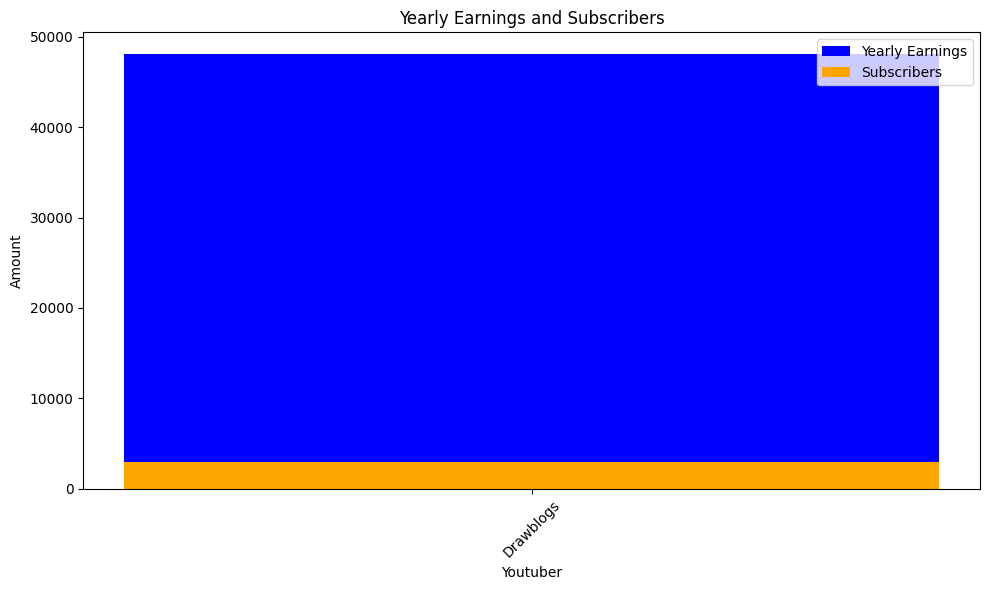

 49%|████▉     | 1062/2160 [10:01<08:39,  2.11it/s]check
highest_yearly_earnings: 64200000.0, Subscribers: 4000000.0, Youtuber: HAR PAL GEO
highest_yearly_earnings: 55200000.0, Subscribers: 3400000.0, Youtuber: ARY Digital HD
highest_yearly_earnings: 32900000.0, Subscribers: 2100000.0, Youtuber: HUM TV
highest_yearly_earnings: 4800000.0, Subscribers: 300200.0, Youtuber: Geo News
highest_yearly_earnings: 28.0, Subscribers: 2.0, Youtuber: Wolfoo Channel
highest_yearly_earnings: 419.0, Subscribers: 26.0, Youtuber: Quantum Tech HD


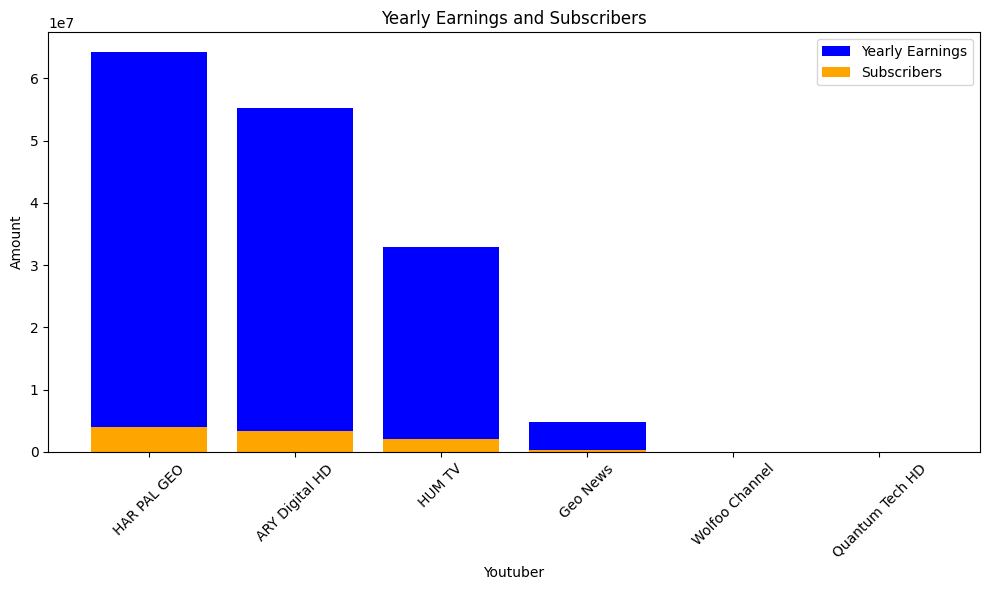

 49%|████▉     | 1065/2160 [10:03<09:08,  2.00it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300100.0, Youtuber: Spinnin' Records
highest_yearly_earnings: 1700000.0, Subscribers: 107800.0, Youtuber: NikkieTutorials
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: ýýýýýýýý/Atro


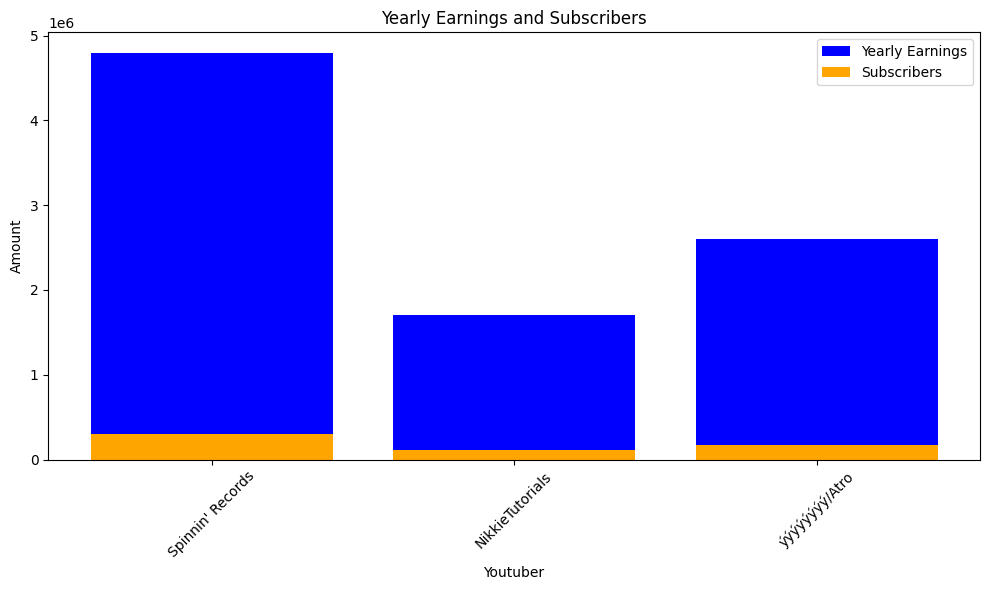

 49%|████▉     | 1068/2160 [10:05<09:25,  1.93it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


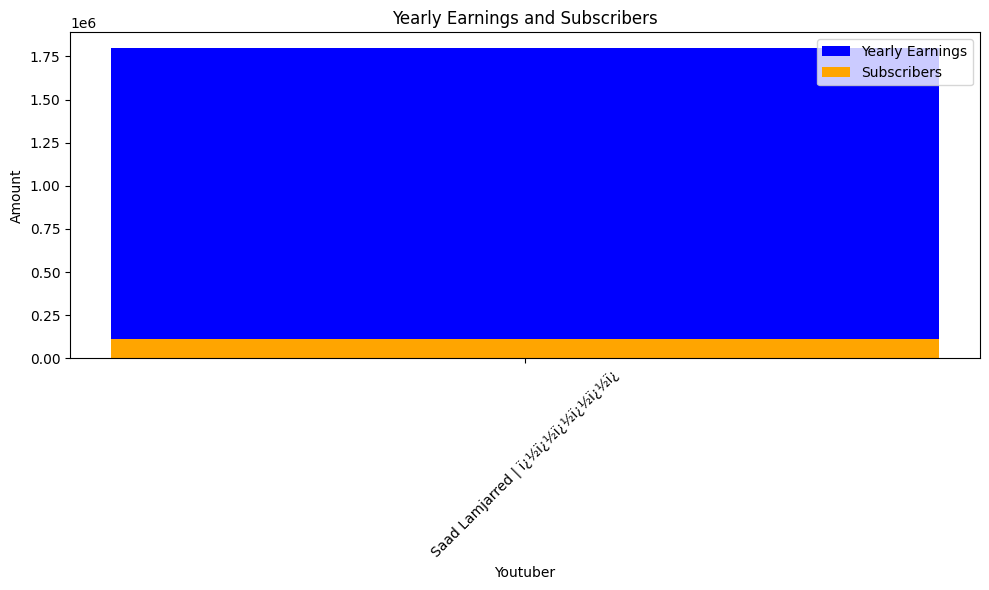

 50%|████▉     | 1071/2160 [10:07<09:33,  1.90it/s]check
highest_yearly_earnings: 1500000.0, Subscribers: 94400.0, Youtuber: GENIAL
highest_yearly_earnings: 16100.0, Subscribers: 1000.0, Youtuber: Yuya
highest_yearly_earnings: 5900000.0, Subscribers: 370000.0, Youtuber: SUPER SLICK SLIME SAM
highest_yearly_earnings: 1300000.0, Subscribers: 79600.0, Youtuber: 123 GO! Spanish


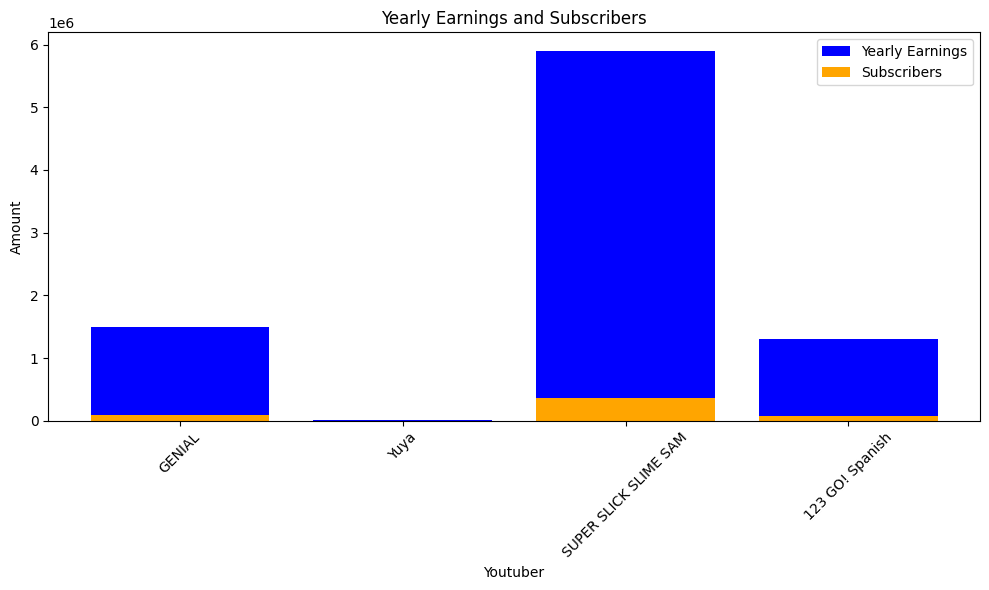

 50%|████▉     | 1074/2160 [10:08<09:12,  1.97it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


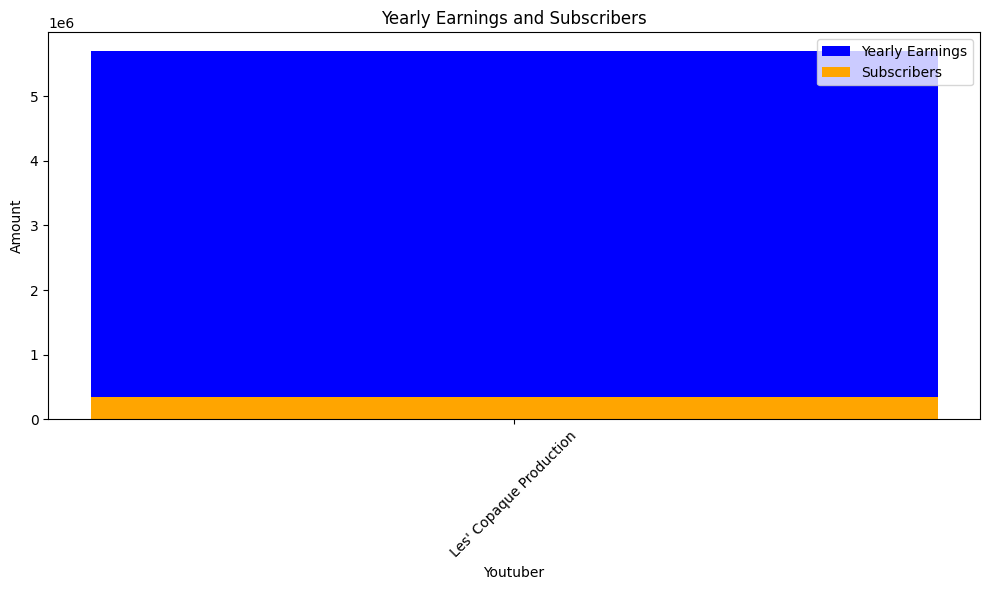

 50%|████▉     | 1077/2160 [10:10<08:28,  2.13it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


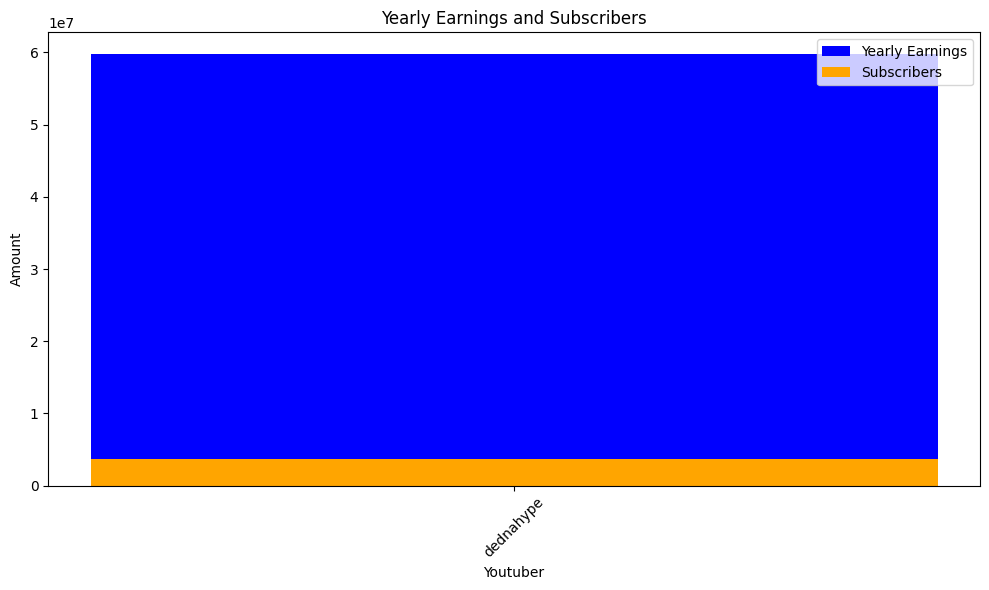

 50%|█████     | 1080/2160 [10:12<08:00,  2.25it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


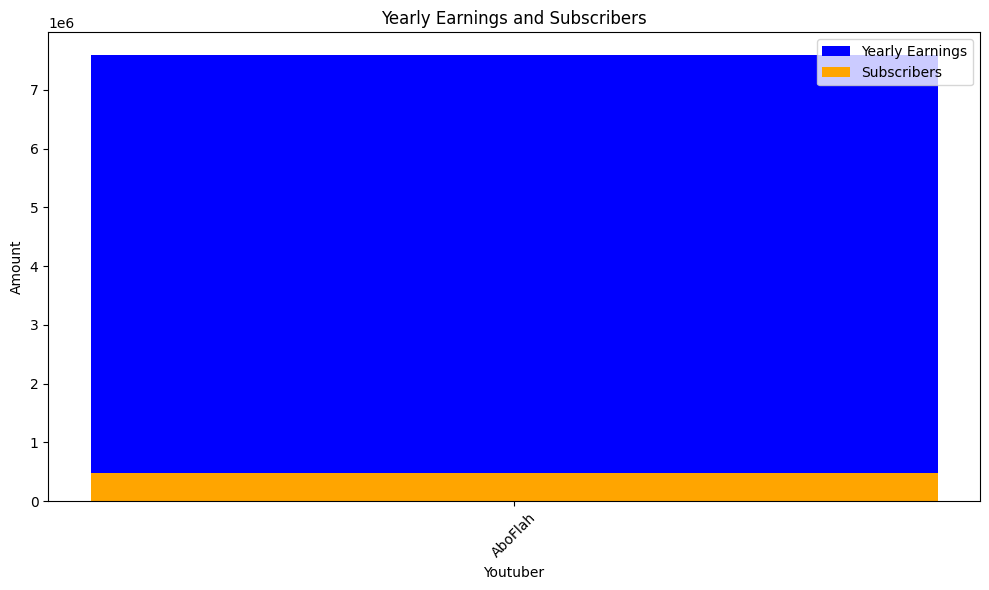

 50%|█████     | 1083/2160 [10:13<07:46,  2.31it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


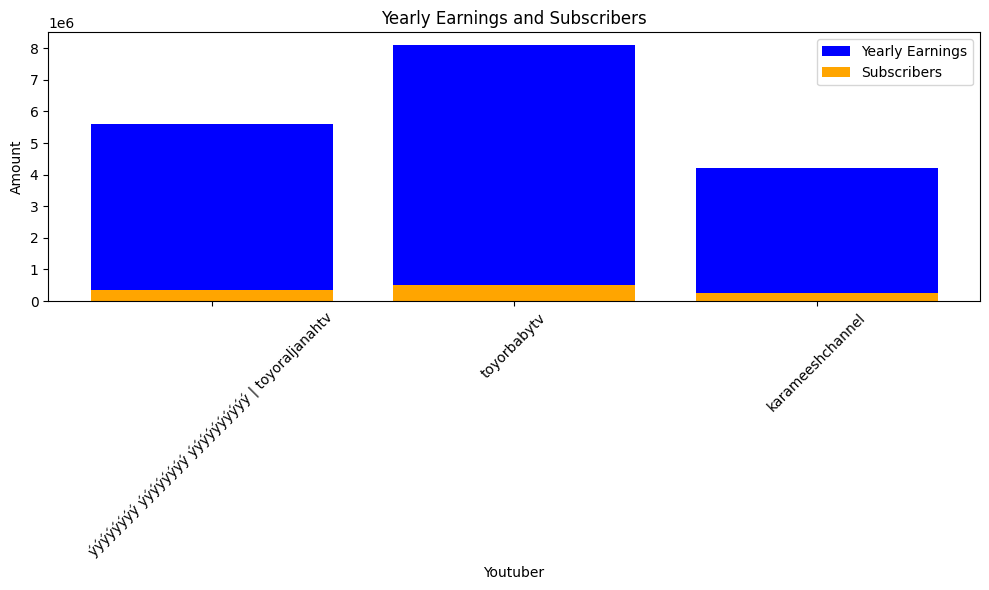

 50%|█████     | 1086/2160 [10:15<07:46,  2.30it/s]check
highest_yearly_earnings: 1900000.0, Subscribers: 117600.0, Youtuber: PewDiePie
highest_yearly_earnings: 34600000.0, Subscribers: 2200000.0, Youtuber: Junya.ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 34100000.0, Subscribers: 2100000.0, Youtuber: Sagawa /ï¿½ï¿½ï¿½
highest_yearly_earnings: 13600000.0, Subscribers: 847100.0, Youtuber: ISSEI / ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 119.0, Subscribers: 7.0, Youtuber: Bayashi TV


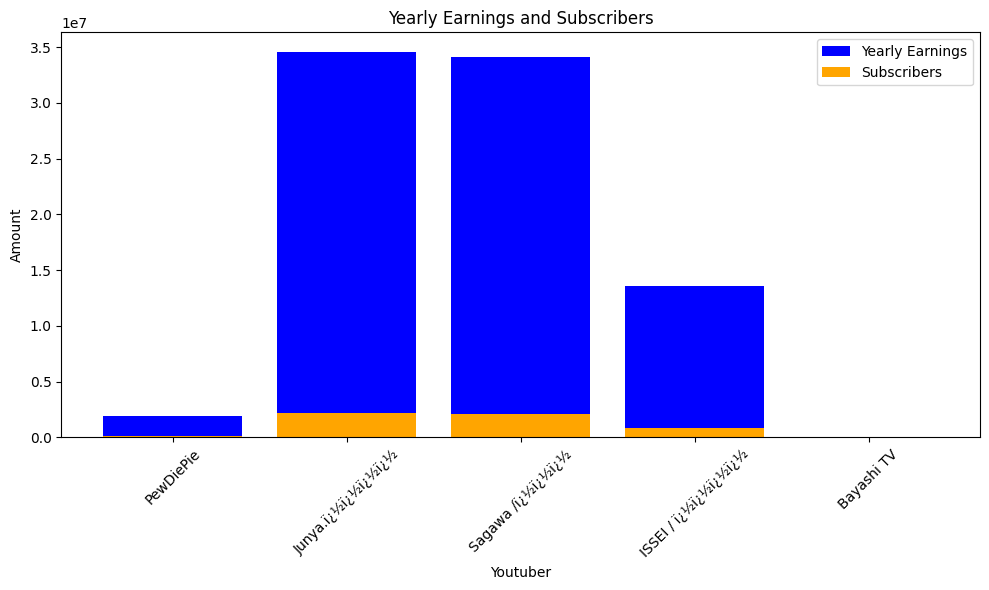

 50%|█████     | 1089/2160 [10:16<08:03,  2.21it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


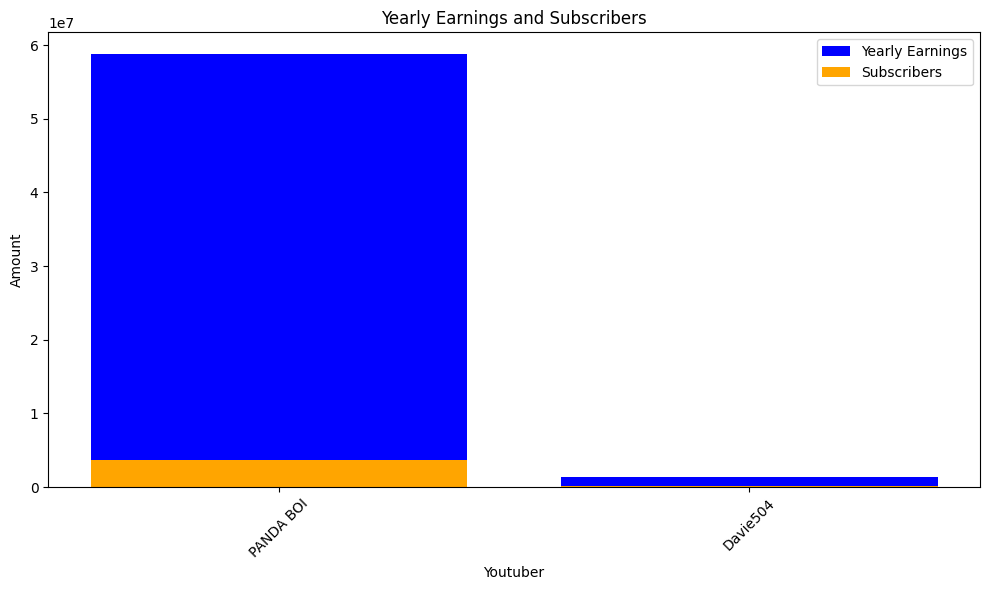

 51%|█████     | 1092/2160 [10:18<07:48,  2.28it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


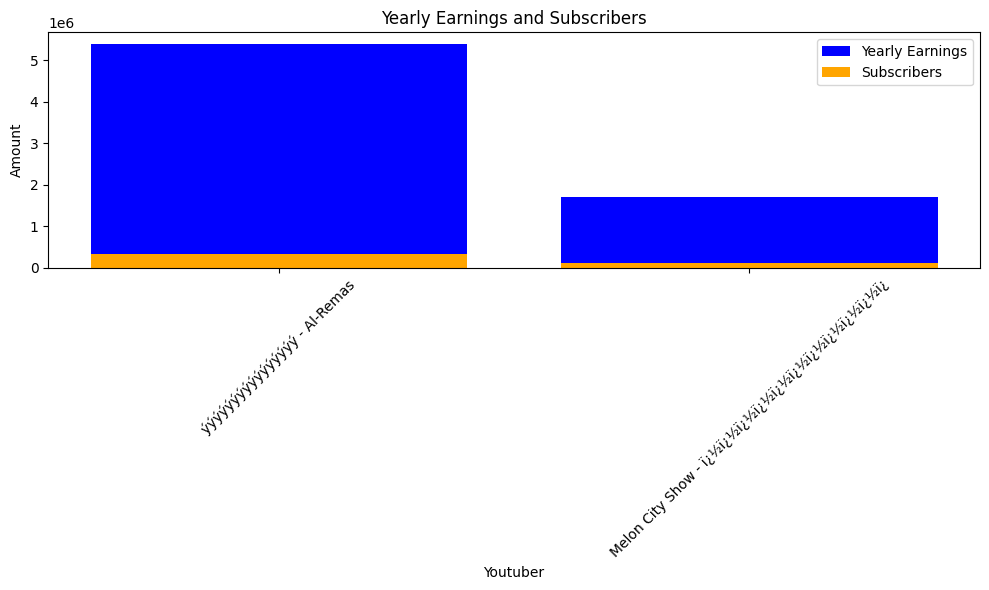

 51%|█████     | 1095/2160 [10:20<08:08,  2.18it/s]check
highest_yearly_earnings: 947500.0, Subscribers: 59200.0, Youtuber: Kerajinan 5-Menit


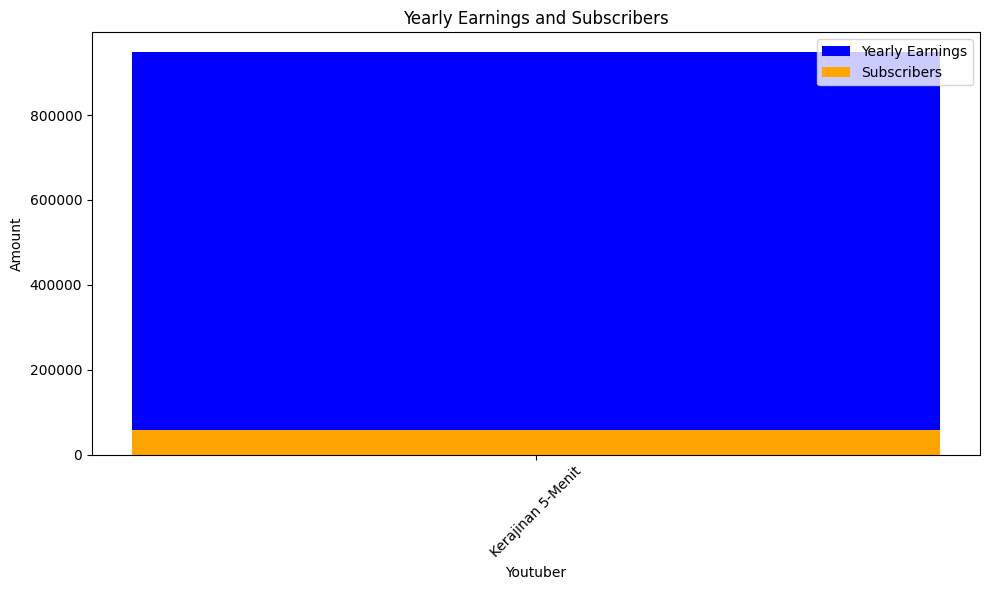

 51%|█████     | 1098/2160 [10:21<07:44,  2.29it/s]check
highest_yearly_earnings: 9300000.0, Subscribers: 583800.0, Youtuber: Village Cooking Channel
highest_yearly_earnings: 1800000.0, Subscribers: 111500.0, Youtuber: Manoj  parihar
highest_yearly_earnings: 1100000.0, Subscribers: 66700.0, Youtuber: NishaMadhulika
highest_yearly_earnings: 1400000.0, Subscribers: 89100.0, Youtuber: Anaysa
highest_yearly_earnings: 2100000.0, Subscribers: 129400.0, Youtuber: Kabita's Kitchen
highest_yearly_earnings: 551500.0, Subscribers: 34500.0, Youtuber: CookingShooking Hindi
highest_yearly_earnings: 1500000.0, Subscribers: 92900.0, Youtuber: bharatzkitchen HINDI


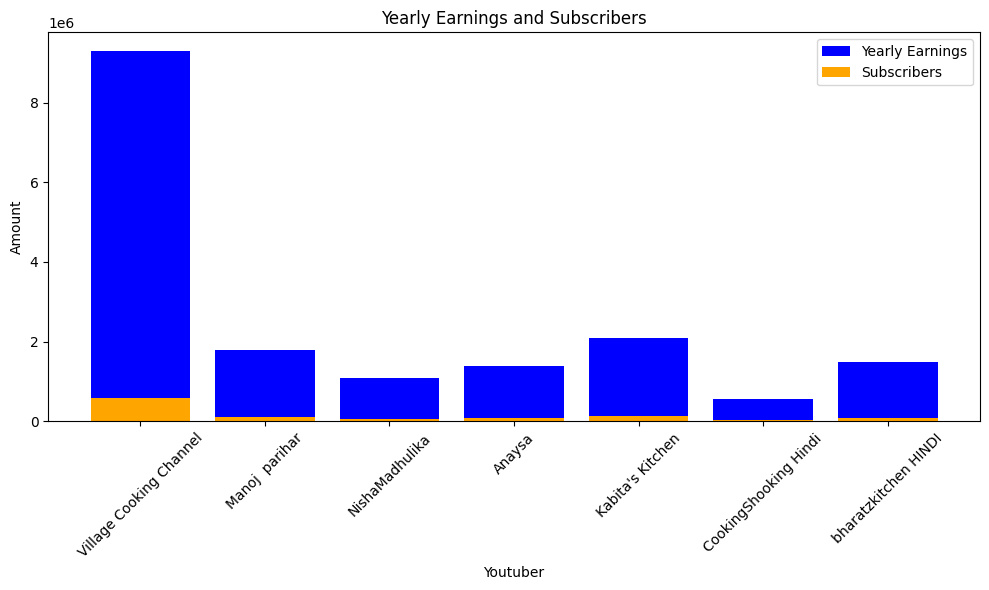

 51%|█████     | 1101/2160 [10:23<08:30,  2.07it/s]check
highest_yearly_earnings: 36300000.0, Subscribers: 2300000.0, Youtuber: Tsuriki Show
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: YOLO
highest_yearly_earnings: 1400000.0, Subscribers: 87800.0, Youtuber: Kurzgesagt ï¿½ï¿½ï¿½ï¿½ï¿½ï¿
highest_yearly_earnings: 271200.0, Subscribers: 17000.0, Youtuber: HaerteTest
highest_yearly_earnings: 29600000.0, Subscribers: 1900000.0, Youtuber: Younes Zarou
highest_yearly_earnings: 1800.0, Subscribers: 114.0, Youtuber: Beast Philanthropy


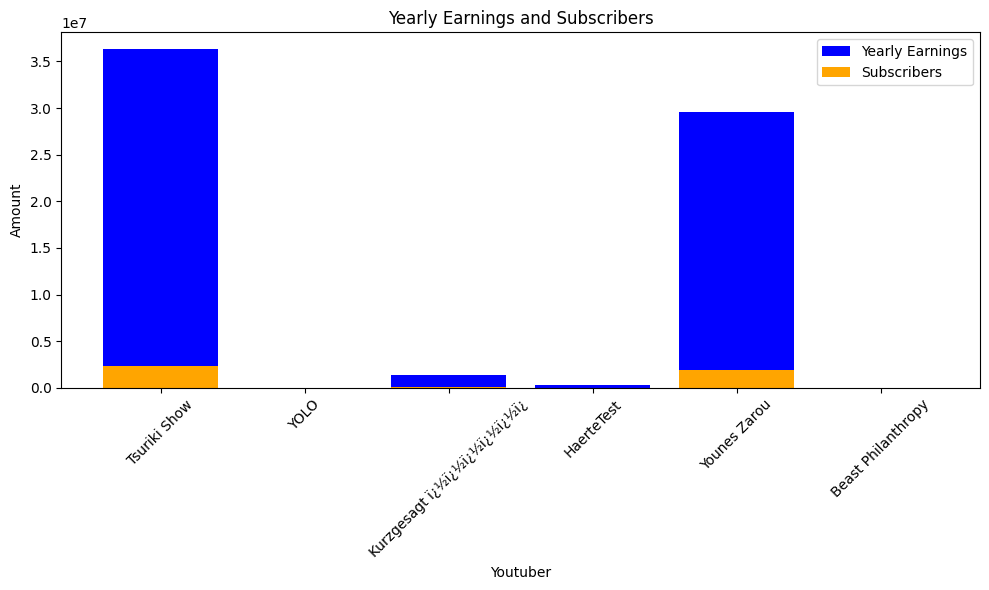

 51%|█████     | 1104/2160 [10:25<08:55,  1.97it/s]check
highest_yearly_earnings: 35.0, Subscribers: 2.0, Youtuber: Smile Family
highest_yearly_earnings: 2300000.0, Subscribers: 144300.0, Youtuber: SQUEEZIE
highest_yearly_earnings: 37.0, Subscribers: 2.0, Youtuber: FitDance
highest_yearly_earnings: 548000.0, Subscribers: 34300.0, Youtuber: Cyprien
highest_yearly_earnings: 1500000.0, Subscribers: 91400.0, Youtuber: Lofi Girl


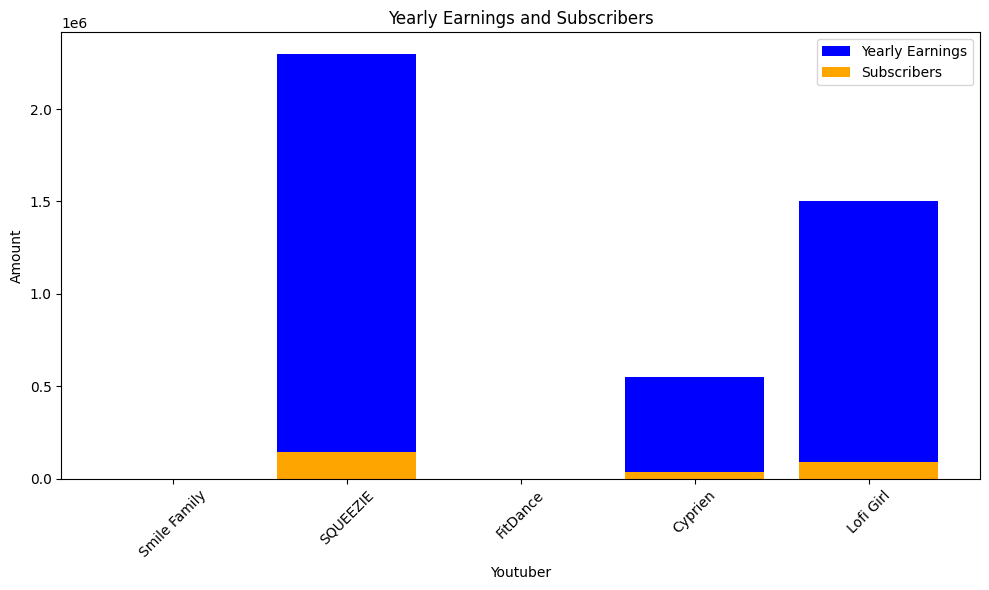

 51%|█████▏    | 1107/2160 [10:27<08:29,  2.07it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


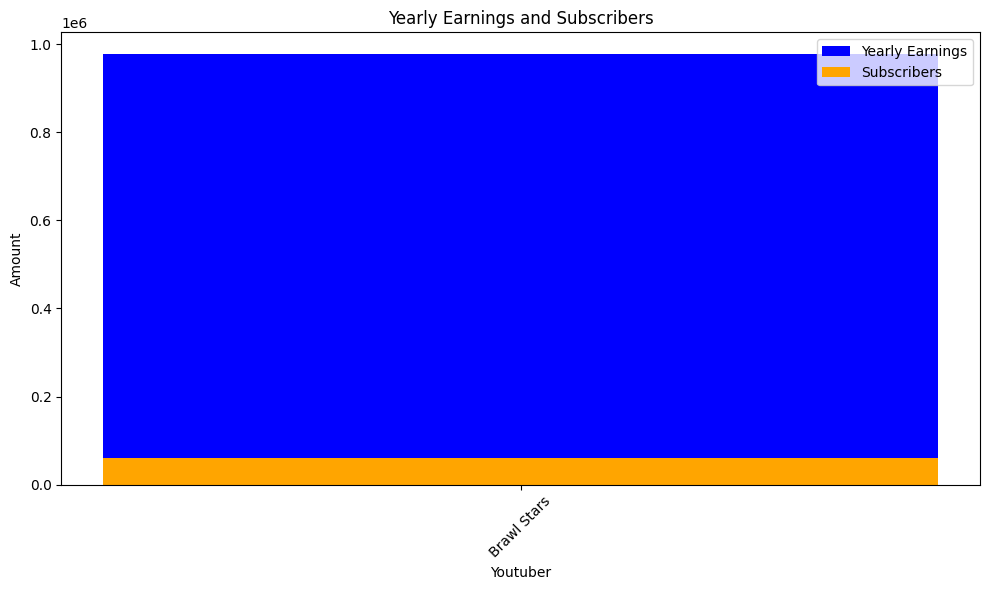

 51%|█████▏    | 1110/2160 [10:29<13:02,  1.34it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


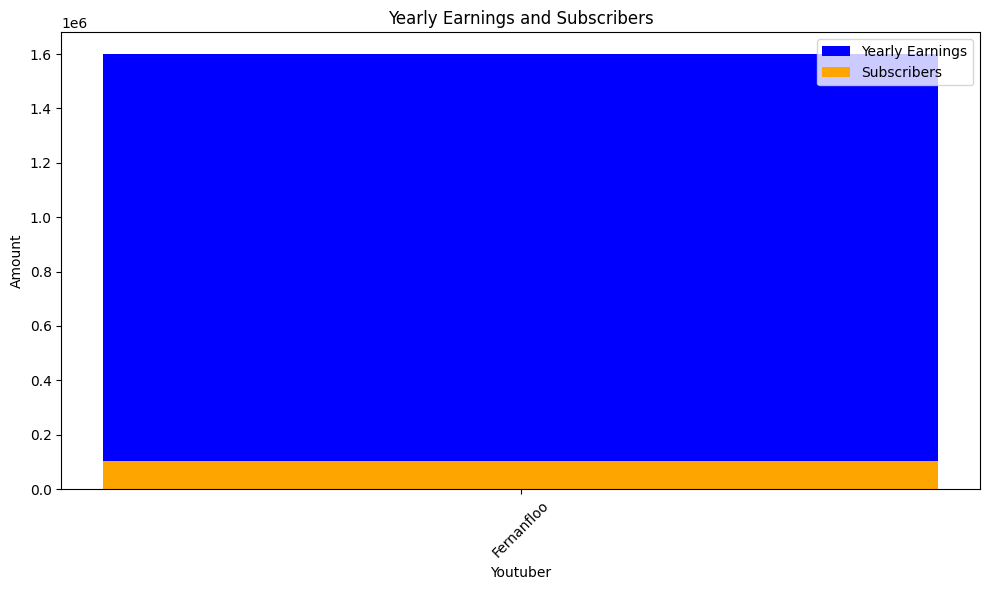

 52%|█████▏    | 1113/2160 [10:31<10:21,  1.69it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý


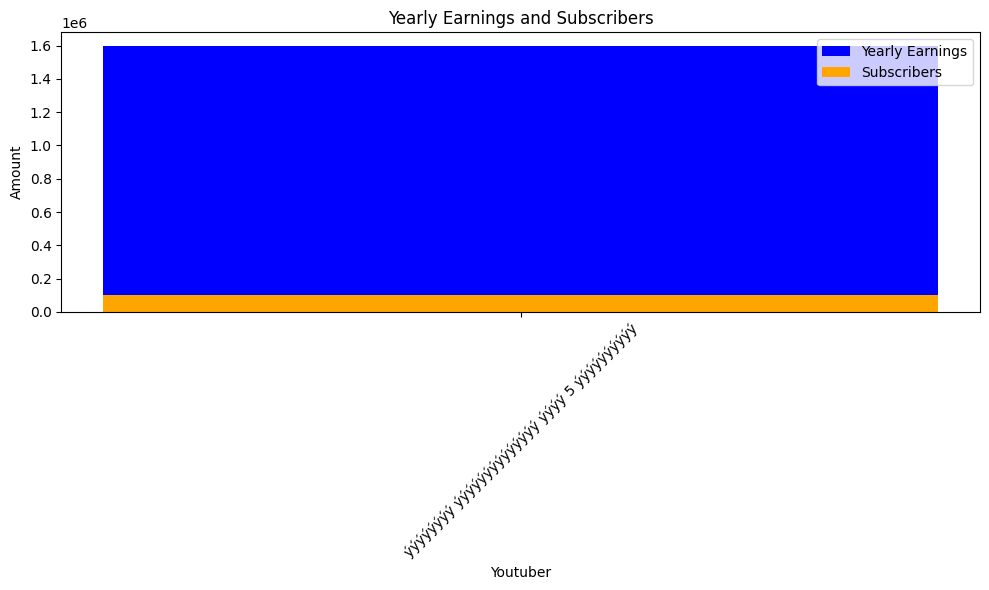

 52%|█████▏    | 1116/2160 [10:33<08:33,  2.03it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


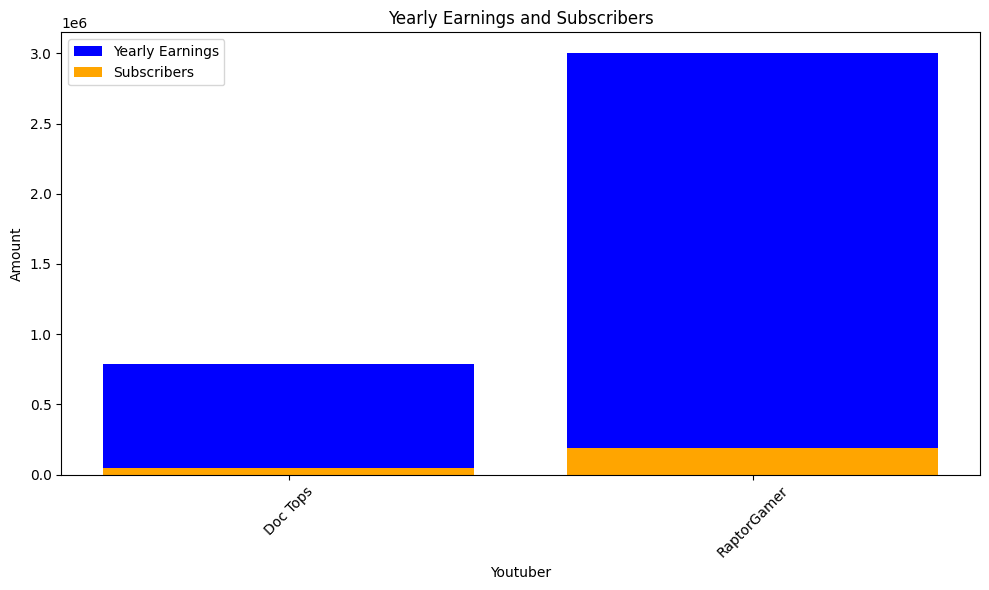

 52%|█████▏    | 1119/2160 [10:34<07:41,  2.26it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


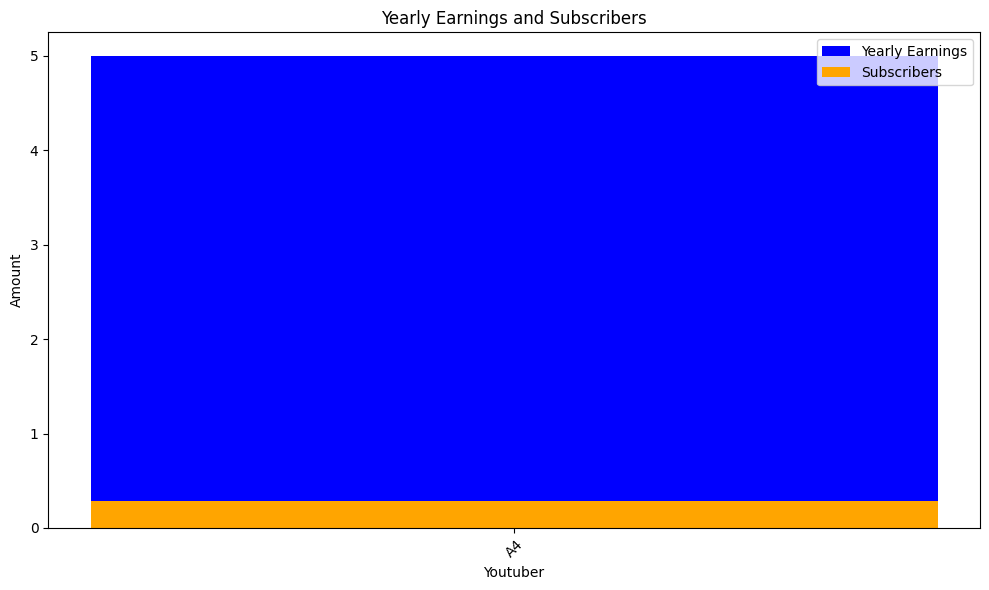

 52%|█████▏    | 1122/2160 [10:36<07:23,  2.34it/s]check
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Shakira


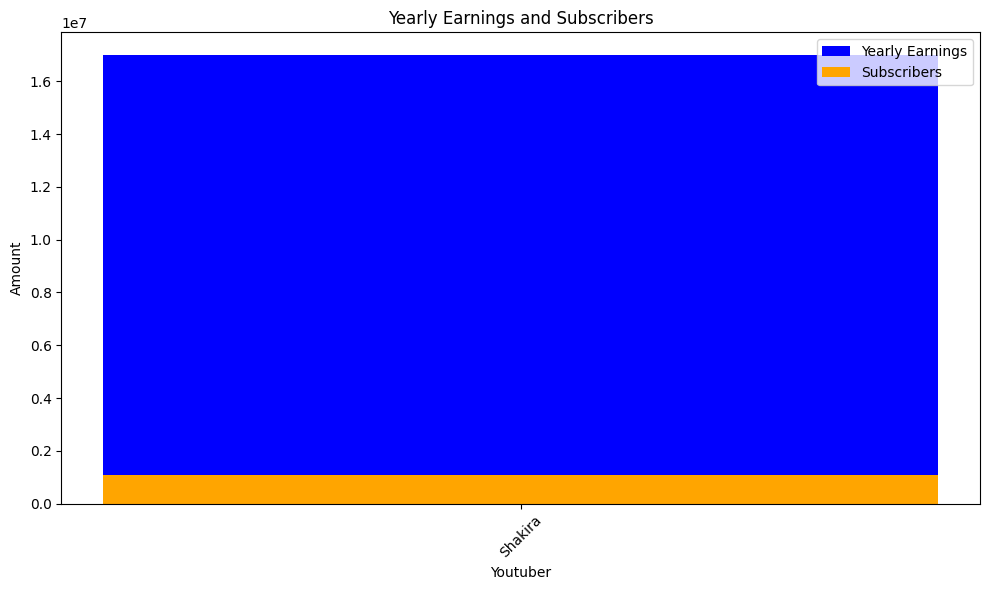

 52%|█████▏    | 1125/2160 [10:37<07:20,  2.35it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


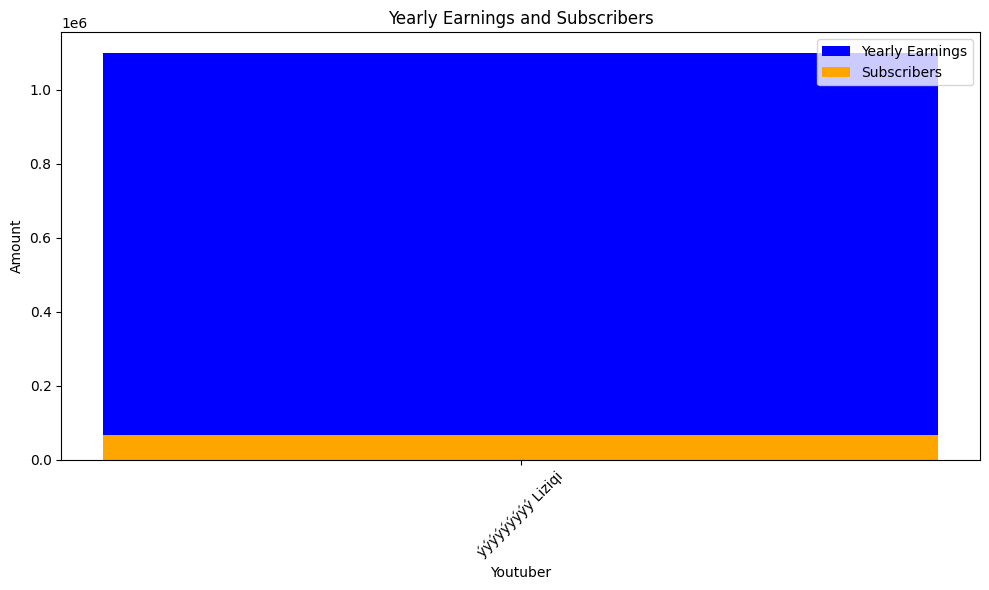

 52%|█████▏    | 1128/2160 [10:39<07:28,  2.30it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 199200.0, Youtuber: JuegaGerman
highest_yearly_earnings: 2.0, Subscribers: 0.15, Youtuber: invictor
highest_yearly_earnings: 4800000.0, Subscribers: 300600.0, Youtuber: DeGoBooM


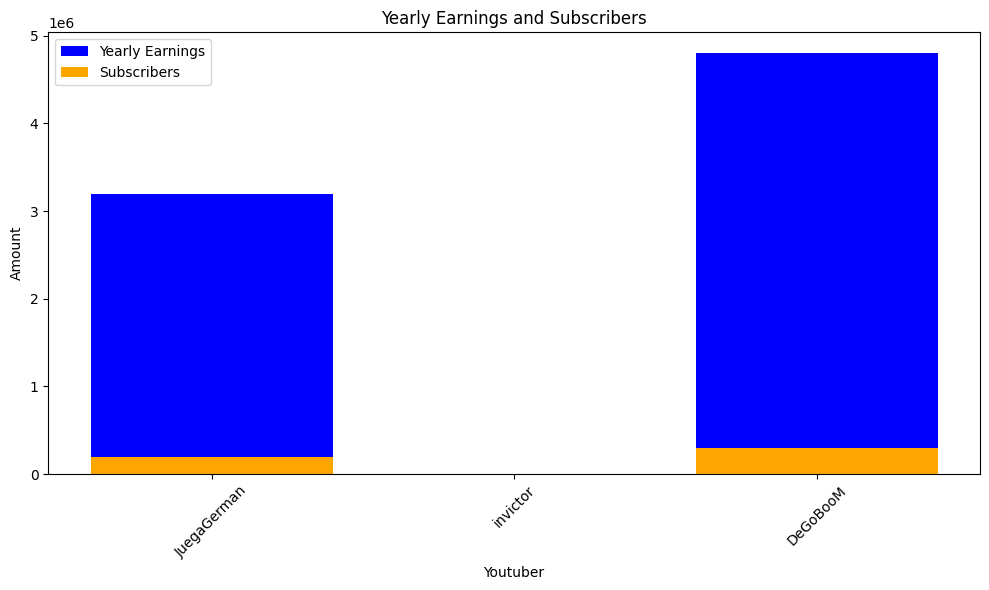

 52%|█████▏    | 1131/2160 [10:41<08:15,  2.08it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529000.0, Youtuber: Justin Bieber
highest_yearly_earnings: 26900000.0, Subscribers: 1700000.0, Youtuber: Super Simple Songs - Kids Songs
highest_yearly_earnings: 17900000.0, Subscribers: 1100000.0, Youtuber: The Weeknd
highest_yearly_earnings: 4300000.0, Subscribers: 266200.0, Youtuber: Shawn Mendes
highest_yearly_earnings: 2600000.0, Subscribers: 164800.0, Youtuber: VanossGaming
highest_yearly_earnings: 2400000.0, Subscribers: 147000.0, Youtuber: WatchMojo.com
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: FaZe Rug
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Pentatonix
highest_yearly_earnings: 4200000.0, Subscribers: 264700.0, Youtuber: Linus Tech Tips
highest_yearly_earnings: 255800.0, Subscribers: 16000.0, Youtuber: Lilly Singh
highest_yearly_earnings: 4000000.0, Subscribers: 251800.0, Youtuber: Hacksmith Industries
highest_yearly_earnings: 1600000.0, Su

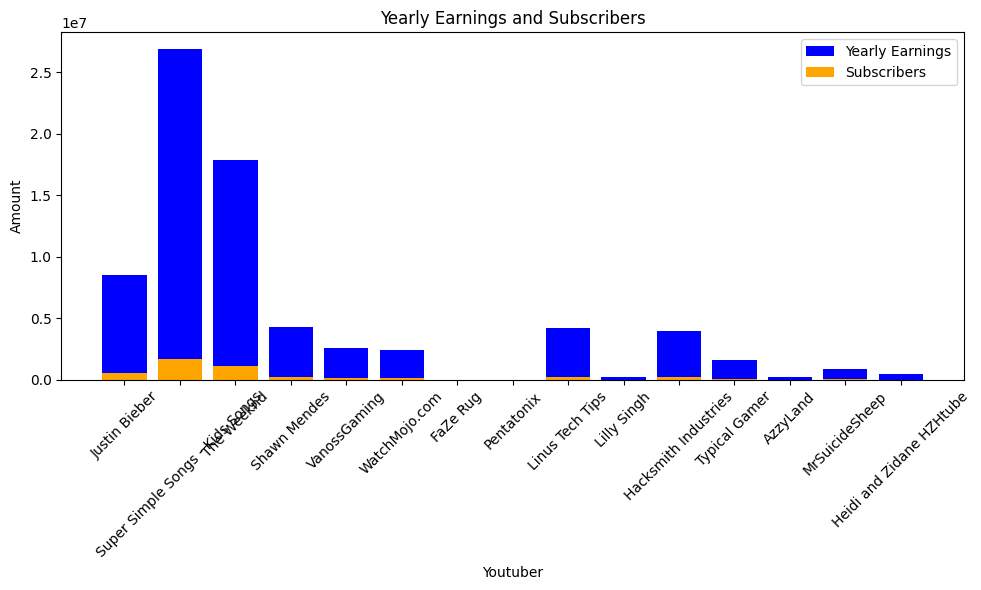

 52%|█████▎    | 1134/2160 [10:43<09:24,  1.82it/s]check
highest_yearly_earnings: 866200.0, Subscribers: 54100.0, Youtuber: INCRï¿½ï¿
highest_yearly_earnings: 136200.0, Subscribers: 8500.0, Youtuber: IDEIAS INCRï¿½ï¿½


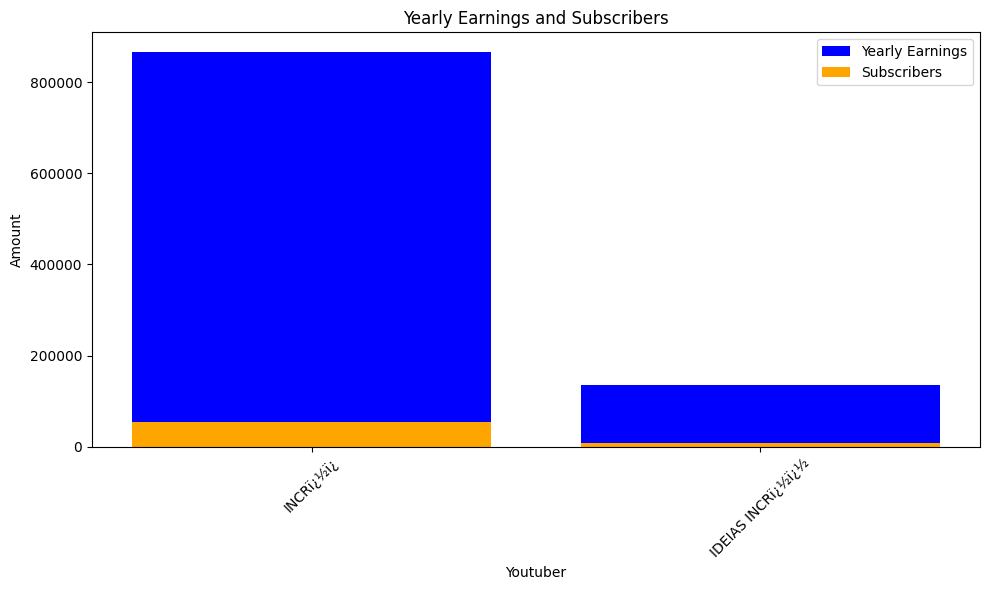

 53%|█████▎    | 1137/2160 [10:45<09:29,  1.80it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


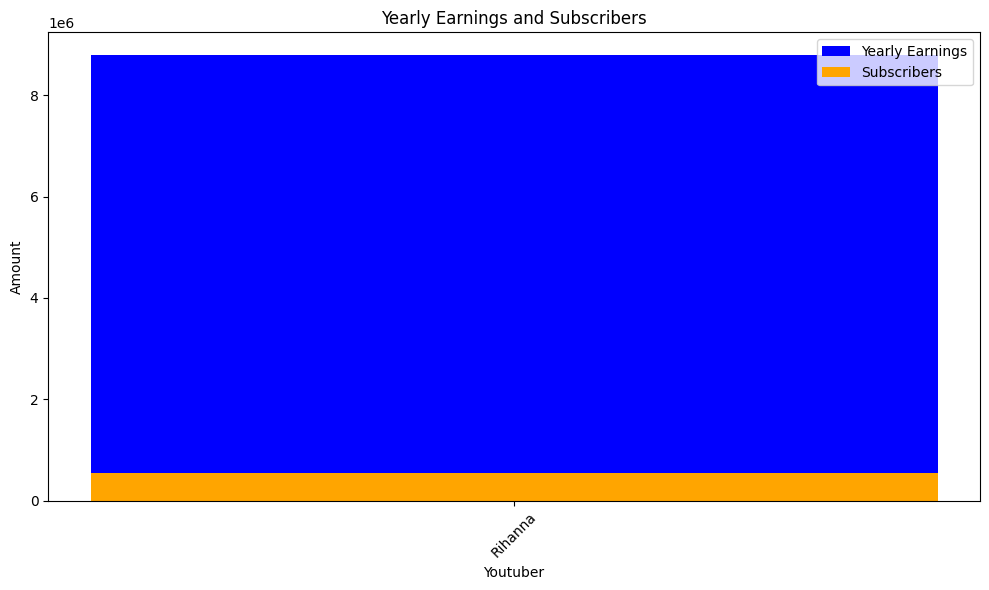

 53%|█████▎    | 1140/2160 [10:48<13:54,  1.22it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


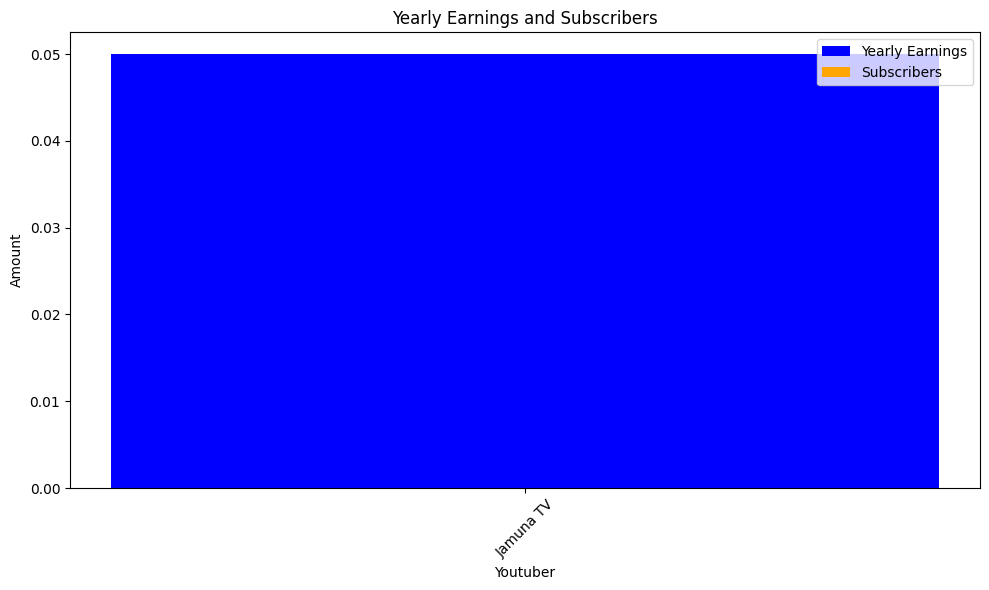

 53%|█████▎    | 1143/2160 [10:50<09:40,  1.75it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 69800.0, Youtuber: Chloe Ting
highest_yearly_earnings: 745200.0, Subscribers: 46600.0, Youtuber: HowToBasic


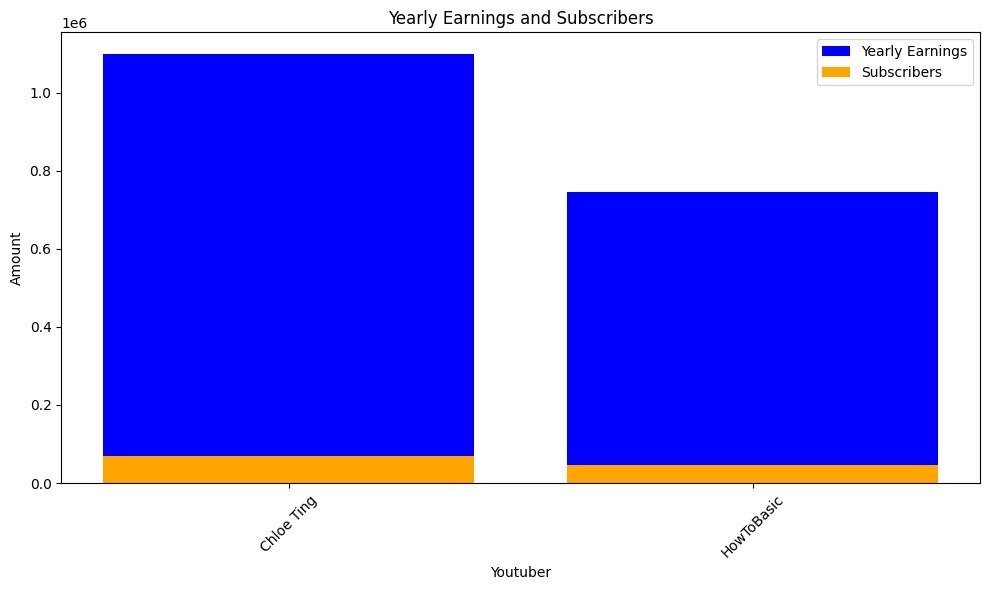

 53%|█████▎    | 1146/2160 [10:51<08:53,  1.90it/s]check
highest_yearly_earnings: 29400000.0, Subscribers: 1800000.0, Youtuber: El Reino Infantil
highest_yearly_earnings: 14500000.0, Subscribers: 906200.0, Youtuber: La Granja de Zenï¿½
highest_yearly_earnings: 9200000.0, Subscribers: 572000.0, Youtuber: TheDonato
highest_yearly_earnings: 0.72, Subscribers: 0.05, Youtuber: Maluma
highest_yearly_earnings: 19300000.0, Subscribers: 1200000.0, Youtuber: Alejo Igoa
highest_yearly_earnings: 1700000.0, Subscribers: 106600.0, Youtuber: DrossRotzank
highest_yearly_earnings: 3500000.0, Subscribers: 216700.0, Youtuber: Paulo Londra
highest_yearly_earnings: 9300000.0, Subscribers: 579500.0, Youtuber: Bizarrap
highest_yearly_earnings: 1300000.0, Subscribers: 82600.0, Youtuber: RobleisIUTU
highest_yearly_earnings: 30700000.0, Subscribers: 1900000.0, Youtuber: El Payaso Plim Plim
highest_yearly_earnings: 4000000.0, Subscribers: 251100.0, Youtuber: El Reino a Jugar
highest_yearly_earnings: 3100000.0, S

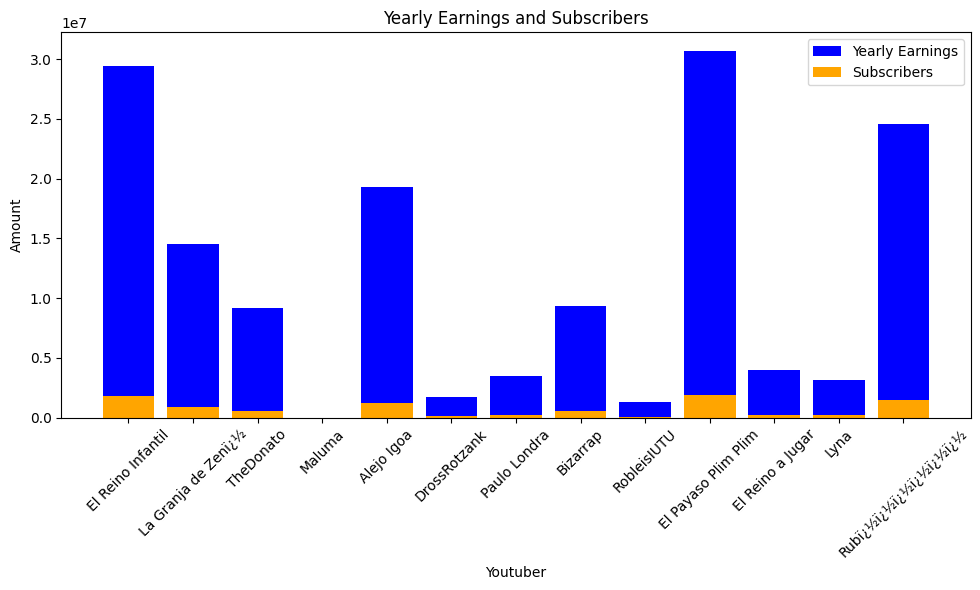

 53%|█████▎    | 1149/2160 [10:54<10:38,  1.58it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


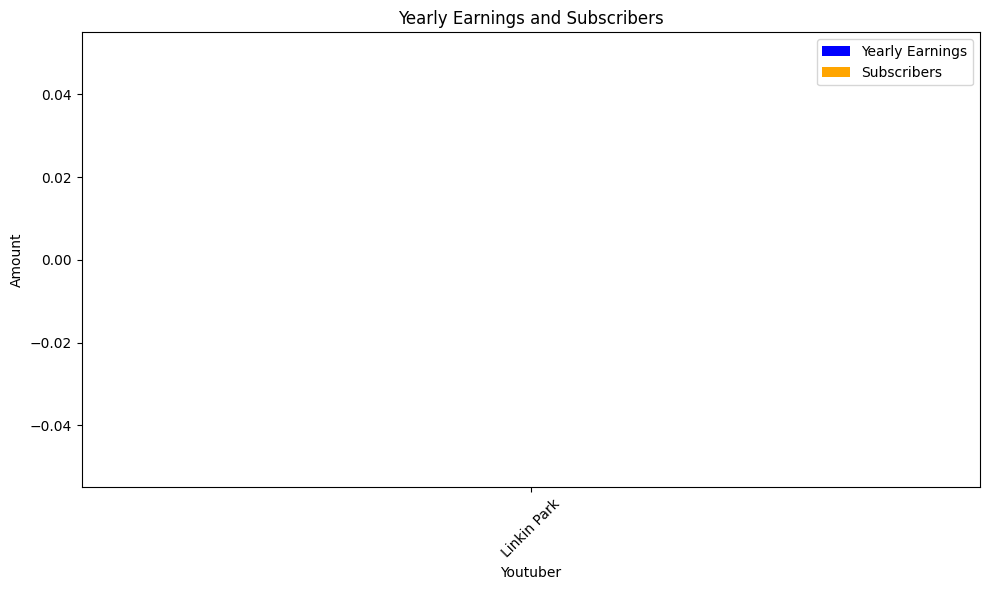

 53%|█████▎    | 1152/2160 [10:56<10:02,  1.67it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


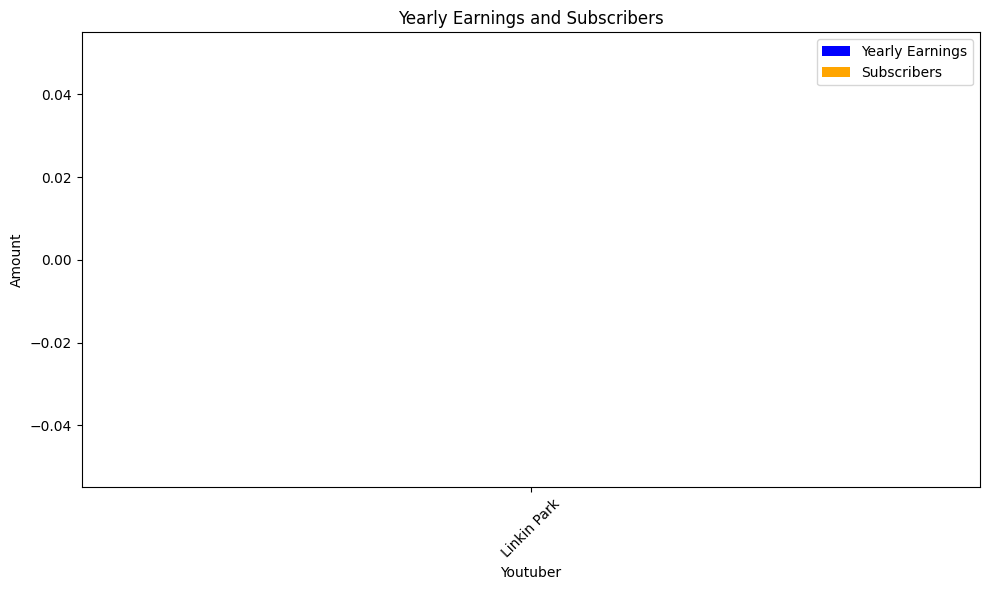

check
highest_yearly_earnings: 4100000.0, Subscribers: 253400.0, Youtuber: Like Nastya VNM
highest_yearly_earnings: 12300000.0, Subscribers: 770200.0, Youtuber: POPS Kids
highest_yearly_earnings: 1700000.0, Subscribers: 105400.0, Youtuber: FAPTV


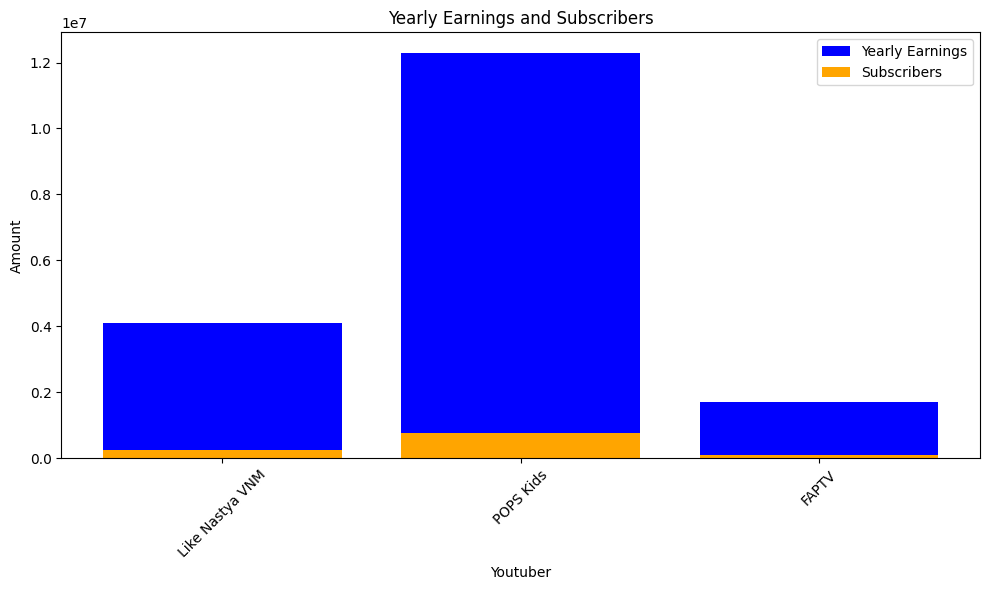

 53%|█████▎    | 1155/2160 [10:59<10:43,  1.56it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


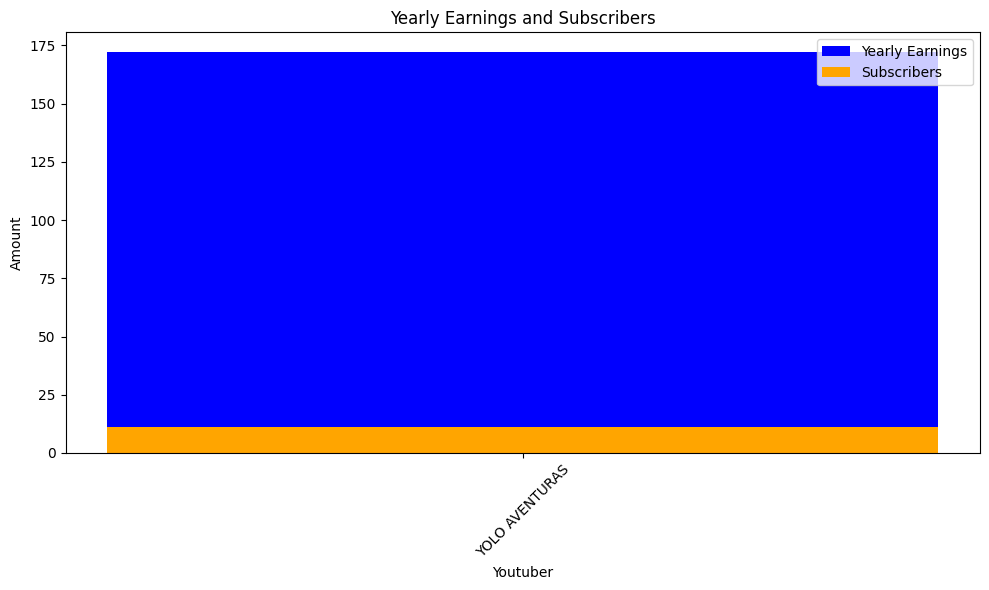

 54%|█████▎    | 1158/2160 [11:00<09:16,  1.80it/s]check
highest_yearly_earnings: 0.58, Subscribers: 0.04, Youtuber: YouTube Movies
highest_yearly_earnings: 6100000.0, Subscribers: 382000.0, Youtuber: Markiplier
highest_yearly_earnings: 1300000.0, Subscribers: 81100.0, Youtuber: Dream
highest_yearly_earnings: 39100000.0, Subscribers: 2400000.0, Youtuber: LankyBox
highest_yearly_earnings: 401700.0, Subscribers: 25100.0, Youtuber: Ninja
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Alan Becker
highest_yearly_earnings: 8400000.0, Subscribers: 525300.0, Youtuber: SSundee
highest_yearly_earnings: 6300000.0, Subscribers: 396300.0, Youtuber: FGTeeV
highest_yearly_earnings: 10600000.0, Subscribers: 665100.0, Youtuber: CookieSwirlC
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Official Pink Panther
highest_yearly_earnings: 1.0, Subscribers: 0.07, Youtuber: AS Gaming
highest_yearly_earnings: 1100000.0, Subscribers: 66900.0, Youtuber: Clash of Clans
highest_yearly_earnings

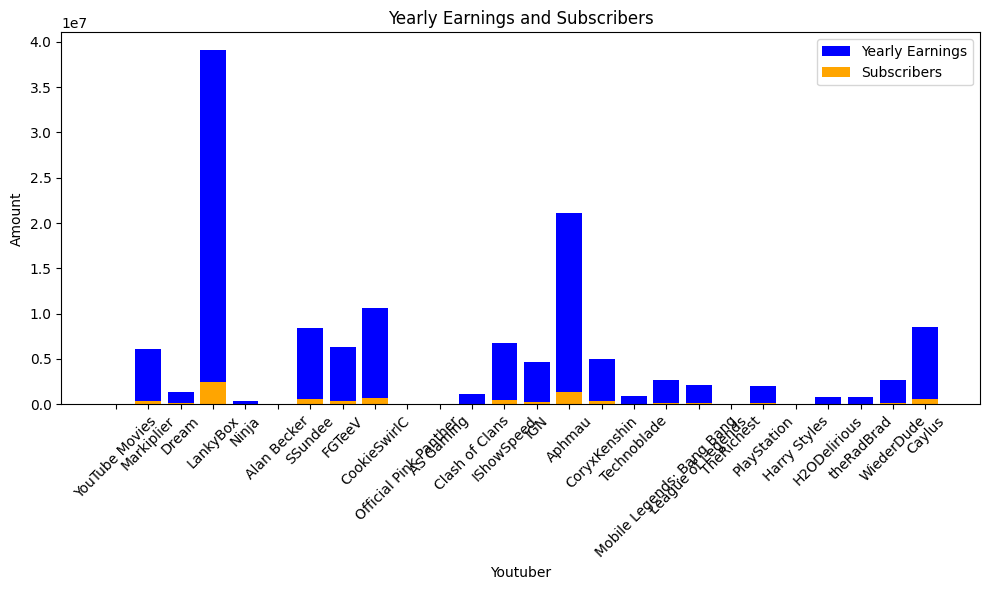

 54%|█████▍    | 1161/2160 [11:03<09:41,  1.72it/s]check
highest_yearly_earnings: 3800000.0, Subscribers: 236000.0, Youtuber: DanTDM
highest_yearly_earnings: 2000000.0, Subscribers: 125000.0, Youtuber: Jelly
highest_yearly_earnings: 12000000.0, Subscribers: 753000.0, Youtuber: MoreAliA
highest_yearly_earnings: 2600000.0, Subscribers: 162900.0, Youtuber: TommyInnit
highest_yearly_earnings: 3200.0, Subscribers: 201.0, Youtuber: Panda


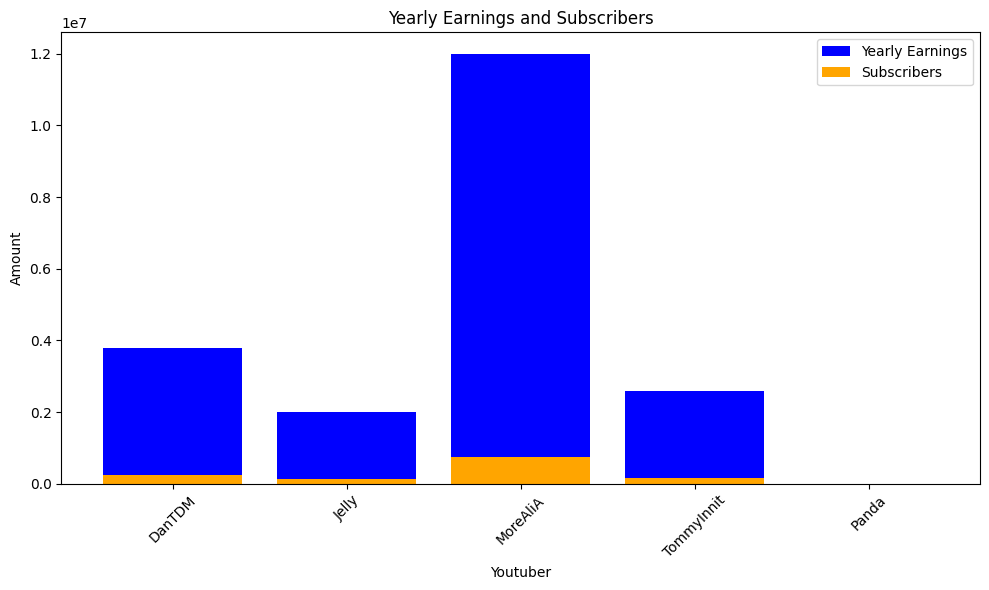

 54%|█████▍    | 1164/2160 [11:04<08:28,  1.96it/s]check
highest_yearly_earnings: 11900000.0, Subscribers: 743200.0, Youtuber: shfa2 - ï¿½ï¿½
highest_yearly_earnings: 7300000.0, Subscribers: 453600.0, Youtuber: shfa show India
highest_yearly_earnings: 76700000.0, Subscribers: 4800000.0, Youtuber: ZAMZAM ELECTRONICS TRADING
highest_yearly_earnings: 746700.0, Subscribers: 46700.0, Youtuber: Noor Stars
highest_yearly_earnings: 3800000.0, Subscribers: 240500.0, Youtuber: FFUNTV
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Supercar Blondie
highest_yearly_earnings: 3900000.0, Subscribers: 240700.0, Youtuber: AlArabiya ï¿½ï¿½ï¿½ï¿½ï¿


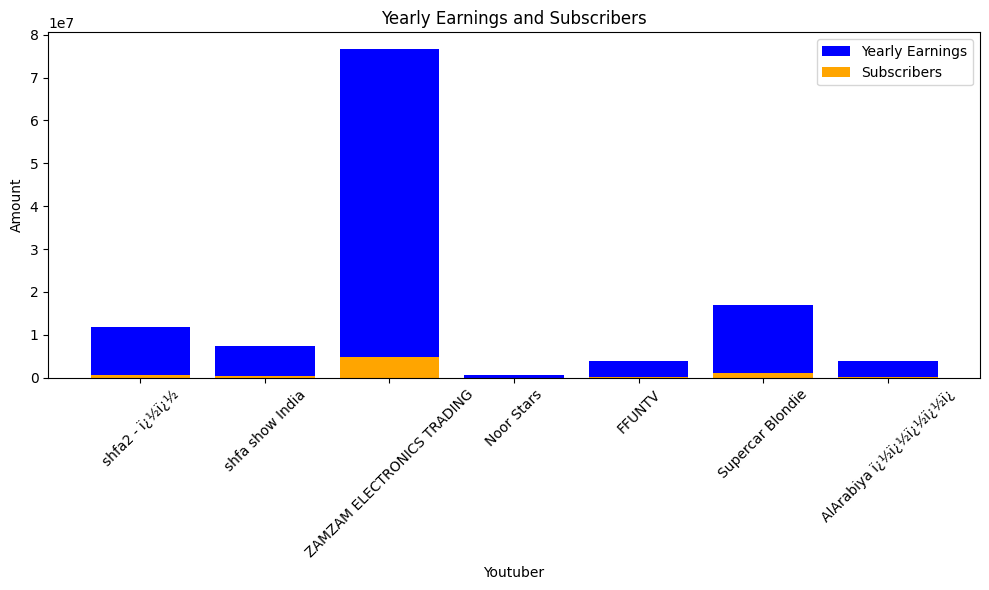

 54%|█████▍    | 1167/2160 [11:06<07:50,  2.11it/s]check
highest_yearly_earnings: 1400000.0, Subscribers: 87000.0, Youtuber: SlivkiShow
highest_yearly_earnings: 3300000.0, Subscribers: 204000.0, Youtuber: ýýýýýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 17800000.0, Subscribers: 1100000.0, Youtuber: News 24
highest_yearly_earnings: 2300000.0, Subscribers: 141400.0, Youtuber: ýýýýýýýý ýýýýýýýý
highest_yearly_earnings: 5.0, Subscribers: 0.32, Youtuber: SIS vs BRO
highest_yearly_earnings: 3600000.0, Subscribers: 225500.0, Youtuber: Lady Diana
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: VexTrex
highest_yearly_earnings: 3400000.0, Subscribers: 213400.0, Youtuber: ýýýýýýýý ýýýý ýýýýýýýýýýýýýý


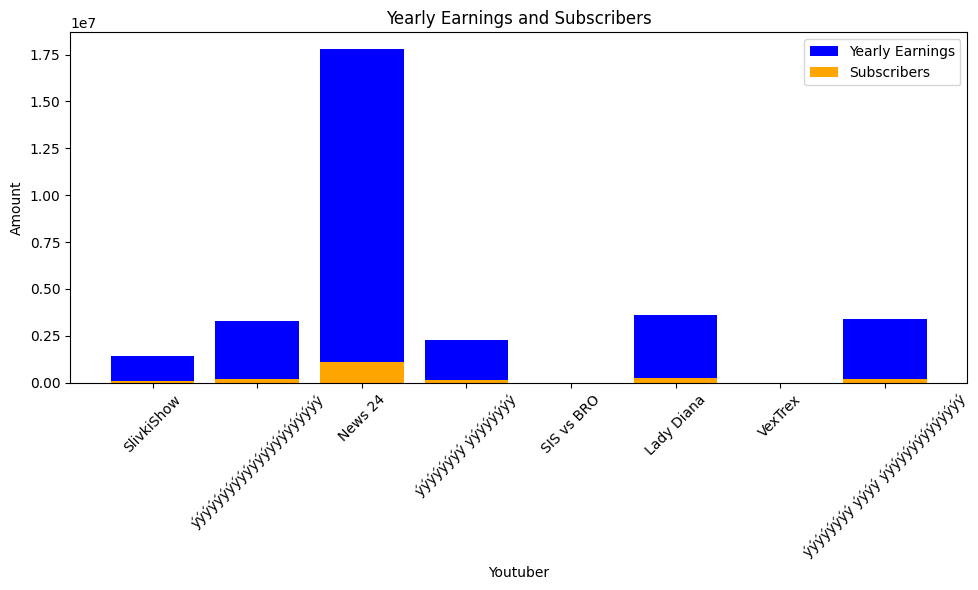

 54%|█████▍    | 1170/2160 [11:08<07:38,  2.16it/s]check
highest_yearly_earnings: 70200000.0, Subscribers: 4400000.0, Youtuber: BETER Bï¿½ï¿½


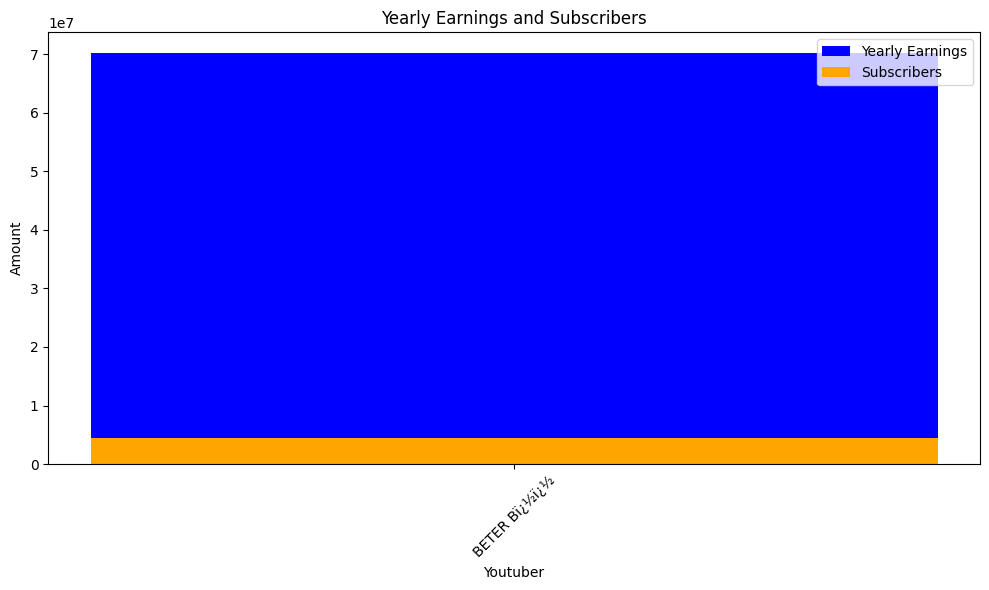

 54%|█████▍    | 1173/2160 [11:09<07:07,  2.31it/s]check
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: zbing z.


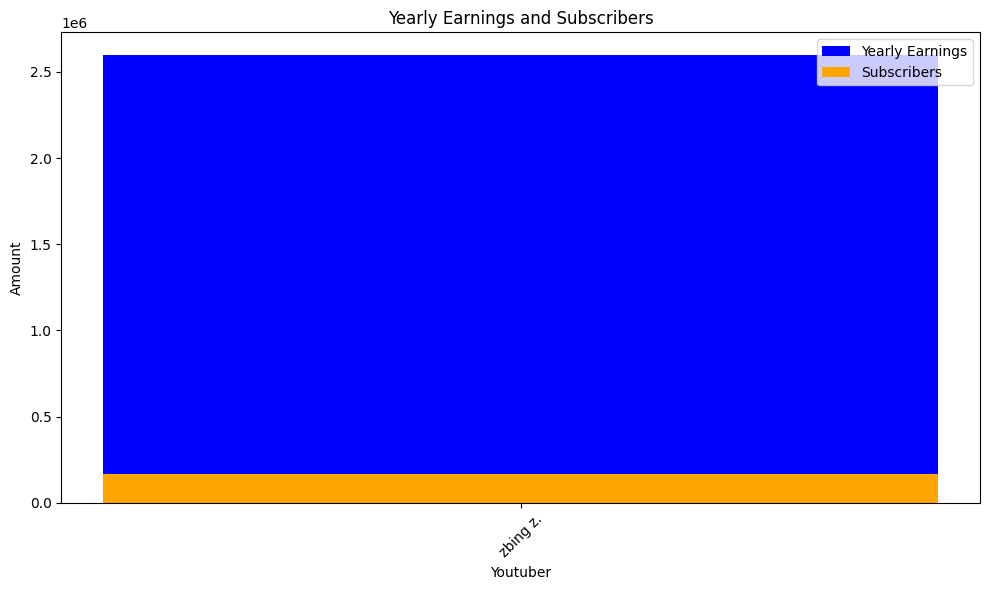

 54%|█████▍    | 1176/2160 [11:11<06:58,  2.35it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


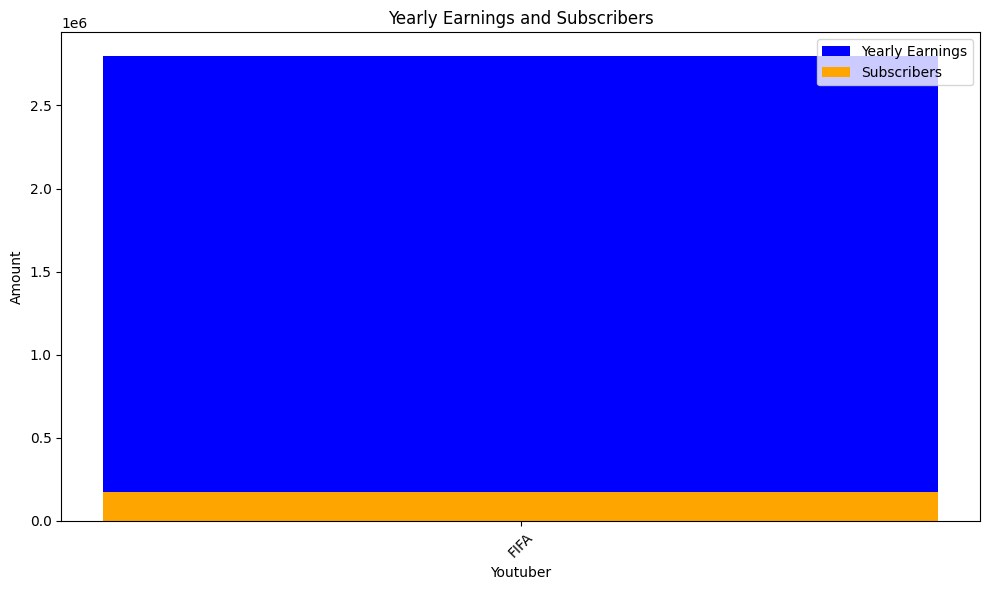

 55%|█████▍    | 1179/2160 [11:12<07:05,  2.31it/s]check
highest_yearly_earnings: 185800.0, Subscribers: 11600.0, Youtuber: RobTopGames


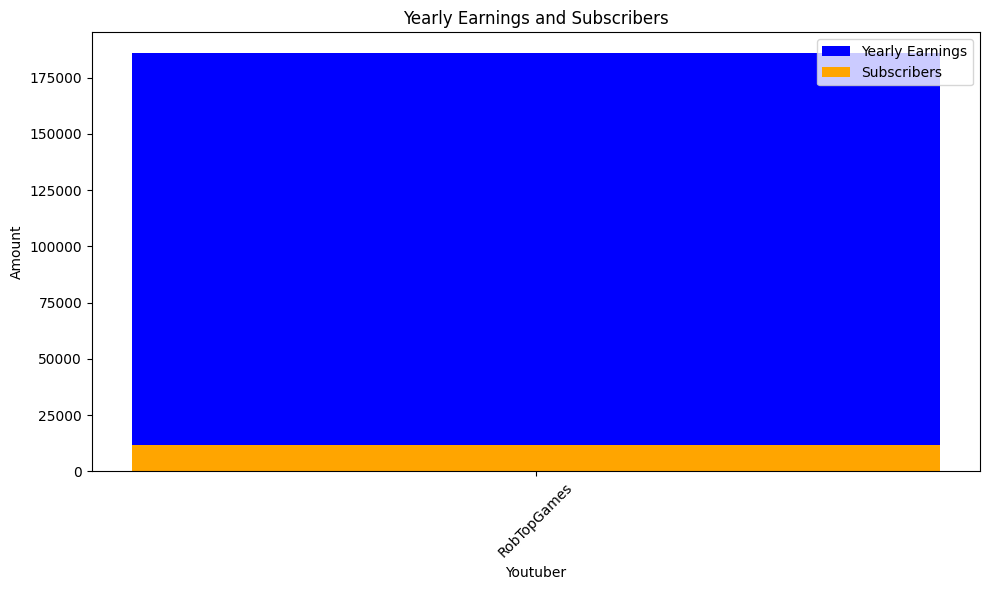

 55%|█████▍    | 1182/2160 [11:15<10:03,  1.62it/s]check
highest_yearly_earnings: 12700000.0, Subscribers: 792300.0, Youtuber: Mikecrack
highest_yearly_earnings: 1900000.0, Subscribers: 117300.0, Youtuber: VEGETTA777
highest_yearly_earnings: 528200.0, Subscribers: 33000.0, Youtuber: TheWillyrex
highest_yearly_earnings: 2100000.0, Subscribers: 131500.0, Youtuber: TheGrefg
highest_yearly_earnings: 739500.0, Subscribers: 46200.0, Youtuber: Willyrex
highest_yearly_earnings: 665200.0, Subscribers: 41600.0, Youtuber: iTownGamePlay *Terror&Diversiï¿½ï
highest_yearly_earnings: 2900000.0, Subscribers: 181700.0, Youtuber: Auron
highest_yearly_earnings: 2300000.0, Subscribers: 142300.0, Youtuber: Acenix
highest_yearly_earnings: 1200000.0, Subscribers: 72100.0, Youtuber: Timba Vk
highest_yearly_earnings: 4000000.0, Subscribers: 247900.0, Youtuber: DaniRep | +6 Vï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


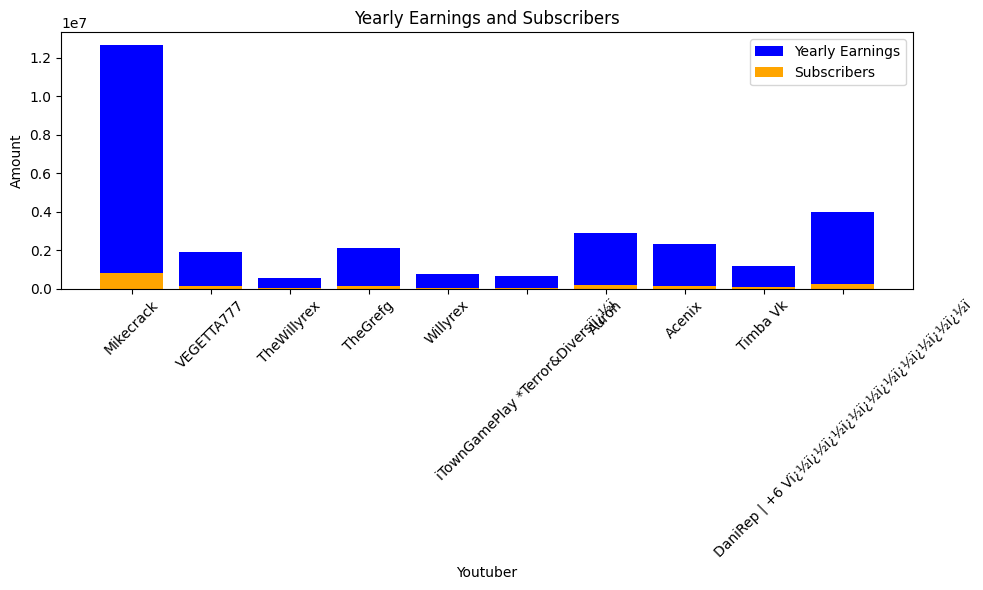

 55%|█████▍    | 1185/2160 [11:17<09:01,  1.80it/s]check
highest_yearly_earnings: 51900000.0, Subscribers: 3200000.0, Youtuber: GH'S


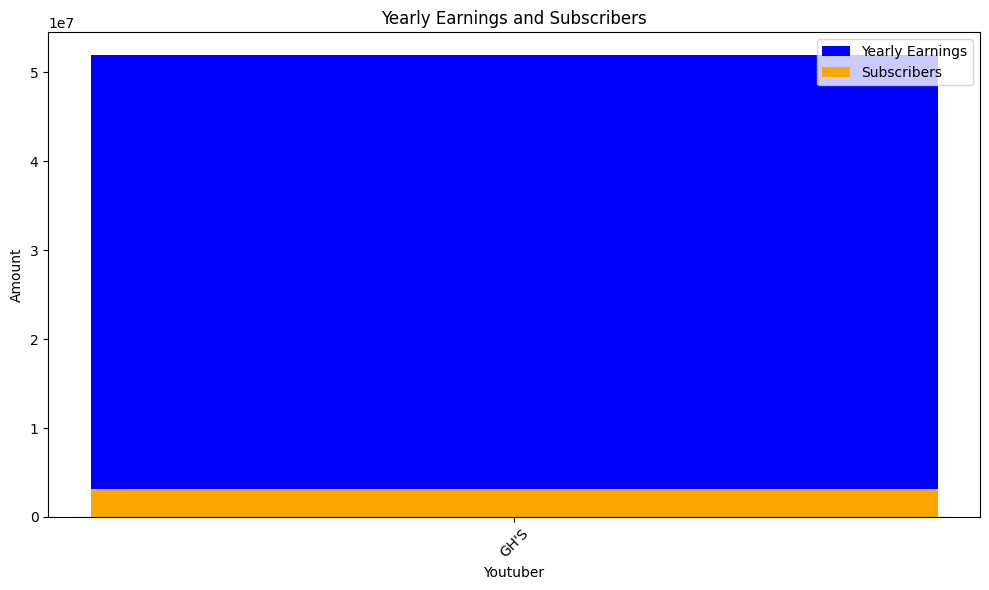

 55%|█████▌    | 1188/2160 [11:19<08:51,  1.83it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Sandeep Maheshwari
highest_yearly_earnings: 5600000.0, Subscribers: 351600.0, Youtuber: LEGO
highest_yearly_earnings: 45100.0, Subscribers: 2800.0, Youtuber: MY FAMILY


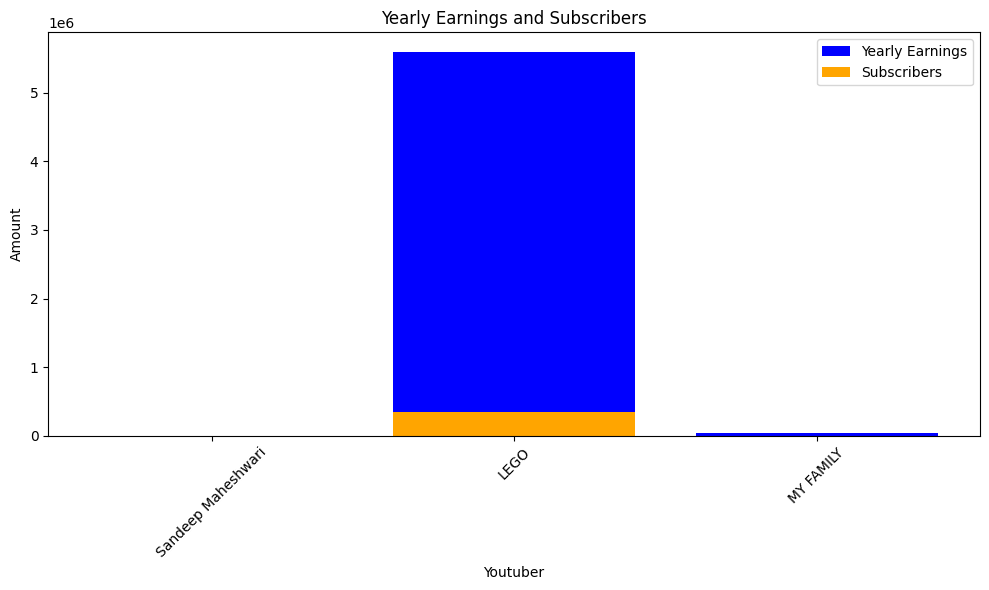

 55%|█████▌    | 1191/2160 [11:21<08:57,  1.80it/s]check
highest_yearly_earnings: 76300.0, Subscribers: 4800.0, Youtuber: shfa
highest_yearly_earnings: 2100000.0, Subscribers: 129000.0, Youtuber: ýýýýýýýý ýýýýýýýýýý ýýýýýýýýýý | Arab Games Network
highest_yearly_earnings: 3400000.0, Subscribers: 212100.0, Youtuber: BanderitaX


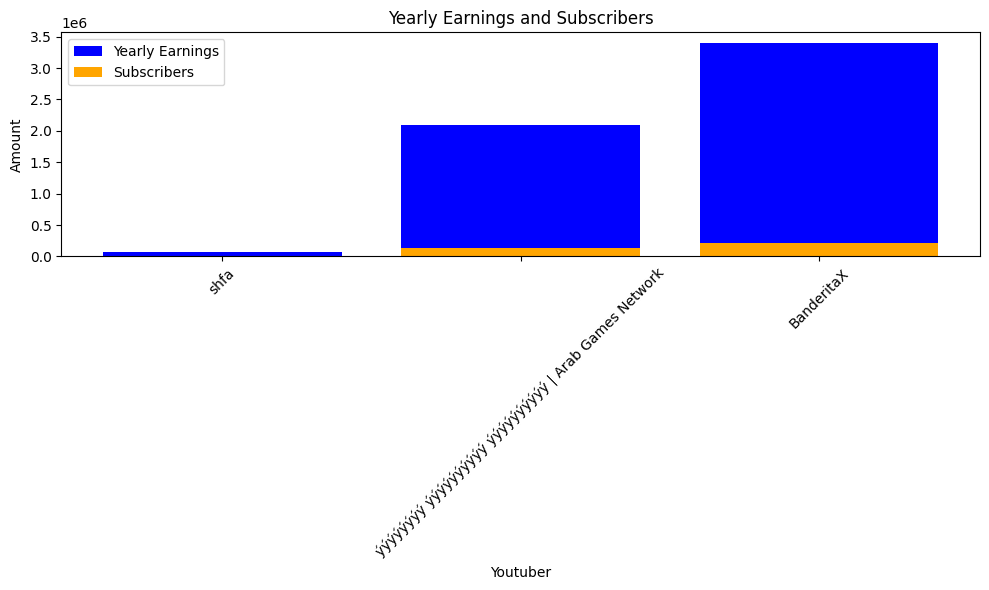

 55%|█████▌    | 1194/2160 [11:23<08:00,  2.01it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


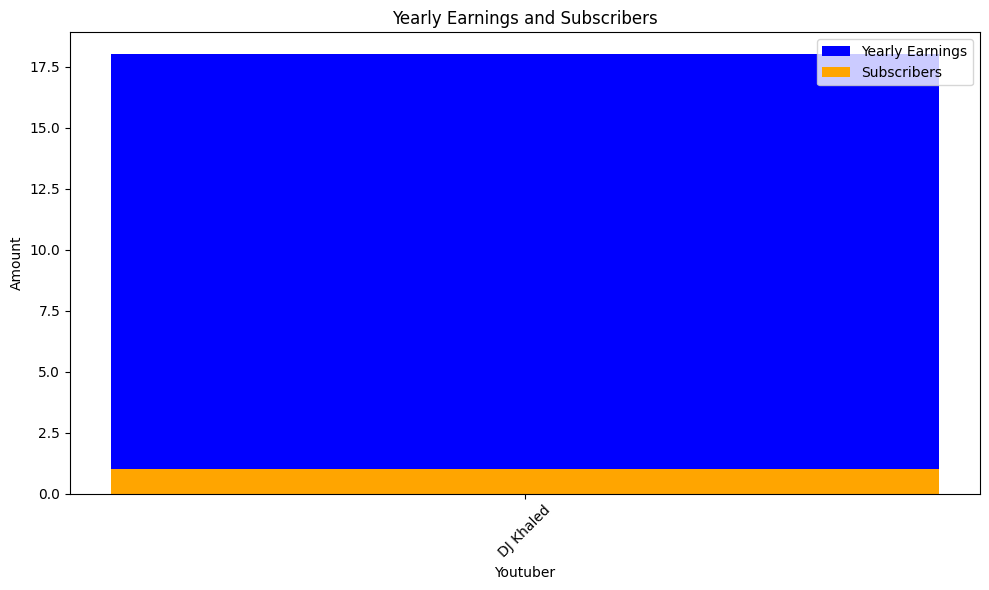

 55%|█████▌    | 1197/2160 [11:24<07:22,  2.18it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 114800.0, Youtuber: Marmok
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: ýýýýýýýýýý
highest_yearly_earnings: 4600000.0, Subscribers: 286800.0, Youtuber: EdisonPts
highest_yearly_earnings: 7200000.0, Subscribers: 451700.0, Youtuber: ýýýýýýýýýýýý


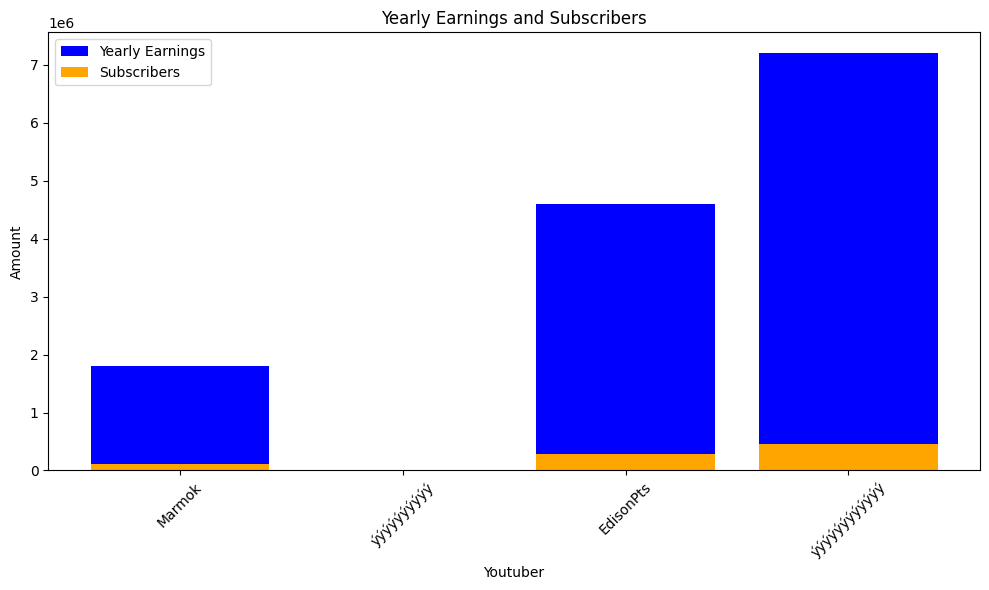

 56%|█████▌    | 1200/2160 [11:26<07:14,  2.21it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529900.0, Youtuber: ABS-CBN Entertainment
highest_yearly_earnings: 38300000.0, Subscribers: 2400000.0, Youtuber: GMA  Network
highest_yearly_earnings: 7800000.0, Subscribers: 489400.0, Youtuber: Raffy Tulfo in Action
highest_yearly_earnings: 6800000.0, Subscribers: 427000.0, Youtuber: GMA Public  Affairs
highest_yearly_earnings: 723800.0, Subscribers: 45200.0, Youtuber: Ivana Alawi
highest_yearly_earnings: 479000.0, Subscribers: 29900.0, Youtuber: Niana Guerrero
highest_yearly_earnings: 594000.0, Subscribers: 37100.0, Youtuber: Ranz Kyle
highest_yearly_earnings: 8700000.0, Subscribers: 544900.0, Youtuber: ABS-CBN News
highest_yearly_earnings: 3000000.0, Subscribers: 188000.0, Youtuber: Wish 107.5
highest_yearly_earnings: 580200.0, Subscribers: 36300.0, Youtuber: Zeinab Harake
highest_yearly_earnings: 5500000.0, Subscribers: 346400.0, Youtuber: GMA Integrated News
highest_yearly_ear

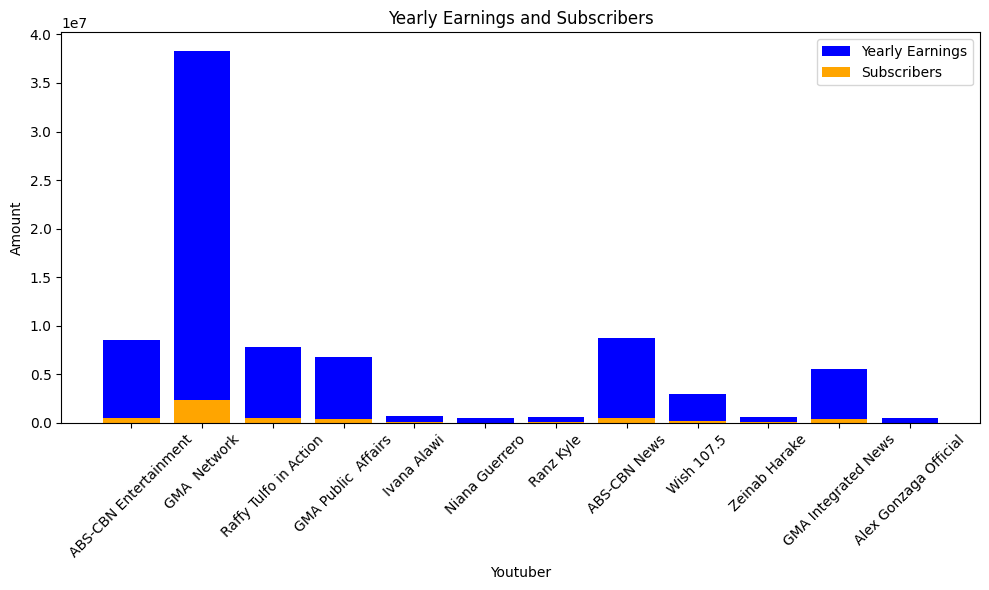

 56%|█████▌    | 1203/2160 [11:28<07:27,  2.14it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


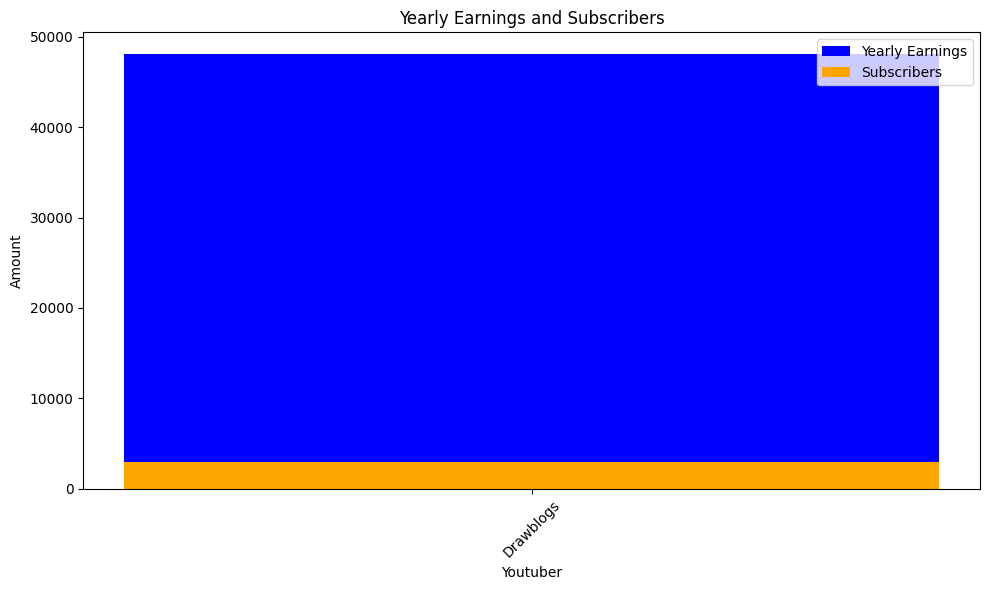

 56%|█████▌    | 1206/2160 [11:29<06:46,  2.35it/s]check
highest_yearly_earnings: 64200000.0, Subscribers: 4000000.0, Youtuber: HAR PAL GEO
highest_yearly_earnings: 55200000.0, Subscribers: 3400000.0, Youtuber: ARY Digital HD
highest_yearly_earnings: 32900000.0, Subscribers: 2100000.0, Youtuber: HUM TV
highest_yearly_earnings: 4800000.0, Subscribers: 300200.0, Youtuber: Geo News
highest_yearly_earnings: 28.0, Subscribers: 2.0, Youtuber: Wolfoo Channel
highest_yearly_earnings: 419.0, Subscribers: 26.0, Youtuber: Quantum Tech HD


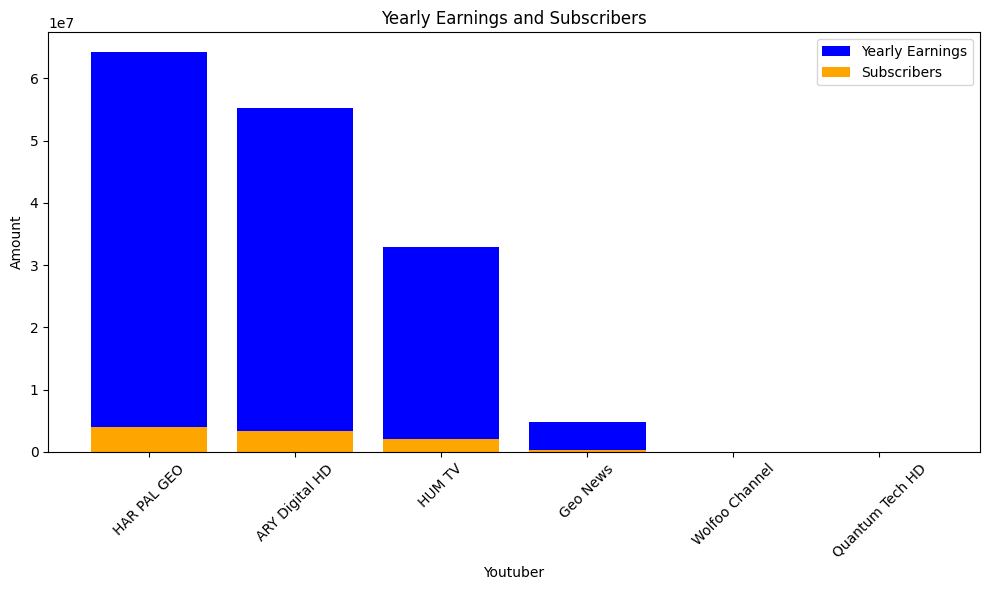

 56%|█████▌    | 1209/2160 [11:31<06:45,  2.35it/s]check
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: ýýýýýýýý/Atro


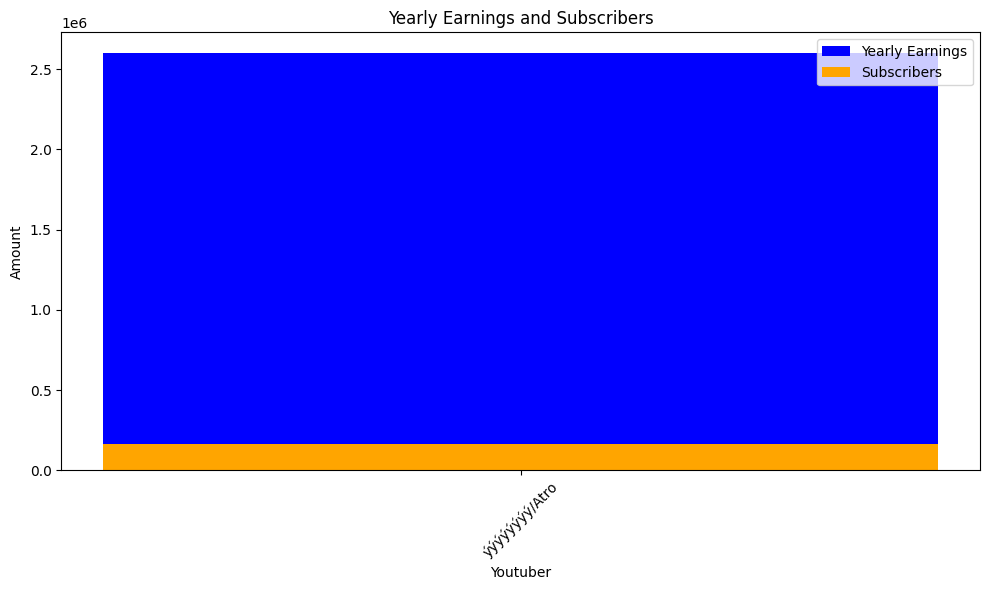

 56%|█████▌    | 1212/2160 [11:32<07:15,  2.17it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


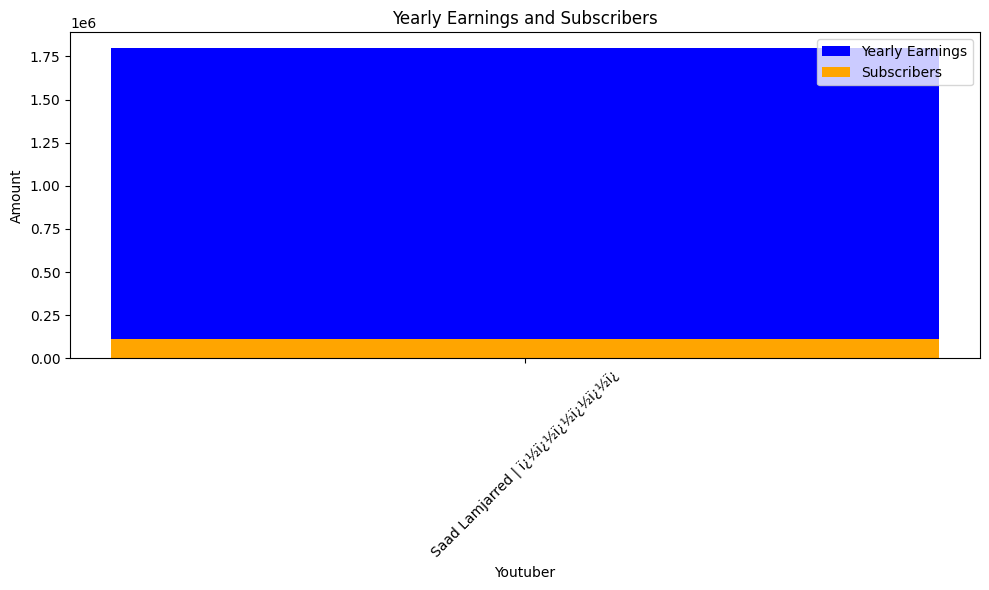

 56%|█████▋    | 1215/2160 [11:34<07:39,  2.06it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Werever2morro
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: La Rosa de Guadalupe
highest_yearly_earnings: 225500.0, Subscribers: 14100.0, Youtuber: Antrax
highest_yearly_earnings: 2100000.0, Subscribers: 133700.0, Youtuber: E-MasterSensei
highest_yearly_earnings: 425700.0, Subscribers: 26600.0, Youtuber: Yair17


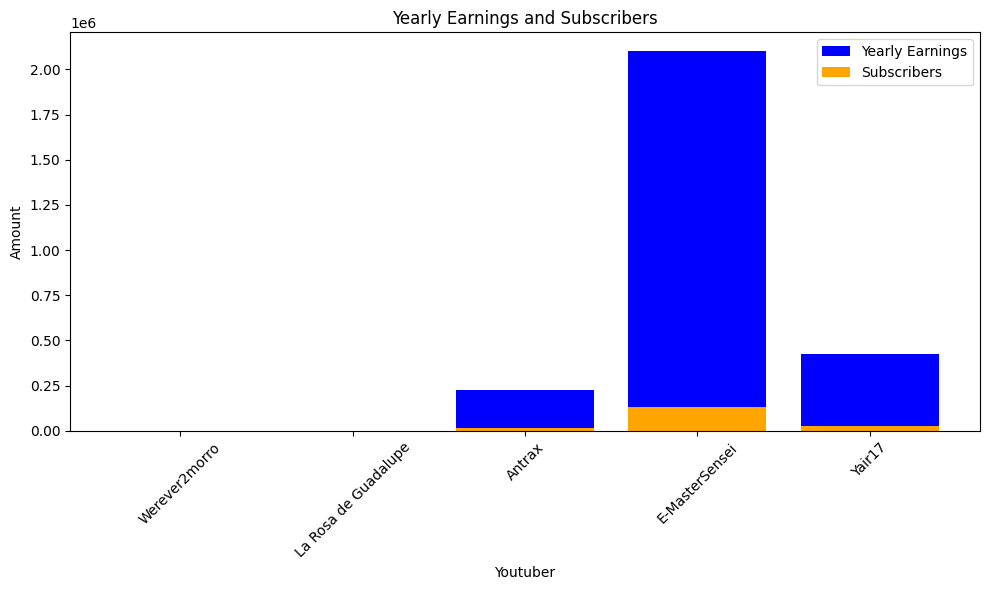

 56%|█████▋    | 1218/2160 [11:36<08:16,  1.90it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


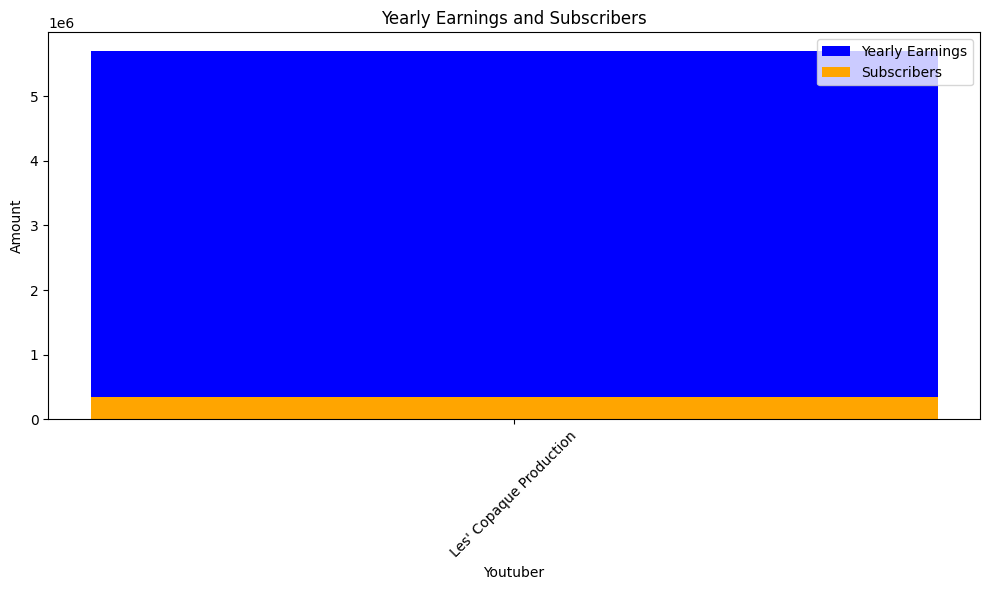

 57%|█████▋    | 1221/2160 [11:38<08:11,  1.91it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


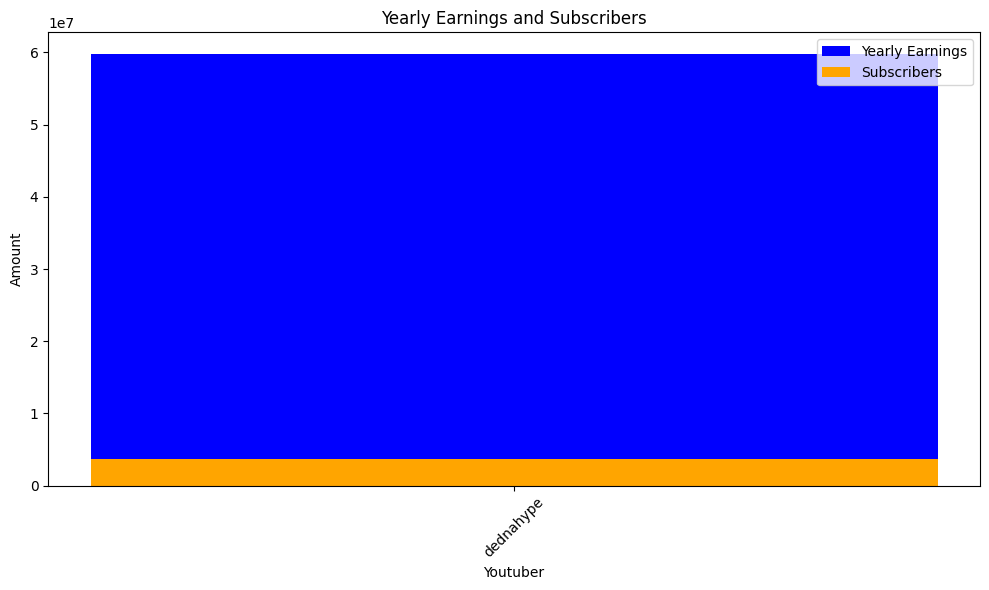

 57%|█████▋    | 1224/2160 [11:40<07:32,  2.07it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


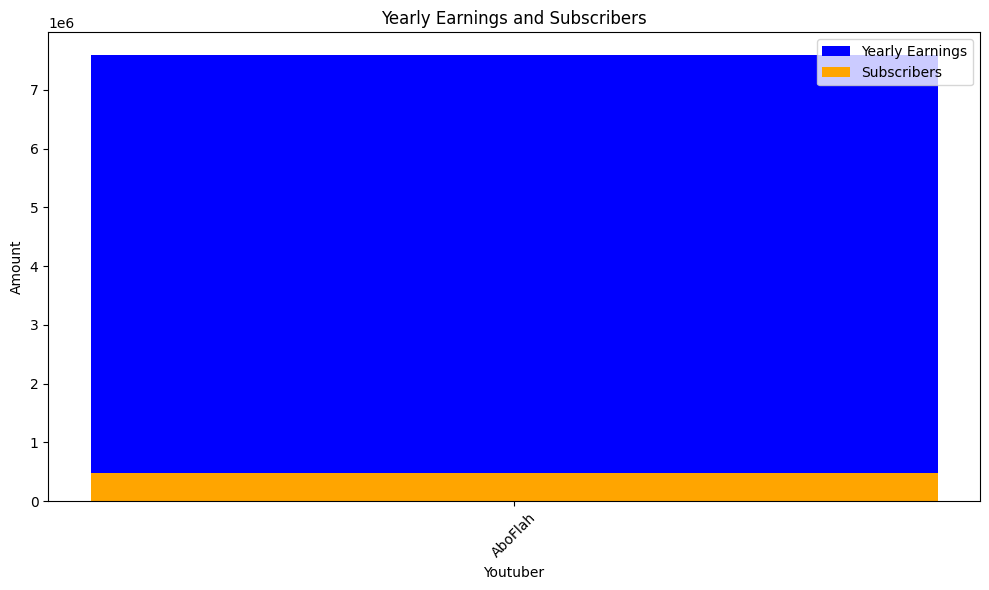

 57%|█████▋    | 1227/2160 [11:41<07:13,  2.15it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


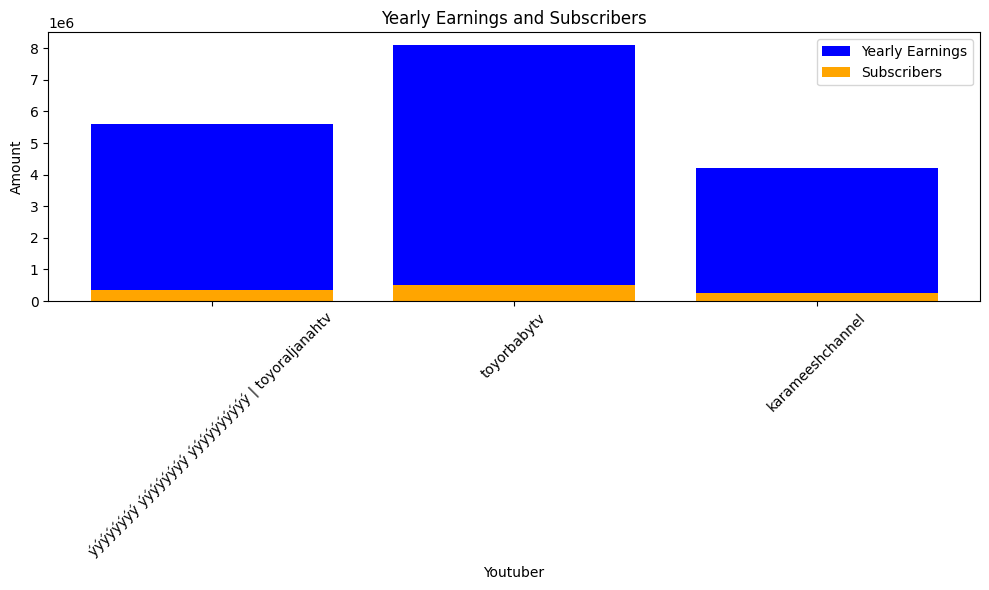

 57%|█████▋    | 1230/2160 [11:43<07:08,  2.17it/s]check
highest_yearly_earnings: 1900000.0, Subscribers: 117600.0, Youtuber: PewDiePie
highest_yearly_earnings: 34600000.0, Subscribers: 2200000.0, Youtuber: Junya.ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 34100000.0, Subscribers: 2100000.0, Youtuber: Sagawa /ï¿½ï¿½ï¿½
highest_yearly_earnings: 13600000.0, Subscribers: 847100.0, Youtuber: ISSEI / ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 119.0, Subscribers: 7.0, Youtuber: Bayashi TV


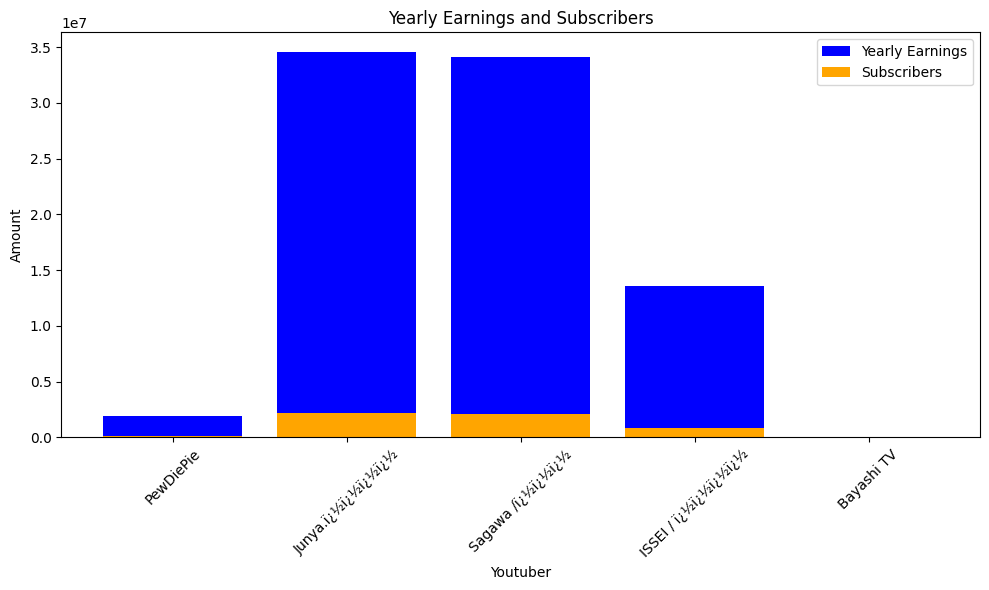

 57%|█████▋    | 1233/2160 [11:45<07:06,  2.17it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


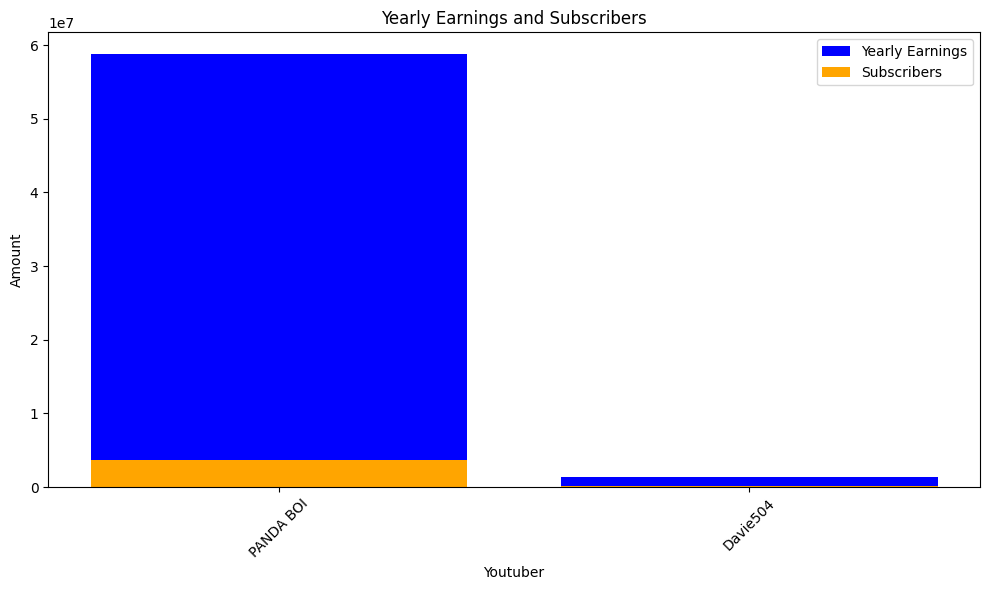

 57%|█████▋    | 1236/2160 [11:46<07:14,  2.13it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


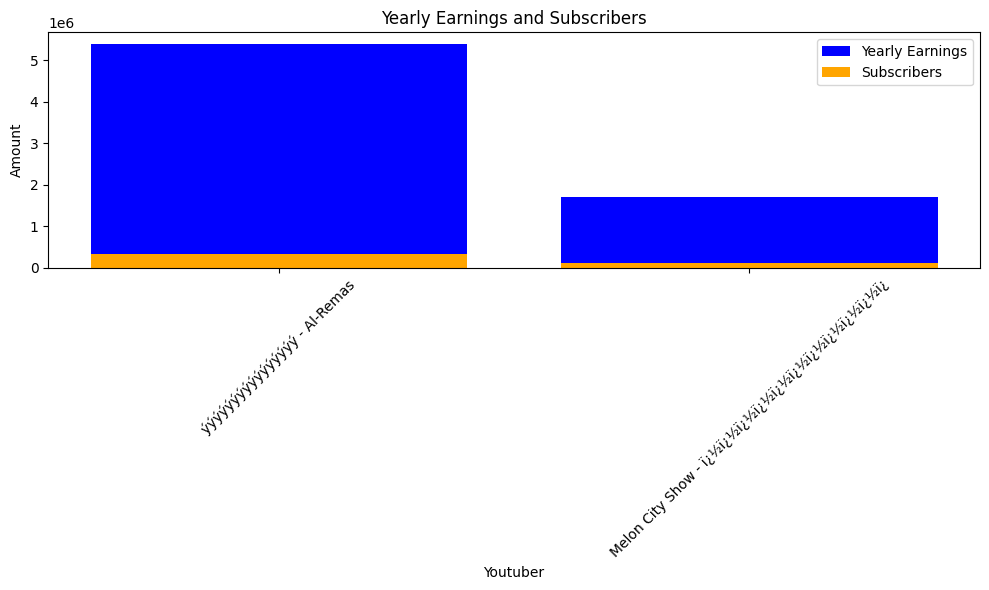

 57%|█████▋    | 1239/2160 [11:48<07:12,  2.13it/s]check
highest_yearly_earnings: 3100000.0, Subscribers: 193500.0, Youtuber: MiawAug
highest_yearly_earnings: 461700.0, Subscribers: 28900.0, Youtuber: Dyland PROS
highest_yearly_earnings: 644900.0, Subscribers: 40300.0, Youtuber: BUDI01 GAMING


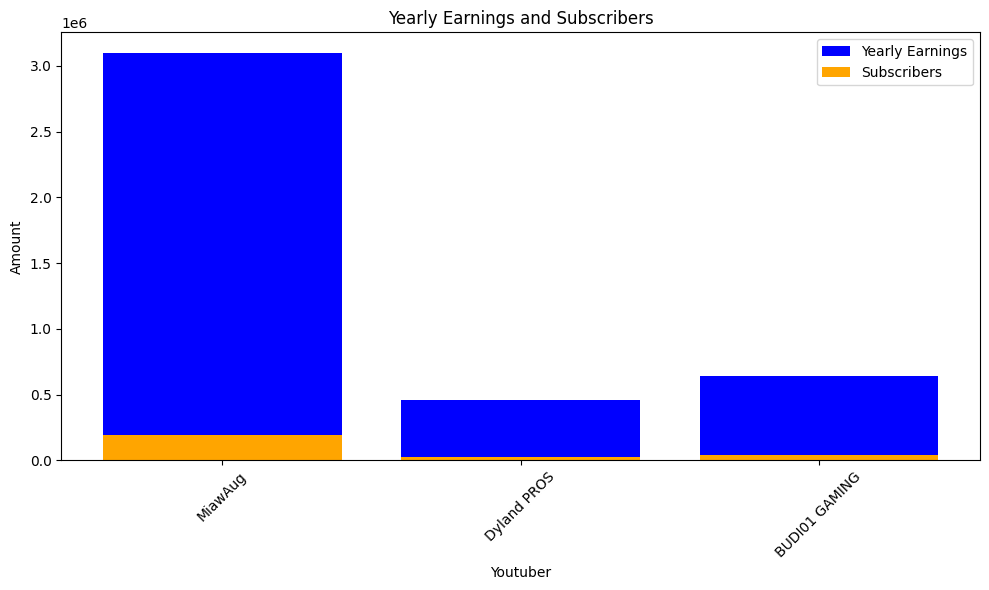

 57%|█████▊    | 1242/2160 [11:50<07:45,  1.97it/s]check
highest_yearly_earnings: 284200.0, Subscribers: 17800.0, Youtuber: LOKESH GAMER
highest_yearly_earnings: 666800.0, Subscribers: 41700.0, Youtuber: Gyan Gamingï¿½
highest_yearly_earnings: 8600000.0, Subscribers: 537700.0, Youtuber: Sanjoy Das Official
highest_yearly_earnings: 2500000.0, Subscribers: 153900.0, Youtuber: FACT FIRE KING
highest_yearly_earnings: 3100000.0, Subscribers: 194200.0, Youtuber: Free Fire India Official


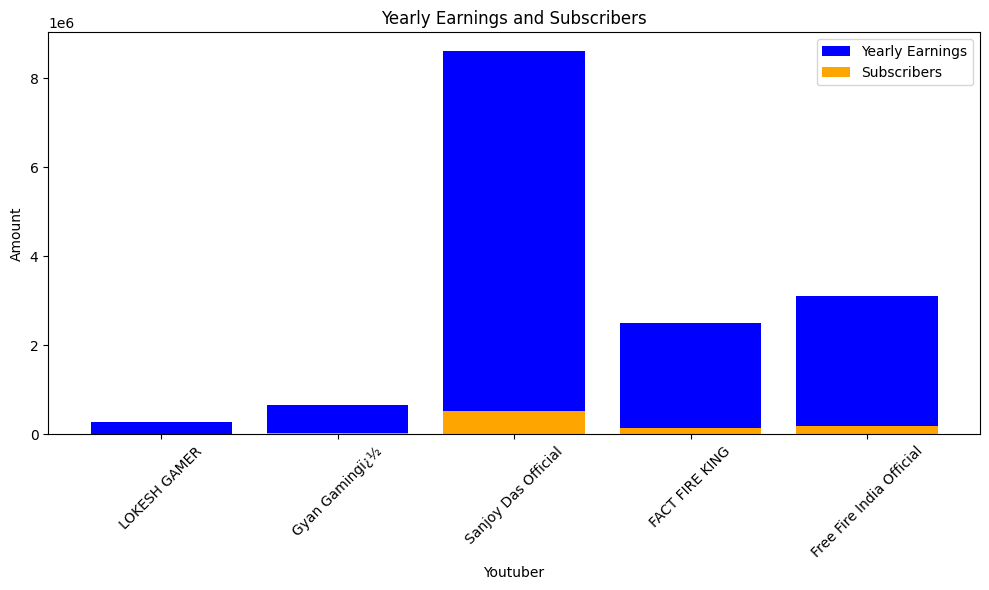

 58%|█████▊    | 1245/2160 [11:52<08:19,  1.83it/s]check
highest_yearly_earnings: 1800.0, Subscribers: 114.0, Youtuber: Beast Philanthropy


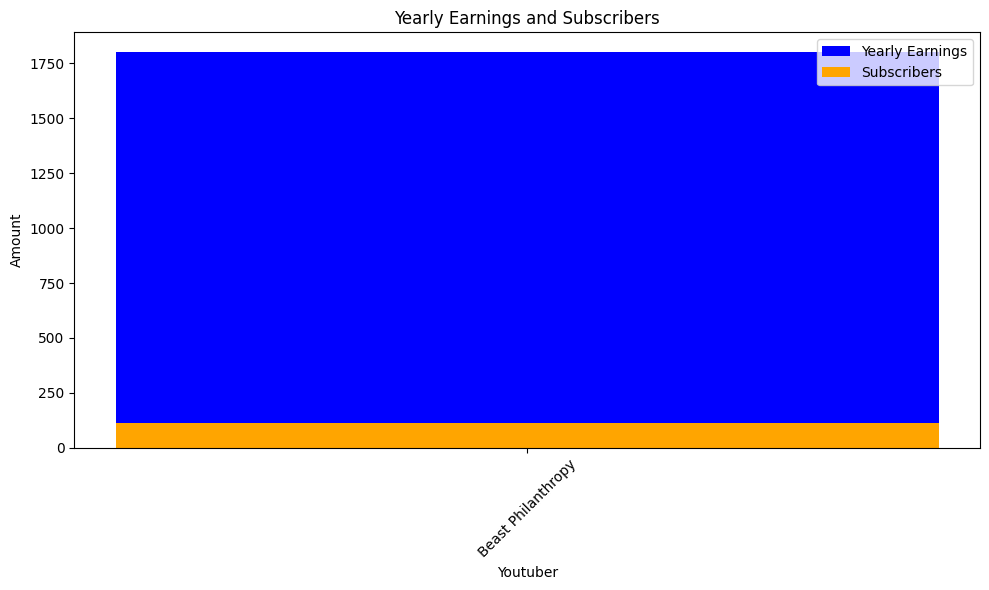

 58%|█████▊    | 1248/2160 [11:54<07:59,  1.90it/s]check
highest_yearly_earnings: 35.0, Subscribers: 2.0, Youtuber: Smile Family
highest_yearly_earnings: 2300000.0, Subscribers: 144300.0, Youtuber: SQUEEZIE
highest_yearly_earnings: 37.0, Subscribers: 2.0, Youtuber: FitDance
highest_yearly_earnings: 548000.0, Subscribers: 34300.0, Youtuber: Cyprien
highest_yearly_earnings: 1500000.0, Subscribers: 91400.0, Youtuber: Lofi Girl


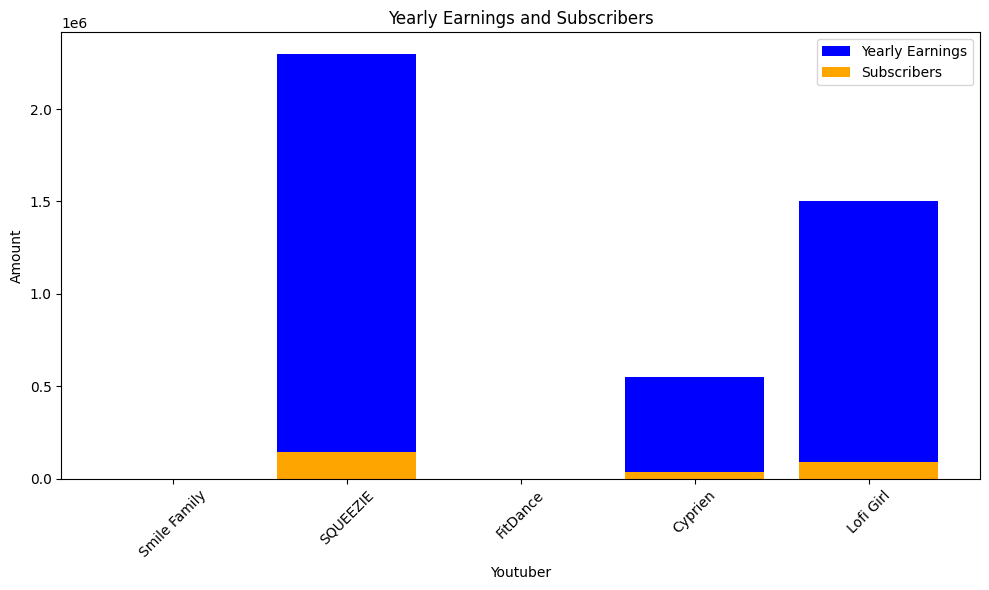

 58%|█████▊    | 1251/2160 [11:56<07:31,  2.01it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


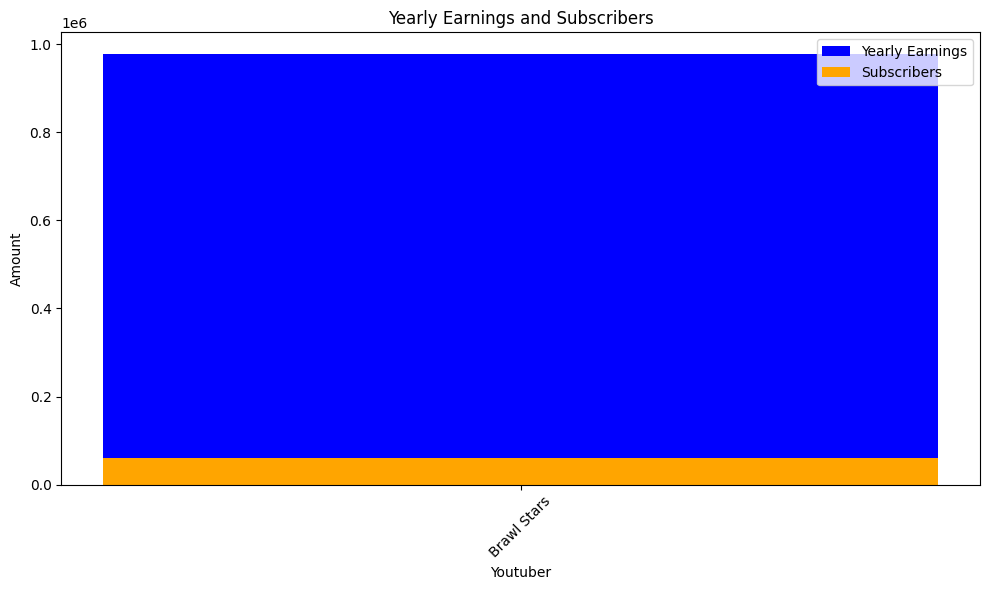

 58%|█████▊    | 1254/2160 [11:57<07:05,  2.13it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


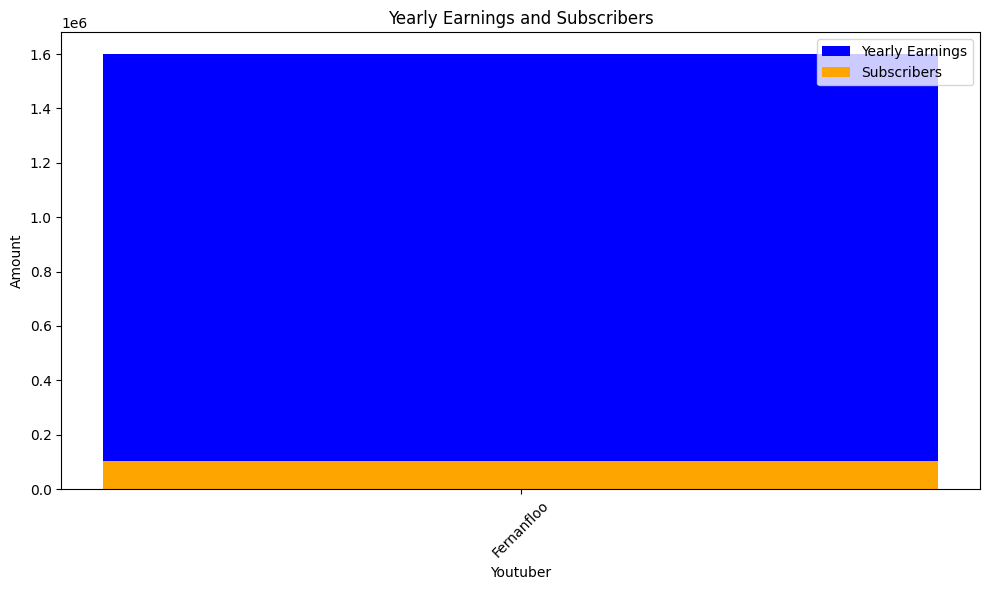

 58%|█████▊    | 1257/2160 [11:59<06:50,  2.20it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


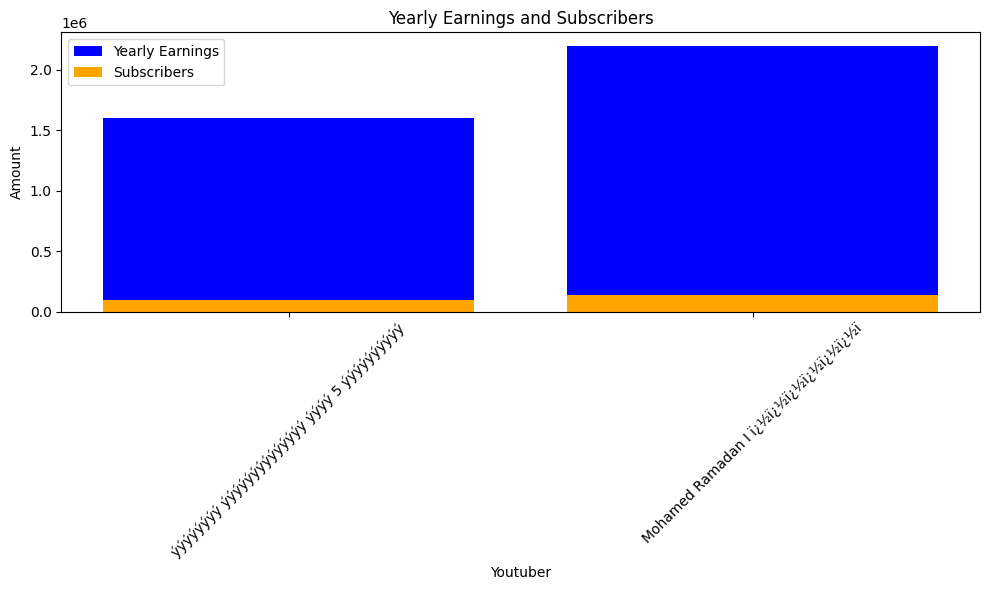

 58%|█████▊    | 1260/2160 [12:01<08:51,  1.69it/s]check
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


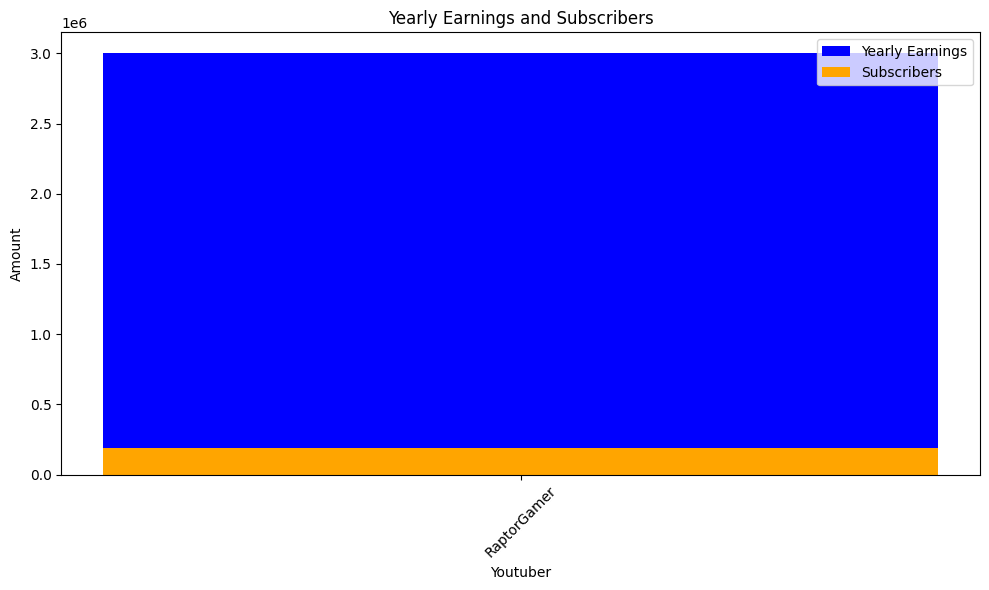

 58%|█████▊    | 1263/2160 [12:03<07:13,  2.07it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


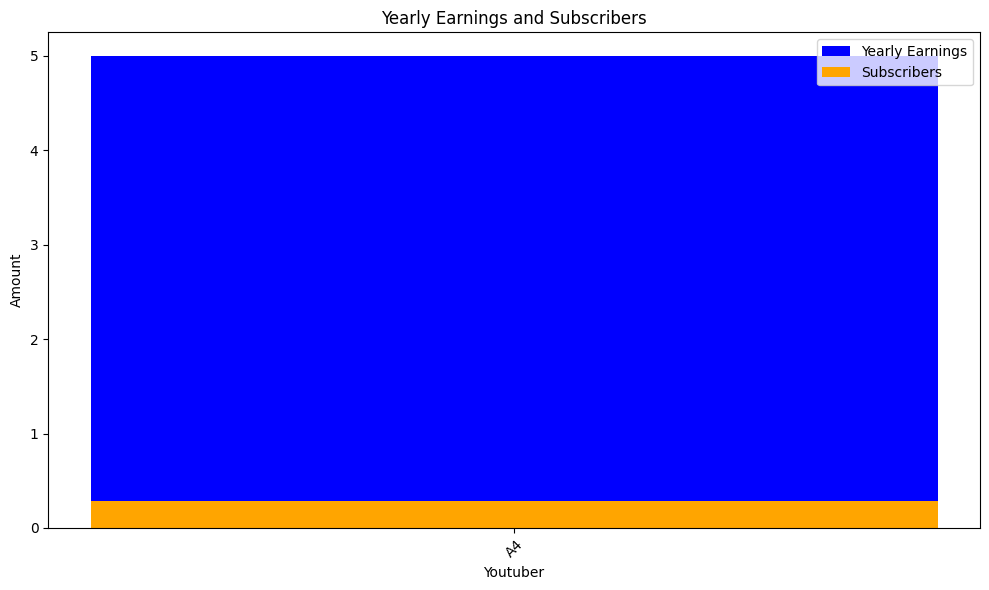

 59%|█████▊    | 1266/2160 [12:05<06:38,  2.25it/s]check
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Shakira
highest_yearly_earnings: 6200000.0, Subscribers: 386100.0, Youtuber: J Balvin
highest_yearly_earnings: 22400000.0, Subscribers: 1400000.0, Youtuber: KAROL G
highest_yearly_earnings: 8300000.0, Subscribers: 521500.0, Youtuber: toycantando
highest_yearly_earnings: 1200000.0, Subscribers: 73100.0, Youtuber: enchufetv
highest_yearly_earnings: 13600000.0, Subscribers: 852400.0, Youtuber: Anuel AA
highest_yearly_earnings: 12700000.0, Subscribers: 791600.0, Youtuber: Ami Rodriguez
highest_yearly_earnings: 2900000.0, Subscribers: 179700.0, Youtuber: Camilo
highest_yearly_earnings: 11000000.0, Subscribers: 686700.0, Youtuber: Codiscos
highest_yearly_earnings: 4100000.0, Subscribers: 258800.0, Youtuber: jbalvinVEVO
highest_yearly_earnings: 15700000.0, Subscribers: 982800.0, Youtuber: Go Ami Go!


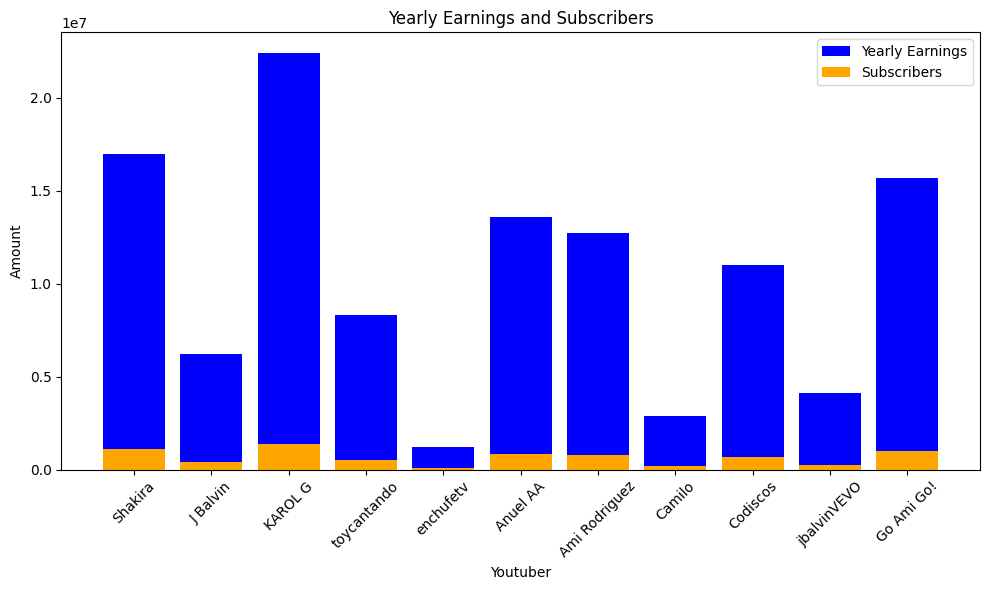

 59%|█████▉    | 1269/2160 [12:06<07:01,  2.11it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


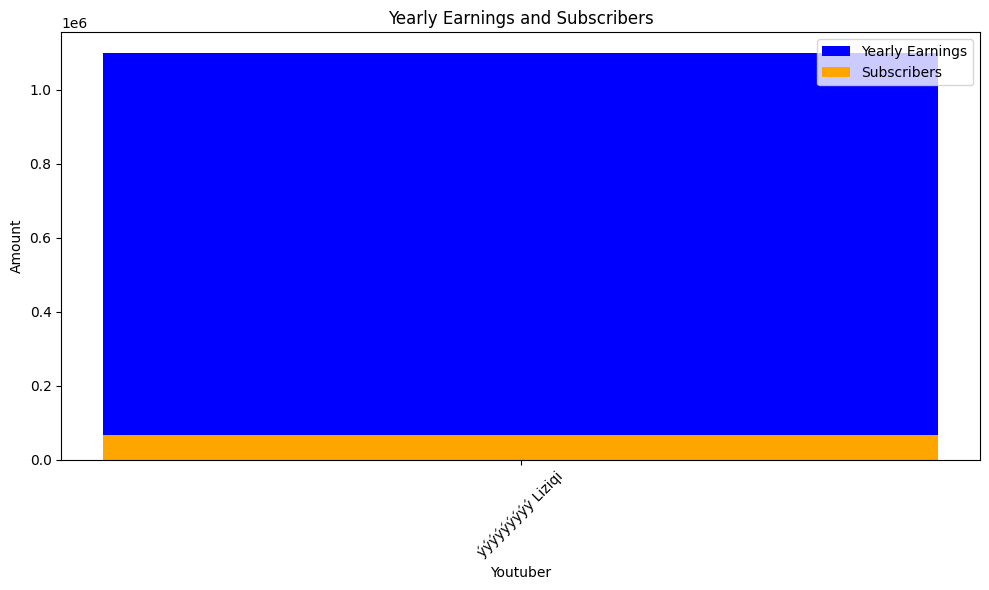

 59%|█████▉    | 1272/2160 [12:08<06:46,  2.19it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 199200.0, Youtuber: JuegaGerman
highest_yearly_earnings: 4800000.0, Subscribers: 300600.0, Youtuber: DeGoBooM


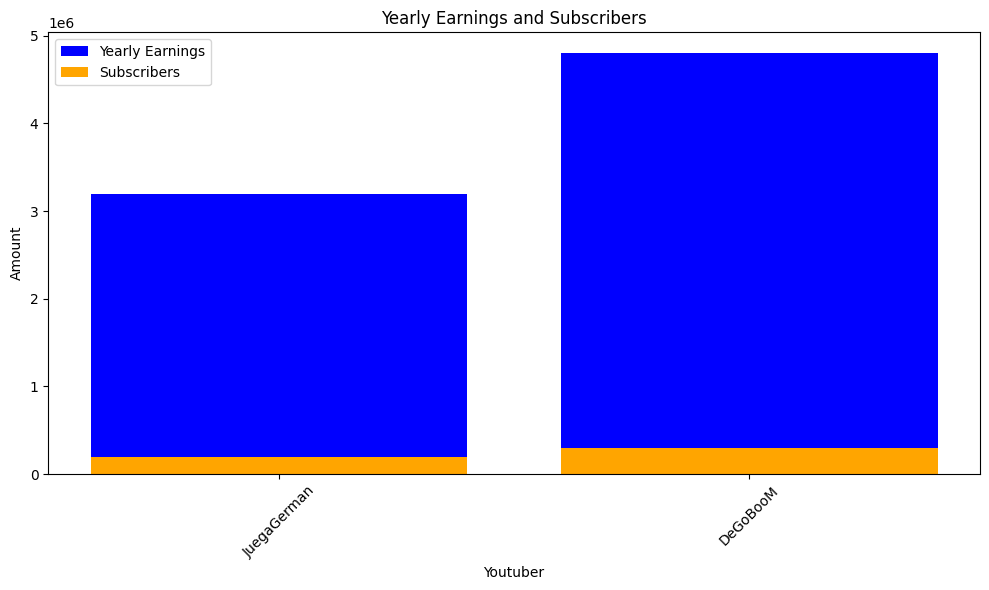

 59%|█████▉    | 1275/2160 [12:10<07:20,  2.01it/s]check
highest_yearly_earnings: 2600000.0, Subscribers: 164800.0, Youtuber: VanossGaming
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: FaZe Rug
highest_yearly_earnings: 1600000.0, Subscribers: 97700.0, Youtuber: Typical Gamer


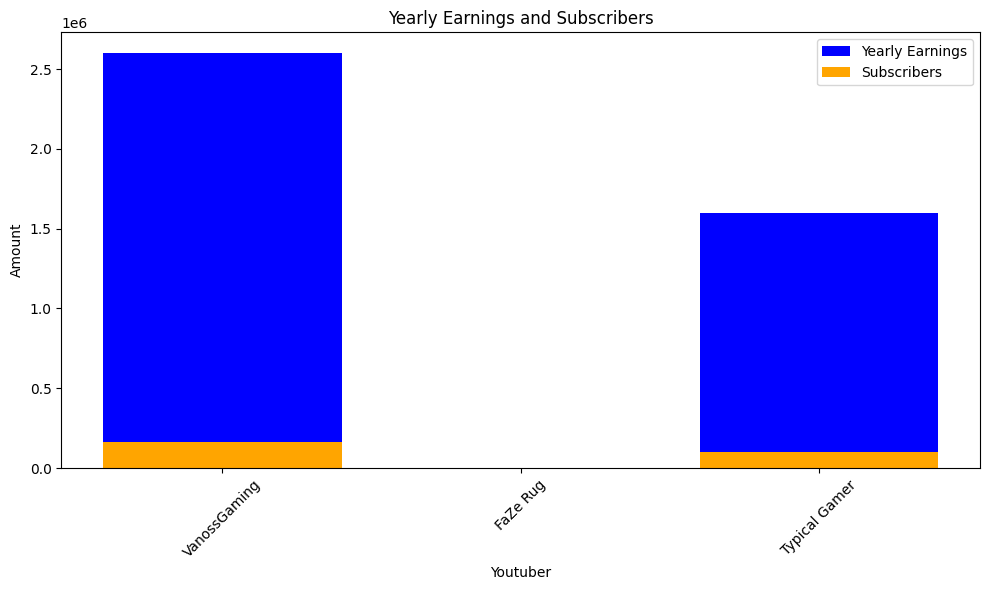

 59%|█████▉    | 1278/2160 [12:12<07:47,  1.89it/s]check
highest_yearly_earnings: 14500000.0, Subscribers: 909300.0, Youtuber: Enaldinho
highest_yearly_earnings: 260200.0, Subscribers: 16300.0, Youtuber: AuthenticGames
highest_yearly_earnings: 1900000.0, Subscribers: 119300.0, Youtuber: TazerCraft
highest_yearly_earnings: 5100000.0, Subscribers: 320200.0, Youtuber: Jazzghost
highest_yearly_earnings: 173700.0, Subscribers: 10900.0, Youtuber: Piuzinho


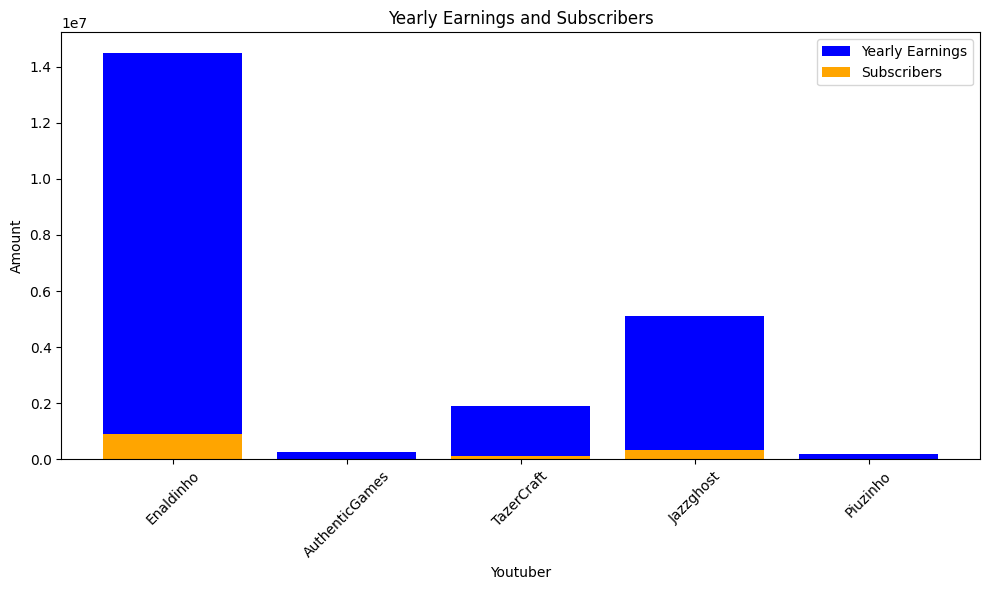

 59%|█████▉    | 1281/2160 [12:14<07:26,  1.97it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


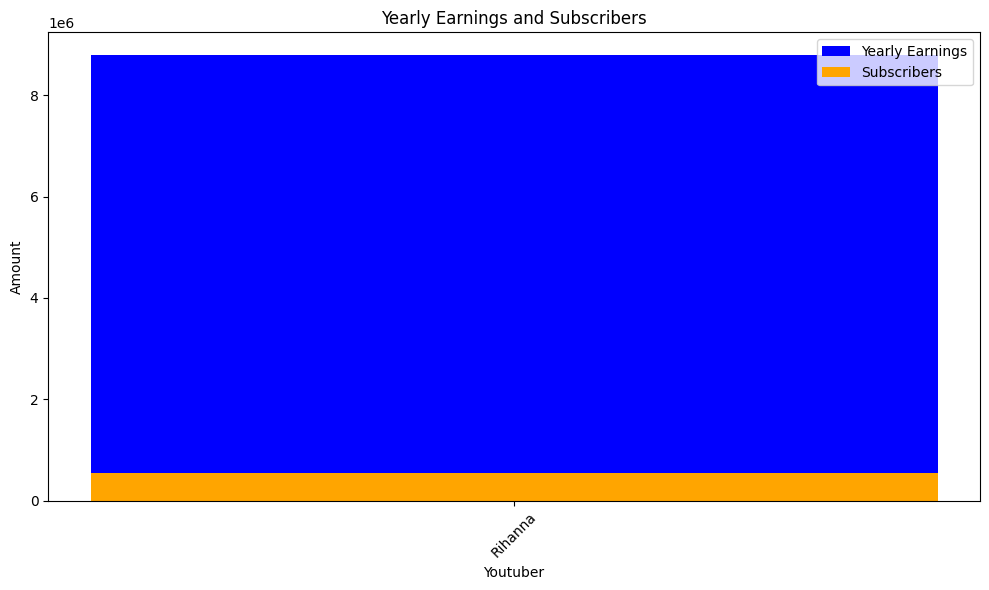

 59%|█████▉    | 1284/2160 [12:15<06:35,  2.21it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


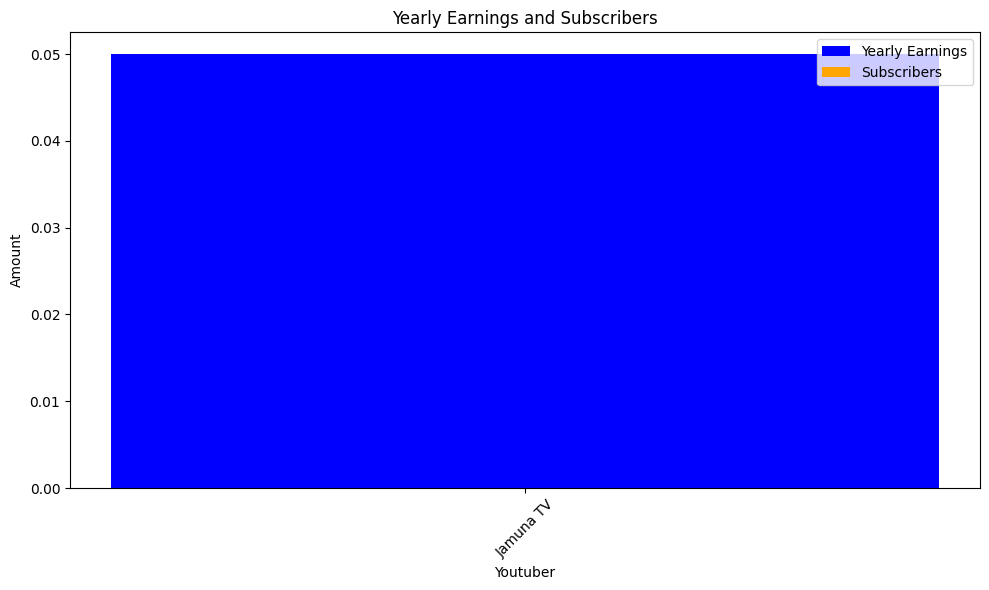

 60%|█████▉    | 1287/2160 [12:17<06:12,  2.34it/s]check
highest_yearly_earnings: 1300000.0, Subscribers: 78200.0, Youtuber: LazarBeam
highest_yearly_earnings: 1000000.0, Subscribers: 63200.0, Youtuber: Lachlan


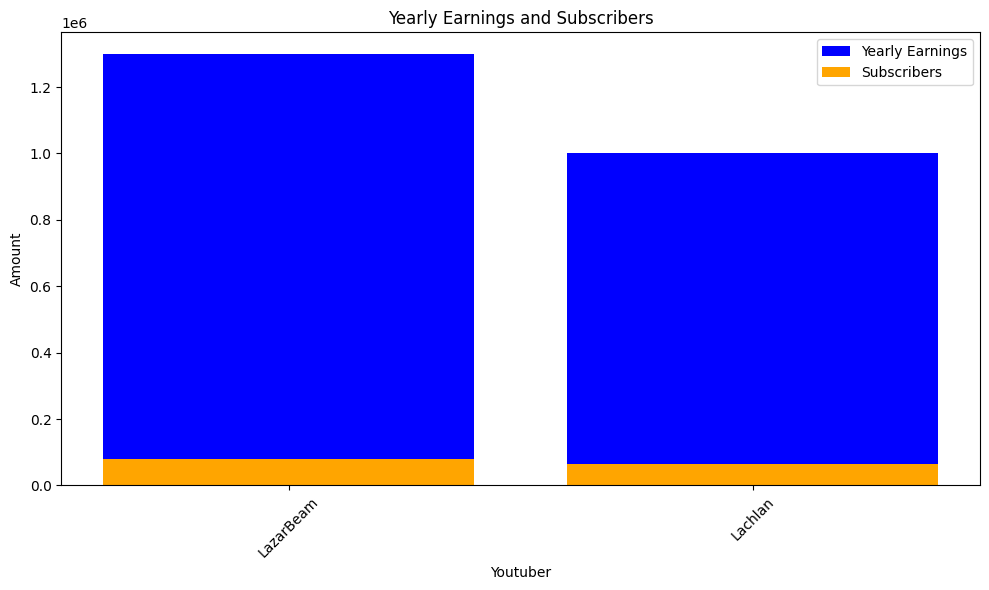

 60%|█████▉    | 1290/2160 [12:18<06:14,  2.32it/s]check
highest_yearly_earnings: 9200000.0, Subscribers: 572000.0, Youtuber: TheDonato
highest_yearly_earnings: 1300000.0, Subscribers: 82600.0, Youtuber: RobleisIUTU
highest_yearly_earnings: 3100000.0, Subscribers: 192300.0, Youtuber: Lyna


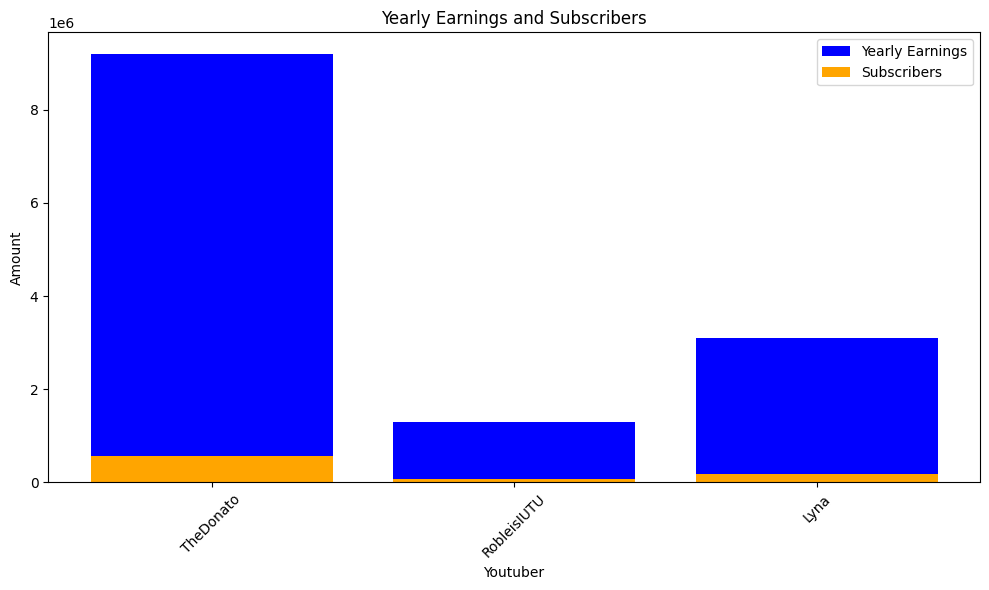

 60%|█████▉    | 1293/2160 [12:20<06:16,  2.31it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


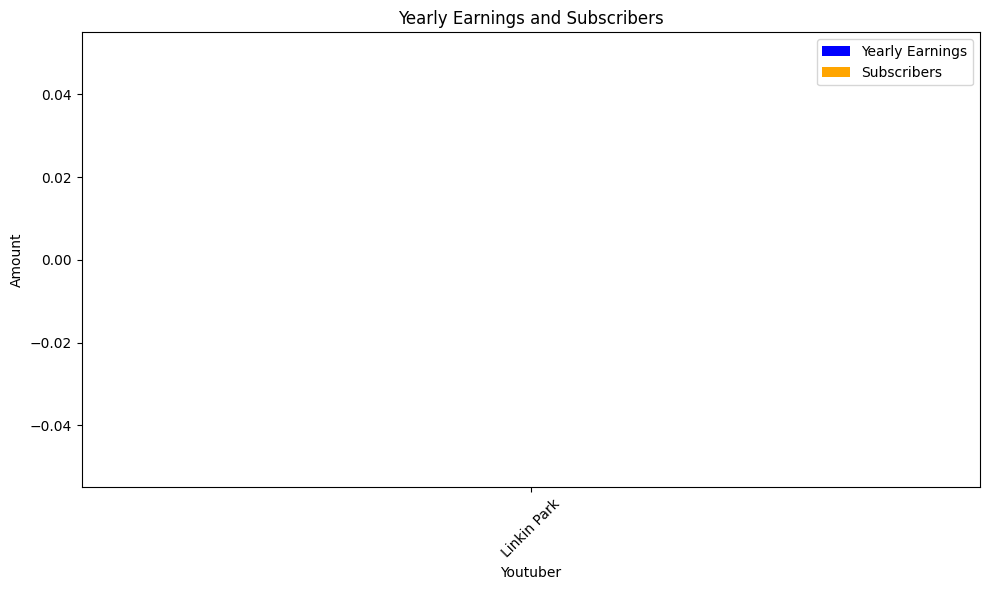

 60%|██████    | 1296/2160 [12:21<06:00,  2.40it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


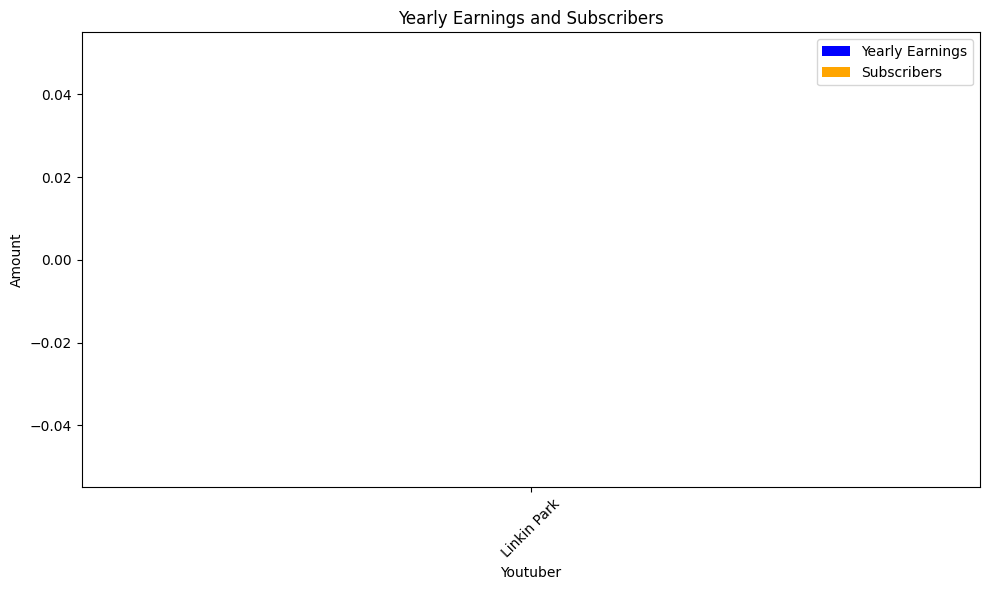

check
highest_yearly_earnings: 12300000.0, Subscribers: 770200.0, Youtuber: POPS Kids


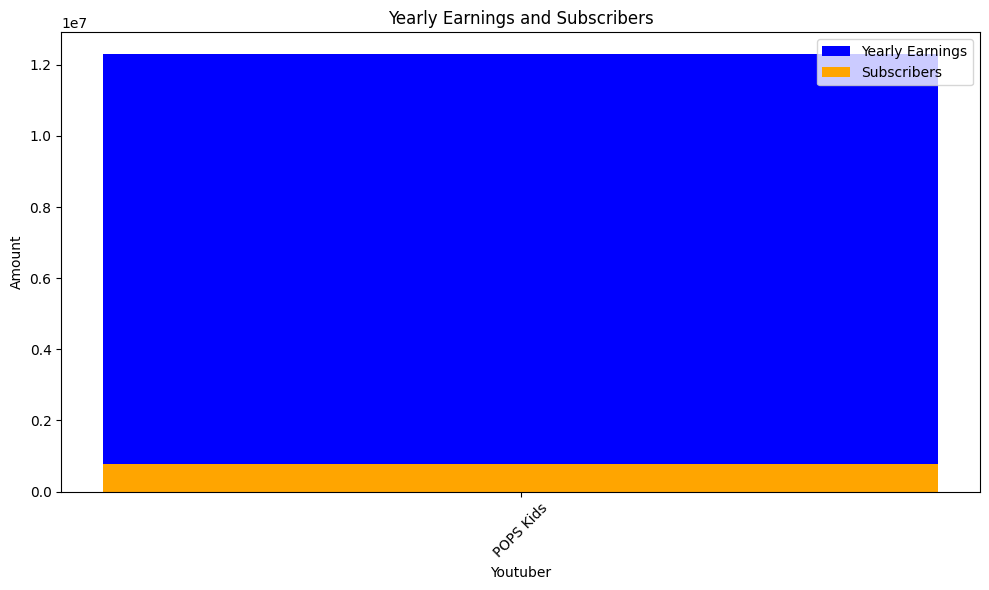

 60%|██████    | 1299/2160 [12:23<07:34,  1.90it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


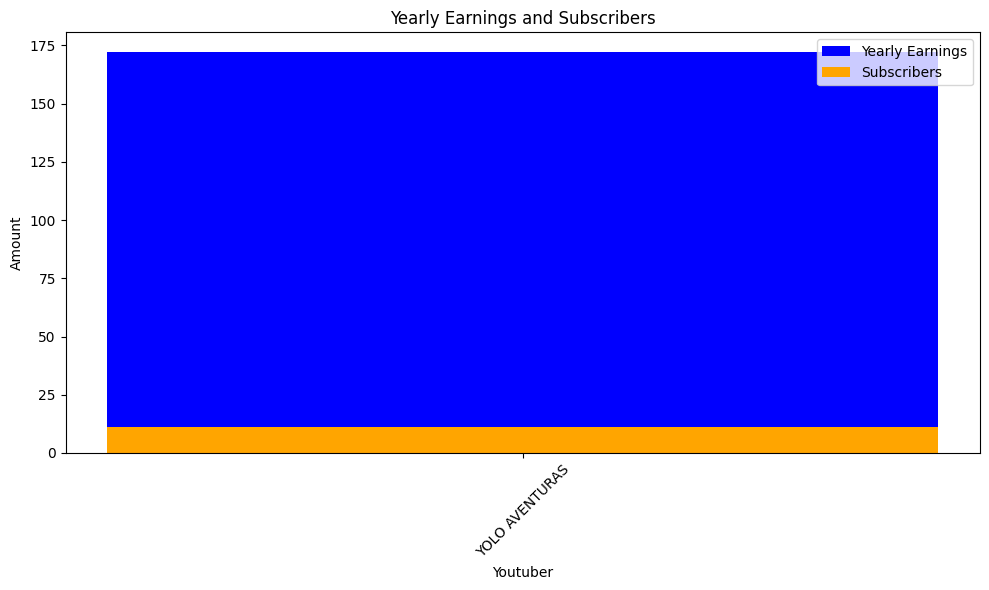

 60%|██████    | 1302/2160 [12:25<06:54,  2.07it/s]check
highest_yearly_earnings: 5500000.0, Subscribers: 344000.0, Youtuber: Movieclips
highest_yearly_earnings: 32200000.0, Subscribers: 2000000.0, Youtuber: Masha and The Bear
highest_yearly_earnings: 16100000.0, Subscribers: 1000000.0, Youtuber: Genevieve's Playhouse - Learning Videos for Kids
highest_yearly_earnings: 6700000.0, Subscribers: 421000.0, Youtuber: WB Kids
highest_yearly_earnings: 3.0, Subscribers: 0.19, Youtuber: Marvel Entertainment
highest_yearly_earnings: 1200000.0, Subscribers: 77200.0, Youtuber: Rotten Tomatoes Trailers
highest_yearly_earnings: 1300000.0, Subscribers: 82100.0, Youtuber: Talking Tom & Friends
highest_yearly_earnings: 1400000.0, Subscribers: 89200.0, Youtuber: Kwebbelkop
highest_yearly_earnings: 21600.0, Subscribers: 1300.0, Youtuber: les boys tv2
highest_yearly_earnings: 22700.0, Subscribers: 1400.0, Youtuber: Future
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Wolfoo Family


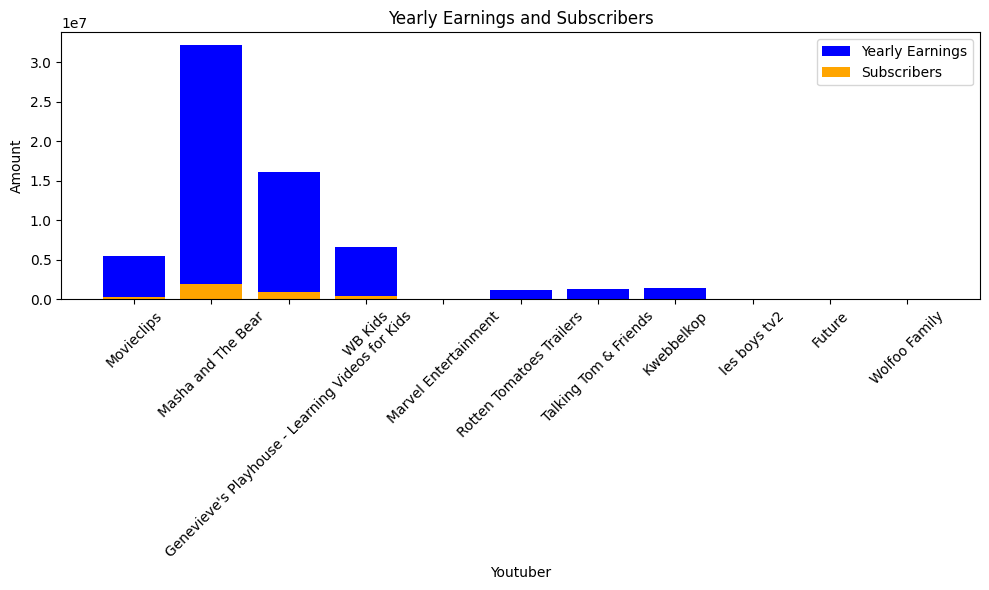

 60%|██████    | 1305/2160 [12:27<07:12,  1.98it/s]check
highest_yearly_earnings: 2600000.0, Subscribers: 160800.0, Youtuber: Peppa Pig Espaï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 1300000.0, Subscribers: 83900.0, Youtuber: Talking Angela


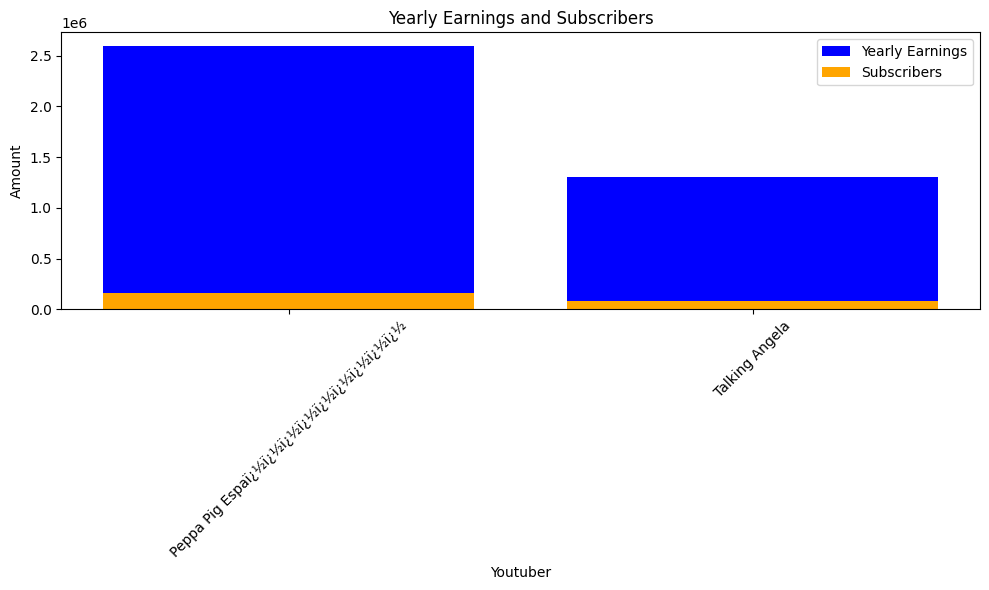

 61%|██████    | 1308/2160 [12:29<07:51,  1.81it/s]check
highest_yearly_earnings: 11900000.0, Subscribers: 743200.0, Youtuber: shfa2 - ï¿½ï¿½
highest_yearly_earnings: 7300000.0, Subscribers: 453600.0, Youtuber: shfa show India
highest_yearly_earnings: 76700000.0, Subscribers: 4800000.0, Youtuber: ZAMZAM ELECTRONICS TRADING
highest_yearly_earnings: 746700.0, Subscribers: 46700.0, Youtuber: Noor Stars
highest_yearly_earnings: 3800000.0, Subscribers: 240500.0, Youtuber: FFUNTV
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Supercar Blondie
highest_yearly_earnings: 3900000.0, Subscribers: 240700.0, Youtuber: AlArabiya ï¿½ï¿½ï¿½ï¿½ï¿


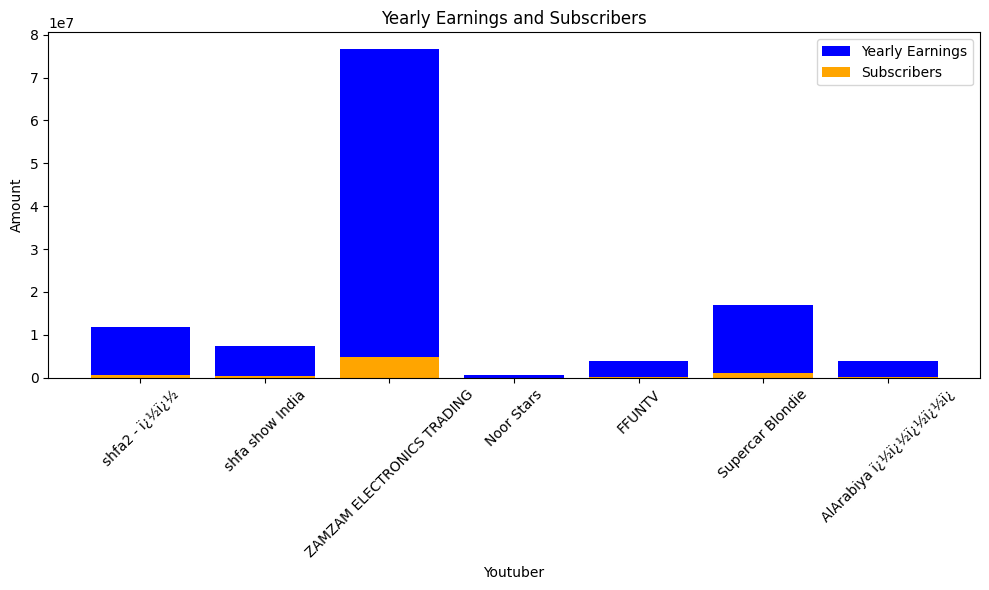

 61%|██████    | 1311/2160 [12:31<07:06,  1.99it/s]check
highest_yearly_earnings: 1400000.0, Subscribers: 87000.0, Youtuber: SlivkiShow
highest_yearly_earnings: 3300000.0, Subscribers: 204000.0, Youtuber: ýýýýýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 17800000.0, Subscribers: 1100000.0, Youtuber: News 24
highest_yearly_earnings: 2300000.0, Subscribers: 141400.0, Youtuber: ýýýýýýýý ýýýýýýýý
highest_yearly_earnings: 5.0, Subscribers: 0.32, Youtuber: SIS vs BRO
highest_yearly_earnings: 3600000.0, Subscribers: 225500.0, Youtuber: Lady Diana
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: VexTrex
highest_yearly_earnings: 3400000.0, Subscribers: 213400.0, Youtuber: ýýýýýýýý ýýýý ýýýýýýýýýýýýýý


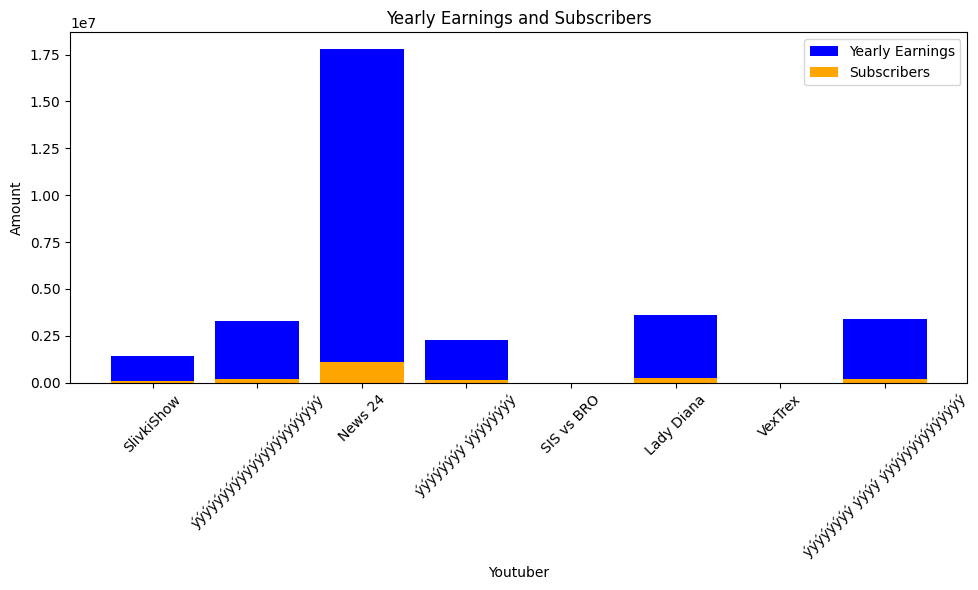

 61%|██████    | 1314/2160 [12:33<06:39,  2.12it/s]check
highest_yearly_earnings: 70200000.0, Subscribers: 4400000.0, Youtuber: BETER Bï¿½ï¿½
highest_yearly_earnings: 20400000.0, Subscribers: 1300000.0, Youtuber: netd mï¿½ï¿
highest_yearly_earnings: 5300000.0, Subscribers: 332400.0, Youtuber: tabii Urdu
highest_yearly_earnings: 212500.0, Subscribers: 13300.0, Youtuber: Oyuncak Avï¿


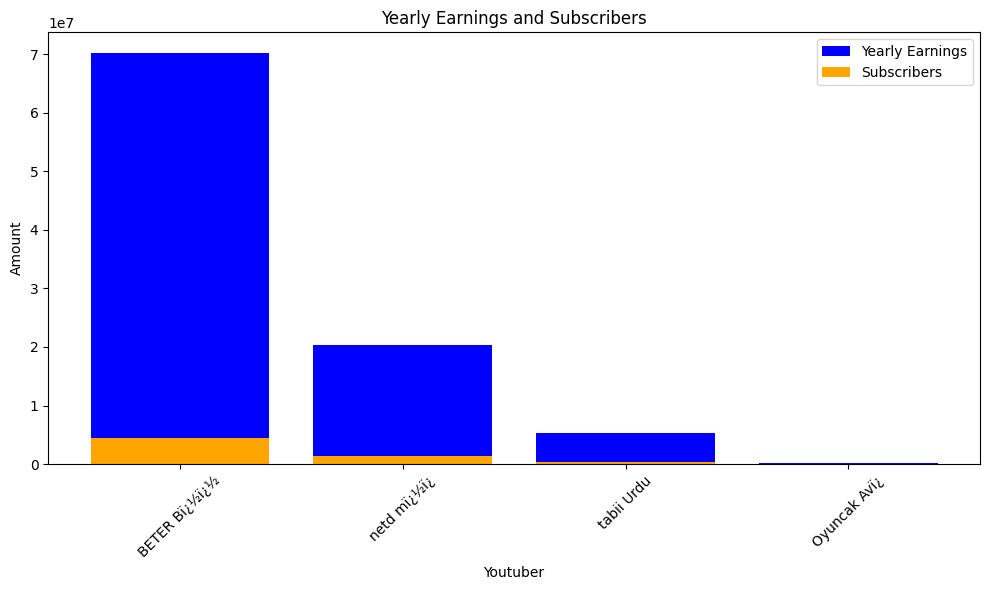

 61%|██████    | 1317/2160 [12:34<06:31,  2.15it/s]check
highest_yearly_earnings: 1.0, Subscribers: 0.07, Youtuber: Alan Walker


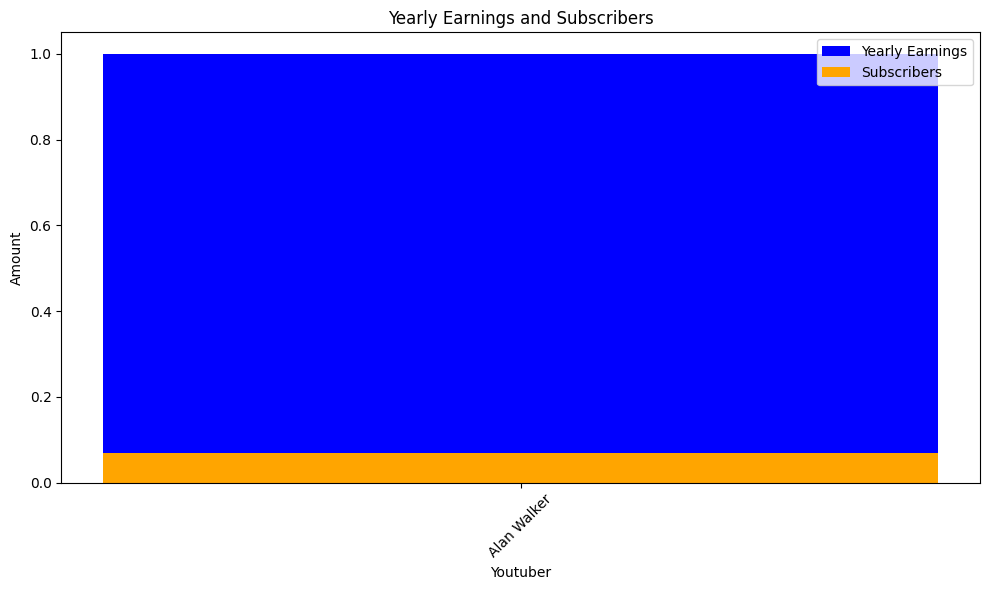

 61%|██████    | 1320/2160 [12:36<06:22,  2.20it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


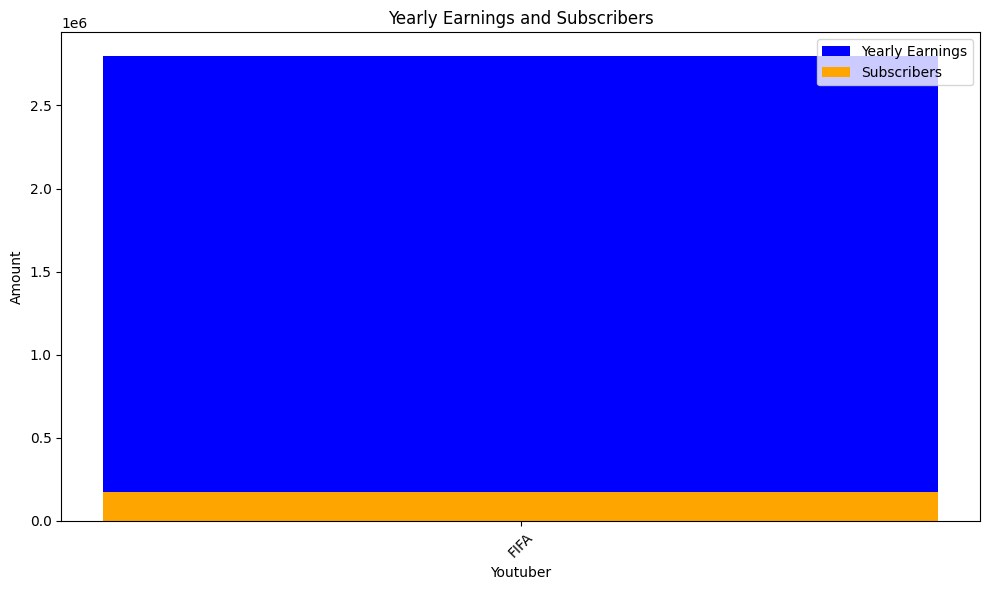

 61%|██████▏   | 1323/2160 [12:37<06:09,  2.27it/s]check
highest_yearly_earnings: 3900000.0, Subscribers: 243700.0, Youtuber: Avicii
highest_yearly_earnings: 23000000.0, Subscribers: 1400000.0, Youtuber: Panda Shorts
highest_yearly_earnings: 658000.0, Subscribers: 41100.0, Youtuber: Narins Beauty
highest_yearly_earnings: 185800.0, Subscribers: 11600.0, Youtuber: RobTopGames


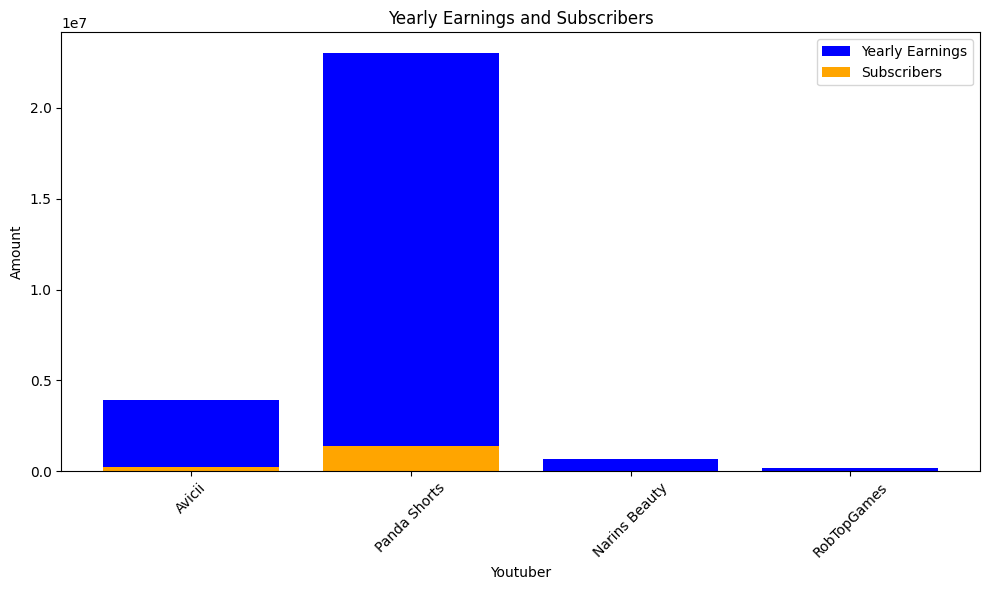

 61%|██████▏   | 1326/2160 [12:39<06:04,  2.29it/s]check
highest_yearly_earnings: 12700000.0, Subscribers: 792300.0, Youtuber: Mikecrack
highest_yearly_earnings: 1900000.0, Subscribers: 117300.0, Youtuber: VEGETTA777
highest_yearly_earnings: 582900.0, Subscribers: 36400.0, Youtuber: AuronPlay
highest_yearly_earnings: 5.0, Subscribers: 0.31, Youtuber: CKN
highest_yearly_earnings: 528200.0, Subscribers: 33000.0, Youtuber: TheWillyrex
highest_yearly_earnings: 2100000.0, Subscribers: 131500.0, Youtuber: TheGrefg
highest_yearly_earnings: 739500.0, Subscribers: 46200.0, Youtuber: Willyrex
highest_yearly_earnings: 3100.0, Subscribers: 196.0, Youtuber: IDEAS EN 5 MINUTOS
highest_yearly_earnings: 0.19, Subscribers: 0.01, Youtuber: AdMe
highest_yearly_earnings: 4100000.0, Subscribers: 254600.0, Youtuber: FC Barcelona
highest_yearly_earnings: 286600.0, Subscribers: 17900.0, Youtuber: Makiman131
highest_yearly_earnings: 665200.0, Subscribers: 41600.0, Youtuber: iTownGamePlay *Terror&Diversiï¿½ï
hi

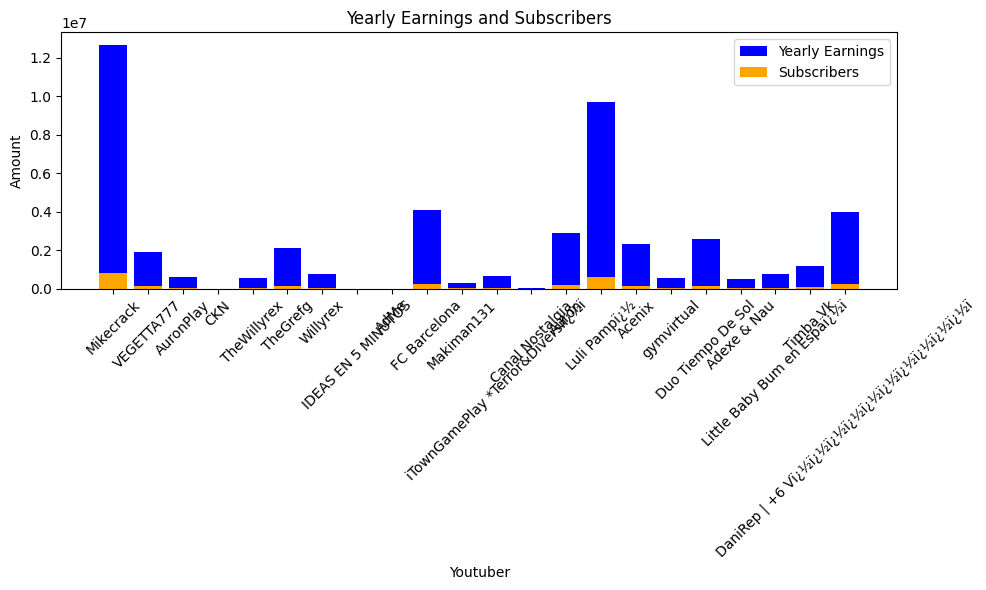

 62%|██████▏   | 1329/2160 [12:41<07:28,  1.85it/s]check
highest_yearly_earnings: 23900000.0, Subscribers: 1500000.0, Youtuber: BLACKPINK
highest_yearly_earnings: 8100000.0, Subscribers: 504900.0, Youtuber: BANGTANTV
highest_yearly_earnings: 28700000.0, Subscribers: 1800000.0, Youtuber: HYBE LABELS
highest_yearly_earnings: 14800000.0, Subscribers: 922900.0, Youtuber: JYP Entertainment
highest_yearly_earnings: 5100000.0, Subscribers: 316700.0, Youtuber: 1theK (ï¿½ï¿½ï¿½ï¿½ï
highest_yearly_earnings: 7600000.0, Subscribers: 475600.0, Youtuber: Mnet K-POP
highest_yearly_earnings: 5200000.0, Subscribers: 324000.0, Youtuber: KBS WORLD TV
highest_yearly_earnings: 3100000.0, Subscribers: 195000.0, Youtuber: officialpsy
highest_yearly_earnings: 163400000.0, Subscribers: 10200000.0, Youtuber: ýýýýýýýýý KIMPRO
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Jane ASMR ï¿½ï¿½
highest_yearly_earnings: 532700.0, Subscribers: 33300.0, Youtuber: JFlaMusic
highest_yearly_earnings: 2000000.0, S

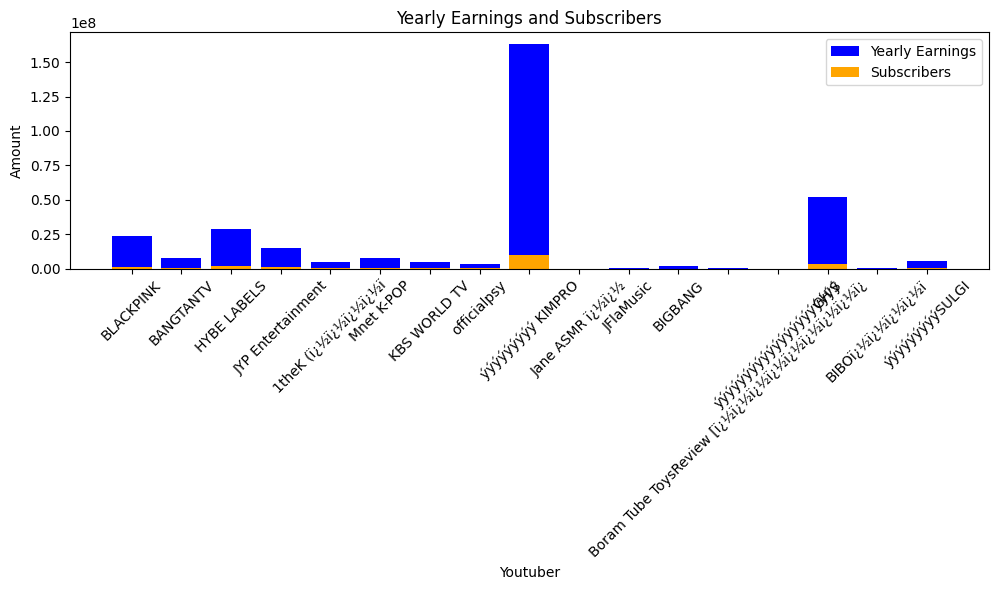

 62%|██████▏   | 1332/2160 [12:43<07:34,  1.82it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Sandeep Maheshwari
highest_yearly_earnings: 5600000.0, Subscribers: 351600.0, Youtuber: LEGO
highest_yearly_earnings: 45100.0, Subscribers: 2800.0, Youtuber: MY FAMILY


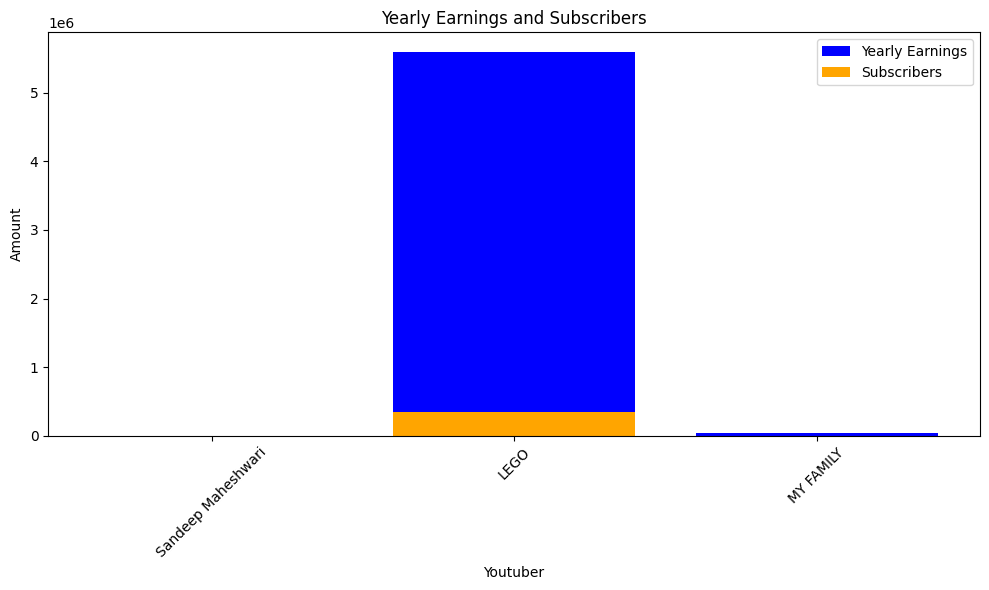

 62%|██████▏   | 1335/2160 [12:46<09:43,  1.41it/s]check
highest_yearly_earnings: 6500000.0, Subscribers: 405100.0, Youtuber: ýýýýýýýý ýý ýýýýýýýý


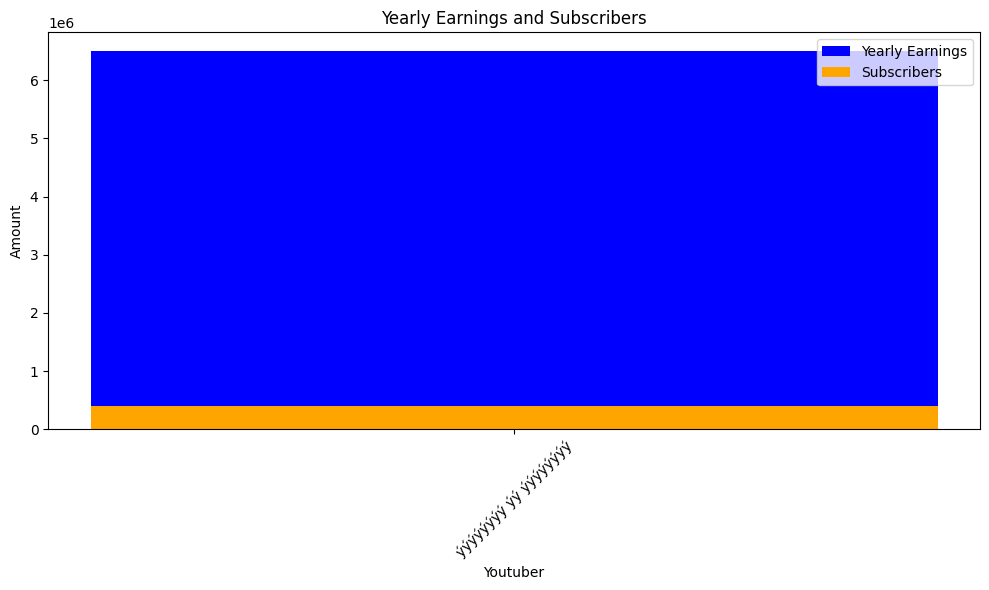

 62%|██████▏   | 1338/2160 [12:48<07:26,  1.84it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


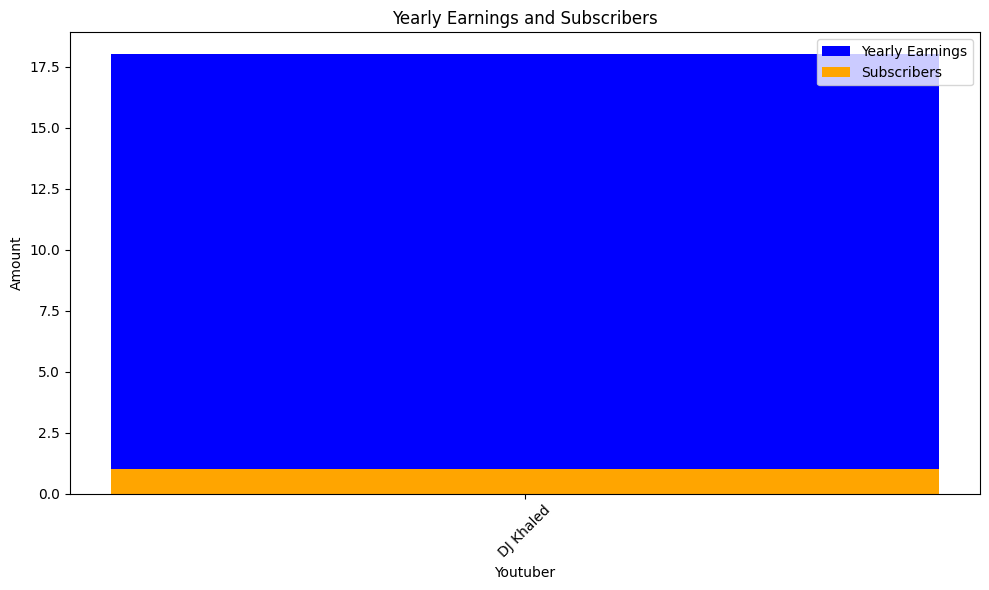

 62%|██████▏   | 1341/2160 [12:50<06:39,  2.05it/s]check
highest_yearly_earnings: 14700000.0, Subscribers: 919600.0, Youtuber: Get Movies


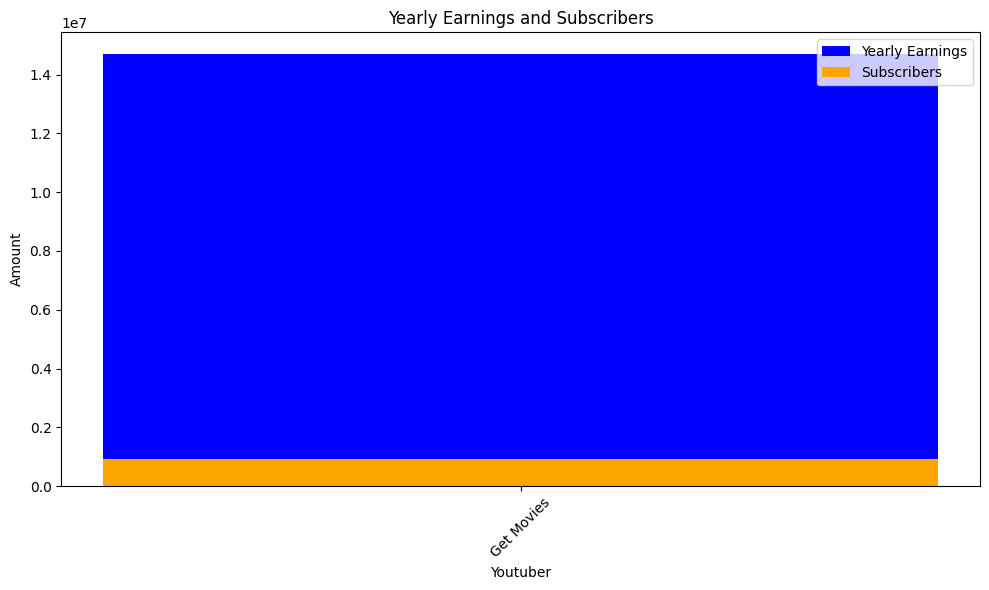

 62%|██████▏   | 1344/2160 [12:51<06:22,  2.13it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529900.0, Youtuber: ABS-CBN Entertainment
highest_yearly_earnings: 38300000.0, Subscribers: 2400000.0, Youtuber: GMA  Network
highest_yearly_earnings: 7800000.0, Subscribers: 489400.0, Youtuber: Raffy Tulfo in Action
highest_yearly_earnings: 6800000.0, Subscribers: 427000.0, Youtuber: GMA Public  Affairs
highest_yearly_earnings: 723800.0, Subscribers: 45200.0, Youtuber: Ivana Alawi
highest_yearly_earnings: 479000.0, Subscribers: 29900.0, Youtuber: Niana Guerrero
highest_yearly_earnings: 594000.0, Subscribers: 37100.0, Youtuber: Ranz Kyle
highest_yearly_earnings: 8700000.0, Subscribers: 544900.0, Youtuber: ABS-CBN News
highest_yearly_earnings: 3000000.0, Subscribers: 188000.0, Youtuber: Wish 107.5
highest_yearly_earnings: 580200.0, Subscribers: 36300.0, Youtuber: Zeinab Harake
highest_yearly_earnings: 5500000.0, Subscribers: 346400.0, Youtuber: GMA Integrated News
highest_yearly_ear

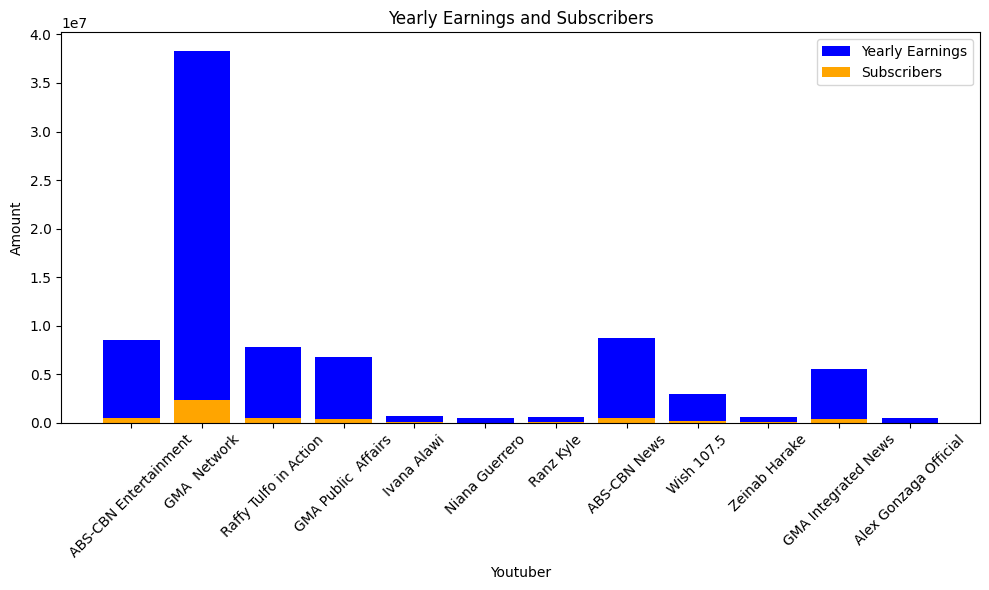

 62%|██████▏   | 1347/2160 [12:53<06:39,  2.03it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


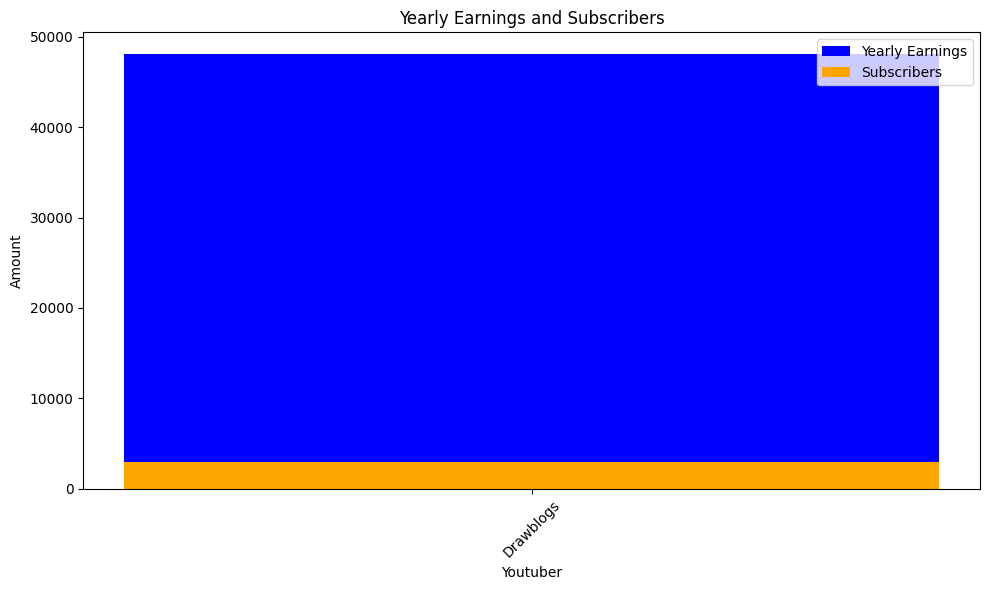

 62%|██████▎   | 1350/2160 [12:55<06:23,  2.11it/s]check
highest_yearly_earnings: 64200000.0, Subscribers: 4000000.0, Youtuber: HAR PAL GEO
highest_yearly_earnings: 55200000.0, Subscribers: 3400000.0, Youtuber: ARY Digital HD
highest_yearly_earnings: 32900000.0, Subscribers: 2100000.0, Youtuber: HUM TV
highest_yearly_earnings: 4800000.0, Subscribers: 300200.0, Youtuber: Geo News
highest_yearly_earnings: 28.0, Subscribers: 2.0, Youtuber: Wolfoo Channel
highest_yearly_earnings: 419.0, Subscribers: 26.0, Youtuber: Quantum Tech HD


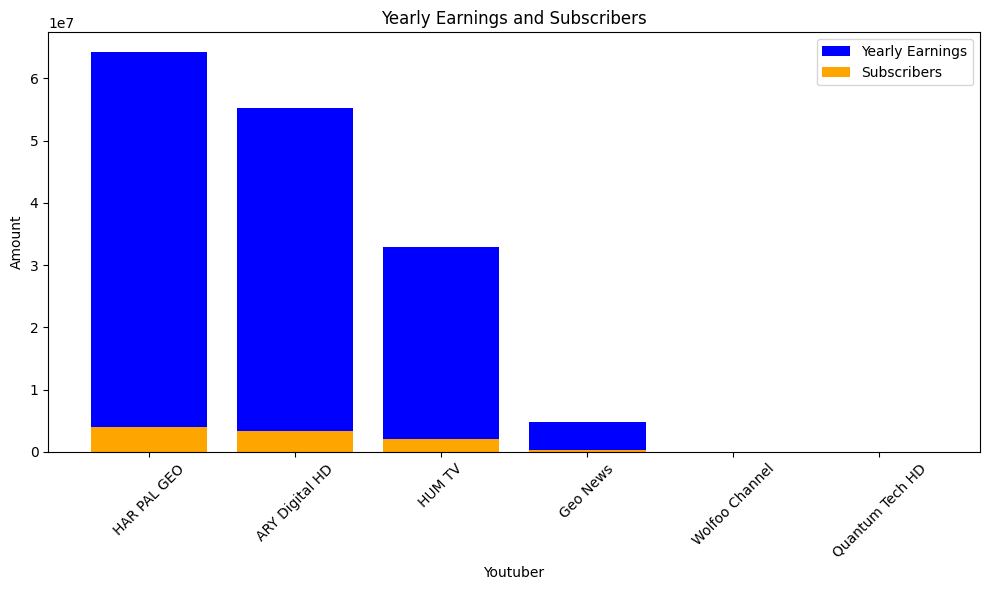

 63%|██████▎   | 1353/2160 [12:57<06:10,  2.18it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300100.0, Youtuber: Spinnin' Records
highest_yearly_earnings: 1700000.0, Subscribers: 107800.0, Youtuber: NikkieTutorials
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: ýýýýýýýý/Atro


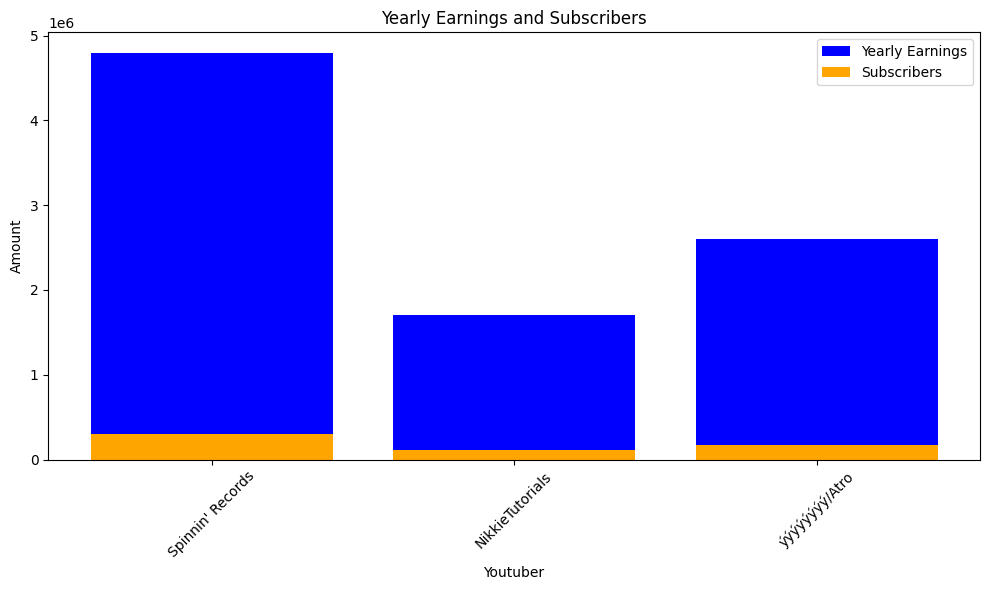

 63%|██████▎   | 1356/2160 [12:58<06:16,  2.14it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


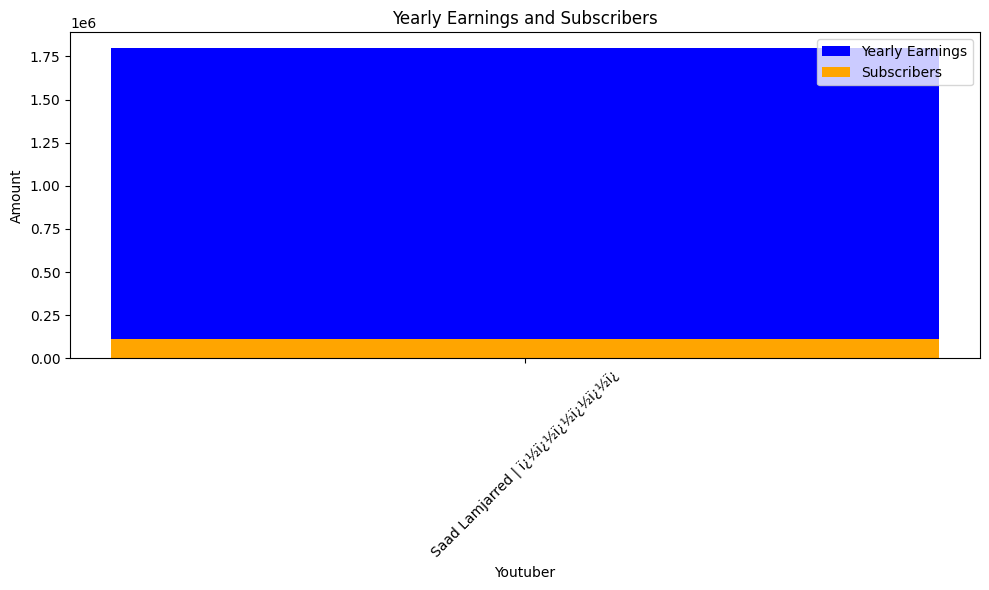

 63%|██████▎   | 1359/2160 [13:00<06:11,  2.15it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 337200.0, Youtuber: Totoy kids - Espaï¿½ï
highest_yearly_earnings: 3400000.0, Subscribers: 211900.0, Youtuber: Gallina Pintadita


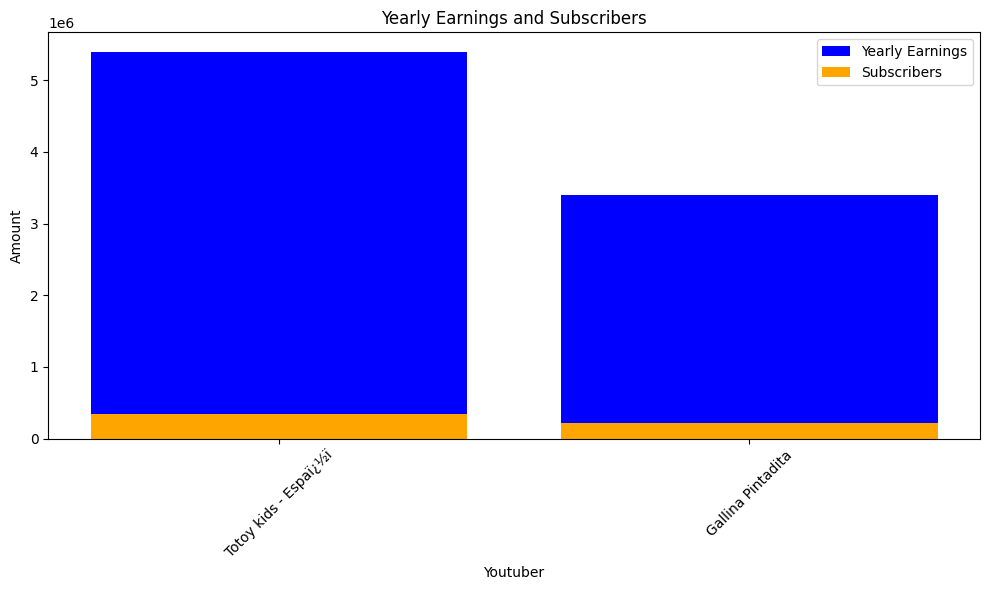

 63%|██████▎   | 1362/2160 [13:02<06:54,  1.92it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


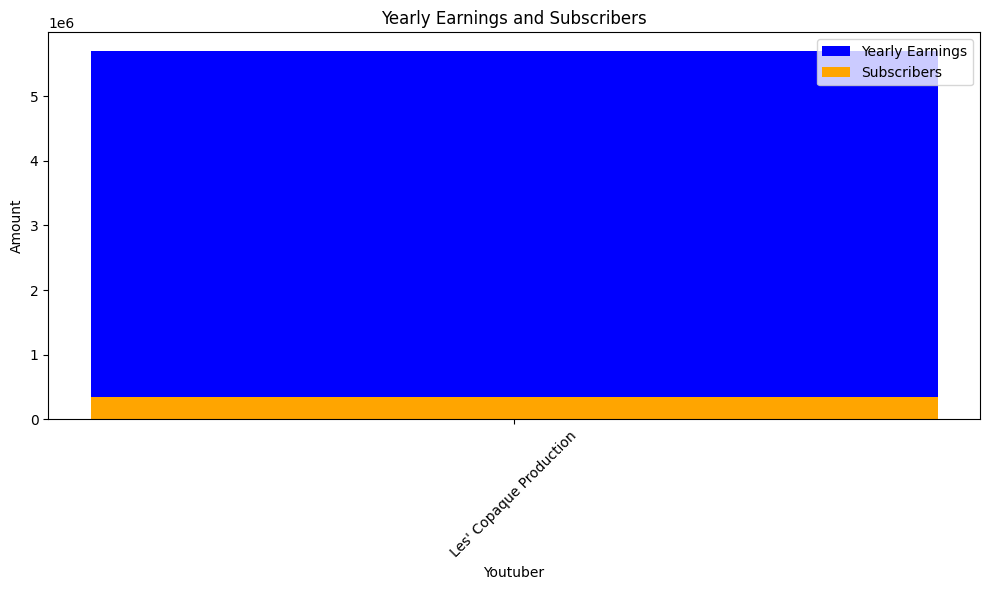

 63%|██████▎   | 1365/2160 [13:04<06:55,  1.92it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


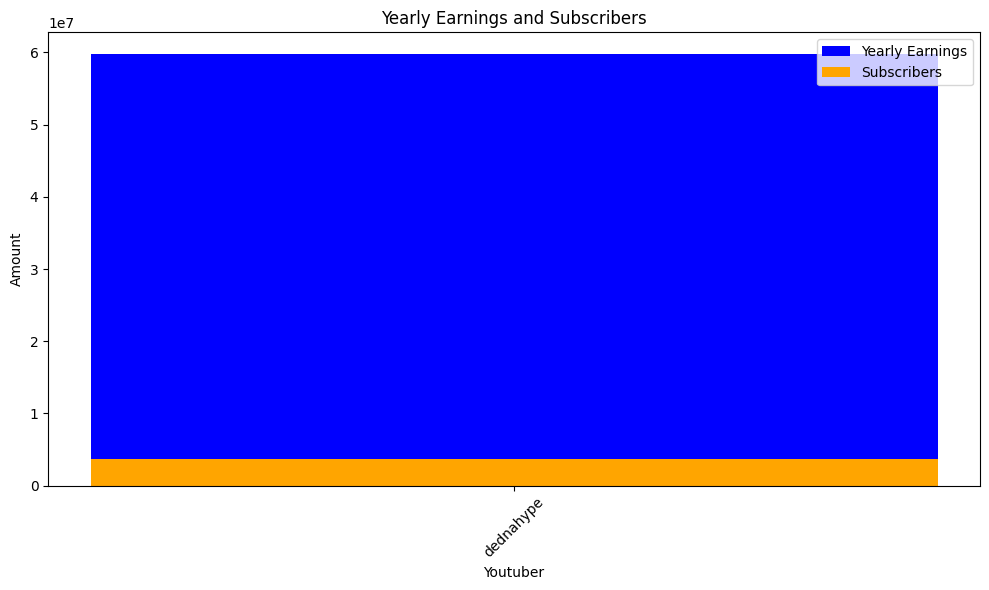

 63%|██████▎   | 1368/2160 [13:05<06:23,  2.07it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


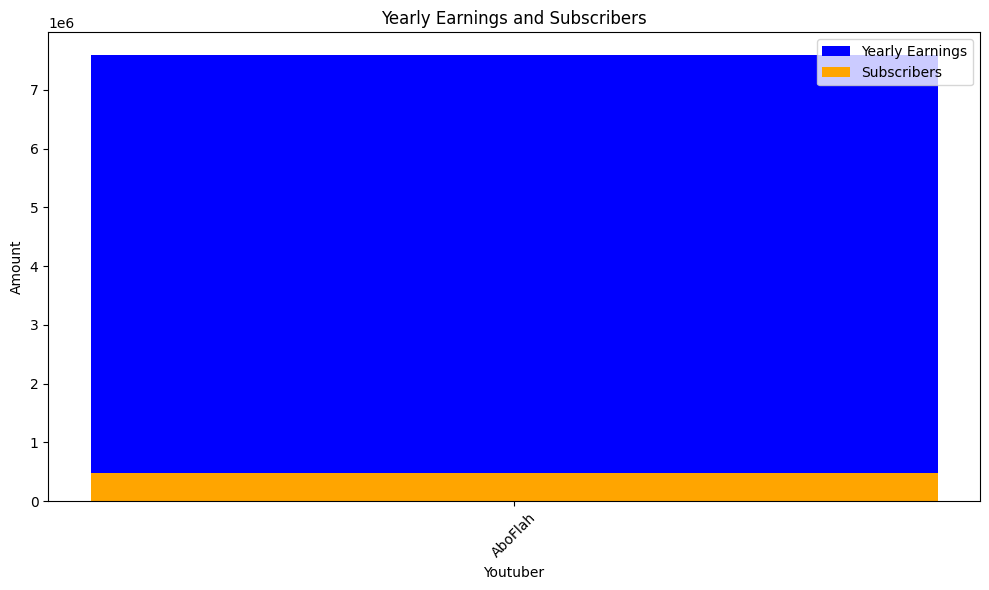

 63%|██████▎   | 1371/2160 [13:07<05:58,  2.20it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


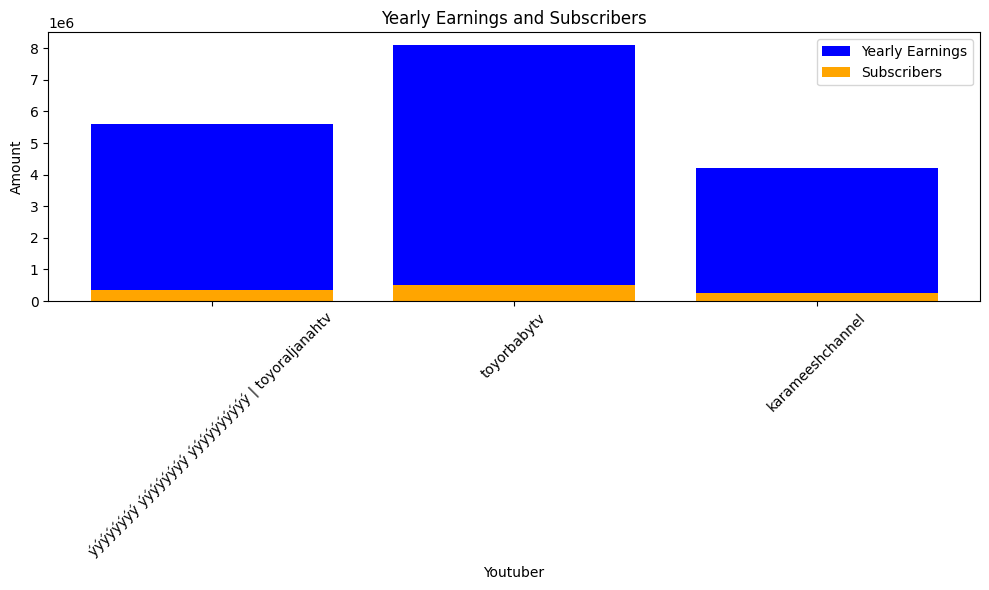

 64%|██████▎   | 1374/2160 [13:09<05:49,  2.25it/s]check
highest_yearly_earnings: 1900000.0, Subscribers: 117600.0, Youtuber: PewDiePie
highest_yearly_earnings: 34600000.0, Subscribers: 2200000.0, Youtuber: Junya.ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 34100000.0, Subscribers: 2100000.0, Youtuber: Sagawa /ï¿½ï¿½ï¿½
highest_yearly_earnings: 13600000.0, Subscribers: 847100.0, Youtuber: ISSEI / ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 119.0, Subscribers: 7.0, Youtuber: Bayashi TV


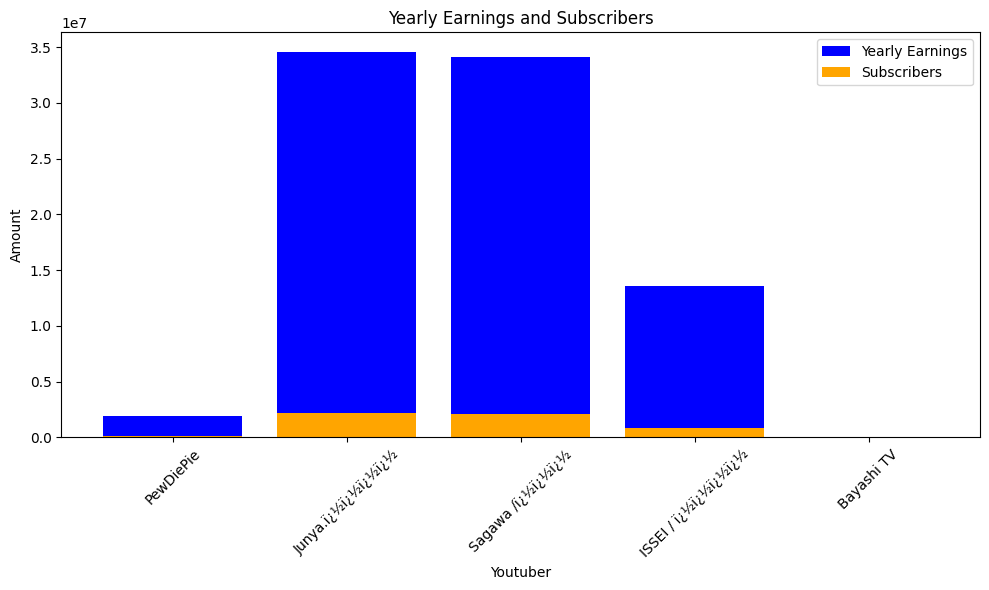

 64%|██████▍   | 1377/2160 [13:10<05:38,  2.31it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


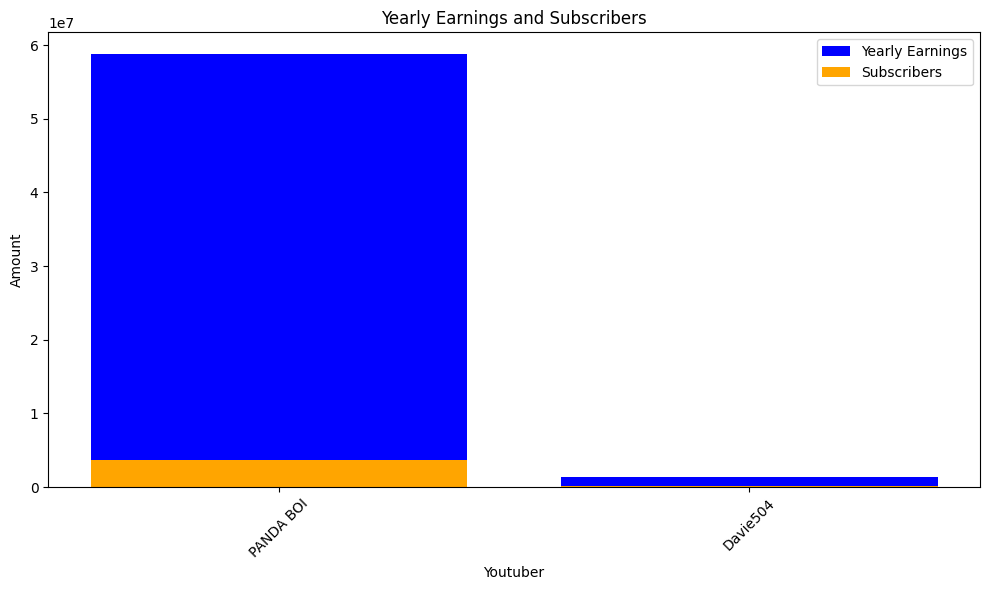

 64%|██████▍   | 1380/2160 [13:12<05:26,  2.39it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


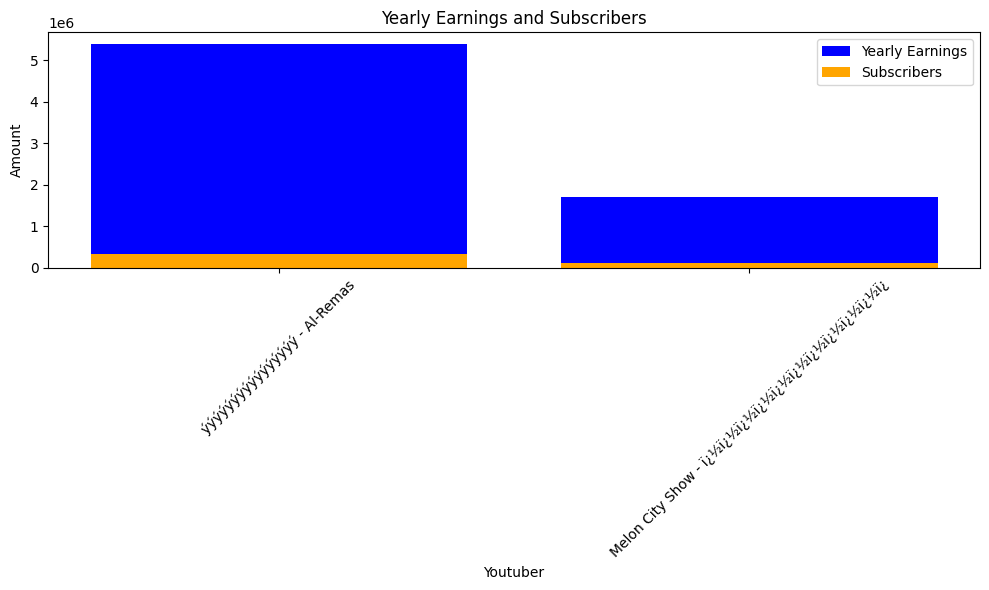

 64%|██████▍   | 1383/2160 [13:13<05:27,  2.37it/s]check
highest_yearly_earnings: 26300000.0, Subscribers: 1600000.0, Youtuber: Jess No Limit
highest_yearly_earnings: 7500000.0, Subscribers: 471300.0, Youtuber: Ricis Official
highest_yearly_earnings: 1000000.0, Subscribers: 64300.0, Youtuber: AH
highest_yearly_earnings: 11000000.0, Subscribers: 690500.0, Youtuber: Indosiar
highest_yearly_earnings: 2800000.0, Subscribers: 175500.0, Youtuber: Rans Entertainment
highest_yearly_earnings: 5900000.0, Subscribers: 369600.0, Youtuber: TRANS7 OFFICIAL
highest_yearly_earnings: 1300000.0, Subscribers: 80900.0, Youtuber: Baim Paula
highest_yearly_earnings: 4.0, Subscribers: 0.26, Youtuber: Deddy Corbuzier
highest_yearly_earnings: 5400000.0, Subscribers: 338300.0, Youtuber: BabyBus - Cerita & Lagu Anak-anak
highest_yearly_earnings: 3100000.0, Subscribers: 193500.0, Youtuber: MiawAug
highest_yearly_earnings: 9500000.0, Subscribers: 592100.0, Youtuber: Willie Salim
highest_yearly_earnings: 819000.0, 

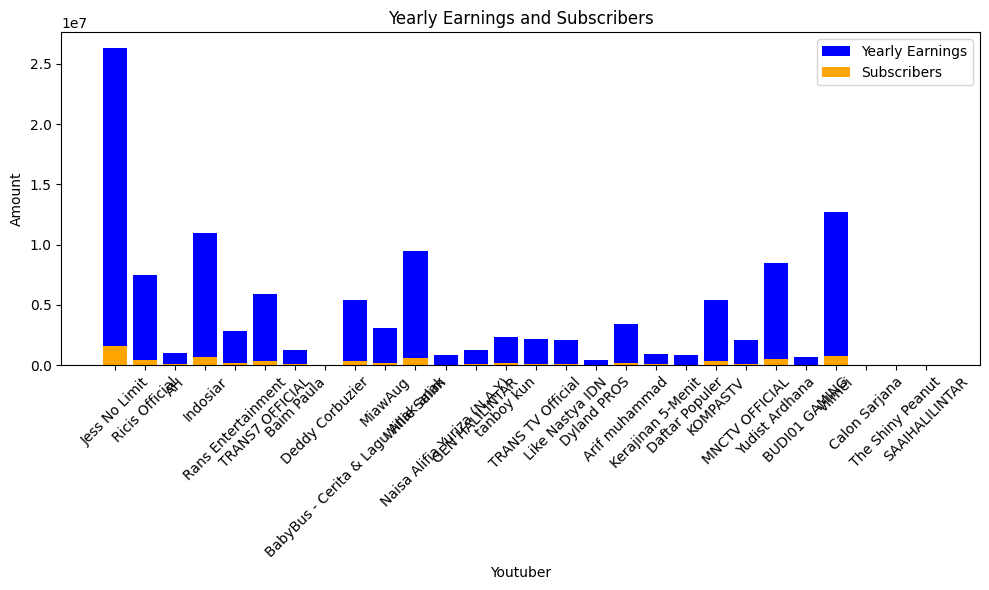

 64%|██████▍   | 1386/2160 [13:15<06:49,  1.89it/s]check
highest_yearly_earnings: 8600000.0, Subscribers: 539700.0, Youtuber: Jingle Toons
highest_yearly_earnings: 10900000.0, Subscribers: 682100.0, Youtuber: Aditya Movies
highest_yearly_earnings: 8900000.0, Subscribers: 554900.0, Youtuber: Shemaroo Movies
highest_yearly_earnings: 4800000.0, Subscribers: 299000.0, Youtuber: Goldmines Bollywood
highest_yearly_earnings: 4600000.0, Subscribers: 284600.0, Youtuber: Pen Movies
highest_yearly_earnings: 17600000.0, Subscribers: 1100000.0, Youtuber: Tilak
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Ultra Movie Parlour
highest_yearly_earnings: 2300000.0, Subscribers: 146200.0, Youtuber: Goldmines Cineplex
highest_yearly_earnings: 3100000.0, Subscribers: 196100.0, Youtuber: Pokï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 6700000.0, Subscribers: 417300.0, Youtuber: Noman Official
highest_yearly_earnings: 1800000.0, Subscribers: 112900.0, Youtuber: Goldmines Premiere
highest_

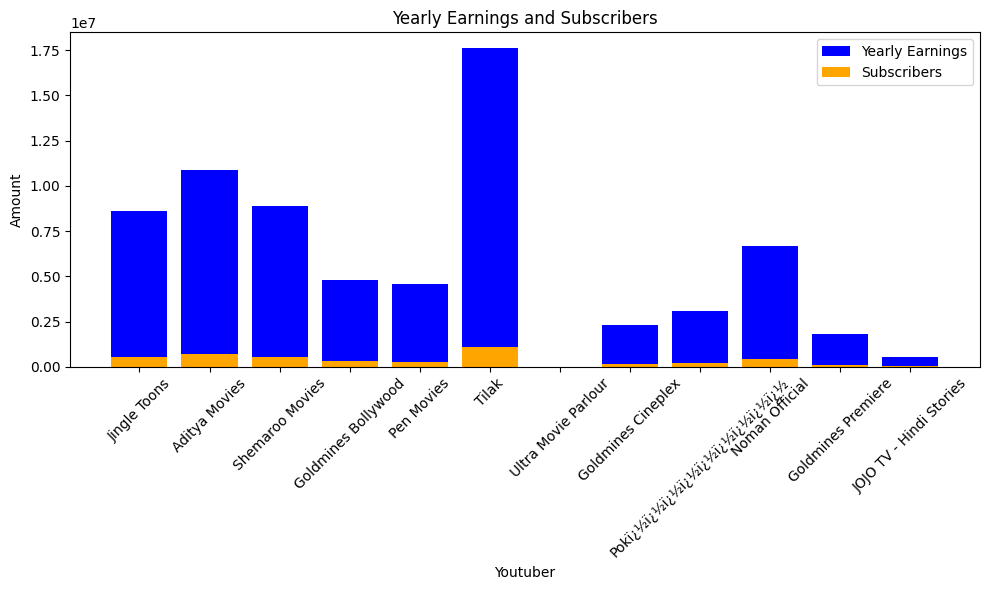

 64%|██████▍   | 1389/2160 [13:17<07:04,  1.81it/s]check
highest_yearly_earnings: 36300000.0, Subscribers: 2300000.0, Youtuber: Tsuriki Show
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: YOLO
highest_yearly_earnings: 1400000.0, Subscribers: 87800.0, Youtuber: Kurzgesagt ï¿½ï¿½ï¿½ï¿½ï¿½ï¿
highest_yearly_earnings: 271200.0, Subscribers: 17000.0, Youtuber: HaerteTest
highest_yearly_earnings: 29600000.0, Subscribers: 1900000.0, Youtuber: Younes Zarou
highest_yearly_earnings: 1800.0, Subscribers: 114.0, Youtuber: Beast Philanthropy


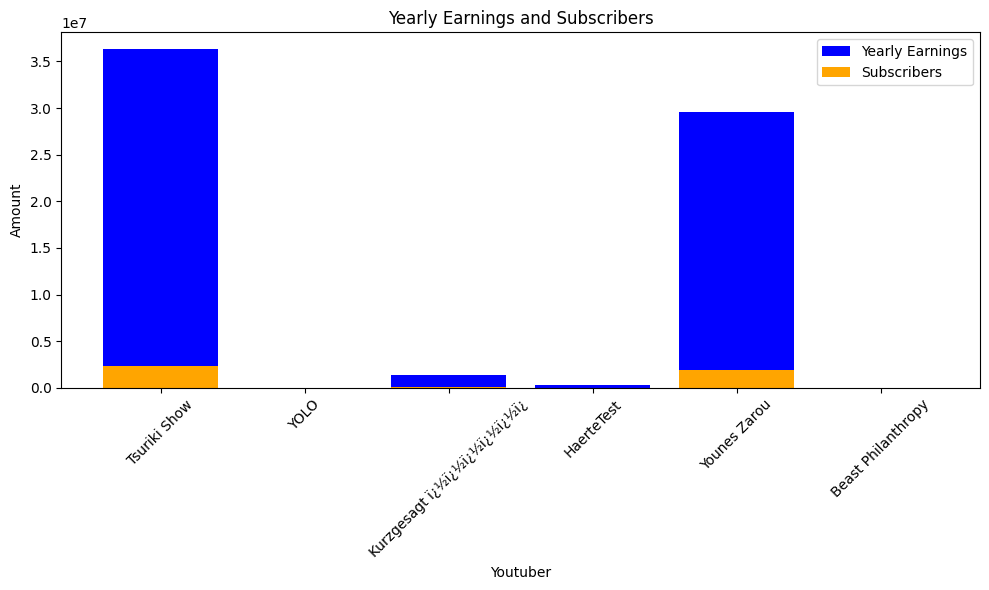

 64%|██████▍   | 1392/2160 [13:19<07:09,  1.79it/s]check
highest_yearly_earnings: 35.0, Subscribers: 2.0, Youtuber: Smile Family
highest_yearly_earnings: 2300000.0, Subscribers: 144300.0, Youtuber: SQUEEZIE
highest_yearly_earnings: 37.0, Subscribers: 2.0, Youtuber: FitDance
highest_yearly_earnings: 548000.0, Subscribers: 34300.0, Youtuber: Cyprien
highest_yearly_earnings: 1500000.0, Subscribers: 91400.0, Youtuber: Lofi Girl


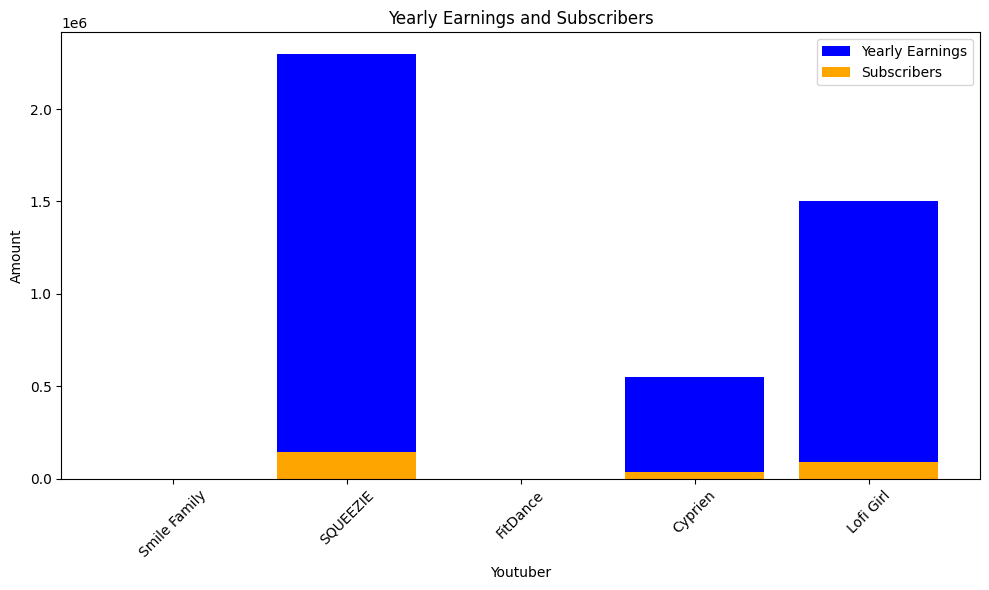

 65%|██████▍   | 1395/2160 [13:21<06:48,  1.87it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


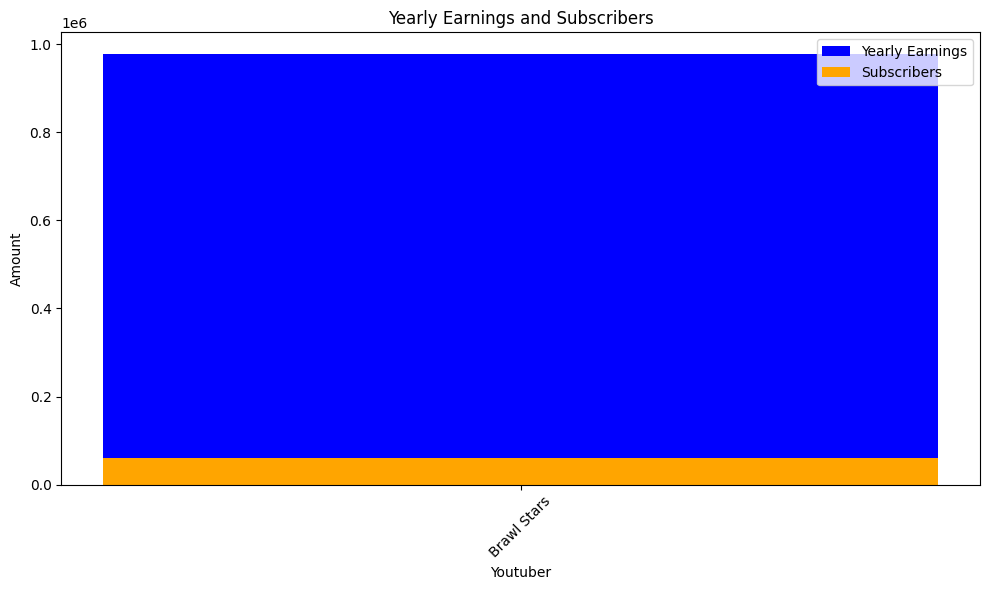

 65%|██████▍   | 1398/2160 [13:23<05:44,  2.21it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


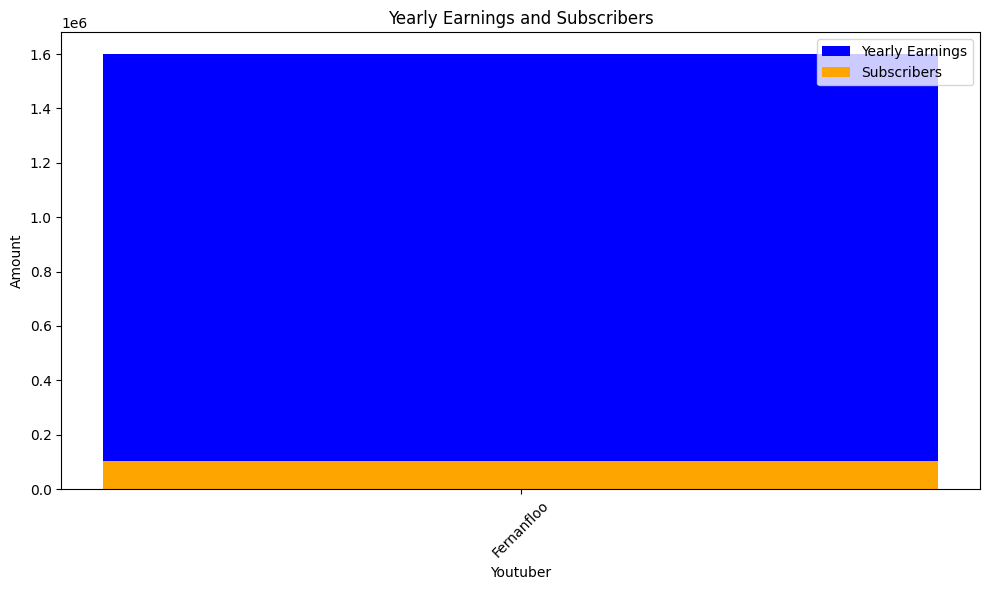

 65%|██████▍   | 1401/2160 [13:24<05:26,  2.32it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


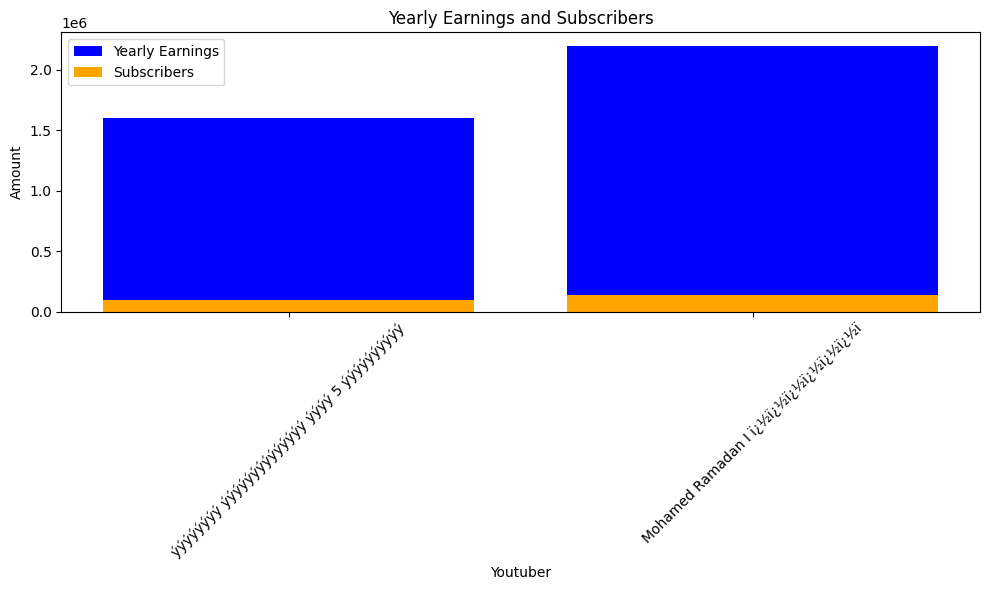

 65%|██████▌   | 1404/2160 [13:26<05:19,  2.37it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


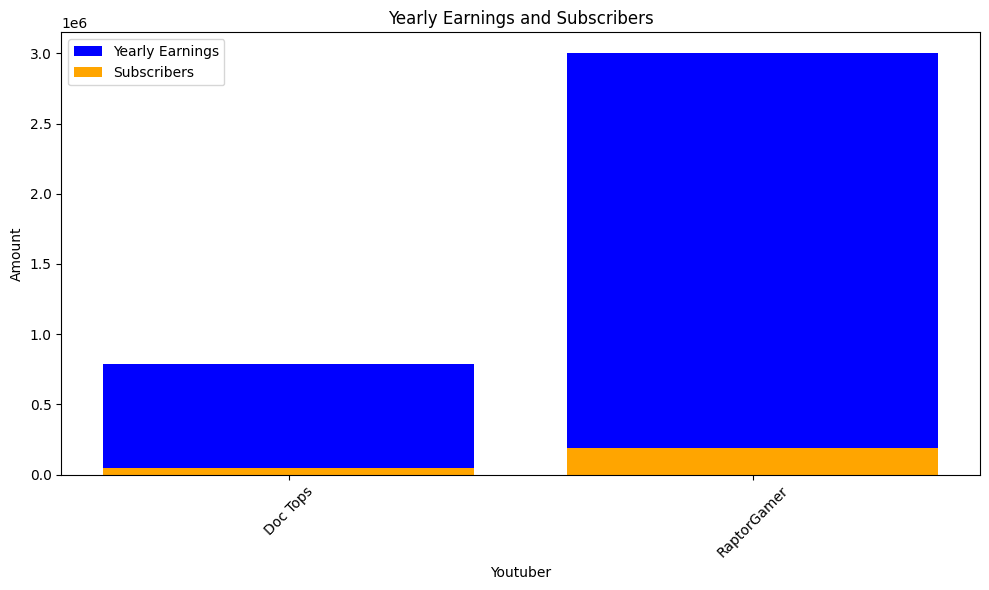

 65%|██████▌   | 1407/2160 [13:27<05:16,  2.38it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


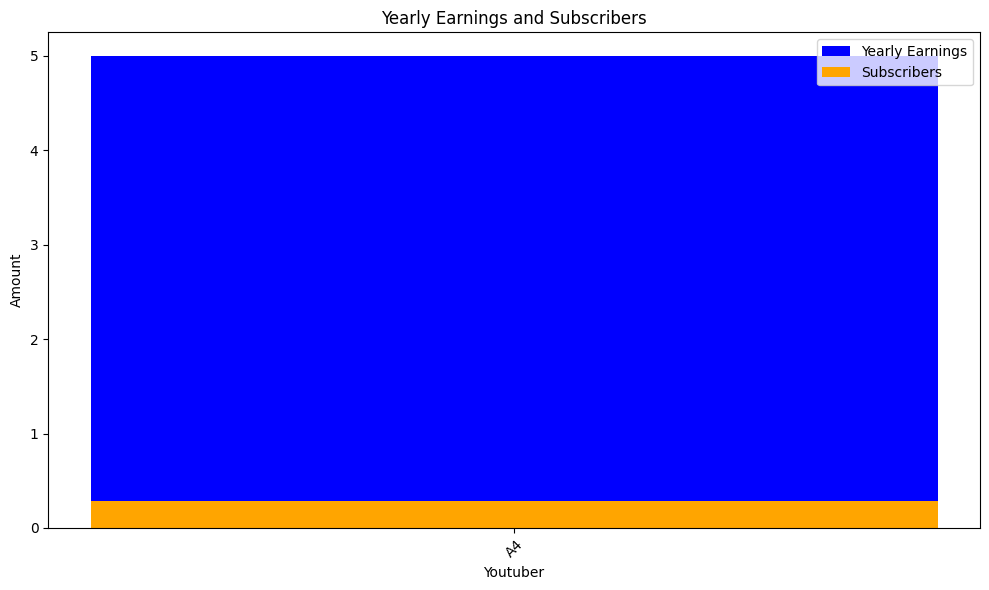

 65%|██████▌   | 1410/2160 [13:30<07:01,  1.78it/s]check
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Shakira
highest_yearly_earnings: 6200000.0, Subscribers: 386100.0, Youtuber: J Balvin
highest_yearly_earnings: 22400000.0, Subscribers: 1400000.0, Youtuber: KAROL G
highest_yearly_earnings: 8300000.0, Subscribers: 521500.0, Youtuber: toycantando
highest_yearly_earnings: 1200000.0, Subscribers: 73100.0, Youtuber: enchufetv
highest_yearly_earnings: 13600000.0, Subscribers: 852400.0, Youtuber: Anuel AA
highest_yearly_earnings: 12700000.0, Subscribers: 791600.0, Youtuber: Ami Rodriguez
highest_yearly_earnings: 2900000.0, Subscribers: 179700.0, Youtuber: Camilo
highest_yearly_earnings: 11000000.0, Subscribers: 686700.0, Youtuber: Codiscos
highest_yearly_earnings: 4100000.0, Subscribers: 258800.0, Youtuber: jbalvinVEVO
highest_yearly_earnings: 15700000.0, Subscribers: 982800.0, Youtuber: Go Ami Go!


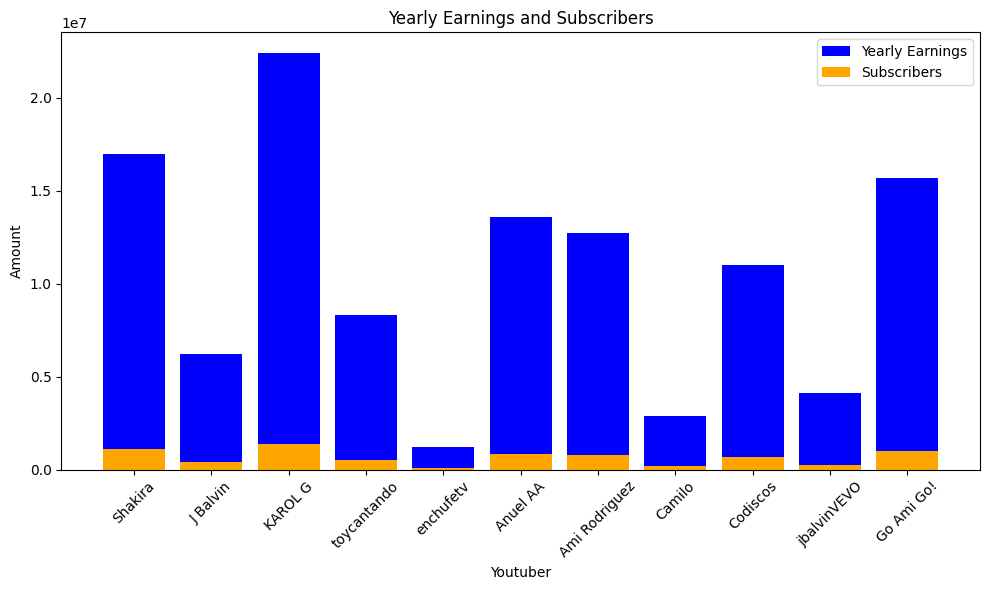

 65%|██████▌   | 1413/2160 [13:32<06:14,  1.99it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


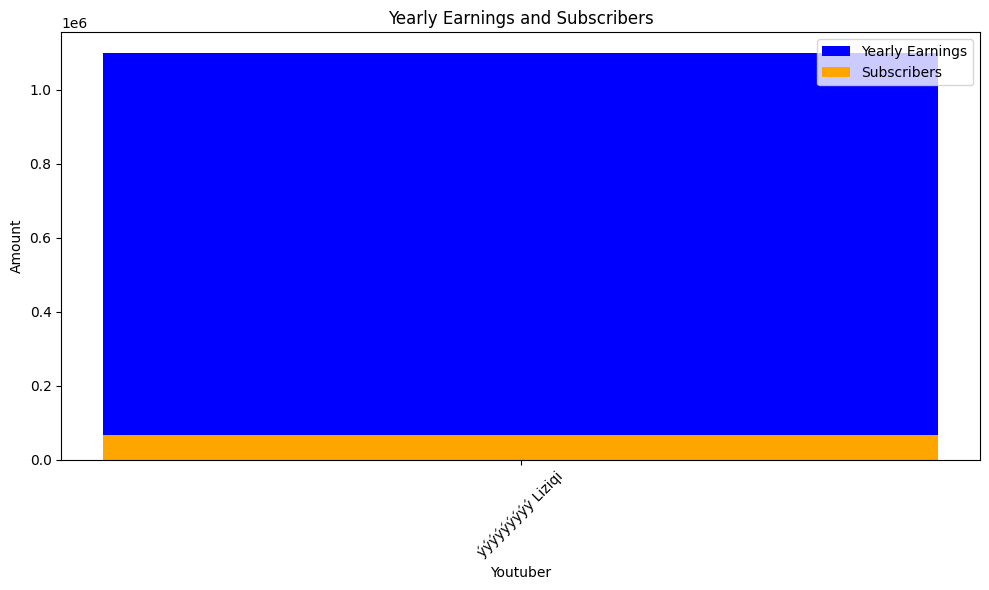

 66%|██████▌   | 1416/2160 [13:33<05:48,  2.14it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 199200.0, Youtuber: JuegaGerman
highest_yearly_earnings: 2.0, Subscribers: 0.15, Youtuber: invictor
highest_yearly_earnings: 4800000.0, Subscribers: 300600.0, Youtuber: DeGoBooM


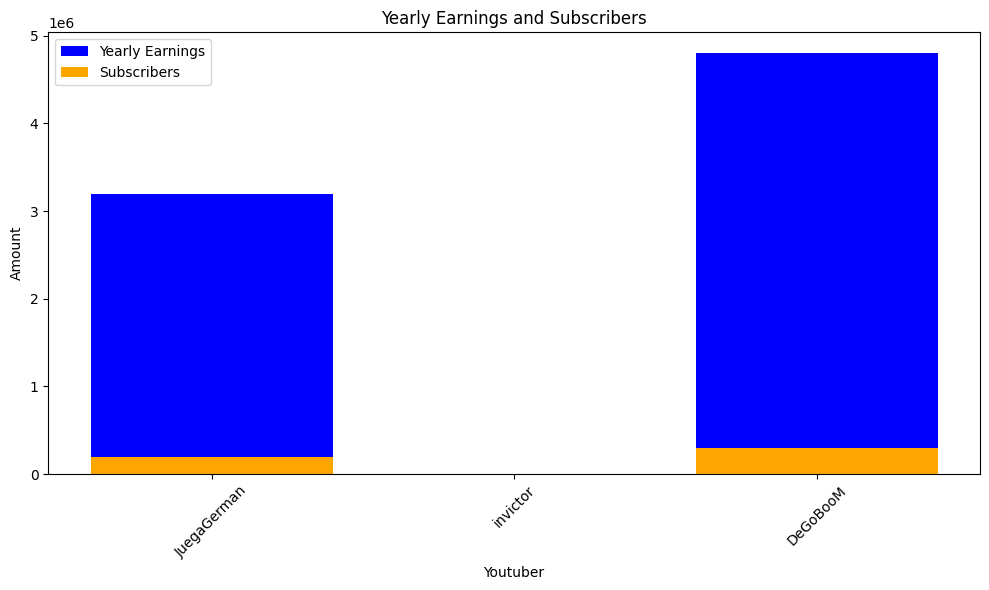

 66%|██████▌   | 1419/2160 [13:35<06:00,  2.05it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529000.0, Youtuber: Justin Bieber
highest_yearly_earnings: 26900000.0, Subscribers: 1700000.0, Youtuber: Super Simple Songs - Kids Songs
highest_yearly_earnings: 17900000.0, Subscribers: 1100000.0, Youtuber: The Weeknd
highest_yearly_earnings: 4300000.0, Subscribers: 266200.0, Youtuber: Shawn Mendes
highest_yearly_earnings: 2600000.0, Subscribers: 164800.0, Youtuber: VanossGaming
highest_yearly_earnings: 2400000.0, Subscribers: 147000.0, Youtuber: WatchMojo.com
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: FaZe Rug
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Pentatonix
highest_yearly_earnings: 4200000.0, Subscribers: 264700.0, Youtuber: Linus Tech Tips
highest_yearly_earnings: 255800.0, Subscribers: 16000.0, Youtuber: Lilly Singh
highest_yearly_earnings: 4000000.0, Subscribers: 251800.0, Youtuber: Hacksmith Industries
highest_yearly_earnings: 1600000.0, Su

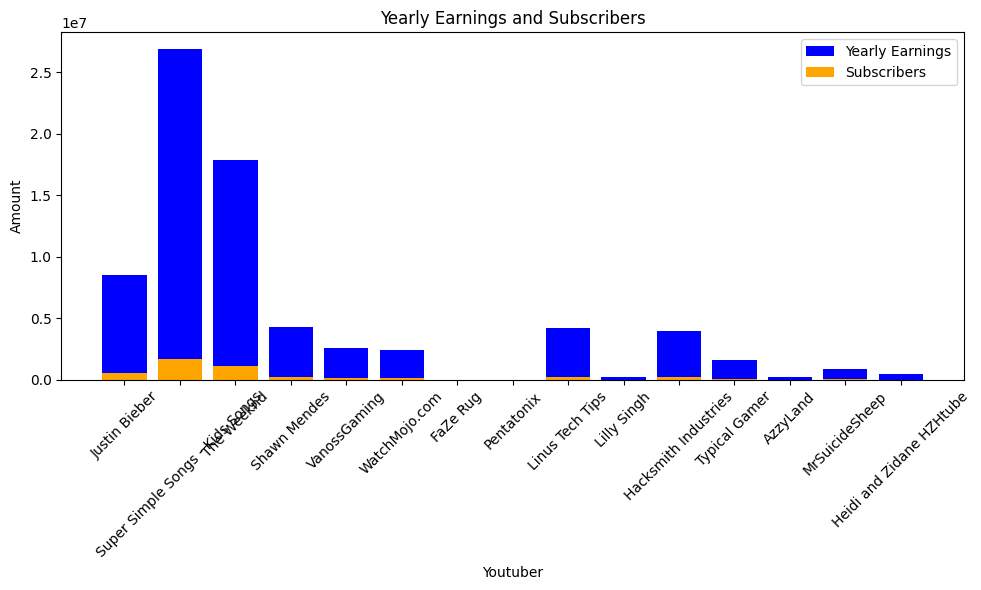

 66%|██████▌   | 1422/2160 [13:37<06:32,  1.88it/s]check
highest_yearly_earnings: 19400000.0, Subscribers: 1200000.0, Youtuber: Galinha Pintadinha
highest_yearly_earnings: 1900000.0, Subscribers: 118500.0, Youtuber: Totoy kids - Portuguï¿½
highest_yearly_earnings: 3700000.0, Subscribers: 230700.0, Youtuber: Turma da Mï¿½ï¿½
highest_yearly_earnings: 1300000.0, Subscribers: 82000.0, Youtuber: Peppa Pig em Portuguï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


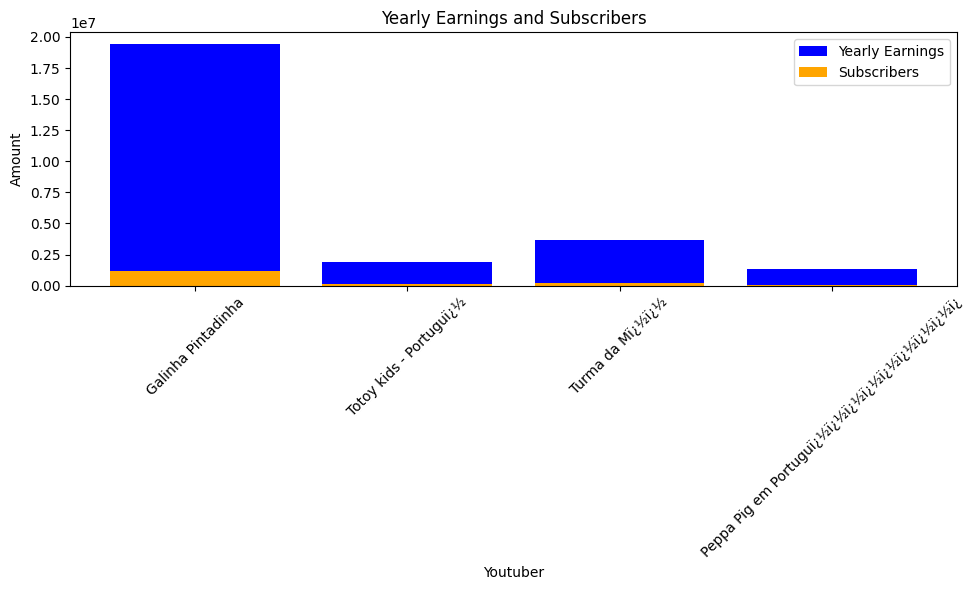

 66%|██████▌   | 1425/2160 [13:39<06:19,  1.93it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


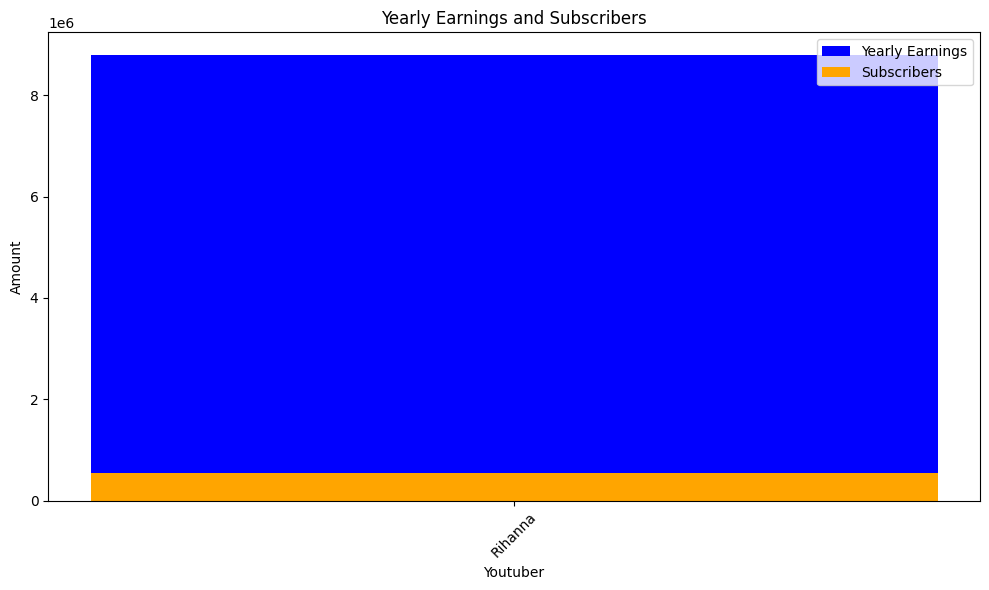

 66%|██████▌   | 1428/2160 [13:40<05:27,  2.24it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


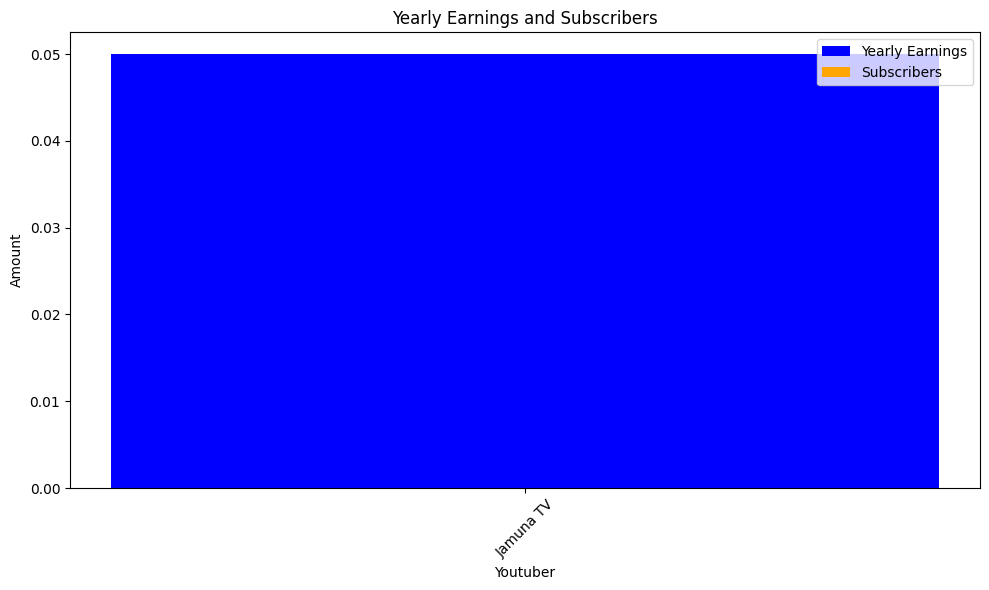

 66%|██████▋   | 1431/2160 [13:42<05:09,  2.35it/s]check
highest_yearly_earnings: 6100000.0, Subscribers: 382300.0, Youtuber: Bounce Patrol - Kids Songs
highest_yearly_earnings: 1100000.0, Subscribers: 69800.0, Youtuber: Chloe Ting
highest_yearly_earnings: 1300000.0, Subscribers: 78200.0, Youtuber: LazarBeam
highest_yearly_earnings: 18800000.0, Subscribers: 1200000.0, Youtuber: How Ridiculous
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: The Game Theorists
highest_yearly_earnings: 745200.0, Subscribers: 46600.0, Youtuber: HowToBasic
highest_yearly_earnings: 1.0, Subscribers: 0.08, Youtuber: Jason Vlogs
highest_yearly_earnings: 1000000.0, Subscribers: 63200.0, Youtuber: Lachlan
highest_yearly_earnings: 7.0, Subscribers: 0.44, Youtuber: Trap City


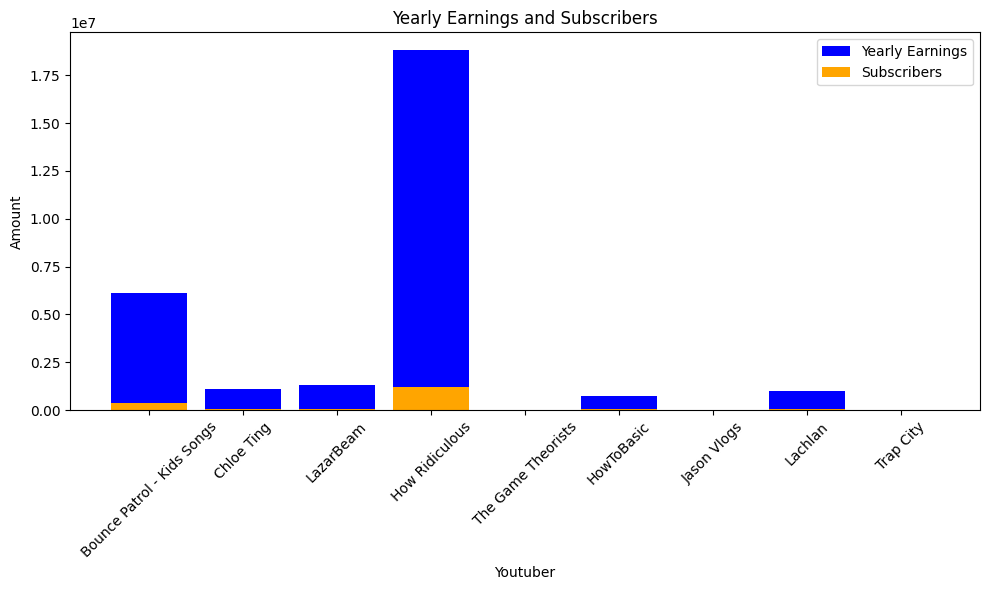

 66%|██████▋   | 1434/2160 [13:44<05:27,  2.22it/s]check
highest_yearly_earnings: 29400000.0, Subscribers: 1800000.0, Youtuber: El Reino Infantil
highest_yearly_earnings: 14500000.0, Subscribers: 906200.0, Youtuber: La Granja de Zenï¿½
highest_yearly_earnings: 9200000.0, Subscribers: 572000.0, Youtuber: TheDonato
highest_yearly_earnings: 0.72, Subscribers: 0.05, Youtuber: Maluma
highest_yearly_earnings: 19300000.0, Subscribers: 1200000.0, Youtuber: Alejo Igoa
highest_yearly_earnings: 1700000.0, Subscribers: 106600.0, Youtuber: DrossRotzank
highest_yearly_earnings: 3500000.0, Subscribers: 216700.0, Youtuber: Paulo Londra
highest_yearly_earnings: 9300000.0, Subscribers: 579500.0, Youtuber: Bizarrap
highest_yearly_earnings: 1300000.0, Subscribers: 82600.0, Youtuber: RobleisIUTU
highest_yearly_earnings: 30700000.0, Subscribers: 1900000.0, Youtuber: El Payaso Plim Plim
highest_yearly_earnings: 4000000.0, Subscribers: 251100.0, Youtuber: El Reino a Jugar
highest_yearly_earnings: 3100000.0, S

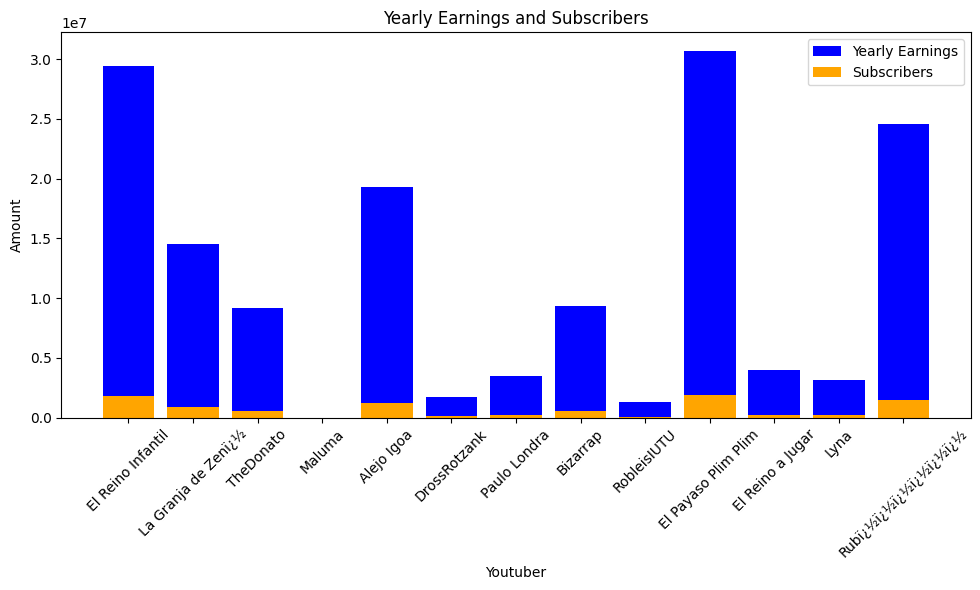

 67%|██████▋   | 1437/2160 [13:45<05:48,  2.07it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


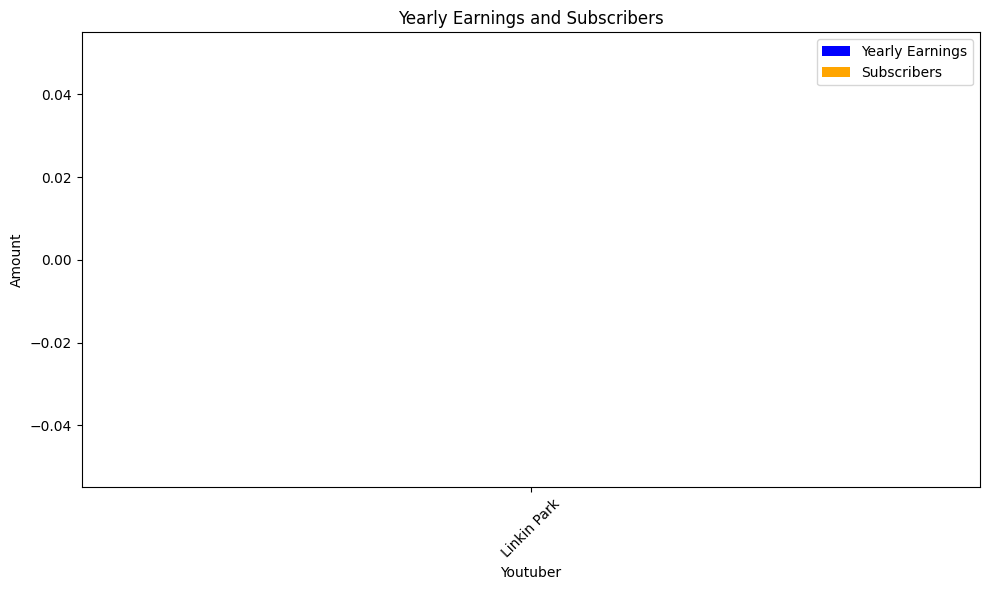

 67%|██████▋   | 1440/2160 [13:47<05:22,  2.23it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


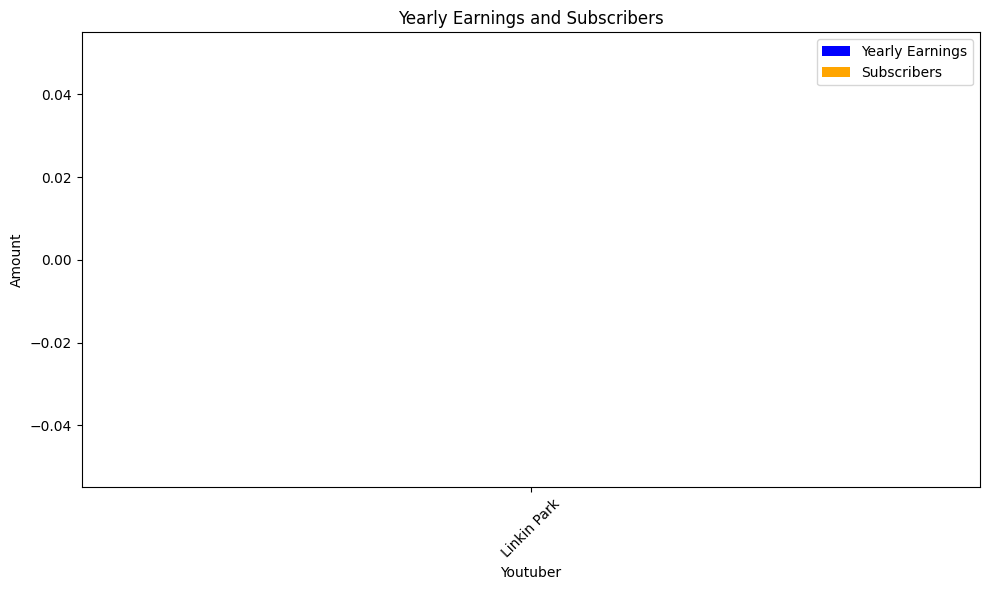

check
highest_yearly_earnings: 4100000.0, Subscribers: 253400.0, Youtuber: Like Nastya VNM


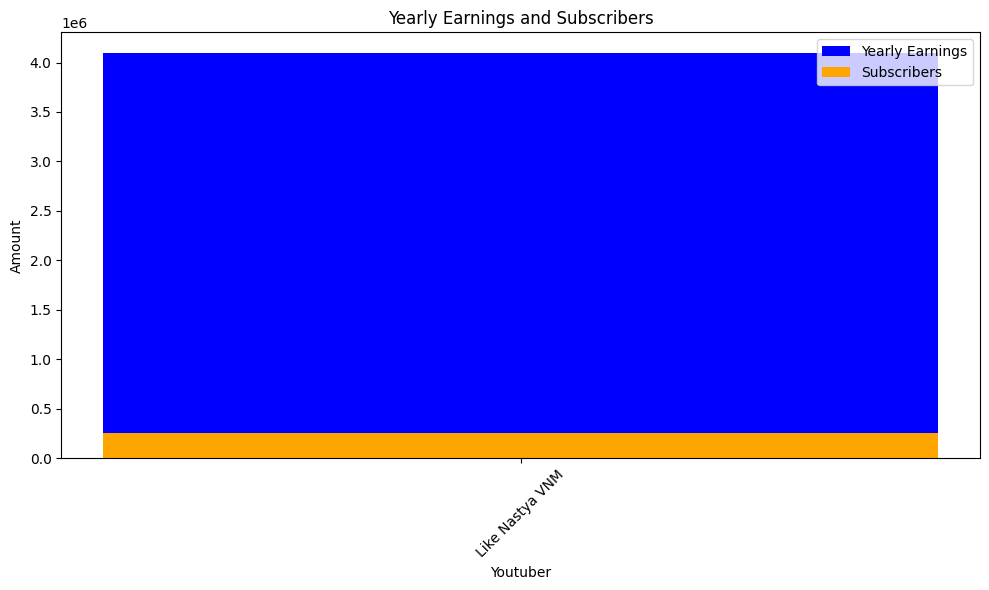

 67%|██████▋   | 1443/2160 [13:49<06:10,  1.94it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


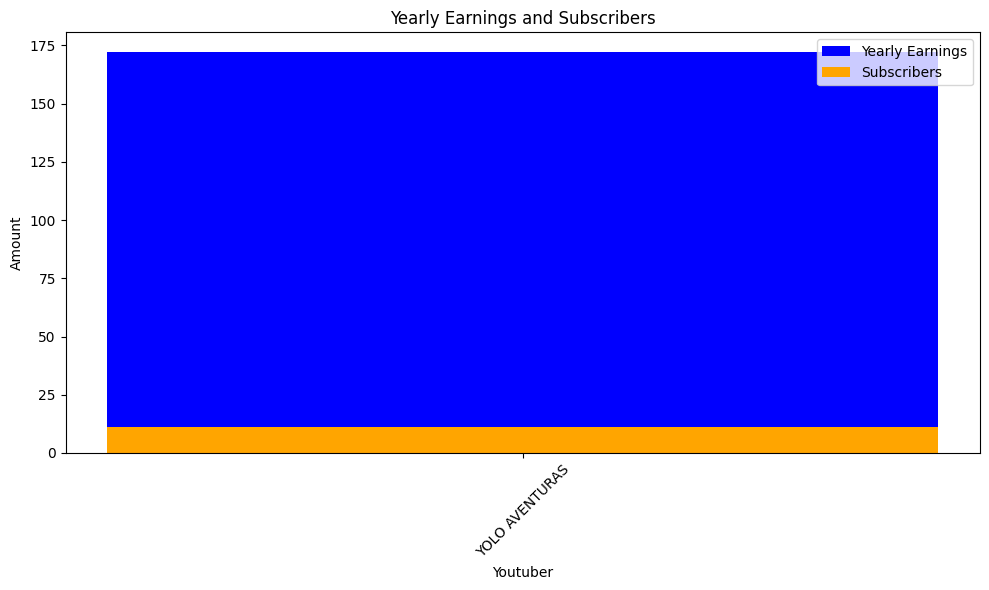

 67%|██████▋   | 1446/2160 [13:51<05:45,  2.07it/s]check
highest_yearly_earnings: 64700000.0, Subscribers: 4000000.0, Youtuber: MrBeast
highest_yearly_earnings: 35100000.0, Subscribers: 2200000.0, Youtuber: ýýý Kids Diana Show
highest_yearly_earnings: 27900000.0, Subscribers: 1700000.0, Youtuber: Vlad and Niki
highest_yearly_earnings: 0.77, Subscribers: 0.05, Youtuber: Sports
highest_yearly_earnings: 2600000.0, Subscribers: 159600.0, Youtuber: Like Nastya Show
highest_yearly_earnings: 1000000.0, Subscribers: 65400.0, Youtuber: TheEllenShow
highest_yearly_earnings: 11700000.0, Subscribers: 732300.0, Youtuber: Vlad vï¿½ï¿½ï
highest_yearly_earnings: 15400000.0, Subscribers: 963100.0, Youtuber: Like Nastya ESP
highest_yearly_earnings: 1000000.0, Subscribers: 63300.0, Youtuber: YouTube
highest_yearly_earnings: 11500000.0, Subscribers: 715800.0, Youtuber: Ryan's World
highest_yearly_earnings: 10100000.0, Subscribers: 632900.0, Youtuber: SSSniperWolf
highest_yearly_earnings: 7400000.0, Subscr

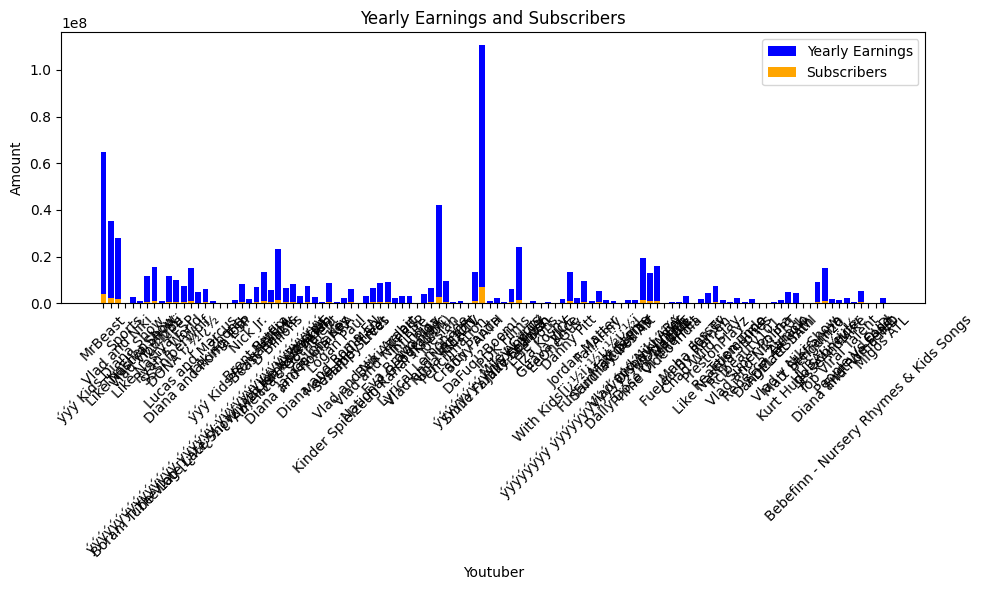

 67%|██████▋   | 1449/2160 [13:55<09:24,  1.26it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: 5-Minute Crafts
highest_yearly_earnings: 15900000.0, Subscribers: 995700.0, Youtuber: Dan Rhodes
highest_yearly_earnings: 1600000.0, Subscribers: 98400.0, Youtuber: Mister Max
highest_yearly_earnings: 2900000.0, Subscribers: 178900.0, Youtuber: Miss Katy
highest_yearly_earnings: 4100000.0, Subscribers: 259400.0, Youtuber: Got Talent Global
highest_yearly_earnings: 1900000.0, Subscribers: 117700.0, Youtuber: Gordon Ramsay
highest_yearly_earnings: 2600000.0, Subscribers: 162600.0, Youtuber: Britain's Got Talent
highest_yearly_earnings: 3800000.0, Subscribers: 234500.0, Youtuber: Sidemen
highest_yearly_earnings: 4100000.0, Subscribers: 257300.0, Youtuber: SAM SMITH
highest_yearly_earnings: 147800.0, Subscribers: 9200.0, Youtuber: W2S
highest_yearly_earnings: 1300000.0, Subscribers: 83400.0, Youtuber: JJ Olatunji
highest_yearly_earnings: 2100000.0, Subscribers: 133200.0, Yout

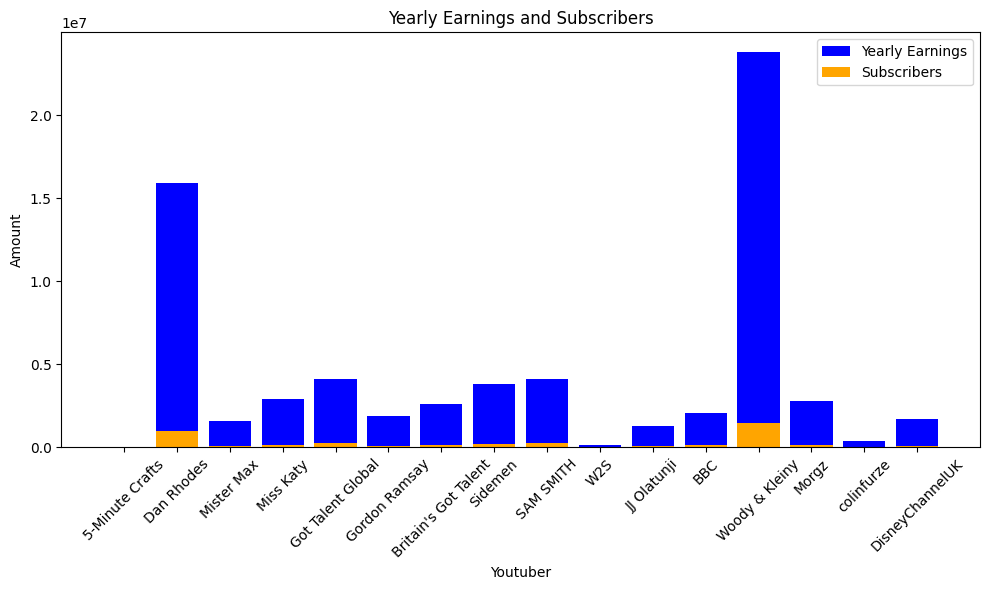

 67%|██████▋   | 1452/2160 [13:57<07:50,  1.51it/s]check
highest_yearly_earnings: 746700.0, Subscribers: 46700.0, Youtuber: Noor Stars
highest_yearly_earnings: 3800000.0, Subscribers: 240500.0, Youtuber: FFUNTV


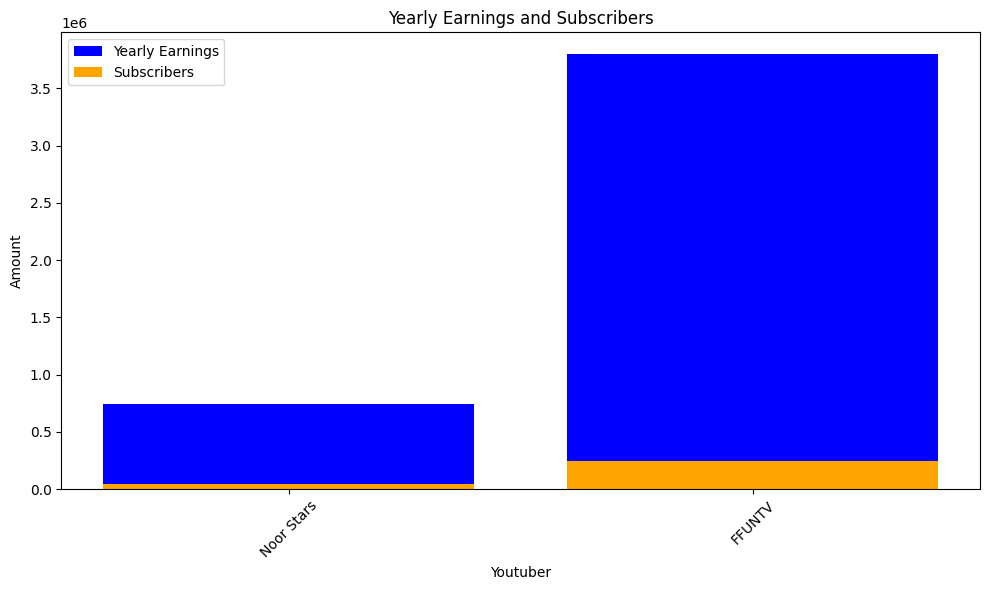

 67%|██████▋   | 1455/2160 [13:58<06:06,  1.92it/s]check
highest_yearly_earnings: 1400000.0, Subscribers: 87000.0, Youtuber: SlivkiShow
highest_yearly_earnings: 3300000.0, Subscribers: 204000.0, Youtuber: ýýýýýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 5.0, Subscribers: 0.32, Youtuber: SIS vs BRO
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: VexTrex
highest_yearly_earnings: 3400000.0, Subscribers: 213400.0, Youtuber: ýýýýýýýý ýýýý ýýýýýýýýýýýýýý


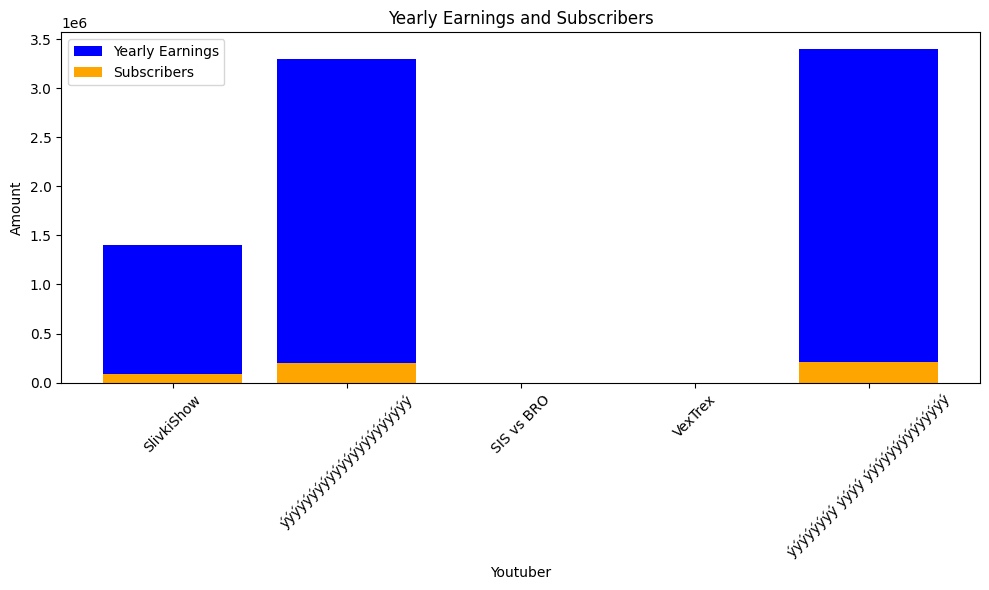

 68%|██████▊   | 1458/2160 [14:00<05:29,  2.13it/s]check
highest_yearly_earnings: 5300000.0, Subscribers: 332400.0, Youtuber: tabii Urdu
highest_yearly_earnings: 212500.0, Subscribers: 13300.0, Youtuber: Oyuncak Avï¿


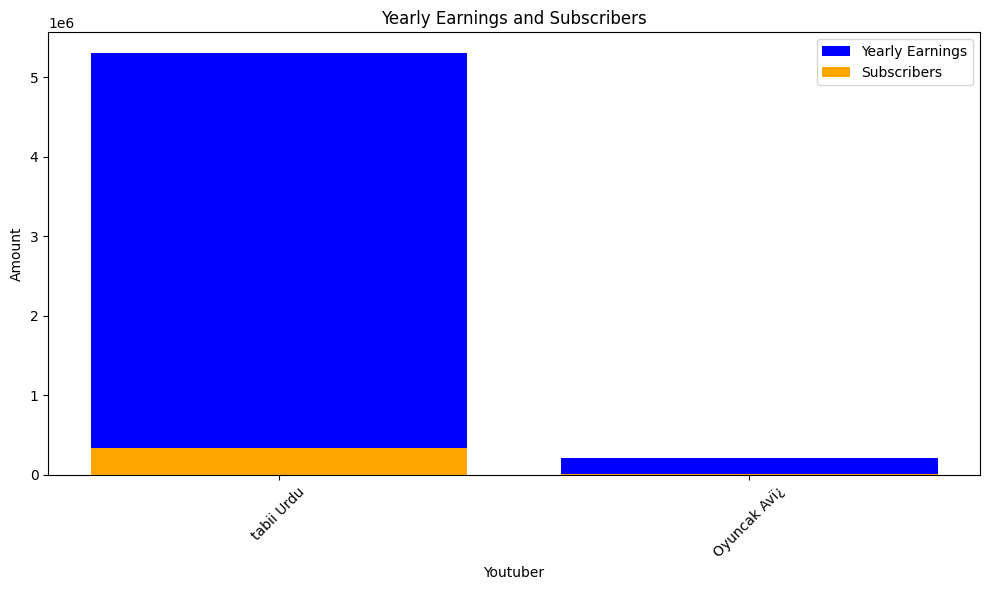

 68%|██████▊   | 1461/2160 [14:01<05:07,  2.28it/s]check
highest_yearly_earnings: 6300000.0, Subscribers: 391400.0, Youtuber: WorkpointOfficial
highest_yearly_earnings: 6800000.0, Subscribers: 422300.0, Youtuber: ýýýýýýýýýýýý one31
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Ch3Thailand
highest_yearly_earnings: 448400.0, Subscribers: 28000.0, Youtuber: Kaykai Salaider
highest_yearly_earnings: 4200000.0, Subscribers: 263300.0, Youtuber: Ch7HD
highest_yearly_earnings: 8700000.0, Subscribers: 544100.0, Youtuber: GMMTV OFFICIALï¿½ï¿½
highest_yearly_earnings: 2400000.0, Subscribers: 148700.0, Youtuber: ýýýýýýýýýýýý8 : Thai Ch8
highest_yearly_earnings: 2200000.0, Subscribers: 136900.0, Youtuber: GMM25Thailand
highest_yearly_earnings: 600100.0, Subscribers: 37500.0, Youtuber: Bie The Ska
highest_yearly_earnings: 2000000.0, Subscribers: 125000.0, Youtuber: My Mate Nate


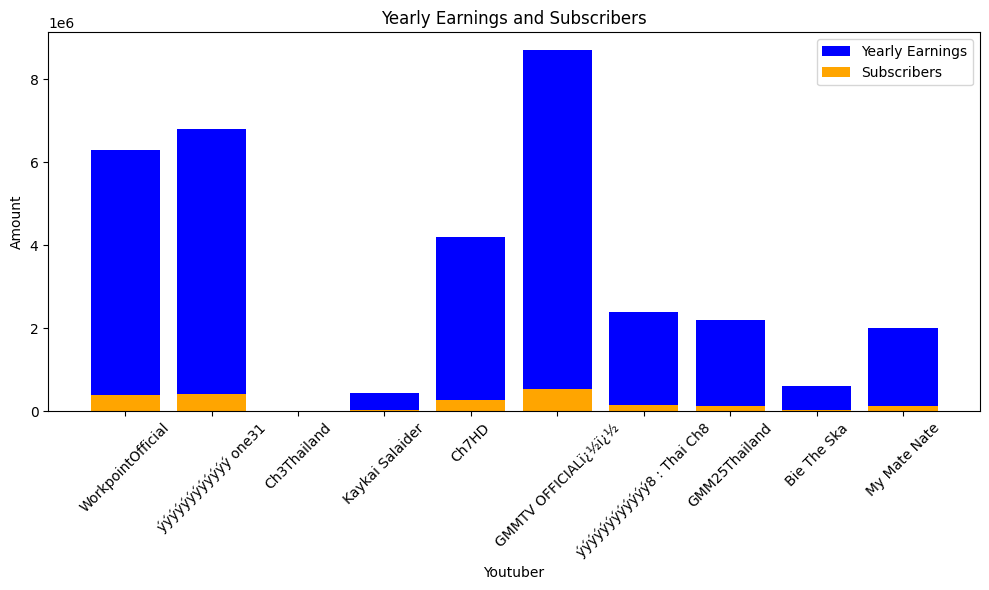

 68%|██████▊   | 1464/2160 [14:03<05:03,  2.29it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


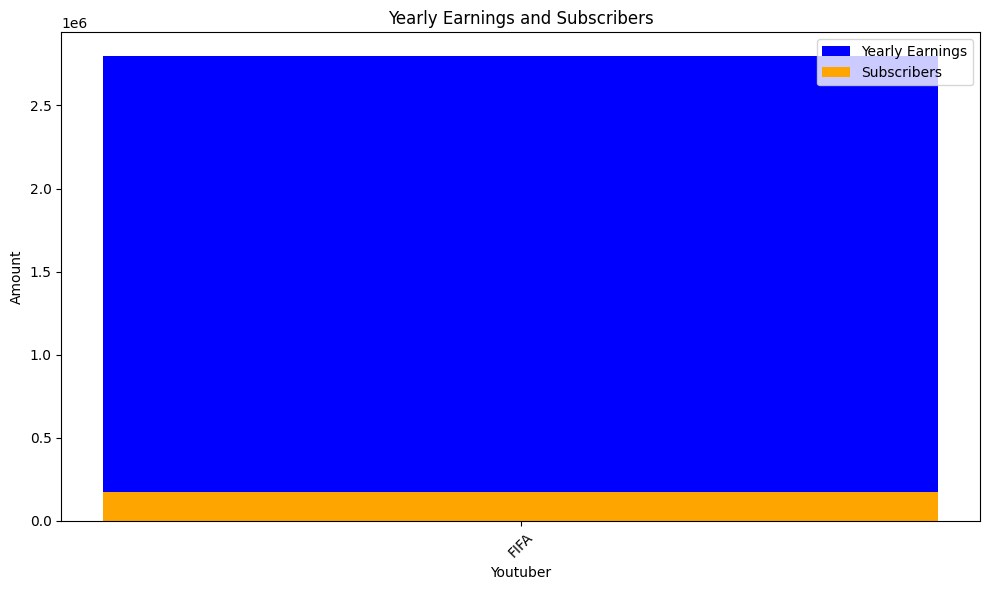

 68%|██████▊   | 1467/2160 [14:05<04:51,  2.38it/s]check
highest_yearly_earnings: 658000.0, Subscribers: 41100.0, Youtuber: Narins Beauty


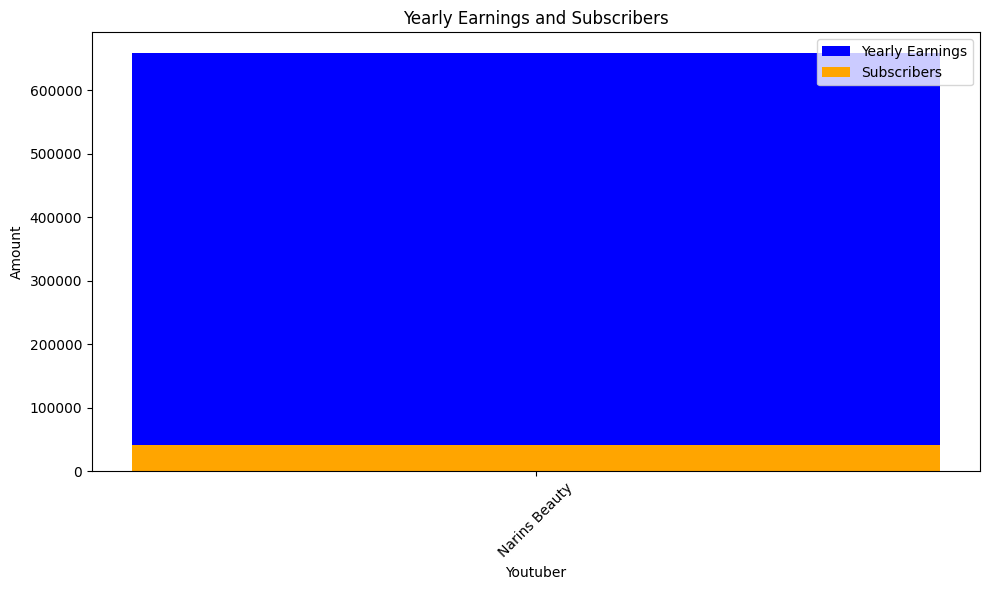

 68%|██████▊   | 1470/2160 [14:06<04:41,  2.45it/s]check
highest_yearly_earnings: 286600.0, Subscribers: 17900.0, Youtuber: Makiman131
highest_yearly_earnings: 10900.0, Subscribers: 679.0, Youtuber: Canal Nostalgia


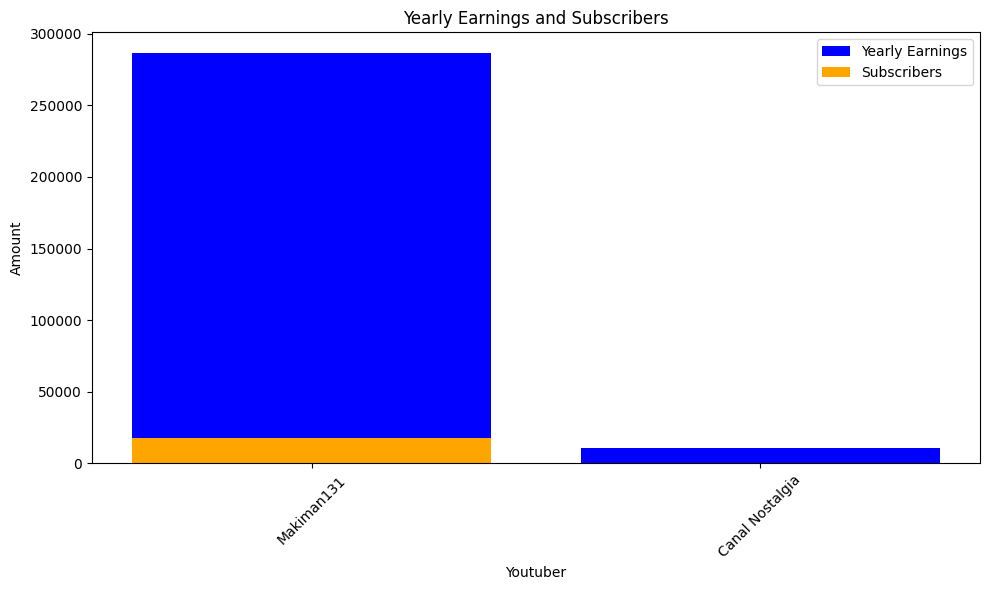

 68%|██████▊   | 1473/2160 [14:08<05:03,  2.27it/s]check
highest_yearly_earnings: 5100000.0, Subscribers: 316700.0, Youtuber: 1theK (ï¿½ï¿½ï¿½ï¿½ï
highest_yearly_earnings: 7600000.0, Subscribers: 475600.0, Youtuber: Mnet K-POP
highest_yearly_earnings: 5200000.0, Subscribers: 324000.0, Youtuber: KBS WORLD TV
highest_yearly_earnings: 65700.0, Subscribers: 4100.0, Youtuber: ýýýýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 192100.0, Subscribers: 12000.0, Youtuber: BIBOï¿½ï¿½ï¿½ï¿½ï


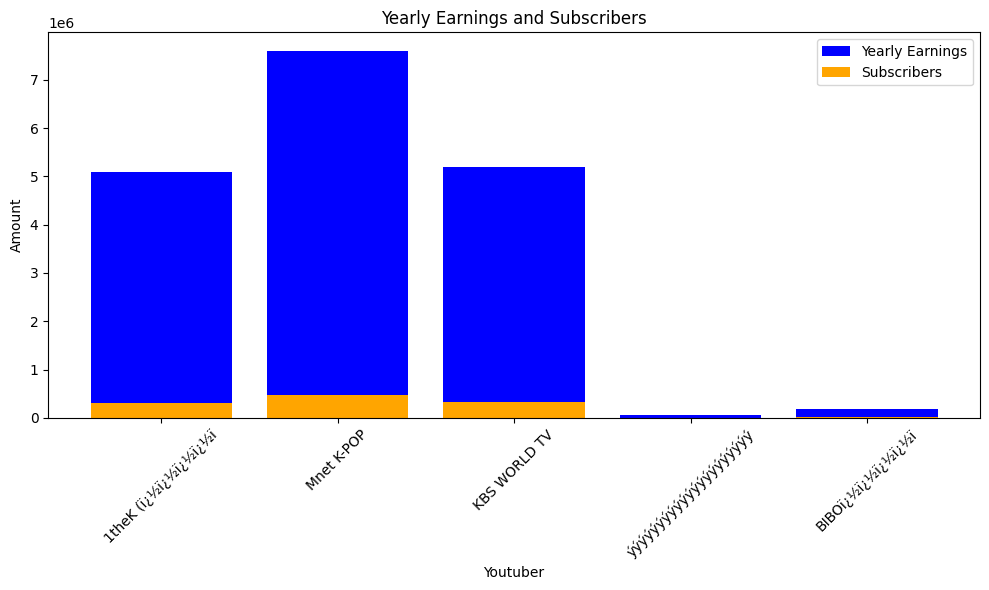

 68%|██████▊   | 1476/2160 [14:10<07:04,  1.61it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 351600.0, Youtuber: LEGO


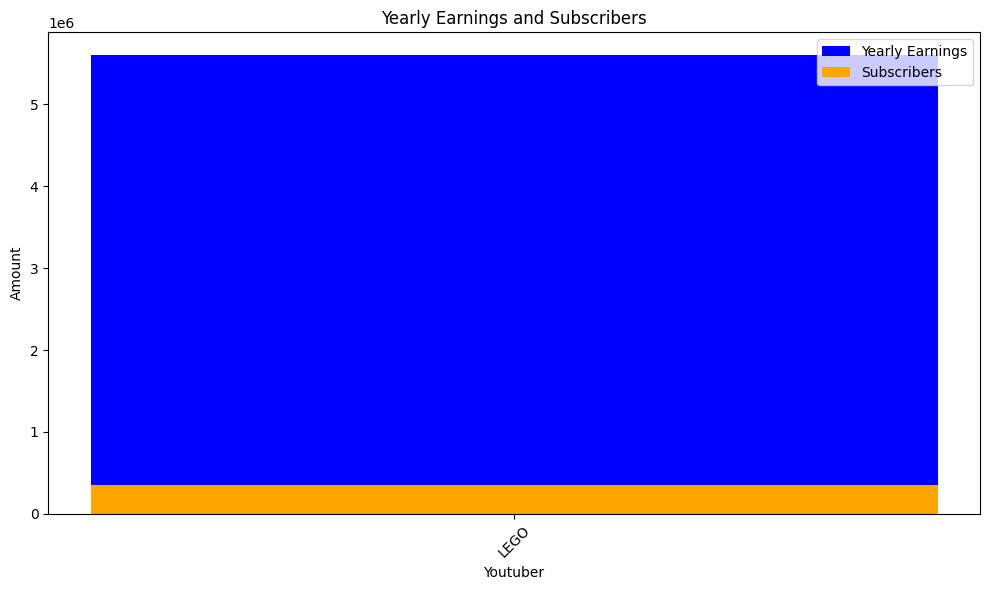

 68%|██████▊   | 1479/2160 [14:12<06:17,  1.81it/s]check
highest_yearly_earnings: 3500000.0, Subscribers: 221500.0, Youtuber: mmoshaya
highest_yearly_earnings: 129300.0, Subscribers: 8100.0, Youtuber: ýýýýýýýýýý ýýýýýýýýýýýý
highest_yearly_earnings: 224300.0, Subscribers: 14000.0, Youtuber: ýýýýýýýýýýýý ýýýýýýýýýýýý I ýýýýýý ýý ýýýýýýýýýý


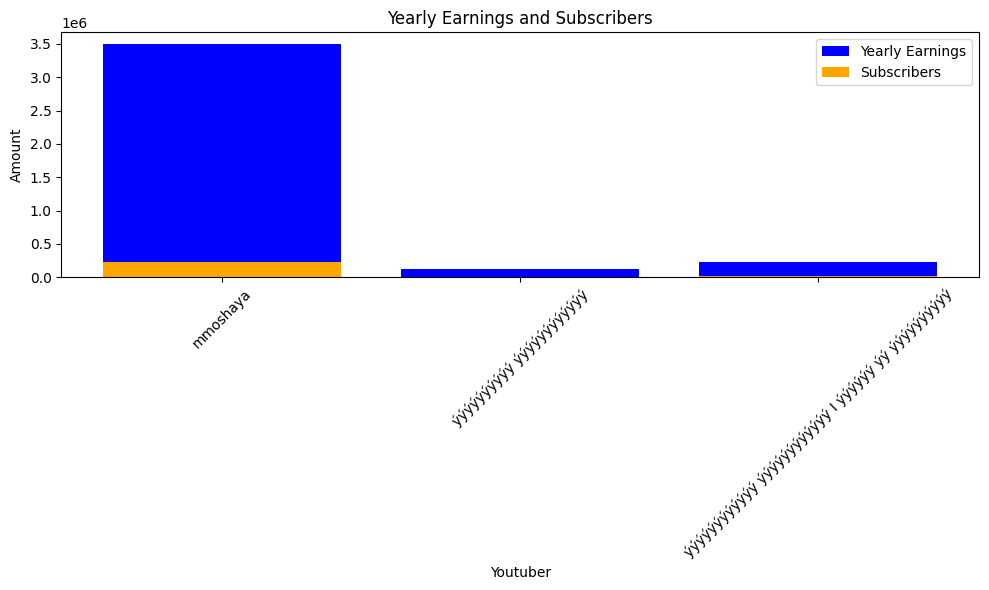

 69%|██████▊   | 1482/2160 [14:14<06:19,  1.79it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


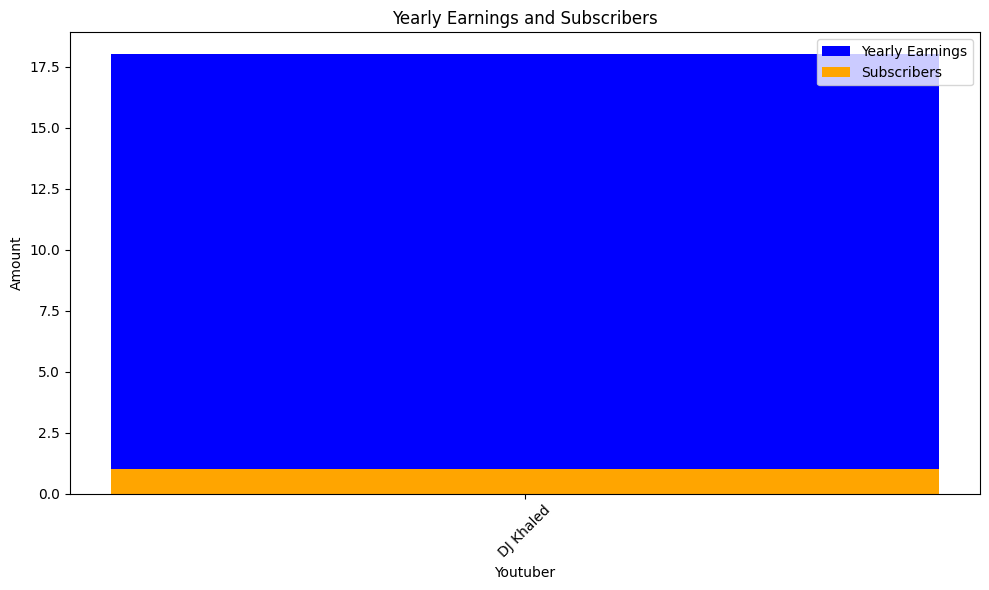

 69%|██████▉   | 1485/2160 [14:16<05:21,  2.10it/s]check
highest_yearly_earnings: 1200000.0, Subscribers: 73700.0, Youtuber: HiMan
highest_yearly_earnings: 1800000.0, Subscribers: 111500.0, Youtuber: TheBrianMaps
highest_yearly_earnings: 34200000.0, Subscribers: 2100000.0, Youtuber: Chapitosiki
highest_yearly_earnings: 4300000.0, Subscribers: 270700.0, Youtuber: ýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 420900.0, Subscribers: 26300.0, Youtuber: BIBO ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


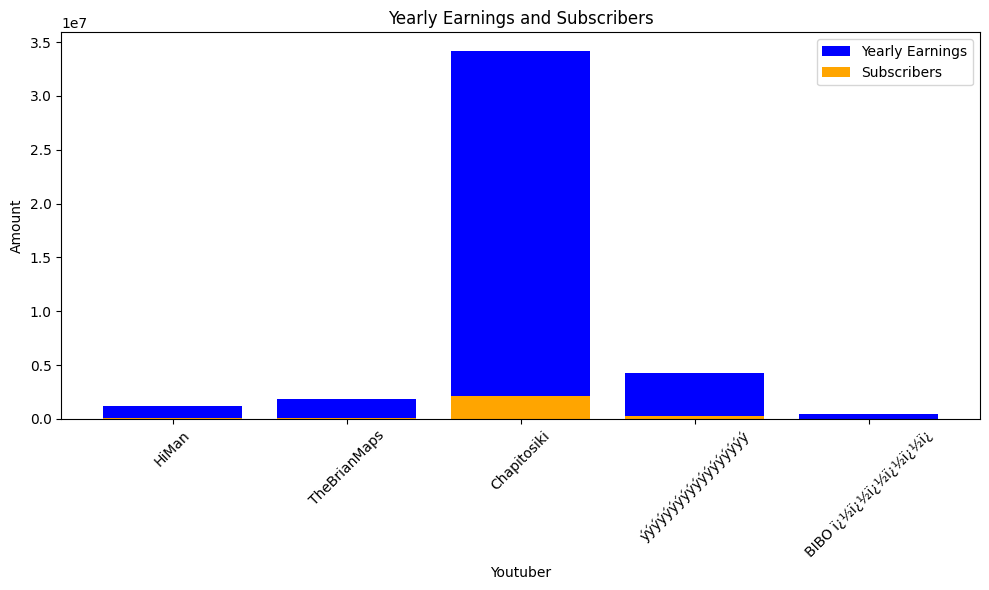

 69%|██████▉   | 1488/2160 [14:17<05:06,  2.19it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529900.0, Youtuber: ABS-CBN Entertainment
highest_yearly_earnings: 38300000.0, Subscribers: 2400000.0, Youtuber: GMA  Network
highest_yearly_earnings: 479000.0, Subscribers: 29900.0, Youtuber: Niana Guerrero
highest_yearly_earnings: 594000.0, Subscribers: 37100.0, Youtuber: Ranz Kyle


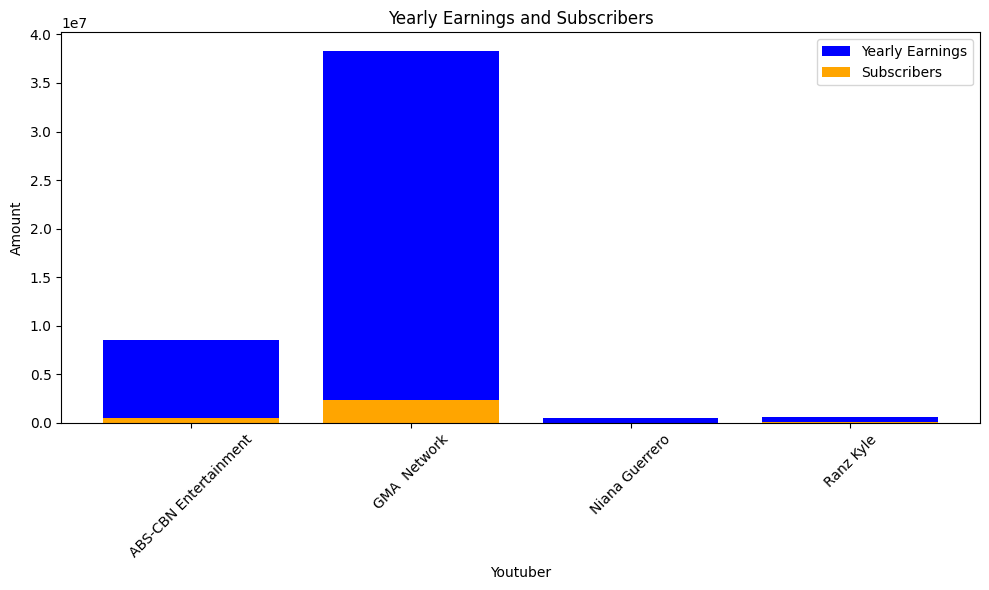

 69%|██████▉   | 1491/2160 [14:19<04:57,  2.25it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


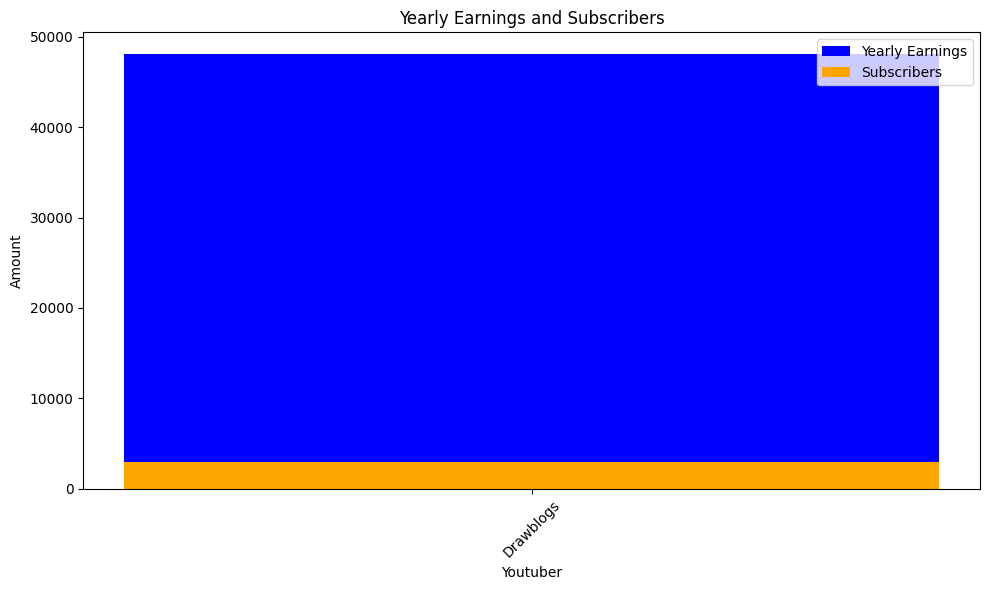

 69%|██████▉   | 1494/2160 [14:21<04:54,  2.26it/s]check
highest_yearly_earnings: 64200000.0, Subscribers: 4000000.0, Youtuber: HAR PAL GEO
highest_yearly_earnings: 55200000.0, Subscribers: 3400000.0, Youtuber: ARY Digital HD
highest_yearly_earnings: 32900000.0, Subscribers: 2100000.0, Youtuber: HUM TV


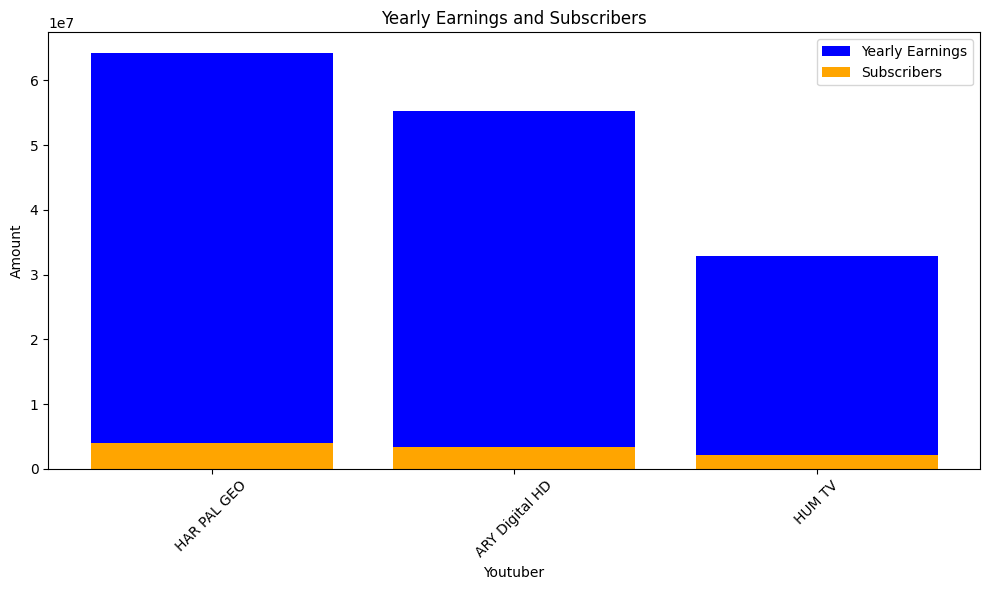

 69%|██████▉   | 1497/2160 [14:22<04:59,  2.21it/s]check
highest_yearly_earnings: 1700000.0, Subscribers: 107800.0, Youtuber: NikkieTutorials


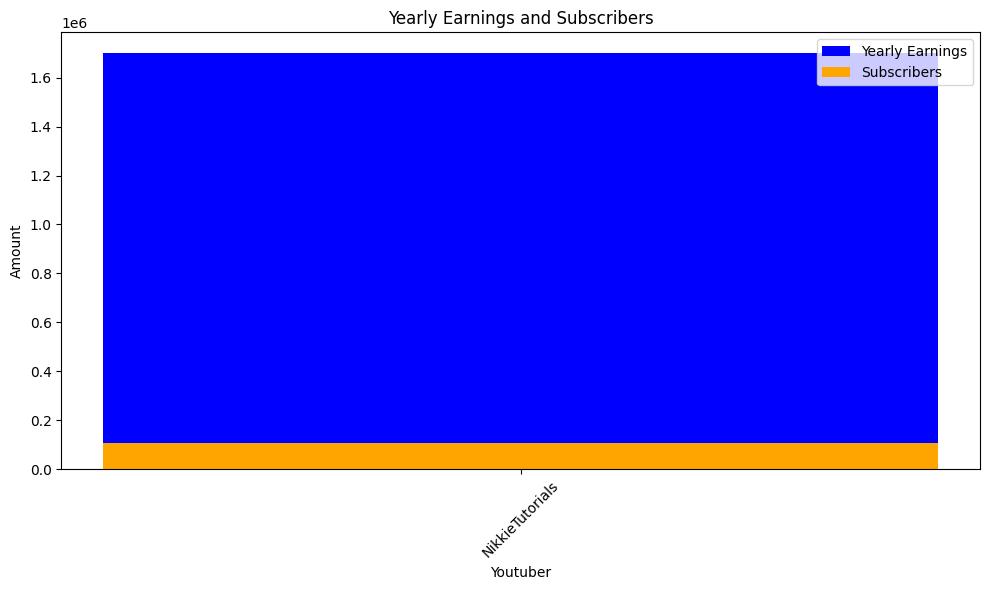

 69%|██████▉   | 1500/2160 [14:24<04:58,  2.21it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


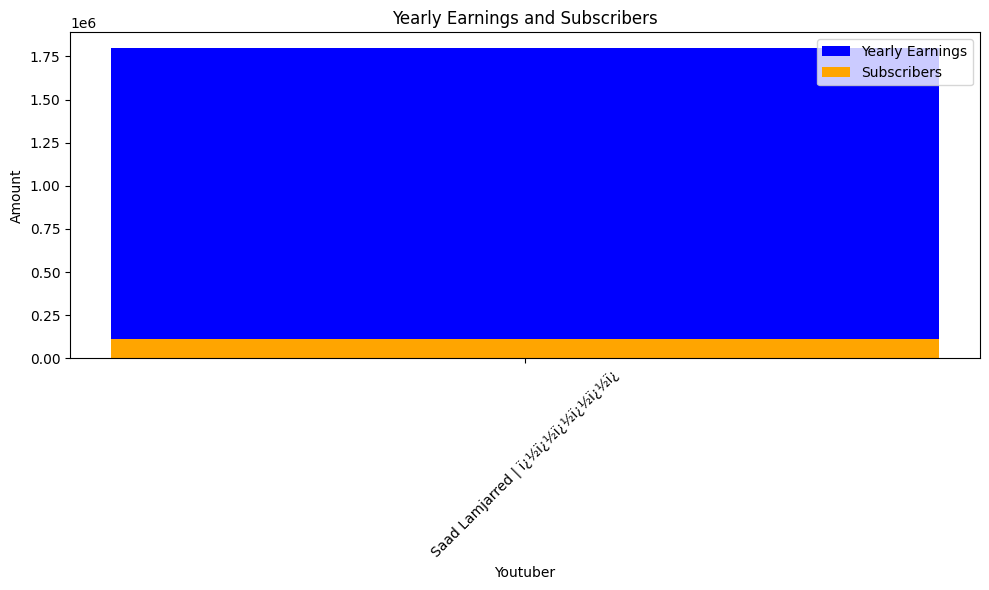

 70%|██████▉   | 1503/2160 [14:26<05:39,  1.94it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 100800.0, Youtuber: MrBeast en Espaï¿½ï
highest_yearly_earnings: 742.0, Subscribers: 46.0, Youtuber: Tlnovelas
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Caeli YT
highest_yearly_earnings: 1600000.0, Subscribers: 101600.0, Youtuber: XpressTV
highest_yearly_earnings: 1300000.0, Subscribers: 80300.0, Youtuber: TV Ana Emilia
highest_yearly_earnings: 17700000.0, Subscribers: 1100000.0, Youtuber: Susy Mouriz
highest_yearly_earnings: 1500000.0, Subscribers: 93000.0, Youtuber: Mï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 5600000.0, Subscribers: 347600.0, Youtuber: elcarteldesantatv


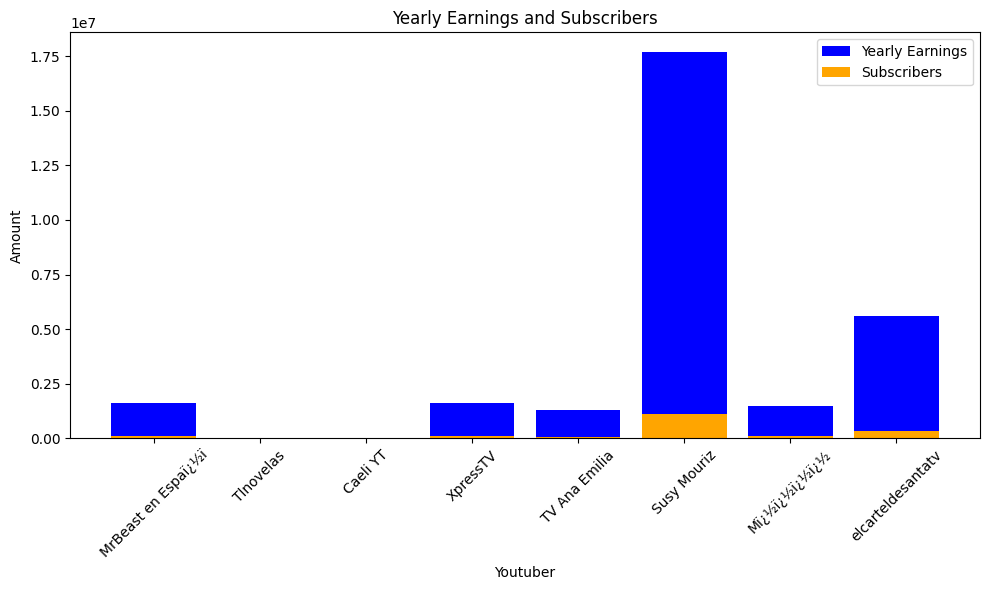

 70%|██████▉   | 1506/2160 [14:28<05:39,  1.93it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


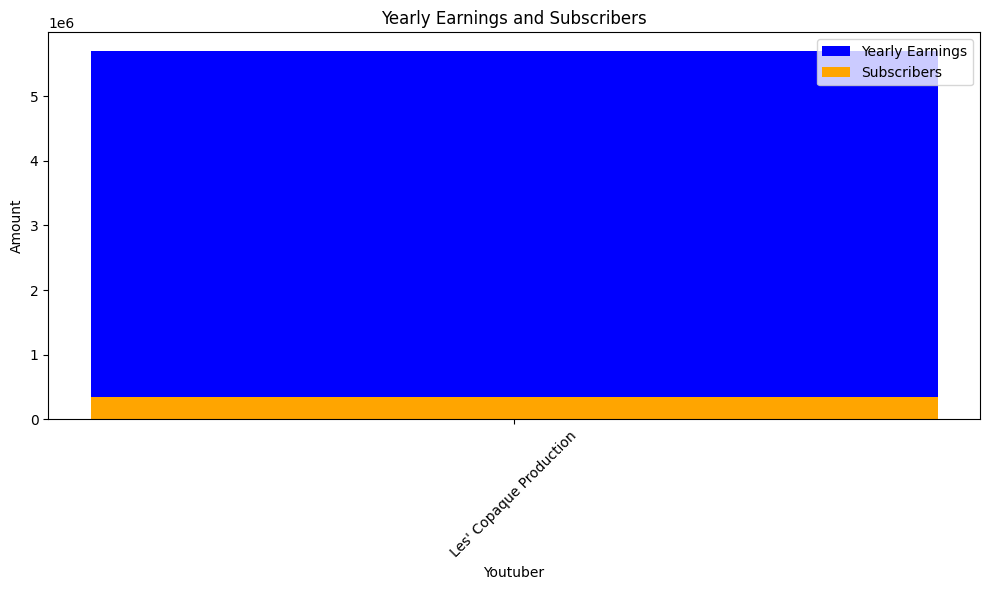

 70%|██████▉   | 1509/2160 [14:30<05:52,  1.85it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


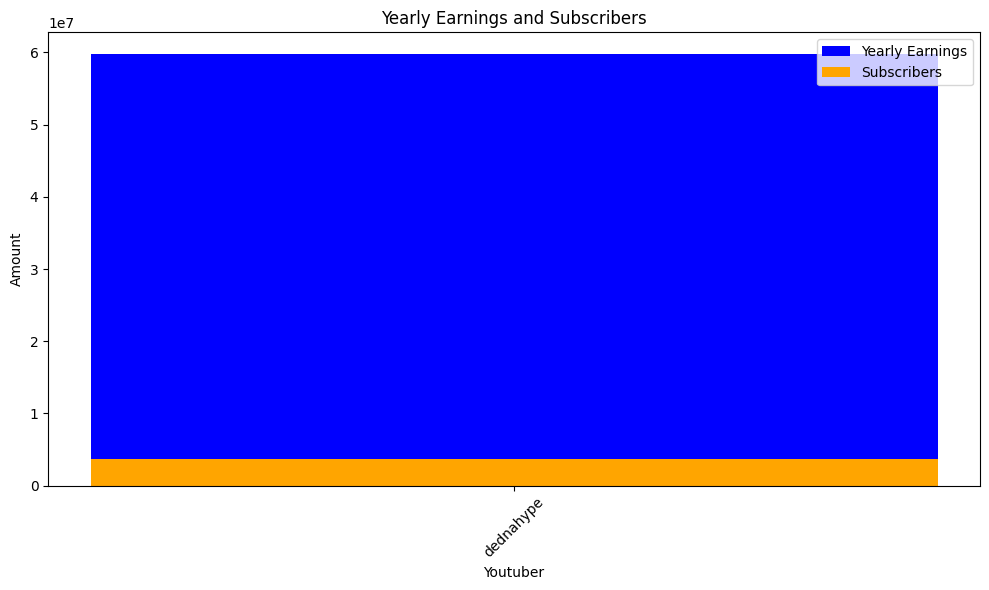

 70%|███████   | 1512/2160 [14:32<05:51,  1.84it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


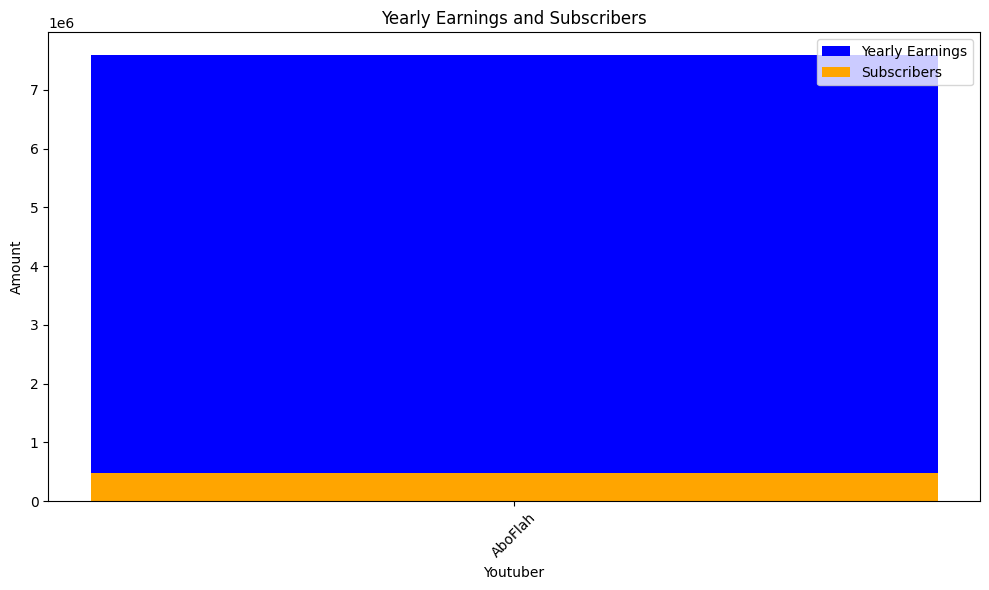

 70%|███████   | 1515/2160 [14:34<05:54,  1.82it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


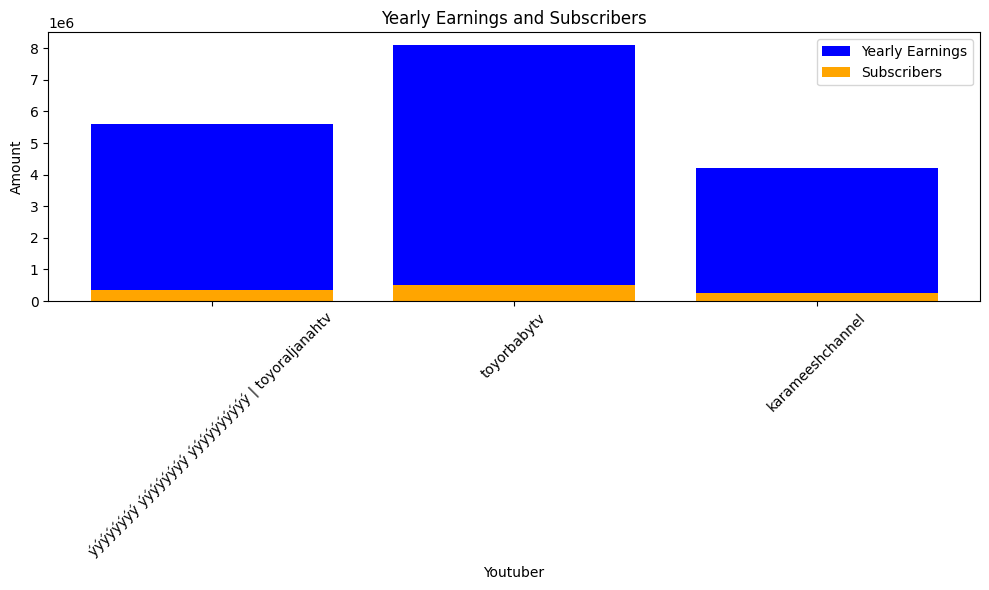

 70%|███████   | 1518/2160 [14:36<06:23,  1.68it/s]check
highest_yearly_earnings: 1900000.0, Subscribers: 117600.0, Youtuber: PewDiePie
highest_yearly_earnings: 34600000.0, Subscribers: 2200000.0, Youtuber: Junya.ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 34100000.0, Subscribers: 2100000.0, Youtuber: Sagawa /ï¿½ï¿½ï¿½


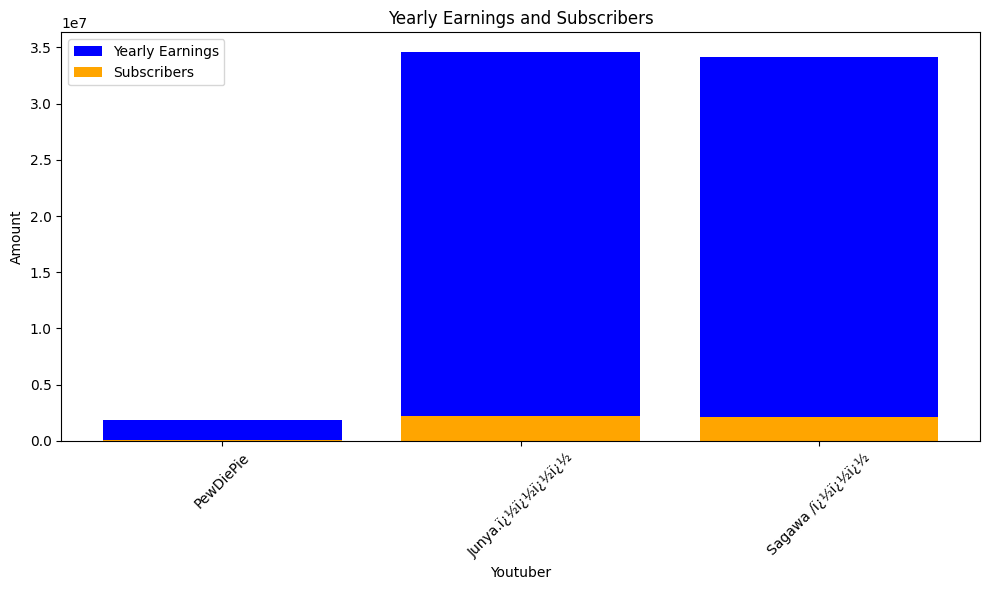

 70%|███████   | 1521/2160 [14:38<06:13,  1.71it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


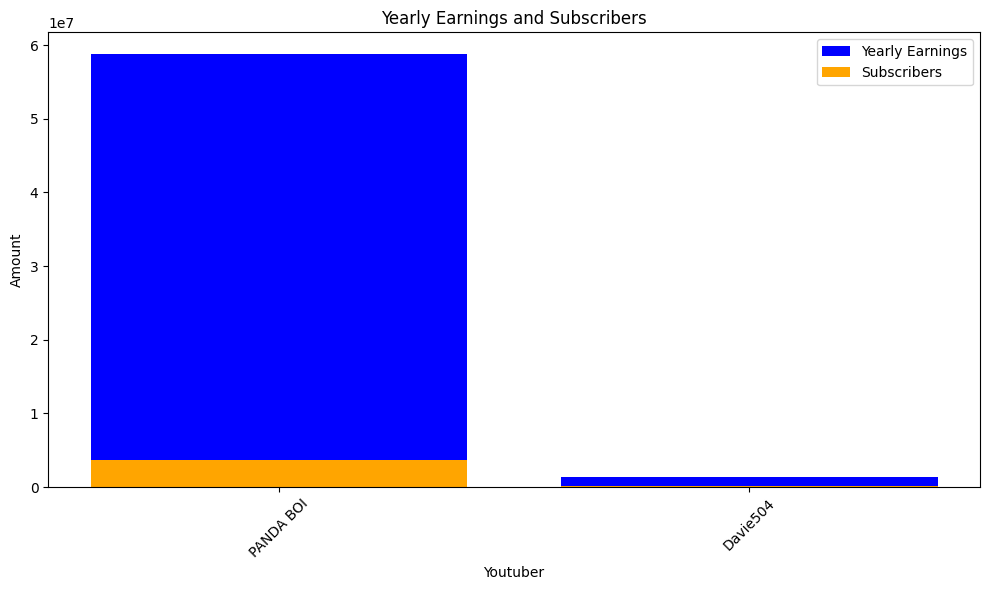

 71%|███████   | 1524/2160 [14:40<05:16,  2.01it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


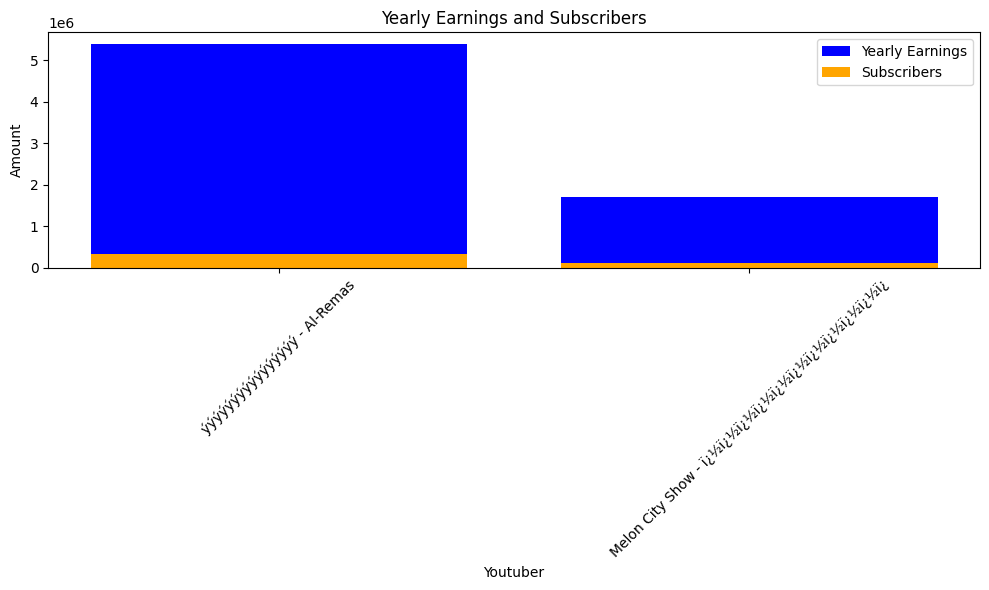

 71%|███████   | 1527/2160 [14:41<04:50,  2.18it/s]check
highest_yearly_earnings: 26300000.0, Subscribers: 1600000.0, Youtuber: Jess No Limit
highest_yearly_earnings: 7500000.0, Subscribers: 471300.0, Youtuber: Ricis Official
highest_yearly_earnings: 1000000.0, Subscribers: 64300.0, Youtuber: AH
highest_yearly_earnings: 11000000.0, Subscribers: 690500.0, Youtuber: Indosiar
highest_yearly_earnings: 2800000.0, Subscribers: 175500.0, Youtuber: Rans Entertainment
highest_yearly_earnings: 5900000.0, Subscribers: 369600.0, Youtuber: TRANS7 OFFICIAL
highest_yearly_earnings: 1300000.0, Subscribers: 80900.0, Youtuber: Baim Paula
highest_yearly_earnings: 4.0, Subscribers: 0.26, Youtuber: Deddy Corbuzier
highest_yearly_earnings: 819000.0, Subscribers: 51200.0, Youtuber: Naisa Alifia Yuriza (N.A.Y)
highest_yearly_earnings: 1300000.0, Subscribers: 81900.0, Youtuber: GEN HALILINTAR
highest_yearly_earnings: 2300000.0, Subscribers: 144500.0, Youtuber: tanboy kun
highest_yearly_earnings: 2200000.0, Sub

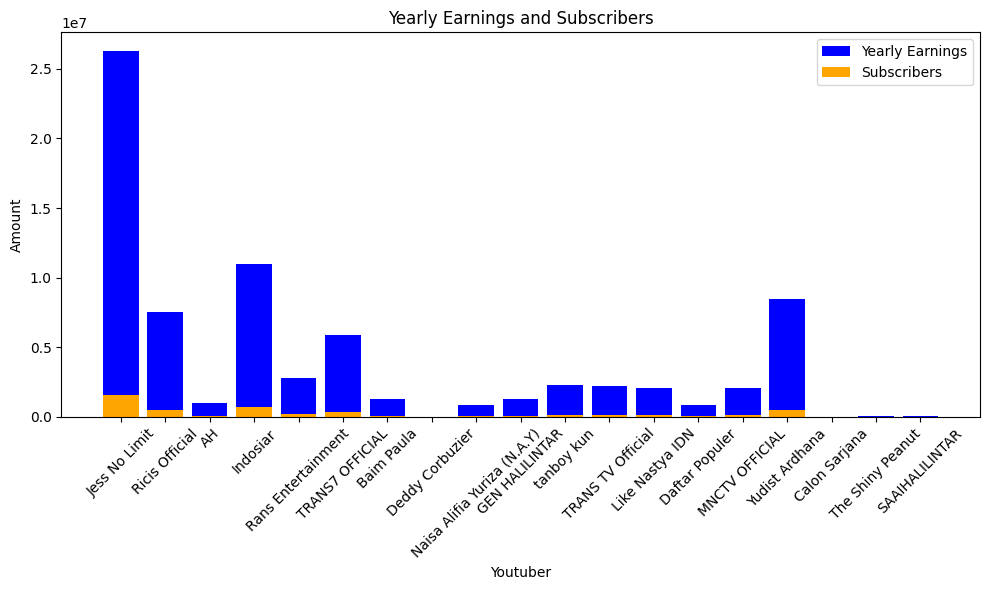

 71%|███████   | 1530/2160 [14:43<05:12,  2.02it/s]check
highest_yearly_earnings: 87500000.0, Subscribers: 5500000.0, Youtuber: SET India
highest_yearly_earnings: 79600000.0, Subscribers: 5000000.0, Youtuber: Sony SAB
highest_yearly_earnings: 81900000.0, Subscribers: 5100000.0, Youtuber: Zee TV
highest_yearly_earnings: 57000000.0, Subscribers: 3600000.0, Youtuber: Colors TV
highest_yearly_earnings: 11200000.0, Subscribers: 698200.0, Youtuber: Shemaroo
highest_yearly_earnings: 11200000.0, Subscribers: 702000.0, Youtuber: Voot Kids
highest_yearly_earnings: 20000000.0, Subscribers: 1200000.0, Youtuber: Sony PAL
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Ultra Bollywood
highest_yearly_earnings: 13100000.0, Subscribers: 816800.0, Youtuber: Rajshri
highest_yearly_earnings: 972600.0, Subscribers: 60800.0, Youtuber: Eros Now Music
highest_yearly_earnings: 80000000.0, Subscribers: 5000000.0, Youtuber: StarPlus
highest_yearly_earnings: 1500000.0, Subscribers: 95500.0, Youtuber: Ro

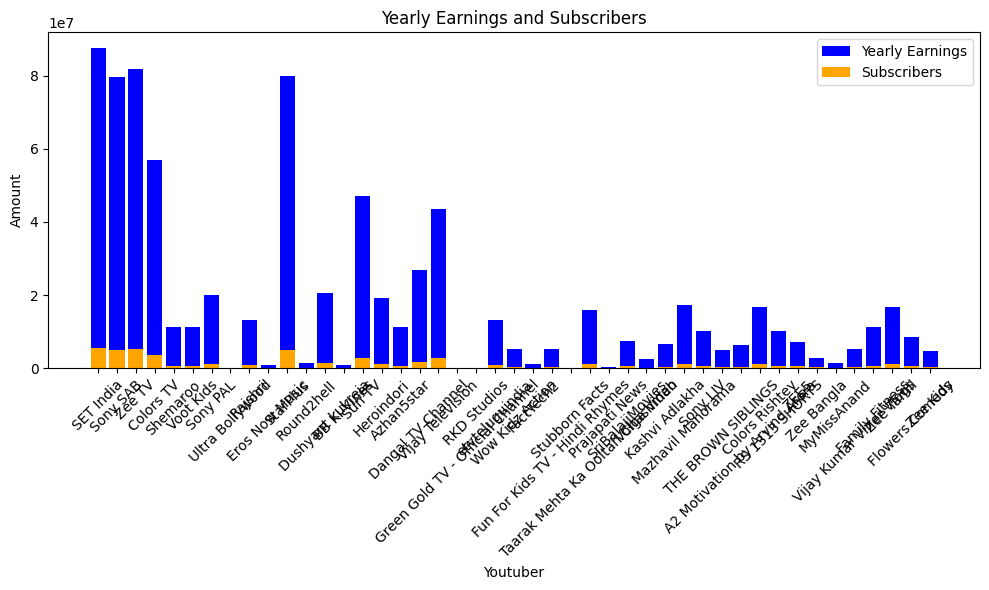

 71%|███████   | 1533/2160 [14:46<07:19,  1.43it/s]check
highest_yearly_earnings: 29600000.0, Subscribers: 1900000.0, Youtuber: Younes Zarou


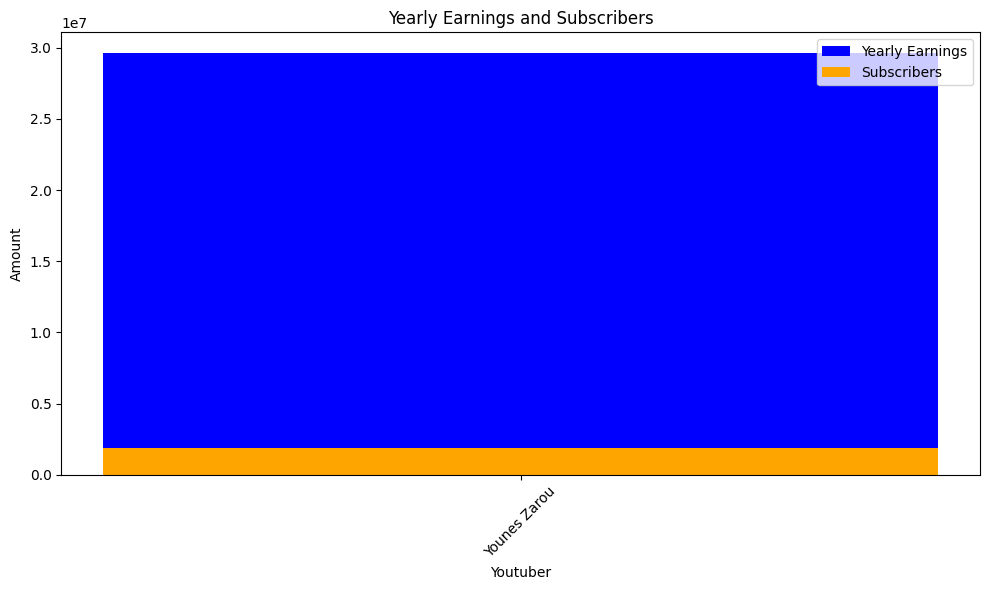

 71%|███████   | 1536/2160 [14:48<06:14,  1.67it/s]check
highest_yearly_earnings: 2300000.0, Subscribers: 144300.0, Youtuber: SQUEEZIE
highest_yearly_earnings: 37.0, Subscribers: 2.0, Youtuber: FitDance


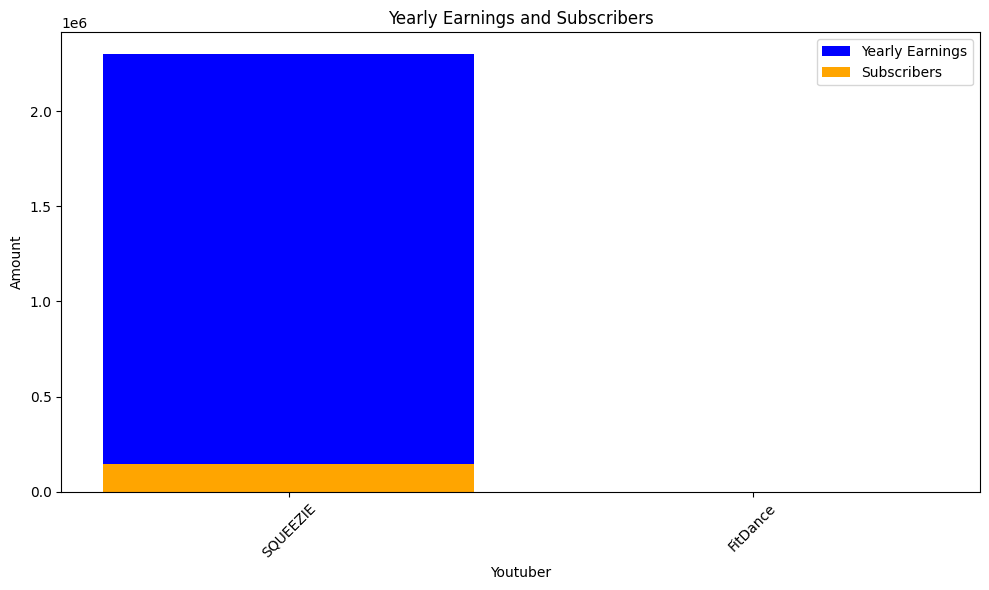

 71%|███████▏  | 1539/2160 [14:50<05:36,  1.85it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


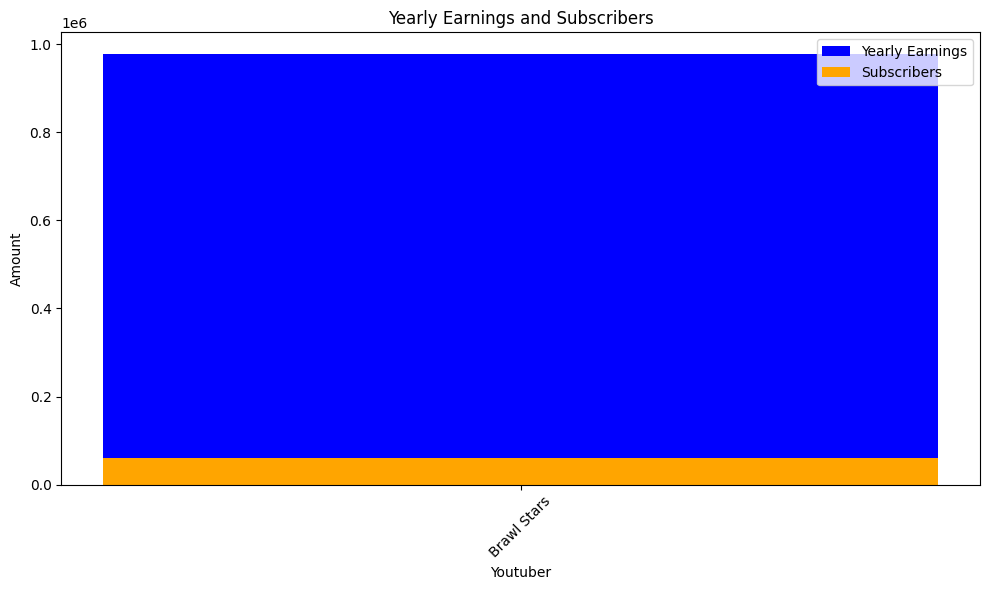

 71%|███████▏  | 1542/2160 [14:52<04:48,  2.14it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


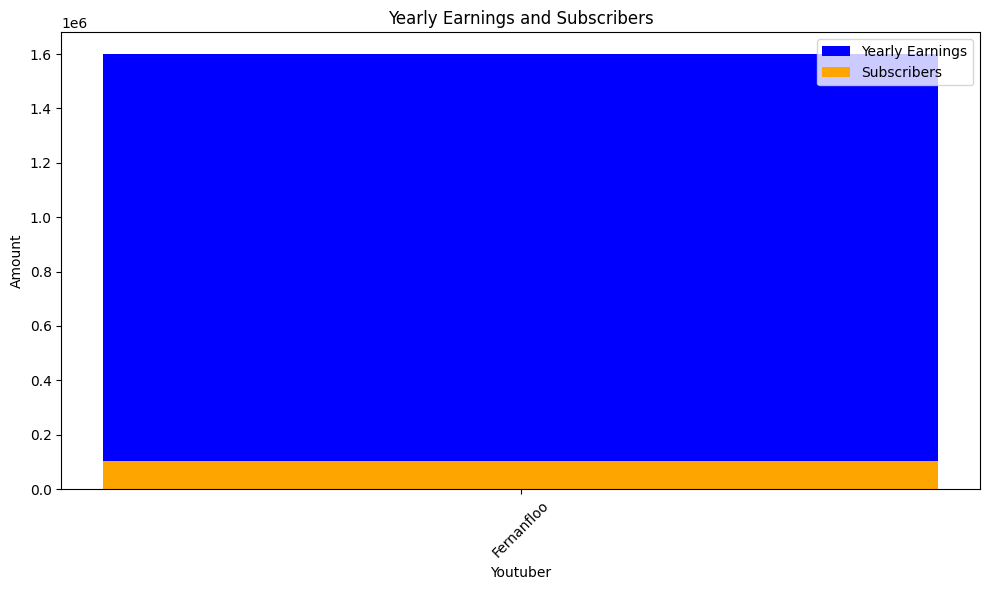

 72%|███████▏  | 1545/2160 [14:53<04:36,  2.22it/s]check
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


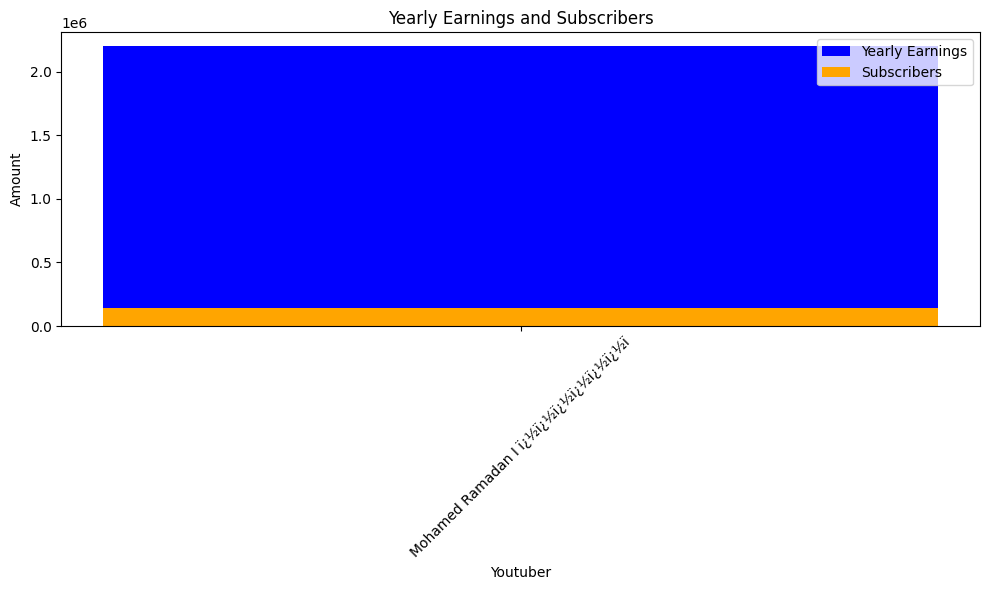

 72%|███████▏  | 1548/2160 [14:55<04:31,  2.26it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops


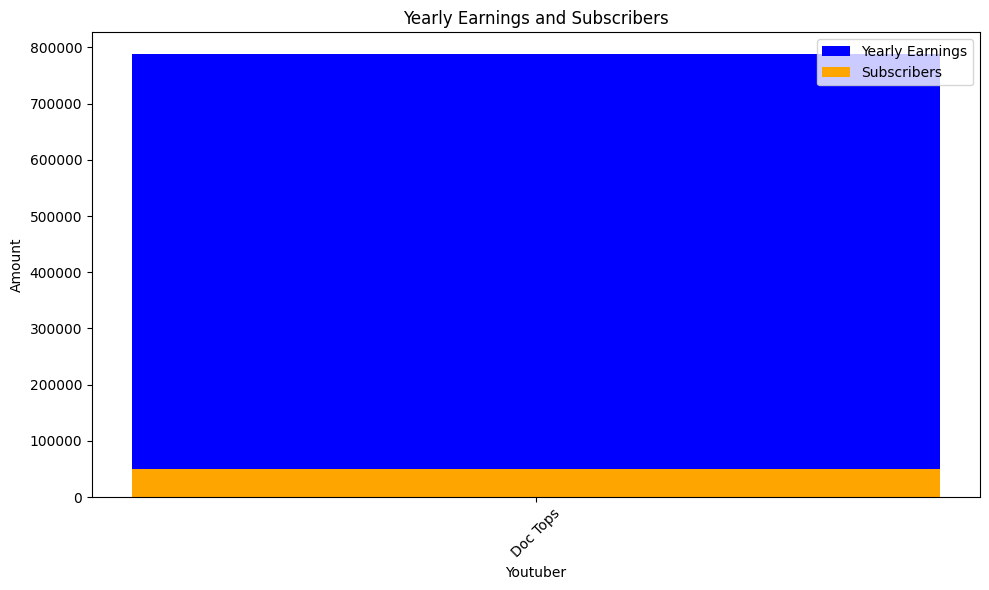

 72%|███████▏  | 1551/2160 [14:56<04:24,  2.30it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


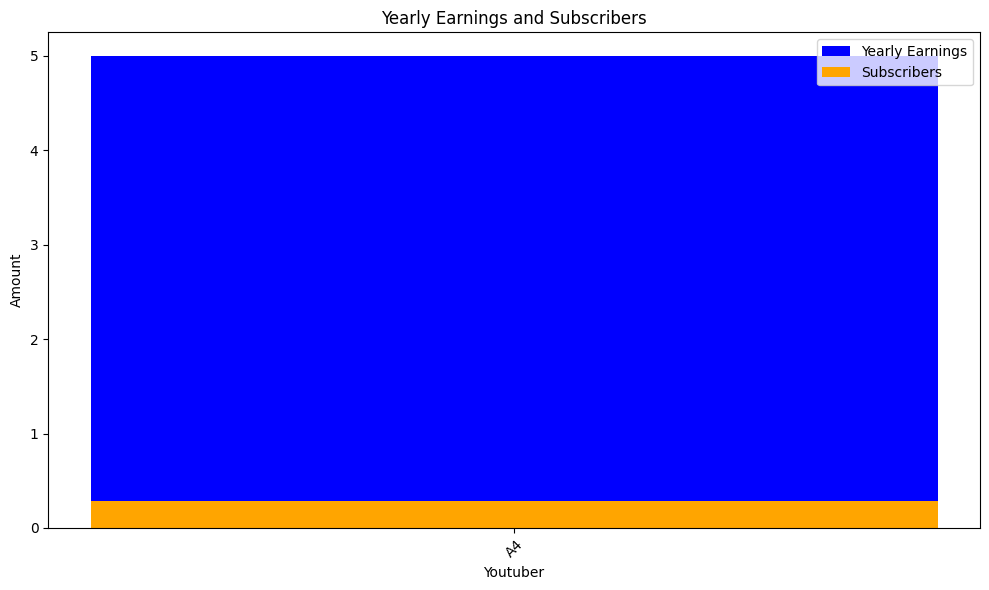

 72%|███████▏  | 1554/2160 [14:58<04:18,  2.34it/s]check
highest_yearly_earnings: 12700000.0, Subscribers: 791600.0, Youtuber: Ami Rodriguez


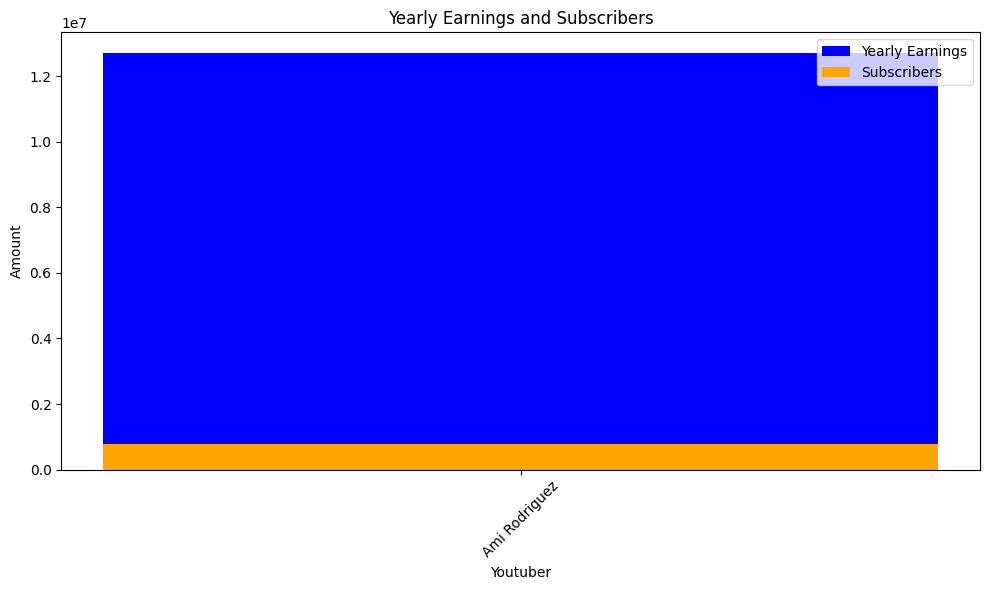

 72%|███████▏  | 1557/2160 [15:01<06:06,  1.65it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


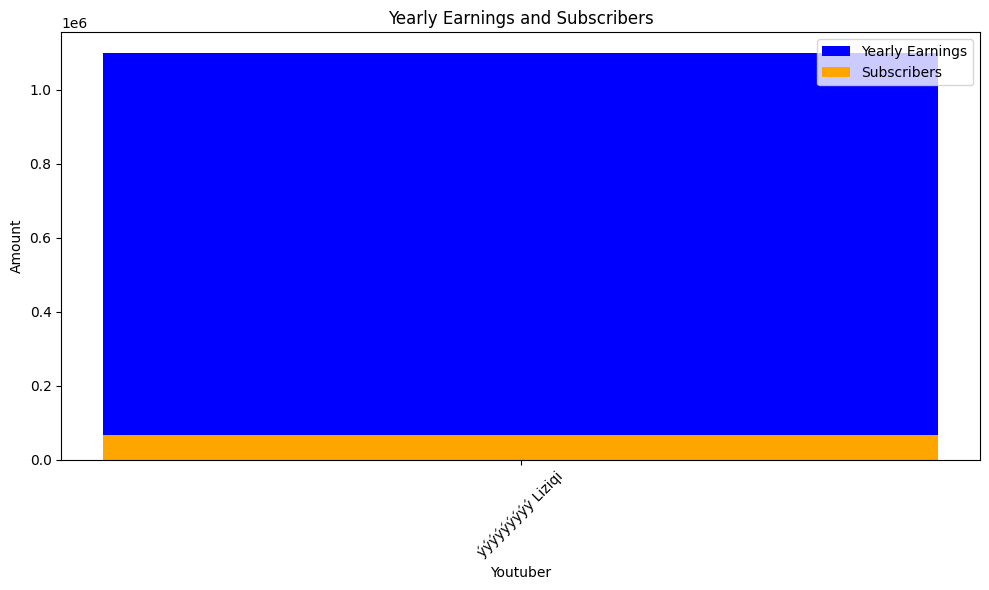

 72%|███████▏  | 1560/2160 [15:02<05:20,  1.87it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 199200.0, Youtuber: JuegaGerman
highest_yearly_earnings: 2.0, Subscribers: 0.15, Youtuber: invictor
highest_yearly_earnings: 4800000.0, Subscribers: 300600.0, Youtuber: DeGoBooM


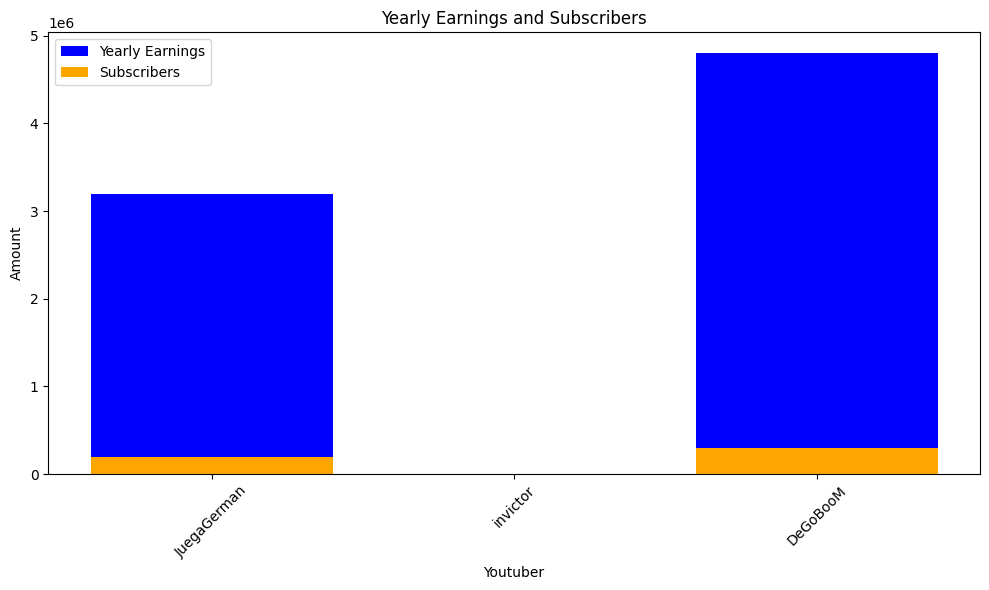

 72%|███████▏  | 1563/2160 [15:04<04:53,  2.03it/s]check
highest_yearly_earnings: 2400000.0, Subscribers: 147000.0, Youtuber: WatchMojo.com
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Pentatonix
highest_yearly_earnings: 258600.0, Subscribers: 16200.0, Youtuber: AzzyLand
highest_yearly_earnings: 869600.0, Subscribers: 54400.0, Youtuber: MrSuicideSheep
highest_yearly_earnings: 460600.0, Subscribers: 28800.0, Youtuber: Heidi and Zidane HZHtube


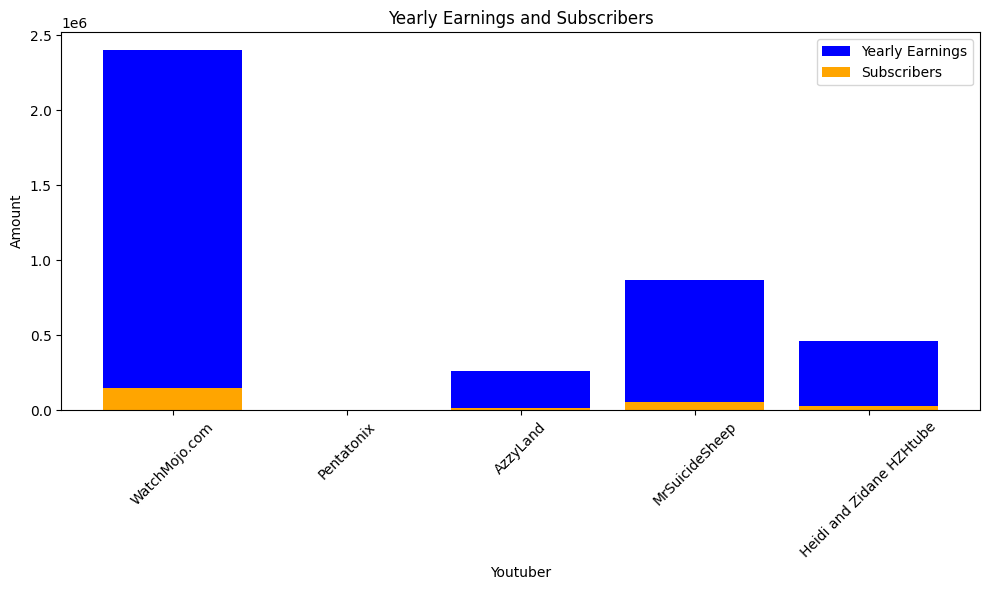

 72%|███████▎  | 1566/2160 [15:06<04:51,  2.04it/s]check
highest_yearly_earnings: 6300000.0, Subscribers: 391100.0, Youtuber: Felipe Neto
highest_yearly_earnings: 2300000.0, Subscribers: 144100.0, Youtuber: Vocï¿½ï¿½ï¿½
highest_yearly_earnings: 12100000.0, Subscribers: 754300.0, Youtuber: Maria Clara & JP
highest_yearly_earnings: 2100000.0, Subscribers: 133500.0, Youtuber: rezendeevil
highest_yearly_earnings: 4000000.0, Subscribers: 248700.0, Youtuber: Renato Garcia YT
highest_yearly_earnings: 1400000.0, Subscribers: 84900.0, Youtuber: Valentina Pontes ofc
highest_yearly_earnings: 9300000.0, Subscribers: 579500.0, Youtuber: DUDU e CAROL
highest_yearly_earnings: 5700000.0, Subscribers: 355200.0, Youtuber: Rafa & Luiz
highest_yearly_earnings: 2500000.0, Subscribers: 157000.0, Youtuber: Fatos Desconhecidos
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Porta dos Fundos
highest_yearly_earnings: 2100000.0, Subscribers: 132400.0, Youtuber: Gato Galactico | GALï¿½ï¿
high

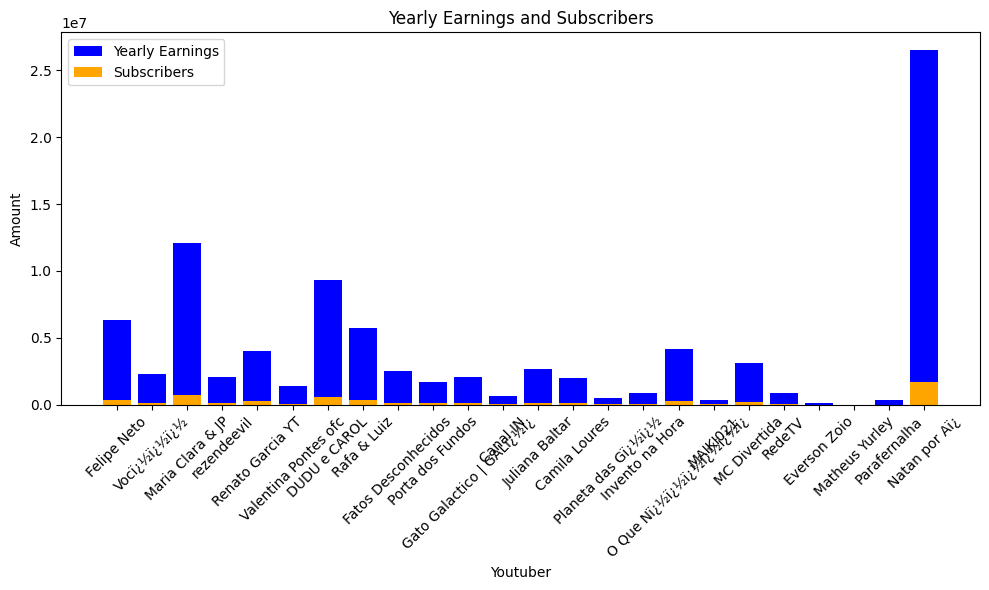

 73%|███████▎  | 1569/2160 [15:08<05:23,  1.83it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


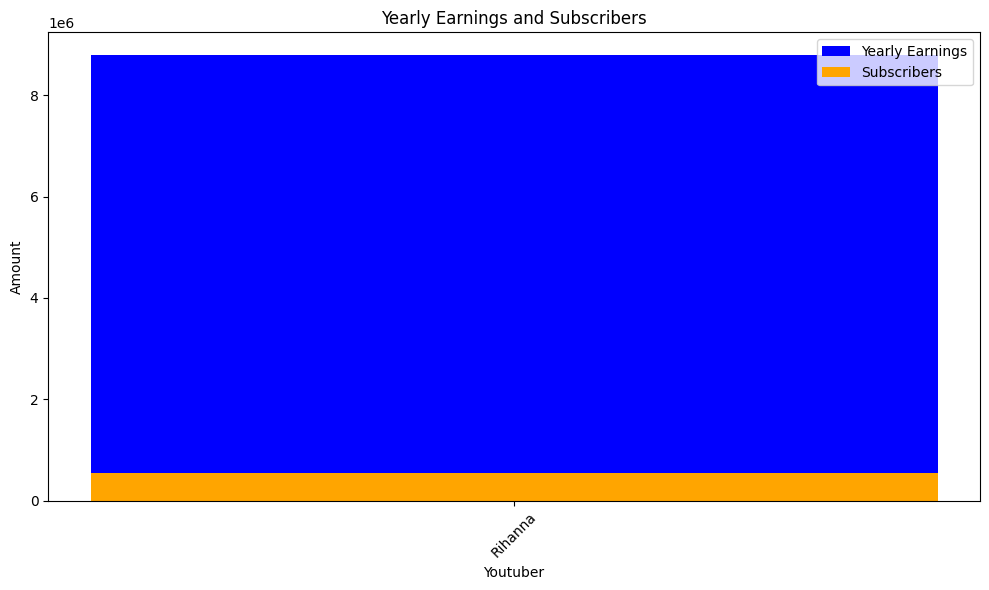

 73%|███████▎  | 1572/2160 [15:10<04:30,  2.18it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


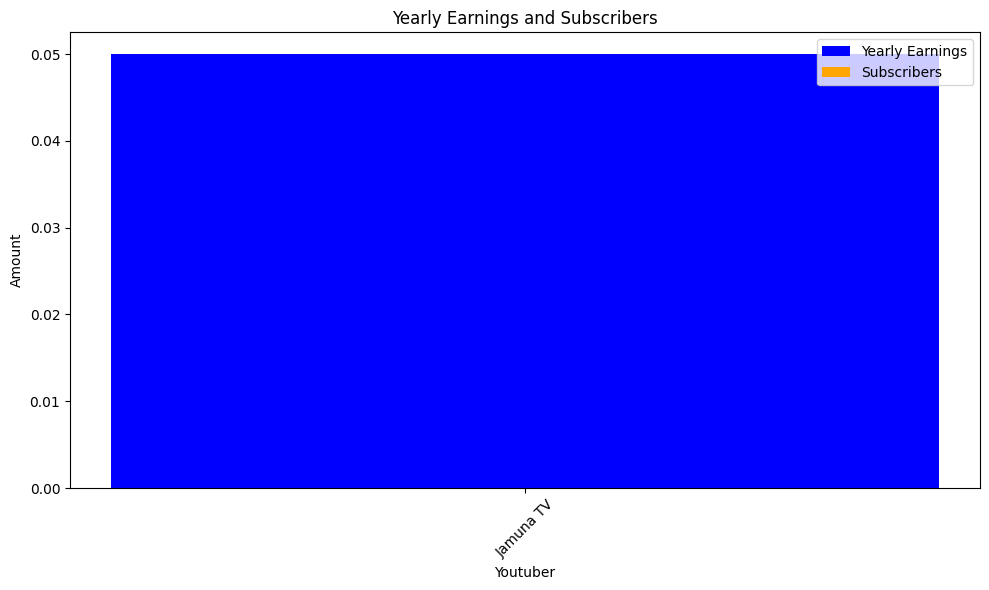

 73%|███████▎  | 1575/2160 [15:11<04:15,  2.29it/s]check
highest_yearly_earnings: 6100000.0, Subscribers: 382300.0, Youtuber: Bounce Patrol - Kids Songs
highest_yearly_earnings: 1100000.0, Subscribers: 69800.0, Youtuber: Chloe Ting
highest_yearly_earnings: 1300000.0, Subscribers: 78200.0, Youtuber: LazarBeam
highest_yearly_earnings: 18800000.0, Subscribers: 1200000.0, Youtuber: How Ridiculous
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: The Game Theorists
highest_yearly_earnings: 745200.0, Subscribers: 46600.0, Youtuber: HowToBasic
highest_yearly_earnings: 1.0, Subscribers: 0.08, Youtuber: Jason Vlogs
highest_yearly_earnings: 1000000.0, Subscribers: 63200.0, Youtuber: Lachlan
highest_yearly_earnings: 7.0, Subscribers: 0.44, Youtuber: Trap City


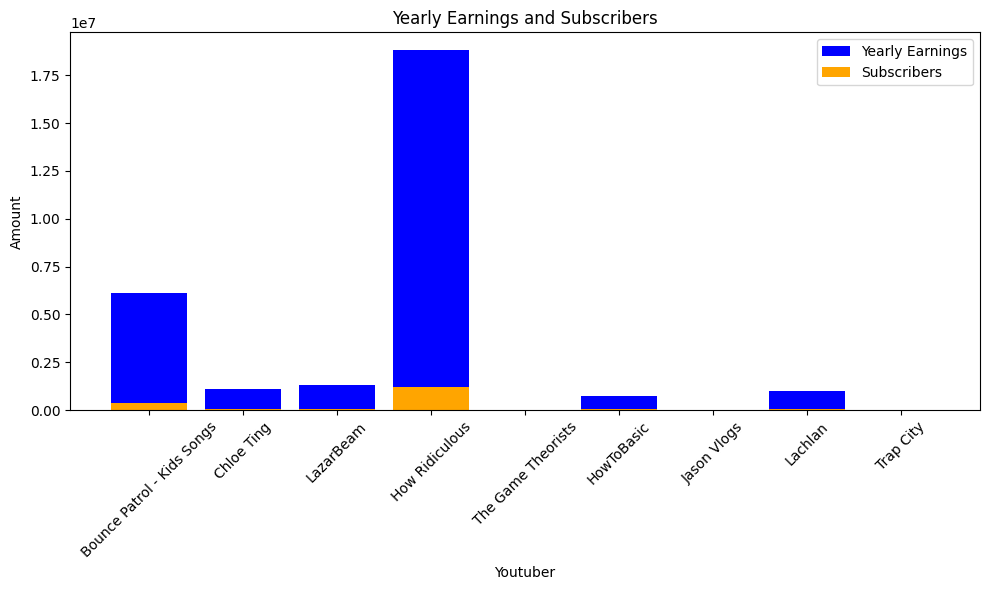

 73%|███████▎  | 1578/2160 [15:13<04:20,  2.24it/s]check
highest_yearly_earnings: 19300000.0, Subscribers: 1200000.0, Youtuber: Alejo Igoa
highest_yearly_earnings: 1700000.0, Subscribers: 106600.0, Youtuber: DrossRotzank
highest_yearly_earnings: 9300000.0, Subscribers: 579500.0, Youtuber: Bizarrap


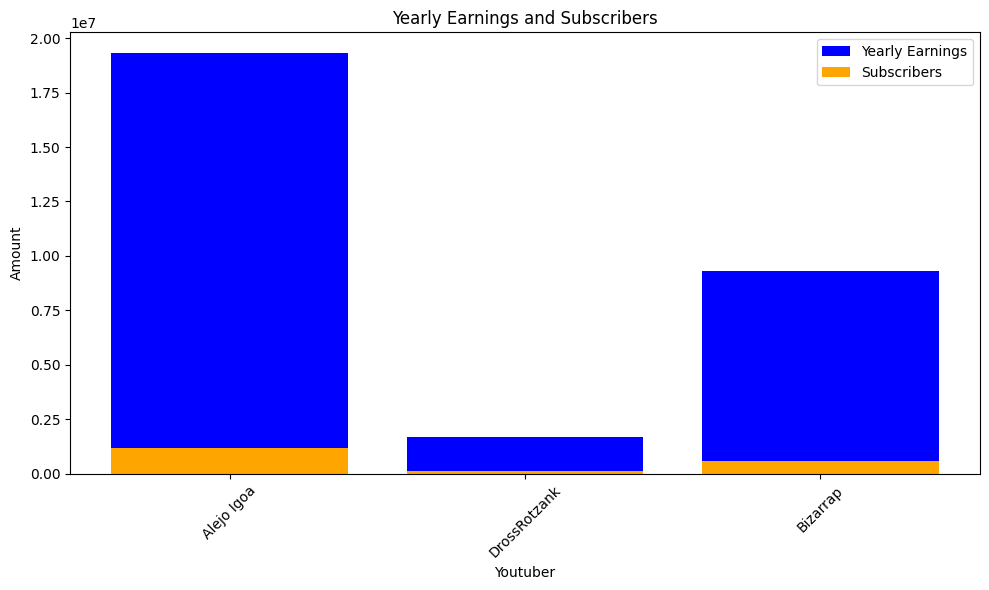

 73%|███████▎  | 1581/2160 [15:14<04:20,  2.22it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


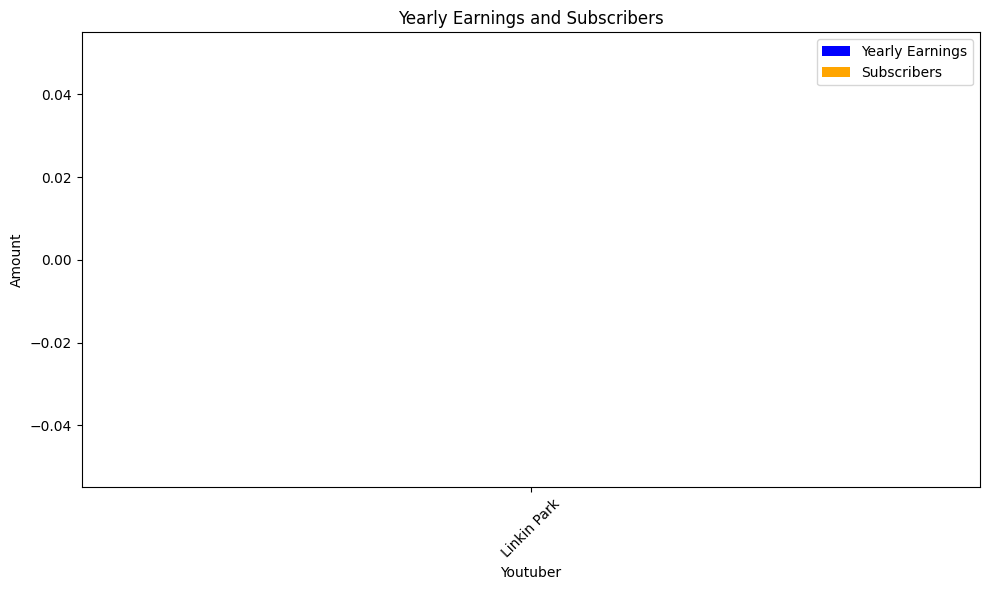

 73%|███████▎  | 1584/2160 [15:16<04:15,  2.26it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


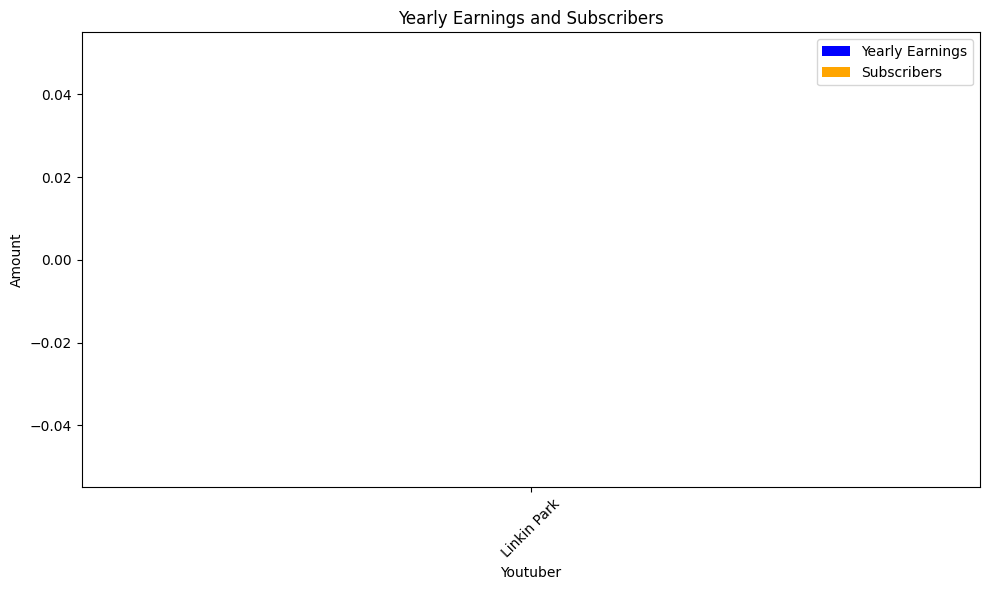

check
highest_yearly_earnings: 4100000.0, Subscribers: 253400.0, Youtuber: Like Nastya VNM
highest_yearly_earnings: 12300000.0, Subscribers: 770200.0, Youtuber: POPS Kids
highest_yearly_earnings: 1700000.0, Subscribers: 105400.0, Youtuber: FAPTV


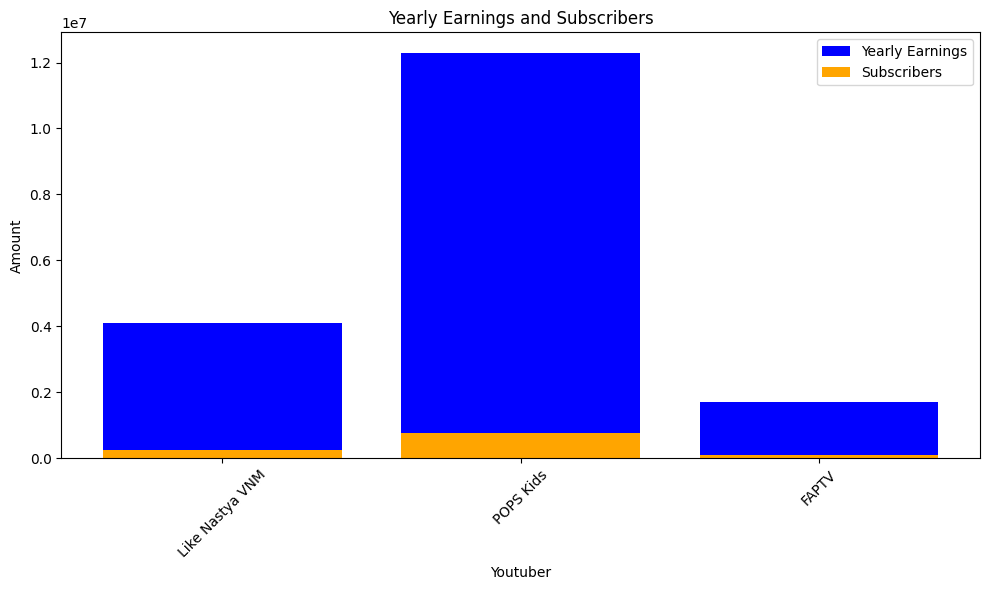

 73%|███████▎  | 1587/2160 [15:18<05:17,  1.81it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


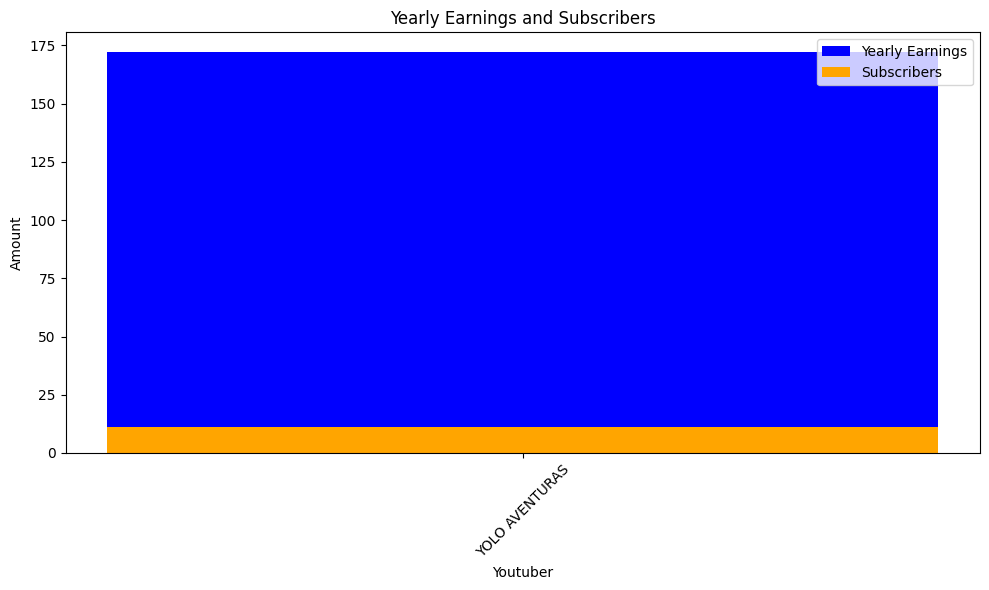

 74%|███████▎  | 1590/2160 [15:20<04:34,  2.08it/s]check
highest_yearly_earnings: 94800000.0, Subscribers: 5900000.0, Youtuber: Cocomelon - Nursery Rhymes
highest_yearly_earnings: 22700000.0, Subscribers: 1400000.0, Youtuber: Pinkfong Baby Shark - Kids' Songs & Stories
highest_yearly_earnings: 12800000.0, Subscribers: 800200.0, Youtuber: BillionSurpriseToys  - Nursery Rhymes & Cartoons
highest_yearly_earnings: 4700000.0, Subscribers: 296300.0, Youtuber: Little Baby Bum - Nursery Rhymes & Kids Songs
highest_yearly_earnings: 6100000.0, Subscribers: 382500.0, Youtuber: BabyBus - Kids Songs and Cartoons
highest_yearly_earnings: 5200000.0, Subscribers: 322600.0, Youtuber: Little Angel: Nursery Rhymes & Kids Songs
highest_yearly_earnings: 15800000.0, Subscribers: 985500.0, Youtuber: Super JoJo - Nursery Rhymes & Kids Songs
highest_yearly_earnings: 7500000.0, Subscribers: 465600.0, Youtuber: Vania Mania Kids
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: TED-Ed
highest_ye

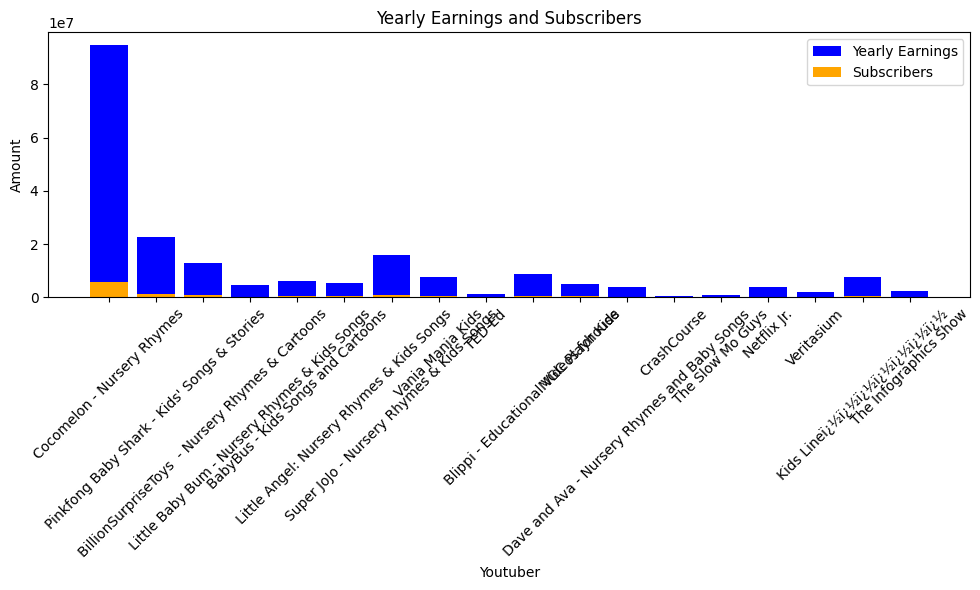

 74%|███████▍  | 1593/2160 [15:22<05:13,  1.81it/s]check
highest_yearly_earnings: 11800000.0, Subscribers: 734800.0, Youtuber: Peppa Pig - Official Channel


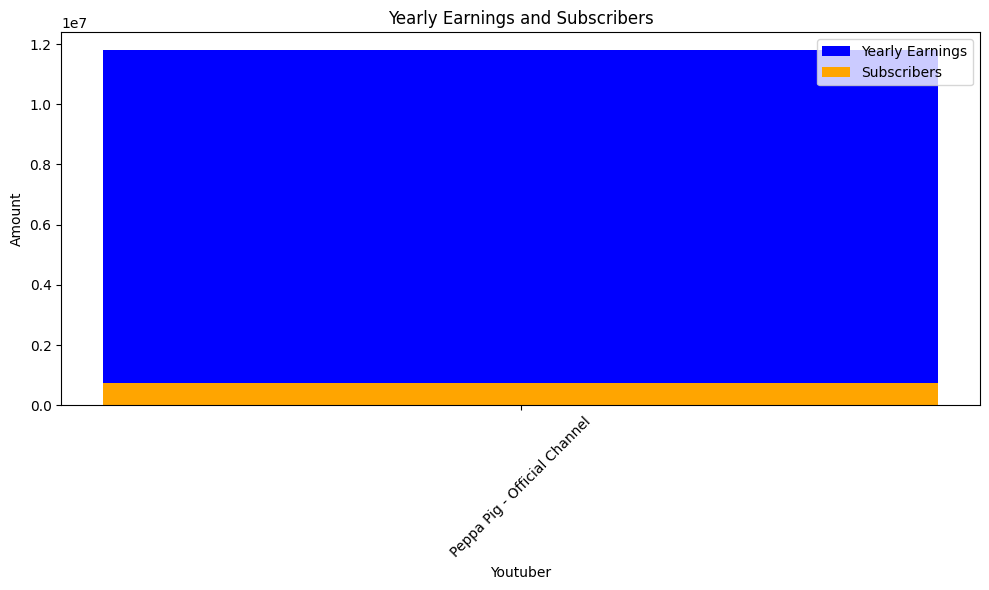

 74%|███████▍  | 1596/2160 [15:24<05:19,  1.77it/s]check
highest_yearly_earnings: 11900000.0, Subscribers: 743200.0, Youtuber: shfa2 - ï¿½ï¿½
highest_yearly_earnings: 7300000.0, Subscribers: 453600.0, Youtuber: shfa show India
highest_yearly_earnings: 76700000.0, Subscribers: 4800000.0, Youtuber: ZAMZAM ELECTRONICS TRADING
highest_yearly_earnings: 746700.0, Subscribers: 46700.0, Youtuber: Noor Stars
highest_yearly_earnings: 3800000.0, Subscribers: 240500.0, Youtuber: FFUNTV
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Supercar Blondie
highest_yearly_earnings: 3900000.0, Subscribers: 240700.0, Youtuber: AlArabiya ï¿½ï¿½ï¿½ï¿½ï¿


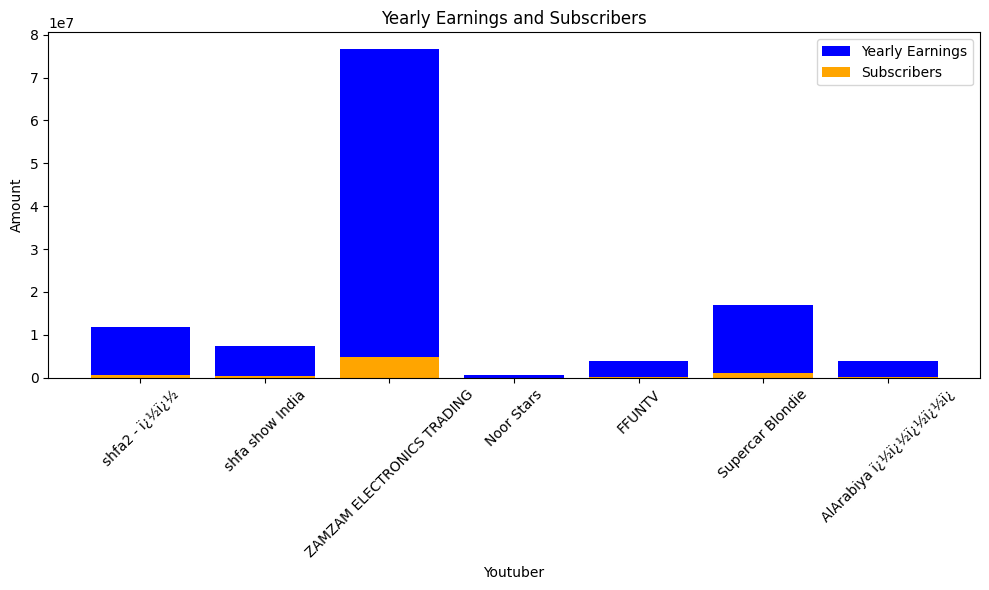

 74%|███████▍  | 1599/2160 [15:26<04:56,  1.89it/s]check
highest_yearly_earnings: 1400000.0, Subscribers: 87000.0, Youtuber: SlivkiShow
highest_yearly_earnings: 3300000.0, Subscribers: 204000.0, Youtuber: ýýýýýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 17800000.0, Subscribers: 1100000.0, Youtuber: News 24
highest_yearly_earnings: 2300000.0, Subscribers: 141400.0, Youtuber: ýýýýýýýý ýýýýýýýý
highest_yearly_earnings: 5.0, Subscribers: 0.32, Youtuber: SIS vs BRO
highest_yearly_earnings: 3600000.0, Subscribers: 225500.0, Youtuber: Lady Diana
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: VexTrex
highest_yearly_earnings: 3400000.0, Subscribers: 213400.0, Youtuber: ýýýýýýýý ýýýý ýýýýýýýýýýýýýý


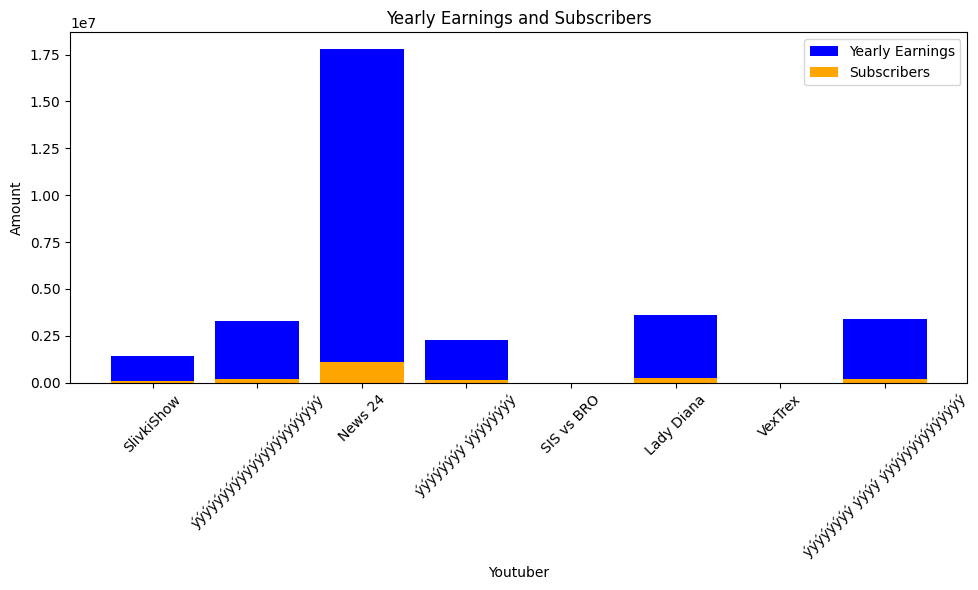

 74%|███████▍  | 1602/2160 [15:28<04:29,  2.07it/s]check
highest_yearly_earnings: 70200000.0, Subscribers: 4400000.0, Youtuber: BETER Bï¿½ï¿½
highest_yearly_earnings: 20400000.0, Subscribers: 1300000.0, Youtuber: netd mï¿½ï¿
highest_yearly_earnings: 5300000.0, Subscribers: 332400.0, Youtuber: tabii Urdu
highest_yearly_earnings: 212500.0, Subscribers: 13300.0, Youtuber: Oyuncak Avï¿


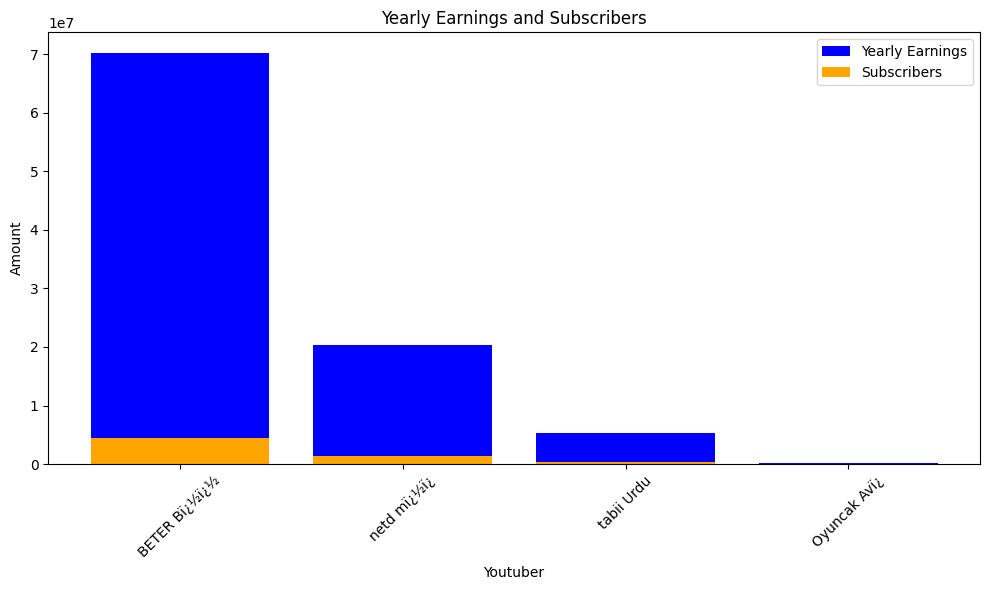

 74%|███████▍  | 1605/2160 [15:29<04:19,  2.14it/s]check
highest_yearly_earnings: 1.0, Subscribers: 0.07, Youtuber: Alan Walker
highest_yearly_earnings: 6300000.0, Subscribers: 391400.0, Youtuber: WorkpointOfficial
highest_yearly_earnings: 6800000.0, Subscribers: 422300.0, Youtuber: ýýýýýýýýýýýý one31
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Ch3Thailand
highest_yearly_earnings: 6300000.0, Subscribers: 390700.0, Youtuber: GMM GRAMMY OFFICIAL
highest_yearly_earnings: 8100000.0, Subscribers: 505800.0, Youtuber: GRAMMY GOLD OFFICIAL
highest_yearly_earnings: 2600000.0, Subscribers: 162400.0, Youtuber: RsiamMusic : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: zbing z.
highest_yearly_earnings: 11300000.0, Subscribers: 708000.0, Youtuber: AMARINTV : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 448400.0, Subscribers: 28000.0, Youtuber: Kaykai Salaider
highest_yearly_earnings: 4200000.0, Subscribers: 263300.0, You

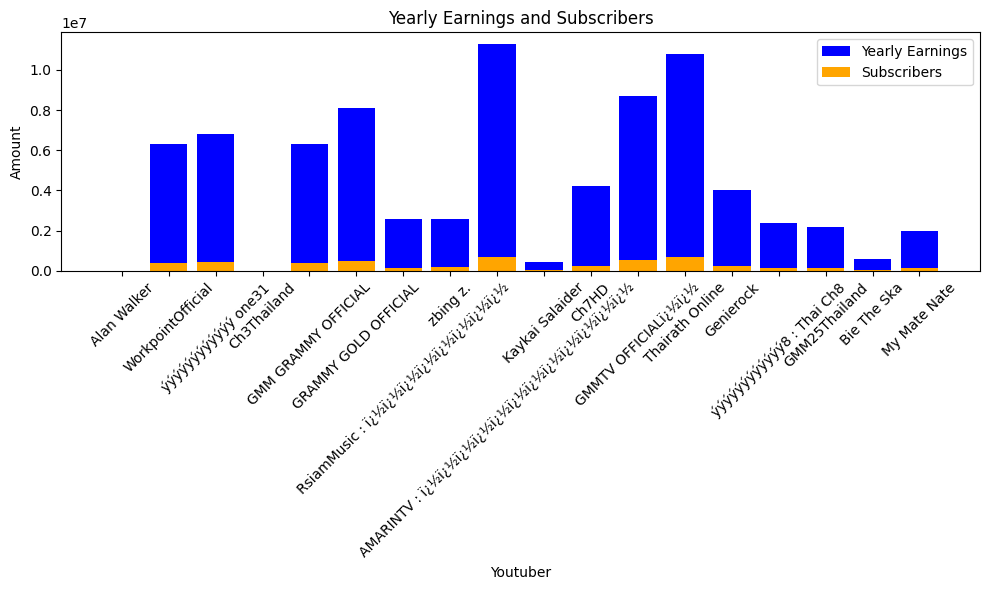

 74%|███████▍  | 1608/2160 [15:31<04:32,  2.02it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


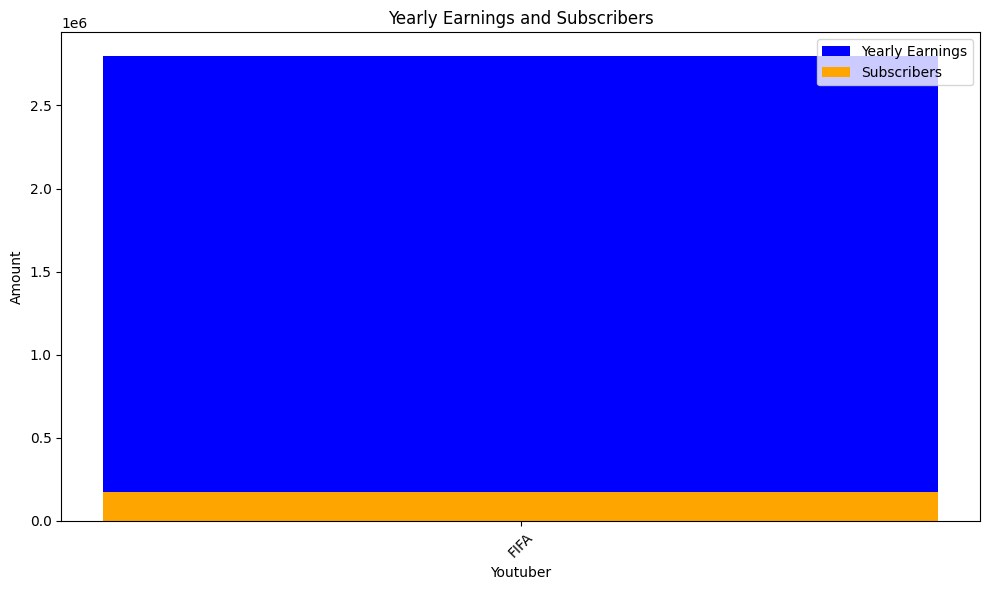

 75%|███████▍  | 1611/2160 [15:33<04:00,  2.28it/s]check
highest_yearly_earnings: 3900000.0, Subscribers: 243700.0, Youtuber: Avicii
highest_yearly_earnings: 23000000.0, Subscribers: 1400000.0, Youtuber: Panda Shorts
highest_yearly_earnings: 658000.0, Subscribers: 41100.0, Youtuber: Narins Beauty
highest_yearly_earnings: 185800.0, Subscribers: 11600.0, Youtuber: RobTopGames


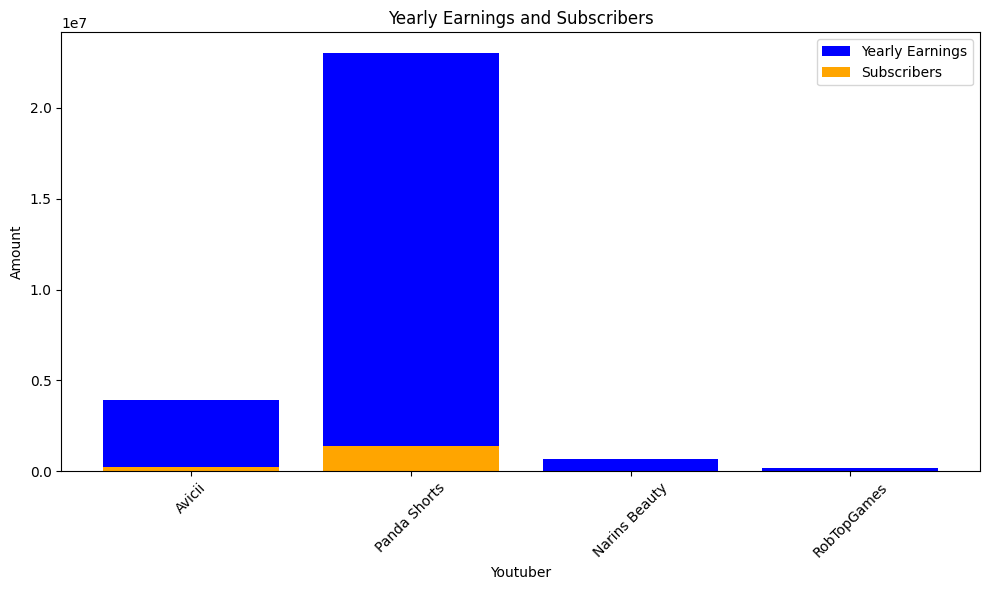

 75%|███████▍  | 1614/2160 [15:34<04:01,  2.26it/s]check
highest_yearly_earnings: 2600000.0, Subscribers: 162000.0, Youtuber: Duo Tiempo De Sol
highest_yearly_earnings: 783300.0, Subscribers: 49000.0, Youtuber: Little Baby Bum en Espaï¿½ï


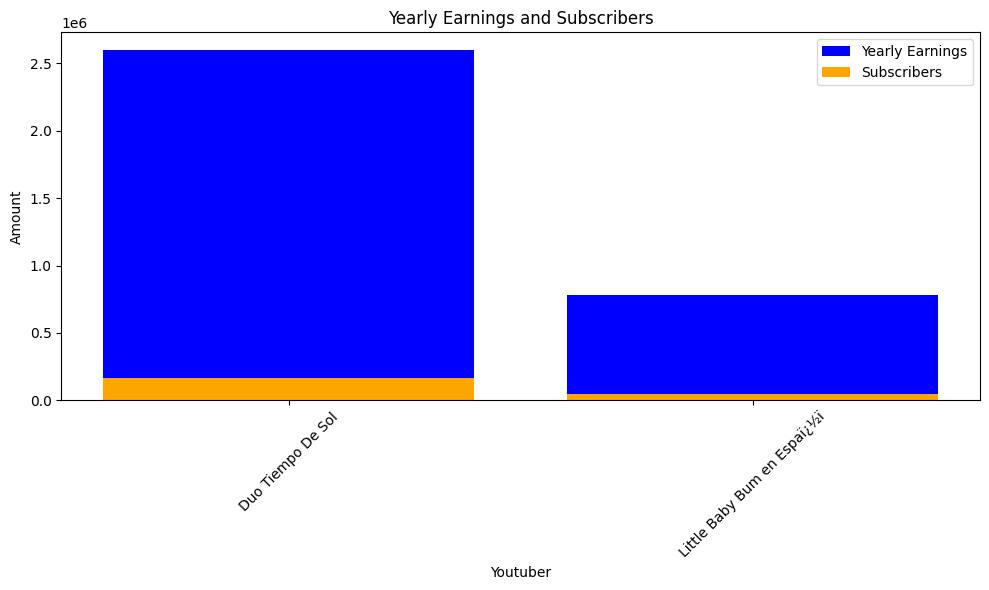

 75%|███████▍  | 1617/2160 [15:36<03:54,  2.32it/s]check
highest_yearly_earnings: 23900000.0, Subscribers: 1500000.0, Youtuber: BLACKPINK
highest_yearly_earnings: 8100000.0, Subscribers: 504900.0, Youtuber: BANGTANTV
highest_yearly_earnings: 28700000.0, Subscribers: 1800000.0, Youtuber: HYBE LABELS
highest_yearly_earnings: 14800000.0, Subscribers: 922900.0, Youtuber: JYP Entertainment
highest_yearly_earnings: 5100000.0, Subscribers: 316700.0, Youtuber: 1theK (ï¿½ï¿½ï¿½ï¿½ï
highest_yearly_earnings: 7600000.0, Subscribers: 475600.0, Youtuber: Mnet K-POP
highest_yearly_earnings: 5200000.0, Subscribers: 324000.0, Youtuber: KBS WORLD TV
highest_yearly_earnings: 3100000.0, Subscribers: 195000.0, Youtuber: officialpsy
highest_yearly_earnings: 163400000.0, Subscribers: 10200000.0, Youtuber: ýýýýýýýýý KIMPRO
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Jane ASMR ï¿½ï¿½
highest_yearly_earnings: 532700.0, Subscribers: 33300.0, Youtuber: JFlaMusic
highest_yearly_earnings: 2000000.0, S

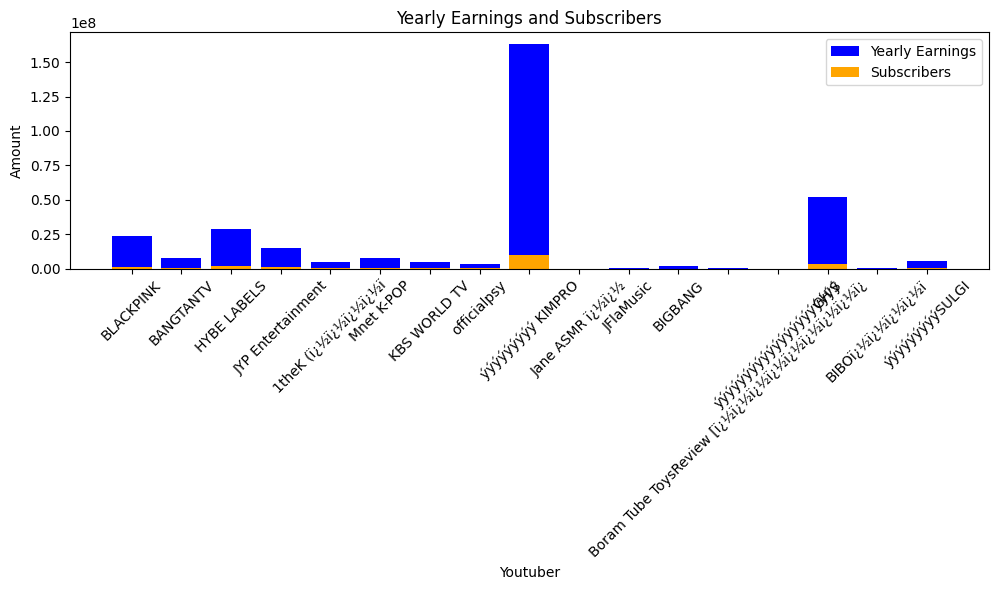

 75%|███████▌  | 1620/2160 [15:38<04:25,  2.04it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Sandeep Maheshwari
highest_yearly_earnings: 5600000.0, Subscribers: 351600.0, Youtuber: LEGO
highest_yearly_earnings: 45100.0, Subscribers: 2800.0, Youtuber: MY FAMILY


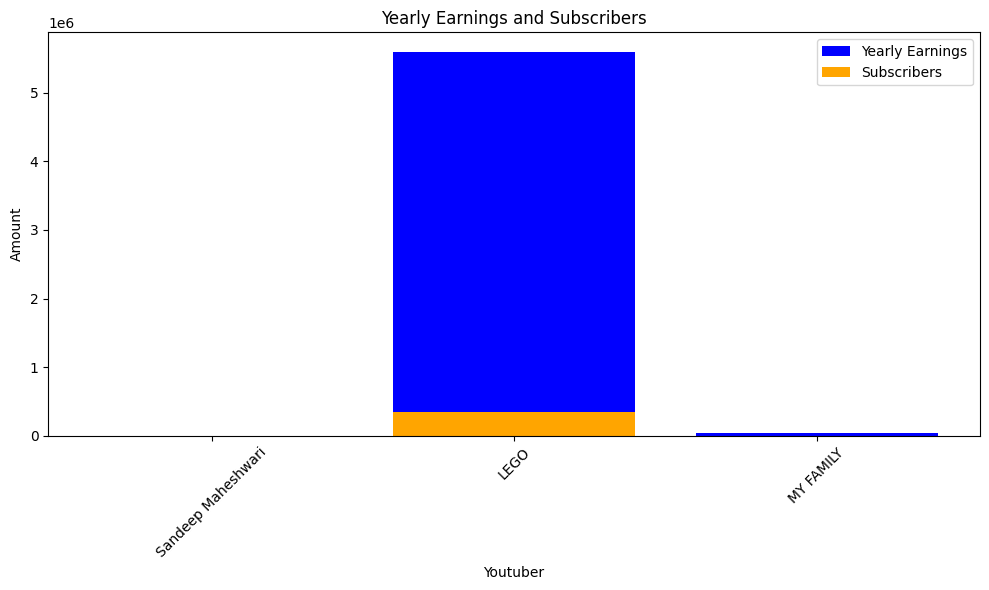

 75%|███████▌  | 1623/2160 [15:40<04:34,  1.96it/s]check
highest_yearly_earnings: 76300.0, Subscribers: 4800.0, Youtuber: shfa
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: 1MILLION Dance Studio
highest_yearly_earnings: 3500000.0, Subscribers: 221500.0, Youtuber: mmoshaya
highest_yearly_earnings: 2100000.0, Subscribers: 129000.0, Youtuber: ýýýýýýýý ýýýýýýýýýý ýýýýýýýýýý | Arab Games Network
highest_yearly_earnings: 4400000.0, Subscribers: 272700.0, Youtuber: Katakit Baby TV
highest_yearly_earnings: 6500000.0, Subscribers: 405100.0, Youtuber: ýýýýýýýý ýý ýýýýýýýý
highest_yearly_earnings: 129300.0, Subscribers: 8100.0, Youtuber: ýýýýýýýýýý ýýýýýýýýýýýý
highest_yearly_earnings: 224300.0, Subscribers: 14000.0, Youtuber: ýýýýýýýýýýýý ýýýýýýýýýýýý I ýýýýýý ýý ýýýýýýýýýý
highest_yearly_earnings: 3400000.0, Subscribers: 212100.0, Youtuber: BanderitaX


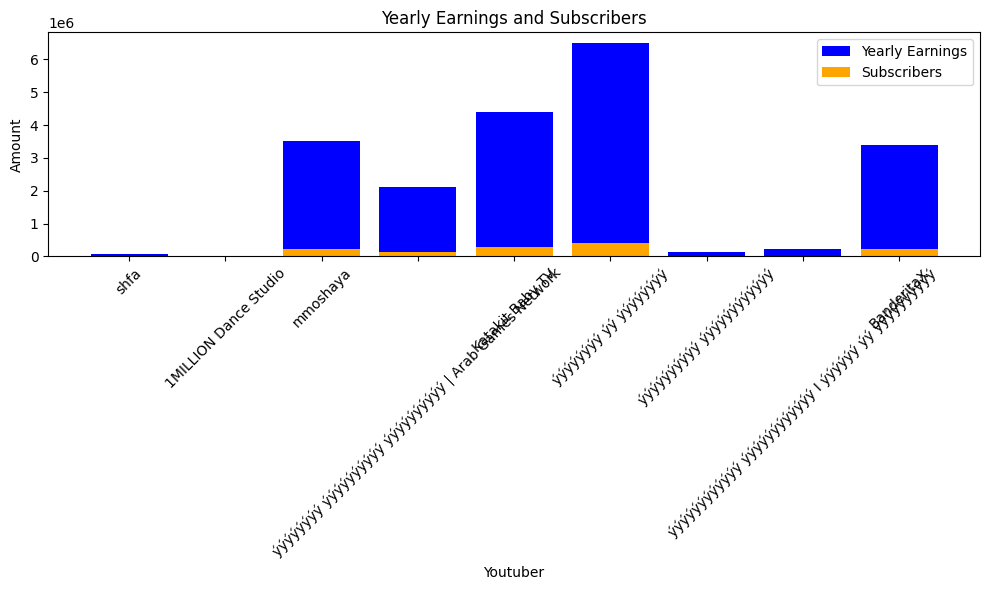

 75%|███████▌  | 1626/2160 [15:42<05:15,  1.69it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


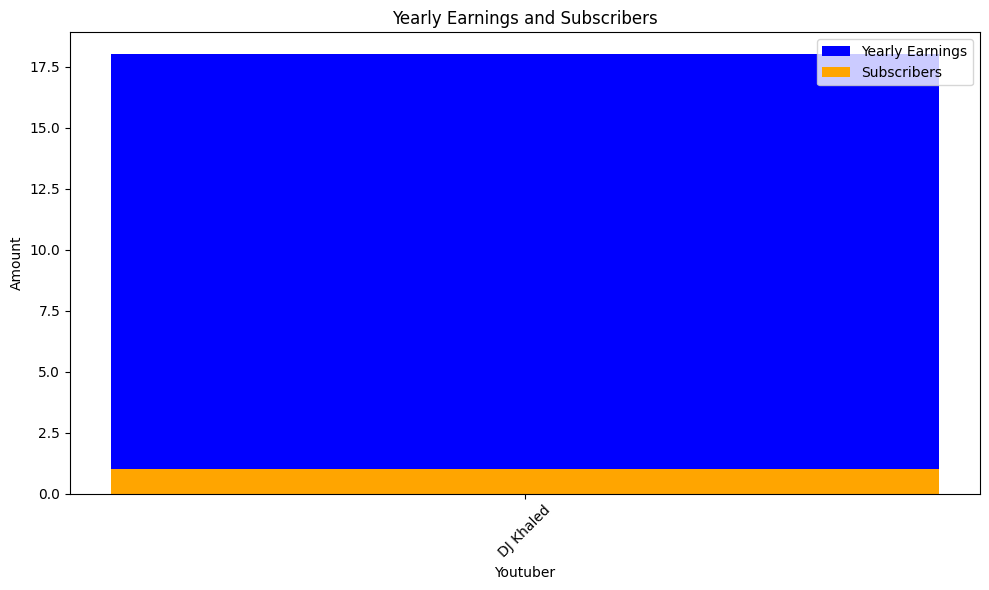

 75%|███████▌  | 1629/2160 [15:45<07:50,  1.13it/s]check
highest_yearly_earnings: 14600000.0, Subscribers: 911300.0, Youtuber: ýýýýýýýý ýý ýýýýýýýýýýýýýý


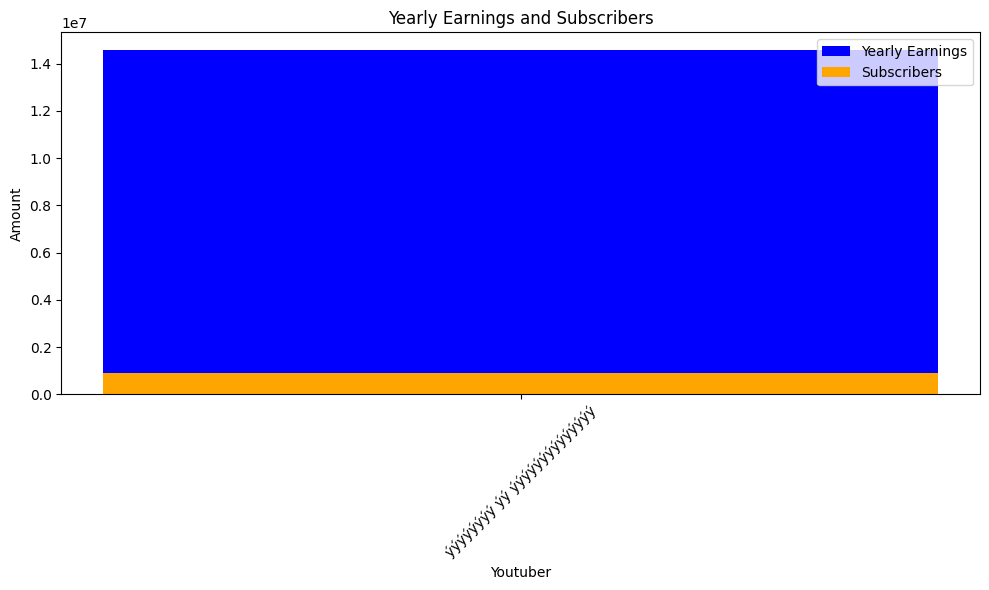

 76%|███████▌  | 1632/2160 [15:47<05:05,  1.73it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529900.0, Youtuber: ABS-CBN Entertainment
highest_yearly_earnings: 38300000.0, Subscribers: 2400000.0, Youtuber: GMA  Network
highest_yearly_earnings: 7800000.0, Subscribers: 489400.0, Youtuber: Raffy Tulfo in Action
highest_yearly_earnings: 6800000.0, Subscribers: 427000.0, Youtuber: GMA Public  Affairs
highest_yearly_earnings: 723800.0, Subscribers: 45200.0, Youtuber: Ivana Alawi
highest_yearly_earnings: 479000.0, Subscribers: 29900.0, Youtuber: Niana Guerrero
highest_yearly_earnings: 594000.0, Subscribers: 37100.0, Youtuber: Ranz Kyle
highest_yearly_earnings: 8700000.0, Subscribers: 544900.0, Youtuber: ABS-CBN News
highest_yearly_earnings: 3000000.0, Subscribers: 188000.0, Youtuber: Wish 107.5
highest_yearly_earnings: 580200.0, Subscribers: 36300.0, Youtuber: Zeinab Harake
highest_yearly_earnings: 5500000.0, Subscribers: 346400.0, Youtuber: GMA Integrated News
highest_yearly_ear

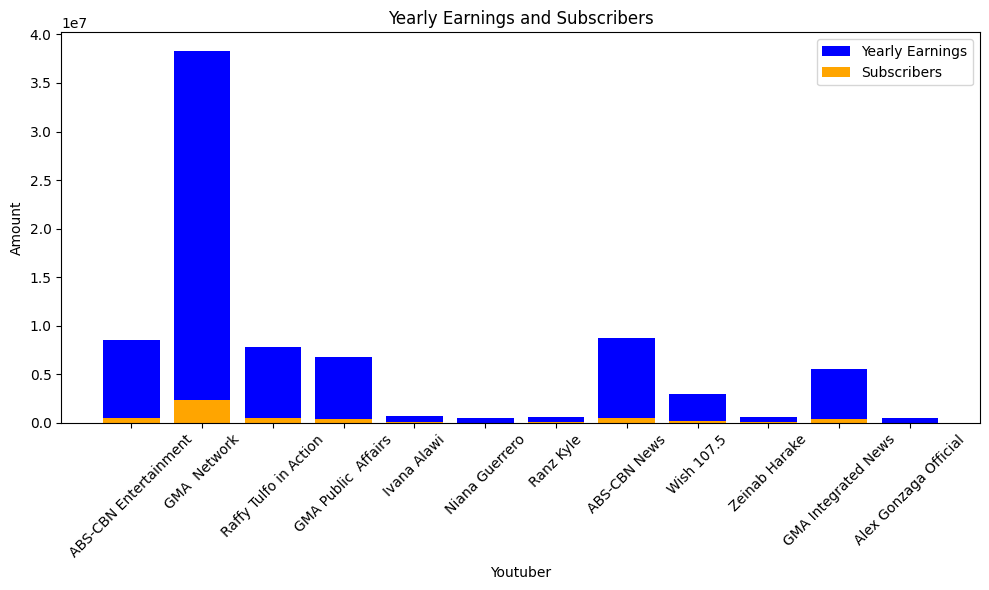

 76%|███████▌  | 1635/2160 [15:48<04:32,  1.93it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


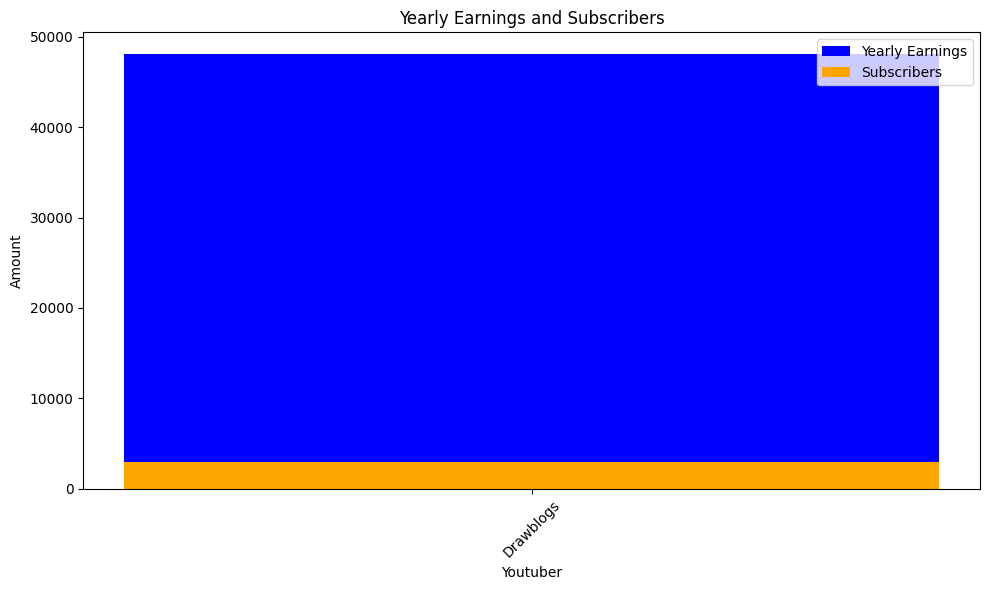

 76%|███████▌  | 1638/2160 [15:50<03:55,  2.21it/s]check
highest_yearly_earnings: 64200000.0, Subscribers: 4000000.0, Youtuber: HAR PAL GEO
highest_yearly_earnings: 55200000.0, Subscribers: 3400000.0, Youtuber: ARY Digital HD
highest_yearly_earnings: 32900000.0, Subscribers: 2100000.0, Youtuber: HUM TV
highest_yearly_earnings: 4800000.0, Subscribers: 300200.0, Youtuber: Geo News
highest_yearly_earnings: 28.0, Subscribers: 2.0, Youtuber: Wolfoo Channel
highest_yearly_earnings: 419.0, Subscribers: 26.0, Youtuber: Quantum Tech HD


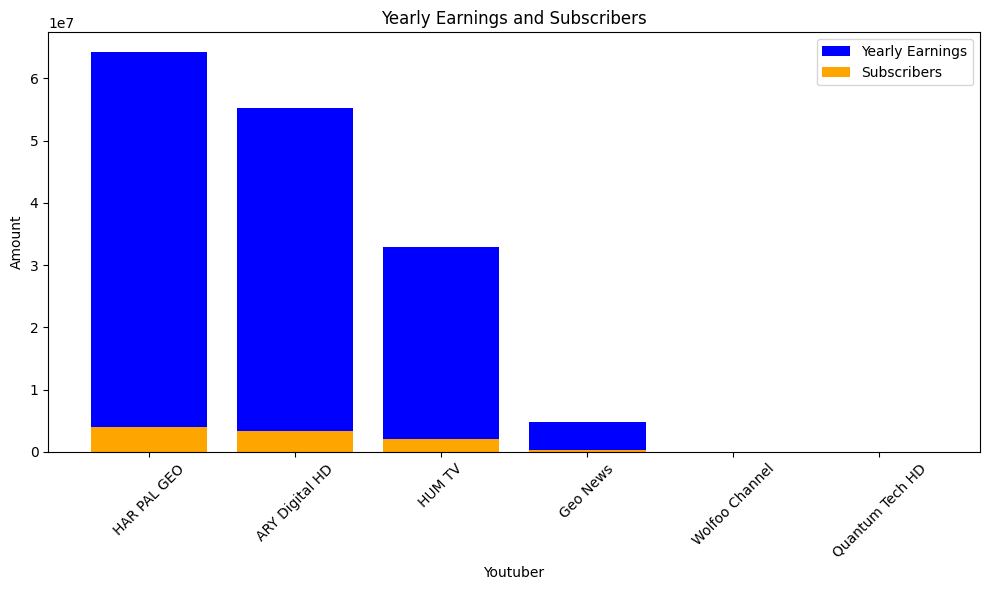

 76%|███████▌  | 1641/2160 [15:51<03:53,  2.23it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300100.0, Youtuber: Spinnin' Records
highest_yearly_earnings: 1700000.0, Subscribers: 107800.0, Youtuber: NikkieTutorials
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: ýýýýýýýý/Atro


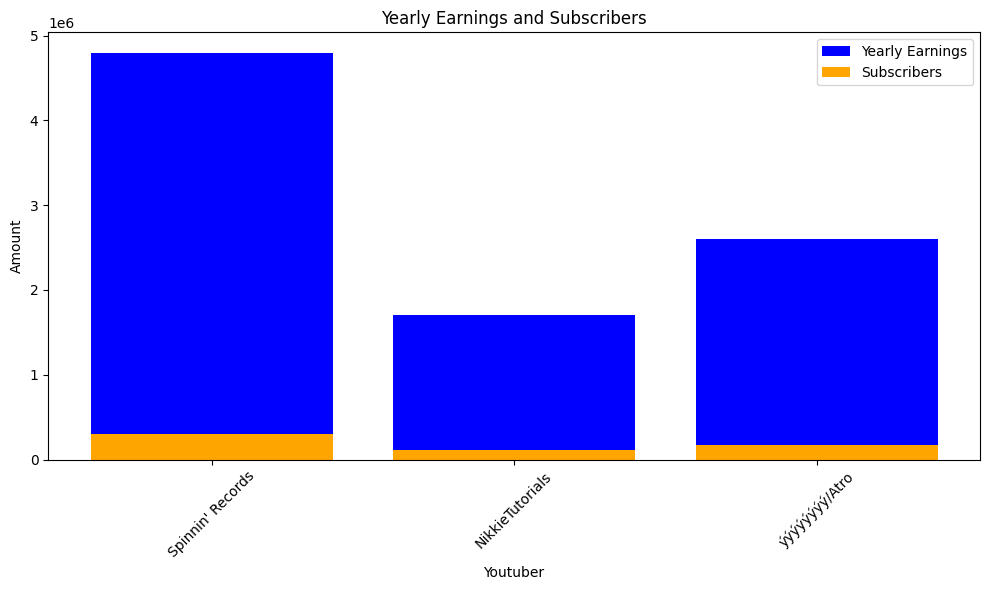

 76%|███████▌  | 1644/2160 [15:53<04:03,  2.12it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


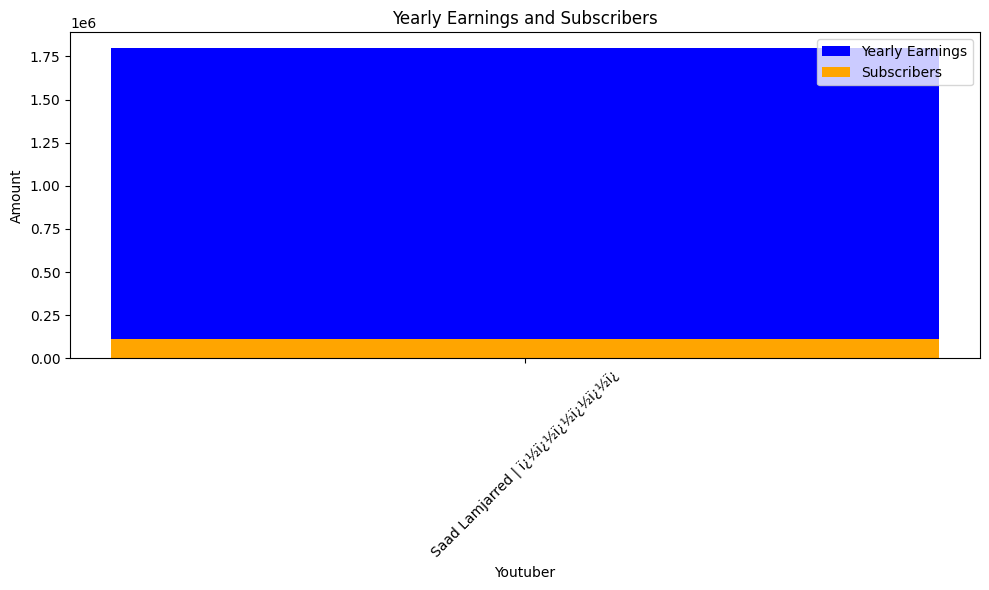

 76%|███████▋  | 1647/2160 [15:55<04:08,  2.06it/s]check
highest_yearly_earnings: 6600000.0, Subscribers: 410500.0, Youtuber: BabyBus - Canciones Infantiles & Videos para Niï¿½ï
highest_yearly_earnings: 6700000.0, Subscribers: 421200.0, Youtuber: Little Angel Espaï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 4300000.0, Subscribers: 270000.0, Youtuber: Blippi Espaï¿½ï


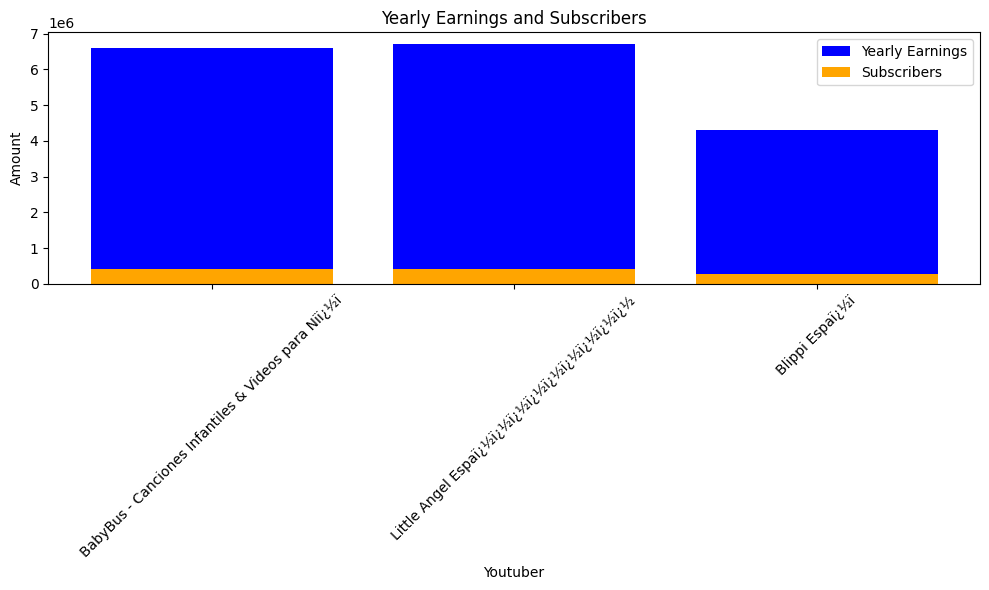

 76%|███████▋  | 1650/2160 [15:57<04:19,  1.96it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


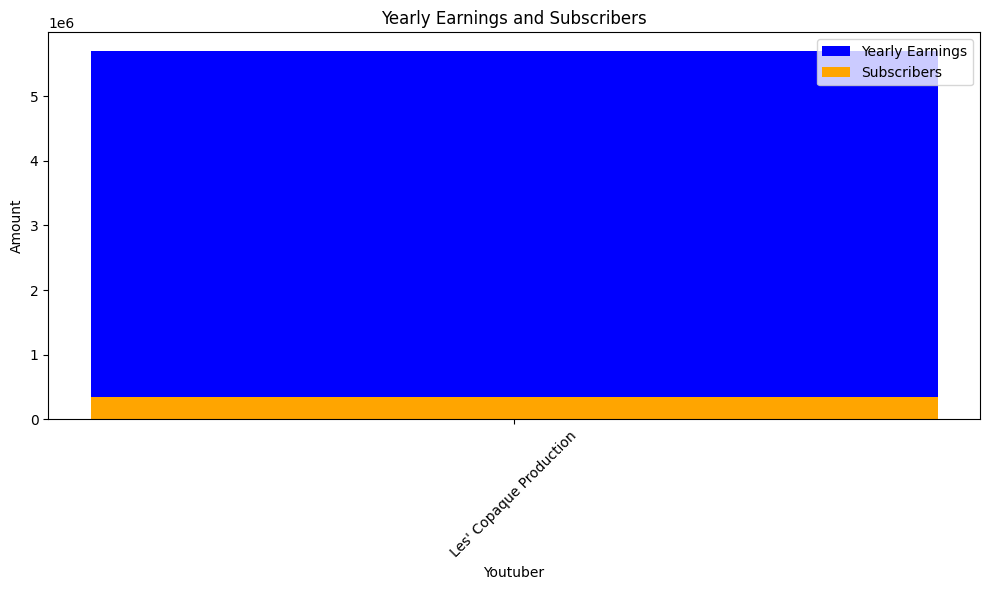

 77%|███████▋  | 1653/2160 [15:59<04:26,  1.90it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


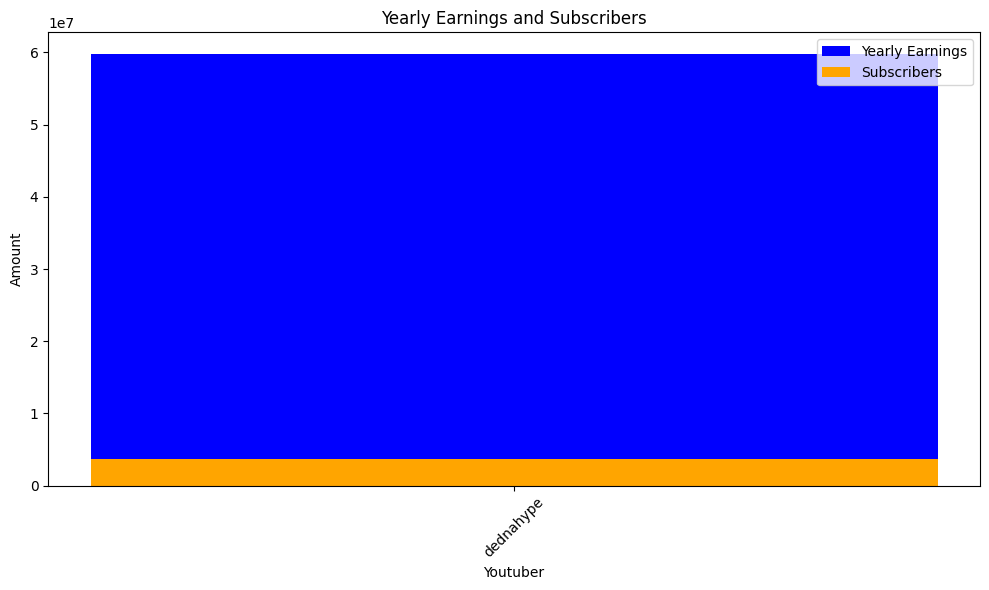

 77%|███████▋  | 1656/2160 [16:01<04:11,  2.00it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


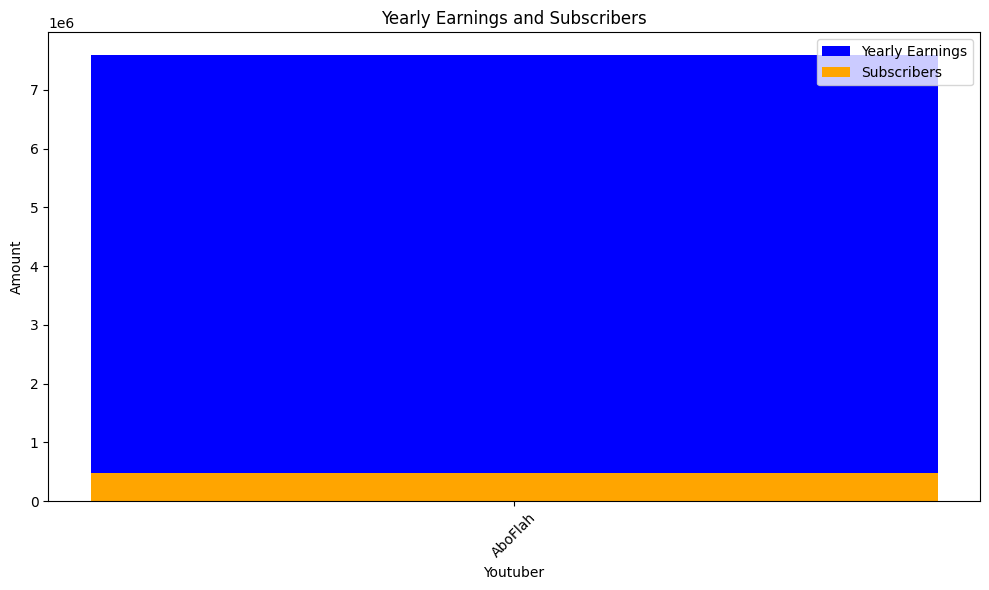

 77%|███████▋  | 1659/2160 [16:02<03:50,  2.17it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


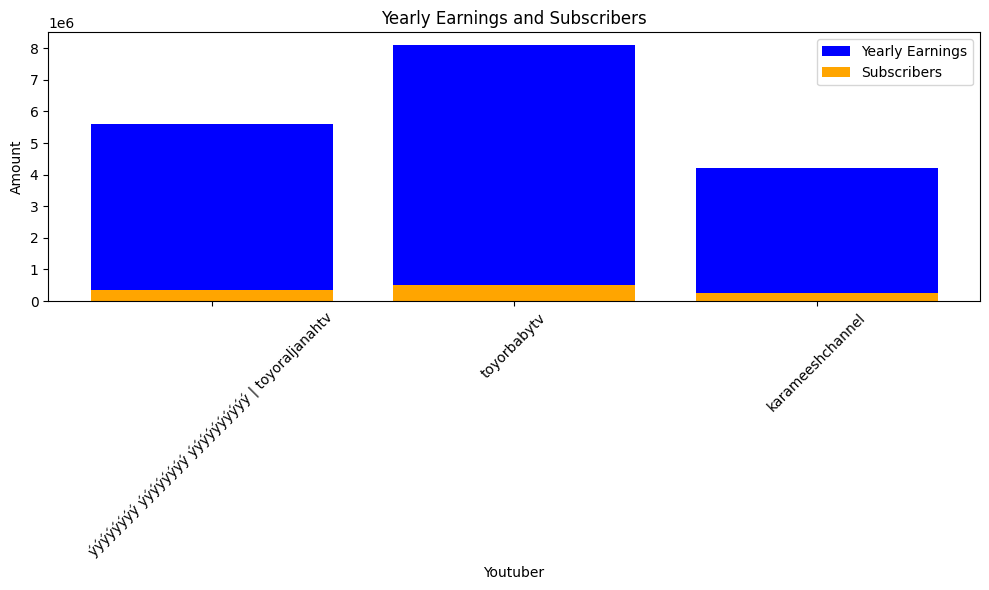

 77%|███████▋  | 1662/2160 [16:04<03:52,  2.14it/s]check
highest_yearly_earnings: 1900000.0, Subscribers: 117600.0, Youtuber: PewDiePie
highest_yearly_earnings: 34600000.0, Subscribers: 2200000.0, Youtuber: Junya.ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 34100000.0, Subscribers: 2100000.0, Youtuber: Sagawa /ï¿½ï¿½ï¿½
highest_yearly_earnings: 13600000.0, Subscribers: 847100.0, Youtuber: ISSEI / ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 119.0, Subscribers: 7.0, Youtuber: Bayashi TV


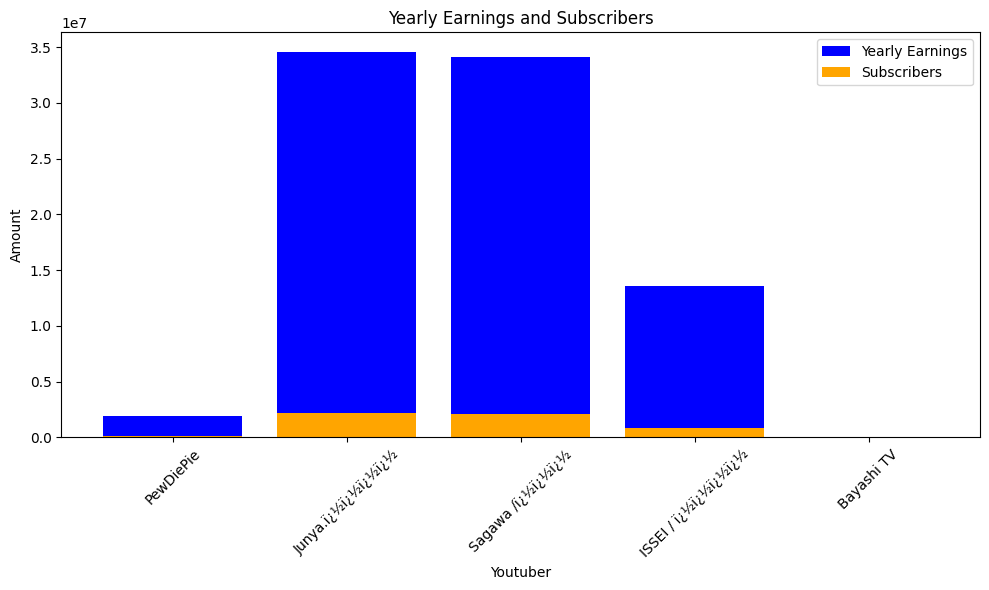

 77%|███████▋  | 1665/2160 [16:06<03:52,  2.13it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


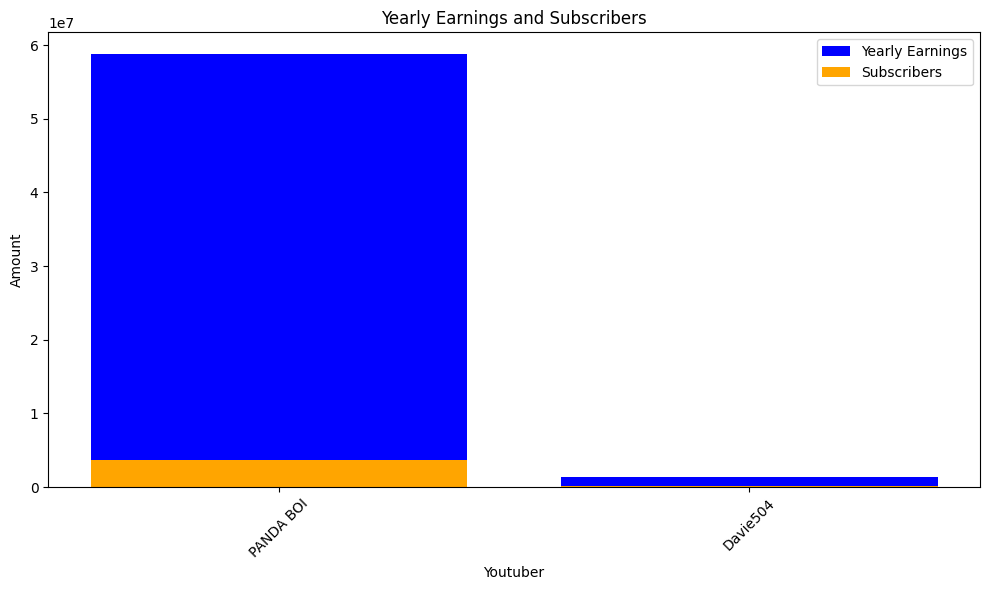

 77%|███████▋  | 1668/2160 [16:07<03:41,  2.22it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


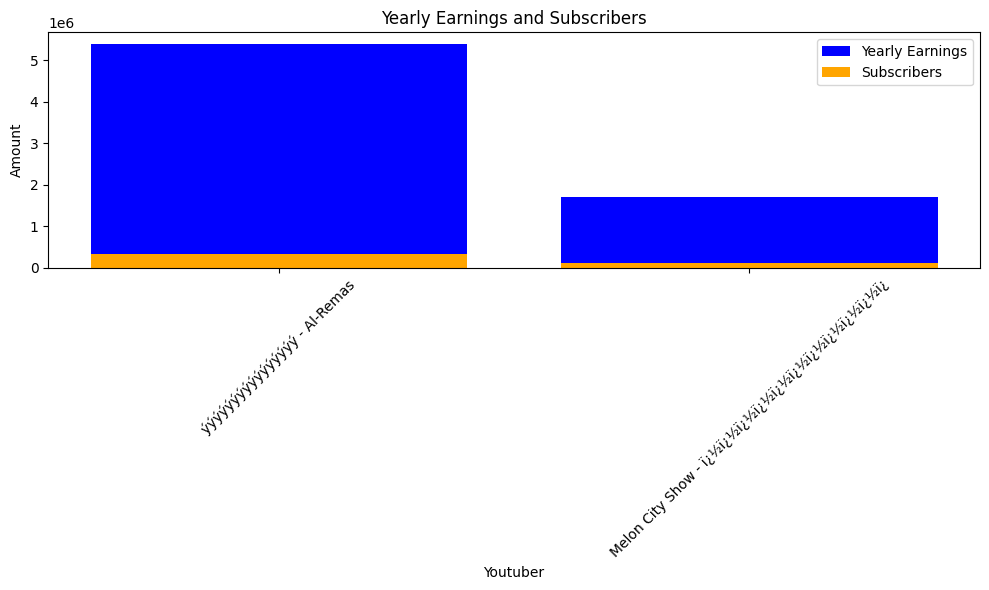

 77%|███████▋  | 1671/2160 [16:09<03:32,  2.30it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 338300.0, Youtuber: BabyBus - Cerita & Lagu Anak-anak


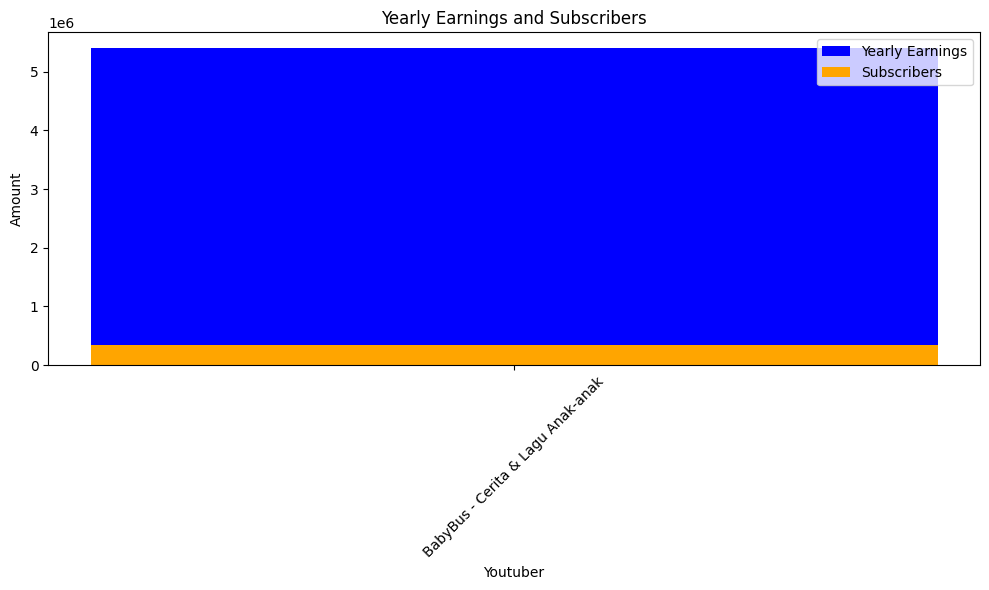

 78%|███████▊  | 1674/2160 [16:10<03:39,  2.22it/s]check
highest_yearly_earnings: 20200000.0, Subscribers: 1300000.0, Youtuber: ChuChu TV Nursery Rhymes & Kids Songs
highest_yearly_earnings: 39200000.0, Subscribers: 2400000.0, Youtuber: Infobells - Hindi
highest_yearly_earnings: 6500000.0, Subscribers: 408300.0, Youtuber: CVS 3D Rhymes & Kids Songs
highest_yearly_earnings: 5300000.0, Subscribers: 329500.0, Youtuber: infobells - Tamil
highest_yearly_earnings: 13800000.0, Subscribers: 864300.0, Youtuber: infobells - Telugu
highest_yearly_earnings: 1400000.0, Subscribers: 85800.0, Youtuber: Dr. Vivek Bindra: Motivational Speaker
highest_yearly_earnings: 5400000.0, Subscribers: 340300.0, Youtuber: Kiddiestv Hindi - Nursery Rhymes & Kids Songs
highest_yearly_earnings: 685800.0, Subscribers: 42900.0, Youtuber: wifistudy
highest_yearly_earnings: 1200000.0, Subscribers: 72200.0, Youtuber: Dear Sir
highest_yearly_earnings: 8100000.0, Subscribers: 503700.0, Youtuber: Infobells Bangla
highest_yea

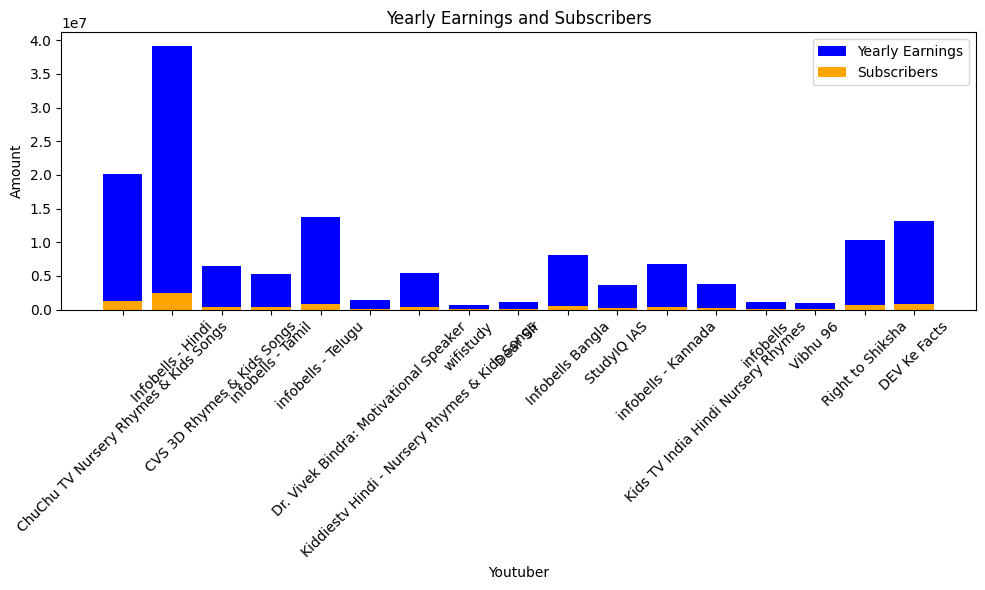

 78%|███████▊  | 1677/2160 [16:13<04:25,  1.82it/s]check
highest_yearly_earnings: 1400000.0, Subscribers: 87800.0, Youtuber: Kurzgesagt ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


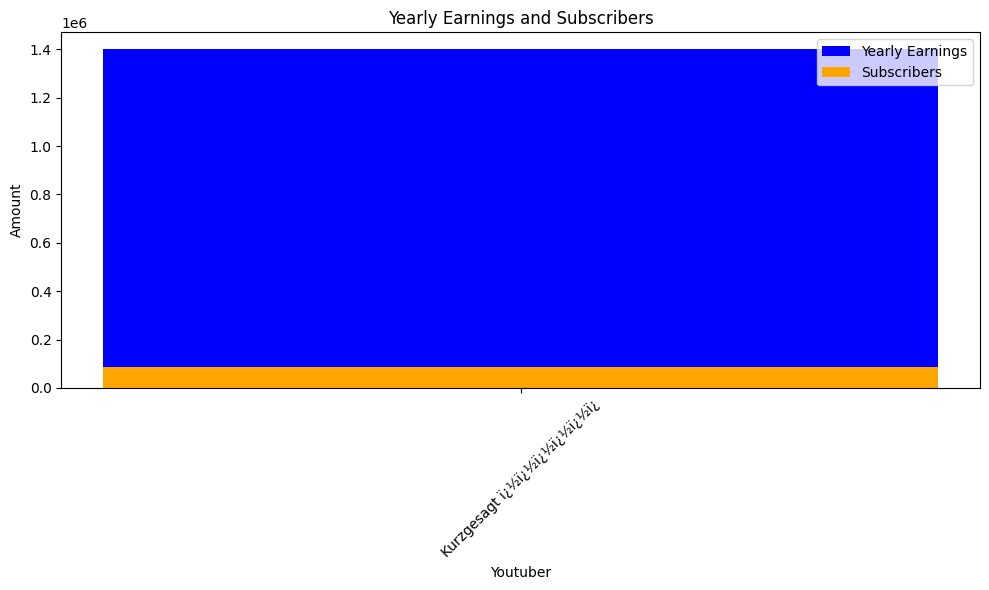

 78%|███████▊  | 1680/2160 [16:14<04:11,  1.91it/s]check
highest_yearly_earnings: 35.0, Subscribers: 2.0, Youtuber: Smile Family
highest_yearly_earnings: 2300000.0, Subscribers: 144300.0, Youtuber: SQUEEZIE
highest_yearly_earnings: 37.0, Subscribers: 2.0, Youtuber: FitDance
highest_yearly_earnings: 548000.0, Subscribers: 34300.0, Youtuber: Cyprien
highest_yearly_earnings: 1500000.0, Subscribers: 91400.0, Youtuber: Lofi Girl


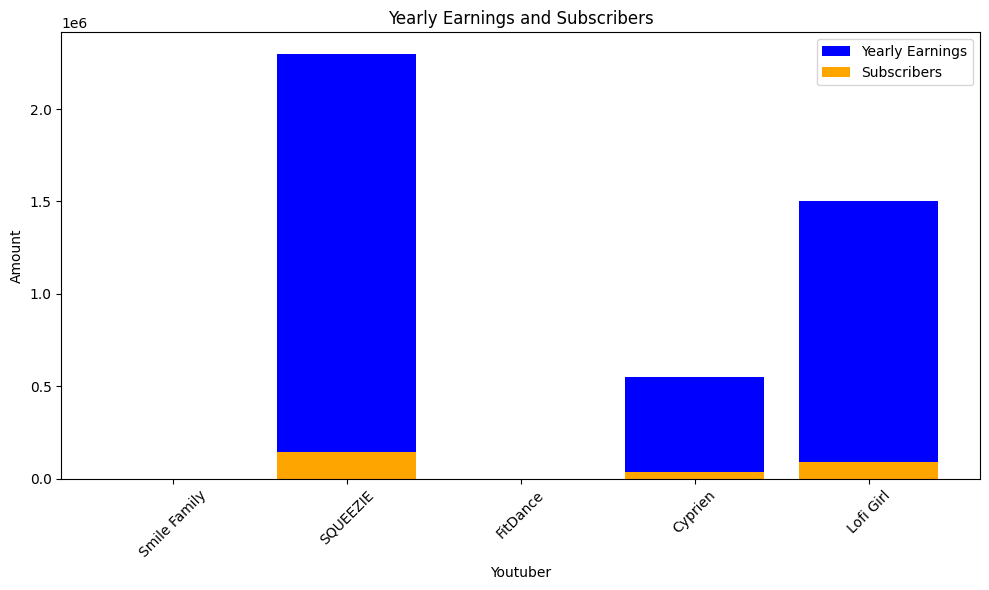

 78%|███████▊  | 1683/2160 [16:16<04:18,  1.85it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


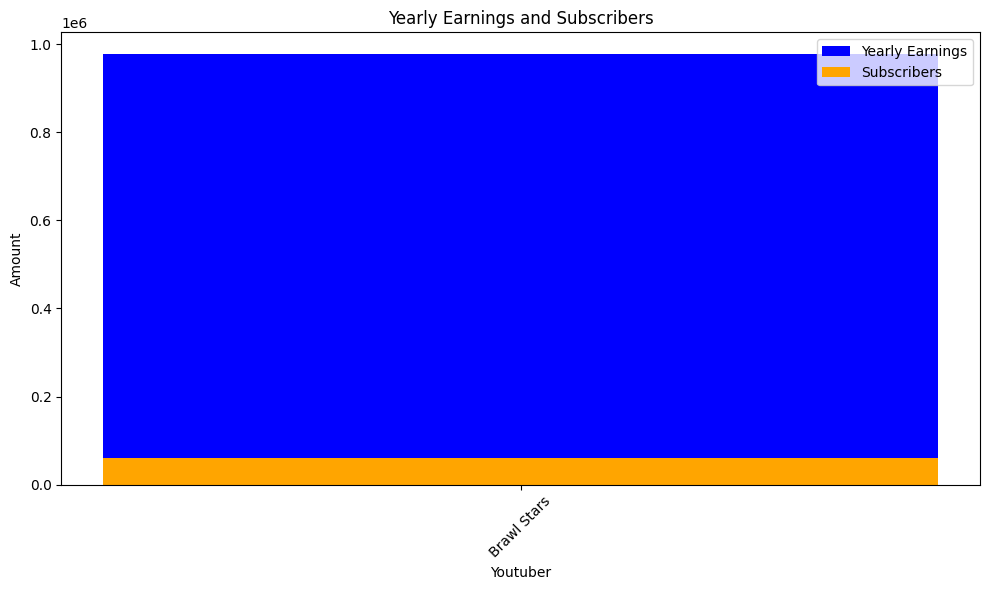

 78%|███████▊  | 1686/2160 [16:18<03:41,  2.14it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


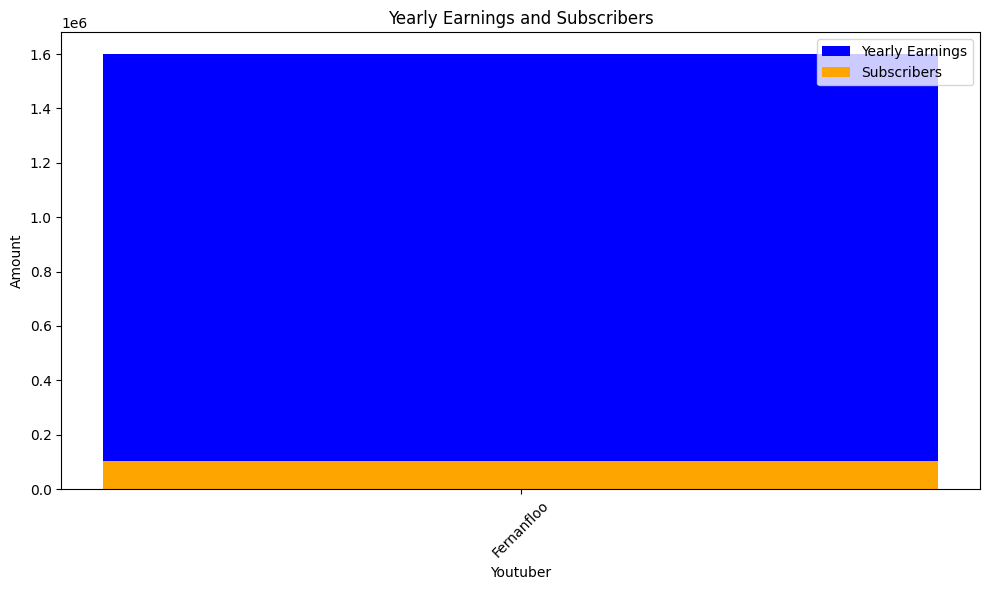

 78%|███████▊  | 1689/2160 [16:19<03:26,  2.29it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


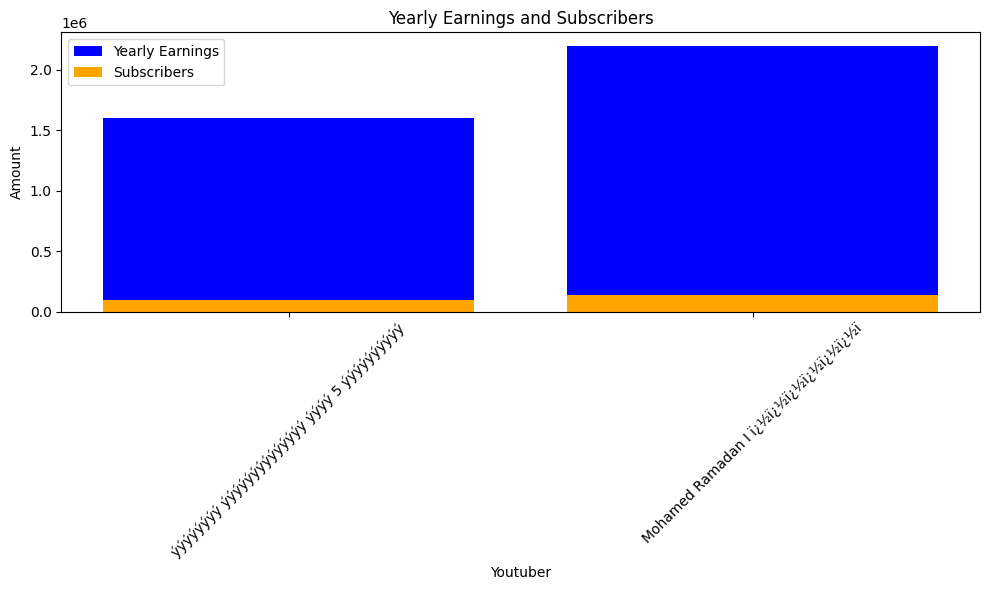

 78%|███████▊  | 1692/2160 [16:21<03:20,  2.33it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


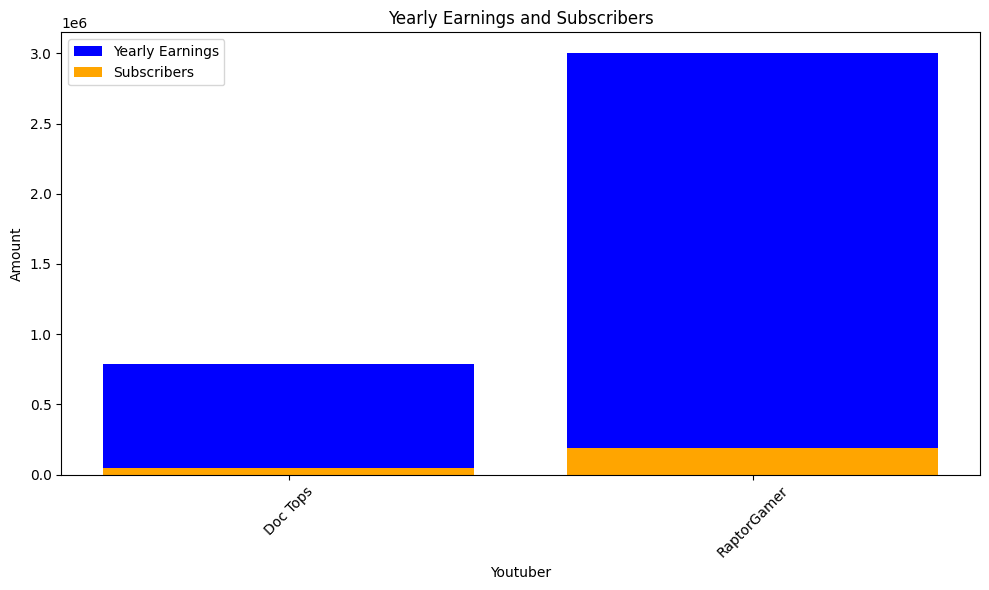

 78%|███████▊  | 1695/2160 [16:23<03:24,  2.27it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


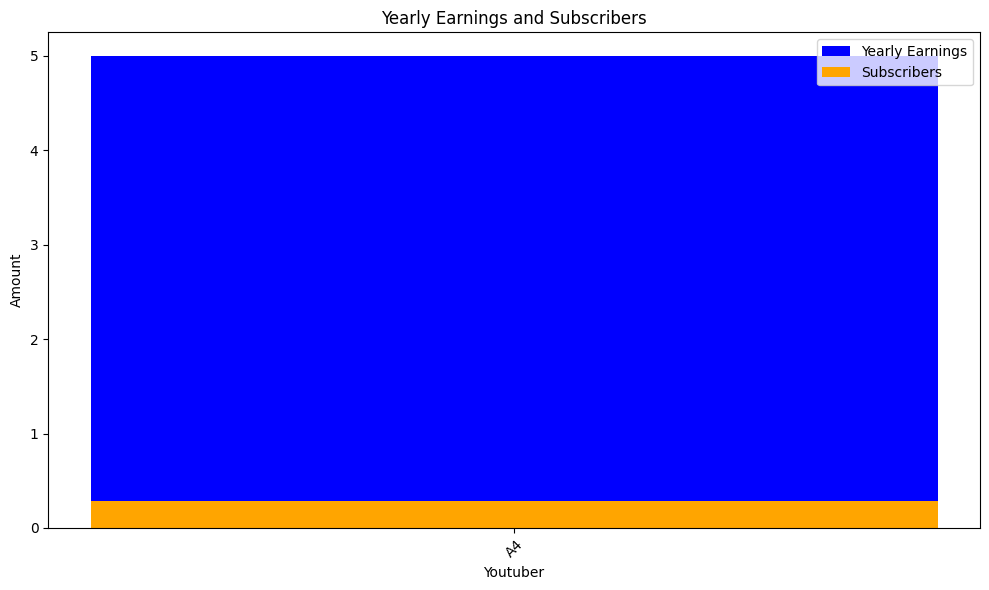

 79%|███████▊  | 1698/2160 [16:24<03:22,  2.29it/s]check
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Shakira
highest_yearly_earnings: 6200000.0, Subscribers: 386100.0, Youtuber: J Balvin
highest_yearly_earnings: 22400000.0, Subscribers: 1400000.0, Youtuber: KAROL G
highest_yearly_earnings: 8300000.0, Subscribers: 521500.0, Youtuber: toycantando
highest_yearly_earnings: 1200000.0, Subscribers: 73100.0, Youtuber: enchufetv
highest_yearly_earnings: 13600000.0, Subscribers: 852400.0, Youtuber: Anuel AA
highest_yearly_earnings: 12700000.0, Subscribers: 791600.0, Youtuber: Ami Rodriguez
highest_yearly_earnings: 2900000.0, Subscribers: 179700.0, Youtuber: Camilo
highest_yearly_earnings: 11000000.0, Subscribers: 686700.0, Youtuber: Codiscos
highest_yearly_earnings: 4100000.0, Subscribers: 258800.0, Youtuber: jbalvinVEVO
highest_yearly_earnings: 15700000.0, Subscribers: 982800.0, Youtuber: Go Ami Go!


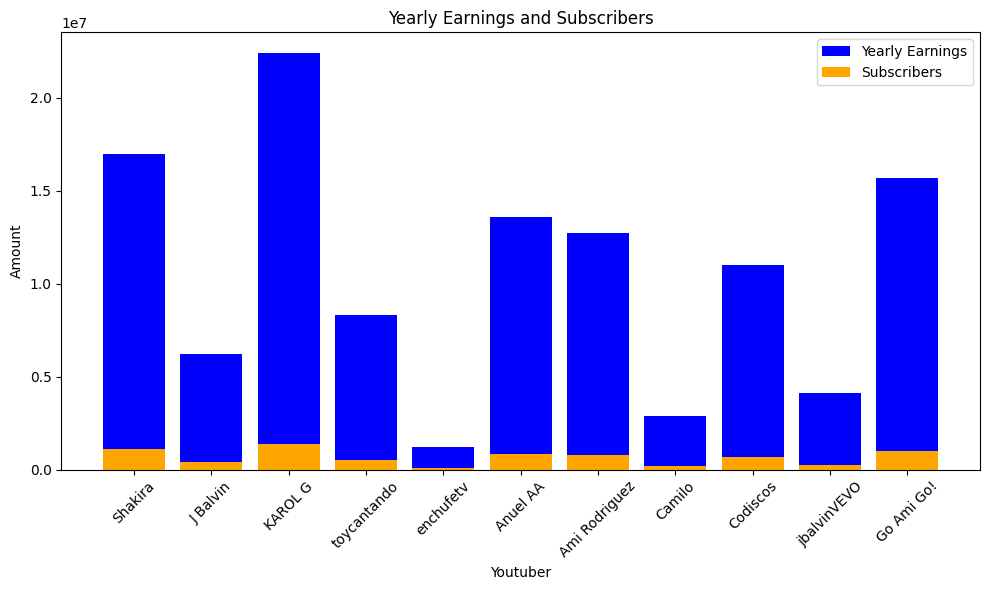

 79%|███████▉  | 1701/2160 [16:26<03:29,  2.19it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


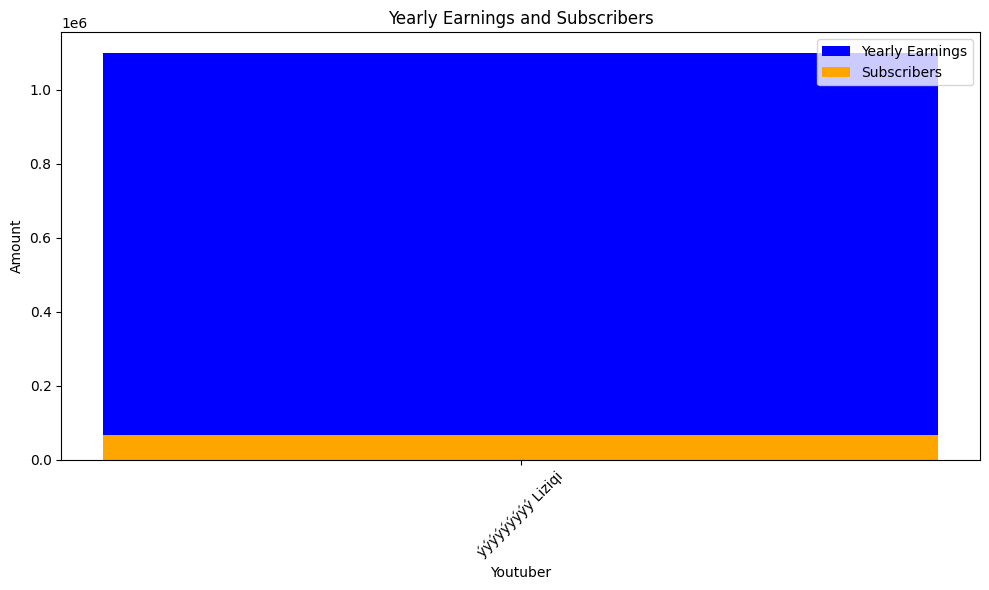

 79%|███████▉  | 1704/2160 [16:27<03:28,  2.19it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 199200.0, Youtuber: JuegaGerman
highest_yearly_earnings: 2.0, Subscribers: 0.15, Youtuber: invictor
highest_yearly_earnings: 4800000.0, Subscribers: 300600.0, Youtuber: DeGoBooM


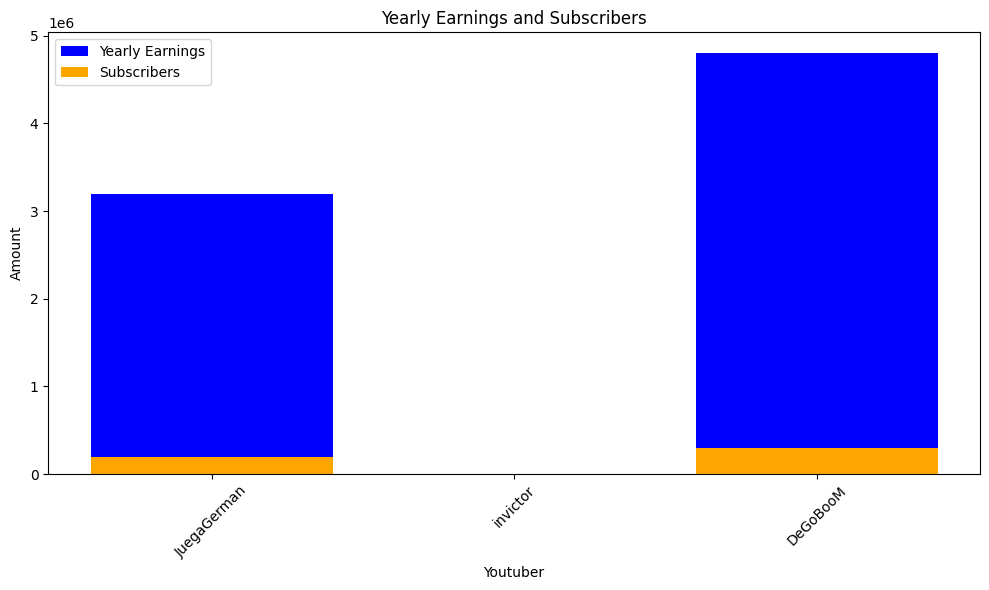

 79%|███████▉  | 1707/2160 [16:29<03:19,  2.27it/s]check
highest_yearly_earnings: 26900000.0, Subscribers: 1700000.0, Youtuber: Super Simple Songs - Kids Songs


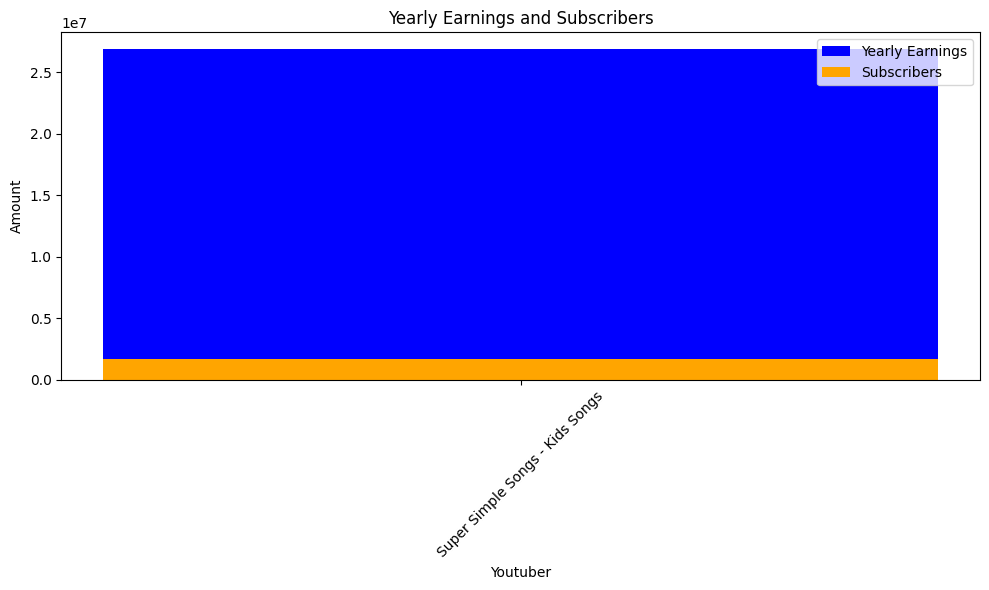

 79%|███████▉  | 1710/2160 [16:31<03:28,  2.16it/s]check
highest_yearly_earnings: 7000000.0, Subscribers: 436400.0, Youtuber: Little Angel - Mï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½


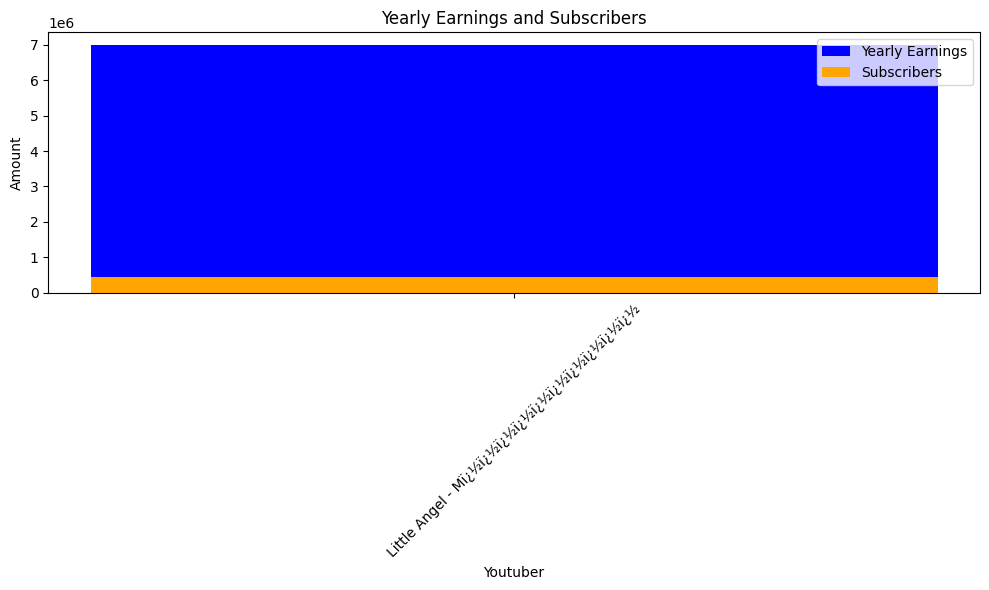

 79%|███████▉  | 1713/2160 [16:33<03:37,  2.05it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


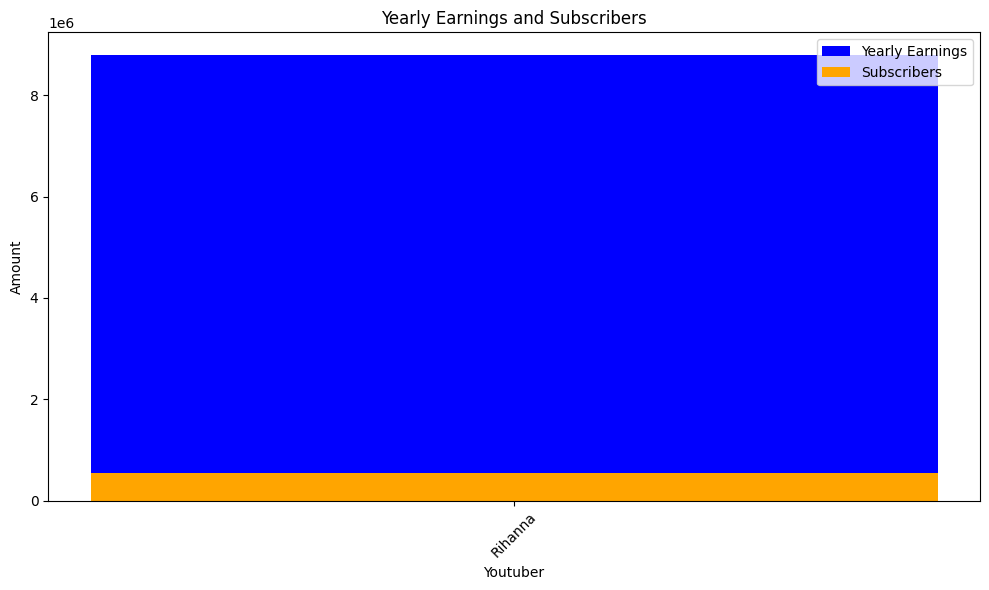

 79%|███████▉  | 1716/2160 [16:35<04:36,  1.61it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


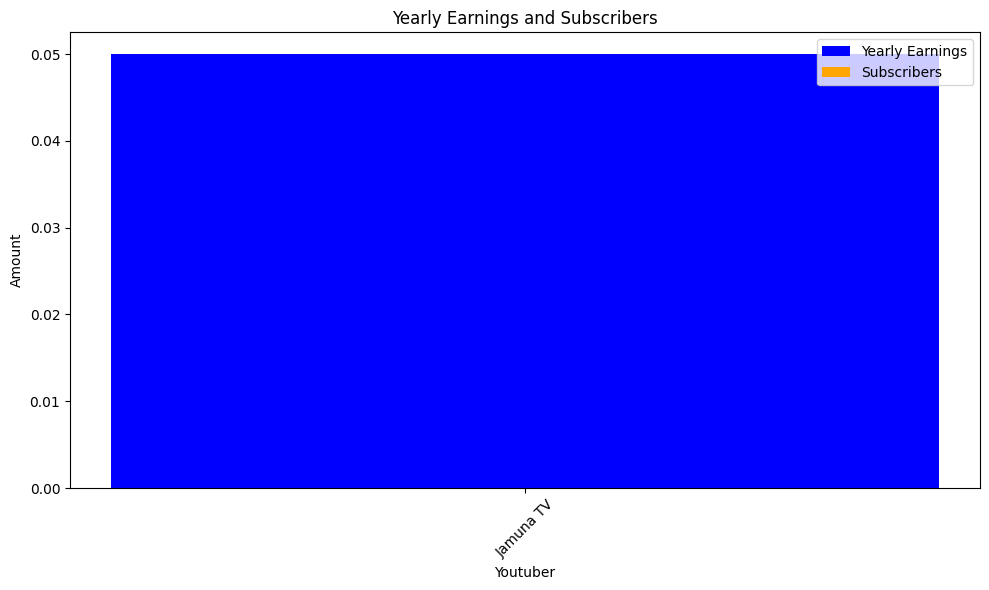

 80%|███████▉  | 1719/2160 [16:37<03:29,  2.10it/s]check
highest_yearly_earnings: 6100000.0, Subscribers: 382300.0, Youtuber: Bounce Patrol - Kids Songs
highest_yearly_earnings: 1100000.0, Subscribers: 69800.0, Youtuber: Chloe Ting
highest_yearly_earnings: 1300000.0, Subscribers: 78200.0, Youtuber: LazarBeam
highest_yearly_earnings: 18800000.0, Subscribers: 1200000.0, Youtuber: How Ridiculous
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: The Game Theorists
highest_yearly_earnings: 745200.0, Subscribers: 46600.0, Youtuber: HowToBasic
highest_yearly_earnings: 1.0, Subscribers: 0.08, Youtuber: Jason Vlogs
highest_yearly_earnings: 1000000.0, Subscribers: 63200.0, Youtuber: Lachlan
highest_yearly_earnings: 7.0, Subscribers: 0.44, Youtuber: Trap City


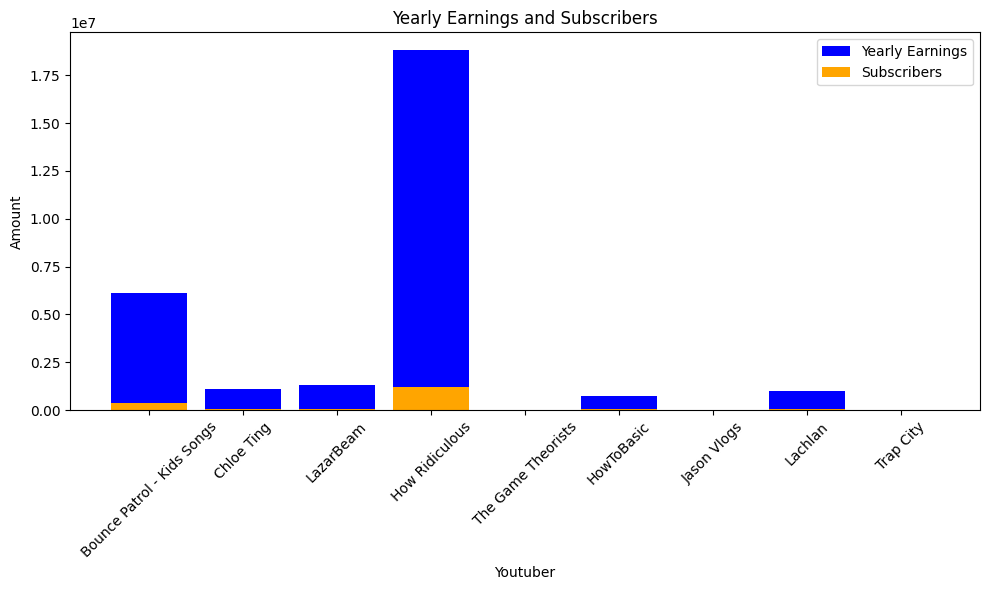

 80%|███████▉  | 1722/2160 [16:38<03:25,  2.13it/s]check
highest_yearly_earnings: 4000000.0, Subscribers: 251100.0, Youtuber: El Reino a Jugar


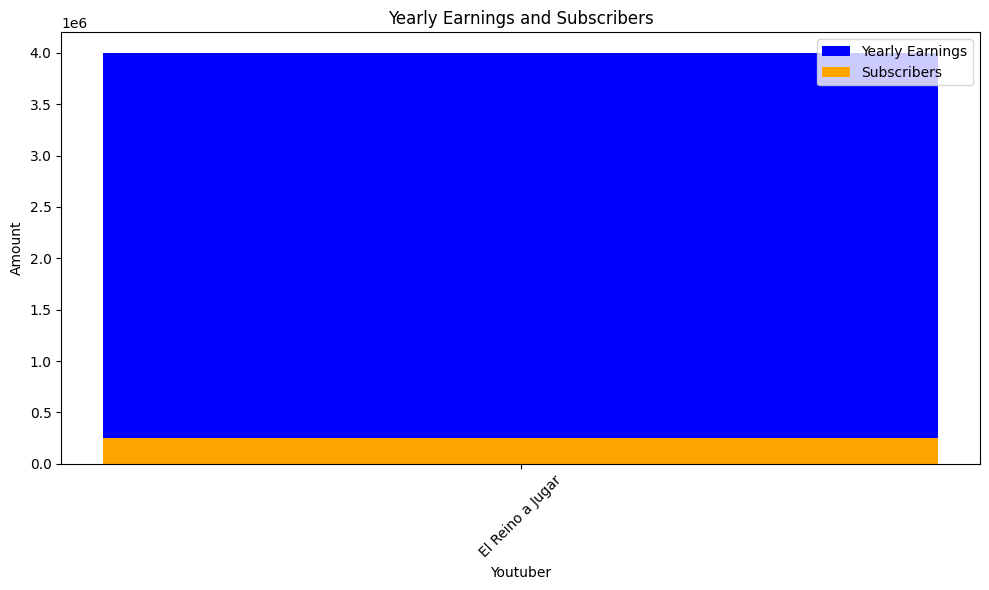

 80%|███████▉  | 1725/2160 [16:40<03:14,  2.23it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


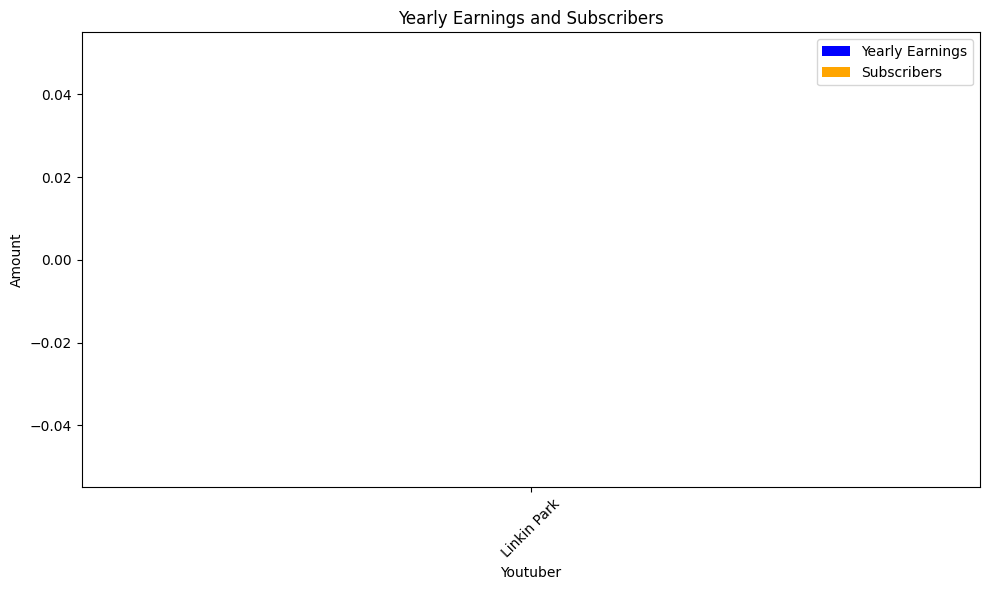

 80%|████████  | 1728/2160 [16:42<03:09,  2.28it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


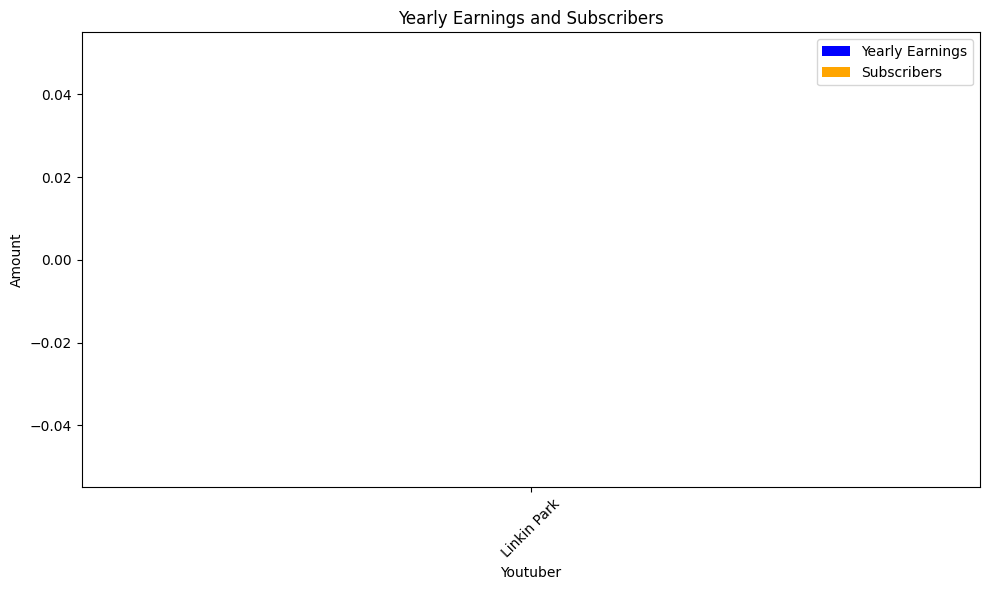

check
highest_yearly_earnings: 1700000.0, Subscribers: 105400.0, Youtuber: FAPTV


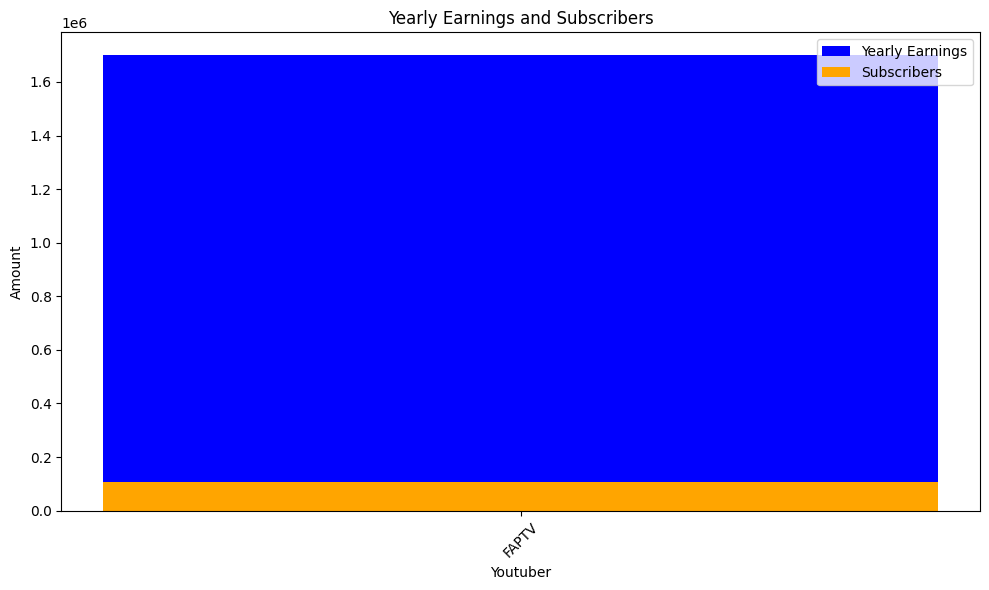

 80%|████████  | 1731/2160 [16:44<03:41,  1.94it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


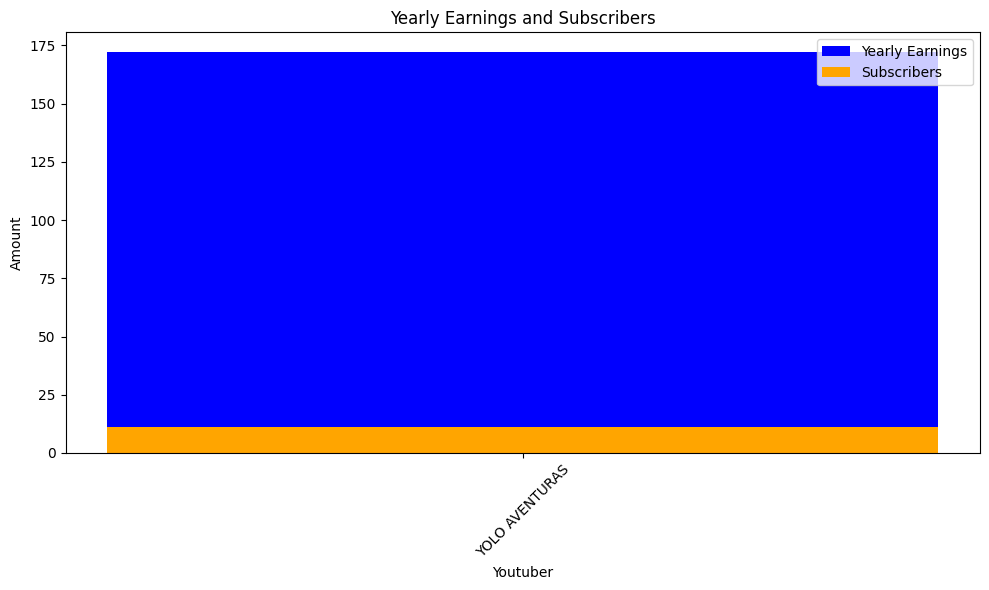

 80%|████████  | 1734/2160 [16:45<03:25,  2.08it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: The Tonight Show Starring Jimmy Fallon
highest_yearly_earnings: 50200000.0, Subscribers: 3100000.0, Youtuber: Alan Chikin Chow
highest_yearly_earnings: 3300000.0, Subscribers: 204500.0, Youtuber: Smosh
highest_yearly_earnings: 33000000.0, Subscribers: 2100000.0, Youtuber: Topper Guild
highest_yearly_earnings: 21700000.0, Subscribers: 1400000.0, Youtuber: Marta and Rustam
highest_yearly_earnings: 180900.0, Subscribers: 11300.0, Youtuber: JennaMarbles
highest_yearly_earnings: 131100.0, Subscribers: 8200.0, Youtuber: shane
highest_yearly_earnings: 827600.0, Subscribers: 51700.0, Youtuber: Jimmy Kimmel Live
highest_yearly_earnings: 1500000.0, Subscribers: 93000.0, Youtuber: TheOdd1sOut
highest_yearly_earnings: 15000000.0, Subscribers: 938600.0, Youtuber: Ray William Johnson
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: CollegeHumor
highest_yearly_earnings: 220700.0

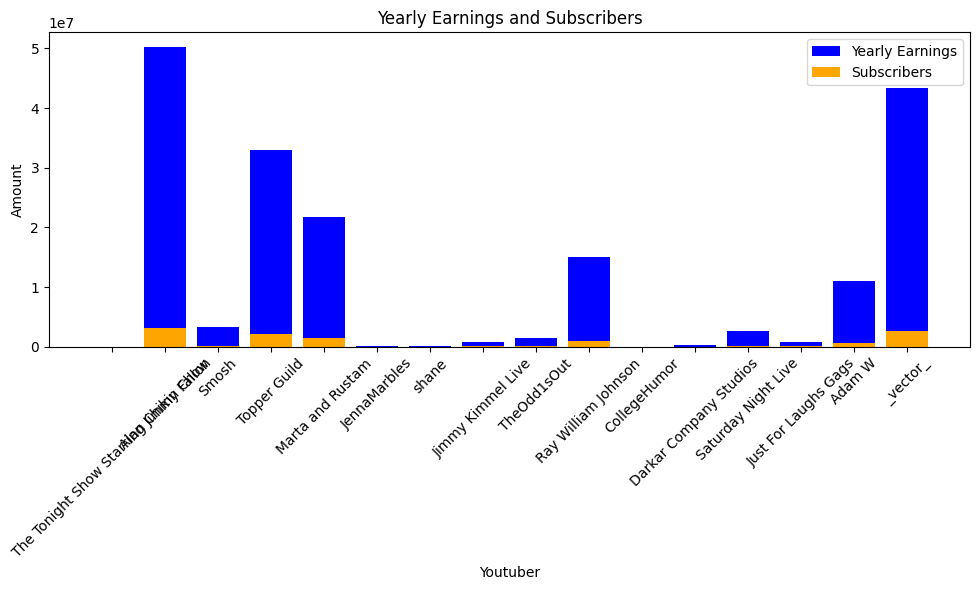

 80%|████████  | 1737/2160 [16:47<03:28,  2.02it/s]check
highest_yearly_earnings: 2700000.0, Subscribers: 169600.0, Youtuber: Mr Bean


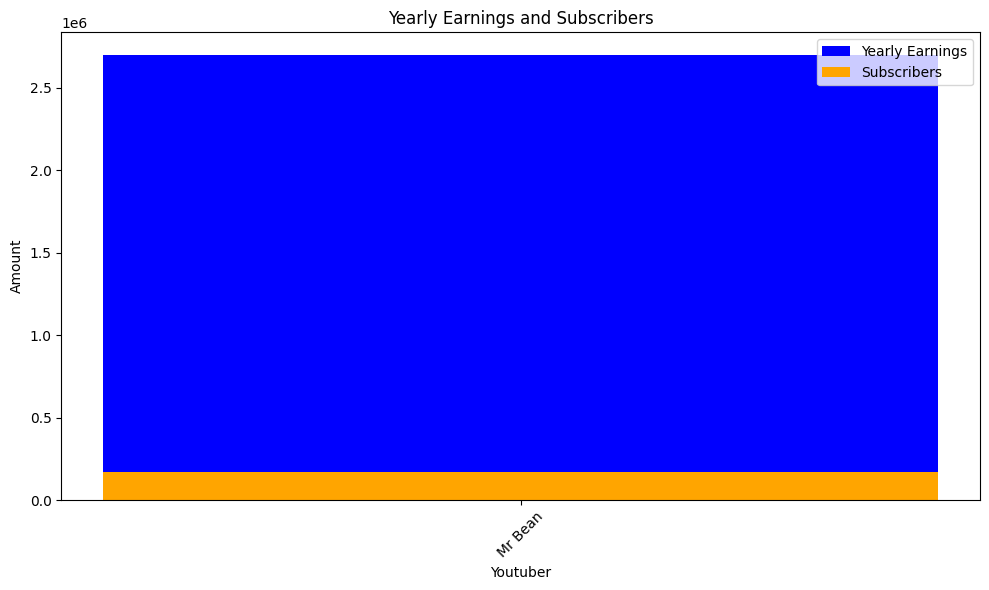

 81%|████████  | 1740/2160 [16:49<03:27,  2.02it/s]check
highest_yearly_earnings: 11900000.0, Subscribers: 743200.0, Youtuber: shfa2 - ï¿½ï¿½
highest_yearly_earnings: 7300000.0, Subscribers: 453600.0, Youtuber: shfa show India
highest_yearly_earnings: 76700000.0, Subscribers: 4800000.0, Youtuber: ZAMZAM ELECTRONICS TRADING
highest_yearly_earnings: 746700.0, Subscribers: 46700.0, Youtuber: Noor Stars
highest_yearly_earnings: 3800000.0, Subscribers: 240500.0, Youtuber: FFUNTV
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Supercar Blondie
highest_yearly_earnings: 3900000.0, Subscribers: 240700.0, Youtuber: AlArabiya ï¿½ï¿½ï¿½ï¿½ï¿


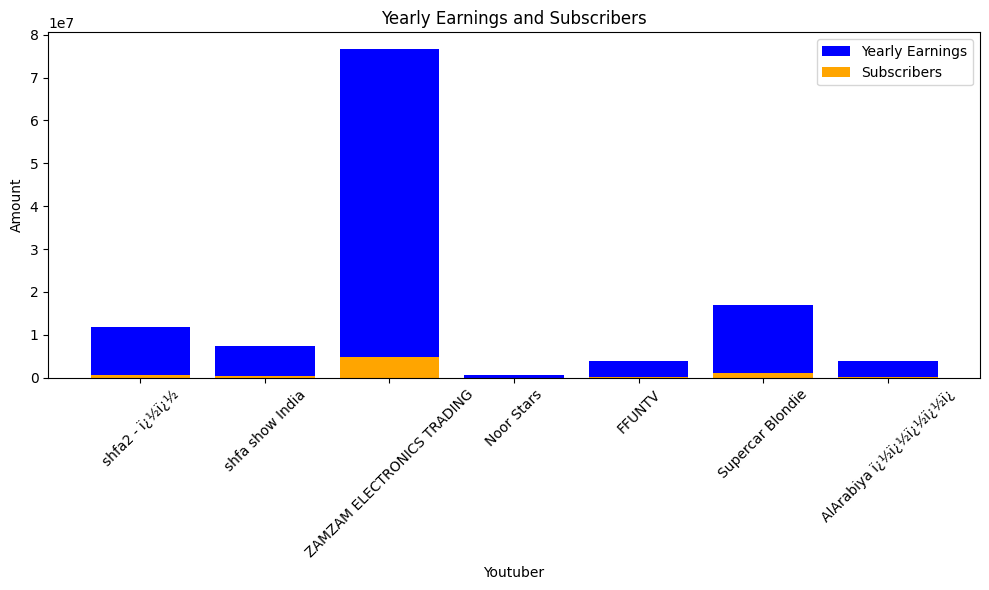

 81%|████████  | 1743/2160 [16:51<03:50,  1.81it/s]check
highest_yearly_earnings: 1400000.0, Subscribers: 87000.0, Youtuber: SlivkiShow
highest_yearly_earnings: 3300000.0, Subscribers: 204000.0, Youtuber: ýýýýýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 17800000.0, Subscribers: 1100000.0, Youtuber: News 24
highest_yearly_earnings: 2300000.0, Subscribers: 141400.0, Youtuber: ýýýýýýýý ýýýýýýýý
highest_yearly_earnings: 5.0, Subscribers: 0.32, Youtuber: SIS vs BRO
highest_yearly_earnings: 3600000.0, Subscribers: 225500.0, Youtuber: Lady Diana
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: VexTrex
highest_yearly_earnings: 3400000.0, Subscribers: 213400.0, Youtuber: ýýýýýýýý ýýýý ýýýýýýýýýýýýýý


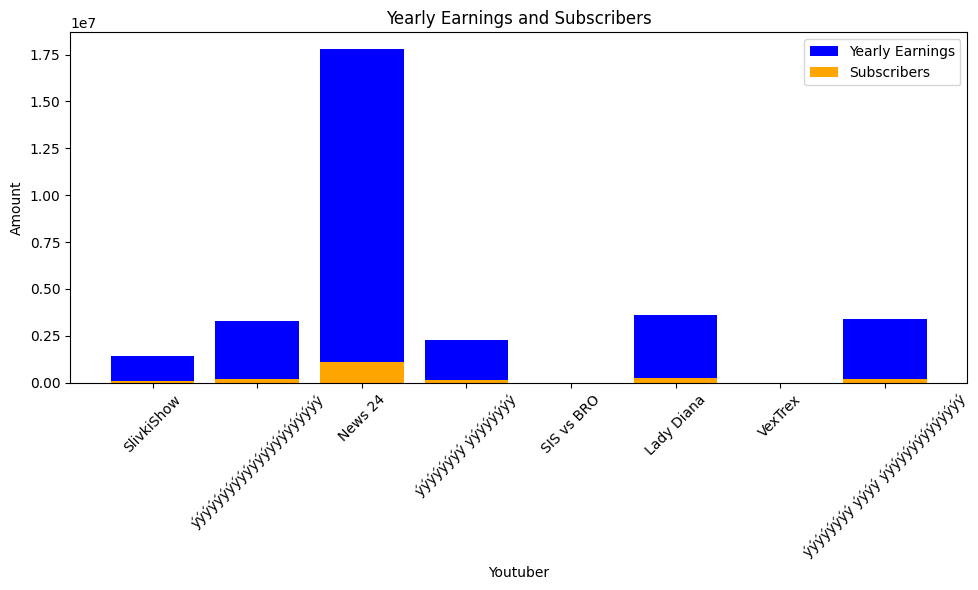

 81%|████████  | 1746/2160 [16:53<03:32,  1.94it/s]check
highest_yearly_earnings: 70200000.0, Subscribers: 4400000.0, Youtuber: BETER Bï¿½ï¿½
highest_yearly_earnings: 20400000.0, Subscribers: 1300000.0, Youtuber: netd mï¿½ï¿
highest_yearly_earnings: 5300000.0, Subscribers: 332400.0, Youtuber: tabii Urdu
highest_yearly_earnings: 212500.0, Subscribers: 13300.0, Youtuber: Oyuncak Avï¿


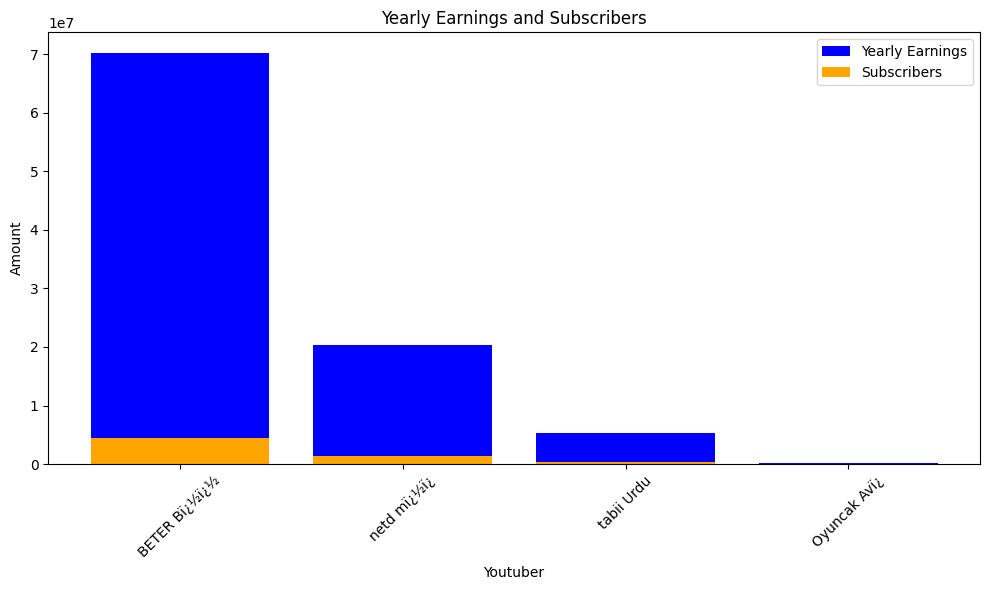

 81%|████████  | 1749/2160 [16:55<03:16,  2.09it/s]check
highest_yearly_earnings: 1.0, Subscribers: 0.07, Youtuber: Alan Walker
highest_yearly_earnings: 6300000.0, Subscribers: 391400.0, Youtuber: WorkpointOfficial
highest_yearly_earnings: 6800000.0, Subscribers: 422300.0, Youtuber: ýýýýýýýýýýýý one31
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Ch3Thailand
highest_yearly_earnings: 6300000.0, Subscribers: 390700.0, Youtuber: GMM GRAMMY OFFICIAL
highest_yearly_earnings: 8100000.0, Subscribers: 505800.0, Youtuber: GRAMMY GOLD OFFICIAL
highest_yearly_earnings: 2600000.0, Subscribers: 162400.0, Youtuber: RsiamMusic : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: zbing z.
highest_yearly_earnings: 11300000.0, Subscribers: 708000.0, Youtuber: AMARINTV : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 448400.0, Subscribers: 28000.0, Youtuber: Kaykai Salaider
highest_yearly_earnings: 4200000.0, Subscribers: 263300.0, You

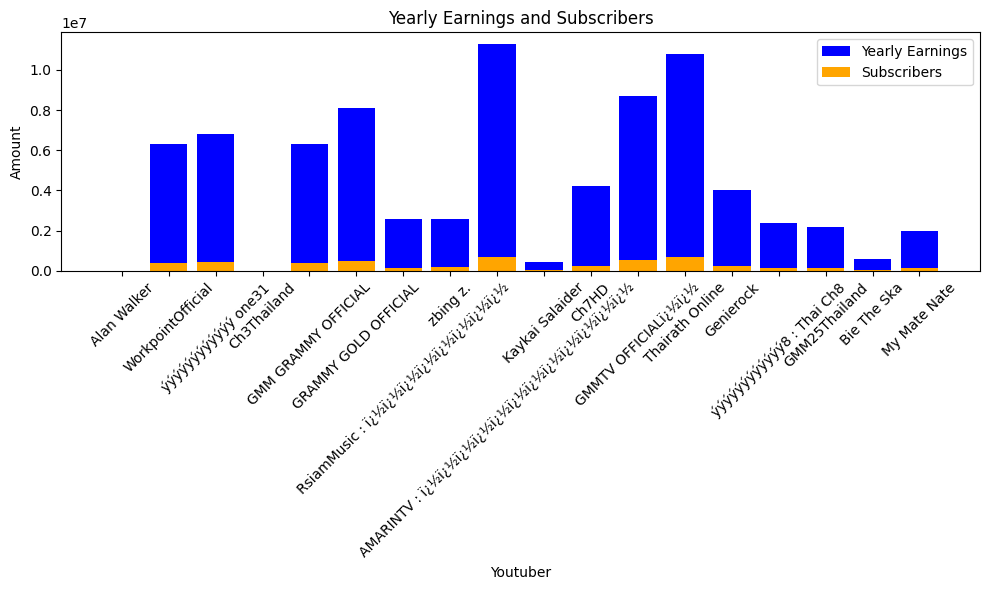

 81%|████████  | 1752/2160 [16:56<03:22,  2.01it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


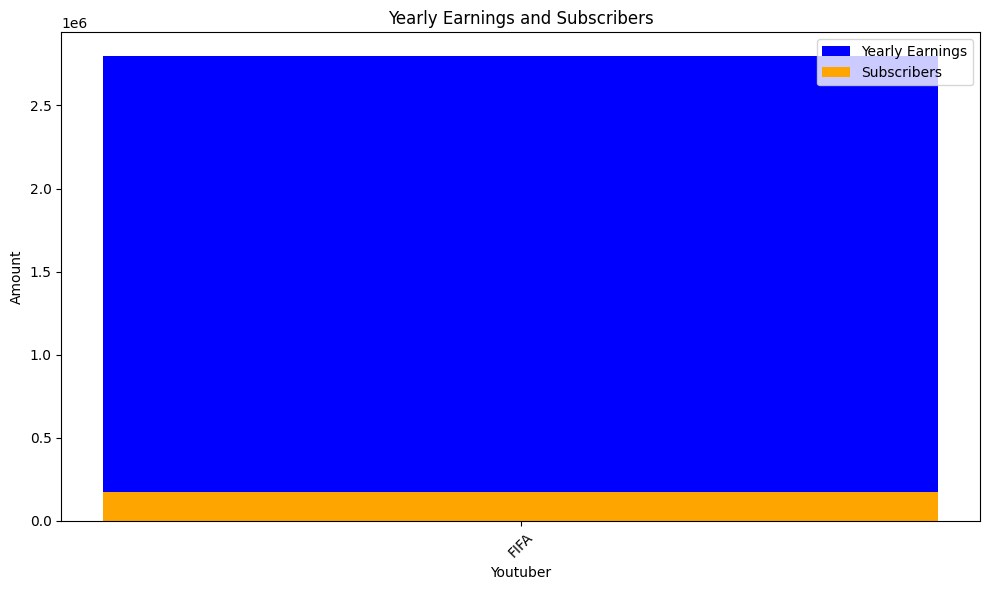

 81%|████████▏ | 1755/2160 [16:58<03:02,  2.22it/s]check
highest_yearly_earnings: 3900000.0, Subscribers: 243700.0, Youtuber: Avicii
highest_yearly_earnings: 23000000.0, Subscribers: 1400000.0, Youtuber: Panda Shorts
highest_yearly_earnings: 658000.0, Subscribers: 41100.0, Youtuber: Narins Beauty
highest_yearly_earnings: 185800.0, Subscribers: 11600.0, Youtuber: RobTopGames


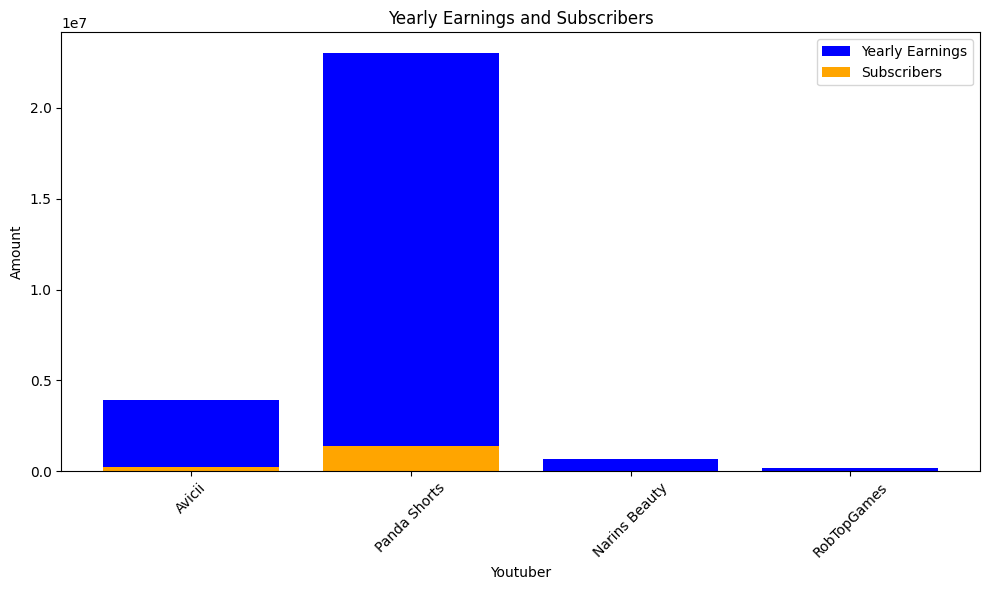

 81%|████████▏ | 1758/2160 [17:00<02:57,  2.27it/s]check
highest_yearly_earnings: 582900.0, Subscribers: 36400.0, Youtuber: AuronPlay


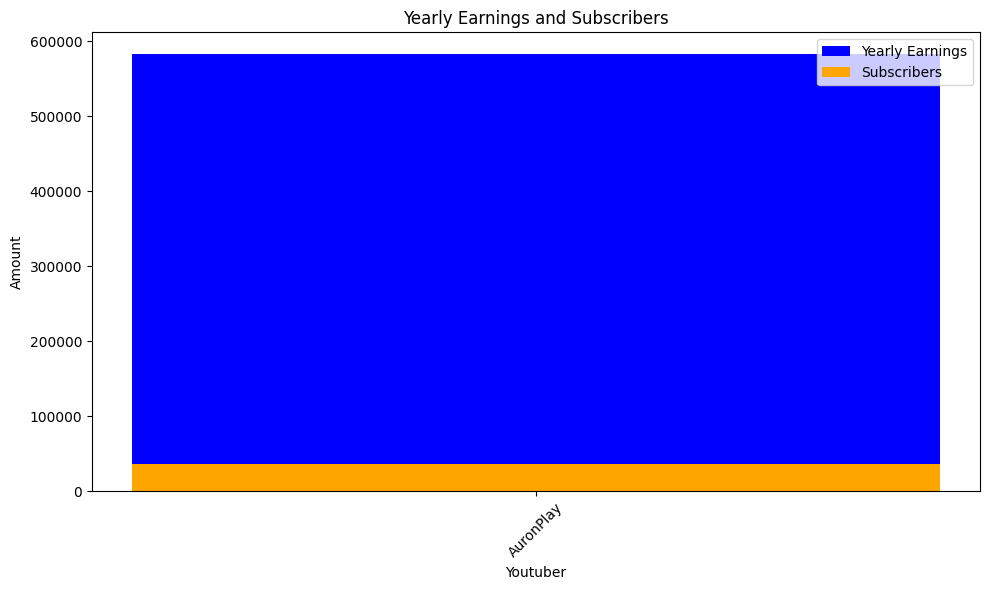

 82%|████████▏ | 1761/2160 [17:01<02:57,  2.25it/s]check
highest_yearly_earnings: 23900000.0, Subscribers: 1500000.0, Youtuber: BLACKPINK
highest_yearly_earnings: 8100000.0, Subscribers: 504900.0, Youtuber: BANGTANTV
highest_yearly_earnings: 28700000.0, Subscribers: 1800000.0, Youtuber: HYBE LABELS
highest_yearly_earnings: 14800000.0, Subscribers: 922900.0, Youtuber: JYP Entertainment
highest_yearly_earnings: 5100000.0, Subscribers: 316700.0, Youtuber: 1theK (ï¿½ï¿½ï¿½ï¿½ï
highest_yearly_earnings: 7600000.0, Subscribers: 475600.0, Youtuber: Mnet K-POP
highest_yearly_earnings: 5200000.0, Subscribers: 324000.0, Youtuber: KBS WORLD TV
highest_yearly_earnings: 3100000.0, Subscribers: 195000.0, Youtuber: officialpsy
highest_yearly_earnings: 163400000.0, Subscribers: 10200000.0, Youtuber: ýýýýýýýýý KIMPRO
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Jane ASMR ï¿½ï¿½
highest_yearly_earnings: 532700.0, Subscribers: 33300.0, Youtuber: JFlaMusic
highest_yearly_earnings: 2000000.0, S

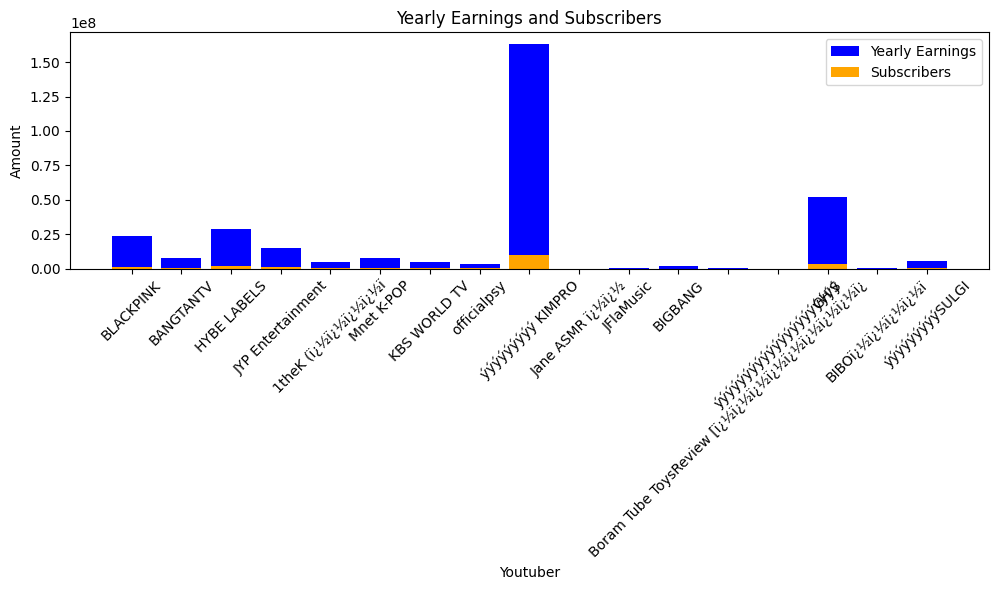

 82%|████████▏ | 1764/2160 [17:03<03:23,  1.95it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Sandeep Maheshwari
highest_yearly_earnings: 5600000.0, Subscribers: 351600.0, Youtuber: LEGO
highest_yearly_earnings: 45100.0, Subscribers: 2800.0, Youtuber: MY FAMILY


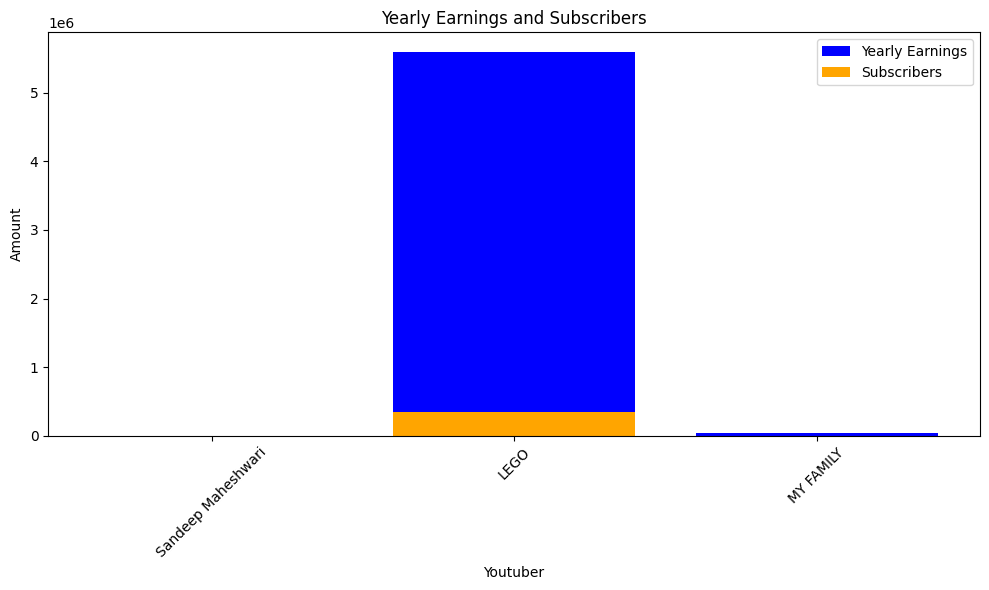

 82%|████████▏ | 1767/2160 [17:05<03:16,  2.00it/s]check
highest_yearly_earnings: 76300.0, Subscribers: 4800.0, Youtuber: shfa
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: 1MILLION Dance Studio
highest_yearly_earnings: 3500000.0, Subscribers: 221500.0, Youtuber: mmoshaya
highest_yearly_earnings: 2100000.0, Subscribers: 129000.0, Youtuber: ýýýýýýýý ýýýýýýýýýý ýýýýýýýýýý | Arab Games Network
highest_yearly_earnings: 4400000.0, Subscribers: 272700.0, Youtuber: Katakit Baby TV
highest_yearly_earnings: 6500000.0, Subscribers: 405100.0, Youtuber: ýýýýýýýý ýý ýýýýýýýý
highest_yearly_earnings: 129300.0, Subscribers: 8100.0, Youtuber: ýýýýýýýýýý ýýýýýýýýýýýý
highest_yearly_earnings: 224300.0, Subscribers: 14000.0, Youtuber: ýýýýýýýýýýýý ýýýýýýýýýýýý I ýýýýýý ýý ýýýýýýýýýý
highest_yearly_earnings: 3400000.0, Subscribers: 212100.0, Youtuber: BanderitaX


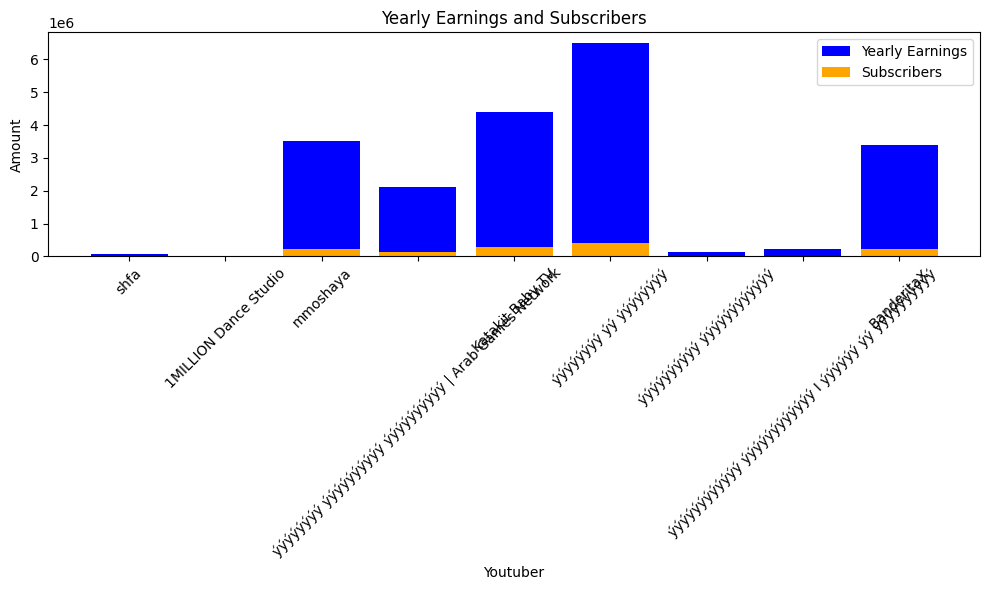

 82%|████████▏ | 1770/2160 [17:07<03:34,  1.82it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


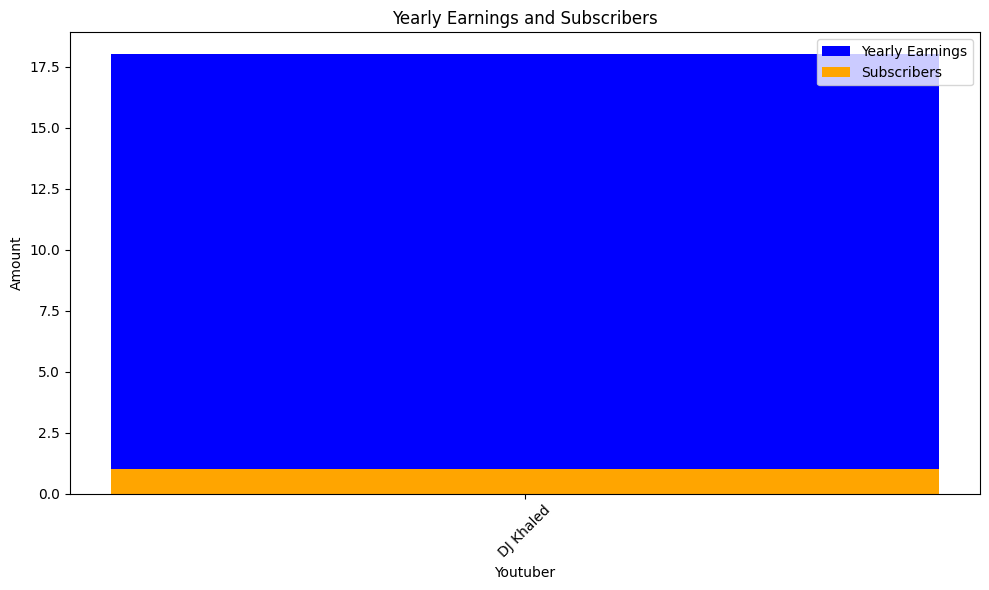

 82%|████████▏ | 1773/2160 [17:09<03:18,  1.95it/s]check
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya
highest_yearly_earnings: 14700000.0, Subscribers: 919600.0, Youtuber: Get Movies
highest_yearly_earnings: 14600000.0, Subscribers: 911300.0, Youtuber: ýýýýýýýý ýý ýýýýýýýýýýýýýý
highest_yearly_earnings: 26500000.0, Subscribers: 1700000.0, Youtuber: tuzelity SHUFFLE
highest_yearly_earnings: 1200000.0, Subscribers: 73700.0, Youtuber: HiMan
highest_yearly_earnings: 1800000.0, Subscribers: 114800.0, Youtuber: Marmok
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya Vlog
highest_yearly_earnings: 1800000.0, Subscribers: 111500.0, Youtuber: TheBrianMaps
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: ýýýýýýýýýý
highest_yearly_earnings: 22800000.0, Subscribers: 1400000.0, Youtuber: ILYA BORZOV
highest_yearly_earnings: 4600000.0, Subscribers: 286800.0, Youtuber: EdisonPts
highest_yearly_earnings: 34200000.0, Subscriber

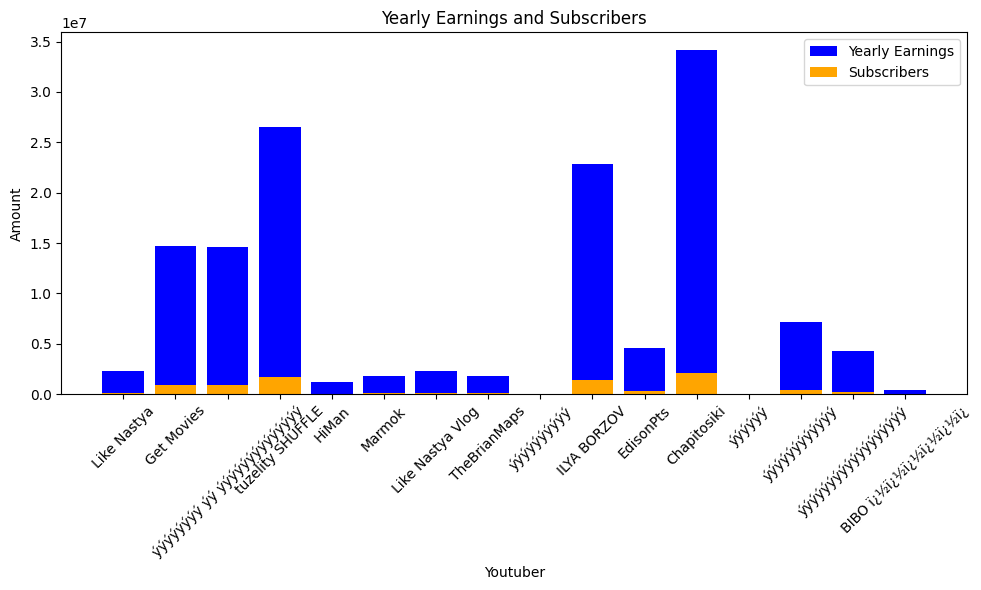

 82%|████████▏ | 1776/2160 [17:11<03:11,  2.01it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529900.0, Youtuber: ABS-CBN Entertainment
highest_yearly_earnings: 38300000.0, Subscribers: 2400000.0, Youtuber: GMA  Network
highest_yearly_earnings: 7800000.0, Subscribers: 489400.0, Youtuber: Raffy Tulfo in Action
highest_yearly_earnings: 6800000.0, Subscribers: 427000.0, Youtuber: GMA Public  Affairs
highest_yearly_earnings: 723800.0, Subscribers: 45200.0, Youtuber: Ivana Alawi
highest_yearly_earnings: 479000.0, Subscribers: 29900.0, Youtuber: Niana Guerrero
highest_yearly_earnings: 594000.0, Subscribers: 37100.0, Youtuber: Ranz Kyle
highest_yearly_earnings: 8700000.0, Subscribers: 544900.0, Youtuber: ABS-CBN News
highest_yearly_earnings: 3000000.0, Subscribers: 188000.0, Youtuber: Wish 107.5
highest_yearly_earnings: 580200.0, Subscribers: 36300.0, Youtuber: Zeinab Harake
highest_yearly_earnings: 5500000.0, Subscribers: 346400.0, Youtuber: GMA Integrated News
highest_yearly_ear

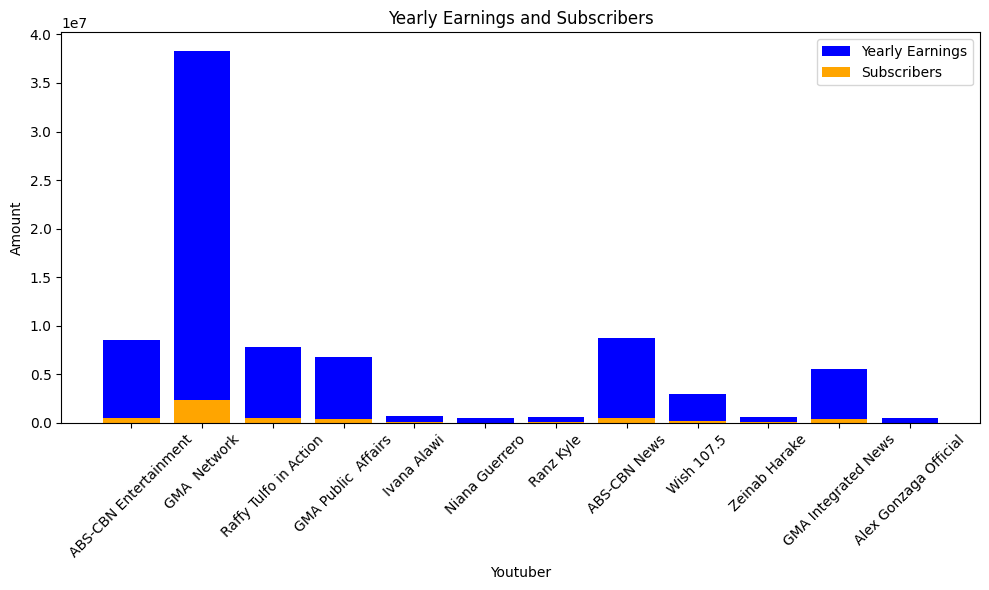

 82%|████████▏ | 1779/2160 [17:13<03:06,  2.05it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


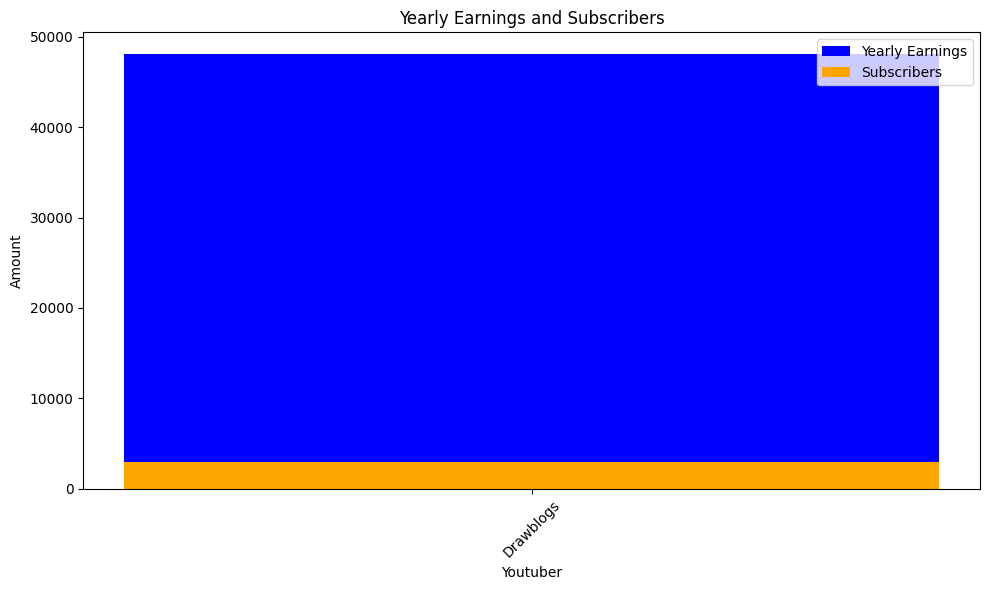

 82%|████████▎ | 1782/2160 [17:14<02:46,  2.28it/s]check
highest_yearly_earnings: 64200000.0, Subscribers: 4000000.0, Youtuber: HAR PAL GEO
highest_yearly_earnings: 55200000.0, Subscribers: 3400000.0, Youtuber: ARY Digital HD
highest_yearly_earnings: 32900000.0, Subscribers: 2100000.0, Youtuber: HUM TV
highest_yearly_earnings: 4800000.0, Subscribers: 300200.0, Youtuber: Geo News
highest_yearly_earnings: 28.0, Subscribers: 2.0, Youtuber: Wolfoo Channel
highest_yearly_earnings: 419.0, Subscribers: 26.0, Youtuber: Quantum Tech HD


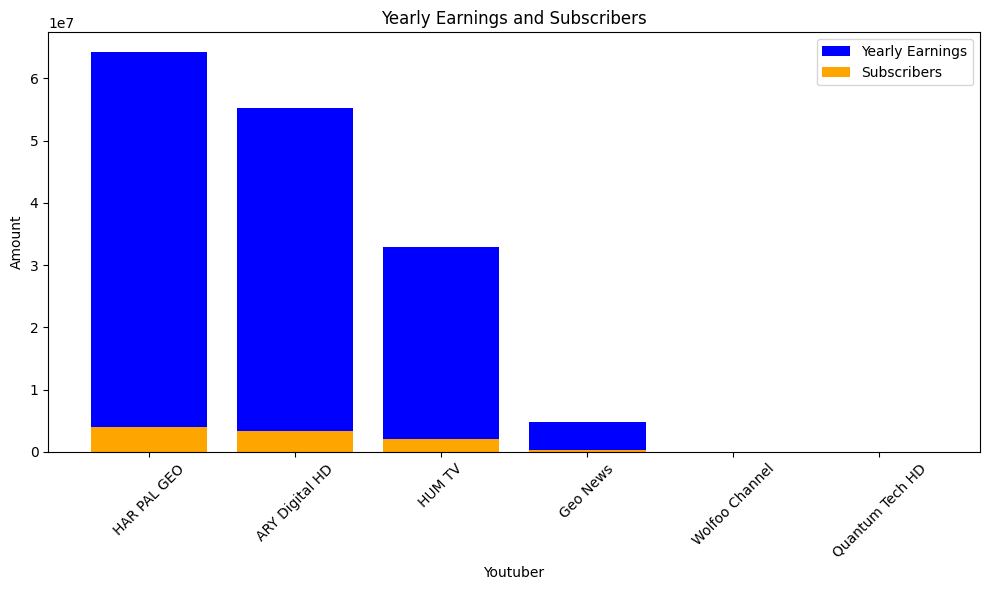

 83%|████████▎ | 1785/2160 [17:16<02:45,  2.26it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300100.0, Youtuber: Spinnin' Records
highest_yearly_earnings: 1700000.0, Subscribers: 107800.0, Youtuber: NikkieTutorials
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: ýýýýýýýý/Atro


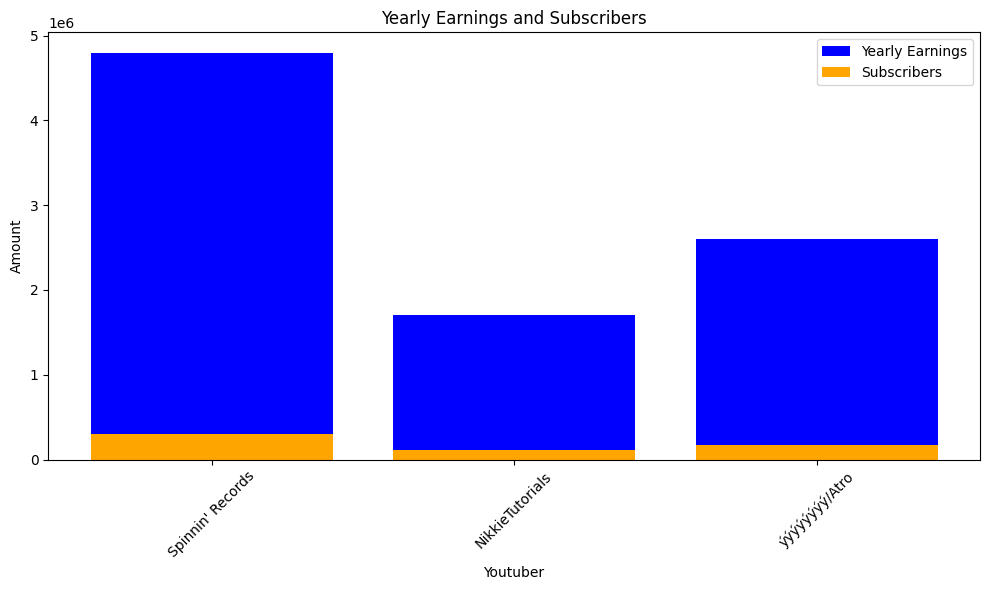

 83%|████████▎ | 1788/2160 [17:17<02:39,  2.34it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


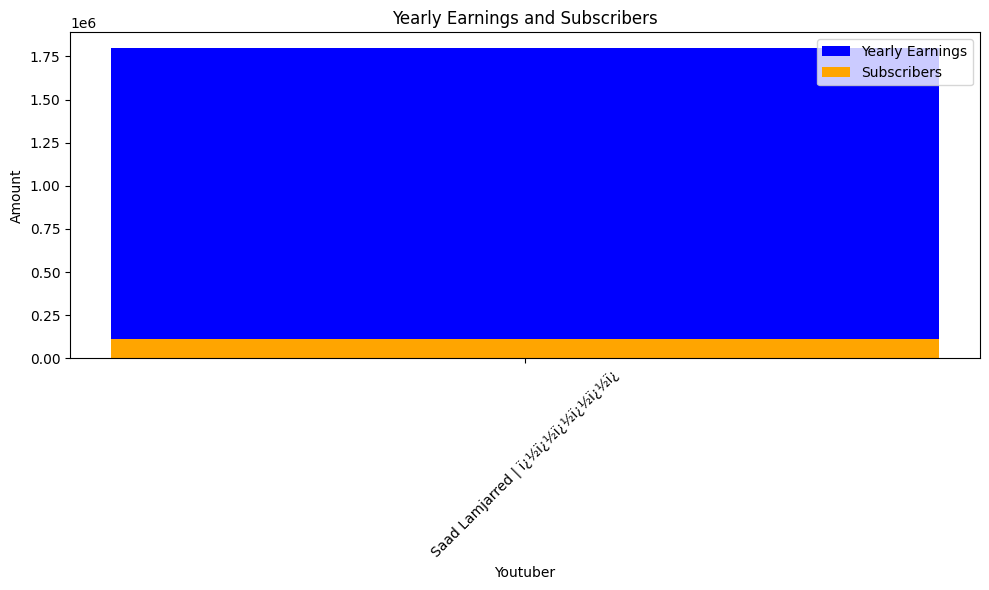

 83%|████████▎ | 1791/2160 [17:20<03:51,  1.60it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Luisito Comunica
highest_yearly_earnings: 1300000.0, Subscribers: 82300.0, Youtuber: MissaSinfonia
highest_yearly_earnings: 3700000.0, Subscribers: 232400.0, Youtuber: Franco Escamilla


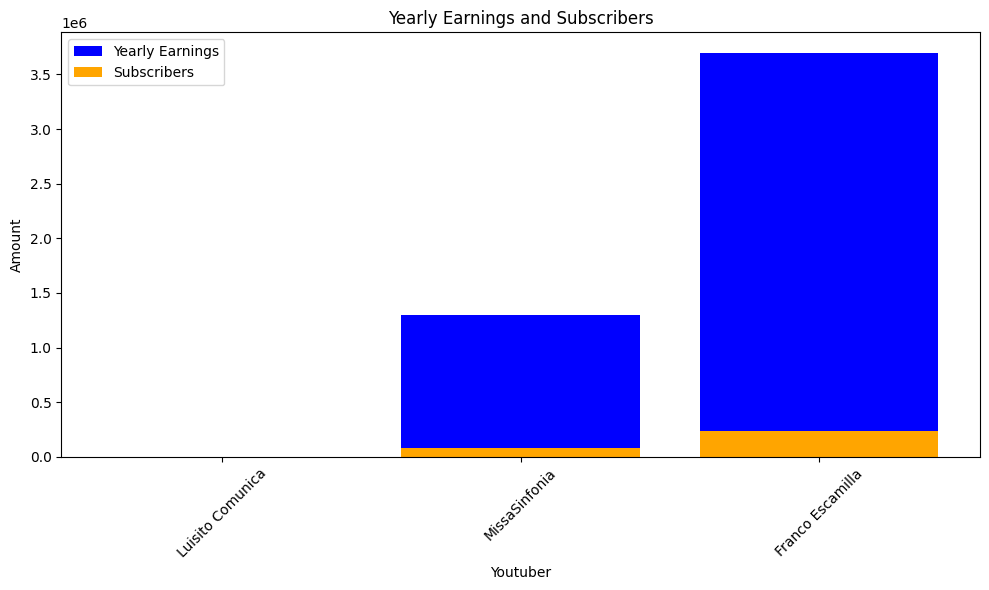

 83%|████████▎ | 1794/2160 [17:22<03:05,  1.98it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


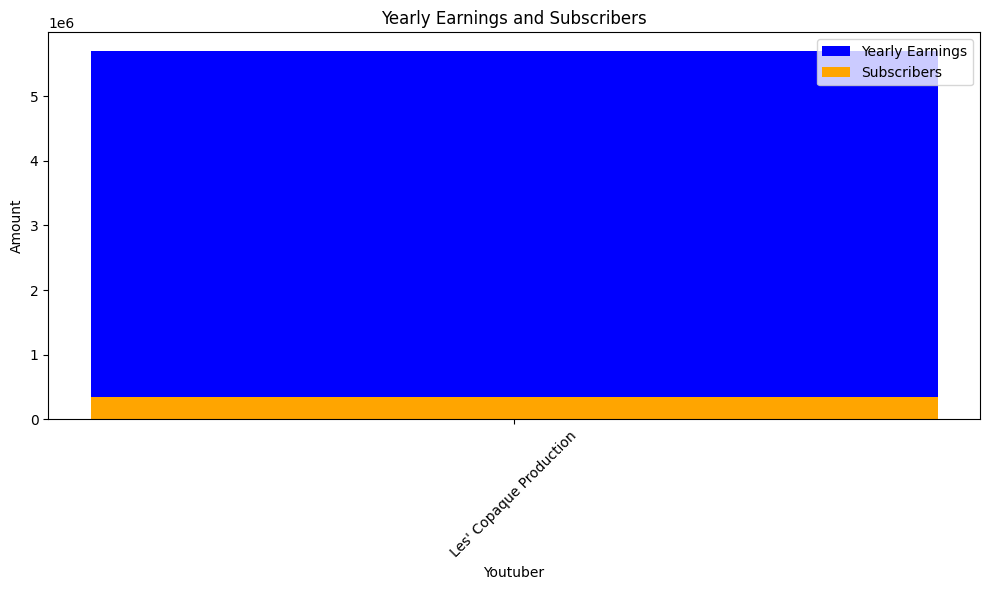

 83%|████████▎ | 1797/2160 [17:23<03:06,  1.95it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


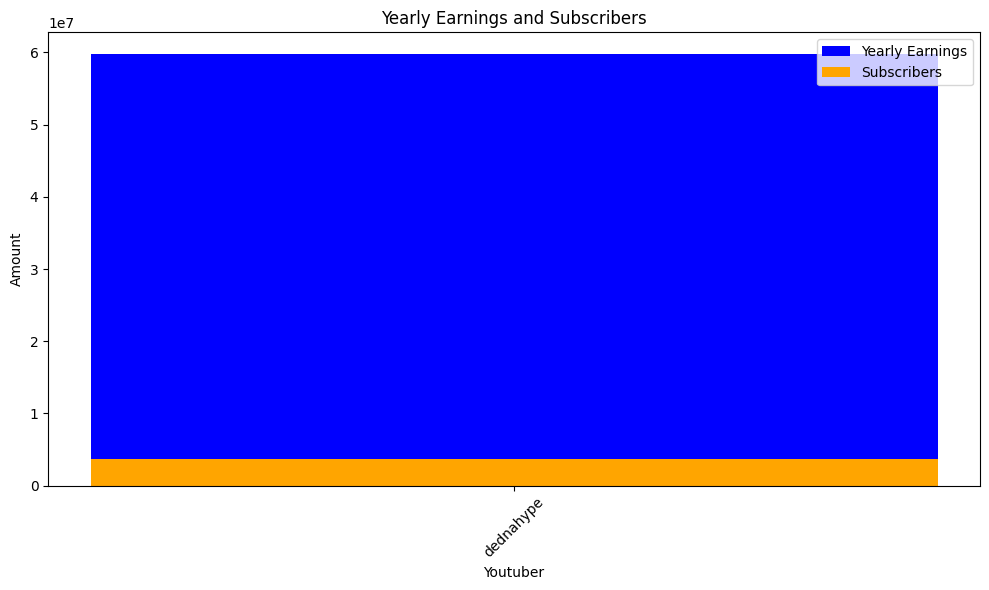

 83%|████████▎ | 1800/2160 [17:25<03:14,  1.85it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


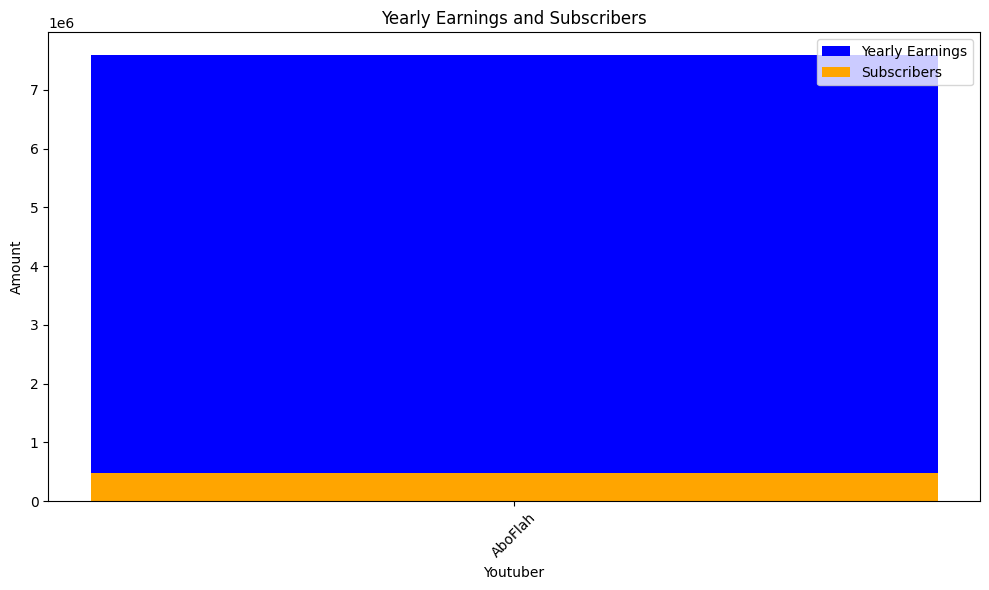

 83%|████████▎ | 1803/2160 [17:27<02:48,  2.11it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


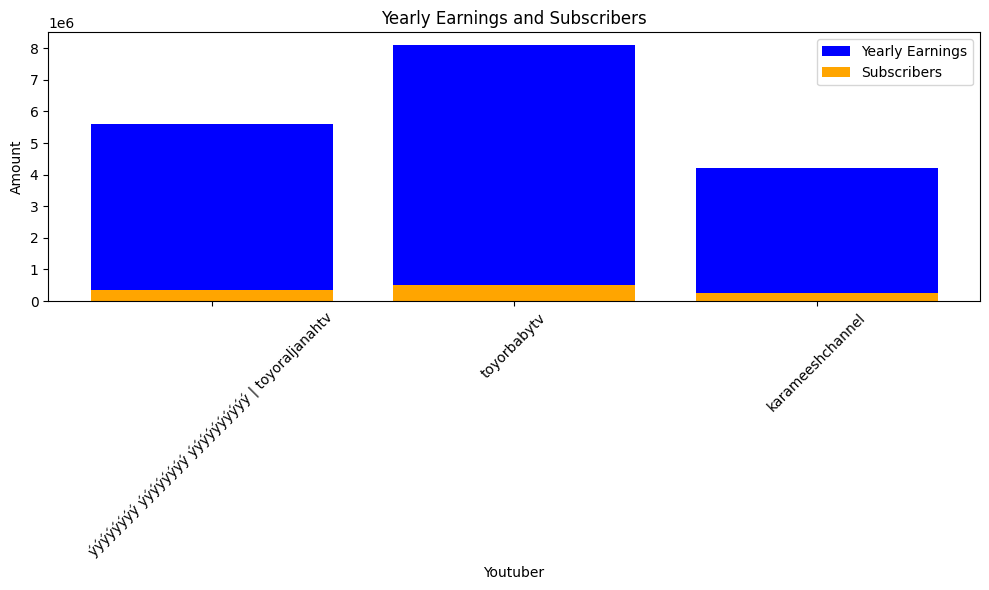

 84%|████████▎ | 1806/2160 [17:28<02:34,  2.30it/s]check
highest_yearly_earnings: 13600000.0, Subscribers: 847100.0, Youtuber: ISSEI / ï¿½ï¿½ï¿½ï¿½


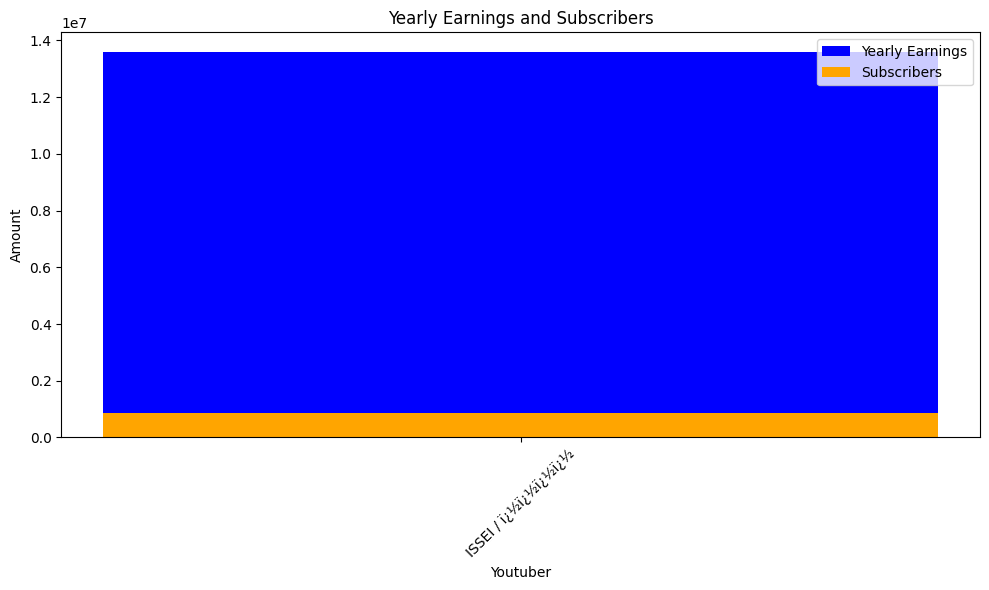

 84%|████████▍ | 1809/2160 [17:30<02:33,  2.29it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


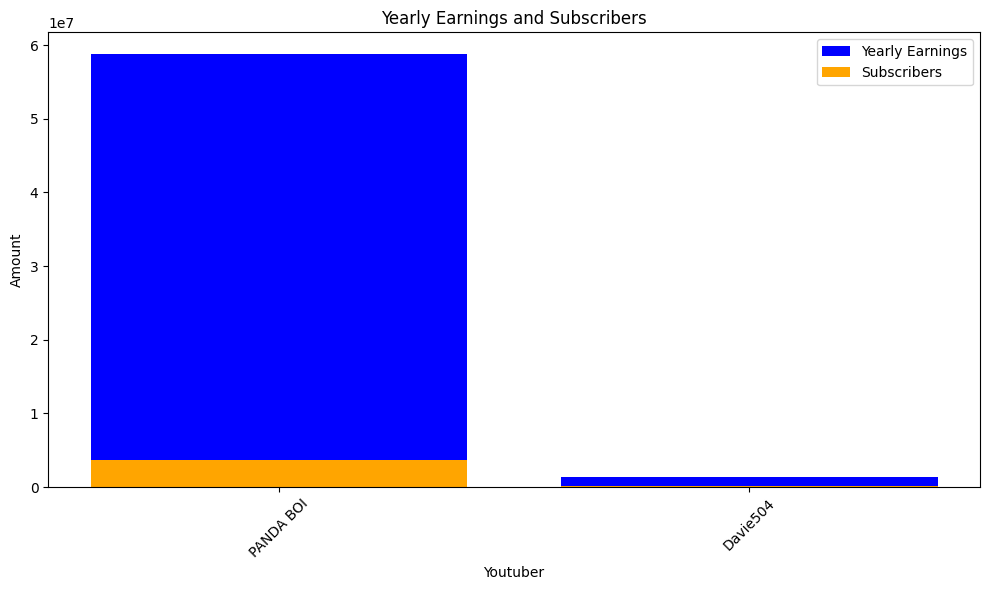

 84%|████████▍ | 1812/2160 [17:32<02:30,  2.32it/s]check
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


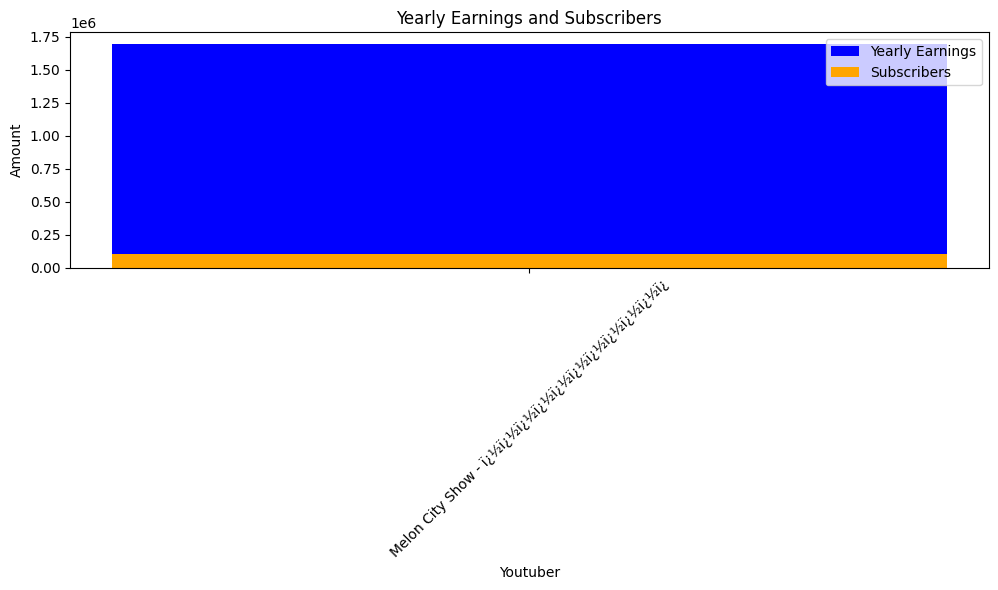

 84%|████████▍ | 1815/2160 [17:33<02:32,  2.26it/s]check
highest_yearly_earnings: 3400000.0, Subscribers: 215600.0, Youtuber: Arif muhammad


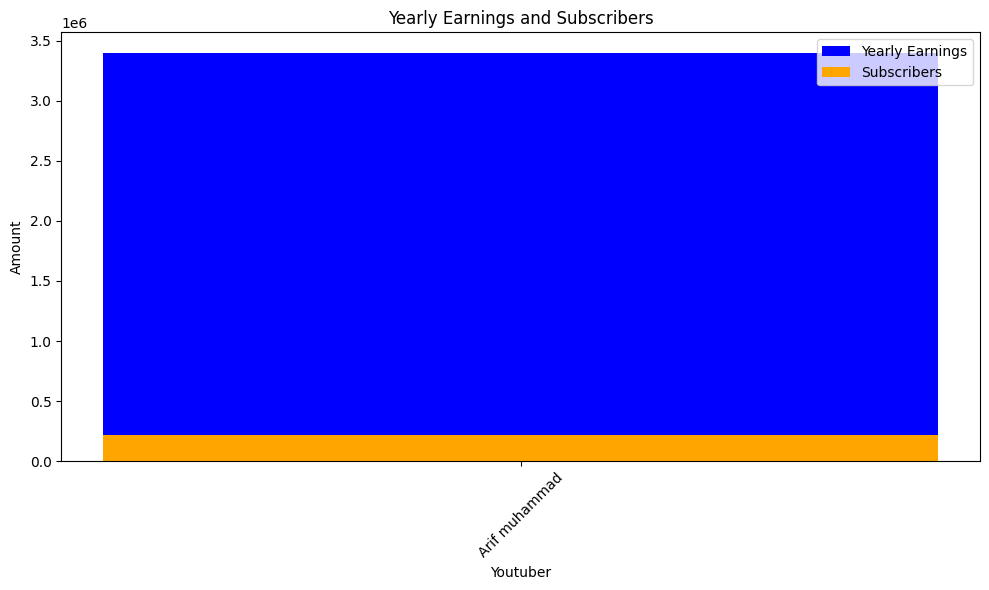

 84%|████████▍ | 1818/2160 [17:35<02:31,  2.25it/s]check
highest_yearly_earnings: 3800000.0, Subscribers: 236100.0, Youtuber: CarryMinati
highest_yearly_earnings: 2400000.0, Subscribers: 149600.0, Youtuber: Jkk Entertainment
highest_yearly_earnings: 1200000.0, Subscribers: 74200.0, Youtuber: KHANDESHI MOVIES
highest_yearly_earnings: 1300000.0, Subscribers: 78500.0, Youtuber: ashish chanchlani vines
highest_yearly_earnings: 4900000.0, Subscribers: 307300.0, Youtuber: Shemaroo Comedy
highest_yearly_earnings: 1300000.0, Subscribers: 83900.0, Youtuber: Harsh Beniwal
highest_yearly_earnings: 4700000.0, Subscribers: 295000.0, Youtuber: The MriDul
highest_yearly_earnings: 17700000.0, Subscribers: 1100000.0, Youtuber: SEVENGERS
highest_yearly_earnings: 6400000.0, Subscribers: 400800.0, Youtuber: ETV Jabardasth
highest_yearly_earnings: 18200000.0, Subscribers: 1100000.0, Youtuber: The Vishal bhatt
highest_yearly_earnings: 630800.0, Subscribers: 39400.0, Youtuber: CKM
highest_yearly_earnings: 12

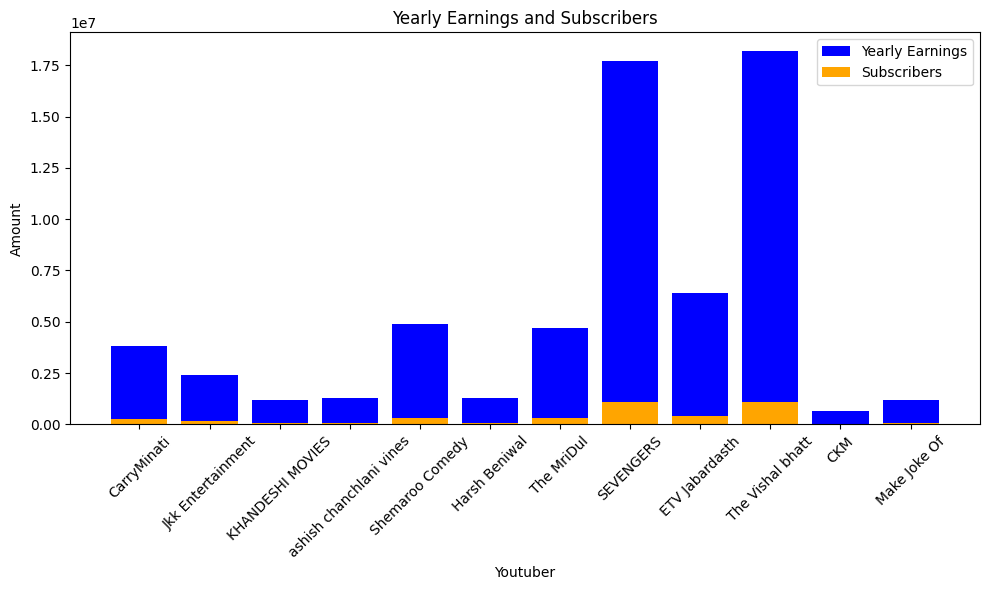

 84%|████████▍ | 1821/2160 [17:37<02:51,  1.98it/s]check
highest_yearly_earnings: 36300000.0, Subscribers: 2300000.0, Youtuber: Tsuriki Show


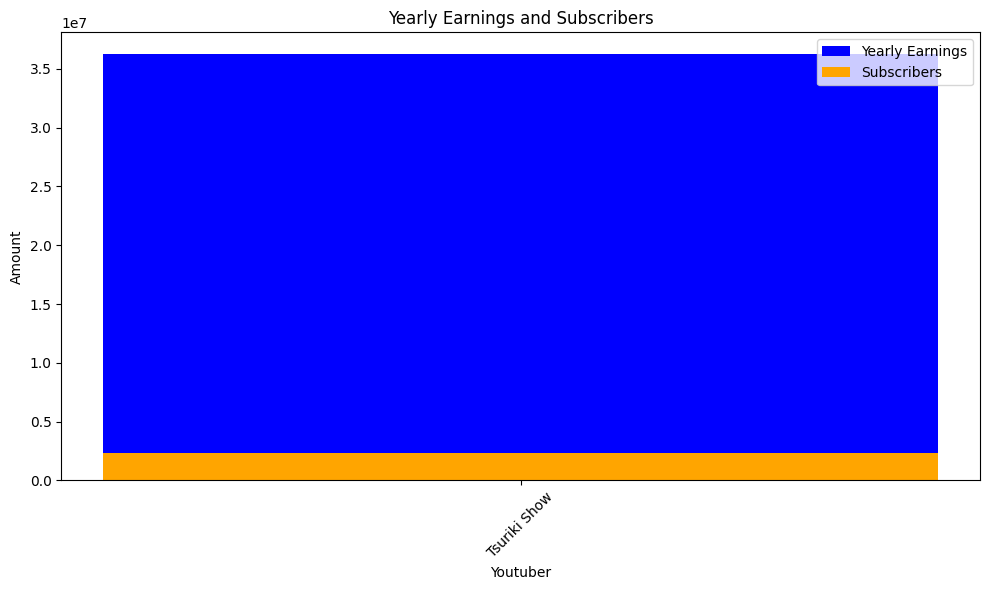

 84%|████████▍ | 1824/2160 [17:38<02:41,  2.08it/s]check
highest_yearly_earnings: 548000.0, Subscribers: 34300.0, Youtuber: Cyprien


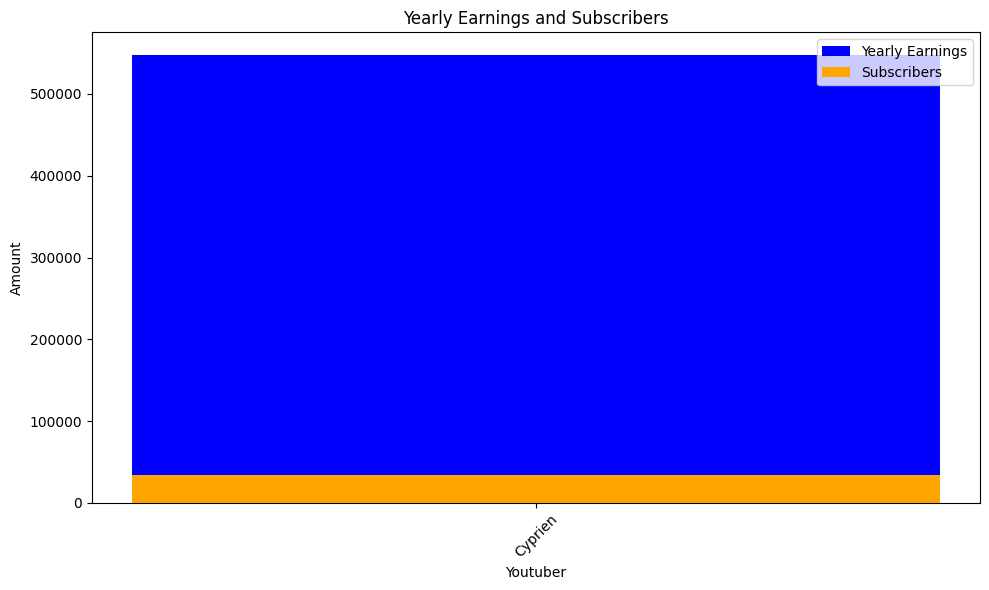

 85%|████████▍ | 1827/2160 [17:40<02:49,  1.96it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


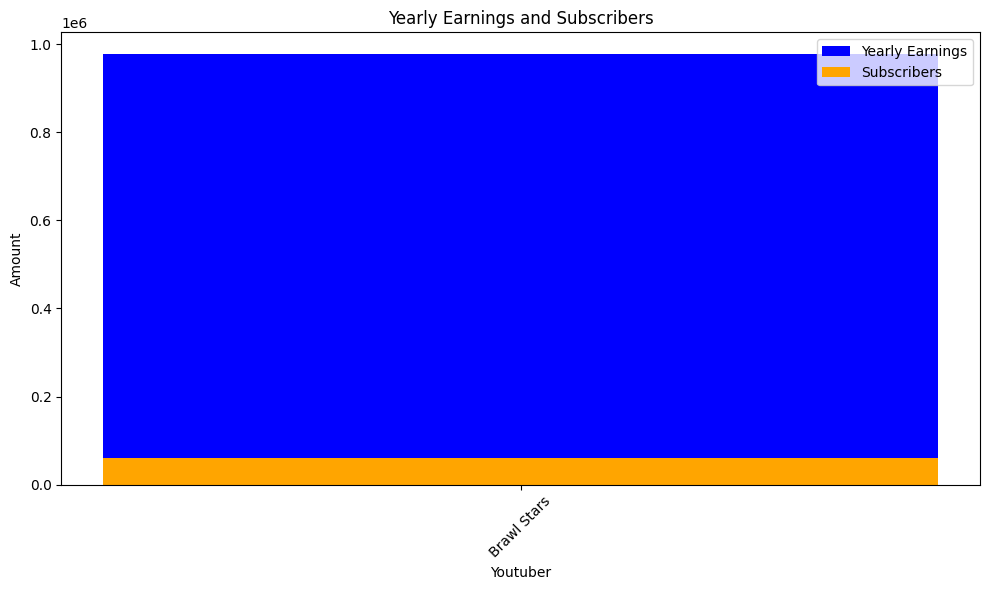

 85%|████████▍ | 1830/2160 [17:42<02:46,  1.98it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


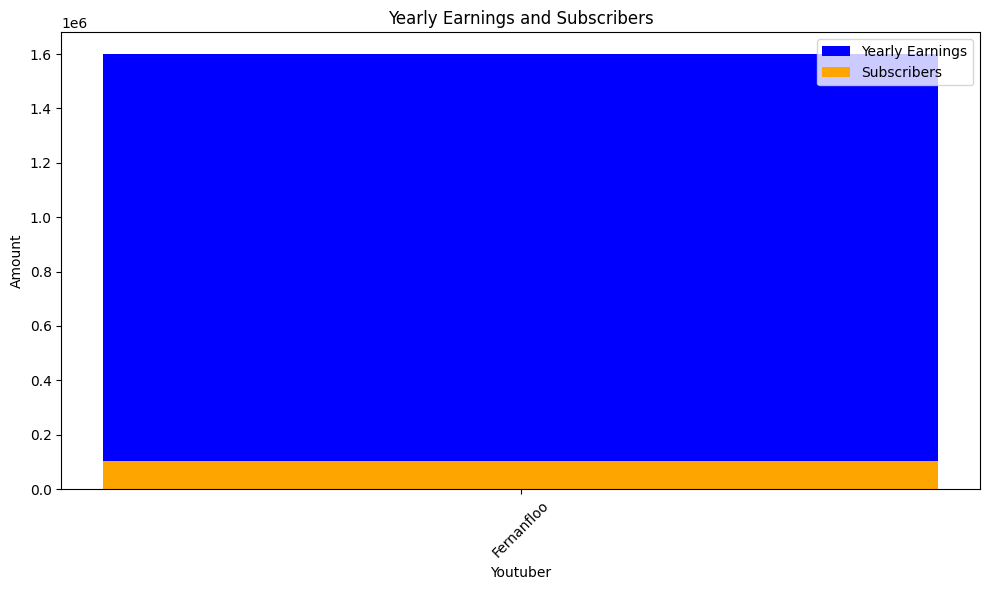

 85%|████████▍ | 1833/2160 [17:44<02:48,  1.94it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


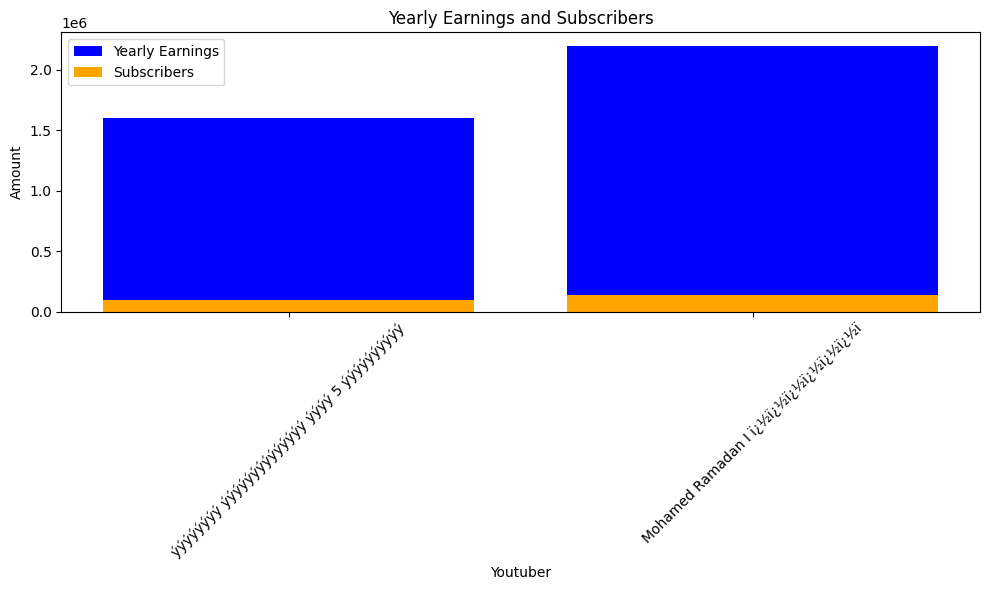

 85%|████████▌ | 1836/2160 [17:46<02:27,  2.19it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


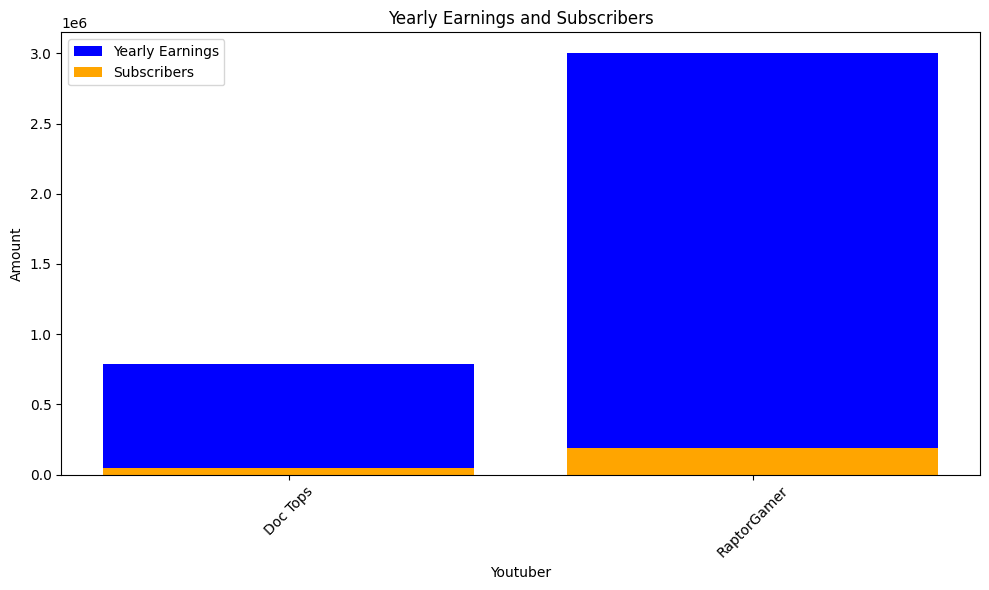

 85%|████████▌ | 1839/2160 [17:47<02:24,  2.23it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


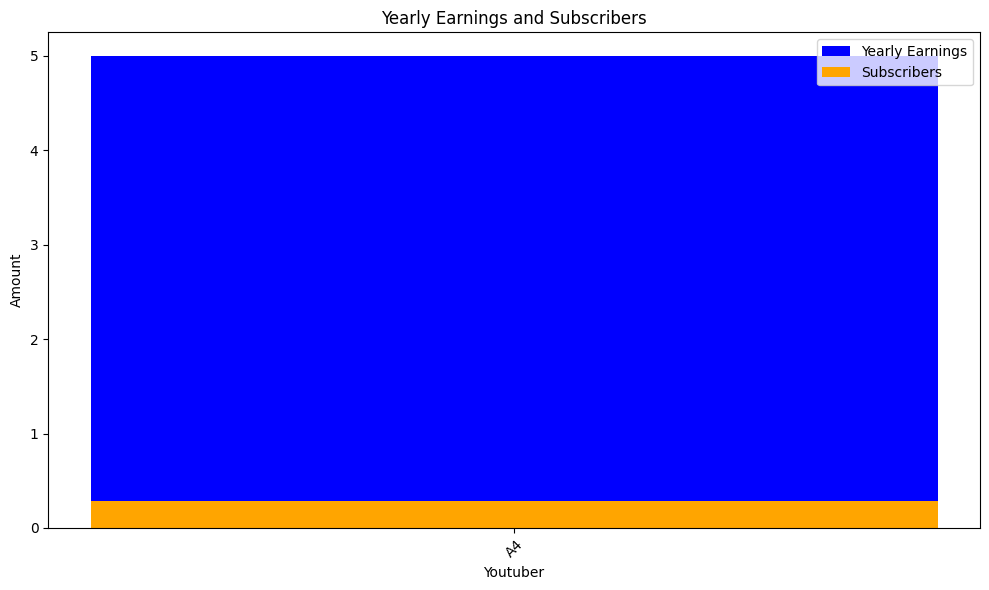

 85%|████████▌ | 1842/2160 [17:49<02:20,  2.27it/s]check
highest_yearly_earnings: 1200000.0, Subscribers: 73100.0, Youtuber: enchufetv


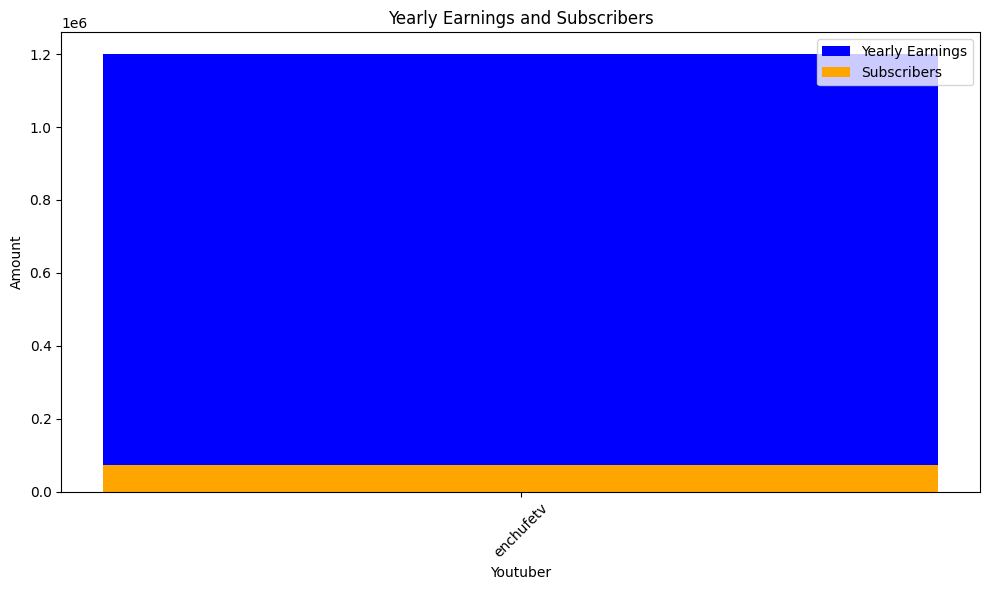

 85%|████████▌ | 1845/2160 [17:50<02:20,  2.25it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


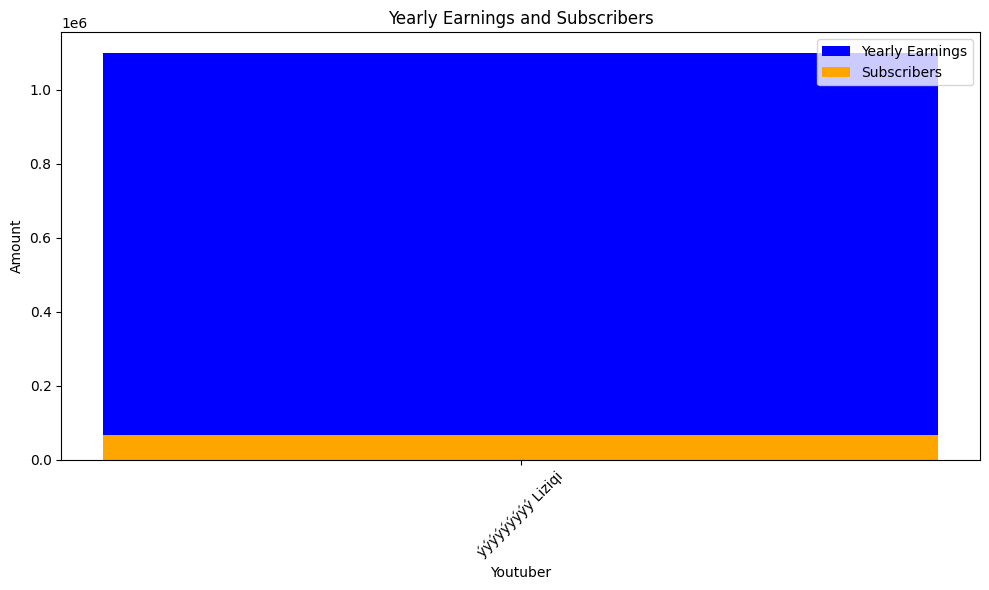

 86%|████████▌ | 1848/2160 [17:52<02:16,  2.29it/s]check
highest_yearly_earnings: 3200000.0, Subscribers: 199200.0, Youtuber: JuegaGerman
highest_yearly_earnings: 2.0, Subscribers: 0.15, Youtuber: invictor
highest_yearly_earnings: 4800000.0, Subscribers: 300600.0, Youtuber: DeGoBooM


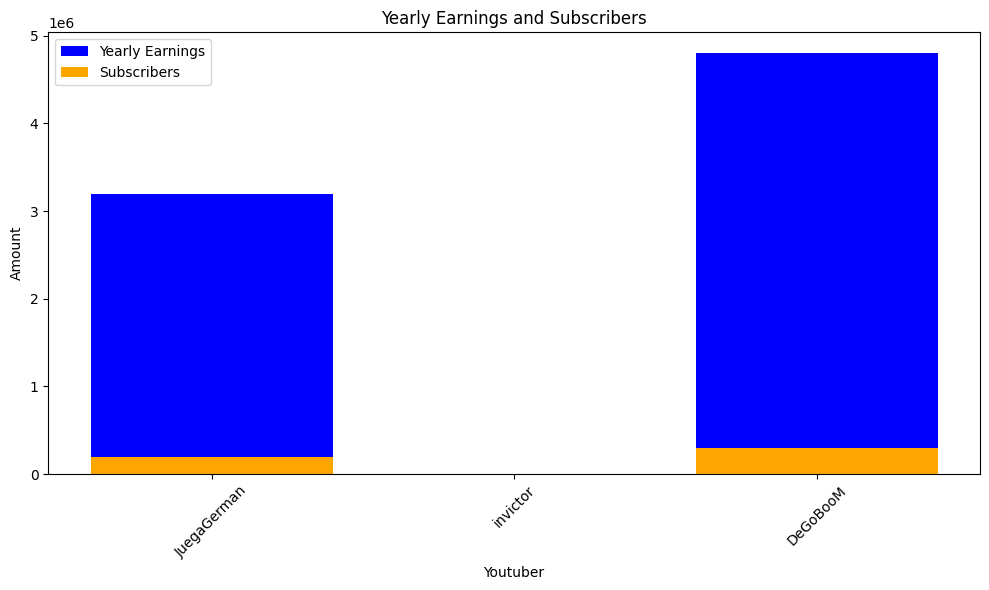

 86%|████████▌ | 1851/2160 [17:54<02:14,  2.30it/s]check
highest_yearly_earnings: 255800.0, Subscribers: 16000.0, Youtuber: Lilly Singh


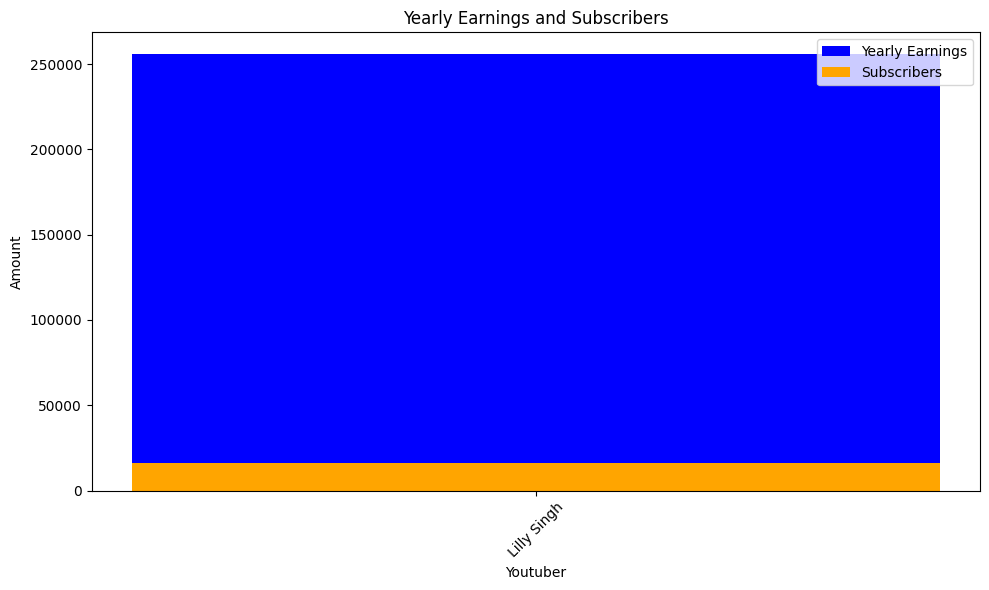

 86%|████████▌ | 1854/2160 [17:55<02:15,  2.25it/s]check
highest_yearly_earnings: 1300000.0, Subscribers: 80100.0, Youtuber: whinderssonnunes
highest_yearly_earnings: 36500000.0, Subscribers: 2300000.0, Youtuber: Spider Slack
highest_yearly_earnings: 1100000.0, Subscribers: 71700.0, Youtuber: Canal Canalha
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Gustavo Parï¿½ï¿½


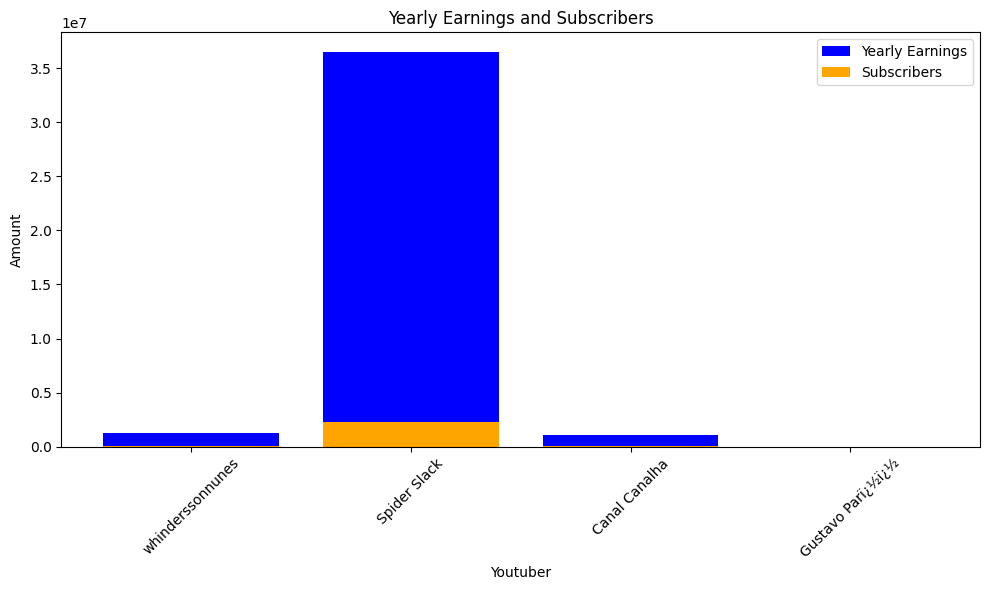

 86%|████████▌ | 1857/2160 [17:57<02:21,  2.14it/s]check
highest_yearly_earnings: 8800000.0, Subscribers: 548800.0, Youtuber: Rihanna


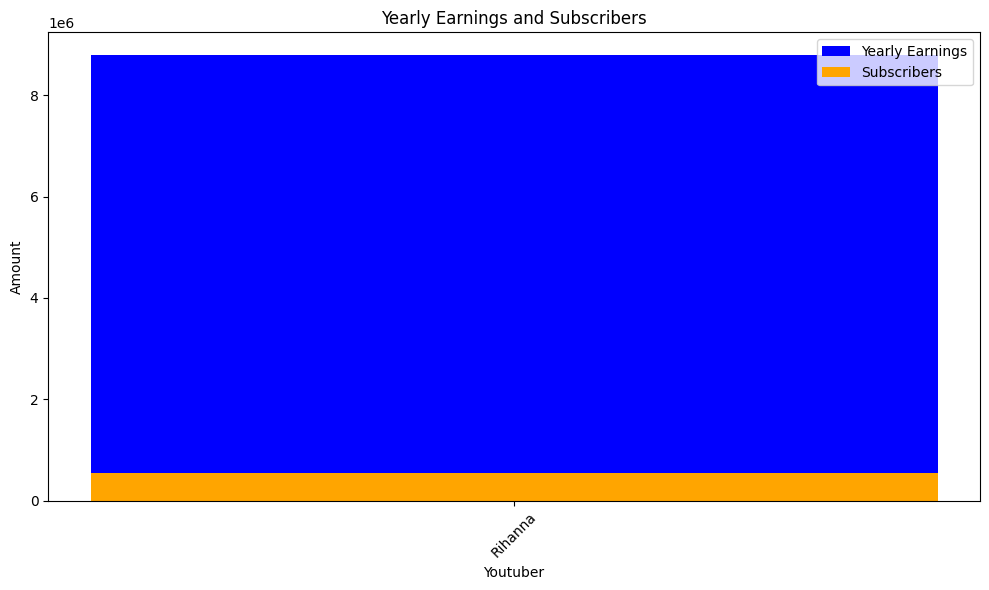

 86%|████████▌ | 1860/2160 [17:59<02:29,  2.01it/s]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: Jamuna TV


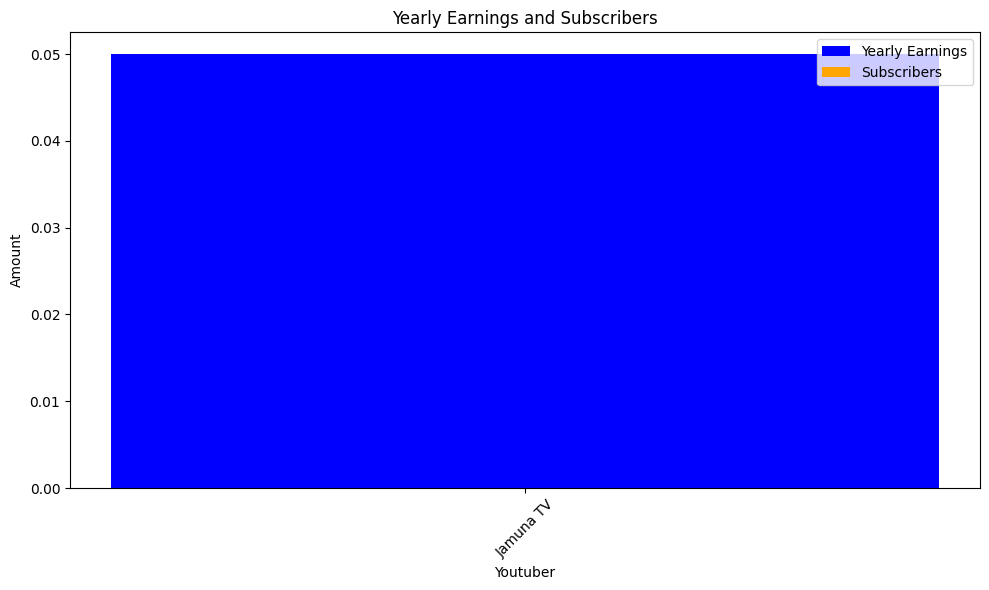

 86%|████████▋ | 1863/2160 [18:00<02:28,  2.00it/s]check
highest_yearly_earnings: 6100000.0, Subscribers: 382300.0, Youtuber: Bounce Patrol - Kids Songs
highest_yearly_earnings: 1100000.0, Subscribers: 69800.0, Youtuber: Chloe Ting
highest_yearly_earnings: 1300000.0, Subscribers: 78200.0, Youtuber: LazarBeam
highest_yearly_earnings: 18800000.0, Subscribers: 1200000.0, Youtuber: How Ridiculous
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: The Game Theorists
highest_yearly_earnings: 745200.0, Subscribers: 46600.0, Youtuber: HowToBasic
highest_yearly_earnings: 1.0, Subscribers: 0.08, Youtuber: Jason Vlogs
highest_yearly_earnings: 1000000.0, Subscribers: 63200.0, Youtuber: Lachlan
highest_yearly_earnings: 7.0, Subscribers: 0.44, Youtuber: Trap City


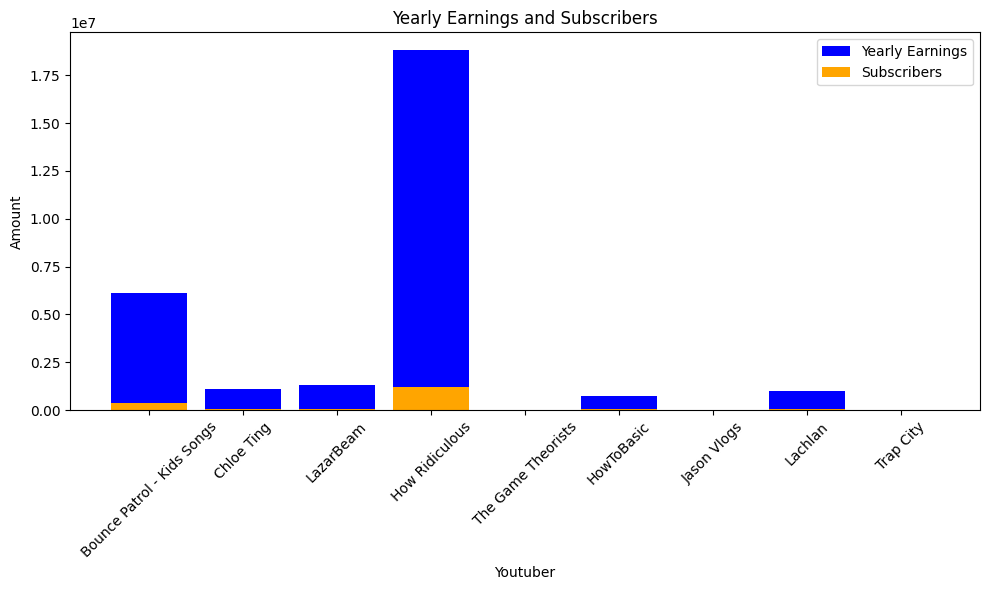

 86%|████████▋ | 1866/2160 [18:02<02:23,  2.05it/s]check
highest_yearly_earnings: 24600000.0, Subscribers: 1500000.0, Youtuber: Rubï¿½ï¿½ï¿½ï¿½ï¿½ï¿½


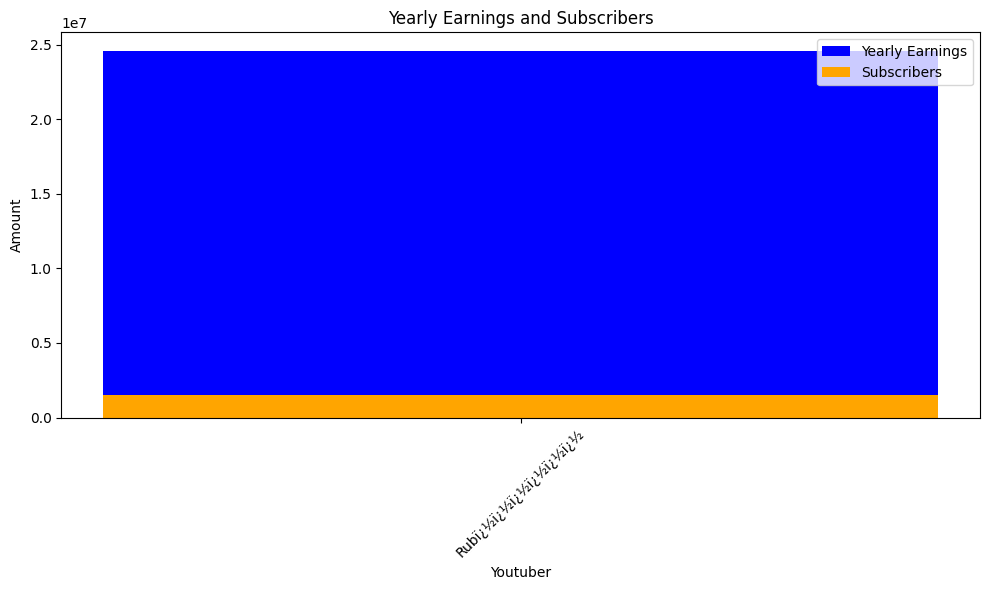

 87%|████████▋ | 1869/2160 [18:04<02:10,  2.23it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


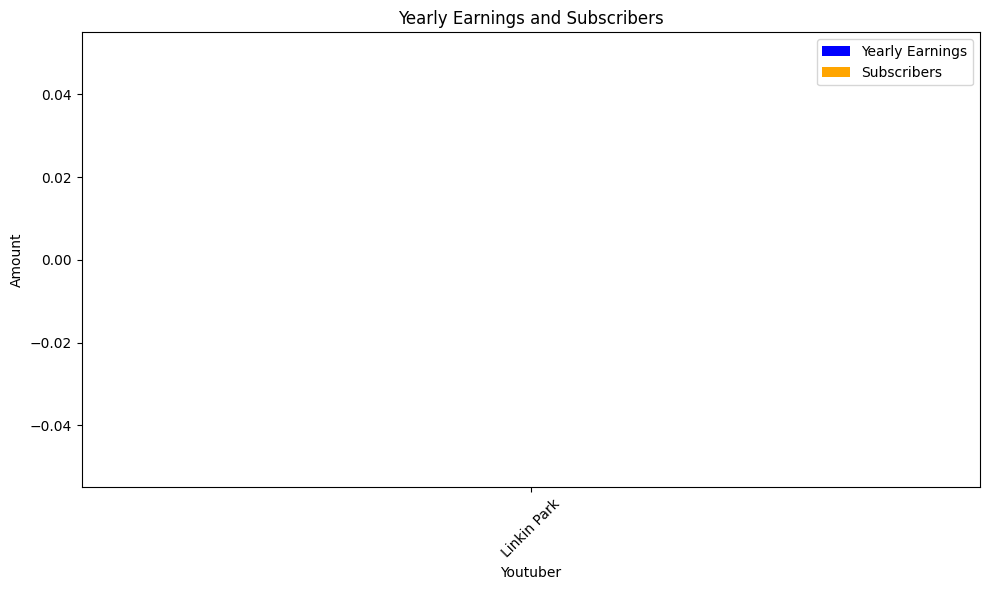

 87%|████████▋ | 1872/2160 [18:05<02:05,  2.29it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Linkin Park


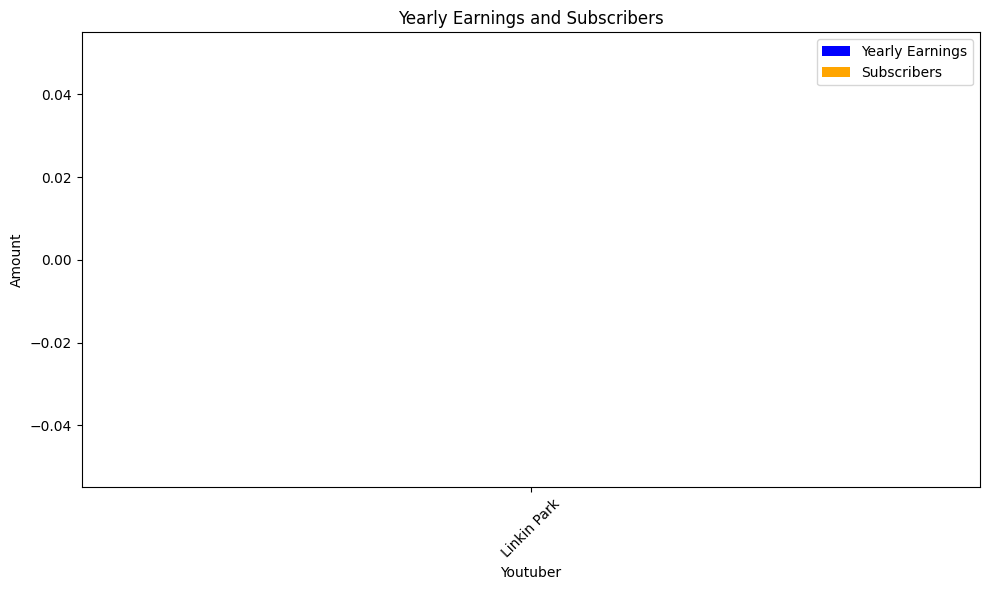

check
highest_yearly_earnings: 4100000.0, Subscribers: 253400.0, Youtuber: Like Nastya VNM
highest_yearly_earnings: 12300000.0, Subscribers: 770200.0, Youtuber: POPS Kids
highest_yearly_earnings: 1700000.0, Subscribers: 105400.0, Youtuber: FAPTV


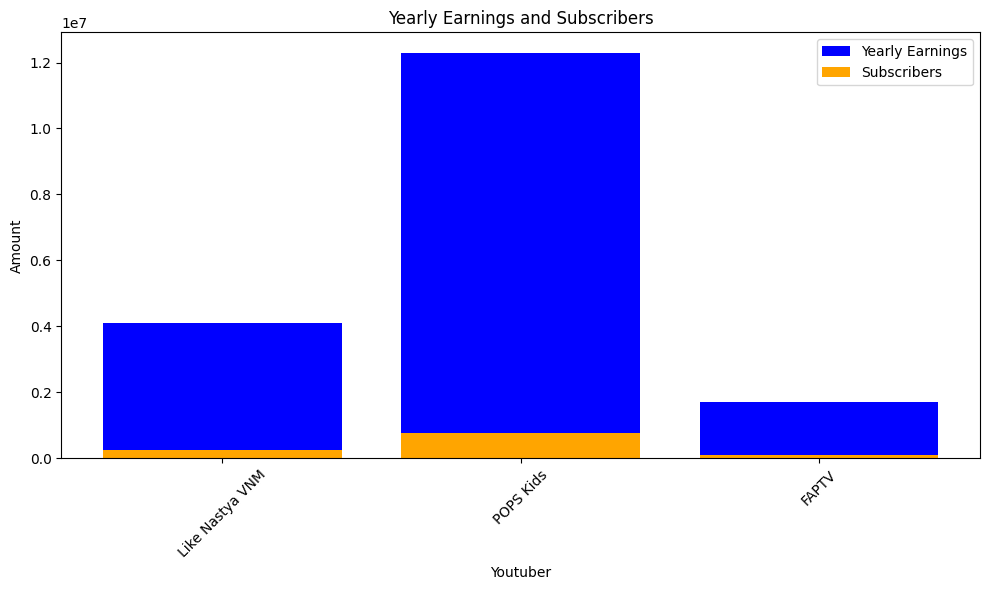

 87%|████████▋ | 1875/2160 [18:07<02:21,  2.01it/s]check
highest_yearly_earnings: 172.0, Subscribers: 11.0, Youtuber: YOLO AVENTURAS


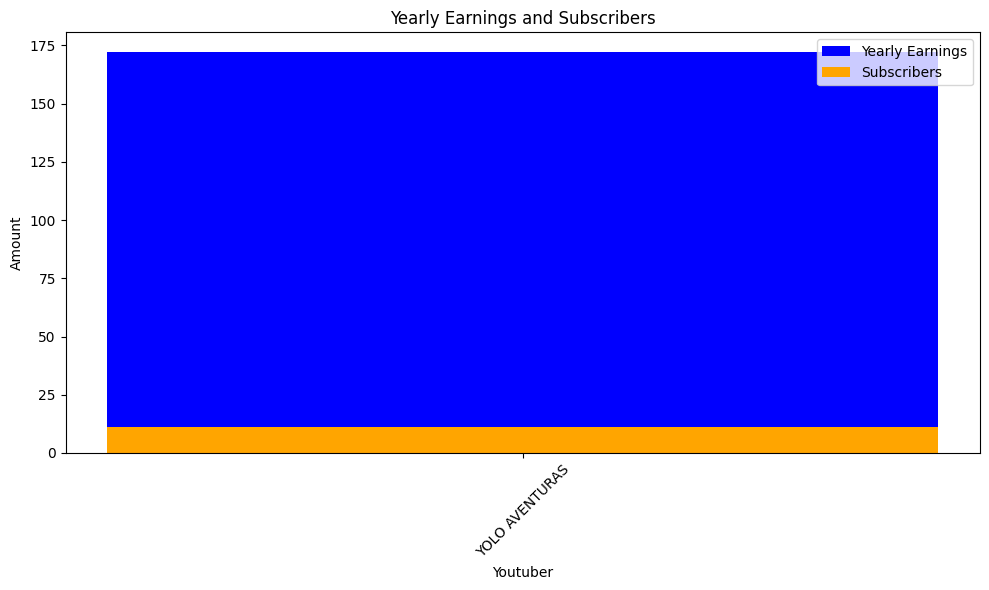

 87%|████████▋ | 1878/2160 [18:09<02:07,  2.20it/s]check
highest_yearly_earnings: 0.58, Subscribers: 0.04, Youtuber: YouTube Movies
highest_yearly_earnings: 64700000.0, Subscribers: 4000000.0, Youtuber: MrBeast
highest_yearly_earnings: 94800000.0, Subscribers: 5900000.0, Youtuber: Cocomelon - Nursery Rhymes
highest_yearly_earnings: 35100000.0, Subscribers: 2200000.0, Youtuber: ýýý Kids Diana Show
highest_yearly_earnings: 27900000.0, Subscribers: 1700000.0, Youtuber: Vlad and Niki
highest_yearly_earnings: 34300000.0, Subscribers: 2100000.0, Youtuber: WWE
highest_yearly_earnings: 0.77, Subscribers: 0.05, Youtuber: Sports
highest_yearly_earnings: 22700000.0, Subscribers: 1400000.0, Youtuber: Pinkfong Baby Shark - Kids' Songs & Stories
highest_yearly_earnings: 6800000.0, Subscribers: 423600.0, Youtuber: Dude Perfect
highest_yearly_earnings: 5500000.0, Subscribers: 344000.0, Youtuber: Movieclips
highest_yearly_earnings: 12500000.0, Subscribers: 780600.0, Youtuber: EminemMusic
highest_yearly

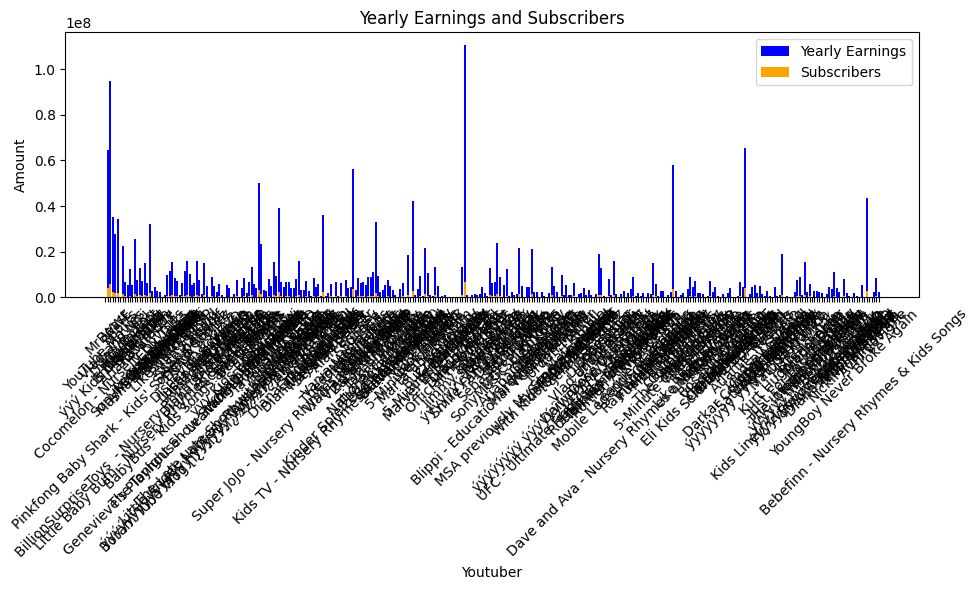

 87%|████████▋ | 1881/2160 [18:18<07:05,  1.52s/it]check
highest_yearly_earnings: 0.05, Subscribers: 0.0, Youtuber: 5-Minute Crafts
highest_yearly_earnings: 9700000.0, Subscribers: 608200.0, Youtuber: Ed Sheeran
highest_yearly_earnings: 2700000.0, Subscribers: 167000.0, Youtuber: NoCopyrightSounds
highest_yearly_earnings: 2700000.0, Subscribers: 169600.0, Youtuber: Mr Bean
highest_yearly_earnings: 11800000.0, Subscribers: 734800.0, Youtuber: Peppa Pig - Official Channel
highest_yearly_earnings: 6600000.0, Subscribers: 411300.0, Youtuber: Adele
highest_yearly_earnings: 3800000.0, Subscribers: 236000.0, Youtuber: DanTDM
highest_yearly_earnings: 9500000.0, Subscribers: 596600.0, Youtuber: Coldplay
highest_yearly_earnings: 15900000.0, Subscribers: 995700.0, Youtuber: Dan Rhodes
highest_yearly_earnings: 261100.0, Subscribers: 16300.0, Youtuber: KSI
highest_yearly_earnings: 1600000.0, Subscribers: 98400.0, Youtuber: Mister Max
highest_yearly_earnings: 2600000.0, Subscribers: 160800.0, Youtub

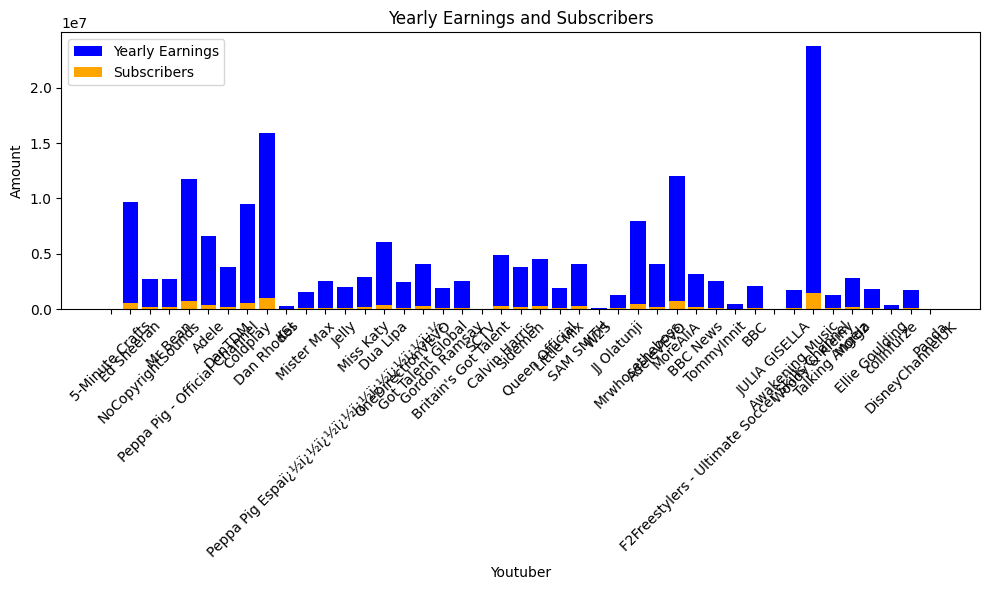

 87%|████████▋ | 1884/2160 [18:20<04:19,  1.06it/s]check
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Supercar Blondie


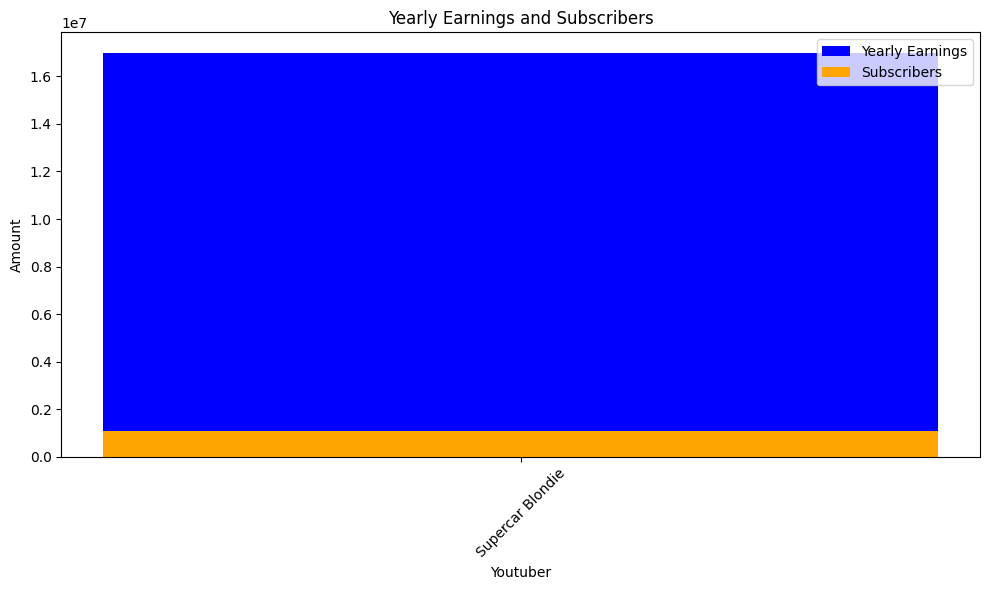

 87%|████████▋ | 1887/2160 [18:22<02:45,  1.65it/s]check
highest_yearly_earnings: 1400000.0, Subscribers: 87000.0, Youtuber: SlivkiShow
highest_yearly_earnings: 3300000.0, Subscribers: 204000.0, Youtuber: ýýýýýýýýýýýýýýýýýýýýýý
highest_yearly_earnings: 17800000.0, Subscribers: 1100000.0, Youtuber: News 24
highest_yearly_earnings: 2300000.0, Subscribers: 141400.0, Youtuber: ýýýýýýýý ýýýýýýýý
highest_yearly_earnings: 5.0, Subscribers: 0.32, Youtuber: SIS vs BRO
highest_yearly_earnings: 3600000.0, Subscribers: 225500.0, Youtuber: Lady Diana
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: VexTrex
highest_yearly_earnings: 3400000.0, Subscribers: 213400.0, Youtuber: ýýýýýýýý ýýýý ýýýýýýýýýýýýýý


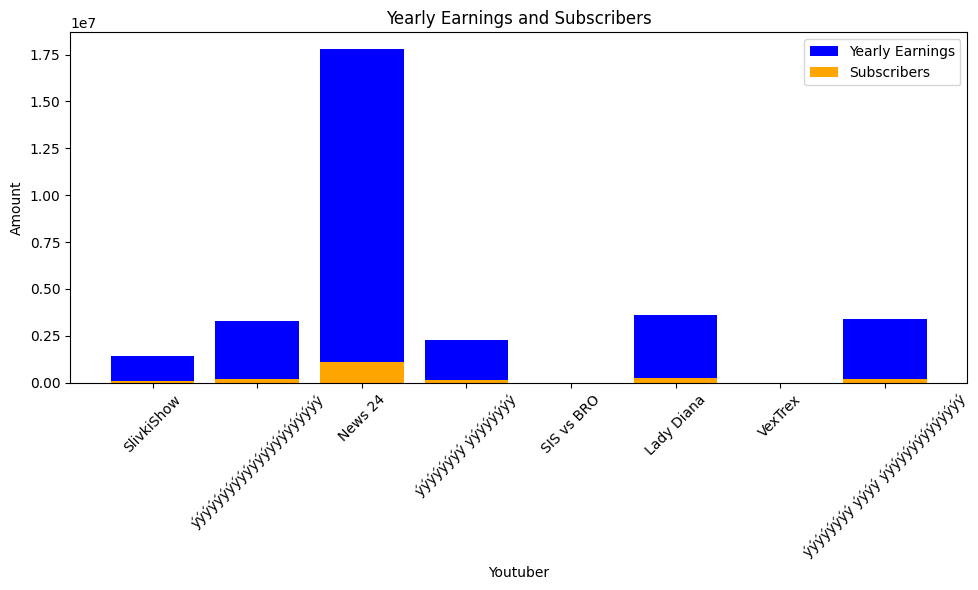

 88%|████████▊ | 1890/2160 [18:24<02:19,  1.93it/s]check
highest_yearly_earnings: 70200000.0, Subscribers: 4400000.0, Youtuber: BETER Bï¿½ï¿½
highest_yearly_earnings: 20400000.0, Subscribers: 1300000.0, Youtuber: netd mï¿½ï¿
highest_yearly_earnings: 5300000.0, Subscribers: 332400.0, Youtuber: tabii Urdu
highest_yearly_earnings: 212500.0, Subscribers: 13300.0, Youtuber: Oyuncak Avï¿


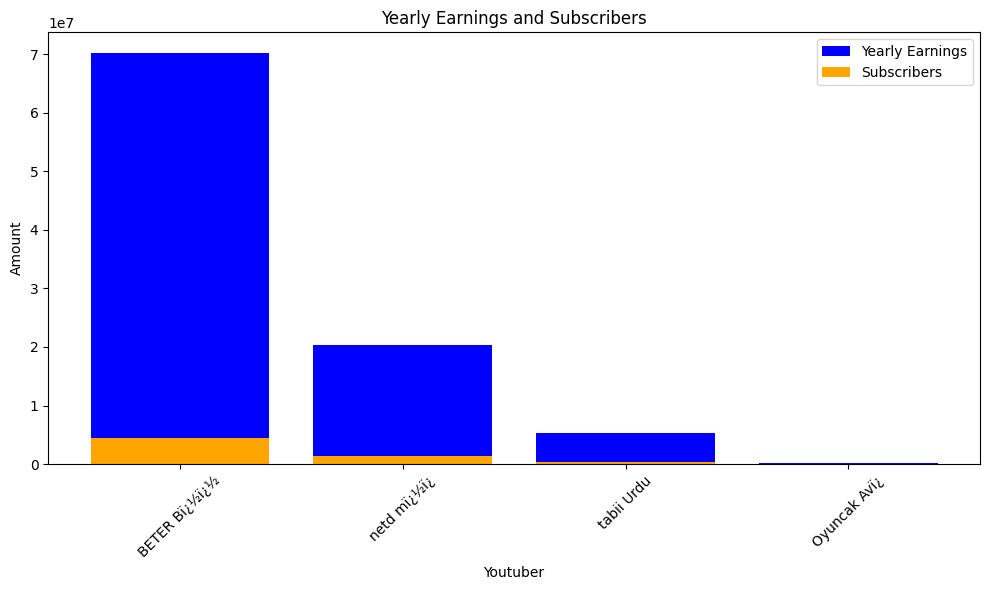

 88%|████████▊ | 1893/2160 [18:25<02:07,  2.10it/s]check
highest_yearly_earnings: 1.0, Subscribers: 0.07, Youtuber: Alan Walker
highest_yearly_earnings: 6300000.0, Subscribers: 391400.0, Youtuber: WorkpointOfficial
highest_yearly_earnings: 6800000.0, Subscribers: 422300.0, Youtuber: ýýýýýýýýýýýý one31
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Ch3Thailand
highest_yearly_earnings: 6300000.0, Subscribers: 390700.0, Youtuber: GMM GRAMMY OFFICIAL
highest_yearly_earnings: 8100000.0, Subscribers: 505800.0, Youtuber: GRAMMY GOLD OFFICIAL
highest_yearly_earnings: 2600000.0, Subscribers: 162400.0, Youtuber: RsiamMusic : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: zbing z.
highest_yearly_earnings: 11300000.0, Subscribers: 708000.0, Youtuber: AMARINTV : ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½
highest_yearly_earnings: 448400.0, Subscribers: 28000.0, Youtuber: Kaykai Salaider
highest_yearly_earnings: 4200000.0, Subscribers: 263300.0, You

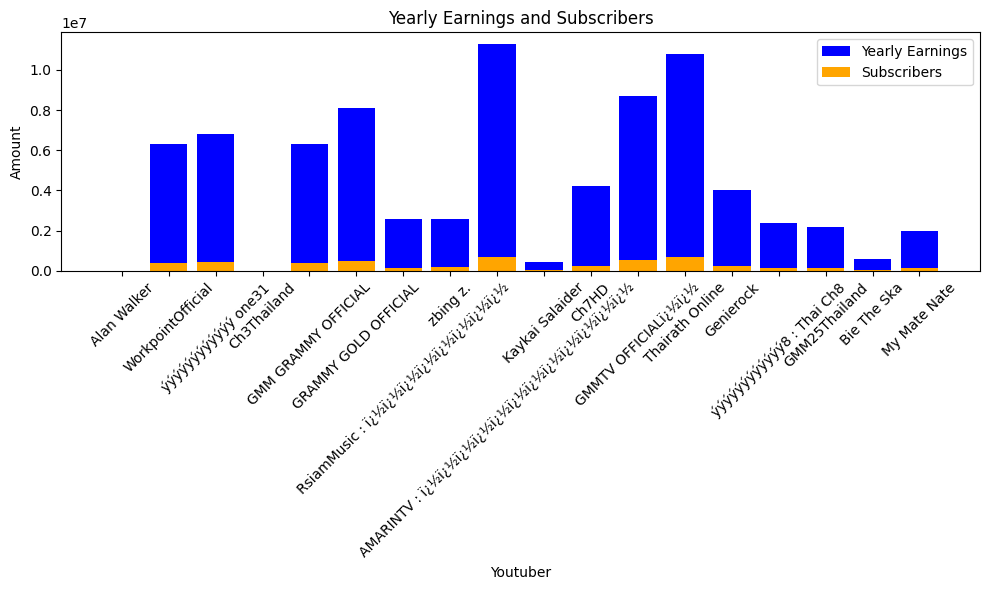

 88%|████████▊ | 1896/2160 [18:27<02:09,  2.04it/s]check
highest_yearly_earnings: 2800000.0, Subscribers: 176600.0, Youtuber: FIFA


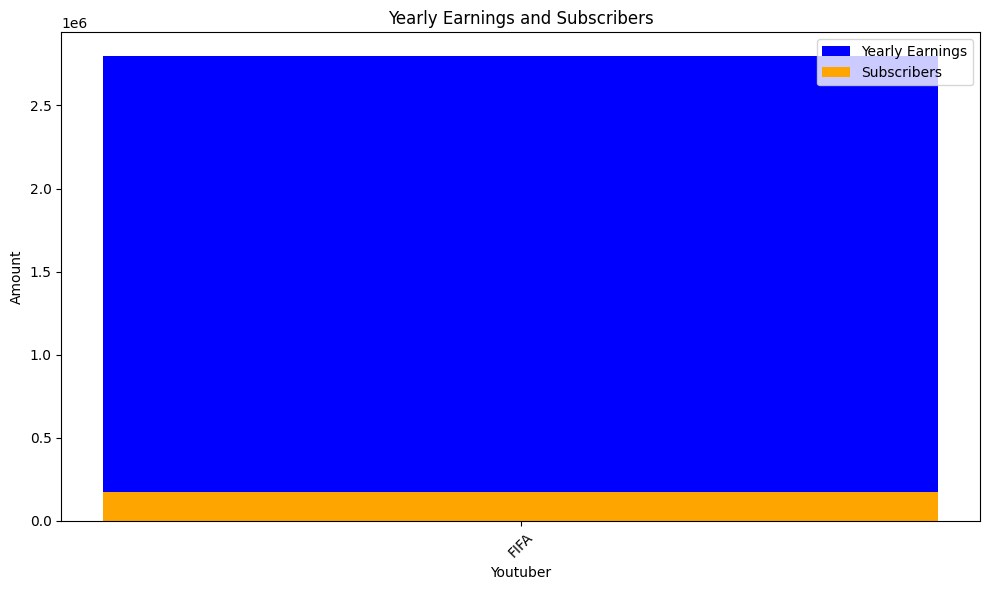

 88%|████████▊ | 1899/2160 [18:29<01:53,  2.30it/s]check
highest_yearly_earnings: 3900000.0, Subscribers: 243700.0, Youtuber: Avicii
highest_yearly_earnings: 23000000.0, Subscribers: 1400000.0, Youtuber: Panda Shorts
highest_yearly_earnings: 658000.0, Subscribers: 41100.0, Youtuber: Narins Beauty
highest_yearly_earnings: 185800.0, Subscribers: 11600.0, Youtuber: RobTopGames


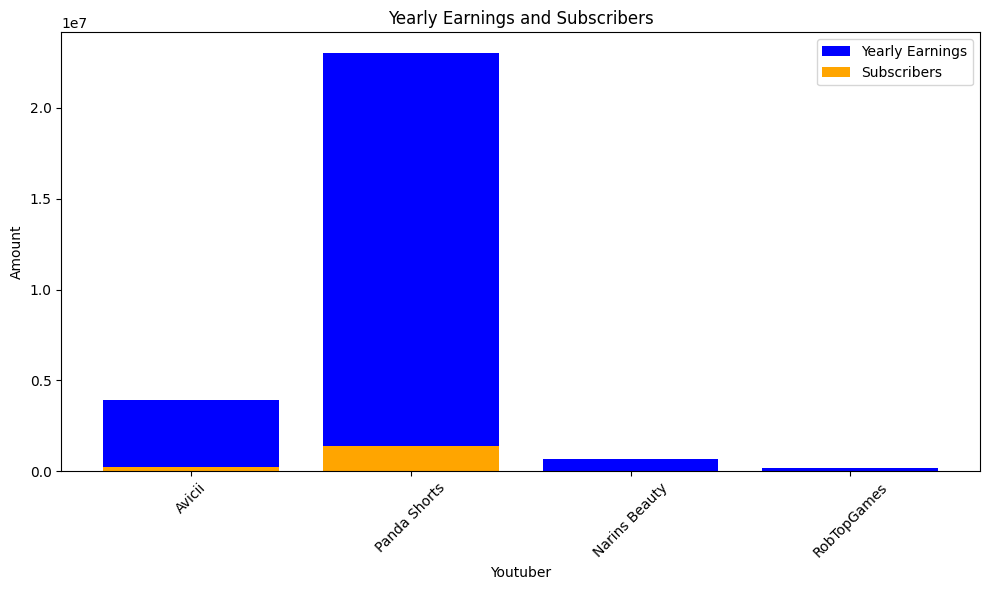

 88%|████████▊ | 1902/2160 [18:30<02:00,  2.14it/s]check
highest_yearly_earnings: 12700000.0, Subscribers: 792300.0, Youtuber: Mikecrack
highest_yearly_earnings: 1900000.0, Subscribers: 117300.0, Youtuber: VEGETTA777
highest_yearly_earnings: 582900.0, Subscribers: 36400.0, Youtuber: AuronPlay
highest_yearly_earnings: 5.0, Subscribers: 0.31, Youtuber: CKN
highest_yearly_earnings: 528200.0, Subscribers: 33000.0, Youtuber: TheWillyrex
highest_yearly_earnings: 2100000.0, Subscribers: 131500.0, Youtuber: TheGrefg
highest_yearly_earnings: 739500.0, Subscribers: 46200.0, Youtuber: Willyrex
highest_yearly_earnings: 3100.0, Subscribers: 196.0, Youtuber: IDEAS EN 5 MINUTOS
highest_yearly_earnings: 0.19, Subscribers: 0.01, Youtuber: AdMe
highest_yearly_earnings: 4100000.0, Subscribers: 254600.0, Youtuber: FC Barcelona
highest_yearly_earnings: 286600.0, Subscribers: 17900.0, Youtuber: Makiman131
highest_yearly_earnings: 665200.0, Subscribers: 41600.0, Youtuber: iTownGamePlay *Terror&Diversiï¿½ï
hi

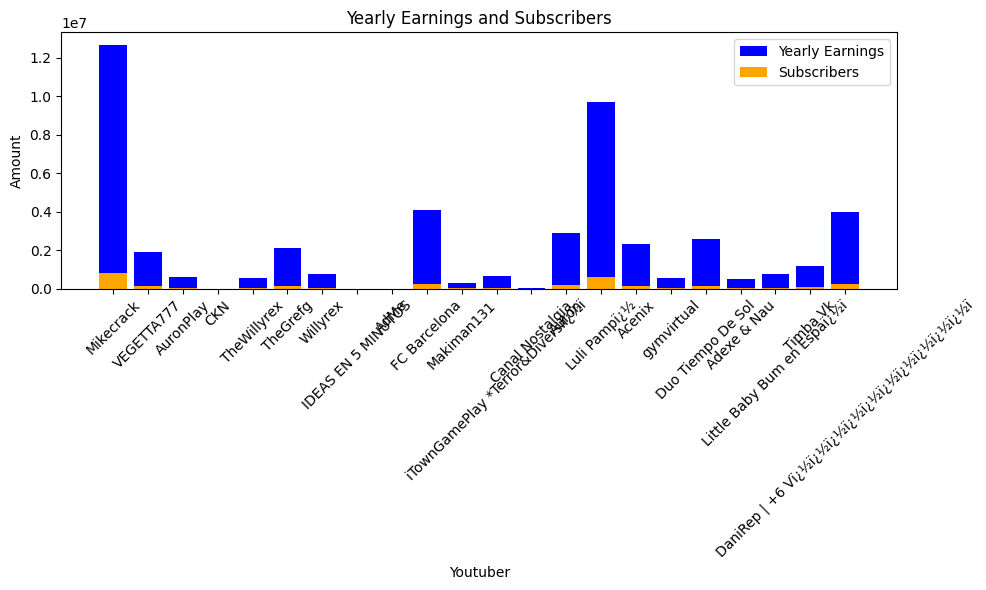

 88%|████████▊ | 1905/2160 [18:33<02:30,  1.69it/s]check
highest_yearly_earnings: 23900000.0, Subscribers: 1500000.0, Youtuber: BLACKPINK
highest_yearly_earnings: 8100000.0, Subscribers: 504900.0, Youtuber: BANGTANTV
highest_yearly_earnings: 28700000.0, Subscribers: 1800000.0, Youtuber: HYBE LABELS
highest_yearly_earnings: 14800000.0, Subscribers: 922900.0, Youtuber: JYP Entertainment
highest_yearly_earnings: 5100000.0, Subscribers: 316700.0, Youtuber: 1theK (ï¿½ï¿½ï¿½ï¿½ï
highest_yearly_earnings: 7600000.0, Subscribers: 475600.0, Youtuber: Mnet K-POP
highest_yearly_earnings: 5200000.0, Subscribers: 324000.0, Youtuber: KBS WORLD TV
highest_yearly_earnings: 3100000.0, Subscribers: 195000.0, Youtuber: officialpsy
highest_yearly_earnings: 163400000.0, Subscribers: 10200000.0, Youtuber: ýýýýýýýýý KIMPRO
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Jane ASMR ï¿½ï¿½
highest_yearly_earnings: 532700.0, Subscribers: 33300.0, Youtuber: JFlaMusic
highest_yearly_earnings: 2000000.0, S

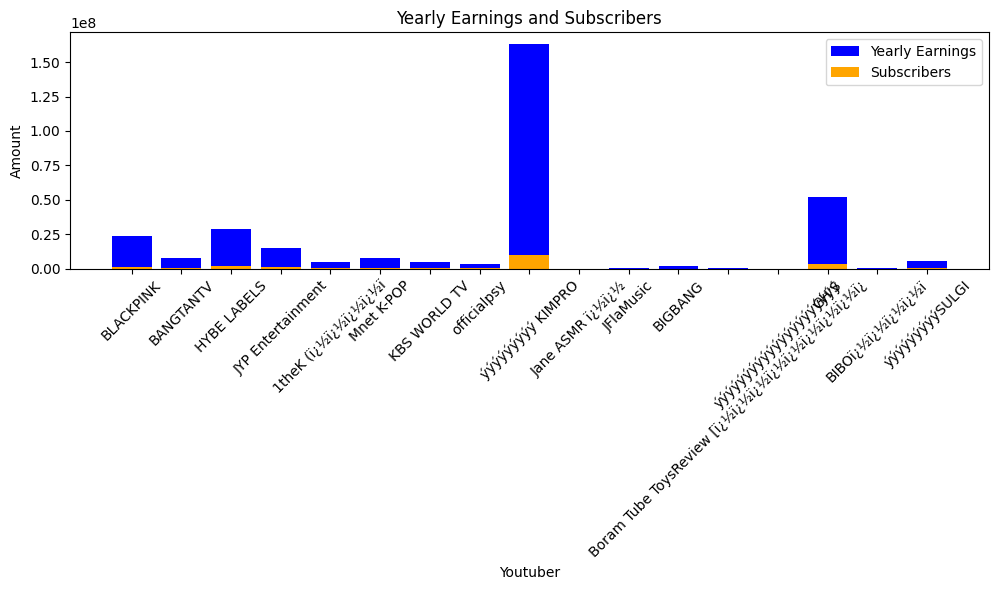

 88%|████████▊ | 1908/2160 [18:35<02:30,  1.67it/s]check
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Sandeep Maheshwari
highest_yearly_earnings: 5600000.0, Subscribers: 351600.0, Youtuber: LEGO
highest_yearly_earnings: 45100.0, Subscribers: 2800.0, Youtuber: MY FAMILY


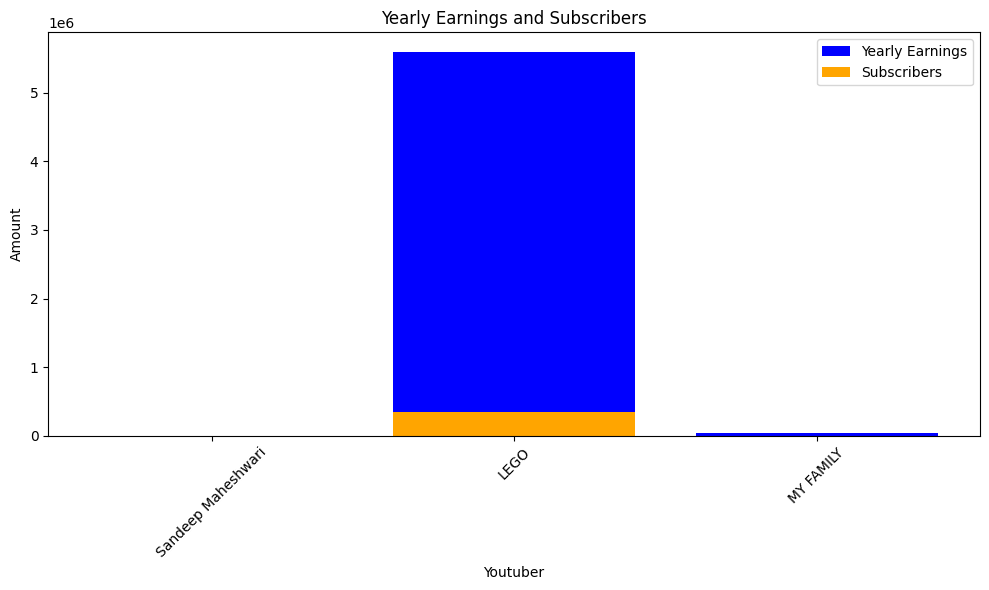

 88%|████████▊ | 1911/2160 [18:37<02:10,  1.91it/s]check
highest_yearly_earnings: 76300.0, Subscribers: 4800.0, Youtuber: shfa
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: 1MILLION Dance Studio
highest_yearly_earnings: 3500000.0, Subscribers: 221500.0, Youtuber: mmoshaya
highest_yearly_earnings: 2100000.0, Subscribers: 129000.0, Youtuber: ýýýýýýýý ýýýýýýýýýý ýýýýýýýýýý | Arab Games Network
highest_yearly_earnings: 4400000.0, Subscribers: 272700.0, Youtuber: Katakit Baby TV
highest_yearly_earnings: 6500000.0, Subscribers: 405100.0, Youtuber: ýýýýýýýý ýý ýýýýýýýý
highest_yearly_earnings: 129300.0, Subscribers: 8100.0, Youtuber: ýýýýýýýýýý ýýýýýýýýýýýý
highest_yearly_earnings: 224300.0, Subscribers: 14000.0, Youtuber: ýýýýýýýýýýýý ýýýýýýýýýýýý I ýýýýýý ýý ýýýýýýýýýý
highest_yearly_earnings: 3400000.0, Subscribers: 212100.0, Youtuber: BanderitaX


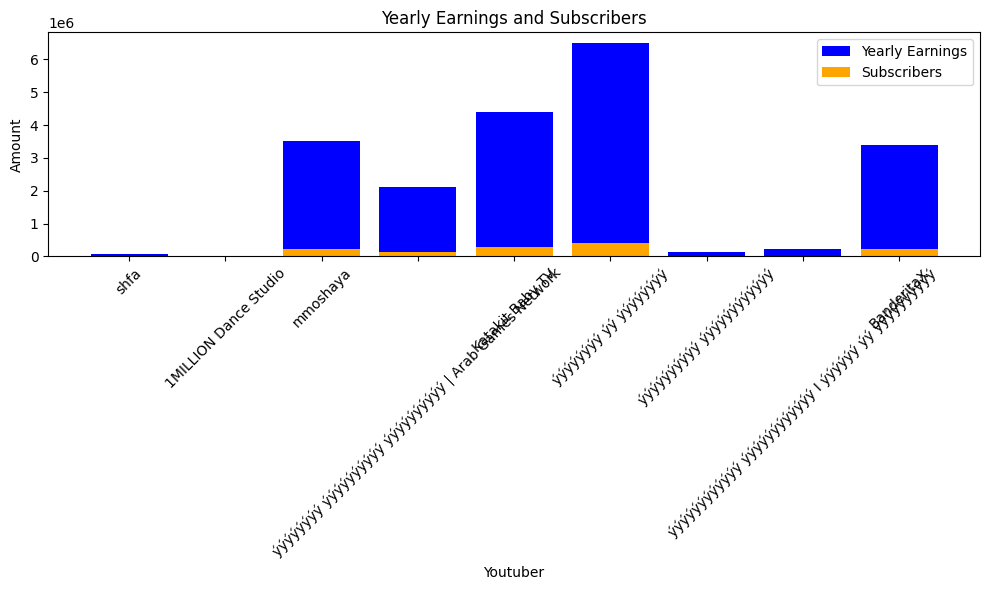

 89%|████████▊ | 1914/2160 [18:39<02:17,  1.79it/s]check
highest_yearly_earnings: 18.0, Subscribers: 1.0, Youtuber: DJ Khaled


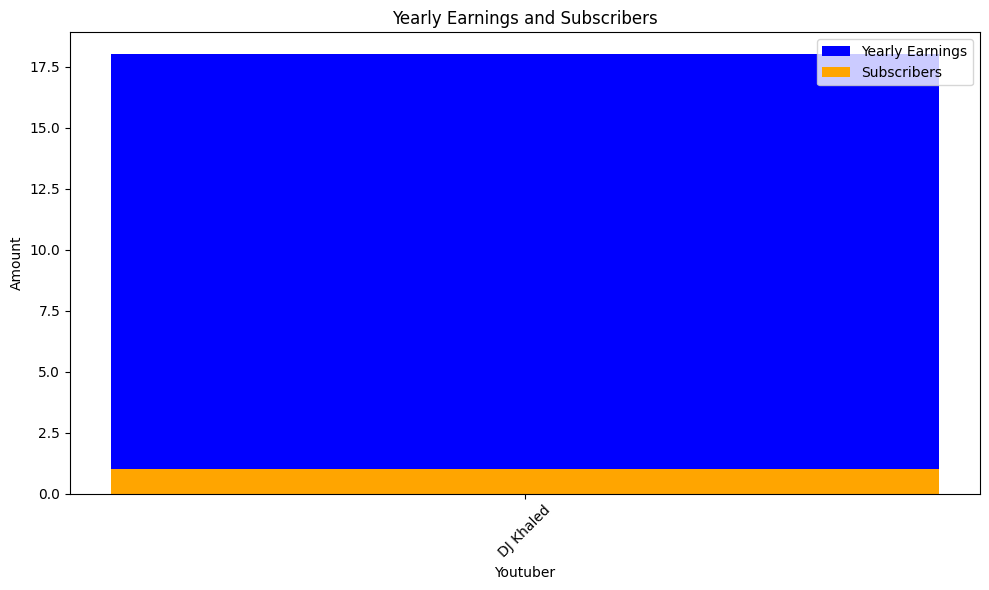

 89%|████████▉ | 1917/2160 [18:41<02:08,  1.89it/s]check
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya
highest_yearly_earnings: 14700000.0, Subscribers: 919600.0, Youtuber: Get Movies
highest_yearly_earnings: 14600000.0, Subscribers: 911300.0, Youtuber: ýýýýýýýý ýý ýýýýýýýýýýýýýý
highest_yearly_earnings: 26500000.0, Subscribers: 1700000.0, Youtuber: tuzelity SHUFFLE
highest_yearly_earnings: 1200000.0, Subscribers: 73700.0, Youtuber: HiMan
highest_yearly_earnings: 1800000.0, Subscribers: 114800.0, Youtuber: Marmok
highest_yearly_earnings: 2300000.0, Subscribers: 146800.0, Youtuber: Like Nastya Vlog
highest_yearly_earnings: 1800000.0, Subscribers: 111500.0, Youtuber: TheBrianMaps
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: ýýýýýýýýýý
highest_yearly_earnings: 22800000.0, Subscribers: 1400000.0, Youtuber: ILYA BORZOV
highest_yearly_earnings: 4600000.0, Subscribers: 286800.0, Youtuber: EdisonPts
highest_yearly_earnings: 34200000.0, Subscriber

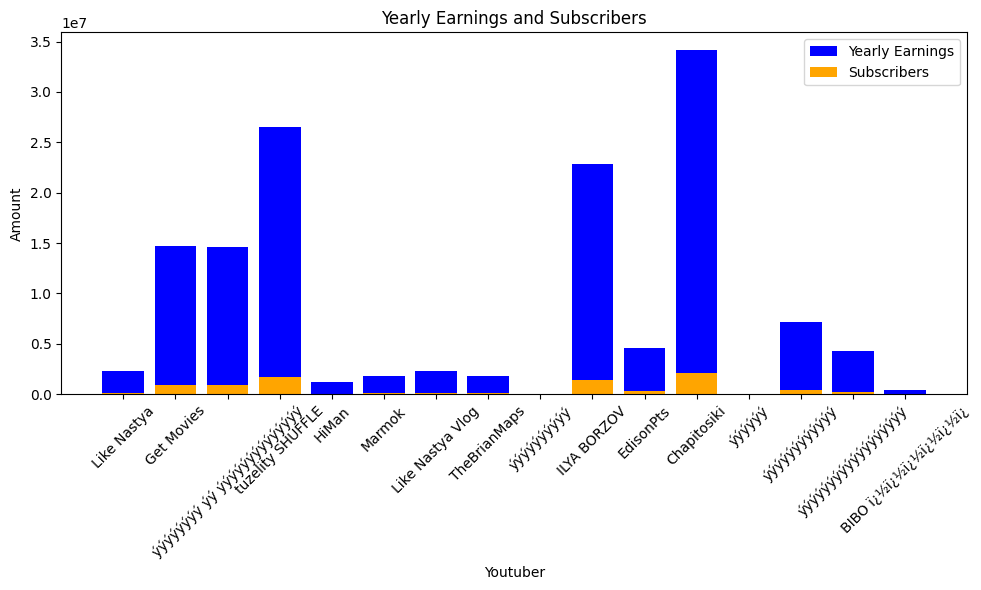

 89%|████████▉ | 1920/2160 [18:43<02:08,  1.86it/s]check
highest_yearly_earnings: 8500000.0, Subscribers: 529900.0, Youtuber: ABS-CBN Entertainment
highest_yearly_earnings: 38300000.0, Subscribers: 2400000.0, Youtuber: GMA  Network
highest_yearly_earnings: 7800000.0, Subscribers: 489400.0, Youtuber: Raffy Tulfo in Action
highest_yearly_earnings: 6800000.0, Subscribers: 427000.0, Youtuber: GMA Public  Affairs
highest_yearly_earnings: 723800.0, Subscribers: 45200.0, Youtuber: Ivana Alawi
highest_yearly_earnings: 479000.0, Subscribers: 29900.0, Youtuber: Niana Guerrero
highest_yearly_earnings: 594000.0, Subscribers: 37100.0, Youtuber: Ranz Kyle
highest_yearly_earnings: 8700000.0, Subscribers: 544900.0, Youtuber: ABS-CBN News
highest_yearly_earnings: 3000000.0, Subscribers: 188000.0, Youtuber: Wish 107.5
highest_yearly_earnings: 580200.0, Subscribers: 36300.0, Youtuber: Zeinab Harake
highest_yearly_earnings: 5500000.0, Subscribers: 346400.0, Youtuber: GMA Integrated News
highest_yearly_ear

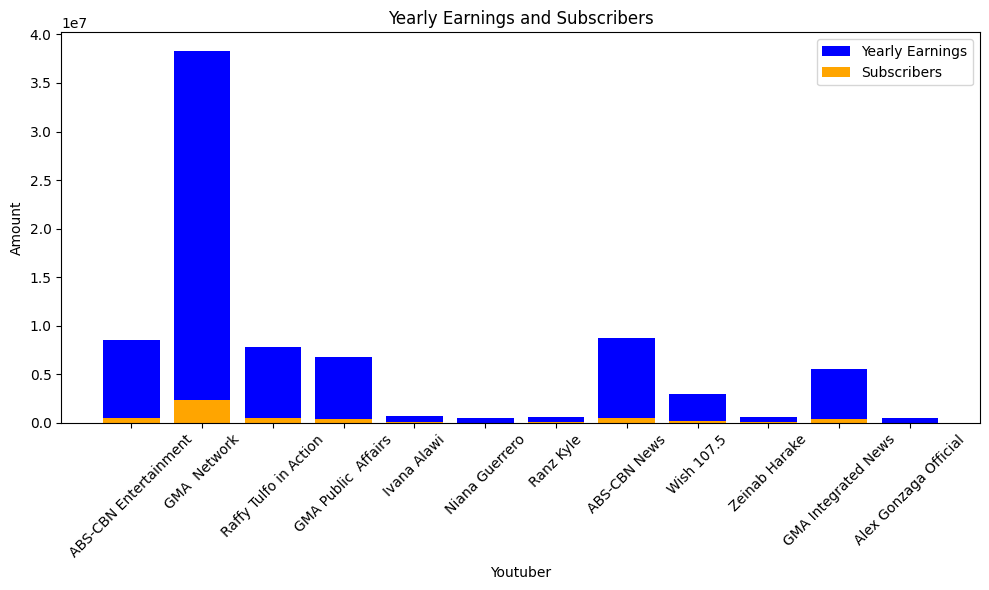

 89%|████████▉ | 1923/2160 [18:44<01:55,  2.05it/s]check
highest_yearly_earnings: 48100.0, Subscribers: 3000.0, Youtuber: Drawblogs


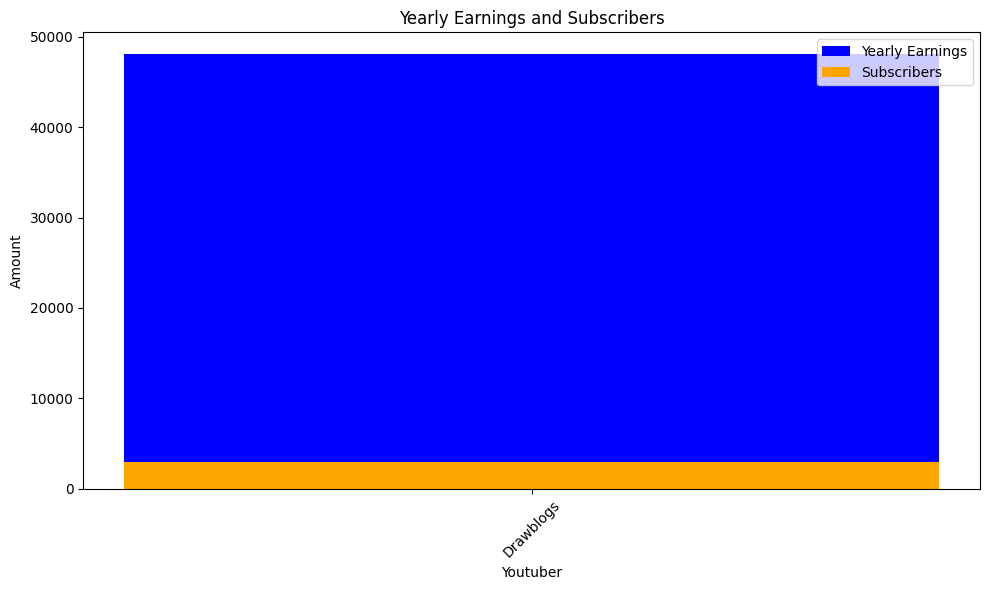

 89%|████████▉ | 1926/2160 [18:47<02:28,  1.58it/s]check
highest_yearly_earnings: 64200000.0, Subscribers: 4000000.0, Youtuber: HAR PAL GEO
highest_yearly_earnings: 55200000.0, Subscribers: 3400000.0, Youtuber: ARY Digital HD
highest_yearly_earnings: 32900000.0, Subscribers: 2100000.0, Youtuber: HUM TV
highest_yearly_earnings: 4800000.0, Subscribers: 300200.0, Youtuber: Geo News
highest_yearly_earnings: 28.0, Subscribers: 2.0, Youtuber: Wolfoo Channel
highest_yearly_earnings: 419.0, Subscribers: 26.0, Youtuber: Quantum Tech HD


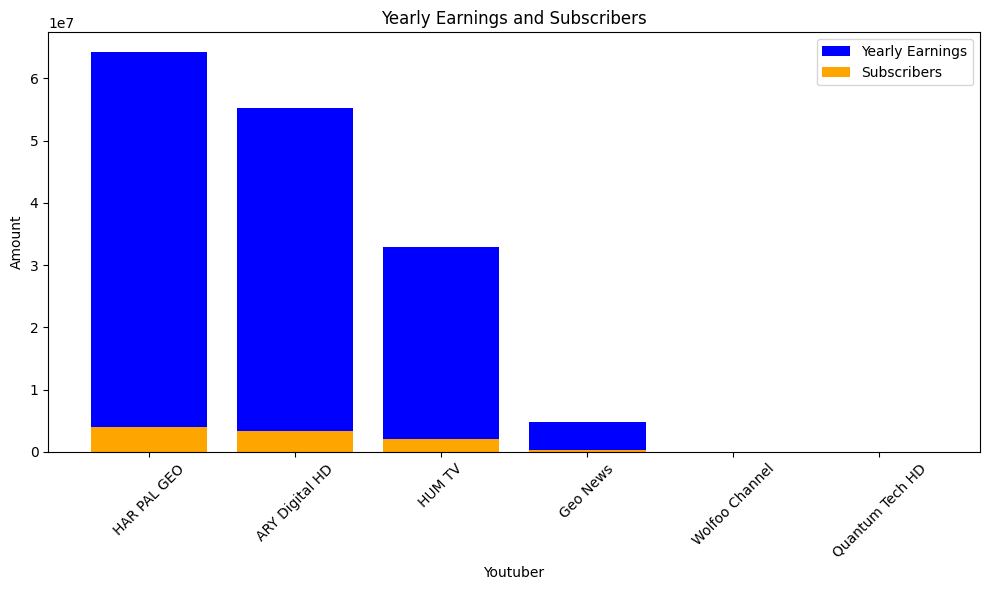

 89%|████████▉ | 1929/2160 [18:49<02:05,  1.85it/s]check
highest_yearly_earnings: 4800000.0, Subscribers: 300100.0, Youtuber: Spinnin' Records
highest_yearly_earnings: 1700000.0, Subscribers: 107800.0, Youtuber: NikkieTutorials
highest_yearly_earnings: 2600000.0, Subscribers: 165400.0, Youtuber: ýýýýýýýý/Atro


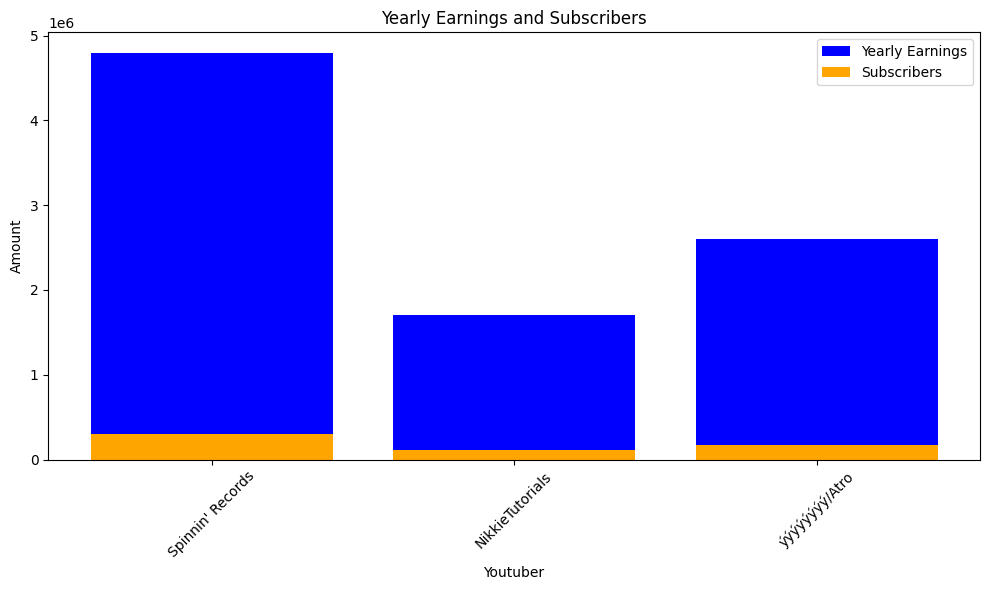

 89%|████████▉ | 1932/2160 [18:51<01:59,  1.90it/s]check
highest_yearly_earnings: 1800000.0, Subscribers: 112700.0, Youtuber: Saad Lamjarred | ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


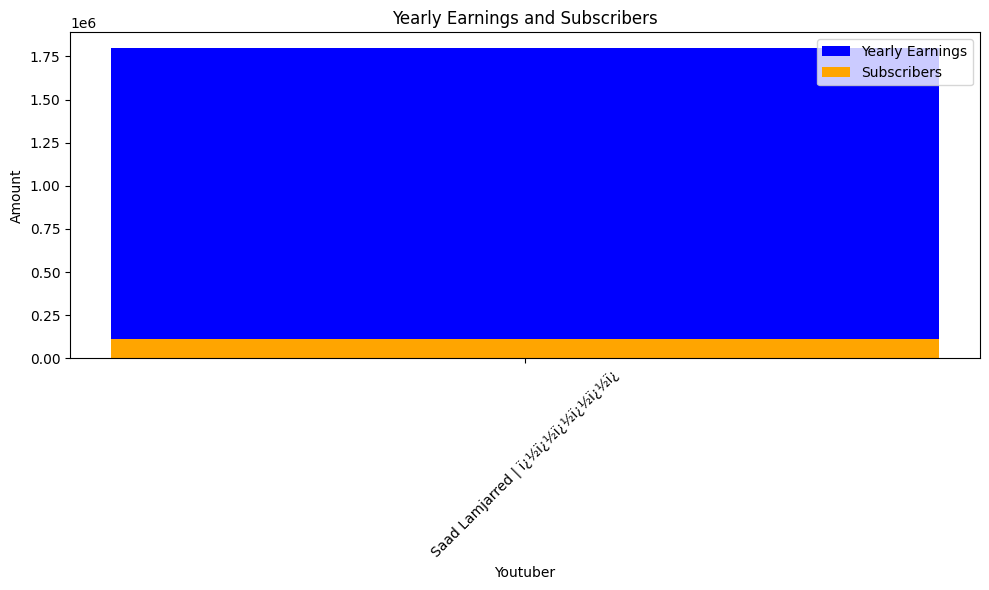

 90%|████████▉ | 1935/2160 [18:53<01:58,  1.90it/s]check
highest_yearly_earnings: 6600000.0, Subscribers: 410200.0, Youtuber: Kimberly Loaiza
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: Luisito Comunica
highest_yearly_earnings: 1500000.0, Subscribers: 94400.0, Youtuber: GENIAL
highest_yearly_earnings: 1500000.0, Subscribers: 91500.0, Youtuber: LosPolinesios
highest_yearly_earnings: 16100.0, Subscribers: 1000.0, Youtuber: Yuya
highest_yearly_earnings: 1600000.0, Subscribers: 100800.0, Youtuber: MrBeast en Espaï¿½ï
highest_yearly_earnings: 2200000.0, Subscribers: 140600.0, Youtuber: Juan De Dios Pantoja
highest_yearly_earnings: 6600000.0, Subscribers: 410500.0, Youtuber: BabyBus - Canciones Infantiles & Videos para Niï¿½ï
highest_yearly_earnings: 227.0, Subscribers: 14.0, Youtuber: Disney Latinoamï¿½ï¿½
highest_yearly_earnings: 742.0, Subscribers: 46.0, Youtuber: Tlnovelas
highest_yearly_earnings: 114300.0, Subscribers: 7100.0, Youtuber: JukiLop
highest_yearly_earnings: 590

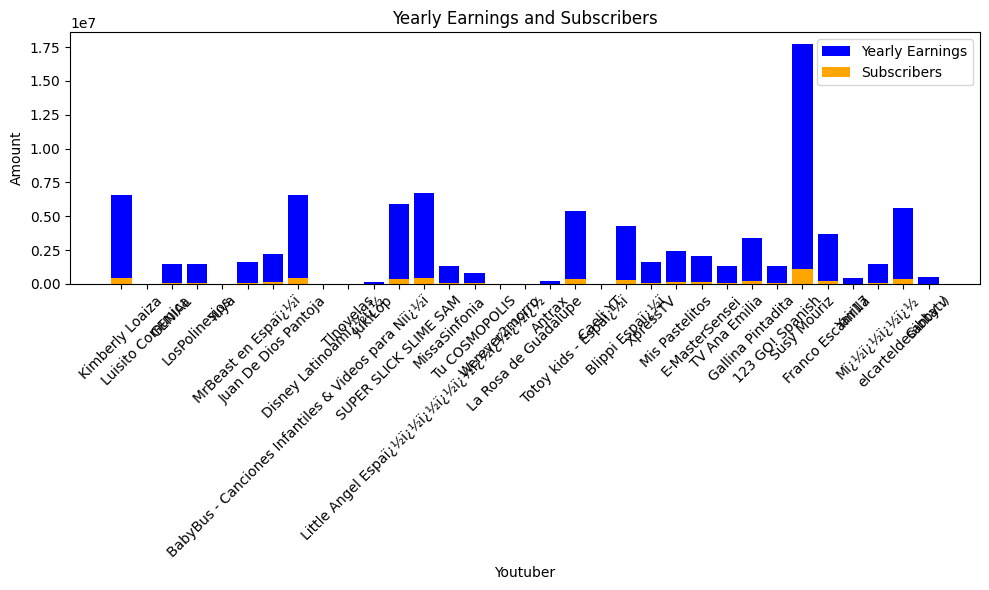

 90%|████████▉ | 1938/2160 [18:55<02:20,  1.58it/s]check
highest_yearly_earnings: 5700000.0, Subscribers: 353200.0, Youtuber: Les' Copaque Production


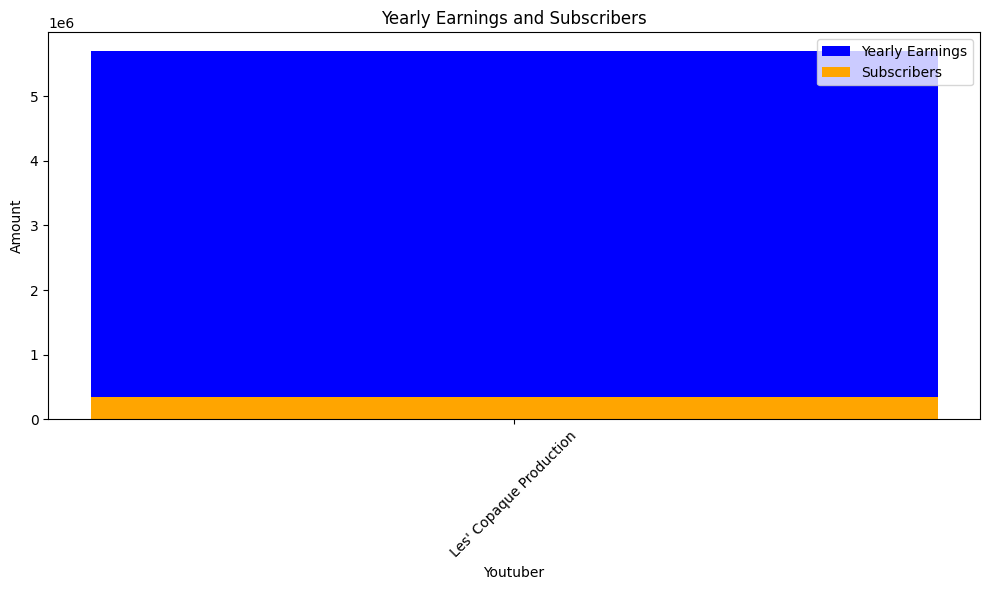

 90%|████████▉ | 1941/2160 [18:57<01:50,  1.97it/s]check
highest_yearly_earnings: 59800000.0, Subscribers: 3700000.0, Youtuber: dednahype


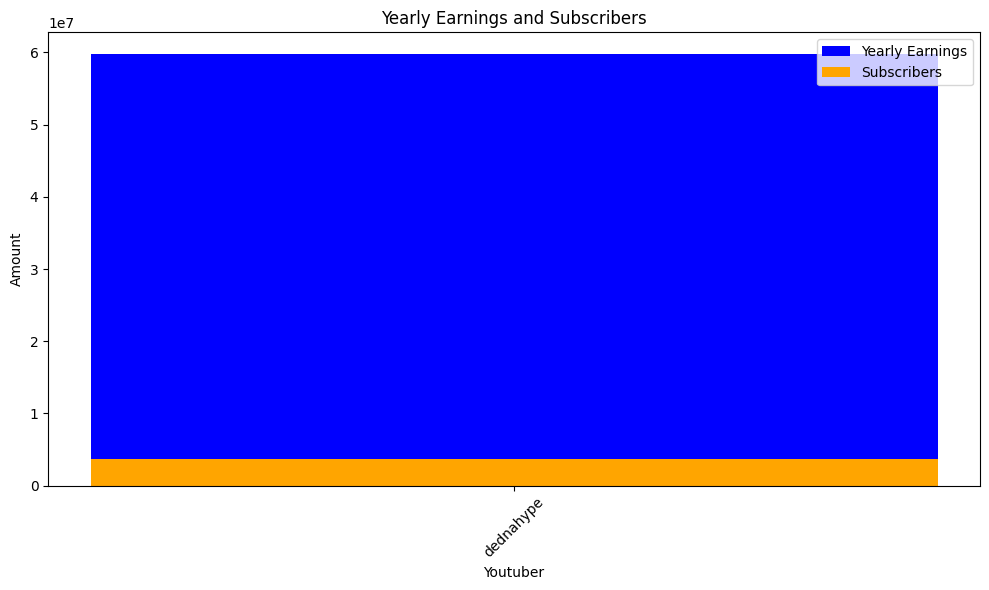

 90%|█████████ | 1944/2160 [18:59<01:39,  2.16it/s]check
highest_yearly_earnings: 7600000.0, Subscribers: 473700.0, Youtuber: AboFlah


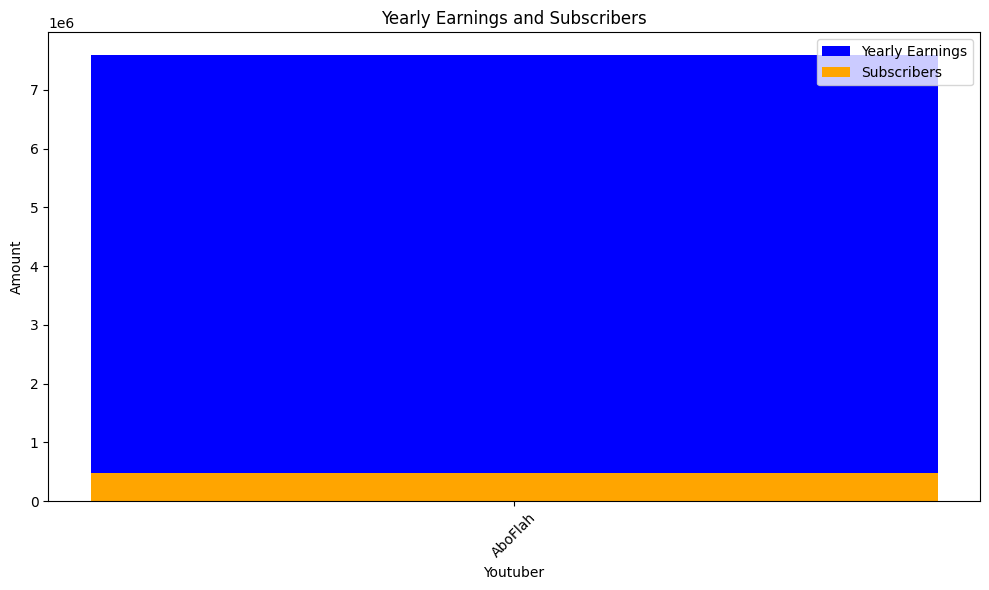

 90%|█████████ | 1947/2160 [19:00<01:35,  2.23it/s]check
highest_yearly_earnings: 5600000.0, Subscribers: 349300.0, Youtuber: ýýýýýýýý ýýýýýýýý ýýýýýýýýýý | toyoraljanahtv
highest_yearly_earnings: 8100000.0, Subscribers: 507200.0, Youtuber: toyorbabytv
highest_yearly_earnings: 4200000.0, Subscribers: 262900.0, Youtuber: karameeshchannel


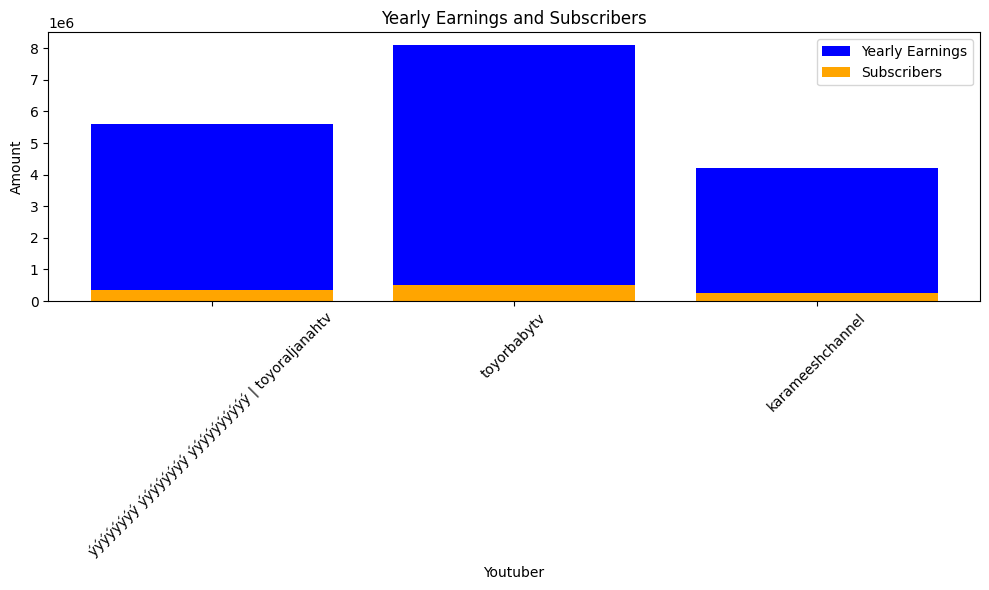

 90%|█████████ | 1950/2160 [19:02<01:34,  2.23it/s]check
highest_yearly_earnings: 119.0, Subscribers: 7.0, Youtuber: Bayashi TV


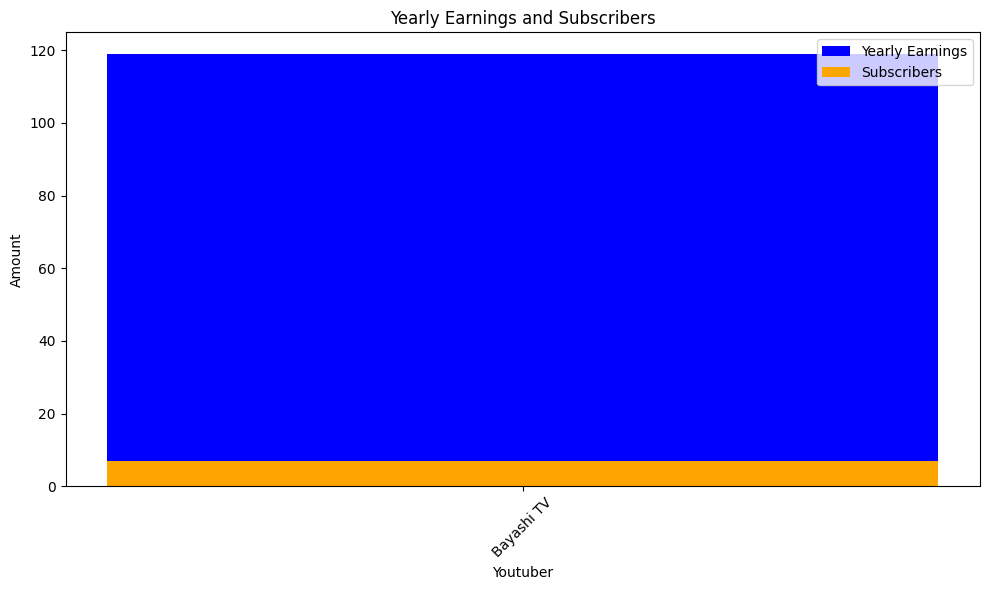

 90%|█████████ | 1953/2160 [19:03<01:30,  2.29it/s]check
highest_yearly_earnings: 58800000.0, Subscribers: 3700000.0, Youtuber: PANDA BOI
highest_yearly_earnings: 1400000.0, Subscribers: 89600.0, Youtuber: Davie504


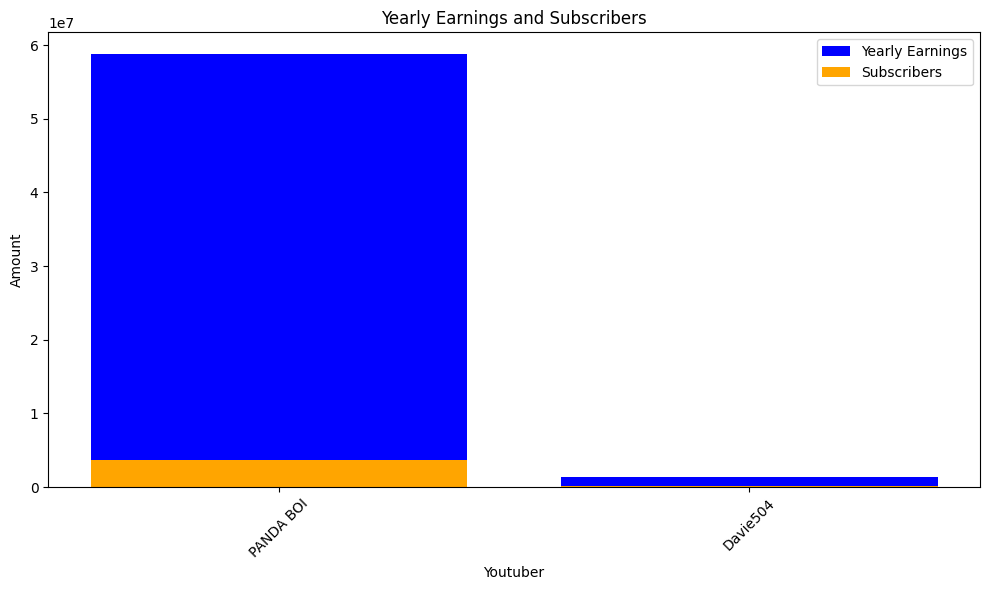

 91%|█████████ | 1956/2160 [19:05<01:34,  2.16it/s]check
highest_yearly_earnings: 5400000.0, Subscribers: 339000.0, Youtuber: ýýýýýýýýýýýýýýýý - Al-Remas
highest_yearly_earnings: 1700000.0, Subscribers: 106000.0, Youtuber: Melon City Show - ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿


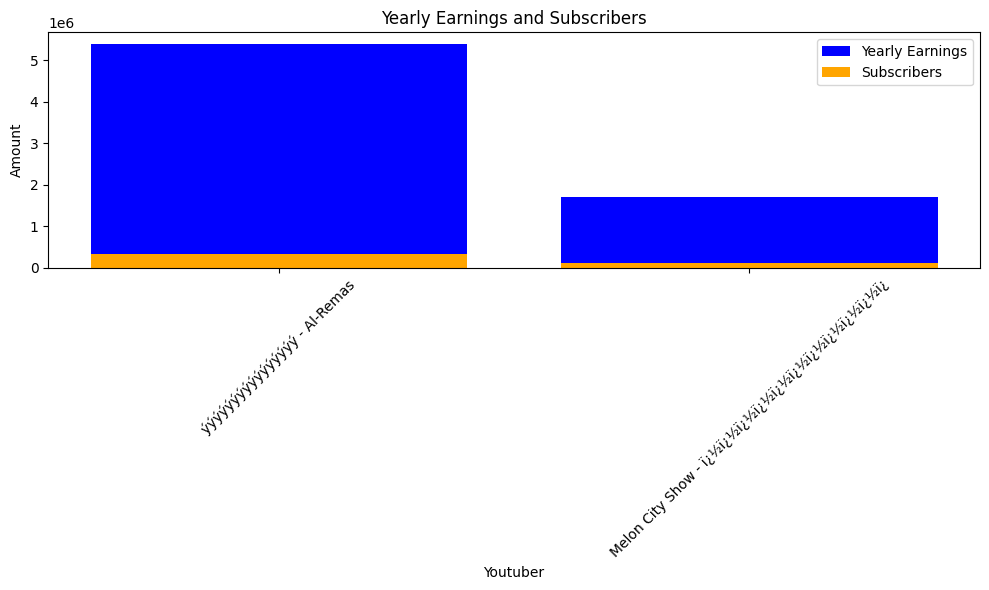

 91%|█████████ | 1959/2160 [19:07<01:43,  1.94it/s]check
highest_yearly_earnings: 26300000.0, Subscribers: 1600000.0, Youtuber: Jess No Limit
highest_yearly_earnings: 7500000.0, Subscribers: 471300.0, Youtuber: Ricis Official
highest_yearly_earnings: 1000000.0, Subscribers: 64300.0, Youtuber: AH
highest_yearly_earnings: 11000000.0, Subscribers: 690500.0, Youtuber: Indosiar
highest_yearly_earnings: 2800000.0, Subscribers: 175500.0, Youtuber: Rans Entertainment
highest_yearly_earnings: 5900000.0, Subscribers: 369600.0, Youtuber: TRANS7 OFFICIAL
highest_yearly_earnings: 1300000.0, Subscribers: 80900.0, Youtuber: Baim Paula
highest_yearly_earnings: 4.0, Subscribers: 0.26, Youtuber: Deddy Corbuzier
highest_yearly_earnings: 5400000.0, Subscribers: 338300.0, Youtuber: BabyBus - Cerita & Lagu Anak-anak
highest_yearly_earnings: 3100000.0, Subscribers: 193500.0, Youtuber: MiawAug
highest_yearly_earnings: 9500000.0, Subscribers: 592100.0, Youtuber: Willie Salim
highest_yearly_earnings: 819000.0, 

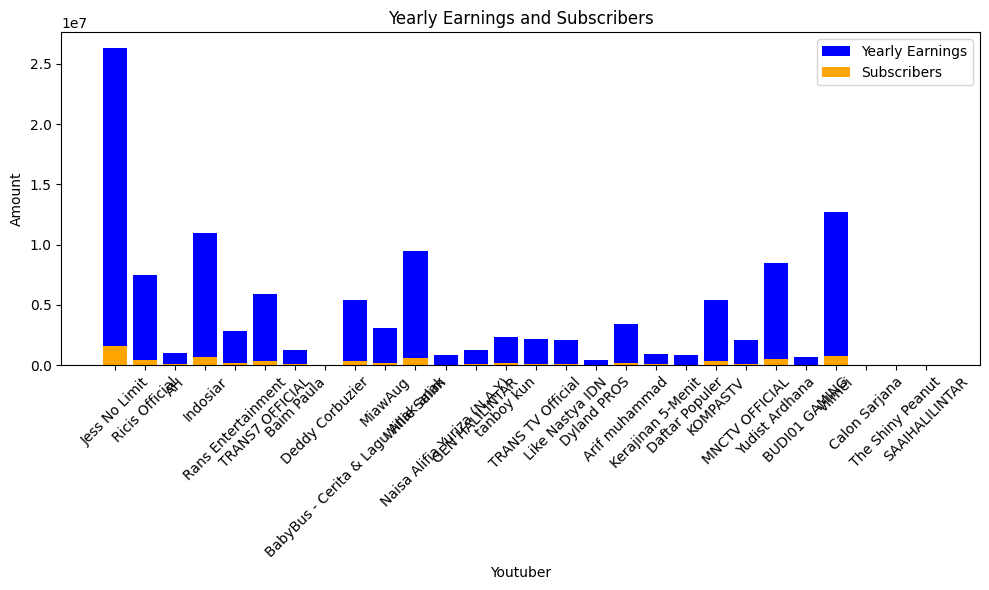

 91%|█████████ | 1962/2160 [19:10<02:07,  1.55it/s]check
highest_yearly_earnings: 108400000.0, Subscribers: 6800000.0, Youtuber: T-Series
highest_yearly_earnings: 87500000.0, Subscribers: 5500000.0, Youtuber: SET India
highest_yearly_earnings: 38600000.0, Subscribers: 2400000.0, Youtuber: Zee Music Company
highest_yearly_earnings: 79600000.0, Subscribers: 5000000.0, Youtuber: Sony SAB
highest_yearly_earnings: 81900000.0, Subscribers: 5100000.0, Youtuber: Zee TV
highest_yearly_earnings: 20200000.0, Subscribers: 1300000.0, Youtuber: ChuChu TV Nursery Rhymes & Kids Songs
highest_yearly_earnings: 12200000.0, Subscribers: 764900.0, Youtuber: Shemaroo Filmi Gaane
highest_yearly_earnings: 57000000.0, Subscribers: 3600000.0, Youtuber: Colors TV
highest_yearly_earnings: 0.48, Subscribers: 0.03, Youtuber: T-Series Bhakti Sagar
highest_yearly_earnings: 20300000.0, Subscribers: 1300000.0, Youtuber: Tips Official
highest_yearly_earnings: 11100000.0, Subscribers: 696100.0, Youtuber: Wave Music
highe

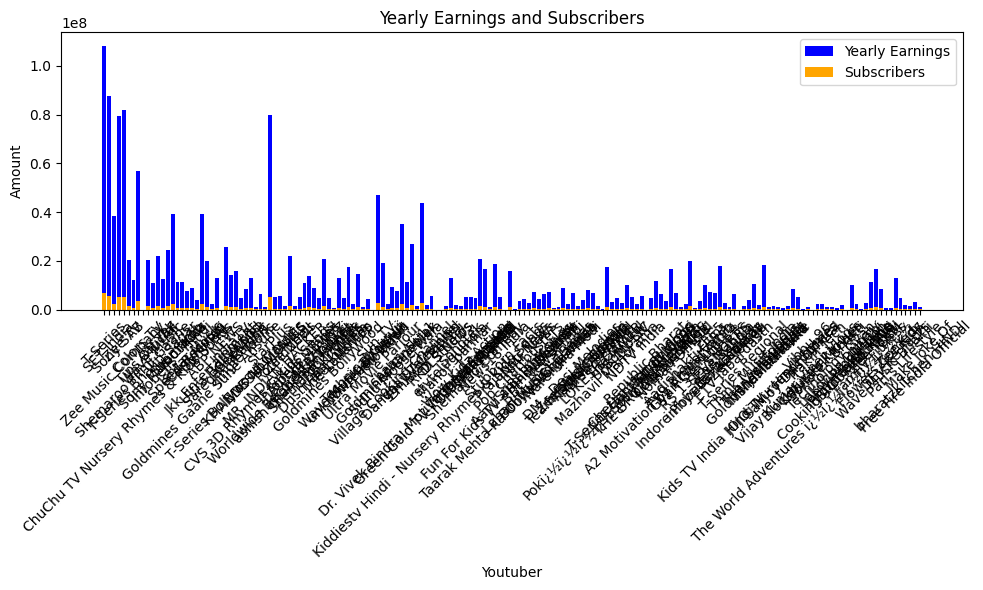

 91%|█████████ | 1965/2160 [19:15<03:26,  1.06s/it]check
highest_yearly_earnings: 36300000.0, Subscribers: 2300000.0, Youtuber: Tsuriki Show
highest_yearly_earnings: 0.0, Subscribers: 0.0, Youtuber: YOLO
highest_yearly_earnings: 1400000.0, Subscribers: 87800.0, Youtuber: Kurzgesagt ï¿½ï¿½ï¿½ï¿½ï¿½ï¿
highest_yearly_earnings: 271200.0, Subscribers: 17000.0, Youtuber: HaerteTest
highest_yearly_earnings: 29600000.0, Subscribers: 1900000.0, Youtuber: Younes Zarou
highest_yearly_earnings: 1800.0, Subscribers: 114.0, Youtuber: Beast Philanthropy


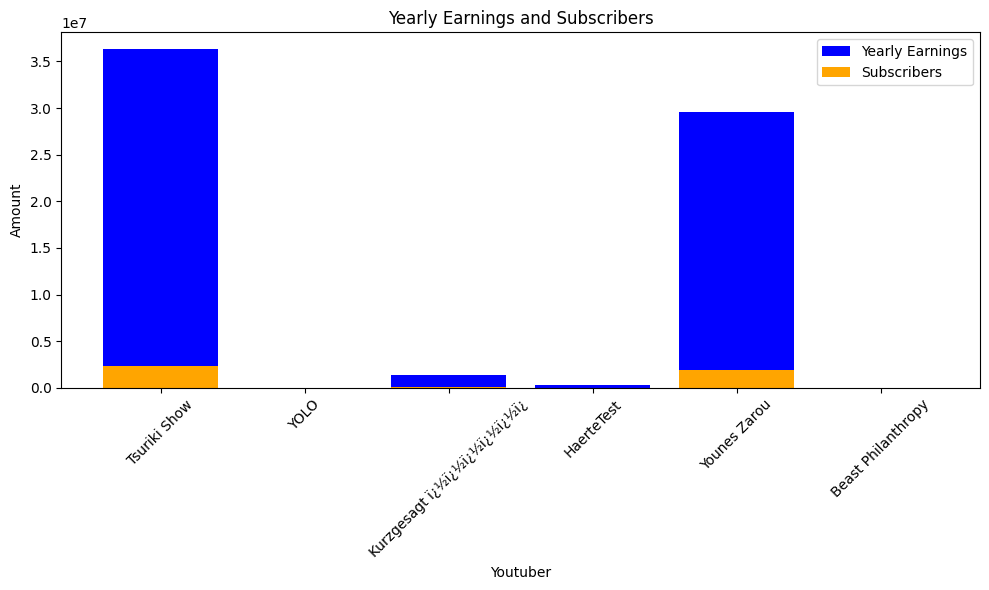

 91%|█████████ | 1968/2160 [19:17<02:06,  1.52it/s]check
highest_yearly_earnings: 35.0, Subscribers: 2.0, Youtuber: Smile Family
highest_yearly_earnings: 2300000.0, Subscribers: 144300.0, Youtuber: SQUEEZIE
highest_yearly_earnings: 37.0, Subscribers: 2.0, Youtuber: FitDance
highest_yearly_earnings: 548000.0, Subscribers: 34300.0, Youtuber: Cyprien
highest_yearly_earnings: 1500000.0, Subscribers: 91400.0, Youtuber: Lofi Girl


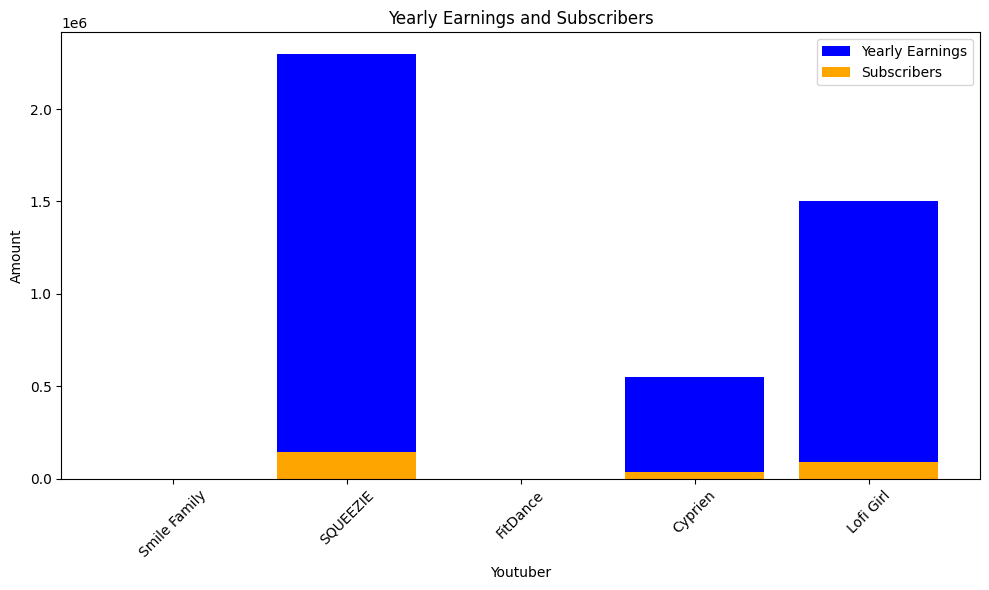

 91%|█████████▏| 1971/2160 [19:18<01:37,  1.94it/s]check
highest_yearly_earnings: 977700.0, Subscribers: 61100.0, Youtuber: Brawl Stars


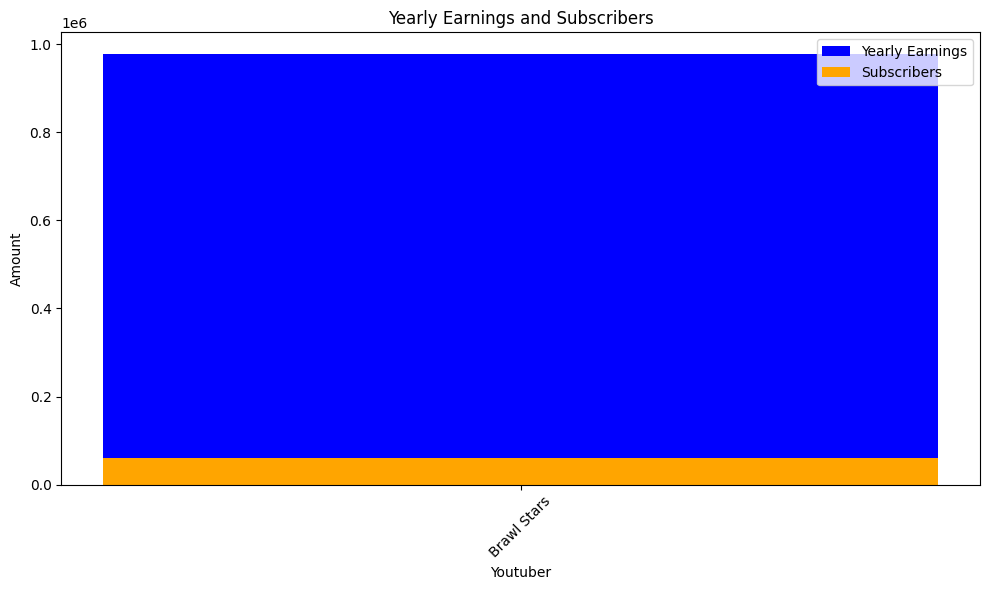

 91%|█████████▏| 1974/2160 [19:20<01:25,  2.18it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 101500.0, Youtuber: Fernanfloo


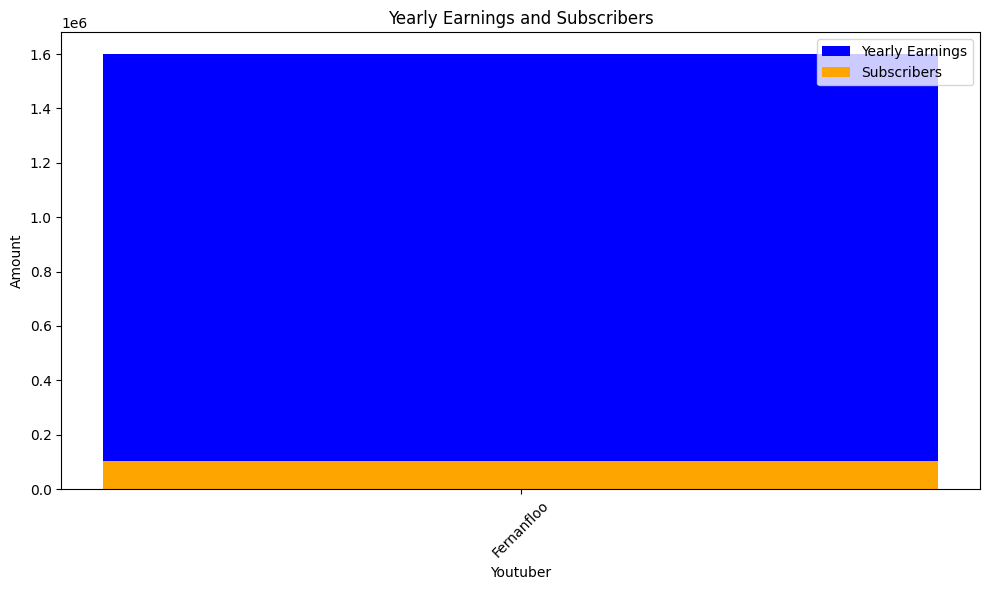

 92%|█████████▏| 1977/2160 [19:21<01:18,  2.32it/s]check
highest_yearly_earnings: 1600000.0, Subscribers: 98700.0, Youtuber: ýýýýýýýý ýýýýýýýýýýýýýý ýýýý 5 ýýýýýýýýýý
highest_yearly_earnings: 2200000.0, Subscribers: 138200.0, Youtuber: Mohamed Ramadan I ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï


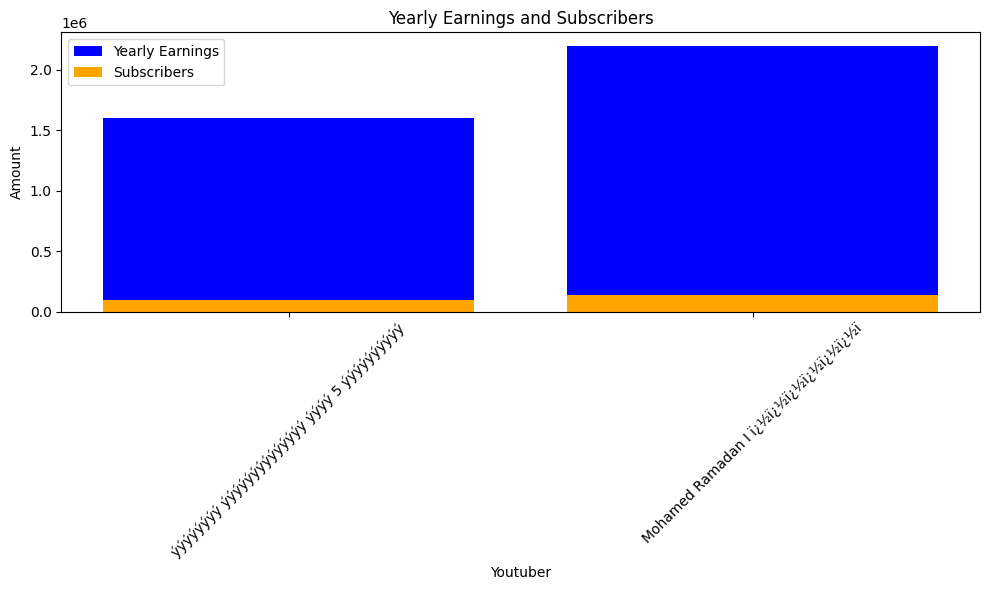

 92%|█████████▏| 1980/2160 [19:23<01:21,  2.21it/s]check
highest_yearly_earnings: 787600.0, Subscribers: 49200.0, Youtuber: Doc Tops
highest_yearly_earnings: 3000000.0, Subscribers: 188700.0, Youtuber: RaptorGamer


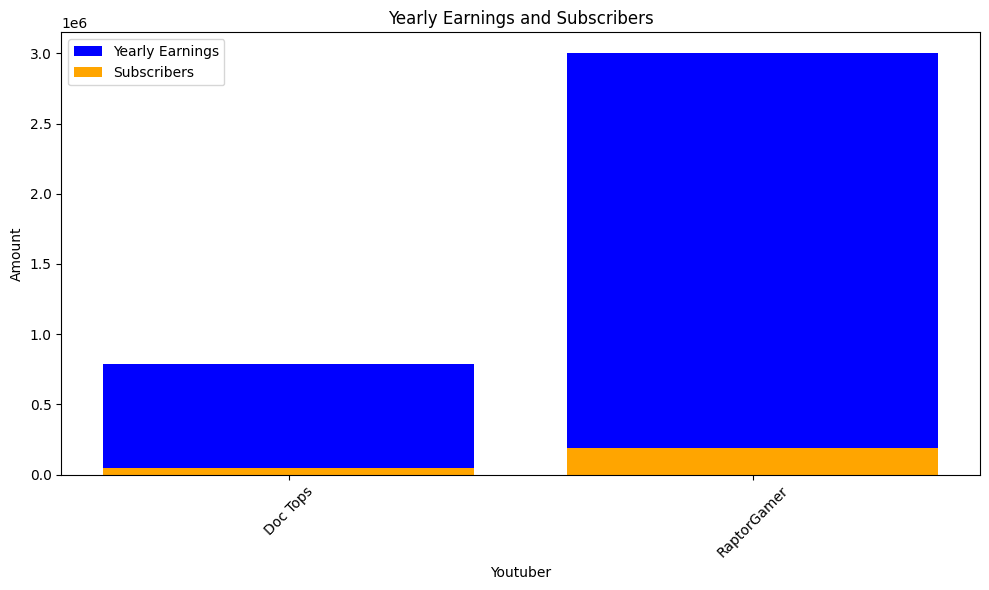

 92%|█████████▏| 1983/2160 [19:25<01:25,  2.07it/s]check
highest_yearly_earnings: 5.0, Subscribers: 0.28, Youtuber: A4


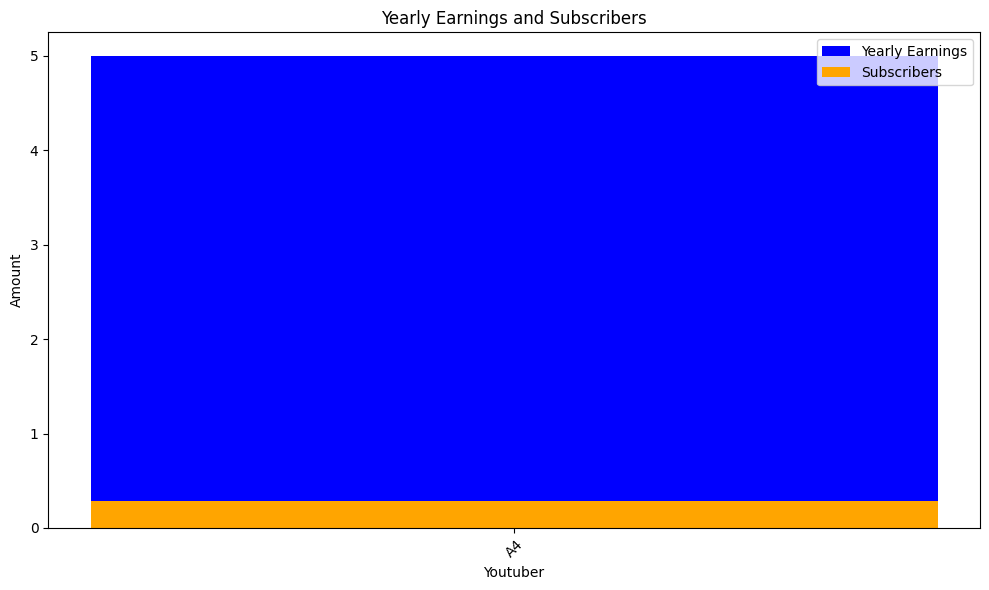

 92%|█████████▏| 1986/2160 [19:27<01:27,  1.99it/s]check
highest_yearly_earnings: 17000000.0, Subscribers: 1100000.0, Youtuber: Shakira
highest_yearly_earnings: 6200000.0, Subscribers: 386100.0, Youtuber: J Balvin
highest_yearly_earnings: 22400000.0, Subscribers: 1400000.0, Youtuber: KAROL G
highest_yearly_earnings: 8300000.0, Subscribers: 521500.0, Youtuber: toycantando
highest_yearly_earnings: 1200000.0, Subscribers: 73100.0, Youtuber: enchufetv
highest_yearly_earnings: 13600000.0, Subscribers: 852400.0, Youtuber: Anuel AA
highest_yearly_earnings: 12700000.0, Subscribers: 791600.0, Youtuber: Ami Rodriguez
highest_yearly_earnings: 2900000.0, Subscribers: 179700.0, Youtuber: Camilo
highest_yearly_earnings: 11000000.0, Subscribers: 686700.0, Youtuber: Codiscos
highest_yearly_earnings: 4100000.0, Subscribers: 258800.0, Youtuber: jbalvinVEVO
highest_yearly_earnings: 15700000.0, Subscribers: 982800.0, Youtuber: Go Ami Go!


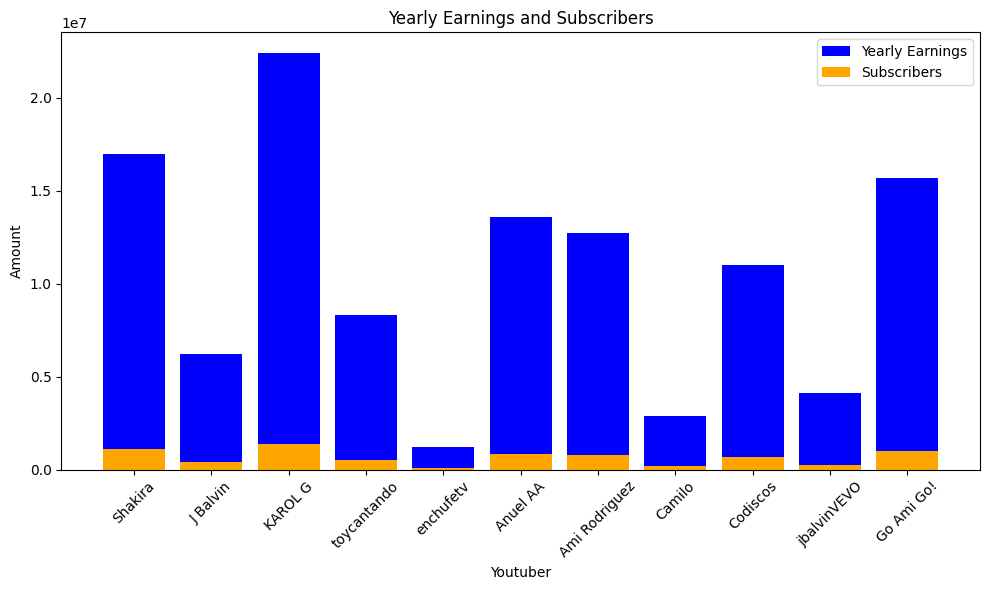

 92%|█████████▏| 1989/2160 [19:29<01:35,  1.79it/s]check
highest_yearly_earnings: 1100000.0, Subscribers: 67100.0, Youtuber: ýýýýýýýýý Liziqi


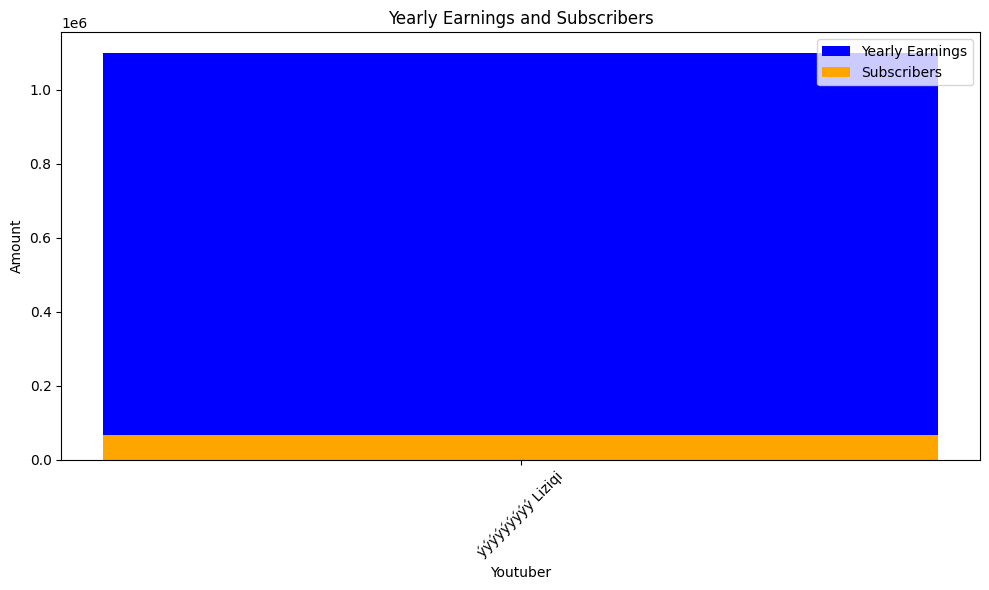

In [ ]:
from bokeh.resources import INLINE
dashboard.save('E:\dashboard.html', embed=True, resources=INLINE)


In [ ]:
from matplotlib.figure import Figure
import panel as pn
import numpy as np
pn.extension(sizing_mode="stretch_width", template="bootstrap")

def plot(data, bins):
    fig = Figure(figsize=(8,4))
    ax = fig.subplots()
    ax.hist(data, bins=bins)
    return fig


bins_upload = pn.widgets.IntSlider(name='Year slider', start=int(df["uploads"].min()), end=int(df["uploads"].max()), step=5, value=int(df["uploads"].min()))
bins_input = pn.widgets.IntSlider(name='Year slider', start=min_year, end=max_year, step=5, value=min_year)
bplot = pn.bind(plot, data=df['subscribers'], bins=bins_input)

pn.Column(bins_input, bplot).servable()